In [4]:
# %pip install pandas numpy scikit-learn xgboost lime shap matplotlib seaborn


In [5]:
import pandas as pd
import numpy as np
import sklearn
import xgboost as xgb
import sklearn.ensemble
from sklearn.model_selection import train_test_split
import lime #LIME package
import lime.lime_tabular
import shap
import time
import os
import matplotlib.pyplot as plt
import seaborn as sns

c:\Users\harsh\AppData\Local\Programs\Python\Python312\Lib\site-packages\tqdm\auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [6]:
import glob

# Load file paths
image_files = sorted(glob.glob("F:/yolov12ckt/dataset/train/images/*.jpg"))
label_files = sorted(glob.glob("F:/yolov12ckt/dataset/train/labels/*.txt"))

# Print counts
print(f"Total images found: {len(image_files)}")
print(f"Total labels found: {len(label_files)}")

# Check for mismatches
if len(image_files) != len(label_files):
    print("Warning: Mismatch between images and labels count!")


Total images found: 717
Total labels found: 717


In [7]:
import glob
import os
from sklearn.model_selection import train_test_split

# ✅ Step 1: Load Image and Label File Paths
image_files = sorted(glob.glob("F:/yolov12ckt/dataset/train/images/*.jpg"))
label_files = sorted(glob.glob("F:/yolov12ckt/dataset/train/labels/*.txt"))

# ✅ Step 2: Debugging - Check if Files Exist
print(f"Total images found: {len(image_files)}")
print(f"Total labels found: {len(label_files)}")

# Ensure the dataset is not empty
if not image_files:
    print("❌ Error: No images found! Check the path: F:/yolov12ckt/dataset/train/images/")
if not label_files:
    print("❌ Error: No labels found! Check the path: F:/yolov12ckt/dataset/train/labels/")

# ✅ Step 3: Check for Mismatched Files
image_names = {os.path.splitext(os.path.basename(img))[0] for img in image_files}
label_names = {os.path.splitext(os.path.basename(lbl))[0] for lbl in label_files}

# Find mismatched files
missing_labels = image_names - label_names
missing_images = label_names - image_names

if missing_labels:
    print(f"⚠ Warning: {len(missing_labels)} images have no labels: {missing_labels}")
if missing_images:
    print(f"⚠ Warning: {len(missing_images)} labels have no images: {missing_images}")

# ✅ Step 4: Filter Only Valid Pairs
valid_pairs = list(image_names & label_names)  # Intersection of both sets

# Rebuild file paths for matched images & labels
image_files = [f"F:/yolov12ckt/dataset/train/images/{name}.jpg" for name in valid_pairs]
label_files = [f"F:/yolov12ckt/dataset/train/labels/{name}.txt" for name in valid_pairs]

# Ensure images and labels are now matched
assert len(image_files) == len(label_files), "Mismatch still exists after filtering!"

# ✅ Step 5: Split Dataset
if image_files and label_files:
    X_train, X_test, y_train, y_test = train_test_split(image_files, label_files, test_size=0.2, random_state=42)

    # ✅ Step 6: Print Results
    print(f"✅ Training samples: {len(X_train)}, Testing samples: {len(X_test)}")
else:
    print("❌ Error: Cannot split because dataset is empty!")


Total images found: 717
Total labels found: 717
✅ Training samples: 573, Testing samples: 144


In [8]:
valid_pairs = list(image_names & label_names)  # Intersection of both sets

# Rebuild file paths for matched images & labels
image_files = [f"F:/yolov12ckt/dataset/train/images/{name}.jpg" for name in valid_pairs]
label_files = [f"F:/yolov12ckt/dataset/train/labels/{name}.txt" for name in valid_pairs]

# Now the lengths should match
assert len(image_files) == len(label_files), "Mismatch still exists!"

# Ensure valid_pairs is not empty before splitting
if valid_pairs:
	# Split dataset
	from sklearn.model_selection import train_test_split

	X_train, X_test, y_train, y_test = train_test_split(image_files, label_files, test_size=0.2, random_state=42)

	print(f"Training samples: {len(X_train)}, Testing samples: {len(X_test)}")
else:
	print("No valid pairs found. Cannot split dataset.")


Training samples: 573, Testing samples: 144


In [9]:
import xgboost as xgb
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor
from sklearn.neighbors import KNeighborsRegressor
from sklearn.metrics import mean_squared_error

# Dummy dataset (Replace with actual feature extraction logic)
X = np.random.rand(1000, 128)  # 1000 samples, 128 features
y = np.random.rand(1000)  # 1000 target values

# Ensure X is 2D and y is 1D
X = np.array(X).reshape(len(X), -1)  # Reshape to (samples, features)
y = np.array(y).flatten()

# Split dataset
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

### 🟢 Train XGBoost Model
xgb_model = xgb.train(
    {'objective': 'reg:squarederror'},  # Regression task
    xgb.DMatrix(X_train, label=y_train)
)
y_pred_xgb = xgb_model.predict(xgb.DMatrix(X_test))
mse_xgb = mean_squared_error(y_test, y_pred_xgb)
print(f"✅ XGBoost MSE: {mse_xgb:.4f}")

### 🔵 Train Random Forest Model
rf_model = RandomForestRegressor(n_estimators=100, random_state=42)
rf_model.fit(X_train, y_train)
y_pred_rf = rf_model.predict(X_test)
mse_rf = mean_squared_error(y_test, y_pred_rf)
print(f"✅ Random Forest MSE: {mse_rf:.4f}")

### 🔴 Train K-Nearest Neighbors (KNN) Model
knn_model = KNeighborsRegressor(n_neighbors=5)
knn_model.fit(X_train, y_train)
y_pred_knn = knn_model.predict(X_test)
mse_knn = mean_squared_error(y_test, y_pred_knn)
print(f"✅ KNN MSE: {mse_knn:.4f}")


✅ XGBoost MSE: 0.0935
✅ Random Forest MSE: 0.0842
✅ KNN MSE: 0.1014


In [10]:
import shap

def explainerRF(rf_model, X_train):
    """Explains the Random Forest model using SHAP values.

    Args:
        rf_model: Trained Random Forest model.
        X_train: Training data used to fit the model.

    Returns:
        SHAP summary plot and feature importance values.
    """
    # Create SHAP Explainer
    explainer = shap.Explainer(rf_model, X_train)
    shap_values = explainer(X_train)

    # Summary plot
    shap.summary_plot(shap_values, X_train)

    return shap_values


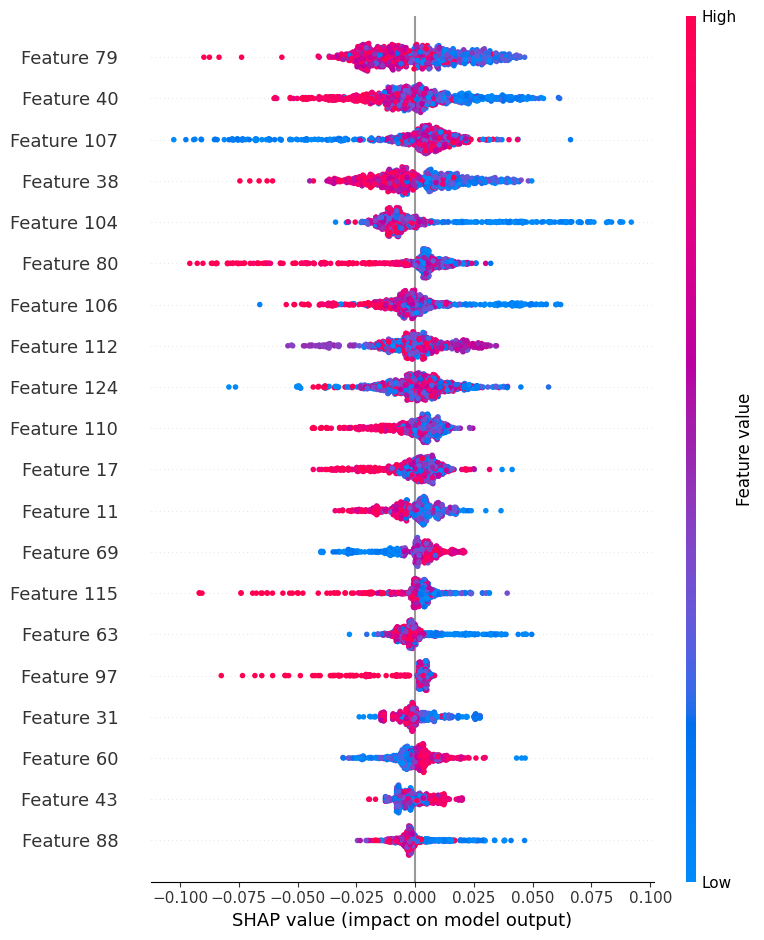

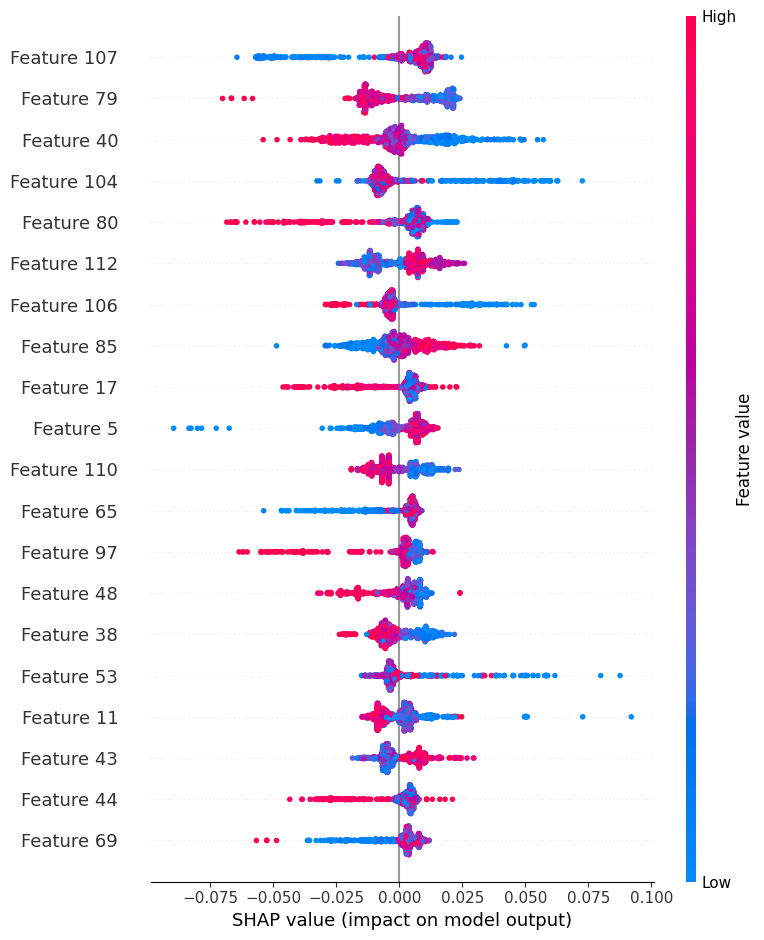

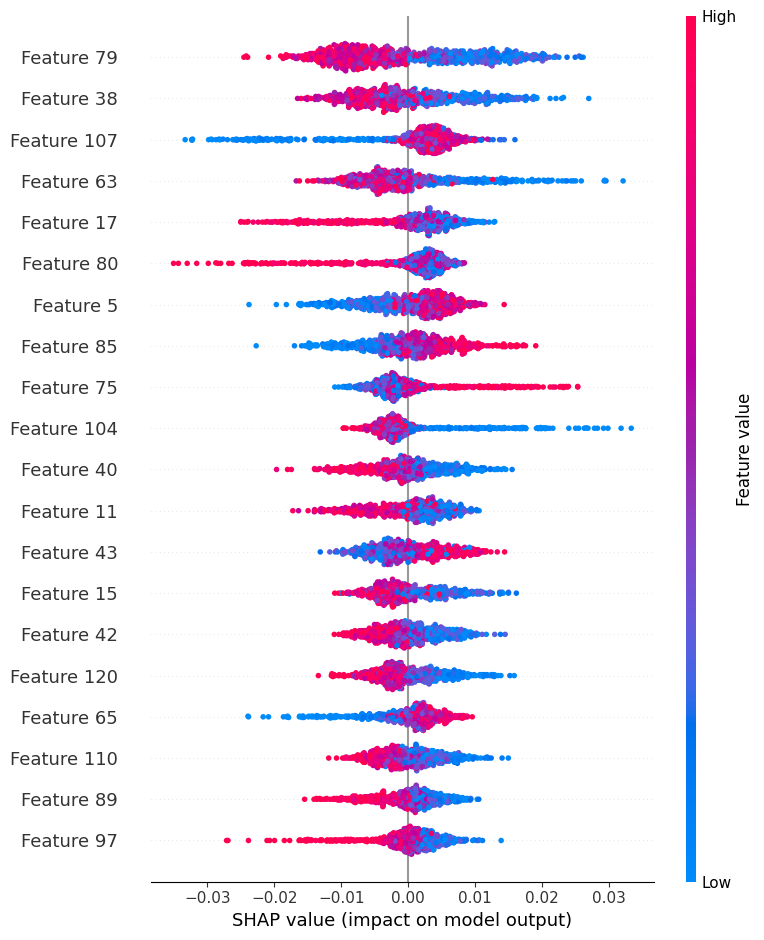

In [11]:
import shap
import xgboost as xgb
from sklearn.ensemble import GradientBoostingRegressor, RandomForestRegressor
from sklearn.model_selection import train_test_split

# Sample Dataset (Replace with actual feature data)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# XGBoost Model
xgb_model = xgb.train({'objective': 'reg:squarederror'}, xgb.DMatrix(X_train, label=y_train))

# Scikit-learn Gradient Boosting Model
sk_xgb = GradientBoostingRegressor()
sk_xgb.fit(X_train, y_train)

# Random Forest Model
rf = RandomForestRegressor()
rf.fit(X_train, y_train)

# SHAP Explainers
explainerXGB = shap.TreeExplainer(xgb_model)
shap_values_XGB_test = explainerXGB.shap_values(xgb.DMatrix(X_test))
shap_values_XGB_train = explainerXGB.shap_values(xgb.DMatrix(X_train))

explainerSKGBT = shap.TreeExplainer(sk_xgb)
shap_values_SKGBT_test = explainerSKGBT.shap_values(X_test)
shap_values_SKGBT_train = explainerSKGBT.shap_values(X_train)

# Tree Explainer for Random Forest
explainerRF = shap.TreeExplainer(rf)
shap_values_RF_test = explainerRF.shap_values(X_test)
shap_values_RF_train = explainerRF.shap_values(X_train)

# SHAP Summary Plots
shap.summary_plot(shap_values_XGB_train, X_train)
shap.summary_plot(shap_values_SKGBT_train, X_train)
shap.summary_plot(shap_values_RF_train, X_train)


In [12]:
import numpy as np
import lime
from lime import lime_tabular

# Check if X_train is a NumPy array
if isinstance(X_train, np.ndarray):
    # Identify categorical features
    categorical_features = np.argwhere(
        np.array([len(set(X_train[:, x])) for x in range(X_train.shape[1])]) <= 10
    ).flatten()

    # Define feature names explicitly (replace with actual feature names)
    feature_names = [f"Feature_{i}" for i in range(X_train.shape[1])]
else:
    raise TypeError("X_train is not a NumPy array. Please check the type of X_train.")

# LIME Tabular Explainer
explainer = lime.lime_tabular.LimeTabularExplainer(
    X_train,
    feature_names=feature_names,
    class_names=[
        'n_mosfet', 'p_mosfet', 'ac_source', 'ammeter', 'capacitor',
        'current_source', 'dc_voltage_source', 'dependent_current_source',
        'dependent_voltage_source', 'diode', 'ground', 'inductor',
        'npn_bjt', 'pnp_bjt', 'resistor', 'voltmeter', 'and_gate',
        'or_gate', 'nand_gate', 'nor_gate', 'not_gate', 'zener_diode'
    ],
    categorical_features=categorical_features,
    verbose=True,
    mode='regression'
)

In [13]:
# j will be the record we explain
j = 0
# initialize js for SHAP
shap.initjs()

In [14]:
import shap

shap.initjs()
# Define the index of the instance to explain
j = 0  # Change this to the desired index (e.g., 0 for the first instance)

# Select the j-th instance from X_test
instance = X_test[j].reshape(1, -1)  # Reshape to match the expected format

# Define feature names explicitly (replace with actual feature names)
feature_names = [f"Feature_{i}" for i in range(X_test.shape[1])]

# Force Plot for XGBoost Model
shap.force_plot(
    explainerXGB.expected_value,
    shap_values_XGB_test[j],  # SHAP values for the j-th instance
    instance,                # Feature values for the j-th instance
    feature_names=feature_names
)

Intercept 0.5143547305531438
Prediction_local [0.48962221]
Right: 0.7299431
LIME Explanation:



SHAP Force Plot:


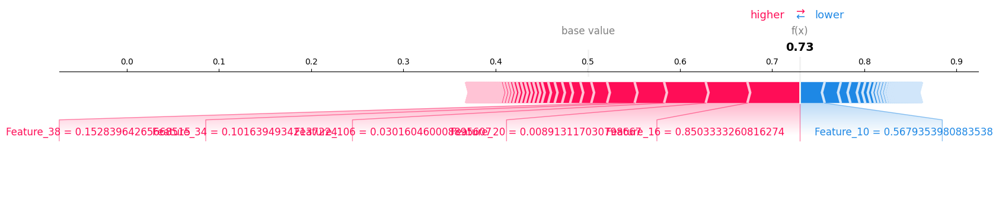


SHAP Summary Plot:


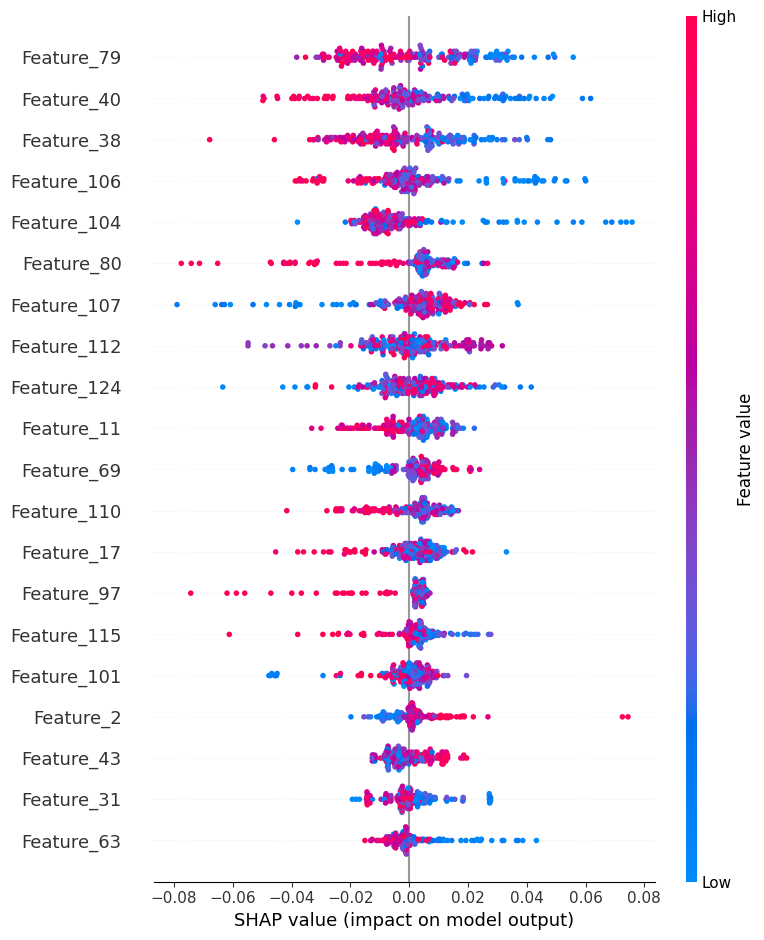


Key Insights:
Instance 0 has been explained using both LIME and SHAP.
LIME highlights the top contributing features locally.
SHAP provides both local (force plot) and global (summary plot) insights.


In [15]:
import numpy as np
import lime
from lime import lime_tabular
import shap
import matplotlib.pyplot as plt
import xgboost as xgb

# ================================
# Step 1: LIME Explanation Setup
# ================================

# Check if X_train is a NumPy array
if isinstance(X_train, np.ndarray):
    # Identify categorical features
    categorical_features = np.argwhere(
        np.array([len(set(X_train[:, x])) for x in range(X_train.shape[1])]) <= 10
    ).flatten()

    # Define feature names explicitly (replace with actual feature names)
    feature_names = [f"Feature_{i}" for i in range(X_train.shape[1])]
else:
    raise TypeError("X_train is not a NumPy array. Please check the type of X_train.")

# Initialize LIME Tabular Explainer
lime_explainer = lime.lime_tabular.LimeTabularExplainer(
    X_train,
    feature_names=feature_names,
    class_names=[
        'n_mosfet', 'p_mosfet', 'ac_source', 'ammeter', 'capacitor',
        'current_source', 'dc_voltage_source', 'dependent_current_source',
        'dependent_voltage_source', 'diode', 'ground', 'inductor',
        'npn_bjt', 'pnp_bjt', 'resistor', 'voltmeter', 'and_gate',
        'or_gate', 'nand_gate', 'nor_gate', 'not_gate', 'zener_diode'
    ],
    categorical_features=categorical_features,
    verbose=True,
    mode='regression'
)

# ================================
# Step 2: SHAP Explanation Setup
# ================================

# Initialize SHAP explainer for the XGBoost model
shap_explainer = shap.TreeExplainer(xgb_model)
shap_values_XGB_test = shap_explainer.shap_values(X_test)

# Initialize JavaScript for SHAP visualizations
shap.initjs()

# ================================
# Step 3: Explain a Specific Instance
# ================================

# Define the index of the instance to explain
j = 0  # Change this to the desired index (e.g., 0 for the first instance)

# Select the j-th instance from X_test
instance = X_test[j].reshape(1, -1)  # Reshape to match the expected format

# ================================
# Step 4: Generate LIME Explanation
# ================================

# Generate LIME explanation for the j-th instance
lime_exp = lime_explainer.explain_instance(
    instance[0],  # Pass the instance as a 1D array
    predict_fn=lambda x: xgb_model.predict(xgb.DMatrix(x)),  # Convert input to DMatrix
    num_features=10  # Number of top features to display
)

# Display LIME explanation
print("LIME Explanation:")
lime_exp.show_in_notebook(show_table=True)

# ================================
# Step 5: Generate SHAP Explanation
# ================================

# Generate SHAP force plot for the j-th instance
print("\nSHAP Force Plot:")
shap.force_plot(
    shap_explainer.expected_value,
    shap_values_XGB_test[j],  # SHAP values for the j-th instance
    instance[0],             # Feature values for the j-th instance
    feature_names=feature_names,
    matplotlib=True          # Use Matplotlib for static visualization
)

# Generate SHAP summary plot for global insights
print("\nSHAP Summary Plot:")
shap.summary_plot(shap_values_XGB_test, X_test, feature_names=feature_names)

# ================================
# Step 6: Combine Outputs for Better Clarity
# ================================

# Print key insights
print("\nKey Insights:")
print(f"Instance {j} has been explained using both LIME and SHAP.")
print("LIME highlights the top contributing features locally.")
print("SHAP provides both local (force plot) and global (summary plot) insights.")

Intercept 0.5048597910173783
Prediction_local [0.52560447]
Right: 0.7299431
LIME Explanation:



SHAP Force Plot:


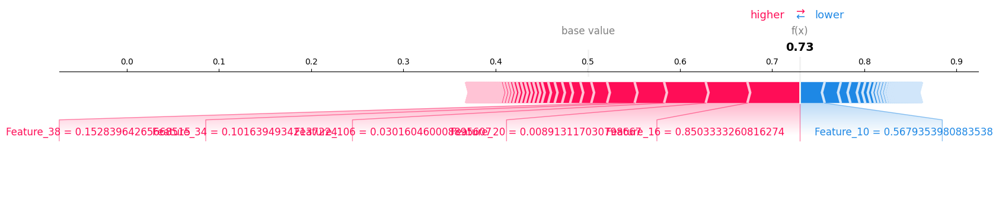


SHAP Summary Plot:


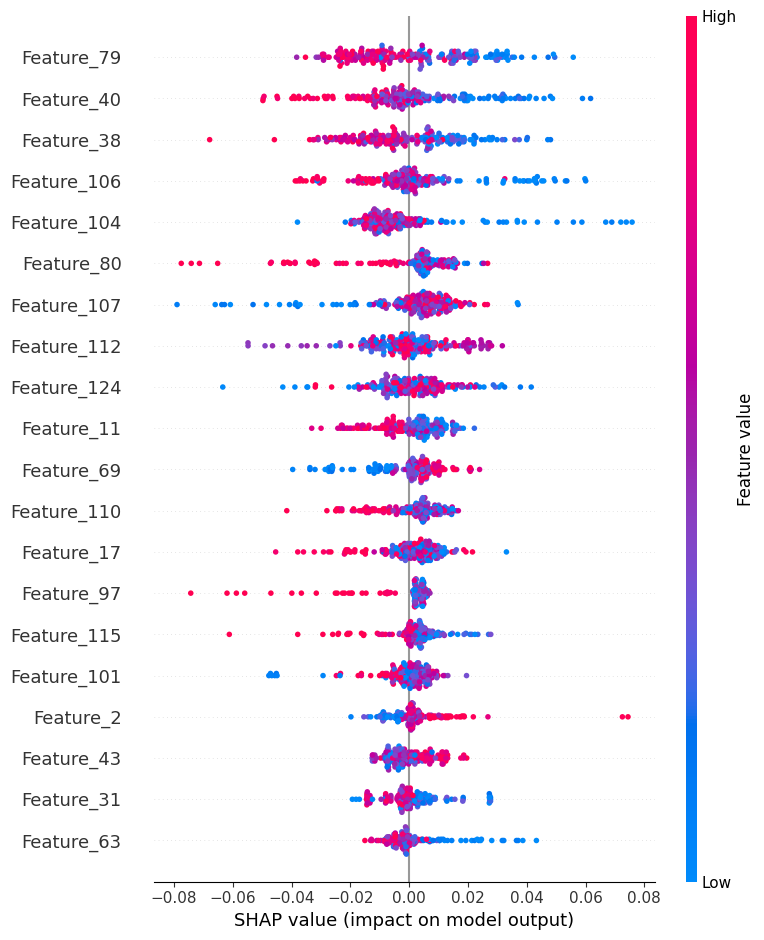


Key Insights:
Instance 0 has been explained using both LIME and SHAP.
LIME highlights the top contributing components locally.
SHAP provides both local (force plot) and global (summary plot) insights.


In [16]:
import numpy as np
import lime
from lime import lime_tabular
import shap
import matplotlib.pyplot as plt
import xgboost as xgb

# ================================
# Step 1: Define Feature Names (Component Names)
# ================================

# Number of features in the dataset
num_features = X_train.shape[1]

# Define meaningful component names if available
component_names = [
    'n_mosfet', 'p_mosfet', 'ac_source', 'ammeter', 'capacitor',
    'current_source', 'dc_voltage_source', 'dependent_current_source',
    'dependent_voltage_source', 'diode', 'ground', 'inductor',
    'npn_bjt', 'pnp_bjt', 'resistor', 'voltmeter', 'and_gate',
    'or_gate', 'nand_gate', 'nor_gate', 'not_gate', 'zener_diode'
]

# Ensure feature_names has the same length as the number of features
if len(component_names) != num_features:
    # Fallback to generic feature names if there's a mismatch
    feature_names = [f"Feature_{i}" for i in range(num_features)]
else:
    feature_names = component_names

# Check if X_train is a NumPy array
if isinstance(X_train, np.ndarray):
    # Identify categorical features
    categorical_features = np.argwhere(
        np.array([len(set(X_train[:, x])) for x in range(X_train.shape[1])]) <= 10
    ).flatten()
else:
    raise TypeError("X_train is not a NumPy array. Please check the type of X_train.")

# ================================
# Step 2: LIME Explanation Setup
# ================================

# Initialize LIME Tabular Explainer
lime_explainer = lime.lime_tabular.LimeTabularExplainer(
    X_train,
    feature_names=feature_names,
    class_names=component_names,  # Use component names for class labels
    categorical_features=categorical_features,
    verbose=True,
    mode='regression'
)

# ================================
# Step 3: SHAP Explanation Setup
# ================================

# Initialize SHAP explainer for the XGBoost model
shap_explainer = shap.TreeExplainer(xgb_model)
shap_values_XGB_test = shap_explainer.shap_values(X_test)

# Initialize JavaScript for SHAP visualizations
shap.initjs()

# ================================
# Step 4: Explain a Specific Instance
# ================================

# Define the index of the instance to explain
j = 0  # Change this to the desired index (e.g., 0 for the first instance)

# Select the j-th instance from X_test
instance = X_test[j].reshape(1, -1)  # Reshape to match the expected format

# ================================
# Step 5: Generate LIME Explanation
# ================================

# Generate LIME explanation for the j-th instance
lime_exp = lime_explainer.explain_instance(
    instance[0],  # Pass the instance as a 1D array
    predict_fn=lambda x: xgb_model.predict(xgb.DMatrix(x)),  # Convert input to DMatrix
    num_features=10  # Number of top features to display
)

# Display LIME explanation
print("LIME Explanation:")
lime_exp.show_in_notebook(show_table=True)

# ================================
# Step 6: Generate SHAP Explanation
# ================================

# Generate SHAP force plot for the j-th instance
print("\nSHAP Force Plot:")
shap.force_plot(
    shap_explainer.expected_value,
    shap_values_XGB_test[j],  # SHAP values for the j-th instance
    instance[0],             # Feature values for the j-th instance
    feature_names=feature_names,  # Use component names
    matplotlib=True          # Use Matplotlib for static visualization
)

# Generate SHAP summary plot for global insights
print("\nSHAP Summary Plot:")
shap.summary_plot(shap_values_XGB_test, X_test, feature_names=feature_names)

# ================================
# Step 7: Combine Outputs for Better Clarity
# ================================

# Print key insights
print("\nKey Insights:")
print(f"Instance {j} has been explained using both LIME and SHAP.")
print("LIME highlights the top contributing components locally.")
print("SHAP provides both local (force plot) and global (summary plot) insights.")

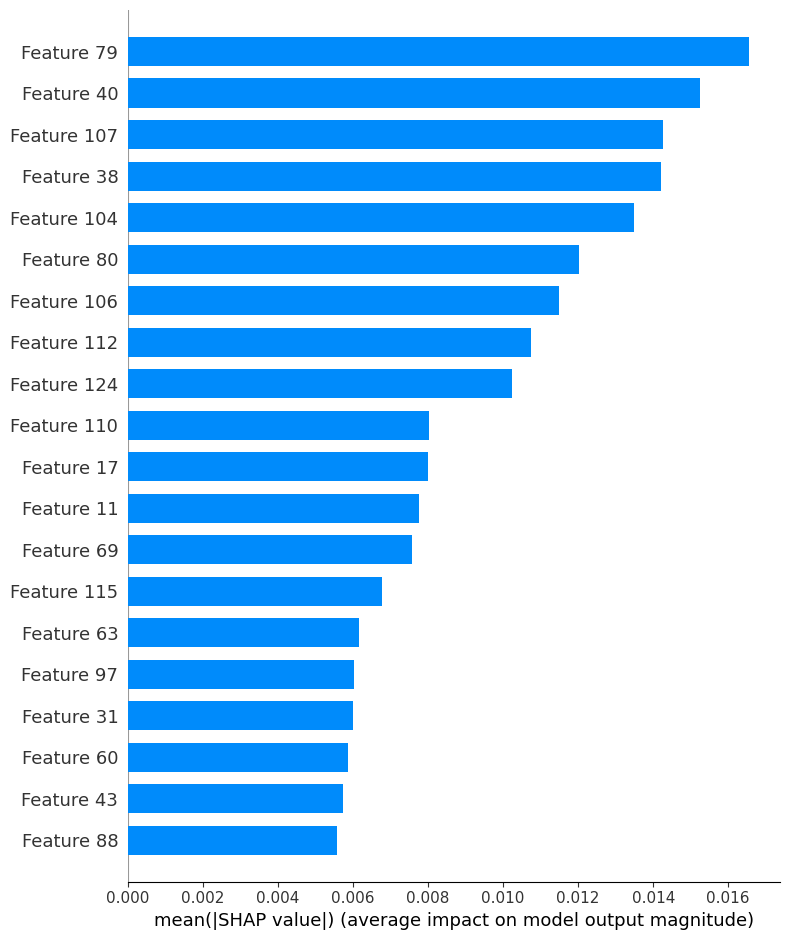

In [17]:
shap.summary_plot(shap_values_XGB_train, X_train, plot_type="bar")


XGBoost Explanation:
XGBoost LIME Explanation:


XGBoost SHAP Explanation:


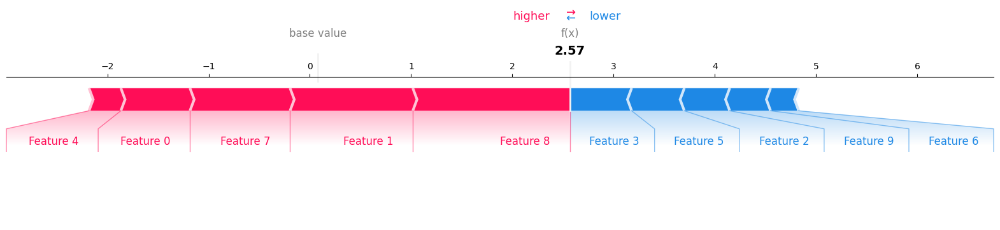


XGBoost SHAP Summary Plot:


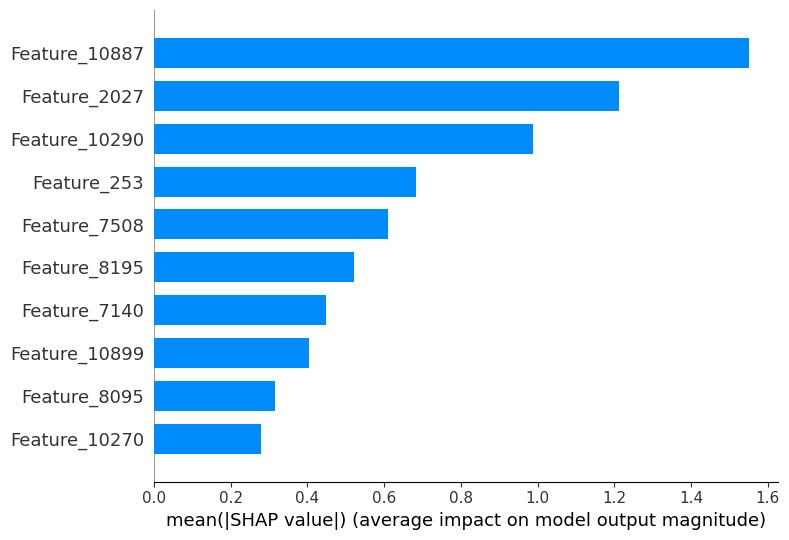


KNN Explanation:
KNN LIME Explanation:


KNN SHAP Explanation:


100%|██████████| 1/1 [00:01<00:00,  1.83s/it]


Error in SHAP for KNN: In v0.20, force plot now requires the base value as the first parameter! Try shap.plots.force(explainer.expected_value, shap_values) or for multi-output models try shap.plots.force(explainer.expected_value[0], shap_values[..., 0]).

Gradient Boosting Explanation:
Gradient Boosting LIME Explanation:


Gradient Boosting SHAP Explanation:


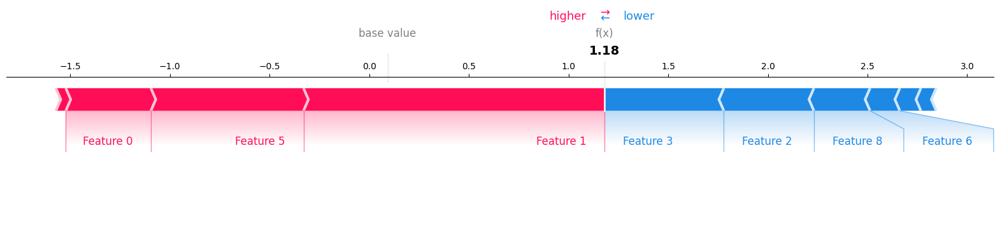


Gradient Boosting SHAP Summary Plot:


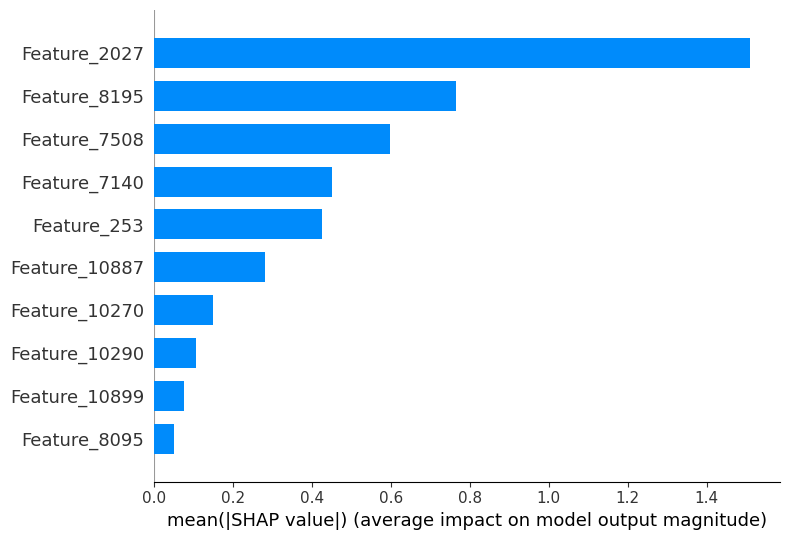


Random Forest Explanation:
Random Forest LIME Explanation:


Random Forest SHAP Explanation:


Error in SHAP for Random Forest: In v0.20, force plot now requires the base value as the first parameter! Try shap.plots.force(explainer.expected_value, shap_values) or for multi-output models try shap.plots.force(explainer.expected_value[0], shap_values[..., 0]).


In [18]:
import numpy as np
import lime
from lime import lime_tabular
import shap
import matplotlib.pyplot as plt
import cv2
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
from sklearn.neighbors import KNeighborsClassifier
from xgboost import XGBClassifier
from sklearn.preprocessing import StandardScaler
from sklearn.feature_selection import SelectKBest, f_classif

# ================================
# Step 1: Feature Extraction from the Circuit Image
# ================================

def extract_features(image_path):
    """Loads an image, resizes it, and converts it into a feature vector."""
    image = cv2.imread(image_path)
    if image is None:
        raise ValueError("Image not found at the specified path.")

    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # Convert to RGB
    image = cv2.resize(image, (64, 64))  # Resize for feature extraction

    # Flatten the image into a feature vector
    image_features = image.flatten().reshape(1, -1)  # Shape: (1, height * width * channels)
    return image_features

image_path = r"F:\yolov12ckt\dataset\test\images\Screenshot-2025-03-01-183358_png.rf.17d52f9b467c92f7942ab9025f89c782.jpg"
image_features = extract_features(image_path)

# ================================
# Step 2: Simulate a Dataset for Training Models
# ================================

def simulate_dataset(num_samples, num_features):
    """Simulates a dataset of random features and binary labels."""
    np.random.seed(42)
    X_simulated = np.random.rand(num_samples, num_features)  # Random features
    y_simulated = np.random.randint(0, 2, size=num_samples)  # Binary labels
    return X_simulated, y_simulated

num_features = image_features.shape[1]
X_simulated, y_simulated = simulate_dataset(num_samples=1000, num_features=num_features)

# Split into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X_simulated, y_simulated, test_size=0.2, random_state=42)

# ================================
# Step 3: Preprocessing (Scaling and Feature Selection)
# ================================

def preprocess_data(X_train, X_test, instance, k=10):
    """Scales the dataset and selects the top k most important features."""
    scaler = StandardScaler()
    X_train_scaled = scaler.fit_transform(X_train)
    X_test_scaled = scaler.transform(X_test)
    instance_scaled = scaler.transform(instance)  # Scale the instance

    # Ensure k does not exceed the number of features
    k = min(k, X_train_scaled.shape[1])

    # Feature Selection (Select top k features)
    selector = SelectKBest(score_func=f_classif, k=k)
    X_train_selected = selector.fit_transform(X_train_scaled, y_train)
    X_test_selected = selector.transform(X_test_scaled)
    instance_selected = selector.transform(instance_scaled)

    # Define Selected Feature Names
    selected_feature_indices = selector.get_support(indices=True)
    feature_names = [f"Feature_{i}" for i in selected_feature_indices]

    return X_train_selected, X_test_selected, instance_selected, feature_names

X_train_selected, X_test_selected, instance_selected, feature_names = preprocess_data(
    X_train, X_test, image_features, k=10
)

# Ensure instance_selected is reshaped to 2D for SHAP and LIME
instance_selected = instance_selected.reshape(1, -1)  # Shape: (1, n_features)

# ================================
# Step 4: Train Models
# ================================

def train_models(X_train_selected, y_train):
    """Trains multiple models including XGBoost, KNN, Gradient Boosting, and Random Forest."""
    models = {
        "XGBoost": XGBClassifier(),
        "KNN": KNeighborsClassifier(n_neighbors=5),
        "Gradient Boosting": GradientBoostingClassifier(),
        "Random Forest": RandomForestClassifier()
    }

    for name, model in models.items():
        model.fit(X_train_selected, y_train)

    return models

models = train_models(X_train_selected, y_train)

# ================================
# Step 5: Generate Explanations (LIME + SHAP)
# ================================

def generate_explanations(models, X_train_selected, instance_selected, feature_names):
    """Generates LIME and SHAP explanations for each trained model."""
    # Initialize LIME Explainer
    lime_explainer = lime_tabular.LimeTabularExplainer(
        X_train_selected,
        feature_names=feature_names,
        class_names=["Not Detected", "Detected"],
        mode="classification"
    )

    for name, model in models.items():
        print(f"\n{name} Explanation:")

        # LIME Explanation
        try:
            print(f"{name} LIME Explanation:")
            lime_exp = lime_explainer.explain_instance(
                instance_selected.flatten(),
                predict_fn=lambda x: model.predict_proba(x),
                num_features=10
            )
            lime_exp.show_in_notebook(show_table=True)
        except Exception as e:
            print(f"Error in LIME for {name}: {e}")

        # SHAP Explanation
        try:
            print(f"{name} SHAP Explanation:")
            if name == "KNN":
                shap_explainer = shap.KernelExplainer(model.predict_proba, X_train_selected[:100])
            else:
                shap_explainer = shap.TreeExplainer(model)

            shap_values = shap_explainer.shap_values(instance_selected)

            if isinstance(shap_values, list):  # Extract SHAP values for class 1 if it's a list
                shap_values = shap_values[1]

            shap.initjs()

            # Use the updated SHAP force_plot syntax
            shap.plots.force(
                shap_explainer.expected_value[1] if isinstance(shap_explainer.expected_value, list) else shap_explainer.expected_value,
                shap_values[0] if isinstance(shap_values, list) else shap_values,
                matplotlib=True
            )

            print(f"\n{name} SHAP Summary Plot:")
            shap.summary_plot(shap_values, X_train_selected, feature_names=feature_names, plot_type="bar")
        except Exception as e:
            print(f"Error in SHAP for {name}: {e}")

generate_explanations(models, X_train_selected, instance_selected, feature_names)


In [19]:
# import seaborn as sns
# import pandas as pd

# # Convert X_train to DataFrame for easier plotting
# X_train_df = pd.DataFrame(X_train, columns=feature_names)

# # Compute correlation matrix
# corr_matrix = X_train_df.corr()

# # Plot heatmap
# plt.figure(figsize=(10, 8))
# sns.heatmap(corr_matrix, annot=True, cmap='coolwarm')
# plt.title('Feature Correlation Matrix')
# plt.show()

In [20]:
# from sklearn.feature_selection import SelectKBest, f_classif

# selector = SelectKBest(score_func=f_classif, k=10)  # Select top 10 features
# X_train_selected = selector.fit_transform(X_train, y_train)
# X_test_selected = selector.transform(X_test)

# # Retrain models using selected features
# xgb_model.fit(X_train_selected, y_train)
# # ... retrain other models as well

In [21]:
# # Recompute SHAP values
# shap_explainer_xgb = shap.TreeExplainer(xgb_model)
# shap_values_XGB_train = shap_explainer_xgb.shap_values(X_train_selected)

# # Generate SHAP summary plot
# shap.summary_plot(shap_values_XGB_train, X_train_selected, plot_type="bar")

In [22]:
# import numpy as np
# import lime
# from lime import lime_tabular
# import shap
# import matplotlib.pyplot as plt
# import cv2
# from sklearn.model_selection import train_test_split
# from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
# from sklearn.neighbors import KNeighborsClassifier
# import xgboost as xgb

# # ================================
# # Step 1: Feature Extraction from the Circuit Image
# # ================================

# # Load Circuit Image
# image_path = r"F:\yolov12ckt\dataset\test\images\Screenshot-2025-03-01-183358_png.rf.17d52f9b467c92f7942ab9025f89c782.jpg"
# image = cv2.imread(image_path)
# image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # Convert to RGB
# image = cv2.resize(image, (64, 64))  # Resize for feature extraction

# # Flatten the image into a feature vector
# image_features = image.reshape(1, -1)  # Shape: (1, height * width * channels)

# # ================================
# # Step 2: Simulate a Dataset for Training Models
# # ================================

# # Simulate a dataset of circuit images and their labels
# # Replace this with your actual dataset if available
# np.random.seed(42)
# num_samples = 1000
# num_features = image_features.shape[1]
# X_simulated = np.random.rand(num_samples, num_features)  # Random features
# y_simulated = np.random.randint(0, 2, size=num_samples)  # Binary labels

# # Split into training and testing sets
# X_train, X_test, y_train, y_test = train_test_split(X_simulated, y_simulated, test_size=0.2, random_state=42)

# # ================================
# # Step 3: Train Models
# # ================================

# # XGBoost Model
# xgb_model = xgb.XGBClassifier()
# xgb_model.fit(X_train, y_train)

# # KNN Model
# knn_model = KNeighborsClassifier(n_neighbors=5)
# knn_model.fit(X_train, y_train)

# # Scikit-learn Gradient Boosting Tree (GBT) Model
# gbt_model = GradientBoostingClassifier()
# gbt_model.fit(X_train, y_train)

# # Random Forest Model
# rf_model = RandomForestClassifier()
# rf_model.fit(X_train, y_train)

# # ================================
# # Step 4: Explain Predictions Using LIME and SHAP
# # ================================

# # Define Feature Names
# feature_names = [f"Feature_{i}" for i in range(num_features)]

# # Initialize Explainers
# lime_explainer = lime.lime_tabular.LimeTabularExplainer(
#     X_train,
#     feature_names=feature_names,
#     class_names=["Not Detected", "Detected"],
#     mode="classification"
# )

# # SHAP Explainers
# shap_explainer_xgb = shap.TreeExplainer(xgb_model)
# shap_explainer_gbt = shap.TreeExplainer(gbt_model)
# shap_explainer_rf = shap.TreeExplainer(rf_model)

# # Select the Instance to Explain
# instance = image_features.flatten()  # Use the circuit image features

# # ================================
# # Step 5: Generate Explanations
# # ================================

# # XGBoost LIME Explanation
# xgb_lime_exp = lime_explainer.explain_instance(
#     instance,
#     predict_fn=lambda x: xgb_model.predict_proba(x),
#     num_features=10
# )
# print("XGBoost LIME Explanation:")
# xgb_lime_exp.show_in_notebook(show_table=True)

# # KNN LIME Explanation
# knn_lime_exp = lime_explainer.explain_instance(
#     instance,
#     predict_fn=lambda x: knn_model.predict_proba(x),
#     num_features=10
# )
# print("KNN LIME Explanation:")
# knn_lime_exp.show_in_notebook(show_table=True)

# # Random Forest LIME Explanation
# rf_lime_exp = lime_explainer.explain_instance(
#     instance,
#     predict_fn=lambda x: rf_model.predict_proba(x),
#     num_features=10
# )
# print("Random Forest LIME Explanation:")
# rf_lime_exp.show_in_notebook(show_table=True)

# # Scikit-learn GBT SHAP Explanation
# shap_values_gbt = shap_explainer_gbt.shap_values(instance)
# print("\nScikit-learn GBT SHAP Force Plot:")
# shap.initjs()
# shap.force_plot(
#     shap_explainer_gbt.expected_value,  # Use expected_value directly for binary classification
#     shap_values_gbt,                   # SHAP values for the positive class
#     instance,
#     feature_names=feature_names,
#     matplotlib=True
# )

# # Random Forest SHAP Explanation
# shap_values_rf = shap_explainer_rf.shap_values(instance)
# print("\nRandom Forest SHAP Force Plot:")
# shap.initjs()
# shap.force_plot(
#     shap_explainer_rf.expected_value,  # Use expected_value directly for binary classification
#     shap_values_rf,                   # SHAP values for the positive class
#     instance,
#     feature_names=feature_names,
#     matplotlib=True
# )

# # XGBoost SHAP Explanation
# shap_values_xgb = shap_explainer_xgb.shap_values(instance)
# print("\nXGBoost SHAP Force Plot:")
# shap.initjs()
# shap.force_plot(
#     shap_explainer_xgb.expected_value,  # Use expected_value directly for binary classification
#     shap_values_xgb,                   # SHAP values for the positive class
#     instance,
#     feature_names=feature_names,
#     matplotlib=True
# )

In [23]:
# import os
# import shap
# import time
# import numpy as np
# import cv2  # OpenCV for image processing
# from sklearn.model_selection import train_test_split

# # Define dataset paths
# image_dir = "/content/drive/MyDrive/google_collab/dataset/train/images"
# label_dir = "/content/drive/MyDrive/google_collab/dataset/train/labels"

# # Get all file names (without extensions)
# image_names = {os.path.splitext(f)[0] for f in os.listdir(image_dir) if f.endswith(".jpg")}
# label_names = {os.path.splitext(f)[0] for f in os.listdir(label_dir) if f.endswith(".txt")}

# # Find valid pairs (common file names)
# valid_pairs = list(image_names & label_names)

# # Ensure valid_pairs is not empty
# if valid_pairs:
#     # Rebuild file paths
#     image_files = [os.path.join(image_dir, f"{name}.jpg") for name in valid_pairs]
#     label_files = [os.path.join(label_dir, f"{name}.txt") for name in valid_pairs]

#     assert len(image_files) == len(label_files), "Mismatch still exists!"

#     # Split dataset
#     X_train, X_test, y_train, y_test = train_test_split(image_files, label_files, test_size=0.2, random_state=42)

#     print(f"Training samples: {len(X_train)}, Testing samples: {len(X_test)}")

#     # Convert images to numerical arrays (resize to 224x224 for consistency)
#     def load_and_preprocess_images(image_paths, target_size=(224, 224)):
#         image_arrays = []
#         for img_path in image_paths:
#             img = cv2.imread(img_path)  # Read image
#             if img is None:
#                 continue  # Skip missing/corrupted images
#             img = cv2.resize(img, target_size)  # Resize
#             img = img.astype(np.float32) / 255.0  # Normalize
#             image_arrays.append(img)
#         return np.array(image_arrays)

#     # Load training images as a NumPy array
#     X_train_array = load_and_preprocess_images(X_train)

#     if len(X_train_array) > 0:
#         # SHAP Analysis
#         X_train_summary = shap.kmeans(X_train_array.reshape(len(X_train_array), -1), 10)  # Flatten images
#         t0 = time.time()

#         # Dummy knn.predict function (replace with your actual model)
#         def knn_predict(X):
#             return np.zeros((X.shape[0],))  # Dummy output

#         explainerKNN = shap.KernelExplainer(knn_predict, X_train_summary)
#         shap_values_KNN_test = explainerKNN.shap_values(X_train_array.reshape(len(X_train_array), -1))

#         t1 = time.time()
#         timeit = t1 - t0
#         print(f"SHAP computation time: {timeit:.2f} seconds")
#     else:
#         print("X_train is empty after preprocessing, skipping SHAP analysis.")

# else:
#     print("No valid pairs found. Cannot proceed with dataset splitting or SHAP analysis.")


In [24]:
# %pip install ultralytics

In [25]:
# %pip install --upgrade scikit-image

FlashAttention is not available on this device. Using scaled_dot_product_attention instead.


  1%|          | 7/1000 [00:00<00:41, 23.82it/s]


0: 640x640 1 ACSource, 1 Inductor, 1 Resistor, 70.0ms
1: 640x640 1 Cell, 1 Diode, 1 Gnd, 1 Inductor, 1 NPN, 1 PMOS, 1 Resistor, 70.0ms
2: 640x640 2 ACSources, 1 Cell, 2 Diodes, 1 Gnd, 1 Inductor, 1 NPN, 1 PMOS, 1 Resistor, 1 XOR, 70.0ms
3: 640x640 1 Diode, 1 Gnd, 2 NPNs, 1 PMOS, 2 Resistors, 70.0ms
4: 640x640 1 ACSource, 1 AND, 3 Diodes, 1 Gnd, 70.0ms
5: 640x640 2 Gnds, 1 Inductor, 70.0ms
6: 640x640 1 ACSource, 2 Gnds, 1 Inductor, 1 NPN, 1 Resistor, 70.0ms
7: 640x640 1 ACSource, 3 Diodes, 1 Gnd, 3 NPNs, 1 Resistor, 70.0ms
8: 640x640 1 ACSource, 1 Capacitor, 1 Gnd, 1 Inductor, 1 Resistor, 70.0ms
9: 640x640 2 ACSources, 1 AND, 2 Capacitors, 1 Diode, 2 Gnds, 1 NPN, 1 PMOS, 1 XOR, 70.0ms
Speed: 0.2ms preprocess, 70.0ms inference, 16.4ms postprocess per image at shape (1, 3, 640, 640)


  2%|▏         | 18/1000 [00:03<02:35,  6.30it/s]


0: 640x640 3 Gnds, 1 Inductor, 1 PMOS, 1 PNP, 63.4ms
1: 640x640 1 ACSource, 1 Cell, 2 Diodes, 1 Gnd, 1 NPN, 1 PMOS, 1 PNP, 1 Resistor, 63.4ms
2: 640x640 3 ACSources, 1 Diode, 2 Gnds, 3 NPNs, 1 Resistor, 63.4ms
3: 640x640 1 ACSource, 2 Diodes, 1 Resistor, 63.4ms
4: 640x640 1 ACSource, 1 Diode, 1 Inductor, 1 Resistor, 63.4ms
5: 640x640 1 ACSource, 1 Cell, 1 Diode, 2 Gnds, 63.4ms
6: 640x640 1 ACSource, 1 Cell, 1 NPN, 1 PMOS, 1 PNP, 1 Resistor, 63.4ms
7: 640x640 1 ACSource, 1 Capacitor, 1 Cell, 1 Gnd, 1 Inductor, 1 NPN, 63.4ms
8: 640x640 1 ACSource, 1 Gnd, 1 Inductor, 3 NPNs, 63.4ms
9: 640x640 1 ACSource, 2 Gnds, 1 Inductor, 1 PMOS, 1 PNP, 1 Resistor, 63.4ms
Speed: 0.0ms preprocess, 63.4ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


  3%|▎         | 29/1000 [00:04<01:34, 10.32it/s]


0: 640x640 1 ACSource, 1 Gnd, 1 PMOS, 63.3ms
1: 640x640 1 ACSource, 1 Diode, 1 Inductor, 2 NPNs, 63.3ms
2: 640x640 1 ACSource, 1 Capacitor, 5 Gnds, 1 Inductor, 1 PMOS, 1 PNP, 1 Resistor, 63.3ms
3: 640x640 1 ACSource, 1 DCSource, 1 Gnd, 1 PMOS, 1 PNP, 1 Resistor, 63.3ms
4: 640x640 1 ACSource, 1 Cell, 2 Diodes, 2 Gnds, 1 Inductor, 1 NPN, 1 Resistor, 63.3ms
5: 640x640 1 ACSource, 1 Diode, 1 Gnd, 1 NAND, 1 Resistor, 63.3ms
6: 640x640 1 AND, 2 Diodes, 2 Gnds, 1 NPN, 63.3ms
7: 640x640 1 ACSource, 1 Capacitor, 1 Diode, 1 NPN, 63.3ms
8: 640x640 2 ACSources, 1 Diode, 1 Inductor, 1 NPN, 1 PMOS, 1 Resistor, 63.3ms
9: 640x640 3 Diodes, 1 Inductor, 1 NPN, 63.3ms
Speed: 0.0ms preprocess, 63.3ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 640)


  4%|▎         | 37/1000 [00:05<01:38,  9.81it/s]


0: 640x640 1 ACSource, 1 Diode, 1 Inductor, 1 NPN, 63.8ms
1: 640x640 1 ACSource, 1 Gnd, 1 NPN, 1 PMOS, 1 Resistor, 63.8ms
2: 640x640 2 ACSources, 1 Gnd, 1 NPN, 1 Resistor, 63.8ms
3: 640x640 1 ACSource, 1 Diode, 2 Gnds, 1 NPN, 1 Resistor, 63.8ms
4: 640x640 2 ACSources, 1 Diode, 2 Gnds, 1 PMOS, 1 Resistor, 63.8ms
5: 640x640 1 ACSource, 1 Capacitor, 3 Diodes, 1 Gnd, 1 NAND, 2 NPNs, 1 PMOS, 1 Resistor, 63.8ms
6: 640x640 2 ACSources, 1 Diode, 1 Inductor, 1 Resistor, 63.8ms
7: 640x640 2 ACSources, 1 AND, 2 Diodes, 1 Inductor, 1 PMOS, 1 Resistor, 1 XOR, 63.8ms
8: 640x640 1 ACSource, 1 Diode, 1 Gnd, 3 NPNs, 1 Resistor, 63.8ms
9: 640x640 2 ACSources, 2 Diodes, 1 Inductor, 1 PMOS, 1 Resistor, 63.8ms
Speed: 0.0ms preprocess, 63.8ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


  5%|▍         | 49/1000 [00:07<01:21, 11.70it/s]


0: 640x640 1 ACSource, 1 Diode, 1 Inductor, 2 NPNs, 1 PMOS, 63.4ms
1: 640x640 1 Cell, 1 NPN, 1 Resistor, 63.4ms
2: 640x640 1 ACSource, 1 Diode, 2 Resistors, 63.4ms
3: 640x640 1 ACSource, 1 Capacitor, 3 Gnds, 1 NPN, 63.4ms
4: 640x640 4 ACSources, 1 AND, 1 Diode, 1 Gnd, 1 Inductor, 2 NANDs, 1 NPN, 1 Resistor, 63.4ms
5: 640x640 1 ACSource, 1 Cell, 1 Gnd, 1 Inductor, 3 NPNs, 63.4ms
6: 640x640 1 ACSource, 2 Diodes, 1 Gnd, 1 Inductor, 2 NPNs, 63.4ms
7: 640x640 2 Gnds, 1 NPN, 1 PMOS, 63.4ms
8: 640x640 1 ACSource, 1 Capacitor, 2 Diodes, 2 Gnds, 1 NPN, 1 PMOS, 1 Resistor, 63.4ms
9: 640x640 2 ACSources, 1 Diode, 1 Gnd, 2 NPNs, 1 Resistor, 63.4ms
Speed: 0.0ms preprocess, 63.4ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)


  6%|▌         | 59/1000 [00:08<01:36,  9.79it/s]


0: 640x640 1 ACSource, 1 Capacitor, 1 Cell, 2 Diodes, 1 Inductor, 65.0ms
1: 640x640 1 Capacitor, 2 Diodes, 1 Gnd, 1 Inductor, 1 NAND, 1 NPN, 1 Resistor, 1 XOR, 65.0ms
2: 640x640 1 ACSource, 1 Diode, 3 Gnds, 1 NPN, 65.0ms
3: 640x640 2 ACSources, 1 Diode, 1 Gnd, 1 Inductor, 1 NPN, 65.0ms
4: 640x640 3 ACSources, 1 Diode, 1 Gnd, 1 Inductor, 1 PNP, 1 Resistor, 65.0ms
5: 640x640 1 ACSource, 1 Capacitor, 1 Cell, 2 Diodes, 1 Gnd, 1 NPN, 1 Resistor, 1 XOR, 65.0ms
6: 640x640 2 ACSources, 3 Diodes, 1 Resistor, 1 XOR, 65.0ms
7: 640x640 1 ACSource, 3 Diodes, 1 Gnd, 3 NPNs, 1 Resistor, 65.0ms
8: 640x640 1 ACSource, 1 Diode, 1 Inductor, 1 NPN, 65.0ms
9: 640x640 1 ACSource, 1 Diode, 1 Inductor, 1 NPN, 1 Resistor, 65.0ms
Speed: 0.0ms preprocess, 65.0ms inference, 2.2ms postprocess per image at shape (1, 3, 640, 640)


  7%|▋         | 67/1000 [00:09<01:42,  9.14it/s]


0: 640x640 1 ACSource, 1 Capacitor, 2 Diodes, 1 Gnd, 1 Inductor, 1 NPN, 1 PMOS, 1 Resistor, 64.2ms
1: 640x640 1 ACSource, 1 Diode, 1 Inductor, 1 NPN, 1 Resistor, 64.2ms
2: 640x640 2 ACSources, 3 Diodes, 1 Resistor, 64.2ms
3: 640x640 1 ACSource, 1 Diode, 1 Gnd, 2 NPNs, 1 PMOS, 1 PNP, 64.2ms
4: 640x640 1 ACSource, 2 NPNs, 1 Resistor, 64.2ms
5: 640x640 2 ACSources, 1 Cell, 1 Diode, 1 Gnd, 1 Inductor, 1 NPN, 1 PMOS, 1 PNP, 64.2ms
6: 640x640 1 ACSource, 1 Diode, 1 NAND, 2 NPNs, 1 PMOS, 1 Resistor, 64.2ms
7: 640x640 1 ACSource, 1 Inductor, 2 NPNs, 1 Resistor, 64.2ms
8: 640x640 1 Diode, 3 Gnds, 3 NPNs, 1 PMOS, 1 Resistor, 64.2ms
9: 640x640 1 ACSource, 1 Capacitor, 2 Diodes, 2 NPNs, 64.2ms
Speed: 0.0ms preprocess, 64.2ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 640)


  8%|▊         | 79/1000 [00:11<01:18, 11.75it/s]


0: 640x640 1 ACSource, 2 Diodes, 1 NAND, 1 PMOS, 63.7ms
1: 640x640 2 Diodes, 1 Gnd, 1 Inductor, 1 PMOS, 1 Resistor, 63.7ms
2: 640x640 1 ACSource, 1 Capacitor, 1 Cell, 1 Gnd, 2 NPNs, 1 PMOS, 1 PNP, 63.7ms
3: 640x640 1 ACSource, 1 Diode, 4 Gnds, 1 Inductor, 2 NPNs, 63.7ms
4: 640x640 1 ACSource, 1 Gnd, 1 Inductor, 2 NPNs, 1 PMOS, 1 Resistor, 63.7ms
5: 640x640 1 ACSource, 1 Diode, 1 Inductor, 1 NAND, 1 NPN, 1 Resistor, 63.7ms
6: 640x640 2 Capacitors, 3 Diodes, 1 Inductor, 63.7ms
7: 640x640 1 ACSource, 1 AND, 2 Diodes, 1 Inductor, 3 NPNs, 1 PMOS, 1 Resistor, 63.7ms
8: 640x640 1 ACSource, 1 DCSource, 1 Gnd, 1 Inductor, 1 NAND, 2 NPNs, 2 XORs, 63.7ms
9: 640x640 3 ACSources, 1 Capacitor, 2 Diodes, 1 Inductor, 1 NPN, 1 Resistor, 1 XOR, 63.7ms
Speed: 0.0ms preprocess, 63.7ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


  9%|▉         | 89/1000 [00:12<01:18, 11.57it/s]


0: 640x640 2 ACSources, 2 Diodes, 3 Gnds, 1 Inductor, 1 NAND, 2 NPNs, 1 Resistor, 64.8ms
1: 640x640 2 Diodes, 2 Gnds, 1 NPN, 1 PMOS, 64.8ms
2: 640x640 2 ACSources, 2 Diodes, 1 Gnd, 1 Inductor, 1 Resistor, 64.8ms
3: 640x640 1 ACSource, 1 Diode, 2 Gnds, 1 NAND, 1 NMOS, 1 NPN, 1 PMOS, 1 PNP, 64.8ms
4: 640x640 1 ACSource, 1 Capacitor, 3 Diodes, 1 Gnd, 1 Inductor, 1 PMOS, 1 PNP, 64.8ms
5: 640x640 1 ACSource, 2 Diodes, 1 Gnd, 1 Inductor, 1 NPN, 64.8ms
6: 640x640 4 ACSources, 1 Diode, 1 Inductor, 2 NPNs, 64.8ms
7: 640x640 1 ACSource, 1 Diode, 1 Gnd, 1 PMOS, 64.8ms
8: 640x640 1 ACSource, 1 Diode, 2 Gnds, 1 Inductor, 2 NPNs, 1 Resistor, 64.8ms
9: 640x640 1 ACSource, 1 Diode, 1 Gnd, 1 Inductor, 1 PMOS, 1 Resistor, 64.8ms
Speed: 0.0ms preprocess, 64.8ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)


 10%|▉         | 97/1000 [00:13<01:31,  9.92it/s]


0: 640x640 1 ACSource, 1 Diode, 2 Gnds, 1 Inductor, 1 Resistor, 64.1ms
1: 640x640 1 ACSource, 1 Diode, 1 Gnd, 1 NAND, 3 NPNs, 64.1ms
2: 640x640 1 ACSource, 1 NAND, 1 Resistor, 64.1ms
3: 640x640 1 Diode, 2 Gnds, 64.1ms
4: 640x640 1 ACSource, 1 Capacitor, 2 Diodes, 1 Inductor, 1 NPN, 1 Resistor, 1 XOR, 64.1ms
5: 640x640 1 ACSource, 1 Capacitor, 1 Gnd, 1 Inductor, 64.1ms
6: 640x640 2 Diodes, 2 NPNs, 2 Resistors, 64.1ms
7: 640x640 1 Capacitor, 1 Cell, 1 DCSource, 1 Diode, 1 Gnd, 1 Inductor, 1 NAND, 1 PMOS, 64.1ms
8: 640x640 1 ACSource, 1 DCcurrentsrc, 1 Diode, 1 NPN, 1 PMOS, 1 PNP, 1 Resistor, 64.1ms
9: 640x640 1 ACSource, 1 Capacitor, 1 Diode, 2 Gnds, 2 NPNs, 64.1ms
Speed: 0.0ms preprocess, 64.1ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)


 11%|█         | 109/1000 [00:14<01:15, 11.85it/s]


0: 640x640 2 Diodes, 2 Gnds, 1 Inductor, 1 NPN, 1 PMOS, 1 Resistor, 65.1ms
1: 640x640 1 ACSource, 1 Capacitor, 1 NPN, 65.1ms
2: 640x640 3 Diodes, 2 Gnds, 1 Inductor, 1 NAND, 1 PMOS, 1 Resistor, 1 XOR, 65.1ms
3: 640x640 3 ACSources, 3 Diodes, 2 Gnds, 1 NPN, 1 PMOS, 1 Resistor, 65.1ms
4: 640x640 1 ACSource, 1 Diode, 1 Inductor, 65.1ms
5: 640x640 1 ACSource, 1 Diode, 2 Gnds, 1 Inductor, 65.1ms
6: 640x640 1 ACSource, 1 NAND, 2 NPNs, 65.1ms
7: 640x640 1 ACSource, 2 Diodes, 1 Gnd, 1 Inductor, 1 NPN, 1 Resistor, 65.1ms
8: 640x640 1 ACSource, 2 Diodes, 2 Gnds, 1 Inductor, 1 PMOS, 1 Resistor, 65.1ms
9: 640x640 1 ACSource, 3 Gnds, 1 Inductor, 2 NPNs, 1 Resistor, 65.1ms
Speed: 0.0ms preprocess, 65.1ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 640)


 12%|█▏        | 117/1000 [00:15<01:27, 10.05it/s]


0: 640x640 1 Diode, 1 Gnd, 1 Inductor, 1 NPN, 1 Resistor, 65.1ms
1: 640x640 1 ACSource, 1 Capacitor, 1 Gnd, 1 Inductor, 1 NAND, 1 NPN, 1 Resistor, 65.1ms
2: 640x640 1 ACSource, 1 Capacitor, 1 Diode, 1 Gnd, 1 Inductor, 1 NPN, 65.1ms
3: 640x640 1 ACSource, 1 Gnd, 1 Inductor, 1 NAND, 65.1ms
4: 640x640 1 ACSource, 2 Diodes, 1 Gnd, 3 NPNs, 1 Resistor, 65.1ms
5: 640x640 1 Gnd, 1 NAND, 1 XOR, 65.1ms
6: 640x640 2 Diodes, 1 Inductor, 1 NPN, 65.1ms
7: 640x640 2 Diodes, 2 NPNs, 2 Resistors, 65.1ms
8: 640x640 1 ACSource, 1 Gnd, 2 NPNs, 1 Resistor, 65.1ms
9: 640x640 2 ACSources, 3 Diodes, 1 Gnd, 1 NPN, 1 PMOS, 1 Resistor, 65.1ms
Speed: 0.0ms preprocess, 65.1ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)


 13%|█▎        | 129/1000 [00:17<01:14, 11.70it/s]


0: 640x640 1 ACSource, 1 Capacitor, 2 Diodes, 1 Gnd, 3 NPNs, 64.3ms
1: 640x640 1 ACSource, 2 Diodes, 1 Inductor, 3 NPNs, 64.3ms
2: 640x640 1 DCSource, 1 Diode, 1 Gnd, 2 NPNs, 1 Resistor, 64.3ms
3: 640x640 1 Capacitor, 1 Cell, 1 Gnd, 2 Resistors, 64.3ms
4: 640x640 1 ACSource, 1 Diode, 1 Gnd, 1 Inductor, 1 Resistor, 64.3ms
5: 640x640 2 ACSources, 1 Capacitor, 1 Cell, 1 Gnd, 64.3ms
6: 640x640 1 ACSource, 1 Diode, 1 Inductor, 2 NPNs, 1 PMOS, 64.3ms
7: 640x640 1 ACSource, 2 Diodes, 1 Gnd, 1 Inductor, 1 NPN, 64.3ms
8: 640x640 1 ACSource, 1 AND, 1 Cell, 1 Diode, 2 NPNs, 1 Resistor, 64.3ms
9: 640x640 1 ACSource, 1 Diode, 2 Resistors, 64.3ms
Speed: 0.0ms preprocess, 64.3ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 640)


 14%|█▍        | 139/1000 [00:18<01:15, 11.35it/s]


0: 640x640 1 ACSource, 1 Capacitor, 2 Diodes, 1 Gnd, 1 NAND, 1 NPN, 65.5ms
1: 640x640 1 ACSource, 1 Gnd, 1 Inductor, 1 NAND, 1 NPN, 65.5ms
2: 640x640 1 ACSource, 1 Diode, 1 Resistor, 65.5ms
3: 640x640 1 ACSource, 1 AND, 2 NANDs, 1 NPN, 1 Resistor, 65.5ms
4: 640x640 1 ACSource, 2 Diodes, 1 Gnd, 1 Inductor, 1 PMOS, 65.5ms
5: 640x640 1 ACSource, 1 AND, 1 Gnd, 1 Inductor, 1 NAND, 1 NPN, 65.5ms
6: 640x640 3 ACSources, 2 Diodes, 1 Gnd, 1 Inductor, 1 NPN, 65.5ms
7: 640x640 1 ACSource, 2 Diodes, 2 Gnds, 1 Inductor, 2 Resistors, 65.5ms
8: 640x640 1 Capacitor, 3 Diodes, 3 Gnds, 1 NAND, 1 NPN, 1 XOR, 65.5ms
9: 640x640 1 ACSource, 1 Cell, 1 Diode, 1 Gnd, 1 Inductor, 1 NPN, 1 Resistor, 65.5ms
Speed: 0.0ms preprocess, 65.5ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 640)


 15%|█▍        | 149/1000 [00:19<01:13, 11.55it/s]


0: 640x640 1 Diode, 2 Gnds, 1 NAND, 1 XOR, 65.0ms
1: 640x640 4 ACSources, 2 Gnds, 1 Inductor, 1 NPN, 1 Resistor, 65.0ms
2: 640x640 1 ACSource, 1 Inductor, 1 NPN, 65.0ms
3: 640x640 3 ACSources, 1 Diode, 1 Gnd, 1 NPN, 1 Resistor, 65.0ms
4: 640x640 1 ACSource, 1 Diode, 1 Gnd, 2 NPNs, 1 Resistor, 65.0ms
5: 640x640 2 ACSources, 2 Diodes, 2 Gnds, 1 Inductor, 2 NPNs, 65.0ms
6: 640x640 1 ACSource, 1 Capacitor, 1 Diode, 65.0ms
7: 640x640 1 ACSource, 2 Diodes, 2 Gnds, 1 Inductor, 1 NPN, 1 Resistor, 65.0ms
8: 640x640 1 ACSource, 2 Gnds, 1 Inductor, 1 NPN, 1 PMOS, 65.0ms
9: 640x640 1 ACSource, 2 Diodes, 1 NPN, 65.0ms
Speed: 0.0ms preprocess, 65.0ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 16%|█▌        | 159/1000 [00:20<01:14, 11.35it/s]


0: 640x640 1 ACSource, 3 Capacitors, 3 Diodes, 1 Inductor, 1 NPN, 1 Resistor, 65.4ms
1: 640x640 1 ACSource, 2 Diodes, 1 Inductor, 1 NPN, 1 PMOS, 1 PNP, 1 Resistor, 65.4ms
2: 640x640 2 ACSources, 1 Diode, 1 NPN, 1 Resistor, 65.4ms
3: 640x640 1 ACSource, 2 Diodes, 1 Gnd, 1 Inductor, 1 PMOS, 65.4ms
4: 640x640 1 ACSource, 2 NPNs, 1 Resistor, 65.4ms
5: 640x640 1 ACSource, 1 Diode, 1 Gnd, 2 NPNs, 1 Resistor, 65.4ms
6: 640x640 1 ACSource, 1 Cell, 1 Diode, 1 Gnd, 65.4ms
7: 640x640 1 ACSource, 2 Diodes, 1 Gnd, 1 NAND, 2 NPNs, 65.4ms
8: 640x640 1 ACSource, 1 Capacitor, 1 NPN, 65.4ms
9: 640x640 2 ACSources, 3 Diodes, 1 Gnd, 1 Inductor, 1 NPN, 65.4ms
Speed: 0.0ms preprocess, 65.4ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)


 17%|█▋        | 169/1000 [00:22<01:12, 11.39it/s]


0: 640x640 1 ACSource, 1 Cell, 1 Diode, 1 Gnd, 2 NPNs, 1 Resistor, 1 XOR, 64.1ms
1: 640x640 1 Diode, 1 Gnd, 1 Inductor, 2 NPNs, 1 PMOS, 1 Resistor, 64.1ms
2: 640x640 1 ACSource, 1 DCSource, 2 Diodes, 1 PMOS, 1 Resistor, 64.1ms
3: 640x640 1 ACSource, 1 Diode, 1 Gnd, 1 Inductor, 1 PMOS, 64.1ms
4: 640x640 1 ACSource, 1 Resistor, 64.1ms
5: 640x640 1 ACSource, 1 Gnd, 1 Inductor, 2 NPNs, 64.1ms
6: 640x640 1 ACSource, 3 Gnds, 1 Inductor, 2 NPNs, 1 PMOS, 64.1ms
7: 640x640 1 ACSource, 2 Diodes, 2 Gnds, 1 PMOS, 1 Resistor, 64.1ms
8: 640x640 1 ACSource, 1 AND, 2 Diodes, 1 Gnd, 1 Inductor, 1 NPN, 1 PMOS, 64.1ms
9: 640x640 2 ACSources, 1 Capacitor, 1 Diode, 1 Resistor, 64.1ms
Speed: 0.0ms preprocess, 64.1ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 640)


 18%|█▊        | 179/1000 [00:23<01:13, 11.23it/s]


0: 640x640 1 ACSource, 2 Diodes, 1 Inductor, 1 Resistor, 65.1ms
1: 640x640 1 ACSource, 1 Diode, 1 NAND, 5 NPNs, 1 PMOS, 1 Resistor, 65.1ms
2: 640x640 1 Diode, 1 Gnd, 1 Inductor, 2 NPNs, 1 Resistor, 65.1ms
3: 640x640 1 ACSource, 1 Cell, 1 Diode, 1 Gnd, 1 Inductor, 2 NPNs, 1 Resistor, 65.1ms
4: 640x640 1 ACSource, 2 Diodes, 1 Gnd, 1 Inductor, 2 NPNs, 65.1ms
5: 640x640 1 ACSource, 3 Diodes, 1 NPN, 1 Resistor, 65.1ms
6: 640x640 1 ACSource, 1 DCSource, 1 Gnd, 1 Inductor, 2 NPNs, 1 PMOS, 65.1ms
7: 640x640 2 ACSources, 1 AND, 2 Diodes, 1 Gnd, 1 Inductor, 2 NANDs, 1 PMOS, 1 XOR, 65.1ms
8: 640x640 1 ACSource, 1 Diode, 3 Gnds, 2 NPNs, 65.1ms
9: 640x640 1 ACSource, 1 Capacitor, 1 NAND, 1 NPN, 1 Resistor, 1 XOR, 65.1ms
Speed: 0.0ms preprocess, 65.1ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)


 19%|█▉        | 188/1000 [00:24<01:17, 10.51it/s]


0: 640x640 1 ACSource, 1 Diode, 1 Gnd, 1 Inductor, 1 NPN, 1 PMOS, 1 PNP, 1 Resistor, 64.3ms
1: 640x640 1 ACSource, 1 DCSource, 1 DCcurrentsrc, 1 Diode, 1 Inductor, 1 NAND, 1 PNP, 64.3ms
2: 640x640 1 ACSource, 1 Cell, 1 Diode, 2 Gnds, 1 Inductor, 64.3ms
3: 640x640 1 ACSource, 2 Diodes, 1 Gnd, 1 Inductor, 1 NPN, 1 PMOS, 1 XOR, 64.3ms
4: 640x640 1 ACSource, 1 Capacitor, 1 Cell, 2 Gnds, 1 NPN, 1 Resistor, 64.3ms
5: 640x640 1 ACSource, 1 Gnd, 1 Inductor, 2 NPNs, 64.3ms
6: 640x640 1 ACSource, 1 Capacitor, 1 Diode, 2 Gnds, 1 Inductor, 1 NPN, 1 PMOS, 64.3ms
7: 640x640 3 ACSources, 1 Diode, 1 Gnd, 1 NAND, 3 NPNs, 64.3ms
8: 640x640 1 ACSource, 2 Diodes, 1 Gnd, 1 NPN, 1 Resistor, 64.3ms
9: 640x640 2 Diodes, 2 Gnds, 1 Inductor, 1 NAND, 1 NPN, 1 PMOS, 64.3ms
Speed: 0.0ms preprocess, 64.3ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)


 20%|█▉        | 199/1000 [00:25<01:08, 11.75it/s]


0: 640x640 1 ACSource, 1 Capacitor, 1 Diode, 1 Gnd, 2 NPNs, 64.7ms
1: 640x640 1 ACSource, 1 AND, 1 Gnd, 1 Resistor, 64.7ms
2: 640x640 1 ACSource, 1 Inductor, 2 NPNs, 1 Resistor, 64.7ms
3: 640x640 1 Capacitor, 1 Diode, 2 Gnds, 1 Inductor, 2 NPNs, 1 Resistor, 64.7ms
4: 640x640 2 ACSources, 1 Diode, 1 Inductor, 1 NAND, 1 NPN, 1 Resistor, 64.7ms
5: 640x640 1 ACSource, 2 Capacitors, 2 Gnds, 1 Inductor, 1 NPN, 64.7ms
6: 640x640 1 ACSource, 2 Diodes, 2 Gnds, 1 Inductor, 1 NPN, 1 PMOS, 64.7ms
7: 640x640 1 AND, 1 Capacitor, 1 Diode, 1 NPN, 64.7ms
8: 640x640 1 ACSource, 3 Diodes, 1 Gnd, 1 Inductor, 1 Resistor, 64.7ms
9: 640x640 1 ACSource, 1 Diode, 2 Gnds, 1 Inductor, 1 NPN, 1 Resistor, 64.7ms
Speed: 0.0ms preprocess, 64.7ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)


 21%|██        | 207/1000 [00:26<01:18, 10.10it/s]


0: 640x640 1 ACSource, 1 Gnd, 1 Inductor, 1 NPN, 1 Resistor, 1 XOR, 66.4ms
1: 640x640 1 ACSource, 1 Diode, 1 Gnd, 1 NAND, 2 NPNs, 1 PMOS, 1 PNP, 1 Resistor, 66.4ms
2: 640x640 1 ACSource, 2 Diodes, 1 Inductor, 1 NPN, 1 Resistor, 66.4ms
3: 640x640 1 ACSource, 1 Diode, 1 Inductor, 2 NPNs, 1 Resistor, 66.4ms
4: 640x640 1 Capacitor, 1 Cell, 1 Gnd, 1 Inductor, 2 NANDs, 2 NPNs, 1 PMOS, 1 Resistor, 66.4ms
5: 640x640 1 ACSource, 1 Diode, 2 NPNs, 1 Resistor, 66.4ms
6: 640x640 1 ACSource, 1 Diode, 1 Inductor, 1 NPN, 1 Resistor, 66.4ms
7: 640x640 1 ACSource, 1 Cell, 3 Gnds, 1 NAND, 1 NPN, 66.4ms
8: 640x640 1 Cell, 1 DCSource, 1 Gnd, 1 Inductor, 1 NAND, 2 NPNs, 66.4ms
9: 640x640 3 ACSources, 1 Diode, 2 NANDs, 1 Resistor, 66.4ms
Speed: 0.0ms preprocess, 66.4ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 640)


 22%|██▏       | 219/1000 [00:28<01:07, 11.57it/s]


0: 640x640 1 ACSource, 2 Gnds, 1 Inductor, 2 NPNs, 1 PMOS, 1 PNP, 64.9ms
1: 640x640 1 Diode, 3 Gnds, 1 Inductor, 1 NPN, 1 PMOS, 64.9ms
2: 640x640 2 Diodes, 1 Gnd, 1 Inductor, 1 NPN, 1 PMOS, 1 PNP, 64.9ms
3: 640x640 1 ACSource, 1 Diode, 2 Gnds, 1 NPN, 2 Resistors, 64.9ms
4: 640x640 1 Diode, 1 Gnd, 1 Inductor, 1 NAND, 1 NPN, 1 PNP, 1 Resistor, 64.9ms
5: 640x640 1 Capacitor, 2 Diodes, 1 Inductor, 2 NPNs, 1 PMOS, 1 Resistor, 64.9ms
6: 640x640 1 ACSource, 1 Capacitor, 2 Gnds, 64.9ms
7: 640x640 1 ACSource, 1 Diode, 2 Gnds, 1 NAND, 1 NPN, 64.9ms
8: 640x640 1 ACSource, 1 Diode, 1 Gnd, 1 PMOS, 1 Resistor, 64.9ms
9: 640x640 1 ACSource, 1 Cell, 1 NAND, 1 NPN, 1 PMOS, 1 PNP, 1 XOR, 64.9ms
Speed: 0.1ms preprocess, 64.9ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 640)


 23%|██▎       | 227/1000 [00:29<01:16, 10.14it/s]


0: 640x640 1 Diode, 1 Gnd, 2 NPNs, 64.8ms
1: 640x640 1 ACSource, 1 Diode, 1 Gnd, 1 NAND, 1 NPN, 1 Resistor, 64.8ms
2: 640x640 1 ACSource, 2 Gnds, 1 Inductor, 1 NAND, 1 NPN, 1 Resistor, 64.8ms
3: 640x640 1 ACSource, 2 Diodes, 1 Inductor, 1 NAND, 1 NPN, 1 Resistor, 64.8ms
4: 640x640 1 ACSource, 2 Gnds, 1 Inductor, 1 Resistor, 64.8ms
5: 640x640 1 ACSource, 2 Diodes, 1 Gnd, 1 NPN, 64.8ms
6: 640x640 1 ACSource, 2 Diodes, 3 Gnds, 1 NPN, 2 Resistors, 1 XOR, 64.8ms
7: 640x640 1 DCSource, 1 Diode, 1 Gnd, 3 NPNs, 64.8ms
8: 640x640 1 ACSource, 1 Capacitor, 2 Diodes, 1 Gnd, 1 Inductor, 1 NPN, 1 Resistor, 64.8ms
9: 640x640 1 DCSource, 2 Gnds, 1 Inductor, 1 PMOS, 64.8ms
Speed: 0.0ms preprocess, 64.8ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)


 24%|██▍       | 239/1000 [00:30<01:04, 11.71it/s]


0: 640x640 1 ACSource, 1 Capacitor, 3 Diodes, 1 Resistor, 1 XOR, 64.4ms
1: 640x640 1 Capacitor, 1 Gnd, 1 NAND, 1 NPN, 1 Resistor, 1 XOR, 64.4ms
2: 640x640 2 ACSources, 1 Capacitor, 1 Diode, 2 NPNs, 1 Resistor, 64.4ms
3: 640x640 1 ACSource, 1 AND, 1 Diode, 4 Gnds, 1 Inductor, 1 NPN, 1 PMOS, 1 Resistor, 64.4ms
4: 640x640 1 ACSource, 1 Capacitor, 1 Diode, 1 Inductor, 1 Resistor, 64.4ms
5: 640x640 1 ACSource, 1 Inductor, 2 NPNs, 1 Resistor, 64.4ms
6: 640x640 3 ACSources, 1 Inductor, 1 NAND, 1 Resistor, 1 XOR, 64.4ms
7: 640x640 1 Gnd, 1 Inductor, 1 PMOS, 1 Resistor, 64.4ms
8: 640x640 2 ACSources, 1 AND, 3 Gnds, 1 Inductor, 1 Resistor, 64.4ms
9: 640x640 1 Capacitor, 1 DCSource, 1 Gnd, 1 NAND, 1 PMOS, 64.4ms
Speed: 0.0ms preprocess, 64.4ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 640)


 25%|██▍       | 249/1000 [00:32<01:09, 10.76it/s]


0: 640x640 1 Capacitor, 1 Cell, 1 Diode, 1 Inductor, 1 PMOS, 1 PNP, 1 Resistor, 1 XOR, 66.1ms
1: 640x640 2 ACSources, 3 Diodes, 1 Gnd, 1 Inductor, 66.1ms
2: 640x640 1 ACSource, 1 Capacitor, 1 Cell, 1 Diode, 1 Inductor, 1 NPN, 66.1ms
3: 640x640 1 AND, 1 Capacitor, 1 Cell, 1 DCSource, 1 Diode, 1 Inductor, 1 PMOS, 1 Resistor, 66.1ms
4: 640x640 1 ACSource, 2 Diodes, 1 Gnd, 1 Inductor, 2 NPNs, 1 Resistor, 66.1ms
5: 640x640 1 ACSource, 1 Capacitor, 2 Diodes, 3 Gnds, 1 NPN, 66.1ms
6: 640x640 1 ACSource, 1 Capacitor, 1 Diode, 1 Gnd, 2 NPNs, 1 Resistor, 66.1ms
7: 640x640 1 ACSource, 2 Diodes, 1 Gnd, 1 Inductor, 2 NPNs, 1 Resistor, 66.1ms
8: 640x640 1 ACSource, 1 Capacitor, 2 Diodes, 1 Gnd, 1 Inductor, 1 NPN, 66.1ms
9: 640x640 1 ACSource, 1 NPN, 1 Resistor, 66.1ms
Speed: 0.0ms preprocess, 66.1ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 26%|██▌       | 258/1000 [00:33<01:11, 10.38it/s]


0: 640x640 1 ACSource, 3 Diodes, 1 Gnd, 1 Inductor, 1 NPN, 67.6ms
1: 640x640 2 ACSources, 2 Diodes, 1 NPN, 1 PMOS, 67.6ms
2: 640x640 1 ACSource, 1 Gnd, 1 Inductor, 1 Resistor, 67.6ms
3: 640x640 1 ACSource, 1 Diode, 1 Gnd, 1 Inductor, 1 NPN, 67.6ms
4: 640x640 1 ACSource, 2 Gnds, 67.6ms
5: 640x640 1 ACSource, 1 Diode, 1 NAND, 2 NPNs, 1 Resistor, 67.6ms
6: 640x640 1 Capacitor, 1 Diode, 2 Gnds, 1 Inductor, 1 NAND, 1 NPN, 1 PMOS, 1 XOR, 67.6ms
7: 640x640 1 ACSource, 1 Gnd, 2 NPNs, 1 Resistor, 67.6ms
8: 640x640 1 ACSource, 1 Diode, 2 Gnds, 1 Inductor, 1 NPN, 1 PMOS, 1 Resistor, 67.6ms
9: 640x640 1 ACSource, 1 AND, 2 Gnds, 3 NPNs, 1 Resistor, 67.6ms
Speed: 0.0ms preprocess, 67.6ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)


 27%|██▋       | 269/1000 [00:34<01:03, 11.49it/s]


0: 640x640 1 ACSource, 1 Cell, 1 Diode, 1 XOR, 66.9ms
1: 640x640 1 ACSource, 3 NPNs, 1 Resistor, 66.9ms
2: 640x640 3 ACSources, 1 Capacitor, 1 Cell, 1 Diode, 1 Inductor, 1 Resistor, 66.9ms
3: 640x640 2 ACSources, 2 Gnds, 1 Inductor, 1 NAND, 66.9ms
4: 640x640 1 Capacitor, 1 DCSource, 1 Diode, 3 Gnds, 1 Inductor, 1 NPN, 1 PMOS, 66.9ms
5: 640x640 1 ACSource, 1 Inductor, 1 NPN, 1 PMOS, 1 Resistor, 66.9ms
6: 640x640 1 ACSource, 1 Diode, 1 Inductor, 1 NAND, 1 NPN, 1 Resistor, 66.9ms
7: 640x640 1 ACSource, 1 Cell, 1 Diode, 1 Gnd, 1 NPN, 1 PMOS, 1 Resistor, 1 XOR, 66.9ms
8: 640x640 1 ACSource, 1 Diode, 1 Gnd, 1 Inductor, 2 NPNs, 1 Resistor, 66.9ms
9: 640x640 1 Diode, 2 NPNs, 1 Resistor, 66.9ms
Speed: 0.0ms preprocess, 66.9ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)


 28%|██▊       | 279/1000 [00:35<01:04, 11.15it/s]


0: 640x640 1 ACSource, 1 Diode, 1 Gnd, 1 Inductor, 1 NPN, 1 Resistor, 66.0ms
1: 640x640 1 DCSource, 1 Diode, 1 Gnd, 2 NPNs, 1 PMOS, 1 Resistor, 66.0ms
2: 640x640 1 ACSource, 1 Diode, 1 Gnd, 1 Inductor, 1 PNP, 2 Resistors, 66.0ms
3: 640x640 1 ACSource, 1 Capacitor, 1 Cell, 2 Diodes, 1 Gnd, 1 NPN, 1 Resistor, 66.0ms
4: 640x640 1 Diode, 1 Gnd, 1 Inductor, 2 NANDs, 1 NPN, 1 PMOS, 1 Resistor, 66.0ms
5: 640x640 3 ACSources, 1 AND, 3 Diodes, 1 Gnd, 1 Inductor, 66.0ms
6: 640x640 1 ACSource, 1 Diode, 2 Gnds, 1 Inductor, 2 NPNs, 66.0ms
7: 640x640 2 ACSources, 1 Capacitor, 1 Gnd, 1 Inductor, 66.0ms
8: 640x640 3 Diodes, 1 Gnd, 1 PMOS, 1 Resistor, 66.0ms
9: 640x640 1 Cell, 1 Diode, 1 Gnd, 1 NAND, 2 NPNs, 1 Resistor, 66.0ms
Speed: 0.0ms preprocess, 66.0ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)


 29%|██▉       | 288/1000 [00:36<01:08, 10.46it/s]


0: 640x640 1 ACSource, 1 Diode, 1 Inductor, 1 NPN, 2 Resistors, 66.2ms
1: 640x640 1 Inductor, 1 PMOS, 1 Resistor, 66.2ms
2: 640x640 1 Diode, 1 Gnd, 1 NAND, 3 NPNs, 1 PMOS, 1 Resistor, 66.2ms
3: 640x640 1 ACSource, 1 Diode, 1 Gnd, 1 Inductor, 2 NPNs, 66.2ms
4: 640x640 1 ACSource, 2 Diodes, 1 Gnd, 1 Inductor, 2 NPNs, 1 PMOS, 1 Resistor, 66.2ms
5: 640x640 1 ACSource, 1 Diode, 1 NPN, 1 PMOS, 1 Resistor, 66.2ms
6: 640x640 2 Diodes, 1 Gnd, 1 PMOS, 1 Resistor, 66.2ms
7: 640x640 1 ACSource, 1 Resistor, 66.2ms
8: 640x640 1 ACSource, 2 Diodes, 1 Inductor, 1 Resistor, 66.2ms
9: 640x640 1 Diode, 2 Gnds, 1 NAND, 3 NPNs, 1 PMOS, 1 Resistor, 66.2ms
Speed: 0.0ms preprocess, 66.2ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 640)


 30%|██▉       | 299/1000 [00:38<00:57, 12.19it/s]


0: 640x640 1 ACSource, 2 Diodes, 2 Gnds, 1 NPN, 1 Resistor, 65.5ms
1: 640x640 1 ACSource, 2 Diodes, 1 NPN, 1 Resistor, 65.5ms
2: 640x640 1 ACSource, 2 Diodes, 1 Inductor, 1 PMOS, 65.5ms
3: 640x640 1 ACSource, 1 Capacitor, 1 Diode, 1 Gnd, 2 NPNs, 1 Resistor, 65.5ms
4: 640x640 1 ACSource, 1 Diode, 1 Inductor, 65.5ms
5: 640x640 1 ACSource, 1 Cell, 1 Diode, 1 Gnd, 65.5ms
6: 640x640 1 ACSource, 1 Diode, 1 Inductor, 1 NPN, 65.5ms
7: 640x640 1 ACSource, 1 Diode, 3 Gnds, 1 Inductor, 1 NAND, 2 NPNs, 1 PMOS, 1 Resistor, 65.5ms
8: 640x640 1 Capacitor, 1 Diode, 1 Gnd, 2 NPNs, 1 PMOS, 2 Resistors, 65.5ms
9: 640x640 1 ACSource, 1 Capacitor, 2 Gnds, 65.5ms
Speed: 0.0ms preprocess, 65.5ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 31%|███       | 307/1000 [00:39<01:10,  9.90it/s]


0: 640x640 3 ACSources, 1 Capacitor, 1 Gnd, 1 Inductor, 2 NPNs, 1 PMOS, 1 PNP, 66.6ms
1: 640x640 1 ACSource, 1 Diode, 1 Gnd, 1 Inductor, 2 NPNs, 1 Resistor, 66.6ms
2: 640x640 1 ACSource, 2 Diodes, 2 Gnds, 1 Inductor, 1 NAND, 1 NPN, 1 PMOS, 66.6ms
3: 640x640 1 Capacitor, 1 Diode, 2 Gnds, 1 Inductor, 66.6ms
4: 640x640 1 ACSource, 1 Diode, 2 Gnds, 1 NAND, 1 NPN, 1 Resistor, 66.6ms
5: 640x640 2 ACSources, 1 Cell, 4 Diodes, 1 Inductor, 1 NAND, 2 NPNs, 1 PMOS, 1 Resistor, 66.6ms
6: 640x640 1 ACSource, 1 Diode, 1 Gnd, 1 Inductor, 2 NPNs, 1 PMOS, 1 Resistor, 66.6ms
7: 640x640 1 ACSource, 1 Diode, 1 Gnd, 1 Inductor, 1 NAND, 1 NPN, 66.6ms
8: 640x640 1 ACSource, 1 Capacitor, 1 Gnd, 1 NAND, 2 NPNs, 1 PMOS, 66.6ms
9: 640x640 1 ACSource, 2 Diodes, 1 Gnd, 1 Inductor, 1 Resistor, 66.6ms
Speed: 0.0ms preprocess, 66.6ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)


 32%|███▏      | 319/1000 [00:40<00:55, 12.38it/s]


0: 640x640 1 ACSource, 1 Diode, 1 Gnd, 1 Inductor, 1 PMOS, 1 Resistor, 65.7ms
1: 640x640 1 ACSource, 1 Capacitor, 1 Cell, 1 Resistor, 65.7ms
2: 640x640 1 ACSource, 1 Cell, 1 Diode, 1 Inductor, 1 XOR, 65.7ms
3: 640x640 1 Diode, 2 Gnds, 1 Inductor, 1 Resistor, 65.7ms
4: 640x640 1 ACSource, 1 Gnd, 1 Inductor, 65.7ms
5: 640x640 1 ACSource, 1 Diode, 1 Gnd, 65.7ms
6: 640x640 1 ACSource, 2 Diodes, 1 NPN, 65.7ms
7: 640x640 1 ACSource, 2 Diodes, 2 Gnds, 1 Inductor, 1 NPN, 1 Resistor, 65.7ms
8: 640x640 1 ACSource, 1 Resistor, 65.7ms
9: 640x640 1 ACSource, 2 Diodes, 2 Gnds, 1 PMOS, 65.7ms
Speed: 0.0ms preprocess, 65.7ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)


 33%|███▎      | 327/1000 [00:41<01:06, 10.08it/s]


0: 640x640 1 ACSource, 1 Cell, 1 Inductor, 1 Resistor, 66.5ms
1: 640x640 2 ACSources, 2 Diodes, 1 Gnd, 1 NAND, 2 NPNs, 1 Resistor, 66.5ms
2: 640x640 1 ACSource, 1 Cell, 1 DepcurrentSrc, 1 Diode, 1 Gnd, 1 Inductor, 1 NPN, 66.5ms
3: 640x640 1 ACSource, 1 Gnd, 1 Inductor, 66.5ms
4: 640x640 1 ACSource, 1 Capacitor, 1 Cell, 1 Gnd, 1 Inductor, 1 NAND, 1 NPN, 66.5ms
5: 640x640 1 ACSource, 1 Capacitor, 2 Diodes, 1 Gnd, 66.5ms
6: 640x640 1 ACSource, 2 Gnds, 1 Inductor, 1 NPN, 1 PMOS, 1 PNP, 1 Resistor, 66.5ms
7: 640x640 1 ACSource, 1 Inductor, 2 NPNs, 66.5ms
8: 640x640 1 ACSource, 1 Capacitor, 1 Cell, 1 Diode, 3 Gnds, 1 PMOS, 66.5ms
9: 640x640 1 ACSource, 2 Gnds, 1 Inductor, 66.5ms
Speed: 0.0ms preprocess, 66.5ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)


 34%|███▎      | 337/1000 [00:43<01:01, 10.74it/s]


0: 640x640 1 ACSource, 1 Diode, 1 Inductor, 1 PMOS, 65.7ms
1: 640x640 2 Diodes, 1 Gnd, 1 Inductor, 3 NPNs, 1 PMOS, 1 Resistor, 65.7ms
2: 640x640 1 ACSource, 1 Capacitor, 3 Gnds, 1 NPN, 1 Resistor, 65.7ms
3: 640x640 2 Diodes, 2 Gnds, 1 Inductor, 2 NPNs, 1 PMOS, 1 Resistor, 65.7ms
4: 640x640 1 Capacitor, 3 Diodes, 1 Gnd, 1 NPN, 1 Resistor, 65.7ms
5: 640x640 2 ACSources, 1 Diode, 1 Gnd, 1 Inductor, 1 NPN, 1 Resistor, 65.7ms
6: 640x640 1 ACSource, 1 Diode, 2 Gnds, 1 NAND, 1 NPN, 1 Resistor, 65.7ms
7: 640x640 1 ACSource, 2 Diodes, 1 NAND, 1 NPN, 1 Resistor, 65.7ms
8: 640x640 4 ACSources, 2 NPNs, 1 Resistor, 65.7ms
9: 640x640 1 ACSource, 1 Cell, 1 Gnd, 3 NPNs, 1 PMOS, 65.7ms
Speed: 0.0ms preprocess, 65.7ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)


 35%|███▍      | 348/1000 [00:44<00:57, 11.37it/s]


0: 640x640 2 ACSources, 2 Gnds, 1 Inductor, 1 NAND, 2 NPNs, 1 XOR, 65.6ms
1: 640x640 1 Diode, 1 Gnd, 1 PMOS, 1 Resistor, 65.6ms
2: 640x640 1 ACSource, 1 Capacitor, 1 Cell, 1 Diode, 1 Inductor, 1 NAND, 1 NPN, 65.6ms
3: 640x640 1 Diode, 1 Gnd, 65.6ms
4: 640x640 2 Diodes, 1 Gnd, 1 Inductor, 1 PMOS, 1 Resistor, 65.6ms
5: 640x640 1 ACSource, 2 Gnds, 1 Inductor, 65.6ms
6: 640x640 1 ACSource, 1 Diode, 1 Gnd, 1 Inductor, 1 NPN, 65.6ms
7: 640x640 2 ACSources, 1 Capacitor, 2 Diodes, 1 Inductor, 1 XOR, 65.6ms
8: 640x640 1 ACSource, 1 Diode, 2 Gnds, 1 Inductor, 2 NPNs, 65.6ms
9: 640x640 1 ACSource, 1 Diode, 3 Gnds, 1 Inductor, 1 NPN, 1 Resistor, 65.6ms
Speed: 0.0ms preprocess, 65.6ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 36%|███▌      | 359/1000 [00:45<00:54, 11.82it/s]


0: 640x640 2 ACSources, 3 Gnds, 2 NPNs, 67.2ms
1: 640x640 2 Diodes, 3 Gnds, 1 Inductor, 1 NPN, 1 XOR, 67.2ms
2: 640x640 1 ACSource, 1 Diode, 2 Gnds, 1 Inductor, 2 NPNs, 67.2ms
3: 640x640 1 ACSource, 2 Diodes, 1 Gnd, 2 NPNs, 1 Resistor, 67.2ms
4: 640x640 2 Capacitors, 2 Diodes, 2 Gnds, 1 Inductor, 1 NPN, 1 PMOS, 67.2ms
5: 640x640 1 Capacitor, 1 DCSource, 1 Diode, 2 Gnds, 1 NPN, 1 PMOS, 67.2ms
6: 640x640 1 ACSource, 1 Diode, 1 NPN, 1 PMOS, 1 Resistor, 67.2ms
7: 640x640 1 ACSource, 1 Gnd, 1 NPN, 1 PMOS, 1 Resistor, 67.2ms
8: 640x640 1 ACSource, 2 Diodes, 2 Gnds, 1 NPN, 1 Resistor, 67.2ms
9: 640x640 1 ACSource, 1 Diode, 2 Gnds, 1 Inductor, 1 NPN, 67.2ms
Speed: 0.0ms preprocess, 67.2ms inference, 2.3ms postprocess per image at shape (1, 3, 640, 640)


 37%|███▋      | 368/1000 [00:47<00:59, 10.55it/s]


0: 640x640 1 ACSource, 1 Diode, 2 Gnds, 1 NAND, 2 NPNs, 1 Resistor, 65.4ms
1: 640x640 2 ACSources, 1 AND, 3 Diodes, 1 Gnd, 1 Inductor, 1 NPN, 65.4ms
2: 640x640 1 ACSource, 1 Cell, 2 Diodes, 1 Gnd, 2 NPNs, 1 Resistor, 65.4ms
3: 640x640 1 ACSource, 1 Diode, 2 Gnds, 1 Inductor, 1 NPN, 1 Resistor, 65.4ms
4: 640x640 1 ACSource, 1 Capacitor, 2 Diodes, 1 Gnd, 1 NPN, 65.4ms
5: 640x640 2 Diodes, 2 NPNs, 1 PMOS, 65.4ms
6: 640x640 1 ACSource, 1 Cell, 1 Diode, 1 Gnd, 1 NPN, 1 PMOS, 1 Resistor, 65.4ms
7: 640x640 1 ACSource, 1 Gnd, 1 Inductor, 1 Resistor, 65.4ms
8: 640x640 3 ACSources, 1 Capacitor, 1 Cell, 3 Diodes, 2 Gnds, 1 Inductor, 1 PMOS, 1 PNP, 65.4ms
9: 640x640 1 ACSource, 1 Diode, 4 Gnds, 3 NPNs, 1 PMOS, 65.4ms
Speed: 0.0ms preprocess, 65.4ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 640)


 38%|███▊      | 378/1000 [00:48<00:57, 10.84it/s]


0: 640x640 1 ACSource, 2 Diodes, 1 Gnd, 1 Resistor, 64.8ms
1: 640x640 2 ACSources, 2 Diodes, 1 Gnd, 1 NPN, 1 PMOS, 64.8ms
2: 640x640 1 ACSource, 1 Gnd, 1 NMOS, 1 NPN, 1 PMOS, 1 PNP, 64.8ms
3: 640x640 2 ACSources, 2 Diodes, 3 Gnds, 1 Inductor, 2 NPNs, 1 Resistor, 64.8ms
4: 640x640 3 ACSources, 2 Diodes, 1 Gnd, 1 Inductor, 1 NAND, 1 NPN, 1 PMOS, 1 Resistor, 64.8ms
5: 640x640 1 ACSource, 2 Diodes, 2 NPNs, 2 Resistors, 64.8ms
6: 640x640 1 ACSource, 1 AND, 1 Diode, 1 Gnd, 1 NPN, 64.8ms
7: 640x640 1 ACSource, 1 Diode, 1 Gnd, 1 Inductor, 1 NPN, 64.8ms
8: 640x640 2 ACSources, 1 Diode, 1 Inductor, 1 Resistor, 64.8ms
9: 640x640 1 ACSource, 2 Gnds, 1 Inductor, 1 PMOS, 64.8ms
Speed: 0.0ms preprocess, 64.8ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)


 39%|███▉      | 389/1000 [00:49<00:51, 11.80it/s]


0: 640x640 1 ACSource, 1 Diode, 2 Gnds, 1 Inductor, 1 Resistor, 65.4ms
1: 640x640 1 ACSource, 1 Diode, 1 Gnd, 1 NAND, 1 NPN, 65.4ms
2: 640x640 1 ACSource, 1 Diode, 1 Gnd, 1 Inductor, 3 NPNs, 1 Resistor, 65.4ms
3: 640x640 2 ACSources, 2 Diodes, 1 Inductor, 2 NANDs, 2 NPNs, 1 PMOS, 1 Resistor, 65.4ms
4: 640x640 1 ACSource, 1 Diode, 1 Gnd, 1 Inductor, 1 NPN, 65.4ms
5: 640x640 1 Diode, 2 Gnds, 1 NAND, 2 Resistors, 65.4ms
6: 640x640 1 ACSource, 1 Gnd, 1 NPN, 1 PNP, 1 Resistor, 65.4ms
7: 640x640 1 ACSource, 1 Diode, 1 Gnd, 1 Inductor, 1 Resistor, 65.4ms
8: 640x640 1 DCSource, 1 Diode, 2 Gnds, 2 NPNs, 1 PMOS, 65.4ms
9: 640x640 1 ACSource, 1 NPN, 1 Resistor, 65.4ms
Speed: 0.0ms preprocess, 65.4ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)


 40%|███▉      | 398/1000 [00:50<00:58, 10.37it/s]


0: 640x640 3 ACSources, 1 Diode, 1 Gnd, 1 Inductor, 1 NAND, 1 NPN, 66.0ms
1: 640x640 1 Diode, 1 Gnd, 1 NAND, 3 NPNs, 1 PMOS, 66.0ms
2: 640x640 2 ACSources, 4 Diodes, 2 Gnds, 1 Inductor, 66.0ms
3: 640x640 1 ACSource, 2 NPNs, 1 Resistor, 66.0ms
4: 640x640 1 ACSource, 1 Cell, 4 Diodes, 1 Inductor, 1 XOR, 66.0ms
5: 640x640 1 ACSource, 1 Cell, 1 Gnd, 1 Inductor, 1 NAND, 1 XOR, 66.0ms
6: 640x640 1 ACSource, 1 AND, 3 Diodes, 1 NPN, 1 Resistor, 66.0ms
7: 640x640 1 Gnd, 2 Resistors, 66.0ms
8: 640x640 1 ACSource, 1 Capacitor, 1 Cell, 2 Gnds, 1 NPN, 1 PMOS, 1 Resistor, 66.0ms
9: 640x640 1 ACSource, 4 Diodes, 2 Gnds, 1 Inductor, 3 NPNs, 1 PMOS, 1 Resistor, 66.0ms
Speed: 0.0ms preprocess, 66.0ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)


 41%|████      | 409/1000 [00:52<00:51, 11.46it/s]


0: 640x640 1 ACSource, 1 Gnd, 1 Inductor, 1 Resistor, 66.1ms
1: 640x640 1 Capacitor, 3 Diodes, 1 Inductor, 1 Resistor, 66.1ms
2: 640x640 1 ACSource, 2 Gnds, 1 Inductor, 1 NPN, 1 Resistor, 66.1ms
3: 640x640 1 ACSource, 2 Diodes, 1 Inductor, 2 NPNs, 1 Resistor, 66.1ms
4: 640x640 1 Capacitor, 2 Diodes, 3 Gnds, 1 Inductor, 66.1ms
5: 640x640 1 ACSource, 1 Inductor, 1 NPN, 1 PMOS, 1 PNP, 1 Resistor, 66.1ms
6: 640x640 1 ACSource, 2 Gnds, 1 Inductor, 1 NAND, 1 NPN, 1 Resistor, 66.1ms
7: 640x640 1 ACSource, 1 Cell, 2 Diodes, 1 Resistor, 66.1ms
8: 640x640 1 Diode, 1 Gnd, 1 NAND, 1 NPN, 1 PMOS, 66.1ms
9: 640x640 1 ACSource, 1 Capacitor, 2 Diodes, 1 Gnd, 1 Inductor, 1 NPN, 1 Resistor, 66.1ms
Speed: 0.0ms preprocess, 66.1ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 640)


 42%|████▏     | 417/1000 [00:53<00:58, 10.02it/s]


0: 640x640 1 ACSource, 1 AND, 1 Diode, 1 Gnd, 1 NPN, 1 PMOS, 1 Resistor, 66.1ms
1: 640x640 2 ACSources, 1 Diode, 1 Inductor, 1 NPN, 1 Resistor, 66.1ms
2: 640x640 2 ACSources, 1 Diode, 3 NPNs, 1 Resistor, 66.1ms
3: 640x640 1 ACSource, 2 Diodes, 2 Gnds, 1 Inductor, 2 NANDs, 1 NPN, 66.1ms
4: 640x640 1 ACSource, 1 Capacitor, 1 Diode, 1 Gnd, 2 NPNs, 66.1ms
5: 640x640 1 ACSource, 1 Diode, 1 NPN, 1 Resistor, 66.1ms
6: 640x640 1 ACSource, 2 Diodes, 1 NPN, 1 Resistor, 66.1ms
7: 640x640 1 ACSource, 2 Diodes, 2 Gnds, 1 Inductor, 66.1ms
8: 640x640 1 ACSource, 1 NPN, 66.1ms
9: 640x640 1 ACSource, 1 Capacitor, 1 Cell, 1 Diode, 1 Inductor, 1 NAND, 66.1ms
Speed: 0.0ms preprocess, 66.1ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)


 43%|████▎     | 427/1000 [00:54<00:53, 10.63it/s]


0: 640x640 1 ACSource, 1 Capacitor, 1 Diode, 1 Gnd, 1 NAND, 1 NPN, 66.8ms
1: 640x640 2 ACSources, 1 Diode, 1 Inductor, 2 NANDs, 1 NPN, 1 Resistor, 1 XOR, 66.8ms
2: 640x640 1 Cell, 2 Diodes, 1 Gnd, 1 Inductor, 1 PMOS, 1 Resistor, 1 XOR, 66.8ms
3: 640x640 2 ACSources, 1 Capacitor, 1 Diode, 1 Inductor, 66.8ms
4: 640x640 1 ACSource, 1 Capacitor, 1 Diode, 1 NAND, 1 PMOS, 66.8ms
5: 640x640 1 ACSource, 1 Capacitor, 1 Diode, 3 Gnds, 1 Inductor, 1 NAND, 1 NPN, 66.8ms
6: 640x640 1 AND, 2 Diodes, 1 Gnd, 1 Inductor, 1 Resistor, 66.8ms
7: 640x640 1 ACSource, 1 Capacitor, 1 Gnd, 66.8ms
8: 640x640 1 ACSource, 2 Gnds, 1 Inductor, 2 NPNs, 1 Resistor, 66.8ms
9: 640x640 1 ACSource, 1 Capacitor, 1 Diode, 1 Gnd, 1 NPN, 1 Resistor, 66.8ms
Speed: 0.0ms preprocess, 66.8ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 640)


 44%|████▎     | 437/1000 [00:55<00:51, 10.92it/s]


0: 640x640 1 ACSource, 2 NPNs, 1 Resistor, 65.0ms
1: 640x640 1 ACSource, 1 Diode, 2 Gnds, 1 NAND, 1 NPN, 65.0ms
2: 640x640 2 Gnds, 1 Inductor, 1 PMOS, 65.0ms
3: 640x640 1 ACSource, 1 Capacitor, 1 Cell, 1 Diode, 2 Gnds, 1 Inductor, 1 NPN, 65.0ms
4: 640x640 1 ACSource, 1 Capacitor, 1 Diode, 2 Gnds, 1 Inductor, 1 NPN, 65.0ms
5: 640x640 1 Gnd, 1 Inductor, 2 NPNs, 1 PMOS, 1 Resistor, 65.0ms
6: 640x640 1 ACSource, 1 Gnd, 1 NAND, 3 NPNs, 1 Resistor, 65.0ms
7: 640x640 1 DCSource, 1 Diode, 1 Gnd, 1 PMOS, 1 PNP, 1 Resistor, 65.0ms
8: 640x640 2 ACSources, 2 Diodes, 2 Gnds, 1 Inductor, 1 NAND, 1 NPN, 1 PMOS, 1 PNP, 65.0ms
9: 640x640 2 ACSources, 1 Gnd, 1 NAND, 2 NPNs, 65.0ms
Speed: 0.0ms preprocess, 65.0ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 45%|████▍     | 447/1000 [00:57<00:49, 11.13it/s]


0: 640x640 1 ACSource, 1 Capacitor, 2 Diodes, 1 Gnd, 63.0ms
1: 640x640 1 ACSource, 1 Capacitor, 1 Cell, 1 Diode, 2 Gnds, 1 Inductor, 2 NPNs, 63.0ms
2: 640x640 1 ACSource, 1 Capacitor, 1 Diode, 1 Resistor, 63.0ms
3: 640x640 1 ACSource, 1 Capacitor, 1 Cell, 1 Diode, 1 Gnd, 1 Inductor, 63.0ms
4: 640x640 1 ACSource, 1 Diode, 1 Inductor, 1 NPN, 63.0ms
5: 640x640 1 ACSource, 3 Diodes, 1 Gnd, 2 NPNs, 1 PMOS, 63.0ms
6: 640x640 1 ACSource, 3 Diodes, 1 Gnd, 1 Inductor, 2 NANDs, 1 PMOS, 63.0ms
7: 640x640 1 Capacitor, 1 Cell, 1 DCSource, 2 Diodes, 1 NPN, 1 PMOS, 1 Resistor, 63.0ms
8: 640x640 1 ACSource, 1 Capacitor, 1 Diode, 2 Gnds, 1 Inductor, 1 NPN, 63.0ms
9: 640x640 1 ACSource, 4 Gnds, 1 Inductor, 1 NPN, 1 PMOS, 63.0ms
Speed: 0.0ms preprocess, 63.0ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)


 46%|████▌     | 458/1000 [00:58<00:45, 11.99it/s]


0: 640x640 1 ACSource, 1 Capacitor, 3 Diodes, 1 Gnd, 3 NPNs, 1 Resistor, 65.8ms
1: 640x640 1 ACSource, 2 Gnds, 1 NPN, 1 PMOS, 1 PNP, 1 Resistor, 65.8ms
2: 640x640 2 Diodes, 3 Gnds, 1 Inductor, 2 NPNs, 1 PMOS, 65.8ms
3: 640x640 2 ACSources, 1 AND, 1 Diode, 2 Gnds, 1 Inductor, 1 Resistor, 1 XOR, 65.8ms
4: 640x640 2 Diodes, 1 Gnd, 1 Inductor, 2 NPNs, 1 Resistor, 65.8ms
5: 640x640 1 ACSource, 1 Capacitor, 1 NAND, 65.8ms
6: 640x640 1 ACSource, 2 Gnds, 1 Inductor, 2 NPNs, 1 Resistor, 65.8ms
7: 640x640 2 ACSources, 2 Diodes, 1 Inductor, 1 NPN, 1 Resistor, 65.8ms
8: 640x640 1 ACSource, 1 Diode, 1 Inductor, 1 Resistor, 1 XOR, 65.8ms
9: 640x640 1 ACSource, 2 Diodes, 1 Inductor, 65.8ms
Speed: 0.0ms preprocess, 65.8ms inference, 2.9ms postprocess per image at shape (1, 3, 640, 640)


 47%|████▋     | 468/1000 [00:59<00:52, 10.05it/s]


0: 640x640 1 ACSource, 1 Diode, 1 Inductor, 1 NPN, 1 Resistor, 64.4ms
1: 640x640 2 Gnds, 1 NAND, 1 NPN, 1 PMOS, 1 PNP, 64.4ms
2: 640x640 1 ACSource, 2 Gnds, 1 Inductor, 1 NPN, 1 Resistor, 64.4ms
3: 640x640 2 ACSources, 1 AND, 1 Capacitor, 1 Diode, 1 Gnd, 1 Inductor, 1 NPN, 64.4ms
4: 640x640 3 ACSources, 1 Diode, 2 Gnds, 1 Inductor, 1 NPN, 64.4ms
5: 640x640 1 ACSource, 4 Diodes, 2 NANDs, 1 PMOS, 1 Resistor, 64.4ms
6: 640x640 2 Diodes, 1 Gnd, 1 NPN, 1 PMOS, 1 Resistor, 64.4ms
7: 640x640 1 ACSource, 3 Diodes, 1 Inductor, 1 NPN, 1 Resistor, 64.4ms
8: 640x640 1 Inductor, 1 NPN, 1 PMOS, 1 Resistor, 64.4ms
9: 640x640 3 ACSources, 1 Capacitor, 1 Diode, 1 Gnd, 1 Inductor, 1 NAND, 64.4ms
Speed: 0.0ms preprocess, 64.4ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 640)


 48%|████▊     | 478/1000 [01:01<00:47, 10.97it/s]


0: 640x640 1 ACSource, 1 Capacitor, 2 Gnds, 1 NPN, 63.0ms
1: 640x640 3 Diodes, 1 Inductor, 63.0ms
2: 640x640 1 ACSource, 1 Diode, 1 Gnd, 1 Inductor, 2 NPNs, 1 XOR, 63.0ms
3: 640x640 1 ACSource, 1 Capacitor, 2 Diodes, 1 NAND, 2 NPNs, 1 PMOS, 63.0ms
4: 640x640 3 ACSources, 1 Capacitor, 3 Gnds, 1 Inductor, 1 NPN, 63.0ms
5: 640x640 1 Diode, 2 Gnds, 1 NAND, 2 NPNs, 63.0ms
6: 640x640 1 Cell, 1 DCSource, 1 Diode, 2 Gnds, 1 Inductor, 2 NPNs, 1 PMOS, 1 Resistor, 63.0ms
7: 640x640 1 ACSource, 1 Diode, 1 Inductor, 2 NPNs, 1 Resistor, 63.0ms
8: 640x640 1 Diode, 2 Gnds, 1 Inductor, 1 NAND, 3 NPNs, 1 PMOS, 63.0ms
9: 640x640 1 ACSource, 1 Diode, 2 Gnds, 2 Resistors, 63.0ms
Speed: 0.0ms preprocess, 63.0ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)


 49%|████▉     | 488/1000 [01:02<00:43, 11.64it/s]


0: 640x640 2 ACSources, 1 Gnd, 1 NPN, 1 PMOS, 2 Resistors, 73.2ms
1: 640x640 1 ACSource, 3 NPNs, 1 Resistor, 73.2ms
2: 640x640 1 Cell, 1 DCSource, 1 Diode, 1 Inductor, 1 NPN, 1 PMOS, 1 Resistor, 73.2ms
3: 640x640 1 ACSource, 1 Diode, 1 Gnd, 1 Inductor, 1 NPN, 2 Resistors, 73.2ms
4: 640x640 1 ACSource, 1 Diode, 1 Gnd, 1 NAND, 3 NPNs, 1 Resistor, 73.2ms
5: 640x640 1 DCSource, 1 Gnd, 1 PMOS, 1 Resistor, 1 XOR, 73.2ms
6: 640x640 1 ACSource, 3 Diodes, 2 Gnds, 1 Inductor, 2 NPNs, 73.2ms
7: 640x640 1 ACSource, 2 Gnds, 1 Inductor, 1 NPN, 1 PMOS, 1 Resistor, 73.2ms
8: 640x640 1 DCSource, 1 Diode, 1 Gnd, 1 Inductor, 1 NPN, 73.2ms
9: 640x640 1 Diode, 1 Gnd, 1 Inductor, 2 NANDs, 2 NPNs, 1 PMOS, 1 Resistor, 73.2ms
Speed: 0.0ms preprocess, 73.2ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)


 50%|████▉     | 499/1000 [01:03<00:43, 11.43it/s]


0: 640x640 1 ACSource, 1 AND, 1 Cell, 1 Gnd, 1 Inductor, 1 Resistor, 68.2ms
1: 640x640 1 Capacitor, 1 Diode, 1 Gnd, 1 Inductor, 2 NPNs, 68.2ms
2: 640x640 1 ACSource, 1 Capacitor, 2 Diodes, 1 Inductor, 1 NPN, 68.2ms
3: 640x640 1 ACSource, 1 Diode, 1 Inductor, 1 NPN, 1 Resistor, 68.2ms
4: 640x640 1 ACSource, 2 Diodes, 1 Gnd, 1 Inductor, 1 Resistor, 68.2ms
5: 640x640 1 ACSource, 2 Diodes, 2 Gnds, 1 Inductor, 1 NAND, 2 NPNs, 68.2ms
6: 640x640 1 ACSource, 2 Diodes, 2 Gnds, 1 Inductor, 1 NPN, 1 PMOS, 1 Resistor, 68.2ms
7: 640x640 1 ACSource, 1 Capacitor, 1 Gnd, 1 Inductor, 68.2ms
8: 640x640 1 ACSource, 2 Gnds, 1 Inductor, 68.2ms
9: 640x640 1 ACSource, 2 Capacitors, 2 Diodes, 1 Gnd, 1 Inductor, 1 Resistor, 68.2ms
Speed: 0.0ms preprocess, 68.2ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 640)


 51%|█████     | 509/1000 [01:05<00:42, 11.59it/s]


0: 640x640 1 ACSource, 1 Gnd, 1 Inductor, 1 NPN, 71.3ms
1: 640x640 1 Gnd, 1 Resistor, 71.3ms
2: 640x640 1 ACSource, 2 Gnds, 1 NPN, 2 Resistors, 71.3ms
3: 640x640 1 ACSource, 1 Gnd, 1 PMOS, 71.3ms
4: 640x640 1 Diode, 3 Gnds, 1 Inductor, 1 PMOS, 1 PNP, 71.3ms
5: 640x640 1 ACSource, 2 Diodes, 1 NPN, 1 PMOS, 1 Resistor, 71.3ms
6: 640x640 1 ACSource, 1 Gnd, 1 Inductor, 1 NAND, 1 Resistor, 71.3ms
7: 640x640 1 ACSource, 2 Diodes, 1 NPN, 71.3ms
8: 640x640 2 ACSources, 1 Cell, 1 Diode, 1 NPN, 1 Resistor, 71.3ms
9: 640x640 1 ACSource, 1 Gnd, 2 NPNs, 71.3ms
Speed: 0.0ms preprocess, 71.3ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)


 52%|█████▏    | 518/1000 [01:06<00:46, 10.35it/s]


0: 640x640 1 NPN, 1 Resistor, 66.1ms
1: 640x640 2 ACSources, 2 Diodes, 1 Gnd, 2 NPNs, 1 Resistor, 1 XOR, 66.1ms
2: 640x640 2 Gnds, 1 NPN, 1 PMOS, 66.1ms
3: 640x640 2 ACSources, 1 Capacitor, 1 Cell, 1 Gnd, 66.1ms
4: 640x640 1 ACSource, 1 Capacitor, 1 Diode, 1 Gnd, 66.1ms
5: 640x640 2 Gnds, 1 Inductor, 1 PMOS, 1 Resistor, 66.1ms
6: 640x640 1 ACSource, 1 Capacitor, 1 NAND, 66.1ms
7: 640x640 1 ACSource, 1 Diode, 1 NPN, 2 Resistors, 66.1ms
8: 640x640 1 ACSource, 1 Diode, 2 Gnds, 1 Inductor, 1 PMOS, 66.1ms
9: 640x640 1 ACSource, 1 Capacitor, 1 Diode, 1 Gnd, 1 NAND, 2 NPNs, 1 Resistor, 66.1ms
Speed: 0.0ms preprocess, 66.1ms inference, 2.4ms postprocess per image at shape (1, 3, 640, 640)


 53%|█████▎    | 528/1000 [01:07<00:43, 10.84it/s]


0: 640x640 1 ACSource, 1 Capacitor, 1 Diode, 66.7ms
1: 640x640 1 ACSource, 1 Diode, 2 Gnds, 1 Inductor, 2 NPNs, 1 Resistor, 66.7ms
2: 640x640 1 ACSource, 1 Capacitor, 2 Diodes, 1 NAND, 1 Resistor, 66.7ms
3: 640x640 1 ACSource, 1 Diode, 2 Gnds, 1 Inductor, 1 NPN, 1 Resistor, 66.7ms
4: 640x640 1 ACSource, 1 Capacitor, 1 Gnd, 1 NPN, 1 Resistor, 66.7ms
5: 640x640 1 DCSource, 2 Gnds, 1 Inductor, 1 NPN, 1 PMOS, 1 PNP, 1 Resistor, 66.7ms
6: 640x640 1 ACSource, 1 Gnd, 1 Resistor, 66.7ms
7: 640x640 1 ACSource, 1 Capacitor, 1 Cell, 1 Gnd, 1 NAND, 66.7ms
8: 640x640 2 ACSources, 1 Diode, 1 Inductor, 1 NAND, 1 Resistor, 66.7ms
9: 640x640 1 ACSource, 1 Diode, 1 Gnd, 1 Inductor, 2 Resistors, 1 XOR, 66.7ms
Speed: 0.0ms preprocess, 66.7ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 54%|█████▍    | 539/1000 [01:09<00:38, 11.96it/s]


0: 640x640 1 ACSource, 2 Gnds, 1 Inductor, 1 Resistor, 66.5ms
1: 640x640 1 ACSource, 1 Diode, 1 Gnd, 1 Inductor, 3 NPNs, 66.5ms
2: 640x640 1 Diode, 1 Gnd, 1 Inductor, 1 Resistor, 66.5ms
3: 640x640 1 ACSource, 1 Diode, 2 Gnds, 2 NPNs, 1 Resistor, 66.5ms
4: 640x640 4 ACSources, 3 Diodes, 2 Gnds, 1 Resistor, 66.5ms
5: 640x640 1 ACSource, 1 AND, 1 Capacitor, 1 Diode, 1 Gnd, 1 Inductor, 1 PMOS, 66.5ms
6: 640x640 1 ACSource, 1 Diode, 2 Gnds, 1 XOR, 66.5ms
7: 640x640 1 ACSource, 2 Diodes, 5 Gnds, 1 Inductor, 2 NPNs, 1 PMOS, 1 PNP, 66.5ms
8: 640x640 1 ACSource, 1 Gnd, 1 Inductor, 2 NPNs, 1 Resistor, 66.5ms
9: 640x640 1 ACSource, 2 Diodes, 1 Gnd, 1 Inductor, 1 NPN, 66.5ms
Speed: 0.0ms preprocess, 66.5ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)


 55%|█████▍    | 549/1000 [01:10<00:38, 11.82it/s]


0: 640x640 1 ACSource, 1 Gnd, 66.8ms
1: 640x640 1 Diode, 2 Gnds, 1 NPN, 1 Resistor, 66.8ms
2: 640x640 2 ACSources, 1 Cell, 2 Diodes, 1 Gnd, 1 NAND, 1 NPN, 1 XOR, 66.8ms
3: 640x640 2 ACSources, 1 AND, 1 Diode, 1 Inductor, 1 NPN, 1 XOR, 66.8ms
4: 640x640 1 ACSource, 1 Diode, 2 NPNs, 1 PMOS, 1 PNP, 1 Resistor, 66.8ms
5: 640x640 2 ACSources, 1 Capacitor, 2 Diodes, 1 Inductor, 1 NPN, 66.8ms
6: 640x640 1 ACSource, 2 Diodes, 3 Gnds, 1 Inductor, 2 NPNs, 66.8ms
7: 640x640 2 ACSources, 3 Diodes, 1 Inductor, 1 Resistor, 66.8ms
8: 640x640 3 ACSources, 1 Gnd, 1 Inductor, 1 PMOS, 2 Resistors, 66.8ms
9: 640x640 1 Capacitor, 1 Diode, 3 Gnds, 66.8ms
Speed: 0.0ms preprocess, 66.8ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 56%|█████▌    | 559/1000 [01:11<00:39, 11.05it/s]


0: 640x640 1 Diode, 3 Gnds, 1 Inductor, 2 NPNs, 1 PMOS, 1 PNP, 1 Resistor, 66.7ms
1: 640x640 2 ACSources, 1 Diode, 2 Gnds, 1 PMOS, 66.7ms
2: 640x640 1 ACSource, 3 Diodes, 1 Gnd, 1 NAND, 66.7ms
3: 640x640 1 ACSource, 1 NAND, 2 NPNs, 1 Resistor, 66.7ms
4: 640x640 3 ACSources, 2 Diodes, 1 Gnd, 1 Inductor, 1 NPN, 1 PNP, 1 Resistor, 66.7ms
5: 640x640 2 ACSources, 1 AND, 1 Cell, 1 DepcurrentSrc, 1 Diode, 1 Gnd, 3 NPNs, 1 Resistor, 1 XOR, 66.7ms
6: 640x640 2 Diodes, 1 Gnd, 1 Inductor, 2 NPNs, 1 PMOS, 66.7ms
7: 640x640 1 Capacitor, 2 Gnds, 1 Inductor, 1 NPN, 1 PMOS, 1 XOR, 66.7ms
8: 640x640 1 ACSource, 1 Diode, 1 Inductor, 1 NPN, 1 PMOS, 1 Resistor, 66.7ms
9: 640x640 3 ACSources, 1 Diode, 2 Gnds, 1 NPN, 1 Resistor, 66.7ms
Speed: 0.0ms preprocess, 66.7ms inference, 2.4ms postprocess per image at shape (1, 3, 640, 640)


 57%|█████▋    | 569/1000 [01:13<00:38, 11.20it/s]


0: 640x640 1 ACSource, 3 Diodes, 1 Resistor, 67.4ms
1: 640x640 1 ACSource, 2 Diodes, 1 Gnd, 1 Inductor, 1 NPN, 67.4ms
2: 640x640 1 ACSource, 1 Gnd, 2 NPNs, 1 Resistor, 67.4ms
3: 640x640 1 Cell, 3 Diodes, 1 Inductor, 1 NMOS, 1 PMOS, 1 Resistor, 67.4ms
4: 640x640 1 Diode, 2 Gnds, 1 Inductor, 1 PMOS, 1 Resistor, 67.4ms
5: 640x640 1 ACSource, 1 Diode, 1 Resistor, 67.4ms
6: 640x640 1 ACSource, 2 Diodes, 2 Gnds, 1 Inductor, 1 NPN, 67.4ms
7: 640x640 3 ACSources, 1 Gnd, 1 NAND, 67.4ms
8: 640x640 2 ACSources, 3 Diodes, 1 NPN, 1 Resistor, 67.4ms
9: 640x640 3 ACSources, 1 Cell, 1 Gnd, 1 Inductor, 2 NPNs, 1 Resistor, 67.4ms
Speed: 0.0ms preprocess, 67.4ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)


 58%|█████▊    | 578/1000 [01:14<00:40, 10.43it/s]


0: 640x640 1 ACSource, 3 Diodes, 1 NAND, 1 NPN, 1 PMOS, 1 Resistor, 66.8ms
1: 640x640 1 ACSource, 1 Diode, 1 Inductor, 66.8ms
2: 640x640 1 ACSource, 1 Cell, 1 Diode, 1 Inductor, 2 NPNs, 66.8ms
3: 640x640 1 ACSource, 2 NPNs, 2 Resistors, 66.8ms
4: 640x640 1 ACSource, 1 Diode, 1 NPN, 1 Resistor, 66.8ms
5: 640x640 3 ACSources, 1 AND, 1 Capacitor, 2 Gnds, 1 NAND, 1 NPN, 1 XOR, 66.8ms
6: 640x640 1 ACSource, 1 Diode, 3 Gnds, 1 NAND, 1 NPN, 1 Resistor, 66.8ms
7: 640x640 1 Capacitor, 2 Gnds, 1 PMOS, 66.8ms
8: 640x640 2 ACSources, 1 Diode, 2 Gnds, 1 NPN, 1 Resistor, 66.8ms
9: 640x640 1 ACSource, 2 Diodes, 1 Gnd, 1 Inductor, 1 NAND, 1 PMOS, 1 Resistor, 66.8ms
Speed: 0.0ms preprocess, 66.8ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 640)


 59%|█████▉    | 588/1000 [01:15<00:37, 11.12it/s]


0: 640x640 2 ACSources, 1 AND, 1 DepcurrentSrc, 2 Diodes, 2 Gnds, 1 Inductor, 1 XOR, 66.9ms
1: 640x640 1 ACSource, 1 Diode, 1 Gnd, 1 NAND, 66.9ms
2: 640x640 1 ACSource, 1 Diode, 1 Gnd, 1 NAND, 1 NPN, 1 Resistor, 66.9ms
3: 640x640 1 ACSource, 1 Diode, 1 Gnd, 1 Inductor, 66.9ms
4: 640x640 1 Diode, 1 Gnd, 1 Inductor, 1 PMOS, 1 Resistor, 66.9ms
5: 640x640 1 Diode, 2 Gnds, 1 Inductor, 1 NPN, 1 PMOS, 1 Resistor, 66.9ms
6: 640x640 1 Diode, 2 Gnds, 1 NPN, 1 PMOS, 1 Resistor, 66.9ms
7: 640x640 1 ACSource, 1 DCSource, 3 NPNs, 1 PMOS, 1 Resistor, 66.9ms
8: 640x640 2 ACSources, 1 AND, 2 NPNs, 1 Resistor, 66.9ms
9: 640x640 2 ACSources, 1 Inductor, 1 NPN, 1 PMOS, 1 XOR, 66.9ms
Speed: 0.0ms preprocess, 66.9ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 640)


 60%|█████▉    | 599/1000 [01:16<00:33, 11.96it/s]


0: 640x640 2 ACSources, 2 Diodes, 1 Gnd, 1 Inductor, 1 NAND, 4 NPNs, 1 PMOS, 1 Resistor, 67.6ms
1: 640x640 1 ACSource, 2 Diodes, 1 Gnd, 1 Inductor, 1 Resistor, 67.6ms
2: 640x640 1 ACSource, 1 Inductor, 1 PMOS, 1 Resistor, 67.6ms
3: 640x640 2 ACSources, 1 Capacitor, 2 Gnds, 2 NPNs, 67.6ms
4: 640x640 1 Diode, 1 Gnd, 1 NPN, 1 PMOS, 2 Resistors, 67.6ms
5: 640x640 1 ACSource, 1 Gnd, 1 Inductor, 1 NPN, 67.6ms
6: 640x640 1 Diode, 1 Inductor, 1 NAND, 2 NPNs, 1 PMOS, 1 Resistor, 67.6ms
7: 640x640 1 Diode, 1 NAND, 67.6ms
8: 640x640 1 ACSource, 1 Diode, 1 NAND, 1 PMOS, 1 Resistor, 67.6ms
9: 640x640 1 ACSource, 1 Diode, 1 Inductor, 2 NPNs, 1 Resistor, 67.6ms
Speed: 0.0ms preprocess, 67.6ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 640)


 61%|██████    | 609/1000 [01:18<00:34, 11.48it/s]


0: 640x640 1 ACSource, 1 Gnd, 1 XOR, 67.8ms
1: 640x640 2 Diodes, 2 NPNs, 1 PMOS, 1 Resistor, 67.8ms
2: 640x640 1 ACSource, 2 Diodes, 1 Gnd, 1 Inductor, 1 PMOS, 1 Resistor, 1 XOR, 67.8ms
3: 640x640 1 ACSource, 1 Diode, 1 Gnd, 1 PMOS, 2 Resistors, 67.8ms
4: 640x640 1 Diode, 1 Gnd, 1 NPN, 67.8ms
5: 640x640 1 ACSource, 2 Diodes, 2 Gnds, 1 Inductor, 1 NPN, 1 PMOS, 1 PNP, 1 Resistor, 67.8ms
6: 640x640 1 ACSource, 1 Inductor, 2 NPNs, 1 Resistor, 67.8ms
7: 640x640 2 Gnds, 1 Inductor, 1 Resistor, 67.8ms
8: 640x640 1 ACSource, 1 Diode, 1 Gnd, 1 Inductor, 1 NAND, 1 PMOS, 1 Resistor, 67.8ms
9: 640x640 1 ACSource, 1 Cell, 1 Gnd, 1 NPN, 1 Resistor, 1 XOR, 67.8ms
Speed: 0.0ms preprocess, 67.8ms inference, 2.4ms postprocess per image at shape (1, 3, 640, 640)


 62%|██████▏   | 618/1000 [01:19<00:36, 10.47it/s]


0: 640x640 1 ACSource, 1 Diode, 2 Gnds, 1 NAND, 1 NPN, 67.4ms
1: 640x640 3 ACSources, 1 Inductor, 2 NPNs, 1 Resistor, 67.4ms
2: 640x640 3 ACSources, 1 Gnd, 1 Inductor, 2 NPNs, 1 PMOS, 1 Resistor, 67.4ms
3: 640x640 1 ACSource, 1 Inductor, 1 NPN, 67.4ms
4: 640x640 3 Gnds, 1 NPN, 1 PMOS, 67.4ms
5: 640x640 1 Diode, 2 Gnds, 1 Inductor, 2 NPNs, 1 Resistor, 67.4ms
6: 640x640 2 ACSources, 1 AND, 1 DepcurrentSrc, 1 Resistor, 67.4ms
7: 640x640 1 ACSource, 1 Diode, 1 Gnd, 1 Inductor, 3 NPNs, 1 PMOS, 67.4ms
8: 640x640 2 ACSources, 1 Diode, 1 Gnd, 1 Resistor, 67.4ms
9: 640x640 2 ACSources, 1 Capacitor, 2 Gnds, 1 NPN, 1 PMOS, 1 Resistor, 67.4ms
Speed: 0.0ms preprocess, 67.4ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)


 63%|██████▎   | 628/1000 [01:20<00:33, 11.12it/s]


0: 640x640 1 ACSource, 1 Gnd, 1 Inductor, 1 Resistor, 66.1ms
1: 640x640 2 Gnds, 1 NPN, 1 Resistor, 66.1ms
2: 640x640 1 ACSource, 3 Diodes, 1 Resistor, 66.1ms
3: 640x640 3 ACSources, 1 Diode, 1 NPN, 66.1ms
4: 640x640 1 DCSource, 1 DCcurrentsrc, 2 Diodes, 1 Gnd, 1 Inductor, 1 PMOS, 1 PNP, 66.1ms
5: 640x640 4 ACSources, 1 Diode, 1 NPN, 1 Resistor, 66.1ms
6: 640x640 3 ACSources, 1 Diode, 1 Inductor, 1 Resistor, 66.1ms
7: 640x640 1 ACSource, 1 Diode, 2 Gnds, 3 NPNs, 66.1ms
8: 640x640 1 ACSource, 1 Diode, 2 Gnds, 66.1ms
9: 640x640 1 ACSource, 2 Diodes, 1 NPN, 1 PMOS, 1 PNP, 1 Resistor, 66.1ms
Speed: 0.0ms preprocess, 66.1ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 640)


 64%|██████▍   | 639/1000 [01:22<00:30, 11.89it/s]


0: 640x640 2 ACSources, 1 Resistor, 67.4ms
1: 640x640 1 ACSource, 2 Diodes, 2 Gnds, 1 Inductor, 1 PMOS, 1 Resistor, 67.4ms
2: 640x640 1 ACSource, 2 Diodes, 1 Gnd, 1 NAND, 3 NPNs, 1 PMOS, 67.4ms
3: 640x640 1 ACSource, 1 Diode, 1 NPN, 1 Resistor, 67.4ms
4: 640x640 3 ACSources, 1 Cell, 2 Diodes, 1 Gnd, 1 Inductor, 1 Resistor, 67.4ms
5: 640x640 1 Diode, 1 NPN, 1 PMOS, 2 Resistors, 67.4ms
6: 640x640 3 ACSources, 1 Diode, 1 NPN, 67.4ms
7: 640x640 1 DCSource, 1 Diode, 1 Gnd, 1 Inductor, 1 NPN, 1 PMOS, 1 PNP, 67.4ms
8: 640x640 1 ACSource, 1 Diode, 1 Inductor, 67.4ms
9: 640x640 1 ACSource, 2 Diodes, 1 Gnd, 1 NAND, 2 NPNs, 2 Resistors, 67.4ms
Speed: 0.0ms preprocess, 67.4ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 65%|██████▍   | 647/1000 [01:23<00:35, 10.06it/s]


0: 640x640 2 ACSources, 1 Capacitor, 2 Diodes, 2 Gnds, 1 Inductor, 1 NPN, 1 Resistor, 1 XOR, 66.7ms
1: 640x640 2 ACSources, 2 Diodes, 1 Gnd, 1 NPN, 66.7ms
2: 640x640 2 ACSources, 1 Diode, 2 Gnds, 1 Inductor, 1 NPN, 1 PMOS, 66.7ms
3: 640x640 1 Capacitor, 1 Diode, 1 Gnd, 1 NPN, 66.7ms
4: 640x640 2 ACSources, 1 Diode, 2 Gnds, 1 Inductor, 1 Resistor, 66.7ms
5: 640x640 1 ACSource, 1 Diode, 66.7ms
6: 640x640 3 ACSources, 1 AND, 1 Diode, 1 Gnd, 1 Inductor, 1 NAND, 1 NPN, 66.7ms
7: 640x640 2 ACSources, 1 Cell, 3 Diodes, 1 Inductor, 1 PMOS, 66.7ms
8: 640x640 1 ACSource, 1 Gnd, 1 Inductor, 1 NPN, 1 PMOS, 1 Resistor, 66.7ms
9: 640x640 1 ACSource, 1 Diode, 1 Gnd, 2 NPNs, 66.7ms
Speed: 0.0ms preprocess, 66.7ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 66%|██████▌   | 658/1000 [01:24<00:30, 11.13it/s]


0: 640x640 1 ACSource, 2 Diodes, 1 Gnd, 1 Inductor, 1 NPN, 1 PMOS, 68.5ms
1: 640x640 1 ACSource, 1 Capacitor, 1 Cell, 2 Gnds, 1 Inductor, 1 NPN, 68.5ms
2: 640x640 1 ACSource, 1 Diode, 1 Gnd, 1 Inductor, 1 NPN, 1 Resistor, 68.5ms
3: 640x640 1 DCSource, 2 Diodes, 1 Gnd, 1 Inductor, 2 NPNs, 1 PMOS, 68.5ms
4: 640x640 1 ACSource, 1 Capacitor, 1 Gnd, 1 Inductor, 68.5ms
5: 640x640 1 ACSource, 1 Diode, 1 Inductor, 1 NAND, 68.5ms
6: 640x640 1 ACSource, 1 Capacitor, 2 Diodes, 1 Inductor, 1 NAND, 1 NPN, 68.5ms
7: 640x640 4 Diodes, 1 NPN, 1 Resistor, 68.5ms
8: 640x640 1 Capacitor, 1 Cell, 1 DCSource, 1 Diode, 1 Inductor, 1 NPN, 1 PMOS, 1 Resistor, 68.5ms
9: 640x640 1 ACSource, 1 Cell, 4 Diodes, 1 Inductor, 1 XOR, 68.5ms
Speed: 0.0ms preprocess, 68.5ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 640)


 67%|██████▋   | 669/1000 [01:25<00:29, 11.29it/s]


0: 640x640 2 ACSources, 1 Capacitor, 1 Diode, 1 Gnd, 1 NPN, 67.5ms
1: 640x640 2 ACSources, 1 Diode, 2 Gnds, 1 Inductor, 1 NPN, 1 PMOS, 1 PNP, 67.5ms
2: 640x640 1 ACSource, 1 Diode, 2 Gnds, 2 NPNs, 1 PMOS, 1 PNP, 1 Resistor, 67.5ms
3: 640x640 1 ACSource, 1 Diode, 1 NPN, 1 Resistor, 67.5ms
4: 640x640 1 ACSource, 1 Gnd, 1 Inductor, 1 NPN, 1 Resistor, 67.5ms
5: 640x640 1 ACSource, 1 Diode, 1 Gnd, 2 NPNs, 1 Resistor, 67.5ms
6: 640x640 3 ACSources, 1 Diode, 3 Gnds, 1 NPN, 1 PMOS, 1 Resistor, 67.5ms
7: 640x640 1 ACSource, 2 Diodes, 1 Inductor, 1 Resistor, 67.5ms
8: 640x640 4 ACSources, 1 Diode, 2 Gnds, 1 NAND, 1 PMOS, 1 PNP, 67.5ms
9: 640x640 1 DCSource, 1 Inductor, 1 PMOS, 1 Resistor, 67.5ms
Speed: 0.0ms preprocess, 67.5ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)


 68%|██████▊   | 679/1000 [01:27<00:28, 11.12it/s]


0: 640x640 1 DCSource, 1 NPN, 1 PMOS, 68.0ms
1: 640x640 3 ACSources, 1 Diode, 2 Gnds, 1 NAND, 68.0ms
2: 640x640 2 Diodes, 2 Gnds, 1 NPN, 1 Resistor, 1 XOR, 68.0ms
3: 640x640 1 ACSource, 2 Diodes, 1 Gnd, 1 PMOS, 1 Resistor, 68.0ms
4: 640x640 1 ACSource, 2 Diodes, 2 Gnds, 1 Inductor, 1 Resistor, 68.0ms
5: 640x640 4 Diodes, 2 NPNs, 1 Resistor, 1 XOR, 68.0ms
6: 640x640 3 ACSources, 1 Capacitor, 1 Cell, 1 Diode, 1 NAND, 1 NPN, 68.0ms
7: 640x640 3 ACSources, 2 Diodes, 2 Gnds, 1 Inductor, 2 NPNs, 68.0ms
8: 640x640 1 ACSource, 1 Diode, 1 Gnd, 1 Inductor, 1 NPN, 1 PMOS, 1 PNP, 68.0ms
9: 640x640 1 ACSource, 1 Capacitor, 2 Diodes, 1 Inductor, 1 PMOS, 68.0ms
Speed: 0.0ms preprocess, 68.0ms inference, 2.7ms postprocess per image at shape (1, 3, 640, 640)


 69%|██████▉   | 688/1000 [01:28<00:30, 10.12it/s]


0: 640x640 1 ACSource, 1 NAND, 1 NPN, 1 Resistor, 67.7ms
1: 640x640 1 ACSource, 3 Diodes, 1 Gnd, 1 Inductor, 67.7ms
2: 640x640 1 ACSource, 1 Inductor, 1 NPN, 1 Resistor, 67.7ms
3: 640x640 1 Diode, 1 Gnd, 1 Inductor, 1 NPN, 1 Resistor, 67.7ms
4: 640x640 1 ACSource, 1 Capacitor, 2 Diodes, 1 Inductor, 2 NANDs, 1 NPN, 1 Resistor, 67.7ms
5: 640x640 1 ACSource, 1 Diode, 1 Inductor, 1 Resistor, 67.7ms
6: 640x640 1 ACSource, 2 Diodes, 1 Gnd, 1 PMOS, 67.7ms
7: 640x640 1 ACSource, 1 DCSource, 2 Diodes, 1 Inductor, 1 NPN, 1 PMOS, 67.7ms
8: 640x640 1 ACSource, 1 Capacitor, 1 Diode, 1 Gnd, 2 NPNs, 67.7ms
9: 640x640 1 ACSource, 1 Diode, 3 Gnds, 1 Inductor, 1 NPN, 67.7ms
Speed: 0.0ms preprocess, 67.7ms inference, 2.4ms postprocess per image at shape (1, 3, 640, 640)


 70%|██████▉   | 699/1000 [01:29<00:24, 12.11it/s]


0: 640x640 1 ACSource, 1 Cell, 2 Diodes, 1 Gnd, 1 NAND, 66.6ms
1: 640x640 3 ACSources, 1 Gnd, 66.6ms
2: 640x640 1 ACSource, 1 Diode, 1 Resistor, 66.6ms
3: 640x640 1 ACSource, 1 Capacitor, 1 Cell, 1 Diode, 1 Gnd, 1 Inductor, 1 Resistor, 66.6ms
4: 640x640 1 ACSource, 1 AND, 2 Diodes, 4 NPNs, 2 Resistors, 66.6ms
5: 640x640 1 ACSource, 1 Capacitor, 1 NPN, 66.6ms
6: 640x640 2 ACSources, 1 Gnd, 1 Inductor, 1 NPN, 66.6ms
7: 640x640 1 ACSource, 1 Capacitor, 1 Diode, 1 Gnd, 1 Inductor, 1 NPN, 66.6ms
8: 640x640 1 ACSource, 1 AND, 1 Inductor, 2 NPNs, 1 PMOS, 1 Resistor, 66.6ms
9: 640x640 2 ACSources, 1 Diode, 2 Gnds, 1 NPN, 66.6ms
Speed: 0.0ms preprocess, 66.6ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)


 71%|███████   | 708/1000 [01:31<00:28, 10.38it/s]


0: 640x640 1 ACSource, 1 AND, 1 Cell, 1 Diode, 1 Gnd, 1 NAND, 66.7ms
1: 640x640 1 ACSource, 2 Diodes, 2 Gnds, 1 Inductor, 1 NAND, 2 NPNs, 1 PMOS, 66.7ms
2: 640x640 1 Diode, 2 Gnds, 1 Inductor, 1 NPN, 1 Resistor, 66.7ms
3: 640x640 2 Diodes, 2 Gnds, 1 NPN, 1 Resistor, 66.7ms
4: 640x640 1 ACSource, 1 Capacitor, 1 Cell, 1 Gnd, 1 NAND, 1 NPN, 66.7ms
5: 640x640 2 ACSources, 1 Diode, 1 Gnd, 1 Inductor, 2 NPNs, 1 Resistor, 66.7ms
6: 640x640 2 ACSources, 2 Diodes, 1 Gnd, 1 NPN, 1 Resistor, 66.7ms
7: 640x640 3 ACSources, 1 Diode, 1 Gnd, 1 Inductor, 1 PMOS, 1 Resistor, 66.7ms
8: 640x640 1 ACSource, 2 Diodes, 1 Inductor, 1 NPN, 1 Resistor, 66.7ms
9: 640x640 1 ACSource, 1 Gnd, 1 Inductor, 1 NPN, 66.7ms
Speed: 0.0ms preprocess, 66.7ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)


 72%|███████▏  | 719/1000 [01:32<00:23, 12.00it/s]


0: 640x640 2 ACSources, 1 Diode, 1 Gnd, 1 Inductor, 1 Resistor, 69.4ms
1: 640x640 1 ACSource, 1 Diode, 1 Gnd, 2 NANDs, 2 NPNs, 69.4ms
2: 640x640 1 ACSource, 1 Diode, 1 Inductor, 1 NPN, 1 Resistor, 69.4ms
3: 640x640 1 ACSource, 2 Gnds, 1 NPN, 69.4ms
4: 640x640 1 ACSource, 2 Diodes, 1 Inductor, 2 NPNs, 1 Resistor, 69.4ms
5: 640x640 1 ACSource, 1 DCSource, 1 Diode, 1 Gnd, 1 Inductor, 1 NAND, 1 NPN, 1 PMOS, 1 Resistor, 69.4ms
6: 640x640 1 ACSource, 1 Diode, 1 Gnd, 1 Inductor, 1 NPN, 1 Resistor, 69.4ms
7: 640x640 1 ACSource, 1 Gnd, 1 Inductor, 2 Resistors, 69.4ms
8: 640x640 1 ACSource, 1 Diode, 1 Gnd, 1 NPN, 69.4ms
9: 640x640 1 ACSource, 1 Capacitor, 1 Cell, 3 Diodes, 2 Gnds, 1 NAND, 69.4ms
Speed: 0.0ms preprocess, 69.4ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)


 73%|███████▎  | 729/1000 [01:33<00:23, 11.54it/s]


0: 640x640 1 ACSource, 1 Capacitor, 1 Diode, 1 Gnd, 1 Inductor, 1 NAND, 1 NPN, 67.7ms
1: 640x640 2 Diodes, 2 Gnds, 2 NPNs, 1 XOR, 67.7ms
2: 640x640 1 ACSource, 1 Capacitor, 1 Cell, 1 DCSource, 1 Diode, 1 Gnd, 2 NPNs, 1 PNP, 67.7ms
3: 640x640 1 ACSource, 1 Cell, 2 Diodes, 1 Gnd, 67.7ms
4: 640x640 2 ACSources, 1 Diode, 1 Gnd, 1 Inductor, 67.7ms
5: 640x640 1 ACSource, 1 Capacitor, 2 Diodes, 1 Inductor, 1 NPN, 67.7ms
6: 640x640 1 ACSource, 1 Capacitor, 1 Diode, 3 Gnds, 2 NPNs, 1 PMOS, 67.7ms
7: 640x640 1 ACSource, 1 Gnd, 1 NAND, 2 NPNs, 67.7ms
8: 640x640 1 ACSource, 1 Cell, 1 Diode, 1 Gnd, 1 NPN, 1 PMOS, 1 Resistor, 67.7ms
9: 640x640 1 ACSource, 1 Capacitor, 2 Diodes, 1 Gnd, 2 NPNs, 1 Resistor, 67.7ms
Speed: 0.0ms preprocess, 67.7ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 74%|███████▍  | 738/1000 [01:35<00:25, 10.11it/s]


0: 640x640 1 ACSource, 1 Gnd, 2 NPNs, 67.5ms
1: 640x640 1 ACSource, 2 Diodes, 1 Gnd, 1 Inductor, 2 NPNs, 1 PMOS, 1 Resistor, 67.5ms
2: 640x640 1 ACSource, 1 AND, 1 Capacitor, 1 Gnd, 1 Inductor, 1 NPN, 1 PNP, 67.5ms
3: 640x640 2 ACSources, 1 Diode, 1 Gnd, 2 NPNs, 2 Resistors, 67.5ms
4: 640x640 2 ACSources, 1 Diode, 1 Gnd, 67.5ms
5: 640x640 1 ACSource, 2 Diodes, 1 Inductor, 1 NPN, 1 Resistor, 67.5ms
6: 640x640 3 ACSources, 1 Diode, 1 Gnd, 1 PMOS, 1 PNP, 67.5ms
7: 640x640 1 ACSource, 1 Cell, 1 Diode, 1 Gnd, 1 Inductor, 1 NPN, 1 PMOS, 67.5ms
8: 640x640 3 ACSources, 1 Cell, 1 Diode, 1 Inductor, 1 PMOS, 1 PNP, 1 Resistor, 67.5ms
9: 640x640 1 Diode, 2 Gnds, 1 Inductor, 1 PMOS, 1 PNP, 1 Resistor, 1 XOR, 67.5ms
Speed: 0.0ms preprocess, 67.5ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 640)


 75%|███████▍  | 748/1000 [01:36<00:22, 11.10it/s]


0: 640x640 3 ACSources, 1 Capacitor, 2 Diodes, 1 Gnd, 1 NPN, 1 XOR, 68.0ms
1: 640x640 1 DCSource, 1 Gnd, 1 Inductor, 1 NAND, 2 NPNs, 1 PMOS, 1 PNP, 68.0ms
2: 640x640 1 ACSource, 2 Gnds, 1 Inductor, 68.0ms
3: 640x640 3 ACSources, 1 Diode, 3 Gnds, 1 Inductor, 1 NPN, 1 PMOS, 1 Resistor, 68.0ms
4: 640x640 3 ACSources, 2 Diodes, 1 Gnd, 1 Inductor, 2 NPNs, 68.0ms
5: 640x640 1 ACSource, 1 Diode, 1 NAND, 1 PMOS, 1 PNP, 68.0ms
6: 640x640 1 ACSource, 1 Diode, 2 NPNs, 1 XOR, 68.0ms
7: 640x640 1 ACSource, 2 Capacitors, 3 Diodes, 2 Gnds, 1 NPN, 68.0ms
8: 640x640 1 ACSource, 1 Capacitor, 1 Diode, 1 Gnd, 1 Inductor, 1 NPN, 68.0ms
9: 640x640 1 Capacitor, 1 Diode, 1 Gnd, 1 Inductor, 1 NPN, 2 Resistors, 68.0ms
Speed: 0.0ms preprocess, 68.0ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 76%|███████▌  | 758/1000 [01:37<00:21, 11.33it/s]


0: 640x640 1 ACSource, 1 Diode, 1 Inductor, 67.5ms
1: 640x640 2 ACSources, 2 Capacitors, 1 Cell, 2 Diodes, 1 Gnd, 1 Inductor, 1 Resistor, 67.5ms
2: 640x640 3 ACSources, 1 Gnd, 1 Inductor, 1 PMOS, 1 Resistor, 67.5ms
3: 640x640 1 ACSource, 2 Diodes, 3 Gnds, 2 NPNs, 1 Resistor, 67.5ms
4: 640x640 1 ACSource, 1 Gnd, 1 Inductor, 1 NPN, 67.5ms
5: 640x640 1 ACSource, 1 Diode, 1 Gnd, 1 Inductor, 1 NPN, 1 PMOS, 67.5ms
6: 640x640 1 ACSource, 1 Diode, 1 Gnd, 1 NAND, 2 NPNs, 1 Resistor, 67.5ms
7: 640x640 2 ACSources, 1 Capacitor, 1 Cell, 3 Diodes, 1 Inductor, 67.5ms
8: 640x640 1 Diode, 1 Gnd, 1 NAND, 3 NPNs, 1 PMOS, 1 Resistor, 67.5ms
9: 640x640 1 ACSource, 1 Diode, 2 Gnds, 3 NPNs, 67.5ms
Speed: 0.0ms preprocess, 67.5ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 640)


 77%|███████▋  | 768/1000 [01:39<00:21, 10.70it/s]


0: 640x640 1 ACSource, 1 Cell, 1 Diode, 1 Gnd, 1 Inductor, 67.9ms
1: 640x640 1 Diode, 3 Gnds, 1 NPN, 1 Resistor, 67.9ms
2: 640x640 1 AND, 1 Gnd, 1 Inductor, 1 NPN, 1 PMOS, 1 Resistor, 67.9ms
3: 640x640 1 Capacitor, 3 Diodes, 1 Gnd, 1 Inductor, 1 NPN, 1 Resistor, 67.9ms
4: 640x640 2 ACSources, 1 Capacitor, 1 Diode, 1 Inductor, 1 Resistor, 67.9ms
5: 640x640 1 Capacitor, 1 Diode, 2 Gnds, 2 NPNs, 1 PMOS, 1 Resistor, 67.9ms
6: 640x640 1 Inductor, 1 PMOS, 67.9ms
7: 640x640 1 ACSource, 1 Diode, 1 Gnd, 1 NPN, 1 Resistor, 67.9ms
8: 640x640 3 ACSources, 2 Diodes, 1 Gnd, 2 Resistors, 67.9ms
9: 640x640 1 ACSource, 1 Diode, 1 Inductor, 67.9ms
Speed: 0.0ms preprocess, 67.9ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 640)


 78%|███████▊  | 778/1000 [01:40<00:19, 11.37it/s]


0: 640x640 1 Capacitor, 1 Diode, 1 Gnd, 1 Inductor, 67.1ms
1: 640x640 3 ACSources, 1 Diode, 2 Gnds, 1 Inductor, 1 NPN, 1 PMOS, 1 Resistor, 67.1ms
2: 640x640 1 ACSource, 2 Diodes, 1 Gnd, 2 NPNs, 1 PMOS, 1 Resistor, 67.1ms
3: 640x640 2 ACSources, 2 Diodes, 1 NPN, 67.1ms
4: 640x640 2 ACSources, 2 Diodes, 3 Gnds, 1 Inductor, 2 NPNs, 1 PMOS, 67.1ms
5: 640x640 1 ACSource, 1 Diode, 3 Gnds, 1 Inductor, 2 NPNs, 1 PMOS, 1 PNP, 1 Resistor, 67.1ms
6: 640x640 1 ACSource, 2 Diodes, 1 PMOS, 2 Resistors, 67.1ms
7: 640x640 2 ACSources, 1 Diode, 1 Gnd, 2 NPNs, 67.1ms
8: 640x640 1 ACSource, 1 Inductor, 1 NPN, 67.1ms
9: 640x640 1 ACSource, 1 Diode, 1 Gnd, 1 Inductor, 1 NPN, 1 PMOS, 67.1ms
Speed: 0.0ms preprocess, 67.1ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 640)


 79%|███████▉  | 788/1000 [01:41<00:18, 11.38it/s]


0: 640x640 2 ACSources, 1 Diode, 1 Gnd, 1 Inductor, 3 NPNs, 1 PMOS, 1 PNP, 68.1ms
1: 640x640 1 Capacitor, 1 Diode, 1 PMOS, 1 Resistor, 68.1ms
2: 640x640 1 ACSource, 3 Diodes, 2 Gnds, 1 Inductor, 3 NPNs, 1 PMOS, 68.1ms
3: 640x640 1 ACSource, 1 Cell, 3 Diodes, 1 Inductor, 68.1ms
4: 640x640 1 ACSource, 2 Gnds, 1 Inductor, 1 NPN, 1 PMOS, 1 XOR, 68.1ms
5: 640x640 1 ACSource, 1 Cell, 2 Diodes, 1 NPN, 1 Resistor, 68.1ms
6: 640x640 1 ACSource, 1 Gnd, 1 Inductor, 1 NPN, 68.1ms
7: 640x640 1 ACSource, 1 Capacitor, 1 Gnd, 68.1ms
8: 640x640 2 ACSources, 2 Diodes, 1 Inductor, 1 Resistor, 68.1ms
9: 640x640 1 ACSource, 3 Diodes, 1 Inductor, 2 NPNs, 1 Resistor, 68.1ms
Speed: 0.0ms preprocess, 68.1ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 80%|███████▉  | 799/1000 [01:43<00:16, 12.18it/s]


0: 640x640 2 ACSources, 1 Gnd, 1 Inductor, 1 NPN, 1 Resistor, 67.2ms
1: 640x640 2 Diodes, 2 Gnds, 1 Inductor, 1 NAND, 1 PMOS, 1 PNP, 1 Resistor, 67.2ms
2: 640x640 1 ACSource, 1 Diode, 3 Gnds, 2 NPNs, 67.2ms
3: 640x640 2 Diodes, 1 Gnd, 1 Inductor, 1 Resistor, 67.2ms
4: 640x640 2 Gnds, 1 PMOS, 67.2ms
5: 640x640 2 ACSources, 1 Diode, 2 Gnds, 1 NPN, 67.2ms
6: 640x640 1 ACSource, 1 Capacitor, 2 Diodes, 1 Inductor, 1 NAND, 2 NPNs, 1 Resistor, 67.2ms
7: 640x640 1 ACSource, 1 Inductor, 1 NAND, 1 Resistor, 67.2ms
8: 640x640 1 ACSource, 2 Diodes, 2 Gnds, 1 Inductor, 1 NAND, 1 NPN, 67.2ms
9: 640x640 1 ACSource, 2 Diodes, 1 Gnd, 1 Resistor, 67.2ms
Speed: 0.0ms preprocess, 67.2ms inference, 2.2ms postprocess per image at shape (1, 3, 640, 640)


 81%|████████  | 809/1000 [01:44<00:16, 11.43it/s]


0: 640x640 1 Capacitor, 2 Diodes, 3 Gnds, 1 NPN, 1 Resistor, 67.6ms
1: 640x640 2 ACSources, 1 Gnd, 1 NAND, 1 NPN, 67.6ms
2: 640x640 3 Diodes, 2 Gnds, 1 Inductor, 1 NPN, 1 PMOS, 1 PNP, 1 Resistor, 67.6ms
3: 640x640 2 ACSources, 1 AND, 2 Diodes, 2 Gnds, 1 NPN, 1 PMOS, 1 PNP, 1 Resistor, 67.6ms
4: 640x640 1 ACSource, 1 Cell, 2 Diodes, 2 Gnds, 1 Resistor, 67.6ms
5: 640x640 1 Diode, 1 Gnd, 1 NPN, 1 PMOS, 1 Resistor, 67.6ms
6: 640x640 1 ACSource, 2 Diodes, 1 Gnd, 2 NPNs, 1 PMOS, 1 Resistor, 67.6ms
7: 640x640 1 Cell, 1 DCSource, 1 Diode, 2 Gnds, 1 Inductor, 1 PMOS, 1 Resistor, 67.6ms
8: 640x640 1 Capacitor, 1 Diode, 1 Gnd, 1 Inductor, 2 NPNs, 1 PMOS, 1 Resistor, 67.6ms
9: 640x640 2 ACSources, 1 Diode, 1 Gnd, 1 Inductor, 1 NPN, 67.6ms
Speed: 0.0ms preprocess, 67.6ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)


 82%|████████▏ | 818/1000 [01:45<00:17, 10.62it/s]


0: 640x640 1 ACSource, 1 Cell, 2 Diodes, 2 Gnds, 1 NPN, 1 Resistor, 67.3ms
1: 640x640 1 ACSource, 1 Diode, 1 Resistor, 67.3ms
2: 640x640 2 ACSources, 3 Diodes, 1 Inductor, 1 NAND, 1 Resistor, 67.3ms
3: 640x640 1 Inductor, 67.3ms
4: 640x640 1 Diode, 2 Gnds, 2 NPNs, 1 PMOS, 1 PNP, 67.3ms
5: 640x640 1 ACSource, 1 Capacitor, 1 Diode, 2 Gnds, 1 Inductor, 1 NPN, 1 PMOS, 1 PNP, 1 Resistor, 67.3ms
6: 640x640 2 ACSources, 2 Diodes, 1 Gnd, 2 Resistors, 67.3ms
7: 640x640 1 ACSource, 1 Cell, 2 Diodes, 1 Gnd, 1 Inductor, 2 NPNs, 1 Resistor, 67.3ms
8: 640x640 1 ACSource, 2 Diodes, 2 Gnds, 1 PMOS, 2 Resistors, 67.3ms
9: 640x640 3 Diodes, 1 Gnd, 1 Inductor, 3 NPNs, 67.3ms
Speed: 0.0ms preprocess, 67.3ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 640)


 83%|████████▎ | 829/1000 [01:47<00:14, 12.00it/s]


0: 640x640 1 ACSource, 1 AND, 2 Diodes, 1 NAND, 1 PMOS, 1 Resistor, 66.9ms
1: 640x640 1 Diode, 1 Gnd, 1 Inductor, 1 NAND, 66.9ms
2: 640x640 2 ACSources, 1 Diode, 1 PMOS, 66.9ms
3: 640x640 1 DCSource, 1 Gnd, 1 Inductor, 1 PMOS, 1 Resistor, 66.9ms
4: 640x640 1 ACSource, 4 Diodes, 1 Gnd, 1 Resistor, 66.9ms
5: 640x640 1 ACSource, 1 Diode, 1 Inductor, 1 NAND, 1 NPN, 1 Resistor, 66.9ms
6: 640x640 1 ACSource, 3 Diodes, 1 Gnd, 1 Resistor, 66.9ms
7: 640x640 1 ACSource, 1 Diode, 1 Gnd, 1 Inductor, 1 NAND, 2 NPNs, 66.9ms
8: 640x640 2 Diodes, 3 Gnds, 2 NANDs, 2 NPNs, 1 Resistor, 66.9ms
9: 640x640 1 ACSource, 2 Diodes, 1 Gnd, 1 Inductor, 1 NAND, 1 NPN, 66.9ms
Speed: 0.0ms preprocess, 66.9ms inference, 2.3ms postprocess per image at shape (1, 3, 640, 640)


 84%|████████▍ | 839/1000 [01:48<00:13, 11.55it/s]


0: 640x640 1 Inductor, 1 NPN, 1 PMOS, 1 Resistor, 67.3ms
1: 640x640 1 Capacitor, 1 DCSource, 1 Diode, 1 NAND, 1 PMOS, 1 PNP, 67.3ms
2: 640x640 1 ACSource, 1 Capacitor, 1 Cell, 2 Diodes, 1 NPN, 1 Resistor, 67.3ms
3: 640x640 1 ACSource, 1 Diode, 1 Inductor, 1 Resistor, 67.3ms
4: 640x640 1 ACSource, 1 Capacitor, 1 Gnd, 1 Inductor, 1 NAND, 1 NPN, 67.3ms
5: 640x640 1 ACSource, 1 Diode, 2 Gnds, 1 Inductor, 2 NPNs, 1 Resistor, 67.3ms
6: 640x640 2 ACSources, 1 Cell, 2 Diodes, 4 Gnds, 1 NAND, 2 NPNs, 1 Resistor, 1 XOR, 67.3ms
7: 640x640 1 DCSource, 1 Diode, 3 Gnds, 2 NPNs, 1 PMOS, 1 XOR, 67.3ms
8: 640x640 1 ACSource, 1 Inductor, 1 NAND, 1 Resistor, 67.3ms
9: 640x640 2 ACSources, 1 Diode, 1 Inductor, 1 Resistor, 67.3ms
Speed: 0.0ms preprocess, 67.3ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)


 85%|████████▍ | 849/1000 [01:49<00:13, 11.56it/s]


0: 640x640 1 ACSource, 1 Capacitor, 1 Cell, 2 Gnds, 1 NPN, 1 XOR, 67.8ms
1: 640x640 2 ACSources, 1 Capacitor, 2 Gnds, 1 Inductor, 1 NPN, 1 PMOS, 67.8ms
2: 640x640 1 Cell, 3 Diodes, 1 Inductor, 1 NAND, 1 NPN, 1 Resistor, 67.8ms
3: 640x640 2 ACSources, 2 Diodes, 1 Gnd, 1 Inductor, 2 NPNs, 67.8ms
4: 640x640 1 ACSource, 2 Diodes, 1 NPN, 1 Resistor, 67.8ms
5: 640x640 1 DCSource, 1 Diode, 1 Gnd, 3 NPNs, 1 PNP, 1 Resistor, 67.8ms
6: 640x640 1 ACSource, 3 Diodes, 1 Inductor, 1 NAND, 2 NPNs, 1 Resistor, 67.8ms
7: 640x640 1 Cell, 2 Diodes, 1 Inductor, 1 NPN, 67.8ms
8: 640x640 2 Diodes, 1 Gnd, 1 NAND, 1 NPN, 1 PMOS, 1 Resistor, 67.8ms
9: 640x640 1 ACSource, 1 DCSource, 1 Diode, 1 Gnd, 1 Inductor, 1 NPN, 1 Resistor, 67.8ms
Speed: 0.0ms preprocess, 67.8ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)


 86%|████████▌ | 859/1000 [01:51<00:12, 11.37it/s]


0: 640x640 1 ACSource, 1 Inductor, 1 Resistor, 67.7ms
1: 640x640 1 ACSource, 1 Capacitor, 2 Diodes, 1 Inductor, 67.7ms
2: 640x640 1 ACSource, 1 Diode, 2 Gnds, 1 Inductor, 1 PMOS, 1 PNP, 1 Resistor, 67.7ms
3: 640x640 1 ACSource, 3 Diodes, 3 Gnds, 1 Inductor, 2 NPNs, 1 Resistor, 67.7ms
4: 640x640 1 ACSource, 1 Diode, 4 Gnds, 1 Inductor, 2 NPNs, 1 PMOS, 67.7ms
5: 640x640 1 Capacitor, 2 Diodes, 2 Gnds, 1 PMOS, 1 PNP, 67.7ms
6: 640x640 1 ACSource, 1 AND, 1 DepcurrentSrc, 2 Diodes, 1 Gnd, 1 Inductor, 4 NPNs, 67.7ms
7: 640x640 1 ACSource, 1 Gnd, 1 NPN, 1 PMOS, 1 Resistor, 1 XOR, 67.7ms
8: 640x640 2 Diodes, 3 Gnds, 1 NAND, 4 NPNs, 67.7ms
9: 640x640 1 ACSource, 1 Gnd, 1 Inductor, 3 NPNs, 1 PMOS, 67.7ms
Speed: 0.0ms preprocess, 67.7ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)


 87%|████████▋ | 869/1000 [01:52<00:11, 11.23it/s]


0: 640x640 1 ACSource, 1 Cell, 1 Inductor, 1 NPN, 1 Resistor, 70.1ms
1: 640x640 1 ACSource, 1 Diode, 1 Gnd, 1 Inductor, 2 NPNs, 70.1ms
2: 640x640 1 ACSource, 1 Capacitor, 1 Cell, 3 Diodes, 1 NPN, 70.1ms
3: 640x640 2 ACSources, 1 Diode, 2 Gnds, 1 Inductor, 70.1ms
4: 640x640 1 ACSource, 1 Capacitor, 2 Diodes, 2 Gnds, 1 NPN, 70.1ms
5: 640x640 1 ACSource, 2 Diodes, 1 Gnd, 1 NAND, 3 NPNs, 1 PMOS, 1 PNP, 70.1ms
6: 640x640 2 ACSources, 2 Gnds, 1 NPN, 1 PMOS, 70.1ms
7: 640x640 1 ACSource, 1 Diode, 1 Gnd, 2 NPNs, 70.1ms
8: 640x640 1 DCSource, 2 Diodes, 1 NPN, 1 PMOS, 1 Resistor, 70.1ms
9: 640x640 3 ACSources, 2 Gnds, 1 Resistor, 70.1ms
Speed: 0.0ms preprocess, 70.1ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 88%|████████▊ | 879/1000 [01:53<00:10, 11.31it/s]


0: 640x640 1 ACSource, 1 NPN, 1 Resistor, 67.7ms
1: 640x640 1 ACSource, 1 Capacitor, 1 Diode, 1 Inductor, 1 NPN, 67.7ms
2: 640x640 1 Diode, 2 Gnds, 1 Inductor, 1 NAND, 2 NPNs, 1 Resistor, 67.7ms
3: 640x640 1 Gnd, 1 Inductor, 1 PMOS, 67.7ms
4: 640x640 1 ACSource, 1 Capacitor, 1 Diode, 1 Gnd, 1 Inductor, 1 PMOS, 67.7ms
5: 640x640 1 Diode, 1 Gnd, 1 Inductor, 1 NPN, 1 Resistor, 67.7ms
6: 640x640 1 ACSource, 3 Gnds, 1 Inductor, 1 NPN, 67.7ms
7: 640x640 2 ACSources, 1 AND, 1 Capacitor, 2 Diodes, 2 Gnds, 1 Inductor, 1 NPN, 1 PMOS, 67.7ms
8: 640x640 1 ACSource, 1 Cell, 1 Diode, 1 Gnd, 1 Inductor, 1 NAND, 67.7ms
9: 640x640 1 ACSource, 1 Diode, 1 Inductor, 1 Resistor, 67.7ms
Speed: 0.0ms preprocess, 67.7ms inference, 2.2ms postprocess per image at shape (1, 3, 640, 640)


 89%|████████▉ | 889/1000 [01:55<00:11, 10.08it/s]


0: 640x640 1 ACSource, 1 Diode, 2 Gnds, 1 Inductor, 1 NPN, 1 Resistor, 68.5ms
1: 640x640 1 ACSource, 1 Diode, 1 Inductor, 1 PMOS, 1 Resistor, 68.5ms
2: 640x640 1 ACSource, 2 Gnds, 1 NAND, 68.5ms
3: 640x640 1 Capacitor, 1 Diode, 2 Gnds, 1 NPN, 1 PMOS, 68.5ms
4: 640x640 1 ACSource, 1 Diode, 2 NPNs, 1 Resistor, 68.5ms
5: 640x640 2 ACSources, 2 Diodes, 1 Gnd, 1 PMOS, 1 Resistor, 68.5ms
6: 640x640 4 ACSources, 1 AND, 1 Diode, 1 Gnd, 1 NAND, 1 PMOS, 1 XOR, 68.5ms
7: 640x640 1 ACSource, 1 Cell, 2 Diodes, 2 Gnds, 1 Inductor, 1 NAND, 2 NPNs, 1 PMOS, 68.5ms
8: 640x640 1 Diode, 1 Gnd, 1 Inductor, 1 NPN, 1 PMOS, 1 Resistor, 68.5ms
9: 640x640 2 Diodes, 1 Gnd, 1 Inductor, 1 NPN, 1 Resistor, 68.5ms
Speed: 0.0ms preprocess, 68.5ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)


 90%|████████▉ | 898/1000 [01:56<00:10,  9.74it/s]


0: 640x640 1 ACSource, 1 Diode, 1 Gnd, 2 NPNs, 70.4ms
1: 640x640 1 ACSource, 1 Capacitor, 1 Gnd, 1 Inductor, 1 NPN, 70.4ms
2: 640x640 1 ACSource, 1 Diode, 1 Inductor, 1 NPN, 1 Resistor, 70.4ms
3: 640x640 1 ACSource, 1 Diode, 1 Inductor, 1 NPN, 1 Resistor, 70.4ms
4: 640x640 1 ACSource, 1 Capacitor, 2 Diodes, 1 Inductor, 70.4ms
5: 640x640 1 ACSource, 1 Capacitor, 1 Gnd, 1 Inductor, 1 NPN, 1 Resistor, 70.4ms
6: 640x640 1 Diode, 1 Gnd, 1 NAND, 1 NPN, 1 Resistor, 70.4ms
7: 640x640 2 ACSources, 1 Gnd, 1 NPN, 1 PMOS, 1 Resistor, 70.4ms
8: 640x640 3 ACSources, 1 Capacitor, 2 Diodes, 1 Inductor, 1 PMOS, 1 Resistor, 1 XOR, 70.4ms
9: 640x640 1 ACSource, 1 Capacitor, 2 Diodes, 1 Gnd, 1 NAND, 70.4ms
Speed: 0.0ms preprocess, 70.4ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 640)


 91%|█████████ | 908/1000 [01:57<00:08, 10.91it/s]


0: 640x640 1 ACSource, 2 Diodes, 1 Gnd, 3 NPNs, 1 Resistor, 68.3ms
1: 640x640 1 Capacitor, 1 Cell, 1 Diode, 1 Inductor, 1 NPN, 68.3ms
2: 640x640 1 ACSource, 1 Cell, 1 Diode, 2 Gnds, 1 PMOS, 1 Resistor, 68.3ms
3: 640x640 2 ACSources, 3 Diodes, 2 Gnds, 1 Inductor, 1 NPN, 1 Resistor, 68.3ms
4: 640x640 1 ACSource, 2 Diodes, 2 Gnds, 1 Inductor, 1 NPN, 68.3ms
5: 640x640 1 ACSource, 2 Gnds, 1 Inductor, 1 NPN, 1 PMOS, 1 PNP, 1 Resistor, 68.3ms
6: 640x640 1 ACSource, 1 Diode, 1 Gnd, 1 Inductor, 1 PNP, 1 Resistor, 68.3ms
7: 640x640 1 ACSource, 2 Diodes, 1 Gnd, 3 NANDs, 1 NPN, 1 PMOS, 1 XOR, 68.3ms
8: 640x640 1 ACSource, 1 Cell, 1 Diode, 1 Gnd, 1 NAND, 1 NPN, 1 Resistor, 68.3ms
9: 640x640 1 ACSource, 1 Diode, 2 Gnds, 2 NANDs, 1 NPN, 1 Resistor, 68.3ms
Speed: 0.0ms preprocess, 68.3ms inference, 2.2ms postprocess per image at shape (1, 3, 640, 640)


 92%|█████████▏| 918/1000 [01:58<00:07, 11.42it/s]


0: 640x640 2 Capacitors, 4 Diodes, 1 Gnd, 1 Inductor, 1 NPN, 68.8ms
1: 640x640 1 ACSource, 1 Cell, 1 Gnd, 1 Inductor, 1 NPN, 1 PMOS, 1 PNP, 1 Resistor, 68.8ms
2: 640x640 2 ACSources, 1 Inductor, 1 NAND, 1 NPN, 68.8ms
3: 640x640 1 ACSource, 1 AND, 2 Gnds, 1 Inductor, 68.8ms
4: 640x640 3 ACSources, 1 Diode, 1 NPN, 68.8ms
5: 640x640 1 DCSource, 2 Diodes, 1 Gnd, 1 Inductor, 1 NPN, 1 PMOS, 68.8ms
6: 640x640 1 ACSource, 2 Capacitors, 1 NPN, 68.8ms
7: 640x640 3 ACSources, 1 Cell, 2 NPNs, 1 PMOS, 1 PNP, 1 Resistor, 68.8ms
8: 640x640 1 Capacitor, 1 NAND, 1 PMOS, 1 Resistor, 68.8ms
9: 640x640 1 ACSource, 2 Diodes, 1 Gnd, 1 Inductor, 2 NPNs, 1 PMOS, 68.8ms
Speed: 0.0ms preprocess, 68.8ms inference, 2.8ms postprocess per image at shape (1, 3, 640, 640)


 93%|█████████▎| 928/1000 [02:00<00:06, 11.04it/s]


0: 640x640 1 ACSource, 1 Cell, 2 Diodes, 1 Inductor, 1 Resistor, 67.4ms
1: 640x640 1 ACSource, 3 Diodes, 1 Inductor, 2 NPNs, 1 PMOS, 67.4ms
2: 640x640 1 ACSource, 1 Gnd, 2 NPNs, 2 Resistors, 67.4ms
3: 640x640 2 ACSources, 3 Gnds, 1 NAND, 2 NPNs, 1 XOR, 67.4ms
4: 640x640 1 Cell, 2 Diodes, 2 Gnds, 1 Inductor, 1 Resistor, 67.4ms
5: 640x640 2 Gnds, 1 NPN, 1 PMOS, 1 Resistor, 67.4ms
6: 640x640 1 ACSource, 1 Capacitor, 1 Diode, 2 Gnds, 2 NPNs, 67.4ms
7: 640x640 2 ACSources, 1 AND, 1 Diode, 1 Inductor, 67.4ms
8: 640x640 2 ACSources, 1 Gnd, 1 Inductor, 1 NPN, 67.4ms
9: 640x640 1 ACSource, 1 Diode, 2 NPNs, 1 Resistor, 67.4ms
Speed: 0.0ms preprocess, 67.4ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 94%|█████████▍| 938/1000 [02:01<00:05, 11.65it/s]


0: 640x640 1 ACSource, 2 Diodes, 1 Inductor, 1 NPN, 67.6ms
1: 640x640 3 ACSources, 1 Cell, 1 Diode, 1 NAND, 1 NPN, 1 PNP, 1 XOR, 67.6ms
2: 640x640 1 ACSource, 2 Diodes, 1 Gnd, 1 Inductor, 1 NPN, 67.6ms
3: 640x640 1 Gnd, 1 Inductor, 1 NPN, 67.6ms
4: 640x640 1 DCSource, 2 Diodes, 2 Gnds, 1 NMOS, 1 NPN, 1 PMOS, 1 Resistor, 67.6ms
5: 640x640 3 ACSources, 1 Diode, 1 Gnd, 1 NAND, 1 PMOS, 1 PNP, 1 XOR, 67.6ms
6: 640x640 1 ACSource, 1 Gnd, 2 NPNs, 67.6ms
7: 640x640 1 ACSource, 1 Cell, 1 Diode, 1 NPN, 1 Resistor, 67.6ms
8: 640x640 2 Diodes, 1 Inductor, 1 NAND, 1 NPN, 1 PMOS, 1 XOR, 67.6ms
9: 640x640 1 ACSource, 1 Gnd, 1 NPN, 2 Resistors, 67.6ms
Speed: 0.0ms preprocess, 67.6ms inference, 2.2ms postprocess per image at shape (1, 3, 640, 640)


 95%|█████████▍| 948/1000 [02:02<00:04, 11.46it/s]


0: 640x640 1 Capacitor, 1 Diode, 1 Inductor, 1 Resistor, 68.1ms
1: 640x640 2 Diodes, 2 Gnds, 3 NPNs, 1 PMOS, 1 Resistor, 68.1ms
2: 640x640 2 ACSources, 1 Capacitor, 1 Cell, 1 Gnd, 68.1ms
3: 640x640 1 DCSource, 2 Diodes, 2 Gnds, 1 Inductor, 1 NPN, 1 PMOS, 1 Resistor, 68.1ms
4: 640x640 1 ACSource, 1 Diode, 2 Gnds, 1 Inductor, 2 NPNs, 1 PMOS, 68.1ms
5: 640x640 1 ACSource, 1 Gnd, 1 Inductor, 68.1ms
6: 640x640 1 ACSource, 1 Capacitor, 2 Diodes, 1 Gnd, 1 Inductor, 1 NAND, 1 NPN, 68.1ms
7: 640x640 2 ACSources, 1 Gnd, 1 NPN, 1 Resistor, 68.1ms
8: 640x640 1 ACSource, 2 Gnds, 68.1ms
9: 640x640 1 AND, 1 Diode, 2 Gnds, 1 Resistor, 68.1ms
Speed: 0.0ms preprocess, 68.1ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 640)


 96%|█████████▌| 958/1000 [02:04<00:03, 11.21it/s]


0: 640x640 1 ACSource, 1 Capacitor, 1 Diode, 1 Gnd, 1 Inductor, 1 NPN, 68.2ms
1: 640x640 4 ACSources, 2 Diodes, 2 Gnds, 1 Inductor, 2 NPNs, 1 PNP, 68.2ms
2: 640x640 1 ACSource, 2 Diodes, 1 Inductor, 68.2ms
3: 640x640 1 ACSource, 2 Diodes, 1 NPN, 1 Resistor, 68.2ms
4: 640x640 1 ACSource, 2 Diodes, 1 NPN, 1 Resistor, 68.2ms
5: 640x640 1 ACSource, 1 Diode, 2 Gnds, 1 Inductor, 68.2ms
6: 640x640 1 ACSource, 1 Diode, 1 Gnd, 1 Inductor, 1 NAND, 1 PMOS, 1 Resistor, 68.2ms
7: 640x640 2 ACSources, 2 Diodes, 2 Gnds, 1 PMOS, 68.2ms
8: 640x640 1 ACSource, 1 Capacitor, 2 Diodes, 2 Gnds, 1 Inductor, 1 NPN, 68.2ms
9: 640x640 2 ACSources, 1 AND, 1 Capacitor, 2 Diodes, 1 Inductor, 1 NAND, 2 NPNs, 1 Resistor, 1 XOR, 68.2ms
Speed: 0.1ms preprocess, 68.2ms inference, 2.3ms postprocess per image at shape (1, 3, 640, 640)


 97%|█████████▋| 968/1000 [02:05<00:02, 10.86it/s]


0: 640x640 1 ACSource, 2 Gnds, 1 Inductor, 1 NPN, 1 Resistor, 69.4ms
1: 640x640 1 ACSource, 1 Gnd, 1 NPN, 1 Resistor, 69.4ms
2: 640x640 2 Diodes, 1 Inductor, 1 PMOS, 1 PNP, 69.4ms
3: 640x640 2 Gnds, 1 NPN, 2 Resistors, 1 XOR, 69.4ms
4: 640x640 2 Diodes, 2 Gnds, 1 NAND, 69.4ms
5: 640x640 2 ACSources, 1 Diode, 1 Inductor, 2 NPNs, 1 Resistor, 69.4ms
6: 640x640 2 Diodes, 1 Gnd, 2 NPNs, 1 PMOS, 2 Resistors, 69.4ms
7: 640x640 1 ACSource, 1 Diode, 2 Gnds, 1 Inductor, 2 NPNs, 69.4ms
8: 640x640 1 ACSource, 2 Diodes, 1 Inductor, 1 NPN, 69.4ms
9: 640x640 1 ACSource, 2 Diodes, 2 NPNs, 1 PMOS, 1 PNP, 69.4ms
Speed: 0.0ms preprocess, 69.4ms inference, 2.2ms postprocess per image at shape (1, 3, 640, 640)


 98%|█████████▊| 978/1000 [02:07<00:01, 11.17it/s]


0: 640x640 1 Diode, 1 NPN, 2 Resistors, 69.9ms
1: 640x640 1 Capacitor, 2 Diodes, 3 Gnds, 1 PMOS, 1 Resistor, 1 XOR, 69.9ms
2: 640x640 1 ACSource, 2 Diodes, 1 NPN, 1 Resistor, 69.9ms
3: 640x640 1 ACSource, 1 Capacitor, 2 Diodes, 1 NAND, 1 NPN, 1 Resistor, 69.9ms
4: 640x640 2 ACSources, 1 Capacitor, 2 Diodes, 1 Gnd, 1 NPN, 1 PMOS, 1 Resistor, 69.9ms
5: 640x640 1 ACSource, 1 Capacitor, 1 Diode, 3 Gnds, 69.9ms
6: 640x640 2 Gnds, 1 Inductor, 1 Resistor, 69.9ms
7: 640x640 1 ACSource, 1 Diode, 1 Gnd, 1 Inductor, 1 NPN, 1 Resistor, 69.9ms
8: 640x640 1 ACSource, 1 Diode, 2 Gnds, 2 NPNs, 1 PMOS, 1 Resistor, 69.9ms
9: 640x640 1 ACSource, 1 Capacitor, 2 Diodes, 2 Gnds, 1 Inductor, 1 NPN, 69.9ms
Speed: 0.0ms preprocess, 69.9ms inference, 2.6ms postprocess per image at shape (1, 3, 640, 640)


 99%|█████████▉| 988/1000 [02:08<00:01, 10.87it/s]


0: 640x640 1 ACSource, 3 Diodes, 1 Gnd, 1 Inductor, 1 NAND, 3 NPNs, 69.6ms
1: 640x640 2 ACSources, 1 AND, 1 Diode, 1 Inductor, 1 NAND, 1 NPN, 69.6ms
2: 640x640 2 ACSources, 1 Gnd, 1 Inductor, 1 NAND, 1 NPN, 1 Resistor, 69.6ms
3: 640x640 1 ACSource, 1 Capacitor, 1 Diode, 1 Gnd, 1 Inductor, 1 XOR, 69.6ms
4: 640x640 1 ACSource, 1 Cell, 2 Diodes, 2 Gnds, 1 Inductor, 1 NAND, 1 PMOS, 1 Resistor, 69.6ms
5: 640x640 1 ACSource, 1 Capacitor, 1 Diode, 1 Inductor, 1 NPN, 1 PMOS, 69.6ms
6: 640x640 1 ACSource, 1 Diode, 2 Gnds, 1 Inductor, 1 NPN, 1 PNP, 69.6ms
7: 640x640 1 ACSource, 2 Diodes, 1 Resistor, 69.6ms
8: 640x640 2 ACSources, 1 Diode, 2 Gnds, 1 Inductor, 1 NPN, 1 PMOS, 69.6ms
9: 640x640 2 ACSources, 1 Diode, 2 Gnds, 1 NAND, 1 NPN, 69.6ms
Speed: 0.0ms preprocess, 69.6ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)


100%|█████████▉| 999/1000 [02:09<00:00, 12.13it/s]


0: 640x640 2 ACSources, 3 Capacitors, 1 Gnd, 1 Inductor, 1 NAND, 1 NPN, 1 XOR, 71.3ms
1: 640x640 3 ACSources, 1 Capacitor, 1 Diode, 3 Gnds, 1 Inductor, 1 NAND, 1 NPN, 2 XORs, 71.3ms
2: 640x640 1 ACSource, 1 Capacitor, 3 Diodes, 1 Gnd, 1 NPN, 71.3ms
3: 640x640 1 ACSource, 1 AND, 1 Gnd, 1 Inductor, 2 NPNs, 1 Resistor, 71.3ms
4: 640x640 1 ACSource, 3 Diodes, 3 NPNs, 1 Resistor, 71.3ms
5: 640x640 1 ACSource, 1 Diode, 1 Inductor, 1 Resistor, 71.3ms
6: 640x640 1 ACSource, 1 Gnd, 1 NPN, 1 Resistor, 71.3ms
7: 640x640 1 ACSource, 1 Diode, 3 NPNs, 71.3ms
8: 640x640 2 ACSources, 1 Diode, 1 Gnd, 1 Inductor, 1 NAND, 1 Resistor, 71.3ms
9: 640x640 1 ACSource, 1 Diode, 2 Gnds, 1 Inductor, 1 NAND, 1 NPN, 1 Resistor, 71.3ms
Speed: 0.0ms preprocess, 71.3ms inference, 2.3ms postprocess per image at shape (1, 3, 640, 640)


100%|██████████| 1000/1000 [02:10<00:00,  7.65it/s]


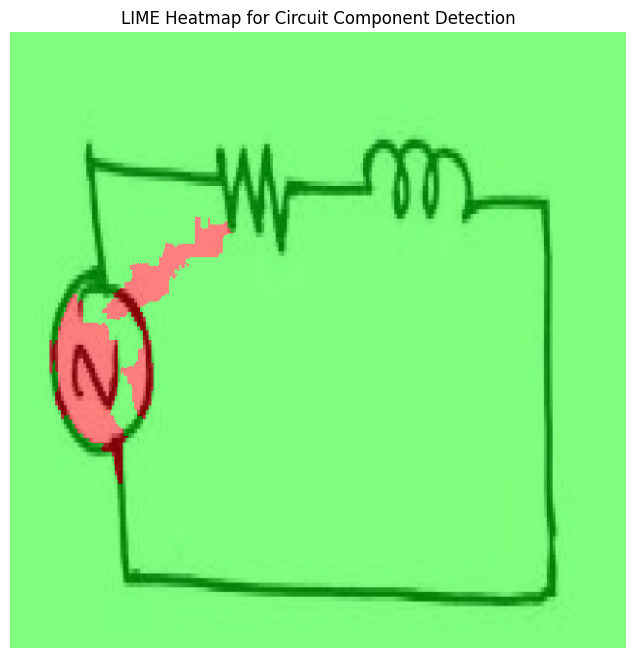

In [26]:
import lime
import lime.lime_image
import numpy as np
import cv2
import torch
import matplotlib.pyplot as plt
from skimage.segmentation import mark_boundaries
from torchvision.transforms import ToTensor
from PIL import Image
from ultralytics import YOLO

# ✅ Load YOLO Model
model_path = r"F:\yolov12ckt\runs\detect\train29\weights\best.pt"
device = "cuda" if torch.cuda.is_available() else "cpu"
model = YOLO(model_path).eval().to(device)

# ✅ Load Circuit Image
image_path = r"F:\yolov12ckt\dataset\test\images\Screenshot-2025-03-01-183358_png.rf.17d52f9b467c92f7942ab9025f89c782.jpg"
image = Image.open(image_path).convert("RGB")
image_np = np.array(image)

# ✅ Define a Fixed Number of Classes
MAX_CLASSES = 10  # Adjust if needed

# ✅ Define Prediction Function for LIME
def predict_fn(images):
    images = [ToTensor()(Image.fromarray(img)).unsqueeze(0).to(device) for img in images]
    inputs = torch.cat(images, dim=0)
    results = model(inputs)  # YOLO model prediction

    batch_scores = []
    for res in results:
        if res.boxes.shape[0] > 0:
            scores = res.boxes.conf.cpu().numpy()  # Confidence scores
        else:
            scores = np.zeros(MAX_CLASSES)  # No detection case

        # 🔥 Normalize scores & ensure fixed size
        scores_padded = np.pad(scores, (0, max(0, MAX_CLASSES - len(scores))), mode='constant', constant_values=0)
        batch_scores.append(scores_padded[:MAX_CLASSES])  # Trim if needed

    return np.array(batch_scores)

# ✅ Initialize LIME Explainer
explainer = lime.lime_image.LimeImageExplainer()

# ✅ Explain Image using LIME
explanation = explainer.explain_instance(
    image_np,
    predict_fn,
    top_labels=5,
    hide_color=None,  # Allow LIME to focus on features
    num_samples=1000
)

# ✅ Generate Improved Heatmap
temp, mask = explanation.get_image_and_mask(
    explanation.top_labels[0],
    positive_only=True,
    num_features=5,  # Reduce to focus on detected areas
    hide_rest=False
)

# ✅ Convert mask to heatmap using 'jet' colormap
heatmap = np.zeros_like(temp, dtype=np.float32)
heatmap[..., 0] = mask * 255  # Red for detected regions
heatmap[..., 1] = (1 - mask) * 255  # Green for non-detected areas

# ✅ Overlay Heatmap on Original Image
overlay = cv2.addWeighted(image_np, 0.5, heatmap.astype(np.uint8), 0.5, 0)

# ✅ Display the heatmap
plt.figure(figsize=(8, 8))
plt.imshow(overlay, cmap="jet")  # Use better colormap
plt.title("LIME Heatmap for Circuit Component Detection")
plt.axis("off")
plt.show()



WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 1 Inductor, 1 Resistor, 1201.1ms
Speed: 0.0ms preprocess, 1201.1ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


  0%|          | 0/1000 [00:00<?, ?it/s]


0: 640x640 1 Gnd, 1490.1ms
Speed: 0.0ms preprocess, 1490.1ms inference, 3.1ms postprocess per image at shape (1, 3, 640, 640)


  0%|          | 1/1000 [00:01<25:02,  1.50s/it]


0: 640x640 2 Gnds, 1219.1ms
Speed: 0.0ms preprocess, 1219.1ms inference, 6.7ms postprocess per image at shape (1, 3, 640, 640)


  0%|          | 2/1000 [00:02<22:21,  1.34s/it]


0: 640x640 (no detections), 1205.7ms
Speed: 0.0ms preprocess, 1205.7ms inference, 4.6ms postprocess per image at shape (1, 3, 640, 640)


  0%|          | 3/1000 [00:03<21:23,  1.29s/it]


0: 640x640 1 Gnd, 1116.0ms
Speed: 0.0ms preprocess, 1116.0ms inference, 5.0ms postprocess per image at shape (1, 3, 640, 640)


  0%|          | 4/1000 [00:05<20:21,  1.23s/it]


0: 640x640 (no detections), 1314.3ms
Speed: 0.0ms preprocess, 1314.3ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


  0%|          | 5/1000 [00:06<20:56,  1.26s/it]


0: 640x640 (no detections), 1068.0ms
Speed: 0.0ms preprocess, 1068.0ms inference, 4.9ms postprocess per image at shape (1, 3, 640, 640)


  1%|          | 6/1000 [00:07<19:52,  1.20s/it]


0: 640x640 1 Gnd, 1218.3ms
Speed: 0.0ms preprocess, 1218.3ms inference, 4.1ms postprocess per image at shape (1, 3, 640, 640)


  1%|          | 7/1000 [00:08<20:00,  1.21s/it]


0: 640x640 3 Gnds, 870.9ms
Speed: 0.0ms preprocess, 870.9ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


  1%|          | 8/1000 [00:09<18:16,  1.11s/it]


0: 640x640 2 Gnds, 812.9ms
Speed: 0.0ms preprocess, 812.9ms inference, 4.2ms postprocess per image at shape (1, 3, 640, 640)


  1%|          | 9/1000 [00:10<16:47,  1.02s/it]


0: 640x640 2 Gnds, 734.7ms
Speed: 0.0ms preprocess, 734.7ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


  1%|          | 10/1000 [00:11<15:24,  1.07it/s]


0: 640x640 (no detections), 858.7ms
Speed: 0.0ms preprocess, 858.7ms inference, 8.6ms postprocess per image at shape (1, 3, 640, 640)


  1%|          | 11/1000 [00:12<15:04,  1.09it/s]


0: 640x640 1 Gnd, 1036.6ms
Speed: 0.0ms preprocess, 1036.6ms inference, 4.6ms postprocess per image at shape (1, 3, 640, 640)


  1%|          | 12/1000 [00:13<15:42,  1.05it/s]


0: 640x640 1 Capacitor, 1 Gnd, 1294.5ms
Speed: 0.0ms preprocess, 1294.5ms inference, 4.4ms postprocess per image at shape (1, 3, 640, 640)


  1%|▏         | 13/1000 [00:14<17:27,  1.06s/it]


0: 640x640 (no detections), 1039.0ms
Speed: 0.0ms preprocess, 1039.0ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)


  1%|▏         | 14/1000 [00:15<17:23,  1.06s/it]


0: 640x640 (no detections), 1220.0ms
Speed: 0.0ms preprocess, 1220.0ms inference, 5.0ms postprocess per image at shape (1, 3, 640, 640)


  2%|▏         | 15/1000 [00:16<18:14,  1.11s/it]


0: 640x640 (no detections), 1364.6ms
Speed: 0.0ms preprocess, 1364.6ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


  2%|▏         | 16/1000 [00:18<19:31,  1.19s/it]


0: 640x640 (no detections), 1297.5ms
Speed: 0.0ms preprocess, 1297.5ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


  2%|▏         | 17/1000 [00:19<20:06,  1.23s/it]


0: 640x640 (no detections), 953.8ms
Speed: 0.0ms preprocess, 953.8ms inference, 4.6ms postprocess per image at shape (1, 3, 640, 640)


  2%|▏         | 18/1000 [00:20<18:49,  1.15s/it]


0: 640x640 2 Gnds, 1260.0ms
Speed: 0.0ms preprocess, 1260.0ms inference, 3.9ms postprocess per image at shape (1, 3, 640, 640)


  2%|▏         | 19/1000 [00:21<19:23,  1.19s/it]


0: 640x640 (no detections), 1222.8ms
Speed: 0.0ms preprocess, 1222.8ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


  2%|▏         | 20/1000 [00:22<19:34,  1.20s/it]


0: 640x640 (no detections), 871.3ms
Speed: 0.0ms preprocess, 871.3ms inference, 4.6ms postprocess per image at shape (1, 3, 640, 640)


  2%|▏         | 21/1000 [00:23<18:02,  1.11s/it]


0: 640x640 1 Gnd, 1016.6ms
Speed: 0.0ms preprocess, 1016.6ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)


  2%|▏         | 22/1000 [00:24<17:37,  1.08s/it]


0: 640x640 1 Gnd, 814.8ms
Speed: 0.0ms preprocess, 814.8ms inference, 6.0ms postprocess per image at shape (1, 3, 640, 640)


  2%|▏         | 23/1000 [00:25<16:22,  1.01s/it]


0: 640x640 (no detections), 1183.9ms
Speed: 0.0ms preprocess, 1183.9ms inference, 4.5ms postprocess per image at shape (1, 3, 640, 640)


  2%|▏         | 24/1000 [00:26<17:16,  1.06s/it]


0: 640x640 (no detections), 997.0ms
Speed: 0.0ms preprocess, 997.0ms inference, 19.3ms postprocess per image at shape (1, 3, 640, 640)


  2%|▎         | 25/1000 [00:27<17:04,  1.05s/it]


0: 640x640 (no detections), 785.0ms
Speed: 0.0ms preprocess, 785.0ms inference, 2.4ms postprocess per image at shape (1, 3, 640, 640)


  3%|▎         | 26/1000 [00:28<15:54,  1.02it/s]


0: 640x640 (no detections), 864.9ms
Speed: 0.0ms preprocess, 864.9ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


  3%|▎         | 27/1000 [00:29<15:23,  1.05it/s]


0: 640x640 1 Gnd, 712.8ms
Speed: 0.0ms preprocess, 712.8ms inference, 4.1ms postprocess per image at shape (1, 3, 640, 640)


  3%|▎         | 28/1000 [00:30<14:16,  1.14it/s]


0: 640x640 (no detections), 771.4ms
Speed: 0.0ms preprocess, 771.4ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


  3%|▎         | 29/1000 [00:30<13:47,  1.17it/s]


0: 640x640 1 Gnd, 742.6ms
Speed: 0.0ms preprocess, 742.6ms inference, 6.8ms postprocess per image at shape (1, 3, 640, 640)


  3%|▎         | 30/1000 [00:31<13:19,  1.21it/s]


0: 640x640 2 Gnds, 810.4ms
Speed: 0.0ms preprocess, 810.4ms inference, 2.9ms postprocess per image at shape (1, 3, 640, 640)


  3%|▎         | 31/1000 [00:32<13:17,  1.21it/s]


0: 640x640 1 Gnd, 707.3ms
Speed: 0.0ms preprocess, 707.3ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


  3%|▎         | 32/1000 [00:33<12:45,  1.26it/s]


0: 640x640 1 Gnd, 707.6ms
Speed: 0.0ms preprocess, 707.6ms inference, 3.2ms postprocess per image at shape (1, 3, 640, 640)


  3%|▎         | 33/1000 [00:34<12:24,  1.30it/s]


0: 640x640 (no detections), 677.4ms
Speed: 0.0ms preprocess, 677.4ms inference, 3.8ms postprocess per image at shape (1, 3, 640, 640)


  3%|▎         | 34/1000 [00:34<12:00,  1.34it/s]


0: 640x640 (no detections), 773.4ms
Speed: 0.0ms preprocess, 773.4ms inference, 5.6ms postprocess per image at shape (1, 3, 640, 640)


  4%|▎         | 35/1000 [00:35<12:10,  1.32it/s]


0: 640x640 (no detections), 718.1ms
Speed: 0.0ms preprocess, 718.1ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


  4%|▎         | 36/1000 [00:36<12:00,  1.34it/s]


0: 640x640 (no detections), 702.6ms
Speed: 0.0ms preprocess, 702.6ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


  4%|▎         | 37/1000 [00:36<11:50,  1.36it/s]


0: 640x640 (no detections), 683.5ms
Speed: 0.0ms preprocess, 683.5ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)


  4%|▍         | 38/1000 [00:37<11:35,  1.38it/s]


0: 640x640 (no detections), 699.5ms
Speed: 0.0ms preprocess, 699.5ms inference, 2.3ms postprocess per image at shape (1, 3, 640, 640)


  4%|▍         | 39/1000 [00:38<11:30,  1.39it/s]


0: 640x640 1 Capacitor, 3 Gnds, 689.9ms
Speed: 0.0ms preprocess, 689.9ms inference, 3.2ms postprocess per image at shape (1, 3, 640, 640)


  4%|▍         | 40/1000 [00:39<11:25,  1.40it/s]


0: 640x640 1 Gnd, 818.2ms
Speed: 0.0ms preprocess, 818.2ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


  4%|▍         | 41/1000 [00:39<11:55,  1.34it/s]


0: 640x640 (no detections), 729.0ms
Speed: 0.0ms preprocess, 729.0ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


  4%|▍         | 42/1000 [00:40<11:55,  1.34it/s]


0: 640x640 1 Gnd, 699.1ms
Speed: 0.0ms preprocess, 699.1ms inference, 5.0ms postprocess per image at shape (1, 3, 640, 640)


  4%|▍         | 43/1000 [00:41<11:43,  1.36it/s]


0: 640x640 (no detections), 692.4ms
Speed: 0.0ms preprocess, 692.4ms inference, 3.4ms postprocess per image at shape (1, 3, 640, 640)


  4%|▍         | 44/1000 [00:42<11:33,  1.38it/s]


0: 640x640 (no detections), 690.6ms
Speed: 0.0ms preprocess, 690.6ms inference, 3.2ms postprocess per image at shape (1, 3, 640, 640)


  4%|▍         | 45/1000 [00:42<11:26,  1.39it/s]


0: 640x640 (no detections), 700.0ms
Speed: 0.0ms preprocess, 700.0ms inference, 4.7ms postprocess per image at shape (1, 3, 640, 640)


  5%|▍         | 46/1000 [00:43<11:23,  1.40it/s]


0: 640x640 (no detections), 756.8ms
Speed: 0.0ms preprocess, 756.8ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


  5%|▍         | 47/1000 [00:44<11:35,  1.37it/s]


0: 640x640 1 Gnd, 752.9ms
Speed: 0.0ms preprocess, 752.9ms inference, 3.3ms postprocess per image at shape (1, 3, 640, 640)


  5%|▍         | 48/1000 [00:44<11:45,  1.35it/s]


0: 640x640 3 Gnds, 685.3ms
Speed: 0.0ms preprocess, 685.3ms inference, 8.0ms postprocess per image at shape (1, 3, 640, 640)


  5%|▍         | 49/1000 [00:45<11:33,  1.37it/s]


0: 640x640 (no detections), 694.3ms
Speed: 0.0ms preprocess, 694.3ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


  5%|▌         | 50/1000 [00:46<11:23,  1.39it/s]


0: 640x640 3 Gnds, 709.3ms
Speed: 0.0ms preprocess, 709.3ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


  5%|▌         | 51/1000 [00:47<11:24,  1.39it/s]


0: 640x640 1 Gnd, 691.2ms
Speed: 0.0ms preprocess, 691.2ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


  5%|▌         | 52/1000 [00:47<11:18,  1.40it/s]


0: 640x640 (no detections), 690.5ms
Speed: 0.0ms preprocess, 690.5ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


  5%|▌         | 53/1000 [00:48<11:12,  1.41it/s]


0: 640x640 1 Capacitor, 1 Gnd, 772.7ms
Speed: 0.0ms preprocess, 772.7ms inference, 4.4ms postprocess per image at shape (1, 3, 640, 640)


  5%|▌         | 54/1000 [00:49<11:33,  1.36it/s]


0: 640x640 (no detections), 702.9ms
Speed: 0.0ms preprocess, 702.9ms inference, 2.8ms postprocess per image at shape (1, 3, 640, 640)


  6%|▌         | 55/1000 [00:49<11:26,  1.38it/s]


0: 640x640 (no detections), 703.6ms
Speed: 0.0ms preprocess, 703.6ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


  6%|▌         | 56/1000 [00:50<11:20,  1.39it/s]


0: 640x640 1 Gnd, 697.0ms
Speed: 0.0ms preprocess, 697.0ms inference, 3.6ms postprocess per image at shape (1, 3, 640, 640)


  6%|▌         | 57/1000 [00:51<11:14,  1.40it/s]


0: 640x640 1 Gnd, 708.2ms
Speed: 0.0ms preprocess, 708.2ms inference, 4.3ms postprocess per image at shape (1, 3, 640, 640)


  6%|▌         | 58/1000 [00:52<11:14,  1.40it/s]


0: 640x640 (no detections), 695.7ms
Speed: 0.0ms preprocess, 695.7ms inference, 3.3ms postprocess per image at shape (1, 3, 640, 640)


  6%|▌         | 59/1000 [00:52<11:09,  1.40it/s]


0: 640x640 (no detections), 792.8ms
Speed: 0.0ms preprocess, 792.8ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


  6%|▌         | 60/1000 [00:53<11:33,  1.36it/s]


0: 640x640 (no detections), 704.4ms
Speed: 0.0ms preprocess, 704.4ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


  6%|▌         | 61/1000 [00:54<11:27,  1.37it/s]


0: 640x640 (no detections), 688.5ms
Speed: 0.0ms preprocess, 688.5ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


  6%|▌         | 62/1000 [00:55<11:15,  1.39it/s]


0: 640x640 (no detections), 689.4ms
Speed: 0.0ms preprocess, 689.4ms inference, 2.2ms postprocess per image at shape (1, 3, 640, 640)


  6%|▋         | 63/1000 [00:55<11:10,  1.40it/s]


0: 640x640 1 Capacitor, 2 Gnds, 705.1ms
Speed: 0.0ms preprocess, 705.1ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


  6%|▋         | 64/1000 [00:56<11:09,  1.40it/s]


0: 640x640 (no detections), 863.7ms
Speed: 0.0ms preprocess, 863.7ms inference, 3.2ms postprocess per image at shape (1, 3, 640, 640)


  6%|▋         | 65/1000 [00:57<11:51,  1.31it/s]


0: 640x640 (no detections), 793.7ms
Speed: 0.0ms preprocess, 793.7ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)


  7%|▋         | 66/1000 [00:58<12:02,  1.29it/s]


0: 640x640 1 Gnd, 708.1ms
Speed: 0.0ms preprocess, 708.1ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


  7%|▋         | 67/1000 [00:58<11:44,  1.32it/s]


0: 640x640 1 Capacitor, 2 Gnds, 779.6ms
Speed: 0.0ms preprocess, 779.6ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


  7%|▋         | 68/1000 [00:59<11:52,  1.31it/s]


0: 640x640 2 Gnds, 698.7ms
Speed: 0.0ms preprocess, 698.7ms inference, 10.8ms postprocess per image at shape (1, 3, 640, 640)


  7%|▋         | 69/1000 [01:00<11:40,  1.33it/s]


0: 640x640 (no detections), 699.9ms
Speed: 0.0ms preprocess, 699.9ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


  7%|▋         | 70/1000 [01:01<11:26,  1.36it/s]


0: 640x640 1 Capacitor, 1 Gnd, 700.2ms
Speed: 0.0ms preprocess, 700.2ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


  7%|▋         | 71/1000 [01:01<11:17,  1.37it/s]


0: 640x640 (no detections), 793.8ms
Speed: 0.0ms preprocess, 793.8ms inference, 5.3ms postprocess per image at shape (1, 3, 640, 640)


  7%|▋         | 72/1000 [01:02<11:37,  1.33it/s]


0: 640x640 (no detections), 734.4ms
Speed: 0.0ms preprocess, 734.4ms inference, 6.3ms postprocess per image at shape (1, 3, 640, 640)


  7%|▋         | 73/1000 [01:03<11:36,  1.33it/s]


0: 640x640 (no detections), 690.2ms
Speed: 0.0ms preprocess, 690.2ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 640)


  7%|▋         | 74/1000 [01:03<11:21,  1.36it/s]


0: 640x640 1 Gnd, 725.1ms
Speed: 0.0ms preprocess, 725.1ms inference, 3.1ms postprocess per image at shape (1, 3, 640, 640)


  8%|▊         | 75/1000 [01:04<11:20,  1.36it/s]


0: 640x640 1 Gnd, 690.7ms
Speed: 0.0ms preprocess, 690.7ms inference, 10.3ms postprocess per image at shape (1, 3, 640, 640)


  8%|▊         | 76/1000 [01:05<11:12,  1.37it/s]


0: 640x640 3 Gnds, 685.9ms
Speed: 0.0ms preprocess, 685.9ms inference, 4.9ms postprocess per image at shape (1, 3, 640, 640)


  8%|▊         | 77/1000 [01:06<11:03,  1.39it/s]


0: 640x640 (no detections), 781.0ms
Speed: 0.0ms preprocess, 781.0ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


  8%|▊         | 78/1000 [01:06<11:21,  1.35it/s]


0: 640x640 1 Gnd, 695.7ms
Speed: 0.0ms preprocess, 695.7ms inference, 7.8ms postprocess per image at shape (1, 3, 640, 640)


  8%|▊         | 79/1000 [01:07<11:13,  1.37it/s]


0: 640x640 (no detections), 695.3ms
Speed: 0.0ms preprocess, 695.3ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


  8%|▊         | 80/1000 [01:08<11:03,  1.39it/s]


0: 640x640 1 Gnd, 699.8ms
Speed: 0.0ms preprocess, 699.8ms inference, 3.4ms postprocess per image at shape (1, 3, 640, 640)


  8%|▊         | 81/1000 [01:09<11:00,  1.39it/s]


0: 640x640 1 Gnd, 712.1ms
Speed: 0.0ms preprocess, 712.1ms inference, 10.6ms postprocess per image at shape (1, 3, 640, 640)


  8%|▊         | 82/1000 [01:09<11:03,  1.38it/s]


0: 640x640 (no detections), 706.5ms
Speed: 0.0ms preprocess, 706.5ms inference, 3.2ms postprocess per image at shape (1, 3, 640, 640)


  8%|▊         | 83/1000 [01:10<11:00,  1.39it/s]


0: 640x640 1 Capacitor, 2 Gnds, 792.3ms
Speed: 0.0ms preprocess, 792.3ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


  8%|▊         | 84/1000 [01:11<11:21,  1.34it/s]


0: 640x640 (no detections), 697.9ms
Speed: 0.0ms preprocess, 697.9ms inference, 8.0ms postprocess per image at shape (1, 3, 640, 640)


  8%|▊         | 85/1000 [01:12<11:11,  1.36it/s]


0: 640x640 2 Gnds, 696.5ms
Speed: 0.0ms preprocess, 696.5ms inference, 4.2ms postprocess per image at shape (1, 3, 640, 640)


  9%|▊         | 86/1000 [01:12<11:03,  1.38it/s]


0: 640x640 2 Gnds, 716.1ms
Speed: 0.0ms preprocess, 716.1ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


  9%|▊         | 87/1000 [01:13<11:01,  1.38it/s]


0: 640x640 1 Gnd, 722.5ms
Speed: 0.0ms preprocess, 722.5ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


  9%|▉         | 88/1000 [01:14<11:04,  1.37it/s]


0: 640x640 (no detections), 715.6ms
Speed: 0.0ms preprocess, 715.6ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)


  9%|▉         | 89/1000 [01:14<11:03,  1.37it/s]


0: 640x640 (no detections), 854.7ms
Speed: 0.0ms preprocess, 854.7ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


  9%|▉         | 90/1000 [01:15<11:38,  1.30it/s]


0: 640x640 1 Gnd, 701.0ms
Speed: 0.0ms preprocess, 701.0ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


  9%|▉         | 91/1000 [01:16<11:23,  1.33it/s]


0: 640x640 (no detections), 699.1ms
Speed: 0.0ms preprocess, 699.1ms inference, 8.8ms postprocess per image at shape (1, 3, 640, 640)


  9%|▉         | 92/1000 [01:17<11:11,  1.35it/s]


0: 640x640 1 Capacitor, 1 Gnd, 709.7ms
Speed: 0.0ms preprocess, 709.7ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


  9%|▉         | 93/1000 [01:17<11:02,  1.37it/s]


0: 640x640 1 Capacitor, 2 Gnds, 864.3ms
Speed: 0.0ms preprocess, 864.3ms inference, 3.7ms postprocess per image at shape (1, 3, 640, 640)


  9%|▉         | 94/1000 [01:18<11:43,  1.29it/s]


0: 640x640 2 Gnds, 761.2ms
Speed: 0.0ms preprocess, 761.2ms inference, 3.2ms postprocess per image at shape (1, 3, 640, 640)


 10%|▉         | 95/1000 [01:19<11:41,  1.29it/s]


0: 640x640 1 Gnd, 787.5ms
Speed: 0.0ms preprocess, 787.5ms inference, 7.2ms postprocess per image at shape (1, 3, 640, 640)


 10%|▉         | 96/1000 [01:20<11:48,  1.28it/s]


0: 640x640 (no detections), 700.2ms
Speed: 0.0ms preprocess, 700.2ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 10%|▉         | 97/1000 [01:21<11:26,  1.31it/s]


0: 640x640 (no detections), 728.8ms
Speed: 0.0ms preprocess, 728.8ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 10%|▉         | 98/1000 [01:21<11:18,  1.33it/s]


0: 640x640 1 Gnd, 713.8ms
Speed: 0.0ms preprocess, 713.8ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 10%|▉         | 99/1000 [01:22<11:12,  1.34it/s]


0: 640x640 1 Capacitor, 1 Gnd, 701.2ms
Speed: 0.0ms preprocess, 701.2ms inference, 4.9ms postprocess per image at shape (1, 3, 640, 640)


 10%|█         | 100/1000 [01:23<11:02,  1.36it/s]


0: 640x640 1 Gnd, 712.9ms
Speed: 0.0ms preprocess, 712.9ms inference, 4.1ms postprocess per image at shape (1, 3, 640, 640)


 10%|█         | 101/1000 [01:23<10:57,  1.37it/s]


0: 640x640 1 Gnd, 790.3ms
Speed: 0.0ms preprocess, 790.3ms inference, 3.4ms postprocess per image at shape (1, 3, 640, 640)


 10%|█         | 102/1000 [01:24<11:15,  1.33it/s]


0: 640x640 (no detections), 717.8ms
Speed: 0.0ms preprocess, 717.8ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)


 10%|█         | 103/1000 [01:25<11:07,  1.34it/s]


0: 640x640 (no detections), 689.9ms
Speed: 0.0ms preprocess, 689.9ms inference, 4.1ms postprocess per image at shape (1, 3, 640, 640)


 10%|█         | 104/1000 [01:26<10:55,  1.37it/s]


0: 640x640 (no detections), 710.4ms
Speed: 0.0ms preprocess, 710.4ms inference, 7.0ms postprocess per image at shape (1, 3, 640, 640)


 10%|█         | 105/1000 [01:26<10:53,  1.37it/s]


0: 640x640 (no detections), 766.7ms
Speed: 0.0ms preprocess, 766.7ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)


 11%|█         | 106/1000 [01:27<11:05,  1.34it/s]


0: 640x640 1 Gnd, 701.5ms
Speed: 0.0ms preprocess, 701.5ms inference, 3.2ms postprocess per image at shape (1, 3, 640, 640)


 11%|█         | 107/1000 [01:28<10:55,  1.36it/s]


0: 640x640 (no detections), 792.3ms
Speed: 0.0ms preprocess, 792.3ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 11%|█         | 108/1000 [01:29<11:10,  1.33it/s]


0: 640x640 1 Gnd, 791.8ms
Speed: 0.0ms preprocess, 791.8ms inference, 2.9ms postprocess per image at shape (1, 3, 640, 640)


 11%|█         | 109/1000 [01:30<11:25,  1.30it/s]


0: 640x640 (no detections), 699.8ms
Speed: 0.0ms preprocess, 699.8ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 11%|█         | 110/1000 [01:30<11:08,  1.33it/s]


0: 640x640 2 Gnds, 699.2ms
Speed: 0.0ms preprocess, 699.2ms inference, 6.8ms postprocess per image at shape (1, 3, 640, 640)


 11%|█         | 111/1000 [01:31<10:56,  1.35it/s]


0: 640x640 2 Gnds, 701.4ms
Speed: 0.0ms preprocess, 701.4ms inference, 3.2ms postprocess per image at shape (1, 3, 640, 640)


 11%|█         | 112/1000 [01:32<10:48,  1.37it/s]


0: 640x640 (no detections), 702.7ms
Speed: 0.0ms preprocess, 702.7ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 11%|█▏        | 113/1000 [01:32<10:42,  1.38it/s]


0: 640x640 (no detections), 800.0ms
Speed: 0.0ms preprocess, 800.0ms inference, 4.6ms postprocess per image at shape (1, 3, 640, 640)


 11%|█▏        | 114/1000 [01:33<11:04,  1.33it/s]


0: 640x640 (no detections), 701.9ms
Speed: 0.0ms preprocess, 701.9ms inference, 7.2ms postprocess per image at shape (1, 3, 640, 640)


 12%|█▏        | 115/1000 [01:34<10:53,  1.35it/s]


0: 640x640 1 Gnd, 714.4ms
Speed: 0.0ms preprocess, 714.4ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)


 12%|█▏        | 116/1000 [01:35<10:49,  1.36it/s]


0: 640x640 (no detections), 741.9ms
Speed: 0.0ms preprocess, 741.9ms inference, 3.2ms postprocess per image at shape (1, 3, 640, 640)


 12%|█▏        | 117/1000 [01:35<10:52,  1.35it/s]


0: 640x640 1 Gnd, 708.9ms
Speed: 0.0ms preprocess, 708.9ms inference, 5.9ms postprocess per image at shape (1, 3, 640, 640)


 12%|█▏        | 118/1000 [01:36<10:47,  1.36it/s]


0: 640x640 2 Gnds, 711.7ms
Speed: 0.0ms preprocess, 711.7ms inference, 4.7ms postprocess per image at shape (1, 3, 640, 640)


 12%|█▏        | 119/1000 [01:37<10:43,  1.37it/s]


0: 640x640 1 Gnd, 813.5ms
Speed: 0.0ms preprocess, 813.5ms inference, 3.3ms postprocess per image at shape (1, 3, 640, 640)


 12%|█▏        | 120/1000 [01:38<11:06,  1.32it/s]


0: 640x640 2 Gnds, 729.2ms
Speed: 0.0ms preprocess, 729.2ms inference, 4.4ms postprocess per image at shape (1, 3, 640, 640)


 12%|█▏        | 121/1000 [01:38<11:00,  1.33it/s]


0: 640x640 1 Gnd, 726.8ms
Speed: 0.0ms preprocess, 726.8ms inference, 2.2ms postprocess per image at shape (1, 3, 640, 640)


 12%|█▏        | 122/1000 [01:39<10:55,  1.34it/s]


0: 640x640 (no detections), 704.1ms
Speed: 0.0ms preprocess, 704.1ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 12%|█▏        | 123/1000 [01:40<10:44,  1.36it/s]


0: 640x640 1 Gnd, 712.6ms
Speed: 0.0ms preprocess, 712.6ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 12%|█▏        | 124/1000 [01:41<10:41,  1.37it/s]


0: 640x640 (no detections), 720.0ms
Speed: 0.0ms preprocess, 720.0ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 12%|█▎        | 125/1000 [01:41<10:39,  1.37it/s]


0: 640x640 1 Capacitor, 2 Gnds, 804.0ms
Speed: 0.0ms preprocess, 804.0ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 13%|█▎        | 126/1000 [01:42<11:00,  1.32it/s]


0: 640x640 1 Capacitor, 2 Gnds, 704.6ms
Speed: 0.0ms preprocess, 704.6ms inference, 2.2ms postprocess per image at shape (1, 3, 640, 640)


 13%|█▎        | 127/1000 [01:43<10:49,  1.34it/s]


0: 640x640 (no detections), 713.7ms
Speed: 0.0ms preprocess, 713.7ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)


 13%|█▎        | 128/1000 [01:43<10:42,  1.36it/s]


0: 640x640 (no detections), 717.4ms
Speed: 0.0ms preprocess, 717.4ms inference, 4.8ms postprocess per image at shape (1, 3, 640, 640)


 13%|█▎        | 129/1000 [01:44<10:40,  1.36it/s]


0: 640x640 1 Gnd, 726.6ms
Speed: 0.0ms preprocess, 726.6ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 13%|█▎        | 130/1000 [01:45<10:40,  1.36it/s]


0: 640x640 (no detections), 700.5ms
Speed: 0.0ms preprocess, 700.5ms inference, 8.6ms postprocess per image at shape (1, 3, 640, 640)


 13%|█▎        | 131/1000 [01:46<10:34,  1.37it/s]


0: 640x640 1 Capacitor, 3 Gnds, 803.1ms
Speed: 0.0ms preprocess, 803.1ms inference, 2.8ms postprocess per image at shape (1, 3, 640, 640)


 13%|█▎        | 132/1000 [01:46<10:55,  1.32it/s]


0: 640x640 2 Gnds, 711.9ms
Speed: 0.0ms preprocess, 711.9ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 13%|█▎        | 133/1000 [01:47<10:44,  1.34it/s]


0: 640x640 (no detections), 703.6ms
Speed: 0.0ms preprocess, 703.6ms inference, 5.2ms postprocess per image at shape (1, 3, 640, 640)


 13%|█▎        | 134/1000 [01:48<10:37,  1.36it/s]


0: 640x640 (no detections), 728.8ms
Speed: 0.0ms preprocess, 728.8ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)


 14%|█▎        | 135/1000 [01:49<10:36,  1.36it/s]


0: 640x640 3 Gnds, 707.5ms
Speed: 0.0ms preprocess, 707.5ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 640)


 14%|█▎        | 136/1000 [01:49<10:30,  1.37it/s]


0: 640x640 (no detections), 716.1ms
Speed: 0.0ms preprocess, 716.1ms inference, 10.0ms postprocess per image at shape (1, 3, 640, 640)


 14%|█▎        | 137/1000 [01:50<10:30,  1.37it/s]


0: 640x640 (no detections), 842.9ms
Speed: 0.0ms preprocess, 842.9ms inference, 2.2ms postprocess per image at shape (1, 3, 640, 640)


 14%|█▍        | 138/1000 [01:51<11:00,  1.31it/s]


0: 640x640 1 Capacitor, 1 Gnd, 714.7ms
Speed: 0.0ms preprocess, 714.7ms inference, 7.3ms postprocess per image at shape (1, 3, 640, 640)


 14%|█▍        | 139/1000 [01:52<10:50,  1.32it/s]


0: 640x640 (no detections), 754.4ms
Speed: 0.0ms preprocess, 754.4ms inference, 2.8ms postprocess per image at shape (1, 3, 640, 640)


 14%|█▍        | 140/1000 [01:52<10:52,  1.32it/s]


0: 640x640 (no detections), 760.4ms
Speed: 0.0ms preprocess, 760.4ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 14%|█▍        | 141/1000 [01:53<10:53,  1.31it/s]


0: 640x640 1 Capacitor, 1 Gnd, 719.0ms
Speed: 0.0ms preprocess, 719.0ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)


 14%|█▍        | 142/1000 [01:54<10:45,  1.33it/s]


0: 640x640 1 Gnd, 713.9ms
Speed: 0.0ms preprocess, 713.9ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 14%|█▍        | 143/1000 [01:55<10:37,  1.34it/s]


0: 640x640 (no detections), 827.5ms
Speed: 0.0ms preprocess, 827.5ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 14%|█▍        | 144/1000 [01:56<11:00,  1.30it/s]


0: 640x640 (no detections), 726.4ms
Speed: 0.0ms preprocess, 726.4ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)


 14%|█▍        | 145/1000 [01:56<10:50,  1.31it/s]


0: 640x640 (no detections), 715.3ms
Speed: 0.0ms preprocess, 715.3ms inference, 2.6ms postprocess per image at shape (1, 3, 640, 640)


 15%|█▍        | 146/1000 [01:57<10:39,  1.34it/s]


0: 640x640 (no detections), 795.4ms
Speed: 0.0ms preprocess, 795.4ms inference, 10.2ms postprocess per image at shape (1, 3, 640, 640)


 15%|█▍        | 147/1000 [01:58<10:54,  1.30it/s]


0: 640x640 2 Gnds, 724.0ms
Speed: 0.0ms preprocess, 724.0ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 15%|█▍        | 148/1000 [01:59<10:44,  1.32it/s]


0: 640x640 1 Gnd, 730.8ms
Speed: 0.0ms preprocess, 730.8ms inference, 3.8ms postprocess per image at shape (1, 3, 640, 640)


 15%|█▍        | 149/1000 [01:59<10:40,  1.33it/s]


0: 640x640 1 Capacitor, 1 Gnd, 867.4ms
Speed: 0.0ms preprocess, 867.4ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)


 15%|█▌        | 150/1000 [02:00<11:11,  1.27it/s]


0: 640x640 1 Gnd, 739.2ms
Speed: 0.0ms preprocess, 739.2ms inference, 4.1ms postprocess per image at shape (1, 3, 640, 640)


 15%|█▌        | 151/1000 [02:01<11:00,  1.29it/s]


0: 640x640 1 Capacitor, 3 Gnds, 744.6ms
Speed: 0.0ms preprocess, 744.6ms inference, 2.9ms postprocess per image at shape (1, 3, 640, 640)


 15%|█▌        | 152/1000 [02:02<10:52,  1.30it/s]


0: 640x640 1 Capacitor, 1 Gnd, 736.9ms
Speed: 0.0ms preprocess, 736.9ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 15%|█▌        | 153/1000 [02:02<10:45,  1.31it/s]


0: 640x640 (no detections), 727.9ms
Speed: 0.0ms preprocess, 727.9ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 15%|█▌        | 154/1000 [02:03<10:37,  1.33it/s]


0: 640x640 (no detections), 848.6ms
Speed: 0.0ms preprocess, 848.6ms inference, 3.8ms postprocess per image at shape (1, 3, 640, 640)


 16%|█▌        | 155/1000 [02:04<11:04,  1.27it/s]


0: 640x640 (no detections), 795.9ms
Speed: 0.0ms preprocess, 795.9ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 16%|█▌        | 156/1000 [02:05<11:10,  1.26it/s]


0: 640x640 1 Gnd, 727.5ms
Speed: 0.0ms preprocess, 727.5ms inference, 4.3ms postprocess per image at shape (1, 3, 640, 640)


 16%|█▌        | 157/1000 [02:06<10:56,  1.28it/s]


0: 640x640 1 Gnd, 737.2ms
Speed: 0.0ms preprocess, 737.2ms inference, 7.3ms postprocess per image at shape (1, 3, 640, 640)


 16%|█▌        | 158/1000 [02:06<10:48,  1.30it/s]


0: 640x640 1 Gnd, 714.0ms
Speed: 0.0ms preprocess, 714.0ms inference, 3.4ms postprocess per image at shape (1, 3, 640, 640)


 16%|█▌        | 159/1000 [02:07<10:36,  1.32it/s]


0: 640x640 (no detections), 750.1ms
Speed: 0.0ms preprocess, 750.1ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)


 16%|█▌        | 160/1000 [02:08<10:36,  1.32it/s]


0: 640x640 (no detections), 799.9ms
Speed: 0.0ms preprocess, 799.9ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


 16%|█▌        | 161/1000 [02:09<10:47,  1.30it/s]


0: 640x640 1 Gnd, 768.8ms
Speed: 0.0ms preprocess, 768.8ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 16%|█▌        | 162/1000 [02:09<10:50,  1.29it/s]


0: 640x640 2 Gnds, 731.8ms
Speed: 0.0ms preprocess, 731.8ms inference, 2.8ms postprocess per image at shape (1, 3, 640, 640)


 16%|█▋        | 163/1000 [02:10<10:40,  1.31it/s]


0: 640x640 (no detections), 729.2ms
Speed: 0.0ms preprocess, 729.2ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 16%|█▋        | 164/1000 [02:11<10:32,  1.32it/s]


0: 640x640 2 Gnds, 742.0ms
Speed: 0.0ms preprocess, 742.0ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 16%|█▋        | 165/1000 [02:12<10:31,  1.32it/s]


0: 640x640 1 Gnd, 734.2ms
Speed: 0.0ms preprocess, 734.2ms inference, 7.4ms postprocess per image at shape (1, 3, 640, 640)


 17%|█▋        | 166/1000 [02:12<10:29,  1.33it/s]


0: 640x640 2 Gnds, 818.1ms
Speed: 0.0ms preprocess, 818.1ms inference, 5.8ms postprocess per image at shape (1, 3, 640, 640)


 17%|█▋        | 167/1000 [02:13<10:47,  1.29it/s]


0: 640x640 3 Gnds, 752.6ms
Speed: 0.0ms preprocess, 752.6ms inference, 2.9ms postprocess per image at shape (1, 3, 640, 640)


 17%|█▋        | 168/1000 [02:14<10:43,  1.29it/s]


0: 640x640 1 Gnd, 753.9ms
Speed: 0.0ms preprocess, 753.9ms inference, 4.6ms postprocess per image at shape (1, 3, 640, 640)


 17%|█▋        | 169/1000 [02:15<10:41,  1.30it/s]


0: 640x640 (no detections), 731.4ms
Speed: 0.0ms preprocess, 731.4ms inference, 2.8ms postprocess per image at shape (1, 3, 640, 640)


 17%|█▋        | 170/1000 [02:15<10:32,  1.31it/s]


0: 640x640 1 Gnd, 730.1ms
Speed: 0.0ms preprocess, 730.1ms inference, 4.2ms postprocess per image at shape (1, 3, 640, 640)


 17%|█▋        | 171/1000 [02:16<10:26,  1.32it/s]


0: 640x640 1 Gnd, 727.3ms
Speed: 0.0ms preprocess, 727.3ms inference, 6.7ms postprocess per image at shape (1, 3, 640, 640)


 17%|█▋        | 172/1000 [02:17<10:22,  1.33it/s]


0: 640x640 (no detections), 831.2ms
Speed: 0.0ms preprocess, 831.2ms inference, 5.3ms postprocess per image at shape (1, 3, 640, 640)


 17%|█▋        | 173/1000 [02:18<10:44,  1.28it/s]


0: 640x640 1 Gnd, 732.7ms
Speed: 0.0ms preprocess, 732.7ms inference, 5.9ms postprocess per image at shape (1, 3, 640, 640)


 17%|█▋        | 174/1000 [02:19<10:34,  1.30it/s]


0: 640x640 1 Gnd, 734.5ms
Speed: 0.0ms preprocess, 734.5ms inference, 3.1ms postprocess per image at shape (1, 3, 640, 640)


 18%|█▊        | 175/1000 [02:19<10:28,  1.31it/s]


0: 640x640 (no detections), 740.3ms
Speed: 0.0ms preprocess, 740.3ms inference, 3.4ms postprocess per image at shape (1, 3, 640, 640)


 18%|█▊        | 176/1000 [02:20<10:23,  1.32it/s]


0: 640x640 1 Gnd, 734.3ms
Speed: 0.0ms preprocess, 734.3ms inference, 5.5ms postprocess per image at shape (1, 3, 640, 640)


 18%|█▊        | 177/1000 [02:21<10:20,  1.33it/s]


0: 640x640 1 Capacitor, 2 Gnds, 745.3ms
Speed: 0.0ms preprocess, 745.3ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)


 18%|█▊        | 178/1000 [02:21<10:19,  1.33it/s]


0: 640x640 (no detections), 814.4ms
Speed: 0.0ms preprocess, 814.4ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 18%|█▊        | 179/1000 [02:22<10:37,  1.29it/s]


0: 640x640 (no detections), 737.5ms
Speed: 0.0ms preprocess, 737.5ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 18%|█▊        | 180/1000 [02:23<10:29,  1.30it/s]


0: 640x640 (no detections), 776.0ms
Speed: 0.0ms preprocess, 776.0ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 18%|█▊        | 181/1000 [02:24<10:33,  1.29it/s]


0: 640x640 1 Gnd, 742.1ms
Speed: 0.0ms preprocess, 742.1ms inference, 3.3ms postprocess per image at shape (1, 3, 640, 640)


 18%|█▊        | 182/1000 [02:25<10:27,  1.30it/s]


0: 640x640 (no detections), 729.7ms
Speed: 0.0ms preprocess, 729.7ms inference, 3.4ms postprocess per image at shape (1, 3, 640, 640)


 18%|█▊        | 183/1000 [02:25<10:19,  1.32it/s]


0: 640x640 (no detections), 744.1ms
Speed: 0.0ms preprocess, 744.1ms inference, 3.3ms postprocess per image at shape (1, 3, 640, 640)


 18%|█▊        | 184/1000 [02:26<10:17,  1.32it/s]


0: 640x640 (no detections), 835.4ms
Speed: 0.0ms preprocess, 835.4ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)


 18%|█▊        | 185/1000 [02:27<10:38,  1.28it/s]


0: 640x640 1 Gnd, 855.7ms
Speed: 0.0ms preprocess, 855.7ms inference, 3.3ms postprocess per image at shape (1, 3, 640, 640)


 19%|█▊        | 186/1000 [02:28<10:57,  1.24it/s]


0: 640x640 (no detections), 733.1ms
Speed: 0.0ms preprocess, 733.1ms inference, 4.3ms postprocess per image at shape (1, 3, 640, 640)


 19%|█▊        | 187/1000 [02:29<10:40,  1.27it/s]


0: 640x640 (no detections), 724.2ms
Speed: 0.0ms preprocess, 724.2ms inference, 6.0ms postprocess per image at shape (1, 3, 640, 640)


 19%|█▉        | 188/1000 [02:29<10:26,  1.30it/s]


0: 640x640 2 Gnds, 849.1ms
Speed: 0.0ms preprocess, 849.1ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 19%|█▉        | 189/1000 [02:30<10:47,  1.25it/s]


0: 640x640 1 Gnd, 822.8ms
Speed: 0.0ms preprocess, 822.8ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 19%|█▉        | 190/1000 [02:31<10:55,  1.24it/s]


0: 640x640 (no detections), 779.7ms
Speed: 0.0ms preprocess, 779.7ms inference, 2.6ms postprocess per image at shape (1, 3, 640, 640)


 19%|█▉        | 191/1000 [02:32<10:48,  1.25it/s]


0: 640x640 (no detections), 729.9ms
Speed: 0.0ms preprocess, 729.9ms inference, 5.0ms postprocess per image at shape (1, 3, 640, 640)


 19%|█▉        | 192/1000 [02:33<10:33,  1.28it/s]


0: 640x640 (no detections), 746.9ms
Speed: 0.0ms preprocess, 746.9ms inference, 2.7ms postprocess per image at shape (1, 3, 640, 640)


 19%|█▉        | 193/1000 [02:33<10:26,  1.29it/s]


0: 640x640 1 Capacitor, 1 Gnd, 741.5ms
Speed: 0.0ms preprocess, 741.5ms inference, 3.1ms postprocess per image at shape (1, 3, 640, 640)


 19%|█▉        | 194/1000 [02:34<10:19,  1.30it/s]


0: 640x640 (no detections), 768.9ms
Speed: 0.0ms preprocess, 768.9ms inference, 2.3ms postprocess per image at shape (1, 3, 640, 640)


 20%|█▉        | 195/1000 [02:35<10:20,  1.30it/s]


0: 640x640 (no detections), 836.4ms
Speed: 0.0ms preprocess, 836.4ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 20%|█▉        | 196/1000 [02:36<10:38,  1.26it/s]


0: 640x640 (no detections), 726.9ms
Speed: 0.0ms preprocess, 726.9ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)


 20%|█▉        | 197/1000 [02:36<10:22,  1.29it/s]


0: 640x640 1 Gnd, 727.3ms
Speed: 1.0ms preprocess, 727.3ms inference, 3.3ms postprocess per image at shape (1, 3, 640, 640)


 20%|█▉        | 198/1000 [02:37<10:13,  1.31it/s]


0: 640x640 3 Gnds, 732.3ms
Speed: 0.0ms preprocess, 732.3ms inference, 7.2ms postprocess per image at shape (1, 3, 640, 640)


 20%|█▉        | 199/1000 [02:38<10:08,  1.32it/s]


0: 640x640 (no detections), 746.7ms
Speed: 0.0ms preprocess, 746.7ms inference, 4.7ms postprocess per image at shape (1, 3, 640, 640)


 20%|██        | 200/1000 [02:39<10:07,  1.32it/s]


0: 640x640 (no detections), 869.5ms
Speed: 0.0ms preprocess, 869.5ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 20%|██        | 201/1000 [02:39<10:35,  1.26it/s]


0: 640x640 1 Gnd, 856.9ms
Speed: 0.0ms preprocess, 856.9ms inference, 4.1ms postprocess per image at shape (1, 3, 640, 640)


 20%|██        | 202/1000 [02:40<10:51,  1.22it/s]


0: 640x640 (no detections), 739.3ms
Speed: 0.0ms preprocess, 739.3ms inference, 4.3ms postprocess per image at shape (1, 3, 640, 640)


 20%|██        | 203/1000 [02:41<10:35,  1.26it/s]


0: 640x640 3 Gnds, 731.2ms
Speed: 0.0ms preprocess, 731.2ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 20%|██        | 204/1000 [02:42<10:22,  1.28it/s]


0: 640x640 1 Gnd, 736.2ms
Speed: 0.0ms preprocess, 736.2ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 20%|██        | 205/1000 [02:43<10:11,  1.30it/s]


0: 640x640 (no detections), 737.0ms
Speed: 0.0ms preprocess, 737.0ms inference, 4.4ms postprocess per image at shape (1, 3, 640, 640)


 21%|██        | 206/1000 [02:43<10:07,  1.31it/s]


0: 640x640 1 Capacitor, 1 Gnd, 753.0ms
Speed: 0.0ms preprocess, 753.0ms inference, 4.4ms postprocess per image at shape (1, 3, 640, 640)


 21%|██        | 207/1000 [02:44<10:07,  1.31it/s]


0: 640x640 1 Gnd, 817.3ms
Speed: 0.0ms preprocess, 817.3ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)


 21%|██        | 208/1000 [02:45<10:21,  1.27it/s]


0: 640x640 (no detections), 743.2ms
Speed: 0.0ms preprocess, 743.2ms inference, 2.4ms postprocess per image at shape (1, 3, 640, 640)


 21%|██        | 209/1000 [02:46<10:12,  1.29it/s]


0: 640x640 1 Gnd, 732.1ms
Speed: 0.0ms preprocess, 732.1ms inference, 6.4ms postprocess per image at shape (1, 3, 640, 640)


 21%|██        | 210/1000 [02:46<10:04,  1.31it/s]


0: 640x640 2 Gnds, 736.4ms
Speed: 0.0ms preprocess, 736.4ms inference, 4.7ms postprocess per image at shape (1, 3, 640, 640)


 21%|██        | 211/1000 [02:47<10:00,  1.31it/s]


0: 640x640 (no detections), 727.5ms
Speed: 0.0ms preprocess, 727.5ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)


 21%|██        | 212/1000 [02:48<09:52,  1.33it/s]


0: 640x640 (no detections), 790.1ms
Speed: 0.0ms preprocess, 790.1ms inference, 6.6ms postprocess per image at shape (1, 3, 640, 640)


 21%|██▏       | 213/1000 [02:49<10:05,  1.30it/s]


0: 640x640 (no detections), 783.5ms
Speed: 0.0ms preprocess, 783.5ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


 21%|██▏       | 214/1000 [02:50<10:10,  1.29it/s]


0: 640x640 (no detections), 732.5ms
Speed: 0.0ms preprocess, 732.5ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 22%|██▏       | 215/1000 [02:50<10:01,  1.30it/s]


0: 640x640 2 Gnds, 732.6ms
Speed: 0.0ms preprocess, 732.6ms inference, 4.4ms postprocess per image at shape (1, 3, 640, 640)


 22%|██▏       | 216/1000 [02:51<09:55,  1.32it/s]


0: 640x640 (no detections), 746.5ms
Speed: 0.0ms preprocess, 746.5ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 22%|██▏       | 217/1000 [02:52<09:53,  1.32it/s]


0: 640x640 (no detections), 733.1ms
Speed: 0.0ms preprocess, 733.1ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 22%|██▏       | 218/1000 [02:53<09:48,  1.33it/s]


0: 640x640 1 Gnd, 853.9ms
Speed: 0.0ms preprocess, 853.9ms inference, 4.1ms postprocess per image at shape (1, 3, 640, 640)


 22%|██▏       | 219/1000 [02:53<10:14,  1.27it/s]


0: 640x640 1 Gnd, 744.1ms
Speed: 0.0ms preprocess, 744.1ms inference, 2.7ms postprocess per image at shape (1, 3, 640, 640)


 22%|██▏       | 220/1000 [02:54<10:06,  1.29it/s]


0: 640x640 (no detections), 745.5ms
Speed: 0.0ms preprocess, 745.5ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 22%|██▏       | 221/1000 [02:55<09:59,  1.30it/s]


0: 640x640 (no detections), 744.8ms
Speed: 0.0ms preprocess, 744.8ms inference, 3.2ms postprocess per image at shape (1, 3, 640, 640)


 22%|██▏       | 222/1000 [02:56<09:54,  1.31it/s]


0: 640x640 1 Gnd, 782.0ms
Speed: 0.0ms preprocess, 782.0ms inference, 2.9ms postprocess per image at shape (1, 3, 640, 640)


 22%|██▏       | 223/1000 [02:56<09:59,  1.30it/s]


0: 640x640 (no detections), 726.4ms
Speed: 0.0ms preprocess, 726.4ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 22%|██▏       | 224/1000 [02:57<09:51,  1.31it/s]


0: 640x640 (no detections), 887.4ms
Speed: 0.0ms preprocess, 887.4ms inference, 6.7ms postprocess per image at shape (1, 3, 640, 640)


 22%|██▎       | 225/1000 [02:58<10:22,  1.24it/s]


0: 640x640 (no detections), 760.2ms
Speed: 0.0ms preprocess, 760.2ms inference, 2.4ms postprocess per image at shape (1, 3, 640, 640)


 23%|██▎       | 226/1000 [02:59<10:14,  1.26it/s]


0: 640x640 2 Gnds, 733.0ms
Speed: 0.0ms preprocess, 733.0ms inference, 3.7ms postprocess per image at shape (1, 3, 640, 640)


 23%|██▎       | 227/1000 [03:00<10:02,  1.28it/s]


0: 640x640 1 Gnd, 725.8ms
Speed: 0.0ms preprocess, 725.8ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 23%|██▎       | 228/1000 [03:00<09:52,  1.30it/s]


0: 640x640 1 Gnd, 821.6ms
Speed: 0.0ms preprocess, 821.6ms inference, 4.5ms postprocess per image at shape (1, 3, 640, 640)


 23%|██▎       | 229/1000 [03:01<10:07,  1.27it/s]


0: 640x640 1 Gnd, 807.7ms
Speed: 0.0ms preprocess, 807.7ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 23%|██▎       | 230/1000 [03:02<10:13,  1.26it/s]


0: 640x640 (no detections), 839.5ms
Speed: 0.0ms preprocess, 839.5ms inference, 8.0ms postprocess per image at shape (1, 3, 640, 640)


 23%|██▎       | 231/1000 [03:03<10:25,  1.23it/s]


0: 640x640 2 Gnds, 747.8ms
Speed: 0.0ms preprocess, 747.8ms inference, 4.1ms postprocess per image at shape (1, 3, 640, 640)


 23%|██▎       | 232/1000 [03:04<10:12,  1.25it/s]


0: 640x640 (no detections), 739.5ms
Speed: 0.0ms preprocess, 739.5ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 23%|██▎       | 233/1000 [03:04<10:00,  1.28it/s]


0: 640x640 1 Gnd, 748.1ms
Speed: 0.0ms preprocess, 748.1ms inference, 2.7ms postprocess per image at shape (1, 3, 640, 640)


 23%|██▎       | 234/1000 [03:05<09:54,  1.29it/s]


0: 640x640 1 Capacitor, 3 Gnds, 744.9ms
Speed: 0.0ms preprocess, 744.9ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 24%|██▎       | 235/1000 [03:06<09:48,  1.30it/s]


0: 640x640 (no detections), 808.0ms
Speed: 0.0ms preprocess, 808.0ms inference, 3.1ms postprocess per image at shape (1, 3, 640, 640)


 24%|██▎       | 236/1000 [03:07<09:59,  1.27it/s]


0: 640x640 1 Capacitor, 3 Gnds, 793.4ms
Speed: 0.0ms preprocess, 793.4ms inference, 3.4ms postprocess per image at shape (1, 3, 640, 640)


 24%|██▎       | 237/1000 [03:07<10:03,  1.26it/s]


0: 640x640 1 Gnd, 745.3ms
Speed: 0.0ms preprocess, 745.3ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)


 24%|██▍       | 238/1000 [03:08<09:54,  1.28it/s]


0: 640x640 1 Capacitor, 2 Gnds, 755.0ms
Speed: 0.0ms preprocess, 755.0ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 24%|██▍       | 239/1000 [03:09<09:50,  1.29it/s]


0: 640x640 (no detections), 744.8ms
Speed: 0.0ms preprocess, 744.8ms inference, 5.3ms postprocess per image at shape (1, 3, 640, 640)


 24%|██▍       | 240/1000 [03:10<09:44,  1.30it/s]


0: 640x640 (no detections), 737.9ms
Speed: 0.0ms preprocess, 737.9ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 24%|██▍       | 241/1000 [03:11<09:38,  1.31it/s]


0: 640x640 (no detections), 838.7ms
Speed: 0.0ms preprocess, 838.7ms inference, 3.1ms postprocess per image at shape (1, 3, 640, 640)


 24%|██▍       | 242/1000 [03:11<09:56,  1.27it/s]


0: 640x640 (no detections), 744.0ms
Speed: 0.0ms preprocess, 744.0ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 24%|██▍       | 243/1000 [03:12<09:48,  1.29it/s]


0: 640x640 1 Gnd, 759.6ms
Speed: 0.0ms preprocess, 759.6ms inference, 3.1ms postprocess per image at shape (1, 3, 640, 640)


 24%|██▍       | 244/1000 [03:13<09:46,  1.29it/s]


0: 640x640 (no detections), 752.6ms
Speed: 0.0ms preprocess, 752.6ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 24%|██▍       | 245/1000 [03:14<09:42,  1.30it/s]


0: 640x640 3 Gnds, 767.1ms
Speed: 0.0ms preprocess, 767.1ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 25%|██▍       | 246/1000 [03:14<09:43,  1.29it/s]


0: 640x640 (no detections), 740.6ms
Speed: 0.0ms preprocess, 740.6ms inference, 6.3ms postprocess per image at shape (1, 3, 640, 640)


 25%|██▍       | 247/1000 [03:15<09:37,  1.31it/s]


0: 640x640 1 Capacitor, 3 Gnds, 854.1ms
Speed: 0.0ms preprocess, 854.1ms inference, 3.7ms postprocess per image at shape (1, 3, 640, 640)


 25%|██▍       | 248/1000 [03:16<09:57,  1.26it/s]


0: 640x640 (no detections), 754.7ms
Speed: 0.0ms preprocess, 754.7ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)


 25%|██▍       | 249/1000 [03:17<09:49,  1.27it/s]


0: 640x640 (no detections), 740.9ms
Speed: 0.0ms preprocess, 740.9ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 25%|██▌       | 250/1000 [03:18<09:42,  1.29it/s]


0: 640x640 (no detections), 739.5ms
Speed: 0.0ms preprocess, 739.5ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 25%|██▌       | 251/1000 [03:18<09:34,  1.30it/s]


0: 640x640 1 Capacitor, 1 Gnd, 741.6ms
Speed: 0.0ms preprocess, 741.6ms inference, 2.6ms postprocess per image at shape (1, 3, 640, 640)


 25%|██▌       | 252/1000 [03:19<09:30,  1.31it/s]


0: 640x640 (no detections), 722.4ms
Speed: 0.0ms preprocess, 722.4ms inference, 5.6ms postprocess per image at shape (1, 3, 640, 640)


 25%|██▌       | 253/1000 [03:20<09:23,  1.33it/s]


0: 640x640 1 Gnd, 847.1ms
Speed: 0.0ms preprocess, 847.1ms inference, 5.9ms postprocess per image at shape (1, 3, 640, 640)


 25%|██▌       | 254/1000 [03:21<09:45,  1.27it/s]


0: 640x640 (no detections), 750.9ms
Speed: 0.0ms preprocess, 750.9ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)


 26%|██▌       | 255/1000 [03:21<09:40,  1.28it/s]


0: 640x640 1 Gnd, 756.1ms
Speed: 0.0ms preprocess, 756.1ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 26%|██▌       | 256/1000 [03:22<09:36,  1.29it/s]


0: 640x640 1 Gnd, 789.1ms
Speed: 0.0ms preprocess, 789.1ms inference, 3.2ms postprocess per image at shape (1, 3, 640, 640)


 26%|██▌       | 257/1000 [03:23<09:41,  1.28it/s]


0: 640x640 (no detections), 746.0ms
Speed: 0.0ms preprocess, 746.0ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 26%|██▌       | 258/1000 [03:24<09:34,  1.29it/s]


0: 640x640 (no detections), 752.1ms
Speed: 0.0ms preprocess, 752.1ms inference, 3.8ms postprocess per image at shape (1, 3, 640, 640)


 26%|██▌       | 259/1000 [03:24<09:30,  1.30it/s]


0: 640x640 (no detections), 817.8ms
Speed: 0.0ms preprocess, 817.8ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


 26%|██▌       | 260/1000 [03:25<09:41,  1.27it/s]


0: 640x640 (no detections), 738.7ms
Speed: 0.0ms preprocess, 738.7ms inference, 3.4ms postprocess per image at shape (1, 3, 640, 640)


 26%|██▌       | 261/1000 [03:26<09:33,  1.29it/s]


0: 640x640 2 Gnds, 740.6ms
Speed: 0.0ms preprocess, 740.6ms inference, 2.2ms postprocess per image at shape (1, 3, 640, 640)


 26%|██▌       | 262/1000 [03:27<09:27,  1.30it/s]


0: 640x640 (no detections), 748.7ms
Speed: 0.0ms preprocess, 748.7ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 26%|██▋       | 263/1000 [03:28<09:23,  1.31it/s]


0: 640x640 1 Gnd, 799.6ms
Speed: 0.0ms preprocess, 799.6ms inference, 4.1ms postprocess per image at shape (1, 3, 640, 640)


 26%|██▋       | 264/1000 [03:28<09:33,  1.28it/s]


0: 640x640 1 Capacitor, 1 Gnd, 912.8ms
Speed: 0.0ms preprocess, 912.8ms inference, 4.1ms postprocess per image at shape (1, 3, 640, 640)


 26%|██▋       | 265/1000 [03:29<10:04,  1.21it/s]


0: 640x640 (no detections), 750.2ms
Speed: 0.0ms preprocess, 750.2ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 27%|██▋       | 266/1000 [03:30<09:48,  1.25it/s]


0: 640x640 (no detections), 839.2ms
Speed: 0.0ms preprocess, 839.2ms inference, 11.2ms postprocess per image at shape (1, 3, 640, 640)


 27%|██▋       | 267/1000 [03:31<10:01,  1.22it/s]


0: 640x640 1 Gnd, 730.8ms
Speed: 0.0ms preprocess, 730.8ms inference, 3.7ms postprocess per image at shape (1, 3, 640, 640)


 27%|██▋       | 268/1000 [03:32<09:43,  1.26it/s]


0: 640x640 (no detections), 752.5ms
Speed: 0.0ms preprocess, 752.5ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 27%|██▋       | 269/1000 [03:32<09:34,  1.27it/s]


0: 640x640 1 Capacitor, 742.8ms
Speed: 0.0ms preprocess, 742.8ms inference, 4.3ms postprocess per image at shape (1, 3, 640, 640)


 27%|██▋       | 270/1000 [03:33<09:26,  1.29it/s]


0: 640x640 (no detections), 846.1ms
Speed: 0.0ms preprocess, 846.1ms inference, 3.1ms postprocess per image at shape (1, 3, 640, 640)


 27%|██▋       | 271/1000 [03:34<09:43,  1.25it/s]


0: 640x640 1 Gnd, 907.4ms
Speed: 0.0ms preprocess, 907.4ms inference, 3.1ms postprocess per image at shape (1, 3, 640, 640)


 27%|██▋       | 272/1000 [03:35<10:08,  1.20it/s]


0: 640x640 2 Gnds, 742.6ms
Speed: 0.0ms preprocess, 742.6ms inference, 6.2ms postprocess per image at shape (1, 3, 640, 640)


 27%|██▋       | 273/1000 [03:36<09:50,  1.23it/s]


0: 640x640 (no detections), 732.7ms
Speed: 0.0ms preprocess, 732.7ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 27%|██▋       | 274/1000 [03:36<09:34,  1.26it/s]


0: 640x640 (no detections), 734.8ms
Speed: 0.0ms preprocess, 734.8ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 28%|██▊       | 275/1000 [03:37<09:23,  1.29it/s]


0: 640x640 2 Gnds, 764.1ms
Speed: 0.0ms preprocess, 764.1ms inference, 4.4ms postprocess per image at shape (1, 3, 640, 640)


 28%|██▊       | 276/1000 [03:38<09:21,  1.29it/s]


0: 640x640 1 Gnd, 822.1ms
Speed: 0.0ms preprocess, 822.1ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 28%|██▊       | 277/1000 [03:39<09:32,  1.26it/s]


0: 640x640 (no detections), 734.5ms
Speed: 0.0ms preprocess, 734.5ms inference, 7.0ms postprocess per image at shape (1, 3, 640, 640)


 28%|██▊       | 278/1000 [03:40<09:22,  1.28it/s]


0: 640x640 1 Gnd, 749.0ms
Speed: 0.0ms preprocess, 749.0ms inference, 3.7ms postprocess per image at shape (1, 3, 640, 640)


 28%|██▊       | 279/1000 [03:40<09:17,  1.29it/s]


0: 640x640 1 Capacitor, 2 Gnds, 747.9ms
Speed: 0.0ms preprocess, 747.9ms inference, 2.2ms postprocess per image at shape (1, 3, 640, 640)


 28%|██▊       | 280/1000 [03:41<09:13,  1.30it/s]


0: 640x640 (no detections), 759.0ms
Speed: 0.0ms preprocess, 759.0ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 28%|██▊       | 281/1000 [03:42<09:13,  1.30it/s]


0: 640x640 2 Gnds, 835.3ms
Speed: 0.0ms preprocess, 835.3ms inference, 3.7ms postprocess per image at shape (1, 3, 640, 640)


 28%|██▊       | 282/1000 [03:43<09:28,  1.26it/s]


0: 640x640 (no detections), 784.0ms
Speed: 0.0ms preprocess, 784.0ms inference, 2.3ms postprocess per image at shape (1, 3, 640, 640)


 28%|██▊       | 283/1000 [03:43<09:28,  1.26it/s]


0: 640x640 (no detections), 733.0ms
Speed: 0.0ms preprocess, 733.0ms inference, 4.6ms postprocess per image at shape (1, 3, 640, 640)


 28%|██▊       | 284/1000 [03:44<09:16,  1.29it/s]


0: 640x640 2 Gnds, 771.9ms
Speed: 0.0ms preprocess, 771.9ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 28%|██▊       | 285/1000 [03:45<09:15,  1.29it/s]


0: 640x640 1 Capacitor, 2 Gnds, 737.7ms
Speed: 0.0ms preprocess, 737.7ms inference, 3.2ms postprocess per image at shape (1, 3, 640, 640)


 29%|██▊       | 286/1000 [03:46<09:10,  1.30it/s]


0: 640x640 1 Gnd, 757.7ms
Speed: 0.0ms preprocess, 757.7ms inference, 3.3ms postprocess per image at shape (1, 3, 640, 640)


 29%|██▊       | 287/1000 [03:47<09:09,  1.30it/s]


0: 640x640 (no detections), 838.5ms
Speed: 0.0ms preprocess, 838.5ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 29%|██▉       | 288/1000 [03:47<09:24,  1.26it/s]


0: 640x640 (no detections), 730.0ms
Speed: 0.0ms preprocess, 730.0ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 29%|██▉       | 289/1000 [03:48<09:12,  1.29it/s]


0: 640x640 1 Gnd, 744.0ms
Speed: 0.0ms preprocess, 744.0ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 29%|██▉       | 290/1000 [03:49<09:06,  1.30it/s]


0: 640x640 1 Gnd, 740.4ms
Speed: 0.0ms preprocess, 740.4ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 29%|██▉       | 291/1000 [03:50<09:01,  1.31it/s]


0: 640x640 1 Capacitor, 3 Gnds, 740.0ms
Speed: 0.0ms preprocess, 740.0ms inference, 9.3ms postprocess per image at shape (1, 3, 640, 640)


 29%|██▉       | 292/1000 [03:50<08:59,  1.31it/s]


0: 640x640 1 Capacitor, 2 Gnds, 738.2ms
Speed: 0.0ms preprocess, 738.2ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 29%|██▉       | 293/1000 [03:51<08:55,  1.32it/s]


0: 640x640 (no detections), 841.9ms
Speed: 0.0ms preprocess, 841.9ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 29%|██▉       | 294/1000 [03:52<09:14,  1.27it/s]


0: 640x640 1 Gnd, 737.1ms
Speed: 0.0ms preprocess, 737.1ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 30%|██▉       | 295/1000 [03:53<09:06,  1.29it/s]


0: 640x640 (no detections), 745.9ms
Speed: 0.0ms preprocess, 745.9ms inference, 3.3ms postprocess per image at shape (1, 3, 640, 640)


 30%|██▉       | 296/1000 [03:53<09:01,  1.30it/s]


0: 640x640 (no detections), 731.2ms
Speed: 0.0ms preprocess, 731.2ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 30%|██▉       | 297/1000 [03:54<08:54,  1.31it/s]


0: 640x640 (no detections), 761.7ms
Speed: 0.0ms preprocess, 761.7ms inference, 3.7ms postprocess per image at shape (1, 3, 640, 640)


 30%|██▉       | 298/1000 [03:55<08:56,  1.31it/s]


0: 640x640 1 Gnd, 749.7ms
Speed: 0.0ms preprocess, 749.7ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 30%|██▉       | 299/1000 [03:56<08:54,  1.31it/s]


0: 640x640 (no detections), 837.0ms
Speed: 0.0ms preprocess, 837.0ms inference, 4.7ms postprocess per image at shape (1, 3, 640, 640)


 30%|███       | 300/1000 [03:57<09:12,  1.27it/s]


0: 640x640 (no detections), 756.1ms
Speed: 0.0ms preprocess, 756.1ms inference, 7.5ms postprocess per image at shape (1, 3, 640, 640)


 30%|███       | 301/1000 [03:57<09:06,  1.28it/s]


0: 640x640 1 Capacitor, 1 Gnd, 721.9ms
Speed: 0.0ms preprocess, 721.9ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 30%|███       | 302/1000 [03:58<08:55,  1.30it/s]


0: 640x640 (no detections), 816.8ms
Speed: 0.0ms preprocess, 816.8ms inference, 3.4ms postprocess per image at shape (1, 3, 640, 640)


 30%|███       | 303/1000 [03:59<09:06,  1.27it/s]


0: 640x640 3 Gnds, 761.8ms
Speed: 0.0ms preprocess, 761.8ms inference, 2.4ms postprocess per image at shape (1, 3, 640, 640)


 30%|███       | 304/1000 [04:00<09:03,  1.28it/s]


0: 640x640 (no detections), 878.0ms
Speed: 0.0ms preprocess, 878.0ms inference, 3.4ms postprocess per image at shape (1, 3, 640, 640)


 30%|███       | 305/1000 [04:01<09:25,  1.23it/s]


0: 640x640 1 Capacitor, 3 Gnds, 909.4ms
Speed: 0.0ms preprocess, 909.4ms inference, 2.2ms postprocess per image at shape (1, 3, 640, 640)


 31%|███       | 306/1000 [04:01<09:46,  1.18it/s]


0: 640x640 (no detections), 755.2ms
Speed: 0.0ms preprocess, 755.2ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)


 31%|███       | 307/1000 [04:02<09:29,  1.22it/s]


0: 640x640 (no detections), 742.1ms
Speed: 0.0ms preprocess, 742.1ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 31%|███       | 308/1000 [04:03<09:13,  1.25it/s]


0: 640x640 1 Gnd, 773.8ms
Speed: 0.0ms preprocess, 773.8ms inference, 3.2ms postprocess per image at shape (1, 3, 640, 640)


 31%|███       | 309/1000 [04:04<09:09,  1.26it/s]


0: 640x640 1 Gnd, 753.2ms
Speed: 0.0ms preprocess, 753.2ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 31%|███       | 310/1000 [04:05<09:00,  1.28it/s]


0: 640x640 1 Capacitor, 2 Gnds, 855.6ms
Speed: 0.0ms preprocess, 855.6ms inference, 3.2ms postprocess per image at shape (1, 3, 640, 640)


 31%|███       | 311/1000 [04:05<09:18,  1.23it/s]


0: 640x640 (no detections), 759.9ms
Speed: 0.0ms preprocess, 759.9ms inference, 6.2ms postprocess per image at shape (1, 3, 640, 640)


 31%|███       | 312/1000 [04:06<09:08,  1.25it/s]


0: 640x640 (no detections), 737.5ms
Speed: 0.0ms preprocess, 737.5ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 31%|███▏      | 313/1000 [04:07<08:56,  1.28it/s]


0: 640x640 1 Capacitor, 2 Gnds, 745.9ms
Speed: 0.0ms preprocess, 745.9ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 31%|███▏      | 314/1000 [04:08<08:51,  1.29it/s]


0: 640x640 1 Gnd, 743.2ms
Speed: 0.0ms preprocess, 743.2ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 32%|███▏      | 315/1000 [04:08<08:46,  1.30it/s]


0: 640x640 1 Gnd, 753.9ms
Speed: 0.0ms preprocess, 753.9ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)


 32%|███▏      | 316/1000 [04:09<08:44,  1.30it/s]


0: 640x640 (no detections), 850.9ms
Speed: 0.0ms preprocess, 850.9ms inference, 2.8ms postprocess per image at shape (1, 3, 640, 640)


 32%|███▏      | 317/1000 [04:10<09:01,  1.26it/s]


0: 640x640 (no detections), 819.0ms
Speed: 0.0ms preprocess, 819.0ms inference, 3.8ms postprocess per image at shape (1, 3, 640, 640)


 32%|███▏      | 318/1000 [04:11<09:08,  1.24it/s]


0: 640x640 1 Capacitor, 1 Gnd, 739.4ms
Speed: 0.0ms preprocess, 739.4ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 32%|███▏      | 319/1000 [04:12<08:55,  1.27it/s]


0: 640x640 (no detections), 747.8ms
Speed: 0.0ms preprocess, 747.8ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


 32%|███▏      | 320/1000 [04:12<08:49,  1.28it/s]


0: 640x640 1 Capacitor, 2 Gnds, 749.2ms
Speed: 0.0ms preprocess, 749.2ms inference, 4.5ms postprocess per image at shape (1, 3, 640, 640)


 32%|███▏      | 321/1000 [04:13<08:46,  1.29it/s]


0: 640x640 (no detections), 827.7ms
Speed: 0.0ms preprocess, 827.7ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)


 32%|███▏      | 322/1000 [04:14<08:58,  1.26it/s]


0: 640x640 (no detections), 770.0ms
Speed: 0.0ms preprocess, 770.0ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 32%|███▏      | 323/1000 [04:15<08:54,  1.27it/s]


0: 640x640 (no detections), 758.6ms
Speed: 0.0ms preprocess, 758.6ms inference, 3.8ms postprocess per image at shape (1, 3, 640, 640)


 32%|███▏      | 324/1000 [04:16<08:49,  1.28it/s]


0: 640x640 (no detections), 741.8ms
Speed: 0.0ms preprocess, 741.8ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 32%|███▎      | 325/1000 [04:16<08:42,  1.29it/s]


0: 640x640 1 Capacitor, 2 Gnds, 740.1ms
Speed: 0.0ms preprocess, 740.1ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 33%|███▎      | 326/1000 [04:17<08:35,  1.31it/s]


0: 640x640 (no detections), 784.7ms
Speed: 0.0ms preprocess, 784.7ms inference, 2.7ms postprocess per image at shape (1, 3, 640, 640)


 33%|███▎      | 327/1000 [04:18<08:42,  1.29it/s]


0: 640x640 (no detections), 880.1ms
Speed: 0.0ms preprocess, 880.1ms inference, 2.6ms postprocess per image at shape (1, 3, 640, 640)


 33%|███▎      | 328/1000 [04:19<09:02,  1.24it/s]


0: 640x640 1 Gnd, 776.8ms
Speed: 0.0ms preprocess, 776.8ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 33%|███▎      | 329/1000 [04:20<08:57,  1.25it/s]


0: 640x640 1 Capacitor, 2 Gnds, 743.6ms
Speed: 0.0ms preprocess, 743.6ms inference, 10.0ms postprocess per image at shape (1, 3, 640, 640)


 33%|███▎      | 330/1000 [04:20<08:48,  1.27it/s]


0: 640x640 2 Gnds, 749.4ms
Speed: 0.0ms preprocess, 749.4ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 33%|███▎      | 331/1000 [04:21<08:41,  1.28it/s]


0: 640x640 1 Gnd, 763.9ms
Speed: 0.0ms preprocess, 763.9ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)


 33%|███▎      | 332/1000 [04:22<08:39,  1.29it/s]


0: 640x640 1 Gnd, 749.7ms
Speed: 0.0ms preprocess, 749.7ms inference, 5.4ms postprocess per image at shape (1, 3, 640, 640)


 33%|███▎      | 333/1000 [04:23<08:34,  1.30it/s]


0: 640x640 1 Capacitor, 2 Gnds, 835.4ms
Speed: 0.0ms preprocess, 835.4ms inference, 10.4ms postprocess per image at shape (1, 3, 640, 640)


 33%|███▎      | 334/1000 [04:23<08:50,  1.26it/s]


0: 640x640 2 Gnds, 745.1ms
Speed: 0.0ms preprocess, 745.1ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 34%|███▎      | 335/1000 [04:24<08:41,  1.27it/s]


0: 640x640 1 Gnd, 758.2ms
Speed: 0.0ms preprocess, 758.2ms inference, 3.1ms postprocess per image at shape (1, 3, 640, 640)


 34%|███▎      | 336/1000 [04:25<08:37,  1.28it/s]


0: 640x640 (no detections), 740.3ms
Speed: 0.0ms preprocess, 740.3ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 34%|███▎      | 337/1000 [04:26<08:29,  1.30it/s]


0: 640x640 2 Gnds, 739.0ms
Speed: 0.0ms preprocess, 739.0ms inference, 3.8ms postprocess per image at shape (1, 3, 640, 640)


 34%|███▍      | 338/1000 [04:26<08:25,  1.31it/s]


0: 640x640 1 Capacitor, 2 Gnds, 761.8ms
Speed: 0.0ms preprocess, 761.8ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)


 34%|███▍      | 339/1000 [04:27<08:27,  1.30it/s]


0: 640x640 (no detections), 818.8ms
Speed: 0.0ms preprocess, 818.8ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 34%|███▍      | 340/1000 [04:28<08:39,  1.27it/s]


0: 640x640 1 Gnd, 877.6ms
Speed: 0.0ms preprocess, 877.6ms inference, 8.1ms postprocess per image at shape (1, 3, 640, 640)


 34%|███▍      | 341/1000 [04:29<08:58,  1.22it/s]


0: 640x640 (no detections), 914.0ms
Speed: 0.0ms preprocess, 914.0ms inference, 5.9ms postprocess per image at shape (1, 3, 640, 640)


 34%|███▍      | 342/1000 [04:30<09:20,  1.17it/s]


0: 640x640 1 Capacitor, 2 Gnds, 757.9ms
Speed: 0.0ms preprocess, 757.9ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 34%|███▍      | 343/1000 [04:31<09:03,  1.21it/s]


0: 640x640 1 Capacitor, 2 Gnds, 858.4ms
Speed: 0.0ms preprocess, 858.4ms inference, 4.2ms postprocess per image at shape (1, 3, 640, 640)


 34%|███▍      | 344/1000 [04:32<09:11,  1.19it/s]


0: 640x640 (no detections), 861.3ms
Speed: 0.0ms preprocess, 861.3ms inference, 4.2ms postprocess per image at shape (1, 3, 640, 640)


 34%|███▍      | 345/1000 [04:32<09:16,  1.18it/s]


0: 640x640 1 Capacitor, 2 Gnds, 745.8ms
Speed: 0.0ms preprocess, 745.8ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 35%|███▍      | 346/1000 [04:33<08:57,  1.22it/s]


0: 640x640 1 Gnd, 775.1ms
Speed: 0.0ms preprocess, 775.1ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)


 35%|███▍      | 347/1000 [04:34<08:49,  1.23it/s]


0: 640x640 (no detections), 787.0ms
Speed: 0.0ms preprocess, 787.0ms inference, 5.9ms postprocess per image at shape (1, 3, 640, 640)


 35%|███▍      | 348/1000 [04:35<08:46,  1.24it/s]


0: 640x640 1 Gnd, 757.7ms
Speed: 0.0ms preprocess, 757.7ms inference, 8.6ms postprocess per image at shape (1, 3, 640, 640)


 35%|███▍      | 349/1000 [04:35<08:37,  1.26it/s]


0: 640x640 (no detections), 808.7ms
Speed: 0.0ms preprocess, 808.7ms inference, 4.2ms postprocess per image at shape (1, 3, 640, 640)


 35%|███▌      | 350/1000 [04:36<08:41,  1.25it/s]


0: 640x640 1 Capacitor, 2 Gnds, 802.0ms
Speed: 0.0ms preprocess, 802.0ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 35%|███▌      | 351/1000 [04:37<08:43,  1.24it/s]


0: 640x640 (no detections), 748.2ms
Speed: 0.0ms preprocess, 748.2ms inference, 2.6ms postprocess per image at shape (1, 3, 640, 640)


 35%|███▌      | 352/1000 [04:38<08:33,  1.26it/s]


0: 640x640 (no detections), 768.1ms
Speed: 0.7ms preprocess, 768.1ms inference, 2.3ms postprocess per image at shape (1, 3, 640, 640)


 35%|███▌      | 353/1000 [04:39<08:29,  1.27it/s]


0: 640x640 (no detections), 778.9ms
Speed: 0.0ms preprocess, 778.9ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 35%|███▌      | 354/1000 [04:39<08:29,  1.27it/s]


0: 640x640 (no detections), 738.0ms
Speed: 0.0ms preprocess, 738.0ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 36%|███▌      | 355/1000 [04:40<08:20,  1.29it/s]


0: 640x640 (no detections), 874.9ms
Speed: 0.0ms preprocess, 874.9ms inference, 3.9ms postprocess per image at shape (1, 3, 640, 640)


 36%|███▌      | 356/1000 [04:41<08:41,  1.23it/s]


0: 640x640 (no detections), 750.9ms
Speed: 0.0ms preprocess, 750.9ms inference, 3.2ms postprocess per image at shape (1, 3, 640, 640)


 36%|███▌      | 357/1000 [04:42<08:31,  1.26it/s]


0: 640x640 2 Gnds, 744.9ms
Speed: 0.0ms preprocess, 744.9ms inference, 2.2ms postprocess per image at shape (1, 3, 640, 640)


 36%|███▌      | 358/1000 [04:43<08:22,  1.28it/s]


0: 640x640 1 Capacitor, 1 Gnd, 736.9ms
Speed: 0.0ms preprocess, 736.9ms inference, 3.8ms postprocess per image at shape (1, 3, 640, 640)


 36%|███▌      | 359/1000 [04:43<08:14,  1.29it/s]


0: 640x640 1 Gnd, 749.3ms
Speed: 0.0ms preprocess, 749.3ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 36%|███▌      | 360/1000 [04:44<08:10,  1.30it/s]


0: 640x640 (no detections), 759.1ms
Speed: 0.0ms preprocess, 759.1ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 36%|███▌      | 361/1000 [04:45<08:10,  1.30it/s]


0: 640x640 2 Gnds, 898.9ms
Speed: 0.0ms preprocess, 898.9ms inference, 3.2ms postprocess per image at shape (1, 3, 640, 640)


 36%|███▌      | 362/1000 [04:46<08:36,  1.24it/s]


0: 640x640 2 Gnds, 744.6ms
Speed: 0.0ms preprocess, 744.6ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 36%|███▋      | 363/1000 [04:47<08:25,  1.26it/s]


0: 640x640 1 Gnd, 748.7ms
Speed: 0.0ms preprocess, 748.7ms inference, 3.3ms postprocess per image at shape (1, 3, 640, 640)


 36%|███▋      | 364/1000 [04:47<08:18,  1.28it/s]


0: 640x640 (no detections), 746.5ms
Speed: 0.0ms preprocess, 746.5ms inference, 3.8ms postprocess per image at shape (1, 3, 640, 640)


 36%|███▋      | 365/1000 [04:48<08:12,  1.29it/s]


0: 640x640 1 Gnd, 745.4ms
Speed: 0.0ms preprocess, 745.4ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 37%|███▋      | 366/1000 [04:49<08:07,  1.30it/s]


0: 640x640 (no detections), 754.3ms
Speed: 0.0ms preprocess, 754.3ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)


 37%|███▋      | 367/1000 [04:50<08:05,  1.30it/s]


0: 640x640 1 Gnd, 864.7ms
Speed: 0.0ms preprocess, 864.7ms inference, 5.5ms postprocess per image at shape (1, 3, 640, 640)


 37%|███▋      | 368/1000 [04:50<08:25,  1.25it/s]


0: 640x640 1 Gnd, 737.5ms
Speed: 0.0ms preprocess, 737.5ms inference, 5.7ms postprocess per image at shape (1, 3, 640, 640)


 37%|███▋      | 369/1000 [04:51<08:15,  1.27it/s]


0: 640x640 (no detections), 712.2ms
Speed: 0.0ms preprocess, 712.2ms inference, 5.7ms postprocess per image at shape (1, 3, 640, 640)


 37%|███▋      | 370/1000 [04:52<08:02,  1.31it/s]


0: 640x640 3 Gnds, 722.0ms
Speed: 0.0ms preprocess, 722.0ms inference, 5.7ms postprocess per image at shape (1, 3, 640, 640)


 37%|███▋      | 371/1000 [04:53<07:56,  1.32it/s]


0: 640x640 3 Gnds, 845.4ms
Speed: 0.0ms preprocess, 845.4ms inference, 4.2ms postprocess per image at shape (1, 3, 640, 640)


 37%|███▋      | 372/1000 [04:54<08:14,  1.27it/s]


0: 640x640 2 Gnds, 988.8ms
Speed: 0.0ms preprocess, 988.8ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 37%|███▋      | 373/1000 [04:55<08:53,  1.17it/s]


0: 640x640 1 Gnd, 817.3ms
Speed: 0.0ms preprocess, 817.3ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 37%|███▋      | 374/1000 [04:55<08:47,  1.19it/s]


0: 640x640 (no detections), 943.6ms
Speed: 0.0ms preprocess, 943.6ms inference, 6.5ms postprocess per image at shape (1, 3, 640, 640)


 38%|███▊      | 375/1000 [04:56<09:08,  1.14it/s]


0: 640x640 2 Gnds, 1118.9ms
Speed: 0.0ms preprocess, 1118.9ms inference, 5.3ms postprocess per image at shape (1, 3, 640, 640)


 38%|███▊      | 376/1000 [04:57<09:55,  1.05it/s]


0: 640x640 1 Gnd, 1541.2ms
Speed: 0.0ms preprocess, 1541.2ms inference, 7.9ms postprocess per image at shape (1, 3, 640, 640)


 38%|███▊      | 377/1000 [04:59<11:47,  1.14s/it]


0: 640x640 (no detections), 1472.0ms
Speed: 0.0ms preprocess, 1472.0ms inference, 4.8ms postprocess per image at shape (1, 3, 640, 640)


 38%|███▊      | 378/1000 [05:00<12:52,  1.24s/it]


0: 640x640 (no detections), 1579.9ms
Speed: 0.0ms preprocess, 1579.9ms inference, 6.0ms postprocess per image at shape (1, 3, 640, 640)


 38%|███▊      | 379/1000 [05:02<13:57,  1.35s/it]


0: 640x640 1 Gnd, 1234.9ms
Speed: 0.0ms preprocess, 1234.9ms inference, 5.1ms postprocess per image at shape (1, 3, 640, 640)


 38%|███▊      | 380/1000 [05:03<13:38,  1.32s/it]


0: 640x640 (no detections), 1441.8ms
Speed: 0.0ms preprocess, 1441.8ms inference, 8.4ms postprocess per image at shape (1, 3, 640, 640)


 38%|███▊      | 381/1000 [05:05<14:02,  1.36s/it]


0: 640x640 (no detections), 1356.1ms
Speed: 0.0ms preprocess, 1356.1ms inference, 5.4ms postprocess per image at shape (1, 3, 640, 640)


 38%|███▊      | 382/1000 [05:06<14:02,  1.36s/it]


0: 640x640 (no detections), 1083.3ms
Speed: 0.0ms preprocess, 1083.3ms inference, 5.2ms postprocess per image at shape (1, 3, 640, 640)


 38%|███▊      | 383/1000 [05:07<13:12,  1.28s/it]


0: 640x640 (no detections), 994.8ms
Speed: 0.0ms preprocess, 994.8ms inference, 5.1ms postprocess per image at shape (1, 3, 640, 640)


 38%|███▊      | 384/1000 [05:08<12:20,  1.20s/it]


0: 640x640 1 Gnd, 979.0ms
Speed: 0.0ms preprocess, 979.0ms inference, 3.6ms postprocess per image at shape (1, 3, 640, 640)


 38%|███▊      | 385/1000 [05:09<11:40,  1.14s/it]


0: 640x640 2 Gnds, 1009.8ms
Speed: 0.0ms preprocess, 1009.8ms inference, 4.4ms postprocess per image at shape (1, 3, 640, 640)


 39%|███▊      | 386/1000 [05:10<11:17,  1.10s/it]


0: 640x640 (no detections), 905.4ms
Speed: 0.0ms preprocess, 905.4ms inference, 3.4ms postprocess per image at shape (1, 3, 640, 640)


 39%|███▊      | 387/1000 [05:11<10:42,  1.05s/it]


0: 640x640 (no detections), 887.7ms
Speed: 0.0ms preprocess, 887.7ms inference, 4.1ms postprocess per image at shape (1, 3, 640, 640)


 39%|███▉      | 388/1000 [05:12<10:14,  1.00s/it]


0: 640x640 1 Gnd, 915.2ms
Speed: 0.0ms preprocess, 915.2ms inference, 4.2ms postprocess per image at shape (1, 3, 640, 640)


 39%|███▉      | 389/1000 [05:13<09:58,  1.02it/s]


0: 640x640 2 Gnds, 880.3ms
Speed: 0.0ms preprocess, 880.3ms inference, 3.3ms postprocess per image at shape (1, 3, 640, 640)


 39%|███▉      | 390/1000 [05:14<09:41,  1.05it/s]


0: 640x640 2 Gnds, 797.9ms
Speed: 0.0ms preprocess, 797.9ms inference, 3.3ms postprocess per image at shape (1, 3, 640, 640)


 39%|███▉      | 391/1000 [05:15<09:14,  1.10it/s]


0: 640x640 2 Gnds, 790.4ms
Speed: 0.0ms preprocess, 790.4ms inference, 3.6ms postprocess per image at shape (1, 3, 640, 640)


 39%|███▉      | 392/1000 [05:16<08:53,  1.14it/s]


0: 640x640 1 Gnd, 776.6ms
Speed: 0.0ms preprocess, 776.6ms inference, 3.8ms postprocess per image at shape (1, 3, 640, 640)


 39%|███▉      | 393/1000 [05:16<08:36,  1.18it/s]


0: 640x640 1 Gnd, 929.3ms
Speed: 0.0ms preprocess, 929.3ms inference, 4.6ms postprocess per image at shape (1, 3, 640, 640)


 39%|███▉      | 394/1000 [05:17<08:52,  1.14it/s]


0: 640x640 1 Gnd, 1008.3ms
Speed: 0.0ms preprocess, 1008.3ms inference, 3.6ms postprocess per image at shape (1, 3, 640, 640)


 40%|███▉      | 395/1000 [05:18<09:17,  1.08it/s]


0: 640x640 1 Capacitor, 3 Gnds, 808.0ms
Speed: 0.0ms preprocess, 808.0ms inference, 3.7ms postprocess per image at shape (1, 3, 640, 640)


 40%|███▉      | 396/1000 [05:19<08:58,  1.12it/s]


0: 640x640 1 Gnd, 703.8ms
Speed: 0.0ms preprocess, 703.8ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 40%|███▉      | 397/1000 [05:20<08:25,  1.19it/s]


0: 640x640 3 Gnds, 745.0ms
Speed: 0.0ms preprocess, 745.0ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)


 40%|███▉      | 398/1000 [05:21<08:08,  1.23it/s]


0: 640x640 (no detections), 723.8ms
Speed: 0.0ms preprocess, 723.8ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 40%|███▉      | 399/1000 [05:21<07:53,  1.27it/s]


0: 640x640 (no detections), 819.0ms
Speed: 0.0ms preprocess, 819.0ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)


 40%|████      | 400/1000 [05:22<08:00,  1.25it/s]


0: 640x640 1 Capacitor, 3 Gnds, 713.6ms
Speed: 0.0ms preprocess, 713.6ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)


 40%|████      | 401/1000 [05:23<07:45,  1.29it/s]


0: 640x640 (no detections), 716.5ms
Speed: 0.0ms preprocess, 716.5ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 40%|████      | 402/1000 [05:24<07:36,  1.31it/s]


0: 640x640 (no detections), 773.7ms
Speed: 0.0ms preprocess, 773.7ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 40%|████      | 403/1000 [05:24<07:40,  1.30it/s]


0: 640x640 1 Capacitor, 2 Gnds, 696.6ms
Speed: 0.0ms preprocess, 696.6ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 40%|████      | 404/1000 [05:25<07:28,  1.33it/s]


0: 640x640 1 Gnd, 726.9ms
Speed: 0.0ms preprocess, 726.9ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 40%|████      | 405/1000 [05:26<07:24,  1.34it/s]


0: 640x640 (no detections), 819.2ms
Speed: 0.0ms preprocess, 819.2ms inference, 3.2ms postprocess per image at shape (1, 3, 640, 640)


 41%|████      | 406/1000 [05:27<07:39,  1.29it/s]


0: 640x640 1 Gnd, 796.2ms
Speed: 0.0ms preprocess, 796.2ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 41%|████      | 407/1000 [05:27<07:44,  1.28it/s]


0: 640x640 (no detections), 701.3ms
Speed: 0.0ms preprocess, 701.3ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


 41%|████      | 408/1000 [05:28<07:31,  1.31it/s]


0: 640x640 1 Capacitor, 1 Gnd, 700.5ms
Speed: 0.0ms preprocess, 700.5ms inference, 4.5ms postprocess per image at shape (1, 3, 640, 640)


 41%|████      | 409/1000 [05:29<07:21,  1.34it/s]


0: 640x640 (no detections), 707.2ms
Speed: 0.0ms preprocess, 707.2ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 41%|████      | 410/1000 [05:30<07:15,  1.35it/s]


0: 640x640 1 Gnd, 792.0ms
Speed: 0.0ms preprocess, 792.0ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)


 41%|████      | 411/1000 [05:30<07:26,  1.32it/s]


0: 640x640 (no detections), 795.6ms
Speed: 0.0ms preprocess, 795.6ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 41%|████      | 412/1000 [05:31<07:34,  1.29it/s]


0: 640x640 (no detections), 694.5ms
Speed: 0.0ms preprocess, 694.5ms inference, 6.5ms postprocess per image at shape (1, 3, 640, 640)


 41%|████▏     | 413/1000 [05:32<07:22,  1.33it/s]


0: 640x640 2 Gnds, 702.2ms
Speed: 0.0ms preprocess, 702.2ms inference, 4.3ms postprocess per image at shape (1, 3, 640, 640)


 41%|████▏     | 414/1000 [05:33<07:14,  1.35it/s]


0: 640x640 1 Gnd, 811.0ms
Speed: 0.0ms preprocess, 811.0ms inference, 4.1ms postprocess per image at shape (1, 3, 640, 640)


 42%|████▏     | 415/1000 [05:33<07:28,  1.31it/s]


0: 640x640 1 Gnd, 696.7ms
Speed: 0.0ms preprocess, 696.7ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 42%|████▏     | 416/1000 [05:34<07:16,  1.34it/s]


0: 640x640 1 Gnd, 720.6ms
Speed: 0.0ms preprocess, 720.6ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)


 42%|████▏     | 417/1000 [05:35<07:14,  1.34it/s]


0: 640x640 1 Gnd, 857.5ms
Speed: 0.0ms preprocess, 857.5ms inference, 4.1ms postprocess per image at shape (1, 3, 640, 640)


 42%|████▏     | 418/1000 [05:36<07:34,  1.28it/s]


0: 640x640 (no detections), 736.4ms
Speed: 0.0ms preprocess, 736.4ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 42%|████▏     | 419/1000 [05:37<07:27,  1.30it/s]


0: 640x640 (no detections), 704.6ms
Speed: 0.0ms preprocess, 704.6ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 42%|████▏     | 420/1000 [05:37<07:17,  1.33it/s]


0: 640x640 (no detections), 830.7ms
Speed: 0.0ms preprocess, 830.7ms inference, 4.8ms postprocess per image at shape (1, 3, 640, 640)


 42%|████▏     | 421/1000 [05:38<07:31,  1.28it/s]


0: 640x640 1 Gnd, 707.3ms
Speed: 0.0ms preprocess, 707.3ms inference, 8.2ms postprocess per image at shape (1, 3, 640, 640)


 42%|████▏     | 422/1000 [05:39<07:20,  1.31it/s]


0: 640x640 (no detections), 815.5ms
Speed: 0.0ms preprocess, 815.5ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 42%|████▏     | 423/1000 [05:40<07:31,  1.28it/s]


0: 640x640 (no detections), 741.1ms
Speed: 0.0ms preprocess, 741.1ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 42%|████▏     | 424/1000 [05:40<07:24,  1.30it/s]


0: 640x640 1 Gnd, 831.5ms
Speed: 0.0ms preprocess, 831.5ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 42%|████▎     | 425/1000 [05:41<07:35,  1.26it/s]


0: 640x640 1 Gnd, 708.3ms
Speed: 0.0ms preprocess, 708.3ms inference, 4.8ms postprocess per image at shape (1, 3, 640, 640)


 43%|████▎     | 426/1000 [05:42<07:22,  1.30it/s]


0: 640x640 2 Gnds, 717.1ms
Speed: 0.0ms preprocess, 717.1ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 43%|████▎     | 427/1000 [05:43<07:14,  1.32it/s]


0: 640x640 (no detections), 703.0ms
Speed: 0.0ms preprocess, 703.0ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 43%|████▎     | 428/1000 [05:43<07:05,  1.34it/s]


0: 640x640 1 Capacitor, 2 Gnds, 824.9ms
Speed: 0.0ms preprocess, 824.9ms inference, 2.3ms postprocess per image at shape (1, 3, 640, 640)


 43%|████▎     | 429/1000 [05:44<07:20,  1.30it/s]


0: 640x640 (no detections), 728.4ms
Speed: 0.0ms preprocess, 728.4ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 43%|████▎     | 430/1000 [05:45<07:13,  1.31it/s]


0: 640x640 2 Gnds, 702.7ms
Speed: 0.0ms preprocess, 702.7ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 43%|████▎     | 431/1000 [05:46<07:06,  1.34it/s]


0: 640x640 (no detections), 797.7ms
Speed: 0.0ms preprocess, 797.7ms inference, 10.5ms postprocess per image at shape (1, 3, 640, 640)


 43%|████▎     | 432/1000 [05:46<07:16,  1.30it/s]


0: 640x640 (no detections), 784.2ms
Speed: 0.0ms preprocess, 784.2ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)


 43%|████▎     | 433/1000 [05:47<07:20,  1.29it/s]


0: 640x640 (no detections), 732.6ms
Speed: 0.0ms preprocess, 732.6ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)


 43%|████▎     | 434/1000 [05:48<07:13,  1.30it/s]


0: 640x640 1 Gnd, 824.0ms
Speed: 0.0ms preprocess, 824.0ms inference, 3.3ms postprocess per image at shape (1, 3, 640, 640)


 44%|████▎     | 435/1000 [05:49<07:24,  1.27it/s]


0: 640x640 1 Capacitor, 2 Gnds, 716.4ms
Speed: 0.0ms preprocess, 716.4ms inference, 10.0ms postprocess per image at shape (1, 3, 640, 640)


 44%|████▎     | 436/1000 [05:50<07:14,  1.30it/s]


0: 640x640 1 Gnd, 712.0ms
Speed: 0.0ms preprocess, 712.0ms inference, 3.8ms postprocess per image at shape (1, 3, 640, 640)


 44%|████▎     | 437/1000 [05:50<07:06,  1.32it/s]


0: 640x640 1 Gnd, 716.2ms
Speed: 0.0ms preprocess, 716.2ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 44%|████▍     | 438/1000 [05:51<07:00,  1.34it/s]


0: 640x640 (no detections), 713.9ms
Speed: 0.0ms preprocess, 713.9ms inference, 6.5ms postprocess per image at shape (1, 3, 640, 640)


 44%|████▍     | 439/1000 [05:52<06:55,  1.35it/s]


0: 640x640 (no detections), 707.9ms
Speed: 0.0ms preprocess, 707.9ms inference, 3.2ms postprocess per image at shape (1, 3, 640, 640)


 44%|████▍     | 440/1000 [05:52<06:51,  1.36it/s]


0: 640x640 1 Gnd, 809.7ms
Speed: 0.0ms preprocess, 809.7ms inference, 10.0ms postprocess per image at shape (1, 3, 640, 640)


 44%|████▍     | 441/1000 [05:53<07:06,  1.31it/s]


0: 640x640 1 Gnd, 706.5ms
Speed: 0.0ms preprocess, 706.5ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)


 44%|████▍     | 442/1000 [05:54<06:57,  1.34it/s]


0: 640x640 1 Gnd, 728.8ms
Speed: 0.0ms preprocess, 728.8ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 44%|████▍     | 443/1000 [05:55<06:53,  1.35it/s]


0: 640x640 1 Gnd, 694.9ms
Speed: 0.0ms preprocess, 694.9ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 44%|████▍     | 444/1000 [05:55<06:47,  1.36it/s]


0: 640x640 1 Gnd, 722.0ms
Speed: 0.0ms preprocess, 722.0ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)


 44%|████▍     | 445/1000 [05:56<06:47,  1.36it/s]


0: 640x640 (no detections), 709.8ms
Speed: 0.0ms preprocess, 709.8ms inference, 2.6ms postprocess per image at shape (1, 3, 640, 640)


 45%|████▍     | 446/1000 [05:57<06:43,  1.37it/s]


0: 640x640 (no detections), 815.1ms
Speed: 0.0ms preprocess, 815.1ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 45%|████▍     | 447/1000 [05:58<06:58,  1.32it/s]


0: 640x640 1 Gnd, 700.1ms
Speed: 0.0ms preprocess, 700.1ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 45%|████▍     | 448/1000 [05:58<06:49,  1.35it/s]


0: 640x640 (no detections), 711.9ms
Speed: 0.0ms preprocess, 711.9ms inference, 4.7ms postprocess per image at shape (1, 3, 640, 640)


 45%|████▍     | 449/1000 [05:59<06:46,  1.36it/s]


0: 640x640 1 Gnd, 701.0ms
Speed: 0.0ms preprocess, 701.0ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)


 45%|████▌     | 450/1000 [06:00<06:41,  1.37it/s]


0: 640x640 1 Gnd, 732.1ms
Speed: 0.0ms preprocess, 732.1ms inference, 9.4ms postprocess per image at shape (1, 3, 640, 640)


 45%|████▌     | 451/1000 [06:01<06:44,  1.36it/s]


0: 640x640 1 Gnd, 866.5ms
Speed: 0.0ms preprocess, 866.5ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 45%|████▌     | 452/1000 [06:01<07:06,  1.28it/s]


0: 640x640 (no detections), 815.2ms
Speed: 0.0ms preprocess, 815.2ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)


 45%|████▌     | 453/1000 [06:02<07:13,  1.26it/s]


0: 640x640 (no detections), 701.0ms
Speed: 0.0ms preprocess, 701.0ms inference, 7.3ms postprocess per image at shape (1, 3, 640, 640)


 45%|████▌     | 454/1000 [06:03<07:00,  1.30it/s]


0: 640x640 1 Gnd, 833.5ms
Speed: 0.0ms preprocess, 833.5ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 46%|████▌     | 455/1000 [06:04<07:11,  1.26it/s]


0: 640x640 (no detections), 704.6ms
Speed: 0.0ms preprocess, 704.6ms inference, 3.2ms postprocess per image at shape (1, 3, 640, 640)


 46%|████▌     | 456/1000 [06:05<06:58,  1.30it/s]


0: 640x640 (no detections), 703.7ms
Speed: 0.0ms preprocess, 703.7ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 46%|████▌     | 457/1000 [06:05<06:48,  1.33it/s]


0: 640x640 (no detections), 707.4ms
Speed: 0.0ms preprocess, 707.4ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)


 46%|████▌     | 458/1000 [06:06<06:40,  1.35it/s]


0: 640x640 (no detections), 837.0ms
Speed: 0.0ms preprocess, 837.0ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


 46%|████▌     | 459/1000 [06:07<06:57,  1.30it/s]


0: 640x640 (no detections), 728.7ms
Speed: 0.0ms preprocess, 728.7ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 46%|████▌     | 460/1000 [06:08<06:50,  1.31it/s]


0: 640x640 (no detections), 722.5ms
Speed: 0.0ms preprocess, 722.5ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)


 46%|████▌     | 461/1000 [06:08<06:45,  1.33it/s]


0: 640x640 (no detections), 699.9ms
Speed: 0.0ms preprocess, 699.9ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 46%|████▌     | 462/1000 [06:09<06:37,  1.35it/s]


0: 640x640 1 Gnd, 810.4ms
Speed: 0.0ms preprocess, 810.4ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 46%|████▋     | 463/1000 [06:10<06:50,  1.31it/s]


0: 640x640 (no detections), 697.4ms
Speed: 0.0ms preprocess, 697.4ms inference, 6.1ms postprocess per image at shape (1, 3, 640, 640)


 46%|████▋     | 464/1000 [06:11<06:40,  1.34it/s]


0: 640x640 (no detections), 840.6ms
Speed: 0.0ms preprocess, 840.6ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 46%|████▋     | 465/1000 [06:11<06:56,  1.28it/s]


0: 640x640 1 Gnd, 701.4ms
Speed: 0.0ms preprocess, 701.4ms inference, 2.7ms postprocess per image at shape (1, 3, 640, 640)


 47%|████▋     | 466/1000 [06:12<06:45,  1.32it/s]


0: 640x640 1 Capacitor, 3 Gnds, 717.8ms
Speed: 0.0ms preprocess, 717.8ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 47%|████▋     | 467/1000 [06:13<06:39,  1.33it/s]


0: 640x640 3 Gnds, 697.4ms
Speed: 0.0ms preprocess, 697.4ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)


 47%|████▋     | 468/1000 [06:14<06:31,  1.36it/s]


0: 640x640 1 Gnd, 728.0ms
Speed: 0.0ms preprocess, 728.0ms inference, 3.8ms postprocess per image at shape (1, 3, 640, 640)


 47%|████▋     | 469/1000 [06:14<06:31,  1.36it/s]


0: 640x640 1 Gnd, 696.0ms
Speed: 0.0ms preprocess, 696.0ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 47%|████▋     | 470/1000 [06:15<06:25,  1.37it/s]


0: 640x640 1 Gnd, 836.7ms
Speed: 0.0ms preprocess, 836.7ms inference, 6.5ms postprocess per image at shape (1, 3, 640, 640)


 47%|████▋     | 471/1000 [06:16<06:44,  1.31it/s]


0: 640x640 (no detections), 862.1ms
Speed: 0.0ms preprocess, 862.1ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)


 47%|████▋     | 472/1000 [06:17<07:01,  1.25it/s]


0: 640x640 1 Gnd, 722.4ms
Speed: 0.0ms preprocess, 722.4ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 47%|████▋     | 473/1000 [06:17<06:50,  1.28it/s]


0: 640x640 1 Capacitor, 2 Gnds, 792.7ms
Speed: 0.0ms preprocess, 792.7ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 47%|████▋     | 474/1000 [06:18<06:52,  1.27it/s]


0: 640x640 (no detections), 712.6ms
Speed: 0.0ms preprocess, 712.6ms inference, 4.8ms postprocess per image at shape (1, 3, 640, 640)


 48%|████▊     | 475/1000 [06:19<06:42,  1.30it/s]


0: 640x640 3 Gnds, 726.1ms
Speed: 0.0ms preprocess, 726.1ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 48%|████▊     | 476/1000 [06:20<06:36,  1.32it/s]


0: 640x640 (no detections), 809.2ms
Speed: 0.0ms preprocess, 809.2ms inference, 5.1ms postprocess per image at shape (1, 3, 640, 640)


 48%|████▊     | 477/1000 [06:21<06:45,  1.29it/s]


0: 640x640 (no detections), 1123.4ms
Speed: 0.0ms preprocess, 1123.4ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 48%|████▊     | 478/1000 [06:22<07:41,  1.13it/s]


0: 640x640 (no detections), 1390.1ms
Speed: 0.0ms preprocess, 1390.1ms inference, 5.0ms postprocess per image at shape (1, 3, 640, 640)


 48%|████▊     | 479/1000 [06:23<09:01,  1.04s/it]


0: 640x640 (no detections), 1274.0ms
Speed: 0.0ms preprocess, 1274.0ms inference, 6.5ms postprocess per image at shape (1, 3, 640, 640)


 48%|████▊     | 480/1000 [06:24<09:40,  1.12s/it]


0: 640x640 (no detections), 1266.8ms
Speed: 0.0ms preprocess, 1266.8ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 48%|████▊     | 481/1000 [06:26<10:04,  1.16s/it]


0: 640x640 (no detections), 1337.5ms
Speed: 0.0ms preprocess, 1337.5ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 48%|████▊     | 482/1000 [06:27<10:31,  1.22s/it]


0: 640x640 (no detections), 1035.8ms
Speed: 0.0ms preprocess, 1035.8ms inference, 5.0ms postprocess per image at shape (1, 3, 640, 640)


 48%|████▊     | 483/1000 [06:28<10:02,  1.17s/it]


0: 640x640 (no detections), 1249.3ms
Speed: 0.0ms preprocess, 1249.3ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 48%|████▊     | 484/1000 [06:29<10:17,  1.20s/it]


0: 640x640 1 Gnd, 986.9ms
Speed: 0.0ms preprocess, 986.9ms inference, 18.1ms postprocess per image at shape (1, 3, 640, 640)


 48%|████▊     | 485/1000 [06:30<09:47,  1.14s/it]


0: 640x640 1 Capacitor, 2 Gnds, 1298.6ms
Speed: 0.0ms preprocess, 1298.6ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 49%|████▊     | 486/1000 [06:32<10:11,  1.19s/it]


0: 640x640 1 Capacitor, 2 Gnds, 1082.3ms
Speed: 0.0ms preprocess, 1082.3ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 49%|████▊     | 487/1000 [06:33<09:56,  1.16s/it]


0: 640x640 1 Gnd, 1287.4ms
Speed: 0.0ms preprocess, 1287.4ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 49%|████▉     | 488/1000 [06:34<10:16,  1.20s/it]


0: 640x640 1 Gnd, 1016.9ms
Speed: 0.0ms preprocess, 1016.9ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)


 49%|████▉     | 489/1000 [06:35<09:46,  1.15s/it]


0: 640x640 1 Gnd, 1257.0ms
Speed: 0.0ms preprocess, 1257.0ms inference, 4.1ms postprocess per image at shape (1, 3, 640, 640)


 49%|████▉     | 490/1000 [06:36<10:05,  1.19s/it]


0: 640x640 (no detections), 1205.5ms
Speed: 0.0ms preprocess, 1205.5ms inference, 8.2ms postprocess per image at shape (1, 3, 640, 640)


 49%|████▉     | 491/1000 [06:38<10:08,  1.20s/it]


0: 640x640 2 Gnds, 1134.7ms
Speed: 0.0ms preprocess, 1134.7ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 49%|████▉     | 492/1000 [06:39<10:00,  1.18s/it]


0: 640x640 1 Capacitor, 2 Gnds, 861.4ms
Speed: 0.0ms preprocess, 861.4ms inference, 9.8ms postprocess per image at shape (1, 3, 640, 640)


 49%|████▉     | 493/1000 [06:40<09:13,  1.09s/it]


0: 640x640 1 Gnd, 893.7ms
Speed: 0.0ms preprocess, 893.7ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 49%|████▉     | 494/1000 [06:40<08:43,  1.04s/it]


0: 640x640 1 Capacitor, 1 Gnd, 878.3ms
Speed: 0.0ms preprocess, 878.3ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)


 50%|████▉     | 495/1000 [06:41<08:19,  1.01it/s]


0: 640x640 1 Gnd, 869.0ms
Speed: 0.0ms preprocess, 869.0ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)


 50%|████▉     | 496/1000 [06:42<08:02,  1.04it/s]


0: 640x640 (no detections), 1048.2ms
Speed: 0.0ms preprocess, 1048.2ms inference, 3.2ms postprocess per image at shape (1, 3, 640, 640)


 50%|████▉     | 497/1000 [06:43<08:17,  1.01it/s]


0: 640x640 1 Gnd, 1270.5ms
Speed: 0.0ms preprocess, 1270.5ms inference, 4.3ms postprocess per image at shape (1, 3, 640, 640)


 50%|████▉     | 498/1000 [06:45<09:00,  1.08s/it]


0: 640x640 (no detections), 1286.2ms
Speed: 0.0ms preprocess, 1286.2ms inference, 9.6ms postprocess per image at shape (1, 3, 640, 640)


 50%|████▉     | 499/1000 [06:46<09:33,  1.15s/it]


0: 640x640 1 Gnd, 893.4ms
Speed: 0.0ms preprocess, 893.4ms inference, 5.3ms postprocess per image at shape (1, 3, 640, 640)


 50%|█████     | 500/1000 [06:47<08:56,  1.07s/it]


0: 640x640 1 Gnd, 960.0ms
Speed: 0.0ms preprocess, 960.0ms inference, 4.8ms postprocess per image at shape (1, 3, 640, 640)


 50%|█████     | 501/1000 [06:48<08:39,  1.04s/it]


0: 640x640 2 Gnds, 1348.3ms
Speed: 0.0ms preprocess, 1348.3ms inference, 3.1ms postprocess per image at shape (1, 3, 640, 640)


 50%|█████     | 502/1000 [06:49<09:26,  1.14s/it]


0: 640x640 1 Gnd, 963.4ms
Speed: 0.0ms preprocess, 963.4ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)


 50%|█████     | 503/1000 [06:50<09:00,  1.09s/it]


0: 640x640 3 Gnds, 1208.7ms
Speed: 0.0ms preprocess, 1208.7ms inference, 9.0ms postprocess per image at shape (1, 3, 640, 640)


 50%|█████     | 504/1000 [06:51<09:21,  1.13s/it]


0: 640x640 3 Gnds, 1085.3ms
Speed: 0.0ms preprocess, 1085.3ms inference, 3.9ms postprocess per image at shape (1, 3, 640, 640)


 50%|█████     | 505/1000 [06:52<09:14,  1.12s/it]


0: 640x640 (no detections), 1362.9ms
Speed: 0.0ms preprocess, 1362.9ms inference, 2.9ms postprocess per image at shape (1, 3, 640, 640)


 51%|█████     | 506/1000 [06:54<09:51,  1.20s/it]


0: 640x640 1 Capacitor, 3 Gnds, 1220.1ms
Speed: 0.0ms preprocess, 1220.1ms inference, 3.1ms postprocess per image at shape (1, 3, 640, 640)


 51%|█████     | 507/1000 [06:55<09:55,  1.21s/it]


0: 640x640 1 Gnd, 1014.6ms
Speed: 0.0ms preprocess, 1014.6ms inference, 5.2ms postprocess per image at shape (1, 3, 640, 640)


 51%|█████     | 508/1000 [06:56<09:27,  1.15s/it]


0: 640x640 (no detections), 1298.2ms
Speed: 0.0ms preprocess, 1298.2ms inference, 4.1ms postprocess per image at shape (1, 3, 640, 640)


 51%|█████     | 509/1000 [06:57<09:50,  1.20s/it]


0: 640x640 1 Gnd, 1298.6ms
Speed: 0.0ms preprocess, 1298.6ms inference, 9.6ms postprocess per image at shape (1, 3, 640, 640)


 51%|█████     | 510/1000 [06:59<10:05,  1.24s/it]


0: 640x640 1 Gnd, 1325.7ms
Speed: 0.0ms preprocess, 1325.7ms inference, 5.5ms postprocess per image at shape (1, 3, 640, 640)


 51%|█████     | 511/1000 [07:00<10:19,  1.27s/it]


0: 640x640 2 Gnds, 903.4ms
Speed: 0.0ms preprocess, 903.4ms inference, 2.6ms postprocess per image at shape (1, 3, 640, 640)


 51%|█████     | 512/1000 [07:01<09:26,  1.16s/it]


0: 640x640 (no detections), 1234.3ms
Speed: 0.0ms preprocess, 1234.3ms inference, 4.5ms postprocess per image at shape (1, 3, 640, 640)


 51%|█████▏    | 513/1000 [07:02<09:38,  1.19s/it]


0: 640x640 2 Gnds, 881.5ms
Speed: 0.0ms preprocess, 881.5ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 51%|█████▏    | 514/1000 [07:03<08:54,  1.10s/it]


0: 640x640 (no detections), 1018.5ms
Speed: 0.0ms preprocess, 1018.5ms inference, 11.5ms postprocess per image at shape (1, 3, 640, 640)


 52%|█████▏    | 515/1000 [07:04<08:44,  1.08s/it]


0: 640x640 2 Gnds, 1344.5ms
Speed: 0.0ms preprocess, 1344.5ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 52%|█████▏    | 516/1000 [07:05<09:23,  1.16s/it]


0: 640x640 (no detections), 1006.7ms
Speed: 0.0ms preprocess, 1006.7ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


 52%|█████▏    | 517/1000 [07:07<09:00,  1.12s/it]


0: 640x640 1 Gnd, 1175.4ms
Speed: 0.0ms preprocess, 1175.4ms inference, 4.2ms postprocess per image at shape (1, 3, 640, 640)


 52%|█████▏    | 518/1000 [07:08<09:10,  1.14s/it]


0: 640x640 (no detections), 1364.1ms
Speed: 0.0ms preprocess, 1364.1ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 52%|█████▏    | 519/1000 [07:09<09:41,  1.21s/it]


0: 640x640 1 Gnd, 993.5ms
Speed: 0.0ms preprocess, 993.5ms inference, 6.6ms postprocess per image at shape (1, 3, 640, 640)


 52%|█████▏    | 520/1000 [07:10<09:11,  1.15s/it]


0: 640x640 3 Gnds, 1259.0ms
Speed: 0.0ms preprocess, 1259.0ms inference, 4.1ms postprocess per image at shape (1, 3, 640, 640)


 52%|█████▏    | 521/1000 [07:11<09:27,  1.19s/it]


0: 640x640 1 Capacitor, 2 Gnds, 883.0ms
Speed: 0.0ms preprocess, 883.0ms inference, 3.1ms postprocess per image at shape (1, 3, 640, 640)


 52%|█████▏    | 522/1000 [07:12<08:45,  1.10s/it]


0: 640x640 (no detections), 874.0ms
Speed: 0.0ms preprocess, 874.0ms inference, 2.9ms postprocess per image at shape (1, 3, 640, 640)


 52%|█████▏    | 523/1000 [07:13<08:13,  1.03s/it]


0: 640x640 (no detections), 875.2ms
Speed: 0.0ms preprocess, 875.2ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 52%|█████▏    | 524/1000 [07:14<07:51,  1.01it/s]


0: 640x640 (no detections), 1071.7ms
Speed: 0.0ms preprocess, 1071.7ms inference, 7.1ms postprocess per image at shape (1, 3, 640, 640)


 52%|█████▎    | 525/1000 [07:15<08:03,  1.02s/it]


0: 640x640 (no detections), 1173.2ms
Speed: 0.0ms preprocess, 1173.2ms inference, 2.9ms postprocess per image at shape (1, 3, 640, 640)


 53%|█████▎    | 526/1000 [07:16<08:26,  1.07s/it]


0: 640x640 1 Capacitor, 1 Gnd, 1264.4ms
Speed: 0.0ms preprocess, 1264.4ms inference, 10.0ms postprocess per image at shape (1, 3, 640, 640)


 53%|█████▎    | 527/1000 [07:18<08:56,  1.13s/it]


0: 640x640 1 Gnd, 881.5ms
Speed: 0.0ms preprocess, 881.5ms inference, 7.0ms postprocess per image at shape (1, 3, 640, 640)


 53%|█████▎    | 528/1000 [07:18<08:20,  1.06s/it]


0: 640x640 (no detections), 915.8ms
Speed: 0.0ms preprocess, 915.8ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 53%|█████▎    | 529/1000 [07:19<08:00,  1.02s/it]


0: 640x640 1 Gnd, 991.7ms
Speed: 0.0ms preprocess, 991.7ms inference, 8.1ms postprocess per image at shape (1, 3, 640, 640)


 53%|█████▎    | 530/1000 [07:20<07:58,  1.02s/it]


0: 640x640 1 Capacitor, 2 Gnds, 1232.6ms
Speed: 0.0ms preprocess, 1232.6ms inference, 4.4ms postprocess per image at shape (1, 3, 640, 640)


 53%|█████▎    | 531/1000 [07:22<08:29,  1.09s/it]


0: 640x640 1 Capacitor, 2 Gnds, 921.6ms
Speed: 0.0ms preprocess, 921.6ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 53%|█████▎    | 532/1000 [07:23<08:06,  1.04s/it]


0: 640x640 1 Gnd, 916.7ms
Speed: 0.0ms preprocess, 916.7ms inference, 3.9ms postprocess per image at shape (1, 3, 640, 640)


 53%|█████▎    | 533/1000 [07:24<07:50,  1.01s/it]


0: 640x640 (no detections), 870.5ms
Speed: 0.0ms preprocess, 870.5ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 53%|█████▎    | 534/1000 [07:24<07:30,  1.03it/s]


0: 640x640 1 Gnd, 1039.6ms
Speed: 0.0ms preprocess, 1039.6ms inference, 3.1ms postprocess per image at shape (1, 3, 640, 640)


 54%|█████▎    | 535/1000 [07:25<07:41,  1.01it/s]


0: 640x640 1 Gnd, 1261.0ms
Speed: 0.0ms preprocess, 1261.0ms inference, 2.3ms postprocess per image at shape (1, 3, 640, 640)


 54%|█████▎    | 536/1000 [07:27<08:19,  1.08s/it]


0: 640x640 1 Capacitor, 1 Gnd, 1265.4ms
Speed: 0.0ms preprocess, 1265.4ms inference, 8.6ms postprocess per image at shape (1, 3, 640, 640)


 54%|█████▎    | 537/1000 [07:28<08:47,  1.14s/it]


0: 640x640 (no detections), 904.2ms
Speed: 0.0ms preprocess, 904.2ms inference, 7.1ms postprocess per image at shape (1, 3, 640, 640)


 54%|█████▍    | 538/1000 [07:29<08:16,  1.07s/it]


0: 640x640 (no detections), 853.5ms
Speed: 0.0ms preprocess, 853.5ms inference, 8.7ms postprocess per image at shape (1, 3, 640, 640)


 54%|█████▍    | 539/1000 [07:30<07:47,  1.01s/it]


0: 640x640 1 Capacitor, 3 Gnds, 1015.0ms
Speed: 0.0ms preprocess, 1015.0ms inference, 4.2ms postprocess per image at shape (1, 3, 640, 640)


 54%|█████▍    | 540/1000 [07:31<07:47,  1.02s/it]


0: 640x640 (no detections), 1270.0ms
Speed: 0.0ms preprocess, 1270.0ms inference, 3.9ms postprocess per image at shape (1, 3, 640, 640)


 54%|█████▍    | 541/1000 [07:32<08:23,  1.10s/it]


0: 640x640 (no detections), 1349.6ms
Speed: 0.0ms preprocess, 1349.6ms inference, 3.9ms postprocess per image at shape (1, 3, 640, 640)


 54%|█████▍    | 542/1000 [07:33<08:58,  1.18s/it]


0: 640x640 (no detections), 875.6ms
Speed: 0.0ms preprocess, 875.6ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 54%|█████▍    | 543/1000 [07:34<08:17,  1.09s/it]


0: 640x640 1 Gnd, 965.8ms
Speed: 0.0ms preprocess, 965.8ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 54%|█████▍    | 544/1000 [07:35<08:01,  1.06s/it]


0: 640x640 1 Capacitor, 1 Gnd, 976.2ms
Speed: 0.0ms preprocess, 976.2ms inference, 5.4ms postprocess per image at shape (1, 3, 640, 640)


 55%|█████▍    | 545/1000 [07:36<07:51,  1.04s/it]


0: 640x640 (no detections), 935.3ms
Speed: 0.0ms preprocess, 935.3ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 55%|█████▍    | 546/1000 [07:37<07:37,  1.01s/it]


0: 640x640 1 Capacitor, 2 Gnds, 876.4ms
Speed: 0.0ms preprocess, 876.4ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 55%|█████▍    | 547/1000 [07:38<07:20,  1.03it/s]


0: 640x640 1 Capacitor, 3 Gnds, 897.0ms
Speed: 0.0ms preprocess, 897.0ms inference, 5.3ms postprocess per image at shape (1, 3, 640, 640)


 55%|█████▍    | 548/1000 [07:39<07:10,  1.05it/s]


0: 640x640 (no detections), 896.6ms
Speed: 0.0ms preprocess, 896.6ms inference, 2.8ms postprocess per image at shape (1, 3, 640, 640)


 55%|█████▍    | 549/1000 [07:40<07:03,  1.06it/s]


0: 640x640 1 Gnd, 1020.9ms
Speed: 0.0ms preprocess, 1020.9ms inference, 7.1ms postprocess per image at shape (1, 3, 640, 640)


 55%|█████▌    | 550/1000 [07:41<07:15,  1.03it/s]


0: 640x640 1 Gnd, 1346.9ms
Speed: 0.0ms preprocess, 1346.9ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 55%|█████▌    | 551/1000 [07:42<08:07,  1.08s/it]


0: 640x640 1 Gnd, 1321.3ms
Speed: 0.0ms preprocess, 1321.3ms inference, 6.2ms postprocess per image at shape (1, 3, 640, 640)


 55%|█████▌    | 552/1000 [07:44<08:39,  1.16s/it]


0: 640x640 (no detections), 1003.9ms
Speed: 0.0ms preprocess, 1003.9ms inference, 0.4ms postprocess per image at shape (1, 3, 640, 640)


 55%|█████▌    | 553/1000 [07:45<08:18,  1.12s/it]


0: 640x640 2 Gnds, 1350.8ms
Speed: 0.0ms preprocess, 1350.8ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 55%|█████▌    | 554/1000 [07:46<08:51,  1.19s/it]


0: 640x640 1 Gnd, 1007.8ms
Speed: 0.0ms preprocess, 1007.8ms inference, 6.1ms postprocess per image at shape (1, 3, 640, 640)


 56%|█████▌    | 555/1000 [07:47<08:27,  1.14s/it]


0: 640x640 2 Gnds, 1204.4ms
Speed: 0.0ms preprocess, 1204.4ms inference, 3.9ms postprocess per image at shape (1, 3, 640, 640)


 56%|█████▌    | 556/1000 [07:48<08:36,  1.16s/it]


0: 640x640 (no detections), 1295.7ms
Speed: 0.0ms preprocess, 1295.7ms inference, 3.1ms postprocess per image at shape (1, 3, 640, 640)


 56%|█████▌    | 557/1000 [07:50<08:54,  1.21s/it]


0: 640x640 (no detections), 1051.6ms
Speed: 0.0ms preprocess, 1051.6ms inference, 4.2ms postprocess per image at shape (1, 3, 640, 640)


 56%|█████▌    | 558/1000 [07:51<08:34,  1.16s/it]


0: 640x640 1 Capacitor, 3 Gnds, 1143.6ms
Speed: 0.0ms preprocess, 1143.6ms inference, 4.3ms postprocess per image at shape (1, 3, 640, 640)


 56%|█████▌    | 559/1000 [07:52<08:32,  1.16s/it]


0: 640x640 (no detections), 1005.9ms
Speed: 0.0ms preprocess, 1005.9ms inference, 4.4ms postprocess per image at shape (1, 3, 640, 640)


 56%|█████▌    | 560/1000 [07:53<08:12,  1.12s/it]


0: 640x640 1 Capacitor, 3 Gnds, 1095.0ms
Speed: 0.0ms preprocess, 1095.0ms inference, 4.2ms postprocess per image at shape (1, 3, 640, 640)


 56%|█████▌    | 561/1000 [07:54<08:09,  1.11s/it]


0: 640x640 1 Gnd, 993.5ms
Speed: 0.0ms preprocess, 993.5ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 56%|█████▌    | 562/1000 [07:55<07:53,  1.08s/it]


0: 640x640 1 Gnd, 1322.6ms
Speed: 0.0ms preprocess, 1322.6ms inference, 4.1ms postprocess per image at shape (1, 3, 640, 640)


 56%|█████▋    | 563/1000 [07:56<08:25,  1.16s/it]


0: 640x640 1 Capacitor, 2 Gnds, 986.2ms
Speed: 0.0ms preprocess, 986.2ms inference, 4.3ms postprocess per image at shape (1, 3, 640, 640)


 56%|█████▋    | 564/1000 [07:57<08:03,  1.11s/it]


0: 640x640 (no detections), 1139.5ms
Speed: 0.0ms preprocess, 1139.5ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 56%|█████▋    | 565/1000 [07:58<08:08,  1.12s/it]


0: 640x640 1 Gnd, 1080.6ms
Speed: 0.0ms preprocess, 1080.6ms inference, 4.3ms postprocess per image at shape (1, 3, 640, 640)


 57%|█████▋    | 566/1000 [08:00<08:02,  1.11s/it]


0: 640x640 (no detections), 1372.0ms
Speed: 0.0ms preprocess, 1372.0ms inference, 9.0ms postprocess per image at shape (1, 3, 640, 640)


 57%|█████▋    | 567/1000 [08:01<08:38,  1.20s/it]


0: 640x640 1 Gnd, 1073.2ms
Speed: 0.0ms preprocess, 1073.2ms inference, 6.0ms postprocess per image at shape (1, 3, 640, 640)


 57%|█████▋    | 568/1000 [08:02<08:23,  1.16s/it]


0: 640x640 3 Gnds, 1134.8ms
Speed: 0.0ms preprocess, 1134.8ms inference, 2.4ms postprocess per image at shape (1, 3, 640, 640)


 57%|█████▋    | 569/1000 [08:03<08:19,  1.16s/it]


0: 640x640 (no detections), 1095.1ms
Speed: 0.0ms preprocess, 1095.1ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 57%|█████▋    | 570/1000 [08:04<08:11,  1.14s/it]


0: 640x640 (no detections), 1147.5ms
Speed: 0.0ms preprocess, 1147.5ms inference, 3.1ms postprocess per image at shape (1, 3, 640, 640)


 57%|█████▋    | 571/1000 [08:05<08:12,  1.15s/it]


0: 640x640 1 Gnd, 1375.1ms
Speed: 0.0ms preprocess, 1375.1ms inference, 6.6ms postprocess per image at shape (1, 3, 640, 640)


 57%|█████▋    | 572/1000 [08:07<08:42,  1.22s/it]


0: 640x640 1 Capacitor, 1 Gnd, 1175.8ms
Speed: 0.0ms preprocess, 1175.8ms inference, 11.0ms postprocess per image at shape (1, 3, 640, 640)


 57%|█████▋    | 573/1000 [08:08<08:38,  1.22s/it]


0: 640x640 1 Capacitor, 1 Gnd, 1054.7ms
Speed: 0.0ms preprocess, 1054.7ms inference, 5.1ms postprocess per image at shape (1, 3, 640, 640)


 57%|█████▋    | 574/1000 [08:09<08:19,  1.17s/it]


0: 640x640 (no detections), 1266.7ms
Speed: 0.0ms preprocess, 1266.7ms inference, 4.5ms postprocess per image at shape (1, 3, 640, 640)


 57%|█████▊    | 575/1000 [08:10<08:31,  1.20s/it]


0: 640x640 2 Gnds, 1316.5ms
Speed: 0.0ms preprocess, 1316.5ms inference, 4.5ms postprocess per image at shape (1, 3, 640, 640)


 58%|█████▊    | 576/1000 [08:12<08:46,  1.24s/it]


0: 640x640 1 Gnd, 1346.4ms
Speed: 0.0ms preprocess, 1346.4ms inference, 4.1ms postprocess per image at shape (1, 3, 640, 640)


 58%|█████▊    | 577/1000 [08:13<08:59,  1.28s/it]


0: 640x640 (no detections), 979.2ms
Speed: 0.0ms preprocess, 979.2ms inference, 6.8ms postprocess per image at shape (1, 3, 640, 640)


 58%|█████▊    | 578/1000 [08:14<08:22,  1.19s/it]


0: 640x640 1 Gnd, 1234.5ms
Speed: 0.0ms preprocess, 1234.5ms inference, 4.5ms postprocess per image at shape (1, 3, 640, 640)


 58%|█████▊    | 579/1000 [08:15<08:28,  1.21s/it]


0: 640x640 1 Gnd, 955.5ms
Speed: 0.0ms preprocess, 955.5ms inference, 5.1ms postprocess per image at shape (1, 3, 640, 640)


 58%|█████▊    | 580/1000 [08:16<07:57,  1.14s/it]


0: 640x640 (no detections), 1310.2ms
Speed: 0.0ms preprocess, 1310.2ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 58%|█████▊    | 581/1000 [08:18<08:19,  1.19s/it]


0: 640x640 (no detections), 941.5ms
Speed: 0.0ms preprocess, 941.5ms inference, 4.5ms postprocess per image at shape (1, 3, 640, 640)


 58%|█████▊    | 582/1000 [08:19<07:48,  1.12s/it]


0: 640x640 (no detections), 1027.2ms
Speed: 0.0ms preprocess, 1027.2ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 58%|█████▊    | 583/1000 [08:20<07:37,  1.10s/it]


0: 640x640 1 Capacitor, 2 Gnds, 1216.0ms
Speed: 0.0ms preprocess, 1216.0ms inference, 4.6ms postprocess per image at shape (1, 3, 640, 640)


 58%|█████▊    | 584/1000 [08:21<07:52,  1.14s/it]


0: 640x640 1 Gnd, 1394.2ms
Speed: 0.0ms preprocess, 1394.2ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 58%|█████▊    | 585/1000 [08:22<08:25,  1.22s/it]


0: 640x640 (no detections), 1361.8ms
Speed: 0.0ms preprocess, 1361.8ms inference, 4.1ms postprocess per image at shape (1, 3, 640, 640)


 59%|█████▊    | 586/1000 [08:24<08:43,  1.26s/it]


0: 640x640 2 Gnds, 888.8ms
Speed: 0.0ms preprocess, 888.8ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 59%|█████▊    | 587/1000 [08:24<07:57,  1.16s/it]


0: 640x640 1 Gnd, 902.2ms
Speed: 0.0ms preprocess, 902.2ms inference, 2.2ms postprocess per image at shape (1, 3, 640, 640)


 59%|█████▉    | 588/1000 [08:25<07:25,  1.08s/it]


0: 640x640 (no detections), 874.9ms
Speed: 0.0ms preprocess, 874.9ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 59%|█████▉    | 589/1000 [08:26<07:00,  1.02s/it]


0: 640x640 1 Gnd, 968.7ms
Speed: 0.0ms preprocess, 968.7ms inference, 5.0ms postprocess per image at shape (1, 3, 640, 640)


 59%|█████▉    | 590/1000 [08:27<06:54,  1.01s/it]


0: 640x640 (no detections), 995.1ms
Speed: 0.0ms preprocess, 995.1ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 59%|█████▉    | 591/1000 [08:28<06:52,  1.01s/it]


0: 640x640 (no detections), 886.0ms
Speed: 0.0ms preprocess, 886.0ms inference, 8.1ms postprocess per image at shape (1, 3, 640, 640)


 59%|█████▉    | 592/1000 [08:29<06:38,  1.02it/s]


0: 640x640 (no detections), 915.5ms
Speed: 0.0ms preprocess, 915.5ms inference, 4.2ms postprocess per image at shape (1, 3, 640, 640)


 59%|█████▉    | 593/1000 [08:30<06:31,  1.04it/s]


0: 640x640 (no detections), 895.9ms
Speed: 0.0ms preprocess, 895.9ms inference, 6.8ms postprocess per image at shape (1, 3, 640, 640)


 59%|█████▉    | 594/1000 [08:31<06:23,  1.06it/s]


0: 640x640 (no detections), 935.0ms
Speed: 0.0ms preprocess, 935.0ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 60%|█████▉    | 595/1000 [08:32<06:23,  1.06it/s]


0: 640x640 1 Gnd, 875.7ms
Speed: 0.0ms preprocess, 875.7ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)


 60%|█████▉    | 596/1000 [08:33<06:15,  1.08it/s]


0: 640x640 (no detections), 922.0ms
Speed: 0.0ms preprocess, 922.0ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)


 60%|█████▉    | 597/1000 [08:34<06:13,  1.08it/s]


0: 640x640 1 Gnd, 897.0ms
Speed: 0.0ms preprocess, 897.0ms inference, 3.1ms postprocess per image at shape (1, 3, 640, 640)


 60%|█████▉    | 598/1000 [08:35<06:10,  1.08it/s]


0: 640x640 1 Gnd, 923.6ms
Speed: 0.0ms preprocess, 923.6ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 640)


 60%|█████▉    | 599/1000 [08:36<06:11,  1.08it/s]


0: 640x640 1 Gnd, 988.0ms
Speed: 0.0ms preprocess, 988.0ms inference, 7.2ms postprocess per image at shape (1, 3, 640, 640)


 60%|██████    | 600/1000 [08:37<06:19,  1.05it/s]


0: 640x640 2 Gnds, 891.8ms
Speed: 0.0ms preprocess, 891.8ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 60%|██████    | 601/1000 [08:38<06:13,  1.07it/s]


0: 640x640 (no detections), 862.3ms
Speed: 0.0ms preprocess, 862.3ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 60%|██████    | 602/1000 [08:38<06:04,  1.09it/s]


0: 640x640 (no detections), 893.8ms
Speed: 0.0ms preprocess, 893.8ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 60%|██████    | 603/1000 [08:39<06:02,  1.10it/s]


0: 640x640 3 Gnds, 898.5ms
Speed: 0.0ms preprocess, 898.5ms inference, 7.0ms postprocess per image at shape (1, 3, 640, 640)


 60%|██████    | 604/1000 [08:40<06:01,  1.10it/s]


0: 640x640 (no detections), 895.1ms
Speed: 0.0ms preprocess, 895.1ms inference, 6.5ms postprocess per image at shape (1, 3, 640, 640)


 60%|██████    | 605/1000 [08:41<06:00,  1.10it/s]


0: 640x640 1 Gnd, 848.4ms
Speed: 0.0ms preprocess, 848.4ms inference, 3.4ms postprocess per image at shape (1, 3, 640, 640)


 61%|██████    | 606/1000 [08:42<05:52,  1.12it/s]


0: 640x640 (no detections), 864.3ms
Speed: 0.0ms preprocess, 864.3ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 640)


 61%|██████    | 607/1000 [08:43<05:48,  1.13it/s]


0: 640x640 (no detections), 869.0ms
Speed: 0.0ms preprocess, 869.0ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 61%|██████    | 608/1000 [08:44<05:47,  1.13it/s]


0: 640x640 1 Gnd, 932.2ms
Speed: 0.0ms preprocess, 932.2ms inference, 3.1ms postprocess per image at shape (1, 3, 640, 640)


 61%|██████    | 609/1000 [08:45<05:52,  1.11it/s]


0: 640x640 1 Capacitor, 1 Gnd, 868.4ms
Speed: 0.0ms preprocess, 868.4ms inference, 4.2ms postprocess per image at shape (1, 3, 640, 640)


 61%|██████    | 610/1000 [08:46<05:49,  1.12it/s]


0: 640x640 (no detections), 914.6ms
Speed: 0.0ms preprocess, 914.6ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 61%|██████    | 611/1000 [08:46<05:51,  1.11it/s]


0: 640x640 1 Capacitor, 2 Gnds, 851.4ms
Speed: 0.0ms preprocess, 851.4ms inference, 4.4ms postprocess per image at shape (1, 3, 640, 640)


 61%|██████    | 612/1000 [08:47<05:46,  1.12it/s]


0: 640x640 1 Gnd, 887.5ms
Speed: 0.0ms preprocess, 887.5ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 61%|██████▏   | 613/1000 [08:48<05:46,  1.12it/s]


0: 640x640 1 Gnd, 911.1ms
Speed: 0.0ms preprocess, 911.1ms inference, 9.0ms postprocess per image at shape (1, 3, 640, 640)


 61%|██████▏   | 614/1000 [08:49<05:49,  1.11it/s]


0: 640x640 2 Gnds, 879.9ms
Speed: 0.0ms preprocess, 879.9ms inference, 3.6ms postprocess per image at shape (1, 3, 640, 640)


 62%|██████▏   | 615/1000 [08:50<05:46,  1.11it/s]


0: 640x640 1 Gnd, 854.1ms
Speed: 0.0ms preprocess, 854.1ms inference, 6.7ms postprocess per image at shape (1, 3, 640, 640)


 62%|██████▏   | 616/1000 [08:51<05:41,  1.12it/s]


0: 640x640 1 Capacitor, 2 Gnds, 902.0ms
Speed: 0.0ms preprocess, 902.0ms inference, 2.8ms postprocess per image at shape (1, 3, 640, 640)


 62%|██████▏   | 617/1000 [08:52<05:43,  1.12it/s]


0: 640x640 (no detections), 898.2ms
Speed: 0.0ms preprocess, 898.2ms inference, 3.4ms postprocess per image at shape (1, 3, 640, 640)


 62%|██████▏   | 618/1000 [08:53<05:43,  1.11it/s]


0: 640x640 (no detections), 917.7ms
Speed: 0.0ms preprocess, 917.7ms inference, 3.1ms postprocess per image at shape (1, 3, 640, 640)


 62%|██████▏   | 619/1000 [08:54<05:45,  1.10it/s]


0: 640x640 (no detections), 863.3ms
Speed: 0.0ms preprocess, 863.3ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)


 62%|██████▏   | 620/1000 [08:55<05:41,  1.11it/s]


0: 640x640 1 Gnd, 882.2ms
Speed: 0.0ms preprocess, 882.2ms inference, 9.3ms postprocess per image at shape (1, 3, 640, 640)


 62%|██████▏   | 621/1000 [08:55<05:40,  1.11it/s]


0: 640x640 (no detections), 872.0ms
Speed: 0.0ms preprocess, 872.0ms inference, 2.4ms postprocess per image at shape (1, 3, 640, 640)


 62%|██████▏   | 622/1000 [08:56<05:37,  1.12it/s]


0: 640x640 2 Gnds, 873.6ms
Speed: 0.0ms preprocess, 873.6ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 62%|██████▏   | 623/1000 [08:57<05:35,  1.12it/s]


0: 640x640 (no detections), 910.7ms
Speed: 0.0ms preprocess, 910.7ms inference, 3.1ms postprocess per image at shape (1, 3, 640, 640)


 62%|██████▏   | 624/1000 [08:58<05:37,  1.11it/s]


0: 640x640 1 Gnd, 900.9ms
Speed: 0.0ms preprocess, 900.9ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)


 62%|██████▎   | 625/1000 [08:59<05:37,  1.11it/s]


0: 640x640 1 Capacitor, 2 Gnds, 925.7ms
Speed: 0.0ms preprocess, 925.7ms inference, 4.2ms postprocess per image at shape (1, 3, 640, 640)


 63%|██████▎   | 626/1000 [09:00<05:41,  1.10it/s]


0: 640x640 1 Capacitor, 3 Gnds, 880.0ms
Speed: 0.0ms preprocess, 880.0ms inference, 9.1ms postprocess per image at shape (1, 3, 640, 640)


 63%|██████▎   | 627/1000 [09:01<05:38,  1.10it/s]


0: 640x640 2 Gnds, 874.8ms
Speed: 0.0ms preprocess, 874.8ms inference, 3.2ms postprocess per image at shape (1, 3, 640, 640)


 63%|██████▎   | 628/1000 [09:02<05:35,  1.11it/s]


0: 640x640 (no detections), 962.8ms
Speed: 0.0ms preprocess, 962.8ms inference, 3.1ms postprocess per image at shape (1, 3, 640, 640)


 63%|██████▎   | 629/1000 [09:03<05:42,  1.08it/s]


0: 640x640 (no detections), 926.8ms
Speed: 0.0ms preprocess, 926.8ms inference, 9.8ms postprocess per image at shape (1, 3, 640, 640)


 63%|██████▎   | 630/1000 [09:04<05:43,  1.08it/s]


0: 640x640 3 Gnds, 856.3ms
Speed: 0.0ms preprocess, 856.3ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 63%|██████▎   | 631/1000 [09:05<05:36,  1.10it/s]


0: 640x640 (no detections), 871.1ms
Speed: 0.0ms preprocess, 871.1ms inference, 7.2ms postprocess per image at shape (1, 3, 640, 640)


 63%|██████▎   | 632/1000 [09:05<05:32,  1.11it/s]


0: 640x640 1 Gnd, 880.0ms
Speed: 0.0ms preprocess, 880.0ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 640)


 63%|██████▎   | 633/1000 [09:06<05:29,  1.11it/s]


0: 640x640 (no detections), 966.1ms
Speed: 0.0ms preprocess, 966.1ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)


 63%|██████▎   | 634/1000 [09:07<05:38,  1.08it/s]


0: 640x640 1 Gnd, 882.0ms
Speed: 0.0ms preprocess, 882.0ms inference, 4.1ms postprocess per image at shape (1, 3, 640, 640)


 64%|██████▎   | 635/1000 [09:08<05:33,  1.09it/s]


0: 640x640 1 Capacitor, 3 Gnds, 868.6ms
Speed: 0.0ms preprocess, 868.6ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 64%|██████▎   | 636/1000 [09:09<05:29,  1.11it/s]


0: 640x640 2 Gnds, 868.1ms
Speed: 0.0ms preprocess, 868.1ms inference, 4.4ms postprocess per image at shape (1, 3, 640, 640)


 64%|██████▎   | 637/1000 [09:10<05:25,  1.11it/s]


0: 640x640 (no detections), 875.7ms
Speed: 0.0ms preprocess, 875.7ms inference, 2.8ms postprocess per image at shape (1, 3, 640, 640)


 64%|██████▍   | 638/1000 [09:11<05:23,  1.12it/s]


0: 640x640 1 Gnd, 903.0ms
Speed: 0.0ms preprocess, 903.0ms inference, 3.9ms postprocess per image at shape (1, 3, 640, 640)


 64%|██████▍   | 639/1000 [09:12<05:25,  1.11it/s]


0: 640x640 1 Gnd, 891.6ms
Speed: 0.0ms preprocess, 891.6ms inference, 4.2ms postprocess per image at shape (1, 3, 640, 640)


 64%|██████▍   | 640/1000 [09:13<05:24,  1.11it/s]


0: 640x640 (no detections), 854.8ms
Speed: 0.0ms preprocess, 854.8ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 64%|██████▍   | 641/1000 [09:13<05:18,  1.13it/s]


0: 640x640 1 Gnd, 881.5ms
Speed: 0.0ms preprocess, 881.5ms inference, 10.3ms postprocess per image at shape (1, 3, 640, 640)


 64%|██████▍   | 642/1000 [09:14<05:18,  1.12it/s]


0: 640x640 (no detections), 882.0ms
Speed: 0.0ms preprocess, 882.0ms inference, 6.9ms postprocess per image at shape (1, 3, 640, 640)


 64%|██████▍   | 643/1000 [09:15<05:18,  1.12it/s]


0: 640x640 (no detections), 925.6ms
Speed: 0.0ms preprocess, 925.6ms inference, 3.6ms postprocess per image at shape (1, 3, 640, 640)


 64%|██████▍   | 644/1000 [09:16<05:22,  1.10it/s]


0: 640x640 1 Gnd, 868.5ms
Speed: 0.0ms preprocess, 868.5ms inference, 7.9ms postprocess per image at shape (1, 3, 640, 640)


 64%|██████▍   | 645/1000 [09:17<05:19,  1.11it/s]


0: 640x640 1 Capacitor, 2 Gnds, 878.8ms
Speed: 0.0ms preprocess, 878.8ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)


 65%|██████▍   | 646/1000 [09:18<05:16,  1.12it/s]


0: 640x640 2 Gnds, 920.3ms
Speed: 0.0ms preprocess, 920.3ms inference, 3.1ms postprocess per image at shape (1, 3, 640, 640)


 65%|██████▍   | 647/1000 [09:19<05:19,  1.10it/s]


0: 640x640 1 Gnd, 892.9ms
Speed: 0.0ms preprocess, 892.9ms inference, 5.2ms postprocess per image at shape (1, 3, 640, 640)


 65%|██████▍   | 648/1000 [09:20<05:18,  1.10it/s]


0: 640x640 (no detections), 934.3ms
Speed: 0.0ms preprocess, 934.3ms inference, 3.2ms postprocess per image at shape (1, 3, 640, 640)


 65%|██████▍   | 649/1000 [09:21<05:21,  1.09it/s]


0: 640x640 (no detections), 878.1ms
Speed: 0.0ms preprocess, 878.1ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 65%|██████▌   | 650/1000 [09:22<05:17,  1.10it/s]


0: 640x640 1 Gnd, 882.0ms
Speed: 0.0ms preprocess, 882.0ms inference, 10.3ms postprocess per image at shape (1, 3, 640, 640)


 65%|██████▌   | 651/1000 [09:23<05:16,  1.10it/s]


0: 640x640 (no detections), 833.5ms
Speed: 0.0ms preprocess, 833.5ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 65%|██████▌   | 652/1000 [09:23<05:07,  1.13it/s]


0: 640x640 1 Gnd, 958.8ms
Speed: 0.0ms preprocess, 958.8ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 65%|██████▌   | 653/1000 [09:24<05:16,  1.10it/s]


0: 640x640 (no detections), 865.1ms
Speed: 0.0ms preprocess, 865.1ms inference, 5.8ms postprocess per image at shape (1, 3, 640, 640)


 65%|██████▌   | 654/1000 [09:25<05:11,  1.11it/s]


0: 640x640 (no detections), 886.7ms
Speed: 0.0ms preprocess, 886.7ms inference, 7.8ms postprocess per image at shape (1, 3, 640, 640)


 66%|██████▌   | 655/1000 [09:26<05:10,  1.11it/s]


0: 640x640 (no detections), 873.7ms
Speed: 0.0ms preprocess, 873.7ms inference, 3.4ms postprocess per image at shape (1, 3, 640, 640)


 66%|██████▌   | 656/1000 [09:27<05:08,  1.12it/s]


0: 640x640 (no detections), 884.9ms
Speed: 0.0ms preprocess, 884.9ms inference, 9.7ms postprocess per image at shape (1, 3, 640, 640)


 66%|██████▌   | 657/1000 [09:28<05:07,  1.11it/s]


0: 640x640 (no detections), 909.8ms
Speed: 0.0ms preprocess, 909.8ms inference, 6.6ms postprocess per image at shape (1, 3, 640, 640)


 66%|██████▌   | 658/1000 [09:29<05:09,  1.11it/s]


0: 640x640 1 Gnd, 871.0ms
Speed: 0.0ms preprocess, 871.0ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 66%|██████▌   | 659/1000 [09:30<05:06,  1.11it/s]


0: 640x640 1 Capacitor, 2 Gnds, 854.8ms
Speed: 0.0ms preprocess, 854.8ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 66%|██████▌   | 660/1000 [09:31<05:02,  1.13it/s]


0: 640x640 (no detections), 858.8ms
Speed: 0.0ms preprocess, 858.8ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 66%|██████▌   | 661/1000 [09:31<04:59,  1.13it/s]


0: 640x640 1 Capacitor, 3 Gnds, 899.9ms
Speed: 0.0ms preprocess, 899.9ms inference, 4.2ms postprocess per image at shape (1, 3, 640, 640)


 66%|██████▌   | 662/1000 [09:32<05:00,  1.12it/s]


0: 640x640 (no detections), 906.0ms
Speed: 0.0ms preprocess, 906.0ms inference, 7.2ms postprocess per image at shape (1, 3, 640, 640)


 66%|██████▋   | 663/1000 [09:33<05:02,  1.11it/s]


0: 640x640 1 Capacitor, 2 Gnds, 912.4ms
Speed: 0.0ms preprocess, 912.4ms inference, 9.4ms postprocess per image at shape (1, 3, 640, 640)


 66%|██████▋   | 664/1000 [09:34<05:05,  1.10it/s]


0: 640x640 (no detections), 893.2ms
Speed: 0.0ms preprocess, 893.2ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 66%|██████▋   | 665/1000 [09:35<05:03,  1.10it/s]


0: 640x640 1 Capacitor, 2 Gnds, 847.2ms
Speed: 0.0ms preprocess, 847.2ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 67%|██████▋   | 666/1000 [09:36<04:57,  1.12it/s]


0: 640x640 (no detections), 888.3ms
Speed: 0.0ms preprocess, 888.3ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 67%|██████▋   | 667/1000 [09:37<04:57,  1.12it/s]


0: 640x640 (no detections), 964.3ms
Speed: 0.0ms preprocess, 964.3ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 67%|██████▋   | 668/1000 [09:38<05:04,  1.09it/s]


0: 640x640 2 Gnds, 873.4ms
Speed: 0.0ms preprocess, 873.4ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)


 67%|██████▋   | 669/1000 [09:39<05:00,  1.10it/s]


0: 640x640 1 Gnd, 903.0ms
Speed: 0.0ms preprocess, 903.0ms inference, 4.1ms postprocess per image at shape (1, 3, 640, 640)


 67%|██████▋   | 670/1000 [09:40<05:00,  1.10it/s]


0: 640x640 (no detections), 862.5ms
Speed: 0.0ms preprocess, 862.5ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 67%|██████▋   | 671/1000 [09:41<04:56,  1.11it/s]


0: 640x640 (no detections), 855.4ms
Speed: 0.0ms preprocess, 855.4ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 67%|██████▋   | 672/1000 [09:41<04:51,  1.12it/s]


0: 640x640 2 Gnds, 922.1ms
Speed: 0.0ms preprocess, 922.1ms inference, 2.8ms postprocess per image at shape (1, 3, 640, 640)


 67%|██████▋   | 673/1000 [09:42<04:55,  1.11it/s]


0: 640x640 (no detections), 895.4ms
Speed: 0.0ms preprocess, 895.4ms inference, 2.9ms postprocess per image at shape (1, 3, 640, 640)


 67%|██████▋   | 674/1000 [09:43<04:54,  1.11it/s]


0: 640x640 (no detections), 893.4ms
Speed: 0.0ms preprocess, 893.4ms inference, 2.8ms postprocess per image at shape (1, 3, 640, 640)


 68%|██████▊   | 675/1000 [09:44<04:53,  1.11it/s]


0: 640x640 (no detections), 874.6ms
Speed: 0.0ms preprocess, 874.6ms inference, 7.1ms postprocess per image at shape (1, 3, 640, 640)


 68%|██████▊   | 676/1000 [09:45<04:51,  1.11it/s]


0: 640x640 (no detections), 933.1ms
Speed: 0.0ms preprocess, 933.1ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 68%|██████▊   | 677/1000 [09:46<04:54,  1.10it/s]


0: 640x640 (no detections), 915.8ms
Speed: 0.0ms preprocess, 915.8ms inference, 3.3ms postprocess per image at shape (1, 3, 640, 640)


 68%|██████▊   | 678/1000 [09:47<04:54,  1.09it/s]


0: 640x640 1 Gnd, 870.1ms
Speed: 0.0ms preprocess, 870.1ms inference, 3.4ms postprocess per image at shape (1, 3, 640, 640)


 68%|██████▊   | 679/1000 [09:48<04:50,  1.10it/s]


0: 640x640 1 Gnd, 879.4ms
Speed: 0.0ms preprocess, 879.4ms inference, 3.2ms postprocess per image at shape (1, 3, 640, 640)


 68%|██████▊   | 680/1000 [09:49<04:47,  1.11it/s]


0: 640x640 (no detections), 895.8ms
Speed: 0.0ms preprocess, 895.8ms inference, 8.2ms postprocess per image at shape (1, 3, 640, 640)


 68%|██████▊   | 681/1000 [09:50<04:47,  1.11it/s]


0: 640x640 1 Capacitor, 2 Gnds, 859.6ms
Speed: 0.0ms preprocess, 859.6ms inference, 9.3ms postprocess per image at shape (1, 3, 640, 640)


 68%|██████▊   | 682/1000 [09:50<04:44,  1.12it/s]


0: 640x640 1 Gnd, 937.8ms
Speed: 0.0ms preprocess, 937.8ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 68%|██████▊   | 683/1000 [09:51<04:48,  1.10it/s]


0: 640x640 1 Gnd, 857.6ms
Speed: 0.0ms preprocess, 857.6ms inference, 5.2ms postprocess per image at shape (1, 3, 640, 640)


 68%|██████▊   | 684/1000 [09:52<04:43,  1.11it/s]


0: 640x640 1 Gnd, 891.0ms
Speed: 0.0ms preprocess, 891.0ms inference, 8.9ms postprocess per image at shape (1, 3, 640, 640)


 68%|██████▊   | 685/1000 [09:53<04:43,  1.11it/s]


0: 640x640 1 Gnd, 863.2ms
Speed: 0.0ms preprocess, 863.2ms inference, 2.4ms postprocess per image at shape (1, 3, 640, 640)


 69%|██████▊   | 686/1000 [09:54<04:39,  1.12it/s]


0: 640x640 (no detections), 877.2ms
Speed: 0.0ms preprocess, 877.2ms inference, 2.9ms postprocess per image at shape (1, 3, 640, 640)


 69%|██████▊   | 687/1000 [09:55<04:39,  1.12it/s]


0: 640x640 1 Capacitor, 1 Gnd, 910.4ms
Speed: 0.0ms preprocess, 910.4ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 69%|██████▉   | 688/1000 [09:56<04:40,  1.11it/s]


0: 640x640 (no detections), 856.2ms
Speed: 0.0ms preprocess, 856.2ms inference, 4.2ms postprocess per image at shape (1, 3, 640, 640)


 69%|██████▉   | 689/1000 [09:57<04:36,  1.12it/s]


0: 640x640 1 Capacitor, 2 Gnds, 856.1ms
Speed: 0.0ms preprocess, 856.1ms inference, 2.6ms postprocess per image at shape (1, 3, 640, 640)


 69%|██████▉   | 690/1000 [09:58<04:33,  1.13it/s]


0: 640x640 (no detections), 868.0ms
Speed: 0.0ms preprocess, 868.0ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 640)


 69%|██████▉   | 691/1000 [09:58<04:31,  1.14it/s]


0: 640x640 (no detections), 869.2ms
Speed: 0.0ms preprocess, 869.2ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)


 69%|██████▉   | 692/1000 [09:59<04:31,  1.14it/s]


0: 640x640 1 Gnd, 909.8ms
Speed: 0.0ms preprocess, 909.8ms inference, 9.0ms postprocess per image at shape (1, 3, 640, 640)


 69%|██████▉   | 693/1000 [10:00<04:34,  1.12it/s]


0: 640x640 2 Gnds, 894.8ms
Speed: 0.0ms preprocess, 894.8ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 69%|██████▉   | 694/1000 [10:01<04:34,  1.11it/s]


0: 640x640 (no detections), 874.4ms
Speed: 0.0ms preprocess, 874.4ms inference, 4.1ms postprocess per image at shape (1, 3, 640, 640)


 70%|██████▉   | 695/1000 [10:02<04:32,  1.12it/s]


0: 640x640 (no detections), 906.3ms
Speed: 0.0ms preprocess, 906.3ms inference, 4.1ms postprocess per image at shape (1, 3, 640, 640)


 70%|██████▉   | 696/1000 [10:03<04:33,  1.11it/s]


0: 640x640 (no detections), 910.1ms
Speed: 0.0ms preprocess, 910.1ms inference, 4.3ms postprocess per image at shape (1, 3, 640, 640)


 70%|██████▉   | 697/1000 [10:04<04:34,  1.10it/s]


0: 640x640 (no detections), 953.7ms
Speed: 0.0ms preprocess, 953.7ms inference, 3.2ms postprocess per image at shape (1, 3, 640, 640)


 70%|██████▉   | 698/1000 [10:05<04:39,  1.08it/s]


0: 640x640 (no detections), 872.9ms
Speed: 0.0ms preprocess, 872.9ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 70%|██████▉   | 699/1000 [10:06<04:34,  1.10it/s]


0: 640x640 (no detections), 872.8ms
Speed: 0.0ms preprocess, 872.8ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 70%|███████   | 700/1000 [10:07<04:30,  1.11it/s]


0: 640x640 (no detections), 929.7ms
Speed: 0.0ms preprocess, 929.7ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)


 70%|███████   | 701/1000 [10:08<04:33,  1.09it/s]


0: 640x640 (no detections), 927.4ms
Speed: 0.0ms preprocess, 927.4ms inference, 2.8ms postprocess per image at shape (1, 3, 640, 640)


 70%|███████   | 702/1000 [10:09<04:34,  1.09it/s]


0: 640x640 (no detections), 885.7ms
Speed: 0.0ms preprocess, 885.7ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 640)


 70%|███████   | 703/1000 [10:09<04:31,  1.09it/s]


0: 640x640 (no detections), 887.0ms
Speed: 0.0ms preprocess, 887.0ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)


 70%|███████   | 704/1000 [10:10<04:28,  1.10it/s]


0: 640x640 1 Capacitor, 3 Gnds, 913.8ms
Speed: 0.0ms preprocess, 913.8ms inference, 3.2ms postprocess per image at shape (1, 3, 640, 640)


 70%|███████   | 705/1000 [10:11<04:29,  1.09it/s]


0: 640x640 1 Gnd, 891.6ms
Speed: 0.0ms preprocess, 891.6ms inference, 3.7ms postprocess per image at shape (1, 3, 640, 640)


 71%|███████   | 706/1000 [10:12<04:27,  1.10it/s]


0: 640x640 1 Gnd, 902.9ms
Speed: 0.0ms preprocess, 902.9ms inference, 4.2ms postprocess per image at shape (1, 3, 640, 640)


 71%|███████   | 707/1000 [10:13<04:27,  1.10it/s]


0: 640x640 1 Capacitor, 2 Gnds, 903.3ms
Speed: 0.0ms preprocess, 903.3ms inference, 8.8ms postprocess per image at shape (1, 3, 640, 640)


 71%|███████   | 708/1000 [10:14<04:26,  1.09it/s]


0: 640x640 1 Gnd, 897.6ms
Speed: 0.0ms preprocess, 897.6ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 71%|███████   | 709/1000 [10:15<04:25,  1.10it/s]


0: 640x640 (no detections), 874.4ms
Speed: 0.0ms preprocess, 874.4ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 640)


 71%|███████   | 710/1000 [10:16<04:21,  1.11it/s]


0: 640x640 (no detections), 842.4ms
Speed: 0.0ms preprocess, 842.4ms inference, 2.6ms postprocess per image at shape (1, 3, 640, 640)


 71%|███████   | 711/1000 [10:17<04:16,  1.13it/s]


0: 640x640 (no detections), 864.1ms
Speed: 0.0ms preprocess, 864.1ms inference, 3.1ms postprocess per image at shape (1, 3, 640, 640)


 71%|███████   | 712/1000 [10:17<04:14,  1.13it/s]


0: 640x640 1 Gnd, 875.3ms
Speed: 0.0ms preprocess, 875.3ms inference, 3.4ms postprocess per image at shape (1, 3, 640, 640)


 71%|███████▏  | 713/1000 [10:18<04:14,  1.13it/s]


0: 640x640 1 Capacitor, 2 Gnds, 907.9ms
Speed: 0.0ms preprocess, 907.9ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 71%|███████▏  | 714/1000 [10:19<04:15,  1.12it/s]


0: 640x640 (no detections), 858.5ms
Speed: 0.0ms preprocess, 858.5ms inference, 2.6ms postprocess per image at shape (1, 3, 640, 640)


 72%|███████▏  | 715/1000 [10:20<04:12,  1.13it/s]


0: 640x640 (no detections), 865.2ms
Speed: 0.0ms preprocess, 865.2ms inference, 2.9ms postprocess per image at shape (1, 3, 640, 640)


 72%|███████▏  | 716/1000 [10:21<04:10,  1.13it/s]


0: 640x640 (no detections), 896.7ms
Speed: 0.0ms preprocess, 896.7ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 72%|███████▏  | 717/1000 [10:22<04:11,  1.12it/s]


0: 640x640 1 Gnd, 890.7ms
Speed: 0.0ms preprocess, 890.7ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 72%|███████▏  | 718/1000 [10:23<04:12,  1.12it/s]


0: 640x640 2 Gnds, 904.0ms
Speed: 0.0ms preprocess, 904.0ms inference, 3.1ms postprocess per image at shape (1, 3, 640, 640)


 72%|███████▏  | 719/1000 [10:24<04:13,  1.11it/s]


0: 640x640 (no detections), 868.5ms
Speed: 0.0ms preprocess, 868.5ms inference, 4.1ms postprocess per image at shape (1, 3, 640, 640)


 72%|███████▏  | 720/1000 [10:25<04:10,  1.12it/s]


0: 640x640 (no detections), 1004.7ms
Speed: 0.0ms preprocess, 1004.7ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 72%|███████▏  | 721/1000 [10:26<04:19,  1.08it/s]


0: 640x640 (no detections), 1340.8ms
Speed: 1.1ms preprocess, 1340.8ms inference, 7.5ms postprocess per image at shape (1, 3, 640, 640)


 72%|███████▏  | 722/1000 [10:27<04:53,  1.06s/it]


0: 640x640 (no detections), 825.8ms
Speed: 0.0ms preprocess, 825.8ms inference, 8.5ms postprocess per image at shape (1, 3, 640, 640)


 72%|███████▏  | 723/1000 [10:28<04:34,  1.01it/s]


0: 640x640 (no detections), 1013.0ms
Speed: 0.0ms preprocess, 1013.0ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 72%|███████▏  | 724/1000 [10:29<04:36,  1.00s/it]


0: 640x640 (no detections), 1212.2ms
Speed: 0.0ms preprocess, 1212.2ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 72%|███████▎  | 725/1000 [10:30<04:53,  1.07s/it]


0: 640x640 (no detections), 1263.3ms
Speed: 0.0ms preprocess, 1263.3ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 73%|███████▎  | 726/1000 [10:31<05:09,  1.13s/it]


0: 640x640 (no detections), 881.8ms
Speed: 0.0ms preprocess, 881.8ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 73%|███████▎  | 727/1000 [10:32<04:49,  1.06s/it]


0: 640x640 1 Gnd, 876.9ms
Speed: 0.0ms preprocess, 876.9ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 73%|███████▎  | 728/1000 [10:33<04:34,  1.01s/it]


0: 640x640 2 Gnds, 1003.4ms
Speed: 0.0ms preprocess, 1003.4ms inference, 8.2ms postprocess per image at shape (1, 3, 640, 640)


 73%|███████▎  | 729/1000 [10:34<04:34,  1.01s/it]


0: 640x640 1 Gnd, 1272.4ms
Speed: 0.0ms preprocess, 1272.4ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)


 73%|███████▎  | 730/1000 [10:35<04:55,  1.09s/it]


0: 640x640 (no detections), 902.8ms
Speed: 0.0ms preprocess, 902.8ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 73%|███████▎  | 731/1000 [10:36<04:39,  1.04s/it]


0: 640x640 1 Gnd, 863.5ms
Speed: 0.0ms preprocess, 863.5ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 73%|███████▎  | 732/1000 [10:37<04:25,  1.01it/s]


0: 640x640 1 Gnd, 862.3ms
Speed: 0.0ms preprocess, 862.3ms inference, 7.0ms postprocess per image at shape (1, 3, 640, 640)


 73%|███████▎  | 733/1000 [10:38<04:15,  1.05it/s]


0: 640x640 2 Gnds, 1033.8ms
Speed: 0.0ms preprocess, 1033.8ms inference, 7.0ms postprocess per image at shape (1, 3, 640, 640)


 73%|███████▎  | 734/1000 [10:39<04:21,  1.02it/s]


0: 640x640 (no detections), 1370.5ms
Speed: 0.0ms preprocess, 1370.5ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 74%|███████▎  | 735/1000 [10:41<04:52,  1.10s/it]


0: 640x640 1 Gnd, 1316.3ms
Speed: 0.0ms preprocess, 1316.3ms inference, 5.6ms postprocess per image at shape (1, 3, 640, 640)


 74%|███████▎  | 736/1000 [10:42<05:09,  1.17s/it]


0: 640x640 (no detections), 891.3ms
Speed: 0.0ms preprocess, 891.3ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 74%|███████▎  | 737/1000 [10:43<04:47,  1.09s/it]


0: 640x640 1 Gnd, 903.0ms
Speed: 0.0ms preprocess, 903.0ms inference, 9.4ms postprocess per image at shape (1, 3, 640, 640)


 74%|███████▍  | 738/1000 [10:44<04:32,  1.04s/it]


0: 640x640 (no detections), 1065.6ms
Speed: 0.0ms preprocess, 1065.6ms inference, 4.9ms postprocess per image at shape (1, 3, 640, 640)


 74%|███████▍  | 739/1000 [10:45<04:34,  1.05s/it]


0: 640x640 1 Gnd, 1243.0ms
Speed: 0.0ms preprocess, 1243.0ms inference, 2.6ms postprocess per image at shape (1, 3, 640, 640)


 74%|███████▍  | 740/1000 [10:46<04:48,  1.11s/it]


0: 640x640 (no detections), 1355.3ms
Speed: 0.0ms preprocess, 1355.3ms inference, 5.0ms postprocess per image at shape (1, 3, 640, 640)


 74%|███████▍  | 741/1000 [10:47<05:08,  1.19s/it]


0: 640x640 (no detections), 980.7ms
Speed: 0.0ms preprocess, 980.7ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 74%|███████▍  | 742/1000 [10:48<04:51,  1.13s/it]


0: 640x640 (no detections), 1085.0ms
Speed: 0.0ms preprocess, 1085.0ms inference, 5.2ms postprocess per image at shape (1, 3, 640, 640)


 74%|███████▍  | 743/1000 [10:49<04:48,  1.12s/it]


0: 640x640 1 Gnd, 1321.4ms
Speed: 0.0ms preprocess, 1321.4ms inference, 3.4ms postprocess per image at shape (1, 3, 640, 640)


 74%|███████▍  | 744/1000 [10:51<05:03,  1.18s/it]


0: 640x640 (no detections), 1031.3ms
Speed: 0.0ms preprocess, 1031.3ms inference, 6.7ms postprocess per image at shape (1, 3, 640, 640)


 74%|███████▍  | 745/1000 [10:52<04:51,  1.14s/it]


0: 640x640 1 Gnd, 1147.3ms
Speed: 0.0ms preprocess, 1147.3ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 75%|███████▍  | 746/1000 [10:53<04:51,  1.15s/it]


0: 640x640 (no detections), 1056.9ms
Speed: 0.0ms preprocess, 1056.9ms inference, 8.4ms postprocess per image at shape (1, 3, 640, 640)


 75%|███████▍  | 747/1000 [10:54<04:44,  1.13s/it]


0: 640x640 (no detections), 1329.1ms
Speed: 0.0ms preprocess, 1329.1ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 75%|███████▍  | 748/1000 [10:55<05:00,  1.19s/it]


0: 640x640 1 Gnd, 1133.1ms
Speed: 0.0ms preprocess, 1133.1ms inference, 4.1ms postprocess per image at shape (1, 3, 640, 640)


 75%|███████▍  | 749/1000 [10:57<04:55,  1.18s/it]


0: 640x640 (no detections), 1028.0ms
Speed: 0.0ms preprocess, 1028.0ms inference, 3.3ms postprocess per image at shape (1, 3, 640, 640)


 75%|███████▌  | 750/1000 [10:58<04:44,  1.14s/it]


0: 640x640 (no detections), 1182.1ms
Speed: 0.0ms preprocess, 1182.1ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 75%|███████▌  | 751/1000 [10:59<04:46,  1.15s/it]


0: 640x640 1 Gnd, 1399.4ms
Speed: 0.0ms preprocess, 1399.4ms inference, 5.0ms postprocess per image at shape (1, 3, 640, 640)


 75%|███████▌  | 752/1000 [11:00<05:05,  1.23s/it]


0: 640x640 (no detections), 1105.0ms
Speed: 2.0ms preprocess, 1105.0ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 75%|███████▌  | 753/1000 [11:01<04:55,  1.20s/it]


0: 640x640 2 Gnds, 1076.5ms
Speed: 0.0ms preprocess, 1076.5ms inference, 4.9ms postprocess per image at shape (1, 3, 640, 640)


 75%|███████▌  | 754/1000 [11:02<04:46,  1.17s/it]


0: 640x640 1 Capacitor, 3 Gnds, 1175.7ms
Speed: 0.0ms preprocess, 1175.7ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 76%|███████▌  | 755/1000 [11:04<04:47,  1.17s/it]


0: 640x640 1 Gnd, 1195.4ms
Speed: 0.0ms preprocess, 1195.4ms inference, 8.3ms postprocess per image at shape (1, 3, 640, 640)


 76%|███████▌  | 756/1000 [11:05<04:52,  1.20s/it]


0: 640x640 (no detections), 1395.9ms
Speed: 0.0ms preprocess, 1395.9ms inference, 8.9ms postprocess per image at shape (1, 3, 640, 640)


 76%|███████▌  | 757/1000 [11:06<05:06,  1.26s/it]


0: 640x640 1 Gnd, 1013.9ms
Speed: 0.0ms preprocess, 1013.9ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 76%|███████▌  | 758/1000 [11:07<04:48,  1.19s/it]


0: 640x640 (no detections), 894.2ms
Speed: 0.0ms preprocess, 894.2ms inference, 2.3ms postprocess per image at shape (1, 3, 640, 640)


 76%|███████▌  | 759/1000 [11:08<04:26,  1.11s/it]


0: 640x640 1 Capacitor, 1 Gnd, 941.0ms
Speed: 0.0ms preprocess, 941.0ms inference, 4.3ms postprocess per image at shape (1, 3, 640, 640)


 76%|███████▌  | 760/1000 [11:09<04:14,  1.06s/it]


0: 640x640 1 Gnd, 883.3ms
Speed: 0.0ms preprocess, 883.3ms inference, 5.1ms postprocess per image at shape (1, 3, 640, 640)


 76%|███████▌  | 761/1000 [11:10<04:01,  1.01s/it]


0: 640x640 (no detections), 946.5ms
Speed: 0.0ms preprocess, 946.5ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 76%|███████▌  | 762/1000 [11:11<03:56,  1.01it/s]


0: 640x640 1 Gnd, 1346.4ms
Speed: 0.0ms preprocess, 1346.4ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 76%|███████▋  | 763/1000 [11:12<04:21,  1.10s/it]


0: 640x640 (no detections), 1030.5ms
Speed: 0.0ms preprocess, 1030.5ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 76%|███████▋  | 764/1000 [11:13<04:16,  1.09s/it]


0: 640x640 (no detections), 1133.9ms
Speed: 0.0ms preprocess, 1133.9ms inference, 3.7ms postprocess per image at shape (1, 3, 640, 640)


 76%|███████▋  | 765/1000 [11:15<04:19,  1.10s/it]


0: 640x640 (no detections), 1073.3ms
Speed: 0.0ms preprocess, 1073.3ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 77%|███████▋  | 766/1000 [11:16<04:17,  1.10s/it]


0: 640x640 1 Capacitor, 1 Gnd, 1361.1ms
Speed: 0.0ms preprocess, 1361.1ms inference, 5.0ms postprocess per image at shape (1, 3, 640, 640)


 77%|███████▋  | 767/1000 [11:17<04:35,  1.18s/it]


0: 640x640 1 Gnd, 1233.0ms
Speed: 0.0ms preprocess, 1233.0ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)


 77%|███████▋  | 768/1000 [11:18<04:38,  1.20s/it]


0: 640x640 1 Gnd, 1072.4ms
Speed: 0.0ms preprocess, 1072.4ms inference, 5.5ms postprocess per image at shape (1, 3, 640, 640)


 77%|███████▋  | 769/1000 [11:19<04:29,  1.17s/it]


0: 640x640 1 Capacitor, 2 Gnds, 1122.6ms
Speed: 0.0ms preprocess, 1122.6ms inference, 3.8ms postprocess per image at shape (1, 3, 640, 640)


 77%|███████▋  | 770/1000 [11:21<04:26,  1.16s/it]


0: 640x640 1 Gnd, 1422.1ms
Speed: 0.0ms preprocess, 1422.1ms inference, 6.5ms postprocess per image at shape (1, 3, 640, 640)


 77%|███████▋  | 771/1000 [11:22<04:44,  1.24s/it]


0: 640x640 1 Gnd, 1072.5ms
Speed: 0.0ms preprocess, 1072.5ms inference, 4.2ms postprocess per image at shape (1, 3, 640, 640)


 77%|███████▋  | 772/1000 [11:23<04:32,  1.19s/it]


0: 640x640 1 Gnd, 1021.1ms
Speed: 0.0ms preprocess, 1021.1ms inference, 3.4ms postprocess per image at shape (1, 3, 640, 640)


 77%|███████▋  | 773/1000 [11:24<04:20,  1.15s/it]


0: 640x640 (no detections), 1449.4ms
Speed: 0.0ms preprocess, 1449.4ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 77%|███████▋  | 774/1000 [11:26<04:40,  1.24s/it]


0: 640x640 (no detections), 1186.0ms
Speed: 0.0ms preprocess, 1186.0ms inference, 3.1ms postprocess per image at shape (1, 3, 640, 640)


 78%|███████▊  | 775/1000 [11:27<04:36,  1.23s/it]


0: 640x640 2 Gnds, 1319.1ms
Speed: 0.0ms preprocess, 1319.1ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 640)


 78%|███████▊  | 776/1000 [11:28<04:41,  1.26s/it]


0: 640x640 (no detections), 1193.5ms
Speed: 0.0ms preprocess, 1193.5ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)


 78%|███████▊  | 777/1000 [11:29<04:37,  1.24s/it]


0: 640x640 (no detections), 921.2ms
Speed: 0.0ms preprocess, 921.2ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 78%|███████▊  | 778/1000 [11:30<04:15,  1.15s/it]


0: 640x640 1 Capacitor, 1 Gnd, 1229.4ms
Speed: 0.0ms preprocess, 1229.4ms inference, 2.6ms postprocess per image at shape (1, 3, 640, 640)


 78%|███████▊  | 779/1000 [11:31<04:20,  1.18s/it]


0: 640x640 3 Gnds, 765.0ms
Speed: 0.0ms preprocess, 765.0ms inference, 5.2ms postprocess per image at shape (1, 3, 640, 640)


 78%|███████▊  | 780/1000 [11:32<03:53,  1.06s/it]


0: 640x640 2 Gnds, 974.9ms
Speed: 0.0ms preprocess, 974.9ms inference, 5.7ms postprocess per image at shape (1, 3, 640, 640)


 78%|███████▊  | 781/1000 [11:33<03:47,  1.04s/it]


0: 640x640 1 Gnd, 1129.0ms
Speed: 0.0ms preprocess, 1129.0ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)


 78%|███████▊  | 782/1000 [11:34<03:52,  1.07s/it]


0: 640x640 (no detections), 1011.8ms
Speed: 0.0ms preprocess, 1011.8ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 78%|███████▊  | 783/1000 [11:35<03:48,  1.06s/it]


0: 640x640 1 Gnd, 1198.9ms
Speed: 0.0ms preprocess, 1198.9ms inference, 2.6ms postprocess per image at shape (1, 3, 640, 640)


 78%|███████▊  | 784/1000 [11:37<03:57,  1.10s/it]


0: 640x640 (no detections), 1288.1ms
Speed: 0.0ms preprocess, 1288.1ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)


 78%|███████▊  | 785/1000 [11:38<04:09,  1.16s/it]


0: 640x640 1 Gnd, 768.7ms
Speed: 0.0ms preprocess, 768.7ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 79%|███████▊  | 786/1000 [11:39<03:43,  1.04s/it]


0: 640x640 (no detections), 1258.3ms
Speed: 0.0ms preprocess, 1258.3ms inference, 3.8ms postprocess per image at shape (1, 3, 640, 640)


 79%|███████▊  | 787/1000 [11:40<03:57,  1.11s/it]


0: 640x640 1 Capacitor, 1 Gnd, 882.0ms
Speed: 0.0ms preprocess, 882.0ms inference, 3.2ms postprocess per image at shape (1, 3, 640, 640)


 79%|███████▉  | 788/1000 [11:41<03:42,  1.05s/it]


0: 640x640 2 Gnds, 782.2ms
Speed: 0.0ms preprocess, 782.2ms inference, 3.7ms postprocess per image at shape (1, 3, 640, 640)


 79%|███████▉  | 789/1000 [11:42<03:24,  1.03it/s]


0: 640x640 1 Gnd, 787.8ms
Speed: 0.0ms preprocess, 787.8ms inference, 5.6ms postprocess per image at shape (1, 3, 640, 640)


 79%|███████▉  | 790/1000 [11:42<03:13,  1.09it/s]


0: 640x640 1 Capacitor, 2 Gnds, 774.4ms
Speed: 0.0ms preprocess, 774.4ms inference, 3.7ms postprocess per image at shape (1, 3, 640, 640)


 79%|███████▉  | 791/1000 [11:43<03:03,  1.14it/s]


0: 640x640 1 Capacitor, 3 Gnds, 865.5ms
Speed: 0.0ms preprocess, 865.5ms inference, 4.1ms postprocess per image at shape (1, 3, 640, 640)


 79%|███████▉  | 792/1000 [11:44<03:02,  1.14it/s]


0: 640x640 (no detections), 807.4ms
Speed: 0.0ms preprocess, 807.4ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 79%|███████▉  | 793/1000 [11:45<02:57,  1.17it/s]


0: 640x640 1 Capacitor, 3 Gnds, 766.2ms
Speed: 0.0ms preprocess, 766.2ms inference, 4.3ms postprocess per image at shape (1, 3, 640, 640)


 79%|███████▉  | 794/1000 [11:46<02:51,  1.20it/s]


0: 640x640 (no detections), 780.2ms
Speed: 0.0ms preprocess, 780.2ms inference, 3.7ms postprocess per image at shape (1, 3, 640, 640)


 80%|███████▉  | 795/1000 [11:46<02:48,  1.22it/s]


0: 640x640 (no detections), 761.9ms
Speed: 0.0ms preprocess, 761.9ms inference, 4.1ms postprocess per image at shape (1, 3, 640, 640)


 80%|███████▉  | 796/1000 [11:47<02:44,  1.24it/s]


0: 640x640 (no detections), 787.8ms
Speed: 0.0ms preprocess, 787.8ms inference, 3.9ms postprocess per image at shape (1, 3, 640, 640)


 80%|███████▉  | 797/1000 [11:48<02:43,  1.24it/s]


0: 640x640 3 Gnds, 835.4ms
Speed: 0.0ms preprocess, 835.4ms inference, 4.1ms postprocess per image at shape (1, 3, 640, 640)


 80%|███████▉  | 798/1000 [11:49<02:45,  1.22it/s]


0: 640x640 1 Gnd, 765.9ms
Speed: 0.0ms preprocess, 765.9ms inference, 4.1ms postprocess per image at shape (1, 3, 640, 640)


 80%|███████▉  | 799/1000 [11:50<02:41,  1.24it/s]


0: 640x640 1 Capacitor, 2 Gnds, 758.5ms
Speed: 0.0ms preprocess, 758.5ms inference, 5.4ms postprocess per image at shape (1, 3, 640, 640)


 80%|████████  | 800/1000 [11:50<02:39,  1.26it/s]


0: 640x640 1 Capacitor, 2 Gnds, 758.0ms
Speed: 0.0ms preprocess, 758.0ms inference, 3.8ms postprocess per image at shape (1, 3, 640, 640)


 80%|████████  | 801/1000 [11:51<02:36,  1.27it/s]


0: 640x640 1 Gnd, 753.1ms
Speed: 0.0ms preprocess, 753.1ms inference, 3.7ms postprocess per image at shape (1, 3, 640, 640)


 80%|████████  | 802/1000 [11:52<02:34,  1.28it/s]


0: 640x640 1 Capacitor, 1 Gnd, 853.6ms
Speed: 0.0ms preprocess, 853.6ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 80%|████████  | 803/1000 [11:53<02:38,  1.24it/s]


0: 640x640 (no detections), 766.6ms
Speed: 0.0ms preprocess, 766.6ms inference, 5.0ms postprocess per image at shape (1, 3, 640, 640)


 80%|████████  | 804/1000 [11:54<02:36,  1.25it/s]


0: 640x640 1 Capacitor, 1 Gnd, 779.8ms
Speed: 0.0ms preprocess, 779.8ms inference, 5.0ms postprocess per image at shape (1, 3, 640, 640)


 80%|████████  | 805/1000 [11:54<02:35,  1.26it/s]


0: 640x640 1 Gnd, 777.6ms
Speed: 0.0ms preprocess, 777.6ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 81%|████████  | 806/1000 [11:55<02:33,  1.26it/s]


0: 640x640 (no detections), 757.9ms
Speed: 0.0ms preprocess, 757.9ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)


 81%|████████  | 807/1000 [11:56<02:31,  1.27it/s]


0: 640x640 1 Gnd, 760.0ms
Speed: 0.0ms preprocess, 760.0ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 81%|████████  | 808/1000 [11:57<02:30,  1.28it/s]


0: 640x640 (no detections), 930.5ms
Speed: 0.0ms preprocess, 930.5ms inference, 3.3ms postprocess per image at shape (1, 3, 640, 640)


 81%|████████  | 809/1000 [11:58<02:38,  1.20it/s]


0: 640x640 3 Gnds, 763.6ms
Speed: 0.0ms preprocess, 763.6ms inference, 6.1ms postprocess per image at shape (1, 3, 640, 640)


 81%|████████  | 810/1000 [11:58<02:34,  1.23it/s]


0: 640x640 1 Gnd, 779.7ms
Speed: 0.0ms preprocess, 779.7ms inference, 3.8ms postprocess per image at shape (1, 3, 640, 640)


 81%|████████  | 811/1000 [11:59<02:32,  1.24it/s]


0: 640x640 (no detections), 764.3ms
Speed: 0.0ms preprocess, 764.3ms inference, 4.3ms postprocess per image at shape (1, 3, 640, 640)


 81%|████████  | 812/1000 [12:00<02:29,  1.25it/s]


0: 640x640 (no detections), 790.8ms
Speed: 0.0ms preprocess, 790.8ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 81%|████████▏ | 813/1000 [12:01<02:29,  1.25it/s]


0: 640x640 1 Gnd, 848.3ms
Speed: 0.0ms preprocess, 848.3ms inference, 10.7ms postprocess per image at shape (1, 3, 640, 640)


 81%|████████▏ | 814/1000 [12:02<02:32,  1.22it/s]


0: 640x640 1 Gnd, 794.2ms
Speed: 0.0ms preprocess, 794.2ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 82%|████████▏ | 815/1000 [12:02<02:30,  1.23it/s]


0: 640x640 1 Gnd, 777.8ms
Speed: 0.0ms preprocess, 777.8ms inference, 3.2ms postprocess per image at shape (1, 3, 640, 640)


 82%|████████▏ | 816/1000 [12:03<02:28,  1.24it/s]


0: 640x640 1 Capacitor, 2 Gnds, 787.1ms
Speed: 0.0ms preprocess, 787.1ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 82%|████████▏ | 817/1000 [12:04<02:27,  1.24it/s]


0: 640x640 3 Gnds, 786.8ms
Speed: 0.0ms preprocess, 786.8ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)


 82%|████████▏ | 818/1000 [12:05<02:26,  1.25it/s]


0: 640x640 (no detections), 784.2ms
Speed: 0.0ms preprocess, 784.2ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)


 82%|████████▏ | 819/1000 [12:06<02:24,  1.25it/s]


0: 640x640 (no detections), 969.0ms
Speed: 0.0ms preprocess, 969.0ms inference, 3.7ms postprocess per image at shape (1, 3, 640, 640)


 82%|████████▏ | 820/1000 [12:07<02:33,  1.17it/s]


0: 640x640 (no detections), 770.3ms
Speed: 0.0ms preprocess, 770.3ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 82%|████████▏ | 821/1000 [12:07<02:28,  1.20it/s]


0: 640x640 1 Capacitor, 2 Gnds, 755.8ms
Speed: 0.0ms preprocess, 755.8ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)


 82%|████████▏ | 822/1000 [12:08<02:24,  1.23it/s]


0: 640x640 1 Capacitor, 2 Gnds, 771.0ms
Speed: 0.0ms preprocess, 771.0ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)


 82%|████████▏ | 823/1000 [12:09<02:21,  1.25it/s]


0: 640x640 (no detections), 873.9ms
Speed: 0.0ms preprocess, 873.9ms inference, 3.1ms postprocess per image at shape (1, 3, 640, 640)


 82%|████████▏ | 824/1000 [12:10<02:25,  1.21it/s]


0: 640x640 (no detections), 900.1ms
Speed: 0.0ms preprocess, 900.1ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)


 82%|████████▎ | 825/1000 [12:11<02:29,  1.17it/s]


0: 640x640 1 Gnd, 835.8ms
Speed: 0.0ms preprocess, 835.8ms inference, 2.7ms postprocess per image at shape (1, 3, 640, 640)


 83%|████████▎ | 826/1000 [12:12<02:28,  1.17it/s]


0: 640x640 2 Gnds, 764.3ms
Speed: 0.0ms preprocess, 764.3ms inference, 2.7ms postprocess per image at shape (1, 3, 640, 640)


 83%|████████▎ | 827/1000 [12:12<02:23,  1.21it/s]


0: 640x640 (no detections), 762.5ms
Speed: 0.0ms preprocess, 762.5ms inference, 2.6ms postprocess per image at shape (1, 3, 640, 640)


 83%|████████▎ | 828/1000 [12:13<02:19,  1.23it/s]


0: 640x640 1 Capacitor, 2 Gnds, 780.6ms
Speed: 0.0ms preprocess, 780.6ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 83%|████████▎ | 829/1000 [12:14<02:17,  1.24it/s]


0: 640x640 1 Gnd, 765.9ms
Speed: 0.0ms preprocess, 765.9ms inference, 6.8ms postprocess per image at shape (1, 3, 640, 640)


 83%|████████▎ | 830/1000 [12:15<02:15,  1.25it/s]


0: 640x640 1 Gnd, 946.7ms
Speed: 0.0ms preprocess, 946.7ms inference, 3.8ms postprocess per image at shape (1, 3, 640, 640)


 83%|████████▎ | 831/1000 [12:16<02:22,  1.18it/s]


0: 640x640 (no detections), 775.3ms
Speed: 0.0ms preprocess, 775.3ms inference, 5.4ms postprocess per image at shape (1, 3, 640, 640)


 83%|████████▎ | 832/1000 [12:16<02:19,  1.21it/s]


0: 640x640 2 Gnds, 774.2ms
Speed: 0.0ms preprocess, 774.2ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 83%|████████▎ | 833/1000 [12:17<02:16,  1.23it/s]


0: 640x640 1 Capacitor, 1 Gnd, 779.6ms
Speed: 0.0ms preprocess, 779.6ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 83%|████████▎ | 834/1000 [12:18<02:14,  1.24it/s]


0: 640x640 (no detections), 763.0ms
Speed: 0.0ms preprocess, 763.0ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 84%|████████▎ | 835/1000 [12:19<02:11,  1.25it/s]


0: 640x640 1 Gnd, 847.6ms
Speed: 0.0ms preprocess, 847.6ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 84%|████████▎ | 836/1000 [12:20<02:13,  1.23it/s]


0: 640x640 1 Gnd, 791.4ms
Speed: 0.0ms preprocess, 791.4ms inference, 6.2ms postprocess per image at shape (1, 3, 640, 640)


 84%|████████▎ | 837/1000 [12:20<02:12,  1.23it/s]


0: 640x640 (no detections), 768.2ms
Speed: 0.0ms preprocess, 768.2ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 84%|████████▍ | 838/1000 [12:21<02:10,  1.24it/s]


0: 640x640 2 Gnds, 790.1ms
Speed: 0.0ms preprocess, 790.1ms inference, 3.9ms postprocess per image at shape (1, 3, 640, 640)


 84%|████████▍ | 839/1000 [12:22<02:09,  1.25it/s]


0: 640x640 1 Capacitor, 2 Gnds, 767.7ms
Speed: 0.0ms preprocess, 767.7ms inference, 5.3ms postprocess per image at shape (1, 3, 640, 640)


 84%|████████▍ | 840/1000 [12:23<02:07,  1.26it/s]


0: 640x640 (no detections), 794.9ms
Speed: 0.0ms preprocess, 794.9ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 84%|████████▍ | 841/1000 [12:24<02:06,  1.25it/s]


0: 640x640 (no detections), 874.1ms
Speed: 0.0ms preprocess, 874.1ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 84%|████████▍ | 842/1000 [12:25<02:10,  1.21it/s]


0: 640x640 2 Gnds, 762.5ms
Speed: 0.0ms preprocess, 762.5ms inference, 5.8ms postprocess per image at shape (1, 3, 640, 640)


 84%|████████▍ | 843/1000 [12:25<02:06,  1.24it/s]


0: 640x640 (no detections), 769.3ms
Speed: 0.0ms preprocess, 769.3ms inference, 3.1ms postprocess per image at shape (1, 3, 640, 640)


 84%|████████▍ | 844/1000 [12:26<02:04,  1.25it/s]


0: 640x640 2 Gnds, 745.3ms
Speed: 0.0ms preprocess, 745.3ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 84%|████████▍ | 845/1000 [12:27<02:01,  1.27it/s]


0: 640x640 (no detections), 765.5ms
Speed: 0.0ms preprocess, 765.5ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)


 85%|████████▍ | 846/1000 [12:28<02:00,  1.28it/s]


0: 640x640 2 Gnds, 750.0ms
Speed: 0.0ms preprocess, 750.0ms inference, 4.6ms postprocess per image at shape (1, 3, 640, 640)


 85%|████████▍ | 847/1000 [12:28<01:58,  1.29it/s]


0: 640x640 (no detections), 869.9ms
Speed: 0.0ms preprocess, 869.9ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 85%|████████▍ | 848/1000 [12:29<02:02,  1.24it/s]


0: 640x640 1 Gnd, 771.4ms
Speed: 0.0ms preprocess, 771.4ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 85%|████████▍ | 849/1000 [12:30<02:00,  1.25it/s]


0: 640x640 (no detections), 773.3ms
Speed: 0.0ms preprocess, 773.3ms inference, 6.5ms postprocess per image at shape (1, 3, 640, 640)


 85%|████████▌ | 850/1000 [12:31<01:59,  1.26it/s]


0: 640x640 1 Gnd, 762.2ms
Speed: 0.0ms preprocess, 762.2ms inference, 4.6ms postprocess per image at shape (1, 3, 640, 640)


 85%|████████▌ | 851/1000 [12:32<01:57,  1.27it/s]


0: 640x640 (no detections), 802.8ms
Speed: 0.0ms preprocess, 802.8ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)


 85%|████████▌ | 852/1000 [12:32<01:57,  1.26it/s]


0: 640x640 1 Gnd, 907.3ms
Speed: 0.0ms preprocess, 907.3ms inference, 5.2ms postprocess per image at shape (1, 3, 640, 640)


 85%|████████▌ | 853/1000 [12:33<02:02,  1.20it/s]


0: 640x640 (no detections), 765.3ms
Speed: 0.0ms preprocess, 765.3ms inference, 4.9ms postprocess per image at shape (1, 3, 640, 640)


 85%|████████▌ | 854/1000 [12:34<01:58,  1.23it/s]


0: 640x640 1 Capacitor, 1 Gnd, 772.8ms
Speed: 0.0ms preprocess, 772.8ms inference, 3.6ms postprocess per image at shape (1, 3, 640, 640)


 86%|████████▌ | 855/1000 [12:35<01:56,  1.24it/s]


0: 640x640 (no detections), 766.8ms
Speed: 0.0ms preprocess, 766.8ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 86%|████████▌ | 856/1000 [12:36<01:54,  1.26it/s]


0: 640x640 (no detections), 766.0ms
Speed: 0.0ms preprocess, 766.0ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 86%|████████▌ | 857/1000 [12:36<01:53,  1.26it/s]


0: 640x640 2 Gnds, 850.0ms
Speed: 0.0ms preprocess, 850.0ms inference, 3.2ms postprocess per image at shape (1, 3, 640, 640)


 86%|████████▌ | 858/1000 [12:37<01:55,  1.23it/s]


0: 640x640 (no detections), 860.5ms
Speed: 0.0ms preprocess, 860.5ms inference, 3.4ms postprocess per image at shape (1, 3, 640, 640)


 86%|████████▌ | 859/1000 [12:38<01:56,  1.21it/s]


0: 640x640 1 Gnd, 767.4ms
Speed: 0.0ms preprocess, 767.4ms inference, 6.4ms postprocess per image at shape (1, 3, 640, 640)


 86%|████████▌ | 860/1000 [12:39<01:54,  1.23it/s]


0: 640x640 1 Capacitor, 1 Gnd, 757.0ms
Speed: 0.0ms preprocess, 757.0ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 86%|████████▌ | 861/1000 [12:40<01:51,  1.25it/s]


0: 640x640 (no detections), 861.7ms
Speed: 0.0ms preprocess, 861.7ms inference, 3.3ms postprocess per image at shape (1, 3, 640, 640)


 86%|████████▌ | 862/1000 [12:41<01:53,  1.22it/s]


0: 640x640 (no detections), 760.7ms
Speed: 0.0ms preprocess, 760.7ms inference, 7.4ms postprocess per image at shape (1, 3, 640, 640)


 86%|████████▋ | 863/1000 [12:41<01:50,  1.24it/s]


0: 640x640 1 Gnd, 891.5ms
Speed: 0.0ms preprocess, 891.5ms inference, 4.1ms postprocess per image at shape (1, 3, 640, 640)


 86%|████████▋ | 864/1000 [12:42<01:53,  1.20it/s]


0: 640x640 (no detections), 788.7ms
Speed: 0.0ms preprocess, 788.7ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 86%|████████▋ | 865/1000 [12:43<01:51,  1.21it/s]


0: 640x640 1 Gnd, 765.8ms
Speed: 0.0ms preprocess, 765.8ms inference, 4.2ms postprocess per image at shape (1, 3, 640, 640)


 87%|████████▋ | 866/1000 [12:44<01:48,  1.23it/s]


0: 640x640 3 Gnds, 781.3ms
Speed: 0.0ms preprocess, 781.3ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 87%|████████▋ | 867/1000 [12:45<01:47,  1.24it/s]


0: 640x640 (no detections), 796.5ms
Speed: 0.0ms preprocess, 796.5ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 87%|████████▋ | 868/1000 [12:45<01:46,  1.24it/s]


0: 640x640 2 Gnds, 840.4ms
Speed: 0.0ms preprocess, 840.4ms inference, 4.2ms postprocess per image at shape (1, 3, 640, 640)


 87%|████████▋ | 869/1000 [12:46<01:47,  1.22it/s]


0: 640x640 (no detections), 860.8ms
Speed: 0.0ms preprocess, 860.8ms inference, 5.0ms postprocess per image at shape (1, 3, 640, 640)


 87%|████████▋ | 870/1000 [12:47<01:48,  1.20it/s]


0: 640x640 (no detections), 757.6ms
Speed: 0.0ms preprocess, 757.6ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 87%|████████▋ | 871/1000 [12:48<01:45,  1.23it/s]


0: 640x640 (no detections), 769.5ms
Speed: 0.0ms preprocess, 769.5ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 87%|████████▋ | 872/1000 [12:49<01:42,  1.24it/s]


0: 640x640 (no detections), 839.1ms
Speed: 0.0ms preprocess, 839.1ms inference, 2.9ms postprocess per image at shape (1, 3, 640, 640)


 87%|████████▋ | 873/1000 [12:50<01:43,  1.22it/s]


0: 640x640 1 Capacitor, 3 Gnds, 770.1ms
Speed: 0.0ms preprocess, 770.1ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


 87%|████████▋ | 874/1000 [12:50<01:41,  1.24it/s]


0: 640x640 2 Gnds, 863.7ms
Speed: 0.0ms preprocess, 863.7ms inference, 5.0ms postprocess per image at shape (1, 3, 640, 640)


 88%|████████▊ | 875/1000 [12:51<01:43,  1.21it/s]


0: 640x640 (no detections), 800.5ms
Speed: 0.0ms preprocess, 800.5ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 88%|████████▊ | 876/1000 [12:52<01:41,  1.22it/s]


0: 640x640 (no detections), 782.1ms
Speed: 0.0ms preprocess, 782.1ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 88%|████████▊ | 877/1000 [12:53<01:40,  1.23it/s]


0: 640x640 (no detections), 770.0ms
Speed: 0.0ms preprocess, 770.0ms inference, 3.3ms postprocess per image at shape (1, 3, 640, 640)


 88%|████████▊ | 878/1000 [12:54<01:38,  1.24it/s]


0: 640x640 2 Gnds, 759.1ms
Speed: 0.0ms preprocess, 759.1ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 88%|████████▊ | 879/1000 [12:54<01:35,  1.26it/s]


0: 640x640 (no detections), 779.1ms
Speed: 0.0ms preprocess, 779.1ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 88%|████████▊ | 880/1000 [12:55<01:34,  1.26it/s]


0: 640x640 (no detections), 861.6ms
Speed: 1.0ms preprocess, 861.6ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 88%|████████▊ | 881/1000 [12:56<01:37,  1.22it/s]


0: 640x640 (no detections), 762.6ms
Speed: 0.0ms preprocess, 762.6ms inference, 6.5ms postprocess per image at shape (1, 3, 640, 640)


 88%|████████▊ | 882/1000 [12:57<01:34,  1.24it/s]


0: 640x640 1 Gnd, 764.7ms
Speed: 0.0ms preprocess, 764.7ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 88%|████████▊ | 883/1000 [12:58<01:32,  1.26it/s]


0: 640x640 (no detections), 764.3ms
Speed: 0.0ms preprocess, 764.3ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 88%|████████▊ | 884/1000 [12:58<01:31,  1.27it/s]


0: 640x640 (no detections), 756.2ms
Speed: 0.0ms preprocess, 756.2ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)


 88%|████████▊ | 885/1000 [12:59<01:29,  1.28it/s]


0: 640x640 (no detections), 795.8ms
Speed: 0.0ms preprocess, 795.8ms inference, 5.0ms postprocess per image at shape (1, 3, 640, 640)


 89%|████████▊ | 886/1000 [13:00<01:29,  1.27it/s]


0: 640x640 1 Gnd, 843.3ms
Speed: 0.0ms preprocess, 843.3ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 89%|████████▊ | 887/1000 [13:01<01:31,  1.23it/s]


0: 640x640 (no detections), 757.2ms
Speed: 0.0ms preprocess, 757.2ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 89%|████████▉ | 888/1000 [13:02<01:29,  1.25it/s]


0: 640x640 1 Gnd, 778.0ms
Speed: 0.0ms preprocess, 778.0ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 89%|████████▉ | 889/1000 [13:02<01:28,  1.26it/s]


0: 640x640 1 Capacitor, 2 Gnds, 762.7ms
Speed: 0.0ms preprocess, 762.7ms inference, 4.3ms postprocess per image at shape (1, 3, 640, 640)


 89%|████████▉ | 890/1000 [13:03<01:26,  1.27it/s]


0: 640x640 1 Gnd, 817.5ms
Speed: 0.0ms preprocess, 817.5ms inference, 3.2ms postprocess per image at shape (1, 3, 640, 640)


 89%|████████▉ | 891/1000 [13:04<01:27,  1.25it/s]


0: 640x640 (no detections), 886.4ms
Speed: 0.0ms preprocess, 886.4ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)


 89%|████████▉ | 892/1000 [13:05<01:29,  1.21it/s]


0: 640x640 (no detections), 785.4ms
Speed: 0.0ms preprocess, 785.4ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 89%|████████▉ | 893/1000 [13:06<01:27,  1.22it/s]


0: 640x640 (no detections), 766.0ms
Speed: 0.0ms preprocess, 766.0ms inference, 2.4ms postprocess per image at shape (1, 3, 640, 640)


 89%|████████▉ | 894/1000 [13:06<01:25,  1.24it/s]


0: 640x640 1 Gnd, 818.4ms
Speed: 0.0ms preprocess, 818.4ms inference, 4.5ms postprocess per image at shape (1, 3, 640, 640)


 90%|████████▉ | 895/1000 [13:07<01:25,  1.23it/s]


0: 640x640 1 Gnd, 819.6ms
Speed: 0.0ms preprocess, 819.6ms inference, 3.7ms postprocess per image at shape (1, 3, 640, 640)


 90%|████████▉ | 896/1000 [13:08<01:25,  1.22it/s]


0: 640x640 3 Gnds, 808.7ms
Speed: 0.0ms preprocess, 808.7ms inference, 3.2ms postprocess per image at shape (1, 3, 640, 640)


 90%|████████▉ | 897/1000 [13:09<01:24,  1.22it/s]


0: 640x640 1 Gnd, 836.1ms
Speed: 0.0ms preprocess, 836.1ms inference, 5.7ms postprocess per image at shape (1, 3, 640, 640)


 90%|████████▉ | 898/1000 [13:10<01:24,  1.21it/s]


0: 640x640 2 Gnds, 956.2ms
Speed: 0.0ms preprocess, 956.2ms inference, 3.8ms postprocess per image at shape (1, 3, 640, 640)


 90%|████████▉ | 899/1000 [13:11<01:27,  1.15it/s]


0: 640x640 (no detections), 841.0ms
Speed: 0.0ms preprocess, 841.0ms inference, 3.9ms postprocess per image at shape (1, 3, 640, 640)


 90%|█████████ | 900/1000 [13:12<01:26,  1.16it/s]


0: 640x640 1 Capacitor, 2 Gnds, 825.4ms
Speed: 0.4ms preprocess, 825.4ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 90%|█████████ | 901/1000 [13:12<01:24,  1.17it/s]


0: 640x640 1 Gnd, 798.2ms
Speed: 0.0ms preprocess, 798.2ms inference, 2.7ms postprocess per image at shape (1, 3, 640, 640)


 90%|█████████ | 902/1000 [13:13<01:22,  1.19it/s]


0: 640x640 (no detections), 888.9ms
Speed: 0.0ms preprocess, 888.9ms inference, 9.0ms postprocess per image at shape (1, 3, 640, 640)


 90%|█████████ | 903/1000 [13:14<01:23,  1.16it/s]


0: 640x640 (no detections), 775.2ms
Speed: 0.0ms preprocess, 775.2ms inference, 6.4ms postprocess per image at shape (1, 3, 640, 640)


 90%|█████████ | 904/1000 [13:15<01:20,  1.19it/s]


0: 640x640 (no detections), 776.3ms
Speed: 0.0ms preprocess, 776.3ms inference, 3.2ms postprocess per image at shape (1, 3, 640, 640)


 90%|█████████ | 905/1000 [13:16<01:18,  1.21it/s]


0: 640x640 1 Capacitor, 774.9ms
Speed: 0.0ms preprocess, 774.9ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 91%|█████████ | 906/1000 [13:16<01:16,  1.23it/s]


0: 640x640 (no detections), 756.6ms
Speed: 0.0ms preprocess, 756.6ms inference, 4.2ms postprocess per image at shape (1, 3, 640, 640)


 91%|█████████ | 907/1000 [13:17<01:14,  1.25it/s]


0: 640x640 (no detections), 844.2ms
Speed: 0.0ms preprocess, 844.2ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 91%|█████████ | 908/1000 [13:18<01:15,  1.23it/s]


0: 640x640 1 Capacitor, 1 Gnd, 856.0ms
Speed: 0.0ms preprocess, 856.0ms inference, 4.4ms postprocess per image at shape (1, 3, 640, 640)


 91%|█████████ | 909/1000 [13:19<01:15,  1.20it/s]


0: 640x640 1 Gnd, 769.0ms
Speed: 0.0ms preprocess, 769.0ms inference, 2.7ms postprocess per image at shape (1, 3, 640, 640)


 91%|█████████ | 910/1000 [13:20<01:13,  1.22it/s]


0: 640x640 (no detections), 778.6ms
Speed: 0.0ms preprocess, 778.6ms inference, 3.3ms postprocess per image at shape (1, 3, 640, 640)


 91%|█████████ | 911/1000 [13:21<01:11,  1.24it/s]


0: 640x640 1 Capacitor, 3 Gnds, 765.1ms
Speed: 0.0ms preprocess, 765.1ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 91%|█████████ | 912/1000 [13:21<01:10,  1.25it/s]


0: 640x640 1 Gnd, 815.3ms
Speed: 0.0ms preprocess, 815.3ms inference, 4.1ms postprocess per image at shape (1, 3, 640, 640)


 91%|█████████▏| 913/1000 [13:22<01:10,  1.24it/s]


0: 640x640 (no detections), 861.0ms
Speed: 0.0ms preprocess, 861.0ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 91%|█████████▏| 914/1000 [13:23<01:11,  1.21it/s]


0: 640x640 3 Gnds, 790.9ms
Speed: 0.0ms preprocess, 790.9ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 92%|█████████▏| 915/1000 [13:24<01:09,  1.22it/s]


0: 640x640 (no detections), 780.7ms
Speed: 0.0ms preprocess, 780.7ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 92%|█████████▏| 916/1000 [13:25<01:08,  1.23it/s]


0: 640x640 (no detections), 778.0ms
Speed: 0.0ms preprocess, 778.0ms inference, 4.7ms postprocess per image at shape (1, 3, 640, 640)


 92%|█████████▏| 917/1000 [13:25<01:06,  1.24it/s]


0: 640x640 (no detections), 770.9ms
Speed: 0.0ms preprocess, 770.9ms inference, 2.2ms postprocess per image at shape (1, 3, 640, 640)


 92%|█████████▏| 918/1000 [13:26<01:05,  1.26it/s]


0: 640x640 (no detections), 839.2ms
Speed: 0.0ms preprocess, 839.2ms inference, 3.7ms postprocess per image at shape (1, 3, 640, 640)


 92%|█████████▏| 919/1000 [13:27<01:05,  1.23it/s]


0: 640x640 (no detections), 846.7ms
Speed: 0.0ms preprocess, 846.7ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)


 92%|█████████▏| 920/1000 [13:28<01:06,  1.21it/s]


0: 640x640 (no detections), 773.1ms
Speed: 0.0ms preprocess, 773.1ms inference, 5.2ms postprocess per image at shape (1, 3, 640, 640)


 92%|█████████▏| 921/1000 [13:29<01:04,  1.23it/s]


0: 640x640 1 Capacitor, 3 Gnds, 776.7ms
Speed: 0.0ms preprocess, 776.7ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 92%|█████████▏| 922/1000 [13:29<01:02,  1.24it/s]


0: 640x640 1 Gnd, 772.2ms
Speed: 0.0ms preprocess, 772.2ms inference, 2.8ms postprocess per image at shape (1, 3, 640, 640)


 92%|█████████▏| 923/1000 [13:30<01:01,  1.25it/s]


0: 640x640 1 Capacitor, 2 Gnds, 763.9ms
Speed: 0.0ms preprocess, 763.9ms inference, 4.9ms postprocess per image at shape (1, 3, 640, 640)


 92%|█████████▏| 924/1000 [13:31<01:00,  1.26it/s]


0: 640x640 1 Gnd, 884.4ms
Speed: 0.0ms preprocess, 884.4ms inference, 9.6ms postprocess per image at shape (1, 3, 640, 640)


 92%|█████████▎| 925/1000 [13:32<01:01,  1.21it/s]


0: 640x640 (no detections), 761.7ms
Speed: 0.0ms preprocess, 761.7ms inference, 3.4ms postprocess per image at shape (1, 3, 640, 640)


 93%|█████████▎| 926/1000 [13:33<00:59,  1.24it/s]


0: 640x640 1 Capacitor, 3 Gnds, 821.9ms
Speed: 0.0ms preprocess, 821.9ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 93%|█████████▎| 927/1000 [13:34<00:59,  1.22it/s]


0: 640x640 (no detections), 793.9ms
Speed: 0.0ms preprocess, 793.9ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 93%|█████████▎| 928/1000 [13:34<00:58,  1.23it/s]


0: 640x640 (no detections), 761.1ms
Speed: 0.0ms preprocess, 761.1ms inference, 2.2ms postprocess per image at shape (1, 3, 640, 640)


 93%|█████████▎| 929/1000 [13:35<00:56,  1.25it/s]


0: 640x640 (no detections), 802.3ms
Speed: 0.0ms preprocess, 802.3ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)


 93%|█████████▎| 930/1000 [13:36<00:56,  1.25it/s]


0: 640x640 1 Capacitor, 2 Gnds, 840.8ms
Speed: 0.0ms preprocess, 840.8ms inference, 3.6ms postprocess per image at shape (1, 3, 640, 640)


 93%|█████████▎| 931/1000 [13:37<00:56,  1.22it/s]


0: 640x640 (no detections), 789.8ms
Speed: 0.0ms preprocess, 789.8ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 93%|█████████▎| 932/1000 [13:38<00:55,  1.23it/s]


0: 640x640 (no detections), 895.5ms
Speed: 0.0ms preprocess, 895.5ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 93%|█████████▎| 933/1000 [13:38<00:56,  1.19it/s]


0: 640x640 (no detections), 765.0ms
Speed: 0.0ms preprocess, 765.0ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 93%|█████████▎| 934/1000 [13:39<00:54,  1.22it/s]


0: 640x640 (no detections), 773.4ms
Speed: 0.0ms preprocess, 773.4ms inference, 6.1ms postprocess per image at shape (1, 3, 640, 640)


 94%|█████████▎| 935/1000 [13:40<00:52,  1.23it/s]


0: 640x640 3 Gnds, 956.5ms
Speed: 0.0ms preprocess, 956.5ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 94%|█████████▎| 936/1000 [13:41<00:54,  1.17it/s]


0: 640x640 2 Gnds, 779.2ms
Speed: 0.0ms preprocess, 779.2ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 94%|█████████▎| 937/1000 [13:42<00:52,  1.19it/s]


0: 640x640 1 Gnd, 767.0ms
Speed: 0.0ms preprocess, 767.0ms inference, 3.1ms postprocess per image at shape (1, 3, 640, 640)


 94%|█████████▍| 938/1000 [13:43<00:50,  1.22it/s]


0: 640x640 (no detections), 770.5ms
Speed: 0.0ms preprocess, 770.5ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 94%|█████████▍| 939/1000 [13:43<00:49,  1.24it/s]


0: 640x640 (no detections), 779.1ms
Speed: 0.0ms preprocess, 779.1ms inference, 2.6ms postprocess per image at shape (1, 3, 640, 640)


 94%|█████████▍| 940/1000 [13:44<00:48,  1.25it/s]


0: 640x640 1 Gnd, 820.2ms
Speed: 0.0ms preprocess, 820.2ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 94%|█████████▍| 941/1000 [13:45<00:47,  1.23it/s]


0: 640x640 (no detections), 851.5ms
Speed: 0.0ms preprocess, 851.5ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 94%|█████████▍| 942/1000 [13:46<00:47,  1.21it/s]


0: 640x640 (no detections), 775.8ms
Speed: 0.0ms preprocess, 775.8ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


 94%|█████████▍| 943/1000 [13:47<00:46,  1.23it/s]


0: 640x640 1 Capacitor, 1 Gnd, 774.2ms
Speed: 0.0ms preprocess, 774.2ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)


 94%|█████████▍| 944/1000 [13:47<00:45,  1.24it/s]


0: 640x640 (no detections), 818.8ms
Speed: 0.0ms preprocess, 818.8ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 94%|█████████▍| 945/1000 [13:48<00:44,  1.23it/s]


0: 640x640 (no detections), 770.0ms
Speed: 0.0ms preprocess, 770.0ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 95%|█████████▍| 946/1000 [13:49<00:43,  1.25it/s]


0: 640x640 (no detections), 885.0ms
Speed: 0.0ms preprocess, 885.0ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)


 95%|█████████▍| 947/1000 [13:50<00:44,  1.20it/s]


0: 640x640 1 Gnd, 773.9ms
Speed: 0.0ms preprocess, 773.9ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 95%|█████████▍| 948/1000 [13:51<00:42,  1.22it/s]


0: 640x640 1 Gnd, 780.9ms
Speed: 0.0ms preprocess, 780.9ms inference, 6.4ms postprocess per image at shape (1, 3, 640, 640)


 95%|█████████▍| 949/1000 [13:51<00:41,  1.24it/s]


0: 640x640 (no detections), 777.9ms
Speed: 0.0ms preprocess, 777.9ms inference, 5.0ms postprocess per image at shape (1, 3, 640, 640)


 95%|█████████▌| 950/1000 [13:52<00:40,  1.24it/s]


0: 640x640 (no detections), 770.6ms
Speed: 0.0ms preprocess, 770.6ms inference, 3.1ms postprocess per image at shape (1, 3, 640, 640)


 95%|█████████▌| 951/1000 [13:53<00:38,  1.26it/s]


0: 640x640 1 Capacitor, 2 Gnds, 767.2ms
Speed: 0.0ms preprocess, 767.2ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 95%|█████████▌| 952/1000 [13:54<00:37,  1.27it/s]


0: 640x640 (no detections), 904.2ms
Speed: 0.0ms preprocess, 904.2ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)


 95%|█████████▌| 953/1000 [13:55<00:38,  1.21it/s]


0: 640x640 1 Gnd, 774.8ms
Speed: 0.0ms preprocess, 774.8ms inference, 3.8ms postprocess per image at shape (1, 3, 640, 640)


 95%|█████████▌| 954/1000 [13:56<00:37,  1.22it/s]


0: 640x640 (no detections), 764.9ms
Speed: 0.0ms preprocess, 764.9ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 96%|█████████▌| 955/1000 [13:56<00:36,  1.25it/s]


0: 640x640 (no detections), 773.7ms
Speed: 0.0ms preprocess, 773.7ms inference, 2.6ms postprocess per image at shape (1, 3, 640, 640)


 96%|█████████▌| 956/1000 [13:57<00:35,  1.25it/s]


0: 640x640 (no detections), 783.3ms
Speed: 0.0ms preprocess, 783.3ms inference, 3.8ms postprocess per image at shape (1, 3, 640, 640)


 96%|█████████▌| 957/1000 [13:58<00:34,  1.26it/s]


0: 640x640 1 Gnd, 870.5ms
Speed: 0.0ms preprocess, 870.5ms inference, 4.1ms postprocess per image at shape (1, 3, 640, 640)


 96%|█████████▌| 958/1000 [13:59<00:34,  1.22it/s]


0: 640x640 (no detections), 806.0ms
Speed: 0.0ms preprocess, 806.0ms inference, 3.2ms postprocess per image at shape (1, 3, 640, 640)


 96%|█████████▌| 959/1000 [14:00<00:33,  1.22it/s]


0: 640x640 1 Capacitor, 1 Gnd, 775.2ms
Speed: 0.0ms preprocess, 775.2ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 96%|█████████▌| 960/1000 [14:00<00:32,  1.24it/s]


0: 640x640 1 Gnd, 788.0ms
Speed: 0.0ms preprocess, 788.0ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 96%|█████████▌| 961/1000 [14:01<00:31,  1.24it/s]


0: 640x640 1 Capacitor, 3 Gnds, 793.5ms
Speed: 0.0ms preprocess, 793.5ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)


 96%|█████████▌| 962/1000 [14:02<00:30,  1.24it/s]


0: 640x640 1 Gnd, 811.4ms
Speed: 0.0ms preprocess, 811.4ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 96%|█████████▋| 963/1000 [14:03<00:29,  1.24it/s]


0: 640x640 (no detections), 898.5ms
Speed: 0.0ms preprocess, 898.5ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 96%|█████████▋| 964/1000 [14:04<00:30,  1.19it/s]


0: 640x640 1 Gnd, 820.8ms
Speed: 0.0ms preprocess, 820.8ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 96%|█████████▋| 965/1000 [14:05<00:29,  1.19it/s]


0: 640x640 (no detections), 794.2ms
Speed: 0.0ms preprocess, 794.2ms inference, 4.6ms postprocess per image at shape (1, 3, 640, 640)


 97%|█████████▋| 966/1000 [14:05<00:28,  1.21it/s]


0: 640x640 1 Gnd, 786.0ms
Speed: 0.0ms preprocess, 786.0ms inference, 3.9ms postprocess per image at shape (1, 3, 640, 640)


 97%|█████████▋| 967/1000 [14:06<00:26,  1.22it/s]


0: 640x640 1 Gnd, 781.1ms
Speed: 0.0ms preprocess, 781.1ms inference, 3.1ms postprocess per image at shape (1, 3, 640, 640)


 97%|█████████▋| 968/1000 [14:07<00:25,  1.24it/s]


0: 640x640 (no detections), 868.2ms
Speed: 0.0ms preprocess, 868.2ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)


 97%|█████████▋| 969/1000 [14:08<00:25,  1.21it/s]


0: 640x640 (no detections), 897.9ms
Speed: 0.0ms preprocess, 897.9ms inference, 3.2ms postprocess per image at shape (1, 3, 640, 640)


 97%|█████████▋| 970/1000 [14:09<00:25,  1.17it/s]


0: 640x640 1 Capacitor, 1 Gnd, 771.6ms
Speed: 0.0ms preprocess, 771.6ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 97%|█████████▋| 971/1000 [14:09<00:24,  1.20it/s]


0: 640x640 3 Gnds, 767.4ms
Speed: 0.0ms preprocess, 767.4ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 97%|█████████▋| 972/1000 [14:10<00:22,  1.23it/s]


0: 640x640 (no detections), 973.6ms
Speed: 0.0ms preprocess, 973.6ms inference, 3.2ms postprocess per image at shape (1, 3, 640, 640)


 97%|█████████▋| 973/1000 [14:11<00:23,  1.15it/s]


0: 640x640 (no detections), 804.3ms
Speed: 0.0ms preprocess, 804.3ms inference, 10.1ms postprocess per image at shape (1, 3, 640, 640)


 97%|█████████▋| 974/1000 [14:12<00:22,  1.17it/s]


0: 640x640 2 Gnds, 830.2ms
Speed: 0.0ms preprocess, 830.2ms inference, 6.3ms postprocess per image at shape (1, 3, 640, 640)


 98%|█████████▊| 975/1000 [14:13<00:21,  1.17it/s]


0: 640x640 (no detections), 788.6ms
Speed: 0.0ms preprocess, 788.6ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 98%|█████████▊| 976/1000 [14:14<00:20,  1.20it/s]


0: 640x640 1 Capacitor, 2 Gnds, 782.7ms
Speed: 0.0ms preprocess, 782.7ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 98%|█████████▊| 977/1000 [14:14<00:18,  1.22it/s]


0: 640x640 3 Gnds, 765.0ms
Speed: 0.0ms preprocess, 765.0ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


 98%|█████████▊| 978/1000 [14:15<00:17,  1.24it/s]


0: 640x640 1 Gnd, 778.5ms
Speed: 0.0ms preprocess, 778.5ms inference, 2.6ms postprocess per image at shape (1, 3, 640, 640)


 98%|█████████▊| 979/1000 [14:16<00:16,  1.25it/s]


0: 640x640 2 Gnds, 881.4ms
Speed: 0.0ms preprocess, 881.4ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 98%|█████████▊| 980/1000 [14:17<00:16,  1.21it/s]


0: 640x640 1 Gnd, 887.7ms
Speed: 0.0ms preprocess, 887.7ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 98%|█████████▊| 981/1000 [14:18<00:16,  1.18it/s]


0: 640x640 (no detections), 778.9ms
Speed: 0.0ms preprocess, 778.9ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


 98%|█████████▊| 982/1000 [14:19<00:14,  1.20it/s]


0: 640x640 (no detections), 776.7ms
Speed: 0.0ms preprocess, 776.7ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 98%|█████████▊| 983/1000 [14:19<00:13,  1.22it/s]


0: 640x640 (no detections), 768.9ms
Speed: 0.0ms preprocess, 768.9ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 98%|█████████▊| 984/1000 [14:20<00:12,  1.24it/s]


0: 640x640 1 Capacitor, 3 Gnds, 805.9ms
Speed: 0.0ms preprocess, 805.9ms inference, 5.5ms postprocess per image at shape (1, 3, 640, 640)


 98%|█████████▊| 985/1000 [14:21<00:12,  1.23it/s]


0: 640x640 (no detections), 873.8ms
Speed: 0.0ms preprocess, 873.8ms inference, 6.1ms postprocess per image at shape (1, 3, 640, 640)


 99%|█████████▊| 986/1000 [14:22<00:11,  1.20it/s]


0: 640x640 2 Gnds, 764.5ms
Speed: 0.0ms preprocess, 764.5ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 99%|█████████▊| 987/1000 [14:23<00:10,  1.23it/s]


0: 640x640 (no detections), 776.2ms
Speed: 0.0ms preprocess, 776.2ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 99%|█████████▉| 988/1000 [14:23<00:09,  1.24it/s]


0: 640x640 (no detections), 772.6ms
Speed: 0.0ms preprocess, 772.6ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)


 99%|█████████▉| 989/1000 [14:24<00:08,  1.25it/s]


0: 640x640 1 Gnd, 798.9ms
Speed: 0.0ms preprocess, 798.9ms inference, 4.6ms postprocess per image at shape (1, 3, 640, 640)


 99%|█████████▉| 990/1000 [14:25<00:08,  1.25it/s]


0: 640x640 (no detections), 882.3ms
Speed: 0.0ms preprocess, 882.3ms inference, 3.6ms postprocess per image at shape (1, 3, 640, 640)


 99%|█████████▉| 991/1000 [14:26<00:07,  1.20it/s]


0: 640x640 1 Capacitor, 1 Gnd, 765.6ms
Speed: 0.0ms preprocess, 765.6ms inference, 3.6ms postprocess per image at shape (1, 3, 640, 640)


 99%|█████████▉| 992/1000 [14:27<00:06,  1.23it/s]


0: 640x640 (no detections), 807.0ms
Speed: 0.0ms preprocess, 807.0ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)


 99%|█████████▉| 993/1000 [14:28<00:05,  1.23it/s]


0: 640x640 1 Capacitor, 1 Gnd, 764.2ms
Speed: 0.0ms preprocess, 764.2ms inference, 3.9ms postprocess per image at shape (1, 3, 640, 640)


 99%|█████████▉| 994/1000 [14:28<00:04,  1.24it/s]


0: 640x640 (no detections), 759.9ms
Speed: 0.0ms preprocess, 759.9ms inference, 2.6ms postprocess per image at shape (1, 3, 640, 640)


100%|█████████▉| 995/1000 [14:29<00:03,  1.26it/s]


0: 640x640 (no detections), 772.3ms
Speed: 0.0ms preprocess, 772.3ms inference, 3.4ms postprocess per image at shape (1, 3, 640, 640)


100%|█████████▉| 996/1000 [14:30<00:03,  1.27it/s]


0: 640x640 1 Gnd, 875.8ms
Speed: 0.0ms preprocess, 875.8ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 640)


100%|█████████▉| 997/1000 [14:31<00:02,  1.22it/s]


0: 640x640 (no detections), 833.5ms
Speed: 0.0ms preprocess, 833.5ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


100%|█████████▉| 998/1000 [14:32<00:01,  1.21it/s]


0: 640x640 1 Gnd, 772.0ms
Speed: 0.0ms preprocess, 772.0ms inference, 3.4ms postprocess per image at shape (1, 3, 640, 640)


100%|█████████▉| 999/1000 [14:32<00:00,  1.23it/s]


0: 640x640 (no detections), 763.6ms
Speed: 0.0ms preprocess, 763.6ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


  0%|          | 0/1000 [00:00<?, ?it/s]


0: 640x640 (no detections), 788.8ms
Speed: 0.0ms preprocess, 788.8ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


  0%|          | 1/1000 [00:00<13:14,  1.26it/s]


0: 640x640 (no detections), 897.3ms
Speed: 0.0ms preprocess, 897.3ms inference, 3.3ms postprocess per image at shape (1, 3, 640, 640)


  0%|          | 2/1000 [00:01<14:20,  1.16it/s]


0: 640x640 1 Capacitor, 1 Gnd, 781.6ms
Speed: 0.0ms preprocess, 781.6ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


  0%|          | 3/1000 [00:02<13:49,  1.20it/s]


0: 640x640 1 Gnd, 779.1ms
Speed: 0.0ms preprocess, 779.1ms inference, 5.0ms postprocess per image at shape (1, 3, 640, 640)


  0%|          | 4/1000 [00:03<13:31,  1.23it/s]


0: 640x640 (no detections), 784.8ms
Speed: 0.0ms preprocess, 784.8ms inference, 2.4ms postprocess per image at shape (1, 3, 640, 640)


  0%|          | 5/1000 [00:04<13:22,  1.24it/s]


0: 640x640 1 Gnd, 1 PNP, 789.1ms
Speed: 0.0ms preprocess, 789.1ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 640)


  1%|          | 6/1000 [00:04<13:18,  1.24it/s]


0: 640x640 1 Gnd, 951.9ms
Speed: 0.0ms preprocess, 951.9ms inference, 6.2ms postprocess per image at shape (1, 3, 640, 640)


  1%|          | 7/1000 [00:05<14:12,  1.17it/s]


0: 640x640 (no detections), 808.3ms
Speed: 0.0ms preprocess, 808.3ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


  1%|          | 8/1000 [00:06<13:58,  1.18it/s]


0: 640x640 1 Gnd, 1 PNP, 779.1ms
Speed: 0.0ms preprocess, 779.1ms inference, 4.3ms postprocess per image at shape (1, 3, 640, 640)


  1%|          | 9/1000 [00:07<13:39,  1.21it/s]


0: 640x640 1 Gnd, 1 PNP, 913.8ms
Speed: 0.0ms preprocess, 913.8ms inference, 4.3ms postprocess per image at shape (1, 3, 640, 640)


  1%|          | 10/1000 [00:08<14:08,  1.17it/s]


0: 640x640 1 Gnd, 787.7ms
Speed: 0.0ms preprocess, 787.7ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


  1%|          | 11/1000 [00:09<13:50,  1.19it/s]


0: 640x640 1 Gnd, 839.0ms
Speed: 0.0ms preprocess, 839.0ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)


  1%|          | 12/1000 [00:10<13:51,  1.19it/s]


0: 640x640 (no detections), 892.3ms
Speed: 0.0ms preprocess, 892.3ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


  1%|▏         | 13/1000 [00:10<14:09,  1.16it/s]


0: 640x640 1 Capacitor, 2 Gnds, 803.2ms
Speed: 0.0ms preprocess, 803.2ms inference, 3.7ms postprocess per image at shape (1, 3, 640, 640)


  1%|▏         | 14/1000 [00:11<13:54,  1.18it/s]


0: 640x640 (no detections), 839.5ms
Speed: 0.0ms preprocess, 839.5ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)


  2%|▏         | 15/1000 [00:12<13:54,  1.18it/s]


0: 640x640 1 Gnd, 1 PNP, 832.3ms
Speed: 0.0ms preprocess, 832.3ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


  2%|▏         | 16/1000 [00:13<13:52,  1.18it/s]


0: 640x640 2 Gnds, 790.2ms
Speed: 0.0ms preprocess, 790.2ms inference, 7.5ms postprocess per image at shape (1, 3, 640, 640)


  2%|▏         | 17/1000 [00:14<13:38,  1.20it/s]


0: 640x640 1 Gnd, 874.4ms
Speed: 0.0ms preprocess, 874.4ms inference, 6.7ms postprocess per image at shape (1, 3, 640, 640)


  2%|▏         | 18/1000 [00:15<13:54,  1.18it/s]


0: 640x640 2 Gnds, 1 PNP, 775.2ms
Speed: 0.0ms preprocess, 775.2ms inference, 2.8ms postprocess per image at shape (1, 3, 640, 640)


  2%|▏         | 19/1000 [00:15<13:34,  1.20it/s]


0: 640x640 1 Gnd, 1 PNP, 791.4ms
Speed: 0.0ms preprocess, 791.4ms inference, 3.4ms postprocess per image at shape (1, 3, 640, 640)


  2%|▏         | 20/1000 [00:16<13:25,  1.22it/s]


0: 640x640 1 PNP, 796.5ms
Speed: 0.0ms preprocess, 796.5ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


  2%|▏         | 21/1000 [00:17<13:20,  1.22it/s]


0: 640x640 (no detections), 785.0ms
Speed: 0.0ms preprocess, 785.0ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


  2%|▏         | 22/1000 [00:18<13:10,  1.24it/s]


0: 640x640 (no detections), 822.5ms
Speed: 0.0ms preprocess, 822.5ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


  2%|▏         | 23/1000 [00:19<13:18,  1.22it/s]


0: 640x640 1 Gnd, 884.1ms
Speed: 0.0ms preprocess, 884.1ms inference, 5.1ms postprocess per image at shape (1, 3, 640, 640)


  2%|▏         | 24/1000 [00:20<13:41,  1.19it/s]


0: 640x640 1 Gnd, 791.4ms
Speed: 0.0ms preprocess, 791.4ms inference, 4.5ms postprocess per image at shape (1, 3, 640, 640)


  2%|▎         | 25/1000 [00:20<13:29,  1.20it/s]


0: 640x640 (no detections), 820.4ms
Speed: 0.0ms preprocess, 820.4ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


  3%|▎         | 26/1000 [00:21<13:27,  1.21it/s]


0: 640x640 1 Capacitor, 2 Gnds, 782.2ms
Speed: 0.0ms preprocess, 782.2ms inference, 3.4ms postprocess per image at shape (1, 3, 640, 640)


  3%|▎         | 27/1000 [00:22<13:15,  1.22it/s]


0: 640x640 (no detections), 795.0ms
Speed: 0.0ms preprocess, 795.0ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)


  3%|▎         | 28/1000 [00:23<13:10,  1.23it/s]


0: 640x640 (no detections), 885.9ms
Speed: 0.0ms preprocess, 885.9ms inference, 4.7ms postprocess per image at shape (1, 3, 640, 640)


  3%|▎         | 29/1000 [00:24<13:32,  1.20it/s]


0: 640x640 1 Capacitor, 2 Gnds, 780.6ms
Speed: 0.0ms preprocess, 780.6ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


  3%|▎         | 30/1000 [00:24<13:15,  1.22it/s]


0: 640x640 (no detections), 786.4ms
Speed: 0.0ms preprocess, 786.4ms inference, 3.7ms postprocess per image at shape (1, 3, 640, 640)


  3%|▎         | 31/1000 [00:25<13:09,  1.23it/s]


0: 640x640 (no detections), 816.2ms
Speed: 0.0ms preprocess, 816.2ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


  3%|▎         | 32/1000 [00:26<13:11,  1.22it/s]


0: 640x640 1 Capacitor, 1 Gnd, 789.8ms
Speed: 0.0ms preprocess, 789.8ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


  3%|▎         | 33/1000 [00:27<13:05,  1.23it/s]


0: 640x640 (no detections), 849.6ms
Speed: 0.0ms preprocess, 849.6ms inference, 4.6ms postprocess per image at shape (1, 3, 640, 640)


  3%|▎         | 34/1000 [00:28<13:17,  1.21it/s]


0: 640x640 1 Gnd, 900.4ms
Speed: 0.0ms preprocess, 900.4ms inference, 4.7ms postprocess per image at shape (1, 3, 640, 640)


  4%|▎         | 35/1000 [00:29<13:41,  1.17it/s]


0: 640x640 1 Gnd, 791.6ms
Speed: 0.0ms preprocess, 791.6ms inference, 5.1ms postprocess per image at shape (1, 3, 640, 640)


  4%|▎         | 36/1000 [00:29<13:27,  1.19it/s]


0: 640x640 (no detections), 893.5ms
Speed: 0.0ms preprocess, 893.5ms inference, 4.9ms postprocess per image at shape (1, 3, 640, 640)


  4%|▎         | 37/1000 [00:30<13:45,  1.17it/s]


0: 640x640 1 Gnd, 780.4ms
Speed: 0.0ms preprocess, 780.4ms inference, 5.4ms postprocess per image at shape (1, 3, 640, 640)


  4%|▍         | 38/1000 [00:31<13:26,  1.19it/s]


0: 640x640 1 Gnd, 1 PNP, 822.0ms
Speed: 0.0ms preprocess, 822.0ms inference, 4.6ms postprocess per image at shape (1, 3, 640, 640)


  4%|▍         | 39/1000 [00:32<13:24,  1.19it/s]


0: 640x640 1 Gnd, 887.6ms
Speed: 0.0ms preprocess, 887.6ms inference, 2.2ms postprocess per image at shape (1, 3, 640, 640)


  4%|▍         | 40/1000 [00:33<13:40,  1.17it/s]


0: 640x640 1 Gnd, 1 PNP, 780.6ms
Speed: 0.0ms preprocess, 780.6ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


  4%|▍         | 41/1000 [00:34<13:22,  1.20it/s]


0: 640x640 1 Gnd, 780.9ms
Speed: 0.0ms preprocess, 780.9ms inference, 8.0ms postprocess per image at shape (1, 3, 640, 640)


  4%|▍         | 42/1000 [00:34<13:09,  1.21it/s]


0: 640x640 1 Gnd, 906.3ms
Speed: 0.0ms preprocess, 906.3ms inference, 8.7ms postprocess per image at shape (1, 3, 640, 640)


  4%|▍         | 43/1000 [00:35<13:36,  1.17it/s]


0: 640x640 (no detections), 779.8ms
Speed: 0.0ms preprocess, 779.8ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)


  4%|▍         | 44/1000 [00:36<13:17,  1.20it/s]


0: 640x640 (no detections), 896.1ms
Speed: 0.0ms preprocess, 896.1ms inference, 4.7ms postprocess per image at shape (1, 3, 640, 640)


  4%|▍         | 45/1000 [00:37<13:38,  1.17it/s]


0: 640x640 1 Gnd, 1 PNP, 907.9ms
Speed: 0.0ms preprocess, 907.9ms inference, 2.2ms postprocess per image at shape (1, 3, 640, 640)


  5%|▍         | 46/1000 [00:38<13:53,  1.15it/s]


0: 640x640 (no detections), 786.7ms
Speed: 0.0ms preprocess, 786.7ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


  5%|▍         | 47/1000 [00:39<13:31,  1.17it/s]


0: 640x640 1 Gnd, 785.2ms
Speed: 0.0ms preprocess, 785.2ms inference, 6.2ms postprocess per image at shape (1, 3, 640, 640)


  5%|▍         | 48/1000 [00:40<13:15,  1.20it/s]


0: 640x640 1 Capacitor, 810.9ms
Speed: 0.0ms preprocess, 810.9ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)


  5%|▍         | 49/1000 [00:40<13:10,  1.20it/s]


0: 640x640 1 Gnd, 964.7ms
Speed: 0.0ms preprocess, 964.7ms inference, 6.6ms postprocess per image at shape (1, 3, 640, 640)


  5%|▌         | 50/1000 [00:41<13:52,  1.14it/s]


0: 640x640 1 Gnd, 1 PNP, 844.9ms
Speed: 0.0ms preprocess, 844.9ms inference, 6.7ms postprocess per image at shape (1, 3, 640, 640)


  5%|▌         | 51/1000 [00:42<13:45,  1.15it/s]


0: 640x640 (no detections), 785.9ms
Speed: 0.0ms preprocess, 785.9ms inference, 6.2ms postprocess per image at shape (1, 3, 640, 640)


  5%|▌         | 52/1000 [00:43<13:25,  1.18it/s]


0: 640x640 (no detections), 883.8ms
Speed: 0.0ms preprocess, 883.8ms inference, 3.9ms postprocess per image at shape (1, 3, 640, 640)


  5%|▌         | 53/1000 [00:44<13:36,  1.16it/s]


0: 640x640 1 Gnd, 827.8ms
Speed: 0.0ms preprocess, 827.8ms inference, 2.6ms postprocess per image at shape (1, 3, 640, 640)


  5%|▌         | 54/1000 [00:45<13:31,  1.17it/s]


0: 640x640 (no detections), 789.3ms
Speed: 0.0ms preprocess, 789.3ms inference, 2.4ms postprocess per image at shape (1, 3, 640, 640)


  6%|▌         | 55/1000 [00:46<13:12,  1.19it/s]


0: 640x640 1 Capacitor, 1 Gnd, 850.1ms
Speed: 0.0ms preprocess, 850.1ms inference, 4.8ms postprocess per image at shape (1, 3, 640, 640)


  6%|▌         | 56/1000 [00:46<13:19,  1.18it/s]


0: 640x640 (no detections), 783.3ms
Speed: 0.0ms preprocess, 783.3ms inference, 3.1ms postprocess per image at shape (1, 3, 640, 640)


  6%|▌         | 57/1000 [00:47<13:03,  1.20it/s]


0: 640x640 1 Gnd, 793.8ms
Speed: 0.0ms preprocess, 793.8ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


  6%|▌         | 58/1000 [00:48<12:55,  1.21it/s]


0: 640x640 1 Gnd, 790.9ms
Speed: 0.0ms preprocess, 790.9ms inference, 5.3ms postprocess per image at shape (1, 3, 640, 640)


  6%|▌         | 59/1000 [00:49<12:49,  1.22it/s]


0: 640x640 1 Gnd, 1 PNP, 781.2ms
Speed: 0.5ms preprocess, 781.2ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


  6%|▌         | 60/1000 [00:50<12:42,  1.23it/s]


0: 640x640 2 Gnds, 1 PNP, 896.6ms
Speed: 0.0ms preprocess, 896.6ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


  6%|▌         | 61/1000 [00:51<13:08,  1.19it/s]


0: 640x640 (no detections), 821.5ms
Speed: 0.0ms preprocess, 821.5ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


  6%|▌         | 62/1000 [00:51<13:05,  1.19it/s]


0: 640x640 1 Gnd, 1 PNP, 866.5ms
Speed: 0.0ms preprocess, 866.5ms inference, 2.9ms postprocess per image at shape (1, 3, 640, 640)


  6%|▋         | 63/1000 [00:52<13:16,  1.18it/s]


0: 640x640 2 Gnds, 1 PNP, 785.1ms
Speed: 0.0ms preprocess, 785.1ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


  6%|▋         | 64/1000 [00:53<13:00,  1.20it/s]


0: 640x640 1 Gnd, 789.0ms
Speed: 0.0ms preprocess, 789.0ms inference, 2.2ms postprocess per image at shape (1, 3, 640, 640)


  6%|▋         | 65/1000 [00:54<12:49,  1.22it/s]


0: 640x640 2 Gnds, 1 PNP, 948.1ms
Speed: 0.0ms preprocess, 948.1ms inference, 2.7ms postprocess per image at shape (1, 3, 640, 640)


  7%|▋         | 66/1000 [00:55<13:27,  1.16it/s]


0: 640x640 (no detections), 842.8ms
Speed: 0.0ms preprocess, 842.8ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)


  7%|▋         | 67/1000 [00:56<13:24,  1.16it/s]


0: 640x640 1 Gnd, 799.0ms
Speed: 0.0ms preprocess, 799.0ms inference, 3.7ms postprocess per image at shape (1, 3, 640, 640)


  7%|▋         | 68/1000 [00:56<13:08,  1.18it/s]


0: 640x640 (no detections), 783.2ms
Speed: 0.0ms preprocess, 783.2ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


  7%|▋         | 69/1000 [00:57<12:52,  1.20it/s]


0: 640x640 (no detections), 786.1ms
Speed: 0.0ms preprocess, 786.1ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)


  7%|▋         | 70/1000 [00:58<12:41,  1.22it/s]


0: 640x640 1 Gnd, 808.8ms
Speed: 0.0ms preprocess, 808.8ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)


  7%|▋         | 71/1000 [00:59<12:40,  1.22it/s]


0: 640x640 1 Gnd, 873.0ms
Speed: 0.0ms preprocess, 873.0ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


  7%|▋         | 72/1000 [01:00<12:59,  1.19it/s]


0: 640x640 1 Gnd, 1 PNP, 859.8ms
Speed: 0.0ms preprocess, 859.8ms inference, 4.3ms postprocess per image at shape (1, 3, 640, 640)


  7%|▋         | 73/1000 [01:01<13:05,  1.18it/s]


0: 640x640 (no detections), 799.3ms
Speed: 0.0ms preprocess, 799.3ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


  7%|▋         | 74/1000 [01:01<12:53,  1.20it/s]


0: 640x640 (no detections), 796.0ms
Speed: 0.0ms preprocess, 796.0ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)


  8%|▊         | 75/1000 [01:02<12:46,  1.21it/s]


0: 640x640 (no detections), 774.2ms
Speed: 0.0ms preprocess, 774.2ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


  8%|▊         | 76/1000 [01:03<12:33,  1.23it/s]


0: 640x640 1 Gnd, 864.9ms
Speed: 0.0ms preprocess, 864.9ms inference, 8.1ms postprocess per image at shape (1, 3, 640, 640)


  8%|▊         | 77/1000 [01:04<12:50,  1.20it/s]


0: 640x640 (no detections), 812.8ms
Speed: 0.0ms preprocess, 812.8ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


  8%|▊         | 78/1000 [01:05<12:47,  1.20it/s]


0: 640x640 (no detections), 848.5ms
Speed: 0.0ms preprocess, 848.5ms inference, 5.1ms postprocess per image at shape (1, 3, 640, 640)


  8%|▊         | 79/1000 [01:06<12:53,  1.19it/s]


0: 640x640 2 Gnds, 1 PNP, 836.0ms
Speed: 0.0ms preprocess, 836.0ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)


  8%|▊         | 80/1000 [01:06<12:54,  1.19it/s]


0: 640x640 1 Gnd, 800.4ms
Speed: 0.0ms preprocess, 800.4ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)


  8%|▊         | 81/1000 [01:07<12:46,  1.20it/s]


0: 640x640 1 Gnd, 968.1ms
Speed: 0.0ms preprocess, 968.1ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


  8%|▊         | 82/1000 [01:08<13:25,  1.14it/s]


0: 640x640 (no detections), 858.0ms
Speed: 0.0ms preprocess, 858.0ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


  8%|▊         | 83/1000 [01:09<13:21,  1.14it/s]


0: 640x640 (no detections), 787.3ms
Speed: 0.0ms preprocess, 787.3ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


  8%|▊         | 84/1000 [01:10<13:01,  1.17it/s]


0: 640x640 (no detections), 816.4ms
Speed: 0.0ms preprocess, 816.4ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)


  8%|▊         | 85/1000 [01:11<12:53,  1.18it/s]


0: 640x640 (no detections), 787.7ms
Speed: 0.0ms preprocess, 787.7ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)


  9%|▊         | 86/1000 [01:12<12:38,  1.21it/s]


0: 640x640 (no detections), 789.9ms
Speed: 0.0ms preprocess, 789.9ms inference, 5.8ms postprocess per image at shape (1, 3, 640, 640)


  9%|▊         | 87/1000 [01:12<12:30,  1.22it/s]


0: 640x640 (no detections), 889.3ms
Speed: 0.0ms preprocess, 889.3ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


  9%|▉         | 88/1000 [01:13<12:50,  1.18it/s]


0: 640x640 1 PNP, 785.2ms
Speed: 0.0ms preprocess, 785.2ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


  9%|▉         | 89/1000 [01:14<12:35,  1.21it/s]


0: 640x640 1 Gnd, 860.8ms
Speed: 0.0ms preprocess, 860.8ms inference, 5.8ms postprocess per image at shape (1, 3, 640, 640)


  9%|▉         | 90/1000 [01:15<12:46,  1.19it/s]


0: 640x640 2 Gnds, 789.9ms
Speed: 0.0ms preprocess, 789.9ms inference, 6.6ms postprocess per image at shape (1, 3, 640, 640)


  9%|▉         | 91/1000 [01:16<12:35,  1.20it/s]


0: 640x640 (no detections), 802.6ms
Speed: 0.0ms preprocess, 802.6ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


  9%|▉         | 92/1000 [01:17<12:29,  1.21it/s]


0: 640x640 1 Capacitor, 856.2ms
Speed: 0.0ms preprocess, 856.2ms inference, 4.4ms postprocess per image at shape (1, 3, 640, 640)


  9%|▉         | 93/1000 [01:17<12:40,  1.19it/s]


0: 640x640 1 PNP, 827.1ms
Speed: 0.0ms preprocess, 827.1ms inference, 2.4ms postprocess per image at shape (1, 3, 640, 640)


  9%|▉         | 94/1000 [01:18<12:39,  1.19it/s]


0: 640x640 1 Capacitor, 2 Gnds, 776.8ms
Speed: 0.0ms preprocess, 776.8ms inference, 4.9ms postprocess per image at shape (1, 3, 640, 640)


 10%|▉         | 95/1000 [01:19<12:25,  1.21it/s]


0: 640x640 1 Gnd, 797.0ms
Speed: 0.0ms preprocess, 797.0ms inference, 8.9ms postprocess per image at shape (1, 3, 640, 640)


 10%|▉         | 96/1000 [01:20<12:22,  1.22it/s]


0: 640x640 1 Gnd, 1 PNP, 789.6ms
Speed: 0.0ms preprocess, 789.6ms inference, 4.8ms postprocess per image at shape (1, 3, 640, 640)


 10%|▉         | 97/1000 [01:21<12:15,  1.23it/s]


0: 640x640 (no detections), 786.9ms
Speed: 0.0ms preprocess, 786.9ms inference, 3.1ms postprocess per image at shape (1, 3, 640, 640)


 10%|▉         | 98/1000 [01:21<12:10,  1.23it/s]


0: 640x640 2 Gnds, 892.8ms
Speed: 0.0ms preprocess, 892.8ms inference, 3.4ms postprocess per image at shape (1, 3, 640, 640)


 10%|▉         | 99/1000 [01:22<12:34,  1.19it/s]


0: 640x640 1 PNP, 774.8ms
Speed: 0.0ms preprocess, 774.8ms inference, 5.1ms postprocess per image at shape (1, 3, 640, 640)


 10%|█         | 100/1000 [01:23<12:20,  1.22it/s]


0: 640x640 (no detections), 783.7ms
Speed: 0.0ms preprocess, 783.7ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 10%|█         | 101/1000 [01:24<12:11,  1.23it/s]


0: 640x640 (no detections), 799.3ms
Speed: 0.0ms preprocess, 799.3ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 10%|█         | 102/1000 [01:25<12:09,  1.23it/s]


0: 640x640 (no detections), 818.1ms
Speed: 0.0ms preprocess, 818.1ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 10%|█         | 103/1000 [01:26<12:13,  1.22it/s]


0: 640x640 1 Gnd, 1 PNP, 874.9ms
Speed: 0.0ms preprocess, 874.9ms inference, 4.8ms postprocess per image at shape (1, 3, 640, 640)


 10%|█         | 104/1000 [01:26<12:32,  1.19it/s]


0: 640x640 (no detections), 800.8ms
Speed: 0.0ms preprocess, 800.8ms inference, 4.2ms postprocess per image at shape (1, 3, 640, 640)


 10%|█         | 105/1000 [01:27<12:24,  1.20it/s]


0: 640x640 2 Gnds, 886.0ms
Speed: 0.0ms preprocess, 886.0ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 11%|█         | 106/1000 [01:28<12:40,  1.18it/s]


0: 640x640 (no detections), 793.1ms
Speed: 0.0ms preprocess, 793.1ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)


 11%|█         | 107/1000 [01:29<12:25,  1.20it/s]


0: 640x640 2 Gnds, 859.0ms
Speed: 0.0ms preprocess, 859.0ms inference, 3.1ms postprocess per image at shape (1, 3, 640, 640)


 11%|█         | 108/1000 [01:30<12:35,  1.18it/s]


0: 640x640 1 Gnd, 797.5ms
Speed: 0.0ms preprocess, 797.5ms inference, 5.0ms postprocess per image at shape (1, 3, 640, 640)


 11%|█         | 109/1000 [01:31<12:24,  1.20it/s]


0: 640x640 1 Gnd, 923.3ms
Speed: 0.0ms preprocess, 923.3ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 11%|█         | 110/1000 [01:32<12:50,  1.15it/s]


0: 640x640 1 Gnd, 773.7ms
Speed: 0.0ms preprocess, 773.7ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 11%|█         | 111/1000 [01:32<12:27,  1.19it/s]


0: 640x640 2 Gnds, 763.5ms
Speed: 0.0ms preprocess, 763.5ms inference, 8.8ms postprocess per image at shape (1, 3, 640, 640)


 11%|█         | 112/1000 [01:33<12:10,  1.22it/s]


0: 640x640 1 Gnd, 1 PNP, 783.1ms
Speed: 0.0ms preprocess, 783.1ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)


 11%|█▏        | 113/1000 [01:34<12:02,  1.23it/s]


0: 640x640 1 Gnd, 891.7ms
Speed: 0.0ms preprocess, 891.7ms inference, 3.9ms postprocess per image at shape (1, 3, 640, 640)


 11%|█▏        | 114/1000 [01:35<12:24,  1.19it/s]


0: 640x640 1 PNP, 913.0ms
Speed: 0.0ms preprocess, 913.0ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 12%|█▏        | 115/1000 [01:36<12:44,  1.16it/s]


0: 640x640 1 PNP, 878.3ms
Speed: 0.0ms preprocess, 878.3ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 12%|█▏        | 116/1000 [01:37<12:51,  1.15it/s]


0: 640x640 (no detections), 889.3ms
Speed: 0.0ms preprocess, 889.3ms inference, 3.1ms postprocess per image at shape (1, 3, 640, 640)


 12%|█▏        | 117/1000 [01:38<12:55,  1.14it/s]


0: 640x640 1 PNP, 890.1ms
Speed: 0.0ms preprocess, 890.1ms inference, 9.0ms postprocess per image at shape (1, 3, 640, 640)


 12%|█▏        | 118/1000 [01:38<13:02,  1.13it/s]


0: 640x640 (no detections), 796.7ms
Speed: 0.0ms preprocess, 796.7ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 12%|█▏        | 119/1000 [01:39<12:40,  1.16it/s]


0: 640x640 1 Gnd, 906.9ms
Speed: 0.0ms preprocess, 906.9ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 12%|█▏        | 120/1000 [01:40<12:54,  1.14it/s]


0: 640x640 1 Gnd, 788.4ms
Speed: 0.0ms preprocess, 788.4ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)


 12%|█▏        | 121/1000 [01:41<12:31,  1.17it/s]


0: 640x640 1 Capacitor, 2 Gnds, 793.1ms
Speed: 0.0ms preprocess, 793.1ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 12%|█▏        | 122/1000 [01:42<12:17,  1.19it/s]


0: 640x640 1 PNP, 810.2ms
Speed: 0.0ms preprocess, 810.2ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 12%|█▏        | 123/1000 [01:43<12:11,  1.20it/s]


0: 640x640 1 Capacitor, 823.6ms
Speed: 0.0ms preprocess, 823.6ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)


 12%|█▏        | 124/1000 [01:43<12:10,  1.20it/s]


0: 640x640 1 Gnd, 1 PNP, 921.8ms
Speed: 0.0ms preprocess, 921.8ms inference, 5.2ms postprocess per image at shape (1, 3, 640, 640)


 12%|█▎        | 125/1000 [01:44<12:36,  1.16it/s]


0: 640x640 1 Gnd, 900.7ms
Speed: 0.0ms preprocess, 900.7ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 640)


 13%|█▎        | 126/1000 [01:45<12:49,  1.14it/s]


0: 640x640 (no detections), 1123.0ms
Speed: 0.0ms preprocess, 1123.0ms inference, 5.2ms postprocess per image at shape (1, 3, 640, 640)


 13%|█▎        | 127/1000 [01:46<13:55,  1.05it/s]


0: 640x640 (no detections), 1514.1ms
Speed: 0.0ms preprocess, 1514.1ms inference, 6.0ms postprocess per image at shape (1, 3, 640, 640)


 13%|█▎        | 128/1000 [01:48<16:24,  1.13s/it]


0: 640x640 1 Gnd, 1 PNP, 1319.3ms
Speed: 0.0ms preprocess, 1319.3ms inference, 5.1ms postprocess per image at shape (1, 3, 640, 640)


 13%|█▎        | 129/1000 [01:49<17:17,  1.19s/it]


0: 640x640 1 Gnd, 1527.6ms
Speed: 0.0ms preprocess, 1527.6ms inference, 6.0ms postprocess per image at shape (1, 3, 640, 640)


 13%|█▎        | 130/1000 [01:51<18:48,  1.30s/it]


0: 640x640 1 Gnd, 986.7ms
Speed: 0.0ms preprocess, 986.7ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 13%|█▎        | 131/1000 [01:52<17:29,  1.21s/it]


0: 640x640 (no detections), 978.3ms
Speed: 0.0ms preprocess, 978.3ms inference, 6.5ms postprocess per image at shape (1, 3, 640, 640)


 13%|█▎        | 132/1000 [01:53<16:32,  1.14s/it]


0: 640x640 2 Gnds, 970.7ms
Speed: 0.0ms preprocess, 970.7ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)


 13%|█▎        | 133/1000 [01:54<15:47,  1.09s/it]


0: 640x640 1 Gnd, 954.5ms
Speed: 0.0ms preprocess, 954.5ms inference, 4.4ms postprocess per image at shape (1, 3, 640, 640)


 13%|█▎        | 134/1000 [01:55<15:15,  1.06s/it]


0: 640x640 (no detections), 953.2ms
Speed: 0.0ms preprocess, 953.2ms inference, 3.2ms postprocess per image at shape (1, 3, 640, 640)


 14%|█▎        | 135/1000 [01:56<14:50,  1.03s/it]


0: 640x640 1 Gnd, 935.0ms
Speed: 0.0ms preprocess, 935.0ms inference, 5.0ms postprocess per image at shape (1, 3, 640, 640)


 14%|█▎        | 136/1000 [01:57<14:27,  1.00s/it]


0: 640x640 1 PNP, 950.0ms
Speed: 0.0ms preprocess, 950.0ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 14%|█▎        | 137/1000 [01:58<14:14,  1.01it/s]


0: 640x640 (no detections), 993.8ms
Speed: 0.0ms preprocess, 993.8ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 14%|█▍        | 138/1000 [01:59<14:19,  1.00it/s]


0: 640x640 1 Capacitor, 1 Gnd, 938.7ms
Speed: 0.0ms preprocess, 938.7ms inference, 4.3ms postprocess per image at shape (1, 3, 640, 640)


 14%|█▍        | 139/1000 [02:00<14:06,  1.02it/s]


0: 640x640 1 Gnd, 957.1ms
Speed: 0.0ms preprocess, 957.1ms inference, 3.6ms postprocess per image at shape (1, 3, 640, 640)


 14%|█▍        | 140/1000 [02:01<14:01,  1.02it/s]


0: 640x640 1 Gnd, 945.2ms
Speed: 0.0ms preprocess, 945.2ms inference, 8.3ms postprocess per image at shape (1, 3, 640, 640)


 14%|█▍        | 141/1000 [02:02<13:56,  1.03it/s]


0: 640x640 1 Gnd, 957.0ms
Speed: 0.0ms preprocess, 957.0ms inference, 4.5ms postprocess per image at shape (1, 3, 640, 640)


 14%|█▍        | 142/1000 [02:02<13:53,  1.03it/s]


0: 640x640 1 Gnd, 1 PNP, 1095.8ms
Speed: 0.0ms preprocess, 1095.8ms inference, 19.1ms postprocess per image at shape (1, 3, 640, 640)


 14%|█▍        | 143/1000 [02:04<14:32,  1.02s/it]


0: 640x640 1 Gnd, 1360.0ms
Speed: 0.0ms preprocess, 1360.0ms inference, 3.4ms postprocess per image at shape (1, 3, 640, 640)


 14%|█▍        | 144/1000 [02:05<16:02,  1.12s/it]


0: 640x640 2 Gnds, 1368.2ms
Speed: 0.0ms preprocess, 1368.2ms inference, 3.7ms postprocess per image at shape (1, 3, 640, 640)


 14%|█▍        | 145/1000 [02:06<17:06,  1.20s/it]


0: 640x640 1 Capacitor, 2 Gnds, 1066.5ms
Speed: 0.0ms preprocess, 1066.5ms inference, 3.9ms postprocess per image at shape (1, 3, 640, 640)


 15%|█▍        | 146/1000 [02:07<16:35,  1.17s/it]


0: 640x640 1 Gnd, 1348.0ms
Speed: 0.0ms preprocess, 1348.0ms inference, 5.7ms postprocess per image at shape (1, 3, 640, 640)


 15%|█▍        | 147/1000 [02:09<17:35,  1.24s/it]


0: 640x640 (no detections), 1133.4ms
Speed: 0.0ms preprocess, 1133.4ms inference, 3.3ms postprocess per image at shape (1, 3, 640, 640)


 15%|█▍        | 148/1000 [02:10<17:11,  1.21s/it]


0: 640x640 1 Gnd, 1377.6ms
Speed: 0.0ms preprocess, 1377.6ms inference, 6.7ms postprocess per image at shape (1, 3, 640, 640)


 15%|█▍        | 149/1000 [02:11<17:57,  1.27s/it]


0: 640x640 (no detections), 1345.1ms
Speed: 0.0ms preprocess, 1345.1ms inference, 4.6ms postprocess per image at shape (1, 3, 640, 640)


 15%|█▌        | 150/1000 [02:13<18:19,  1.29s/it]


0: 640x640 (no detections), 1100.5ms
Speed: 0.0ms preprocess, 1100.5ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 15%|█▌        | 151/1000 [02:14<17:31,  1.24s/it]


0: 640x640 (no detections), 1229.7ms
Speed: 0.0ms preprocess, 1229.7ms inference, 6.2ms postprocess per image at shape (1, 3, 640, 640)


 15%|█▌        | 152/1000 [02:15<17:31,  1.24s/it]


0: 640x640 1 Gnd, 1149.8ms
Speed: 0.0ms preprocess, 1149.8ms inference, 15.1ms postprocess per image at shape (1, 3, 640, 640)


 15%|█▌        | 153/1000 [02:16<17:13,  1.22s/it]


0: 640x640 1 PNP, 1158.4ms
Speed: 0.0ms preprocess, 1158.4ms inference, 4.1ms postprocess per image at shape (1, 3, 640, 640)


 15%|█▌        | 154/1000 [02:18<17:16,  1.23s/it]


0: 640x640 (no detections), 935.7ms
Speed: 0.0ms preprocess, 935.7ms inference, 4.2ms postprocess per image at shape (1, 3, 640, 640)


 16%|█▌        | 155/1000 [02:18<16:04,  1.14s/it]


0: 640x640 1 Capacitor, 2 Gnds, 943.1ms
Speed: 0.0ms preprocess, 943.1ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 16%|█▌        | 156/1000 [02:19<15:15,  1.08s/it]


0: 640x640 1 Capacitor, 2 Gnds, 953.4ms
Speed: 0.0ms preprocess, 953.4ms inference, 3.3ms postprocess per image at shape (1, 3, 640, 640)


 16%|█▌        | 157/1000 [02:20<14:43,  1.05s/it]


0: 640x640 (no detections), 976.8ms
Speed: 0.0ms preprocess, 976.8ms inference, 3.7ms postprocess per image at shape (1, 3, 640, 640)


 16%|█▌        | 158/1000 [02:21<14:27,  1.03s/it]


0: 640x640 1 Gnd, 951.5ms
Speed: 0.0ms preprocess, 951.5ms inference, 4.1ms postprocess per image at shape (1, 3, 640, 640)


 16%|█▌        | 159/1000 [02:22<14:09,  1.01s/it]


0: 640x640 1 Gnd, 1 PNP, 937.9ms
Speed: 0.0ms preprocess, 937.9ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)


 16%|█▌        | 160/1000 [02:23<13:53,  1.01it/s]


0: 640x640 (no detections), 927.4ms
Speed: 0.0ms preprocess, 927.4ms inference, 4.3ms postprocess per image at shape (1, 3, 640, 640)


 16%|█▌        | 161/1000 [02:24<13:38,  1.02it/s]


0: 640x640 (no detections), 960.9ms
Speed: 0.0ms preprocess, 960.9ms inference, 3.1ms postprocess per image at shape (1, 3, 640, 640)


 16%|█▌        | 162/1000 [02:25<13:36,  1.03it/s]


0: 640x640 (no detections), 986.3ms
Speed: 0.0ms preprocess, 986.3ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 16%|█▋        | 163/1000 [02:26<13:41,  1.02it/s]


0: 640x640 2 Gnds, 967.0ms
Speed: 0.0ms preprocess, 967.0ms inference, 3.1ms postprocess per image at shape (1, 3, 640, 640)


 16%|█▋        | 164/1000 [02:27<13:40,  1.02it/s]


0: 640x640 (no detections), 967.0ms
Speed: 0.0ms preprocess, 967.0ms inference, 3.1ms postprocess per image at shape (1, 3, 640, 640)


 16%|█▋        | 165/1000 [02:28<13:38,  1.02it/s]


0: 640x640 1 Gnd, 976.3ms
Speed: 0.0ms preprocess, 976.3ms inference, 4.2ms postprocess per image at shape (1, 3, 640, 640)


 17%|█▋        | 166/1000 [02:29<13:38,  1.02it/s]


0: 640x640 (no detections), 978.4ms
Speed: 0.0ms preprocess, 978.4ms inference, 3.1ms postprocess per image at shape (1, 3, 640, 640)


 17%|█▋        | 167/1000 [02:30<13:39,  1.02it/s]


0: 640x640 (no detections), 934.0ms
Speed: 0.0ms preprocess, 934.0ms inference, 4.1ms postprocess per image at shape (1, 3, 640, 640)


 17%|█▋        | 168/1000 [02:31<13:28,  1.03it/s]


0: 640x640 1 Capacitor, 1 Gnd, 937.1ms
Speed: 0.0ms preprocess, 937.1ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 640)


 17%|█▋        | 169/1000 [02:32<13:20,  1.04it/s]


0: 640x640 1 Gnd, 936.0ms
Speed: 0.0ms preprocess, 936.0ms inference, 4.7ms postprocess per image at shape (1, 3, 640, 640)


 17%|█▋        | 170/1000 [02:33<13:17,  1.04it/s]


0: 640x640 1 PNP, 948.7ms
Speed: 0.0ms preprocess, 948.7ms inference, 4.6ms postprocess per image at shape (1, 3, 640, 640)


 17%|█▋        | 171/1000 [02:34<13:16,  1.04it/s]


0: 640x640 (no detections), 1038.7ms
Speed: 0.0ms preprocess, 1038.7ms inference, 3.6ms postprocess per image at shape (1, 3, 640, 640)


 17%|█▋        | 172/1000 [02:35<13:37,  1.01it/s]


0: 640x640 1 Capacitor, 1 Gnd, 1410.8ms
Speed: 0.0ms preprocess, 1410.8ms inference, 2.4ms postprocess per image at shape (1, 3, 640, 640)


 17%|█▋        | 173/1000 [02:36<15:24,  1.12s/it]


0: 640x640 2 Gnds, 1137.3ms
Speed: 0.0ms preprocess, 1137.3ms inference, 3.6ms postprocess per image at shape (1, 3, 640, 640)


 17%|█▋        | 174/1000 [02:38<15:30,  1.13s/it]


0: 640x640 1 Gnd, 1 PNP, 1097.9ms
Speed: 0.0ms preprocess, 1097.9ms inference, 4.1ms postprocess per image at shape (1, 3, 640, 640)


 18%|█▊        | 175/1000 [02:39<15:26,  1.12s/it]


0: 640x640 1 Capacitor, 1112.2ms
Speed: 0.0ms preprocess, 1112.2ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 18%|█▊        | 176/1000 [02:40<15:25,  1.12s/it]


0: 640x640 1 Gnd, 1373.2ms
Speed: 0.0ms preprocess, 1373.2ms inference, 4.3ms postprocess per image at shape (1, 3, 640, 640)


 18%|█▊        | 177/1000 [02:41<16:29,  1.20s/it]


0: 640x640 (no detections), 1369.8ms
Speed: 0.0ms preprocess, 1369.8ms inference, 4.7ms postprocess per image at shape (1, 3, 640, 640)


 18%|█▊        | 178/1000 [02:43<17:12,  1.26s/it]


0: 640x640 1 Gnd, 1 PNP, 1207.7ms
Speed: 0.0ms preprocess, 1207.7ms inference, 19.1ms postprocess per image at shape (1, 3, 640, 640)


 18%|█▊        | 179/1000 [02:44<17:06,  1.25s/it]


0: 640x640 1 PNP, 1138.5ms
Speed: 0.0ms preprocess, 1138.5ms inference, 3.6ms postprocess per image at shape (1, 3, 640, 640)


 18%|█▊        | 180/1000 [02:45<16:41,  1.22s/it]


0: 640x640 (no detections), 1376.4ms
Speed: 0.0ms preprocess, 1376.4ms inference, 3.6ms postprocess per image at shape (1, 3, 640, 640)


 18%|█▊        | 181/1000 [02:46<17:21,  1.27s/it]


0: 640x640 1 PNP, 982.6ms
Speed: 0.0ms preprocess, 982.6ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)


 18%|█▊        | 182/1000 [02:47<16:11,  1.19s/it]


0: 640x640 1 Gnd, 989.5ms
Speed: 0.0ms preprocess, 989.5ms inference, 3.1ms postprocess per image at shape (1, 3, 640, 640)


 18%|█▊        | 183/1000 [02:48<15:24,  1.13s/it]


0: 640x640 1 Gnd, 960.5ms
Speed: 0.0ms preprocess, 960.5ms inference, 3.1ms postprocess per image at shape (1, 3, 640, 640)


 18%|█▊        | 184/1000 [02:49<14:43,  1.08s/it]


0: 640x640 2 Gnds, 950.3ms
Speed: 0.0ms preprocess, 950.3ms inference, 4.1ms postprocess per image at shape (1, 3, 640, 640)


 18%|█▊        | 185/1000 [02:50<14:13,  1.05s/it]


0: 640x640 1 Capacitor, 2 Gnds, 955.5ms
Speed: 0.0ms preprocess, 955.5ms inference, 4.8ms postprocess per image at shape (1, 3, 640, 640)


 19%|█▊        | 186/1000 [02:51<13:53,  1.02s/it]


0: 640x640 (no detections), 992.7ms
Speed: 0.0ms preprocess, 992.7ms inference, 4.8ms postprocess per image at shape (1, 3, 640, 640)


 19%|█▊        | 187/1000 [02:52<13:48,  1.02s/it]


0: 640x640 1 Gnd, 1 PNP, 959.8ms
Speed: 0.0ms preprocess, 959.8ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


 19%|█▉        | 188/1000 [02:53<13:34,  1.00s/it]


0: 640x640 (no detections), 959.8ms
Speed: 0.0ms preprocess, 959.8ms inference, 8.6ms postprocess per image at shape (1, 3, 640, 640)


 19%|█▉        | 189/1000 [02:54<13:28,  1.00it/s]


0: 640x640 1 Gnd, 932.8ms
Speed: 0.0ms preprocess, 932.8ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 19%|█▉        | 190/1000 [02:55<13:14,  1.02it/s]


0: 640x640 1 Gnd, 1 PNP, 964.7ms
Speed: 0.0ms preprocess, 964.7ms inference, 4.5ms postprocess per image at shape (1, 3, 640, 640)


 19%|█▉        | 191/1000 [02:56<13:12,  1.02it/s]


0: 640x640 1 Gnd, 992.2ms
Speed: 0.0ms preprocess, 992.2ms inference, 2.6ms postprocess per image at shape (1, 3, 640, 640)


 19%|█▉        | 192/1000 [02:57<13:17,  1.01it/s]


0: 640x640 (no detections), 939.5ms
Speed: 0.0ms preprocess, 939.5ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 640)


 19%|█▉        | 193/1000 [02:58<13:08,  1.02it/s]


0: 640x640 1 PNP, 971.0ms
Speed: 0.0ms preprocess, 971.0ms inference, 3.9ms postprocess per image at shape (1, 3, 640, 640)


 19%|█▉        | 194/1000 [02:59<13:08,  1.02it/s]


0: 640x640 2 Gnds, 961.9ms
Speed: 0.0ms preprocess, 961.9ms inference, 4.1ms postprocess per image at shape (1, 3, 640, 640)


 20%|█▉        | 195/1000 [03:00<13:06,  1.02it/s]


0: 640x640 1 Gnd, 1004.6ms
Speed: 0.0ms preprocess, 1004.6ms inference, 5.1ms postprocess per image at shape (1, 3, 640, 640)


 20%|█▉        | 196/1000 [03:01<13:15,  1.01it/s]


0: 640x640 1 Gnd, 1 PNP, 1441.6ms
Speed: 0.0ms preprocess, 1441.6ms inference, 3.3ms postprocess per image at shape (1, 3, 640, 640)


 20%|█▉        | 197/1000 [03:02<15:06,  1.13s/it]


0: 640x640 1 Gnd, 1148.5ms
Speed: 0.0ms preprocess, 1148.5ms inference, 4.6ms postprocess per image at shape (1, 3, 640, 640)


 20%|█▉        | 198/1000 [03:04<15:13,  1.14s/it]


0: 640x640 1 Gnd, 1013.5ms
Speed: 0.0ms preprocess, 1013.5ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 20%|█▉        | 199/1000 [03:05<14:44,  1.10s/it]


0: 640x640 (no detections), 940.8ms
Speed: 0.0ms preprocess, 940.8ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 20%|██        | 200/1000 [03:06<14:08,  1.06s/it]


0: 640x640 1 Gnd, 949.8ms
Speed: 0.0ms preprocess, 949.8ms inference, 4.3ms postprocess per image at shape (1, 3, 640, 640)


 20%|██        | 201/1000 [03:07<13:42,  1.03s/it]


0: 640x640 1 Gnd, 987.0ms
Speed: 0.0ms preprocess, 987.0ms inference, 4.6ms postprocess per image at shape (1, 3, 640, 640)


 20%|██        | 202/1000 [03:08<13:33,  1.02s/it]


0: 640x640 2 Gnds, 1 PNP, 963.5ms
Speed: 0.0ms preprocess, 963.5ms inference, 5.2ms postprocess per image at shape (1, 3, 640, 640)


 20%|██        | 203/1000 [03:09<13:22,  1.01s/it]


0: 640x640 1 Gnd, 954.3ms
Speed: 0.0ms preprocess, 954.3ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 20%|██        | 204/1000 [03:10<13:11,  1.01it/s]


0: 640x640 1 Capacitor, 2 Gnds, 985.1ms
Speed: 0.0ms preprocess, 985.1ms inference, 5.3ms postprocess per image at shape (1, 3, 640, 640)


 20%|██        | 205/1000 [03:11<13:10,  1.01it/s]


0: 640x640 1 Gnd, 959.6ms
Speed: 0.0ms preprocess, 959.6ms inference, 4.2ms postprocess per image at shape (1, 3, 640, 640)


 21%|██        | 206/1000 [03:12<13:05,  1.01it/s]


0: 640x640 1 Gnd, 1 PNP, 959.9ms
Speed: 0.0ms preprocess, 959.9ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 21%|██        | 207/1000 [03:12<13:00,  1.02it/s]


0: 640x640 (no detections), 977.6ms
Speed: 0.0ms preprocess, 977.6ms inference, 5.0ms postprocess per image at shape (1, 3, 640, 640)


 21%|██        | 208/1000 [03:13<12:59,  1.02it/s]


0: 640x640 (no detections), 932.5ms
Speed: 0.0ms preprocess, 932.5ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


 21%|██        | 209/1000 [03:14<12:49,  1.03it/s]


0: 640x640 1 Capacitor, 2 Gnds, 982.8ms
Speed: 0.0ms preprocess, 982.8ms inference, 3.3ms postprocess per image at shape (1, 3, 640, 640)


 21%|██        | 210/1000 [03:15<12:52,  1.02it/s]


0: 640x640 1 PNP, 964.0ms
Speed: 0.0ms preprocess, 964.0ms inference, 4.2ms postprocess per image at shape (1, 3, 640, 640)


 21%|██        | 211/1000 [03:16<12:50,  1.02it/s]


0: 640x640 1 Gnd, 1 PNP, 941.5ms
Speed: 0.0ms preprocess, 941.5ms inference, 9.4ms postprocess per image at shape (1, 3, 640, 640)


 21%|██        | 212/1000 [03:17<12:45,  1.03it/s]


0: 640x640 1 Capacitor, 961.9ms
Speed: 0.0ms preprocess, 961.9ms inference, 4.6ms postprocess per image at shape (1, 3, 640, 640)


 21%|██▏       | 213/1000 [03:18<12:45,  1.03it/s]


0: 640x640 1 Capacitor, 2 Gnds, 946.1ms
Speed: 0.0ms preprocess, 946.1ms inference, 10.3ms postprocess per image at shape (1, 3, 640, 640)


 21%|██▏       | 214/1000 [03:19<12:42,  1.03it/s]


0: 640x640 (no detections), 965.7ms
Speed: 0.0ms preprocess, 965.7ms inference, 5.6ms postprocess per image at shape (1, 3, 640, 640)


 22%|██▏       | 215/1000 [03:20<12:44,  1.03it/s]


0: 640x640 1 Gnd, 1 PNP, 988.4ms
Speed: 0.0ms preprocess, 988.4ms inference, 4.8ms postprocess per image at shape (1, 3, 640, 640)


 22%|██▏       | 216/1000 [03:21<12:49,  1.02it/s]


0: 640x640 1 Gnd, 1 PNP, 939.8ms
Speed: 0.0ms preprocess, 939.8ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 22%|██▏       | 217/1000 [03:22<12:40,  1.03it/s]


0: 640x640 (no detections), 936.8ms
Speed: 0.0ms preprocess, 936.8ms inference, 3.1ms postprocess per image at shape (1, 3, 640, 640)


 22%|██▏       | 218/1000 [03:23<12:34,  1.04it/s]


0: 640x640 1 Capacitor, 1 Gnd, 961.5ms
Speed: 0.0ms preprocess, 961.5ms inference, 6.3ms postprocess per image at shape (1, 3, 640, 640)


 22%|██▏       | 219/1000 [03:24<12:36,  1.03it/s]


0: 640x640 1 Gnd, 945.2ms
Speed: 0.0ms preprocess, 945.2ms inference, 6.2ms postprocess per image at shape (1, 3, 640, 640)


 22%|██▏       | 220/1000 [03:25<12:33,  1.04it/s]


0: 640x640 (no detections), 944.7ms
Speed: 0.0ms preprocess, 944.7ms inference, 2.8ms postprocess per image at shape (1, 3, 640, 640)


 22%|██▏       | 221/1000 [03:26<12:29,  1.04it/s]


0: 640x640 (no detections), 937.1ms
Speed: 0.0ms preprocess, 937.1ms inference, 3.9ms postprocess per image at shape (1, 3, 640, 640)


 22%|██▏       | 222/1000 [03:27<12:25,  1.04it/s]


0: 640x640 1 Gnd, 948.8ms
Speed: 0.0ms preprocess, 948.8ms inference, 4.1ms postprocess per image at shape (1, 3, 640, 640)


 22%|██▏       | 223/1000 [03:28<12:24,  1.04it/s]


0: 640x640 2 Gnds, 1005.0ms
Speed: 0.0ms preprocess, 1005.0ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 22%|██▏       | 224/1000 [03:29<12:37,  1.02it/s]


0: 640x640 1 Capacitor, 1 Gnd, 1364.8ms
Speed: 0.0ms preprocess, 1364.8ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 22%|██▎       | 225/1000 [03:30<14:09,  1.10s/it]


0: 640x640 1 Gnd, 1 PNP, 942.5ms
Speed: 0.0ms preprocess, 942.5ms inference, 3.6ms postprocess per image at shape (1, 3, 640, 640)


 23%|██▎       | 226/1000 [03:31<13:36,  1.05s/it]


0: 640x640 1 Gnd, 954.0ms
Speed: 0.0ms preprocess, 954.0ms inference, 3.1ms postprocess per image at shape (1, 3, 640, 640)


 23%|██▎       | 227/1000 [03:32<13:12,  1.03s/it]


0: 640x640 1 PNP, 957.4ms
Speed: 0.0ms preprocess, 957.4ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 23%|██▎       | 228/1000 [03:33<12:57,  1.01s/it]


0: 640x640 (no detections), 925.9ms
Speed: 0.0ms preprocess, 925.9ms inference, 3.8ms postprocess per image at shape (1, 3, 640, 640)


 23%|██▎       | 229/1000 [03:34<12:41,  1.01it/s]


0: 640x640 (no detections), 939.6ms
Speed: 0.0ms preprocess, 939.6ms inference, 4.6ms postprocess per image at shape (1, 3, 640, 640)


 23%|██▎       | 230/1000 [03:35<12:31,  1.03it/s]


0: 640x640 (no detections), 952.6ms
Speed: 0.0ms preprocess, 952.6ms inference, 4.3ms postprocess per image at shape (1, 3, 640, 640)


 23%|██▎       | 231/1000 [03:36<12:27,  1.03it/s]


0: 640x640 1 Gnd, 968.6ms
Speed: 0.0ms preprocess, 968.6ms inference, 4.3ms postprocess per image at shape (1, 3, 640, 640)


 23%|██▎       | 232/1000 [03:37<12:28,  1.03it/s]


0: 640x640 1 Gnd, 1016.1ms
Speed: 0.0ms preprocess, 1016.1ms inference, 4.5ms postprocess per image at shape (1, 3, 640, 640)


 23%|██▎       | 233/1000 [03:38<12:39,  1.01it/s]


0: 640x640 (no detections), 1378.5ms
Speed: 0.0ms preprocess, 1378.5ms inference, 3.7ms postprocess per image at shape (1, 3, 640, 640)


 23%|██▎       | 234/1000 [03:39<14:10,  1.11s/it]


0: 640x640 (no detections), 1164.8ms
Speed: 0.0ms preprocess, 1164.8ms inference, 4.1ms postprocess per image at shape (1, 3, 640, 640)


 24%|██▎       | 235/1000 [03:41<14:25,  1.13s/it]


0: 640x640 (no detections), 1358.5ms
Speed: 0.0ms preprocess, 1358.5ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)


 24%|██▎       | 236/1000 [03:42<15:19,  1.20s/it]


0: 640x640 (no detections), 1342.6ms
Speed: 0.0ms preprocess, 1342.6ms inference, 2.7ms postprocess per image at shape (1, 3, 640, 640)


 24%|██▎       | 237/1000 [03:43<15:53,  1.25s/it]


0: 640x640 1 Capacitor, 2 Gnds, 1050.1ms
Speed: 0.0ms preprocess, 1050.1ms inference, 8.7ms postprocess per image at shape (1, 3, 640, 640)


 24%|██▍       | 238/1000 [03:44<15:10,  1.19s/it]


0: 640x640 1 Capacitor, 2 Gnds, 1282.5ms
Speed: 0.0ms preprocess, 1282.5ms inference, 7.3ms postprocess per image at shape (1, 3, 640, 640)


 24%|██▍       | 239/1000 [03:46<15:32,  1.23s/it]


0: 640x640 (no detections), 1394.2ms
Speed: 0.0ms preprocess, 1394.2ms inference, 9.1ms postprocess per image at shape (1, 3, 640, 640)


 24%|██▍       | 240/1000 [03:47<16:13,  1.28s/it]


0: 640x640 1 Gnd, 1 PNP, 980.4ms
Speed: 0.0ms preprocess, 980.4ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 24%|██▍       | 241/1000 [03:48<15:12,  1.20s/it]


0: 640x640 (no detections), 937.1ms
Speed: 0.0ms preprocess, 937.1ms inference, 8.4ms postprocess per image at shape (1, 3, 640, 640)


 24%|██▍       | 242/1000 [03:49<14:14,  1.13s/it]


0: 640x640 (no detections), 963.7ms
Speed: 0.0ms preprocess, 963.7ms inference, 6.3ms postprocess per image at shape (1, 3, 640, 640)


 24%|██▍       | 243/1000 [03:50<13:39,  1.08s/it]


0: 640x640 1 Gnd, 992.6ms
Speed: 0.0ms preprocess, 992.6ms inference, 2.8ms postprocess per image at shape (1, 3, 640, 640)


 24%|██▍       | 244/1000 [03:51<13:20,  1.06s/it]


0: 640x640 (no detections), 942.1ms
Speed: 0.0ms preprocess, 942.1ms inference, 2.7ms postprocess per image at shape (1, 3, 640, 640)


 24%|██▍       | 245/1000 [03:52<12:55,  1.03s/it]


0: 640x640 (no detections), 962.6ms
Speed: 0.0ms preprocess, 962.6ms inference, 4.9ms postprocess per image at shape (1, 3, 640, 640)


 25%|██▍       | 246/1000 [03:53<12:42,  1.01s/it]


0: 640x640 1 Capacitor, 2 Gnds, 933.0ms
Speed: 0.0ms preprocess, 933.0ms inference, 3.3ms postprocess per image at shape (1, 3, 640, 640)


 25%|██▍       | 247/1000 [03:54<12:26,  1.01it/s]


0: 640x640 1 Gnd, 945.4ms
Speed: 0.0ms preprocess, 945.4ms inference, 3.4ms postprocess per image at shape (1, 3, 640, 640)


 25%|██▍       | 248/1000 [03:55<12:17,  1.02it/s]


0: 640x640 2 Gnds, 1 PNP, 964.0ms
Speed: 0.0ms preprocess, 964.0ms inference, 7.0ms postprocess per image at shape (1, 3, 640, 640)


 25%|██▍       | 249/1000 [03:56<12:16,  1.02it/s]


0: 640x640 1 PNP, 968.5ms
Speed: 0.0ms preprocess, 968.5ms inference, 4.8ms postprocess per image at shape (1, 3, 640, 640)


 25%|██▌       | 250/1000 [03:57<12:15,  1.02it/s]


0: 640x640 1 Gnd, 968.3ms
Speed: 0.0ms preprocess, 968.3ms inference, 4.7ms postprocess per image at shape (1, 3, 640, 640)


 25%|██▌       | 251/1000 [03:58<12:14,  1.02it/s]


0: 640x640 1 Gnd, 1 PNP, 945.3ms
Speed: 0.0ms preprocess, 945.3ms inference, 4.4ms postprocess per image at shape (1, 3, 640, 640)


 25%|██▌       | 252/1000 [03:59<12:08,  1.03it/s]


0: 640x640 (no detections), 944.2ms
Speed: 0.0ms preprocess, 944.2ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 25%|██▌       | 253/1000 [04:00<12:03,  1.03it/s]


0: 640x640 1 Capacitor, 962.9ms
Speed: 0.0ms preprocess, 962.9ms inference, 5.0ms postprocess per image at shape (1, 3, 640, 640)


 25%|██▌       | 254/1000 [04:01<12:04,  1.03it/s]


0: 640x640 (no detections), 953.9ms
Speed: 0.0ms preprocess, 953.9ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)


 26%|██▌       | 255/1000 [04:02<12:01,  1.03it/s]


0: 640x640 1 Gnd, 1 PNP, 997.3ms
Speed: 0.0ms preprocess, 997.3ms inference, 2.3ms postprocess per image at shape (1, 3, 640, 640)


 26%|██▌       | 256/1000 [04:03<12:07,  1.02it/s]


0: 640x640 1 Gnd, 1 PNP, 1372.7ms
Speed: 0.0ms preprocess, 1372.7ms inference, 8.1ms postprocess per image at shape (1, 3, 640, 640)


 26%|██▌       | 257/1000 [04:04<13:39,  1.10s/it]


0: 640x640 2 Gnds, 1007.5ms
Speed: 0.0ms preprocess, 1007.5ms inference, 5.0ms postprocess per image at shape (1, 3, 640, 640)


 26%|██▌       | 258/1000 [04:05<13:20,  1.08s/it]


0: 640x640 1 Gnd, 1409.7ms
Speed: 0.0ms preprocess, 1409.7ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)


 26%|██▌       | 259/1000 [04:07<14:35,  1.18s/it]


0: 640x640 (no detections), 975.1ms
Speed: 0.0ms preprocess, 975.1ms inference, 3.2ms postprocess per image at shape (1, 3, 640, 640)


 26%|██▌       | 260/1000 [04:08<13:50,  1.12s/it]


0: 640x640 (no detections), 985.2ms
Speed: 0.0ms preprocess, 985.2ms inference, 3.2ms postprocess per image at shape (1, 3, 640, 640)


 26%|██▌       | 261/1000 [04:09<13:21,  1.08s/it]


0: 640x640 1 Gnd, 1 PNP, 983.1ms
Speed: 0.0ms preprocess, 983.1ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 640)


 26%|██▌       | 262/1000 [04:10<13:00,  1.06s/it]


0: 640x640 1 Gnd, 932.0ms
Speed: 0.0ms preprocess, 932.0ms inference, 3.3ms postprocess per image at shape (1, 3, 640, 640)


 26%|██▋       | 263/1000 [04:10<12:34,  1.02s/it]


0: 640x640 1 Capacitor, 928.1ms
Speed: 0.0ms preprocess, 928.1ms inference, 4.3ms postprocess per image at shape (1, 3, 640, 640)


 26%|██▋       | 264/1000 [04:11<12:14,  1.00it/s]


0: 640x640 1 Gnd, 998.7ms
Speed: 0.0ms preprocess, 998.7ms inference, 4.4ms postprocess per image at shape (1, 3, 640, 640)


 26%|██▋       | 265/1000 [04:12<12:17,  1.00s/it]


0: 640x640 2 Gnds, 1 PNP, 1456.5ms
Speed: 0.0ms preprocess, 1456.5ms inference, 4.2ms postprocess per image at shape (1, 3, 640, 640)


 27%|██▋       | 266/1000 [04:14<13:58,  1.14s/it]


0: 640x640 (no detections), 944.2ms
Speed: 0.0ms preprocess, 944.2ms inference, 3.2ms postprocess per image at shape (1, 3, 640, 640)


 27%|██▋       | 267/1000 [04:15<13:16,  1.09s/it]


0: 640x640 1 Gnd, 1 PNP, 935.2ms
Speed: 0.0ms preprocess, 935.2ms inference, 4.7ms postprocess per image at shape (1, 3, 640, 640)


 27%|██▋       | 268/1000 [04:16<12:44,  1.04s/it]


0: 640x640 (no detections), 935.5ms
Speed: 0.0ms preprocess, 935.5ms inference, 9.9ms postprocess per image at shape (1, 3, 640, 640)


 27%|██▋       | 269/1000 [04:17<12:23,  1.02s/it]


0: 640x640 2 Gnds, 948.5ms
Speed: 0.0ms preprocess, 948.5ms inference, 3.9ms postprocess per image at shape (1, 3, 640, 640)


 27%|██▋       | 270/1000 [04:18<12:10,  1.00s/it]


0: 640x640 (no detections), 991.3ms
Speed: 0.0ms preprocess, 991.3ms inference, 4.9ms postprocess per image at shape (1, 3, 640, 640)


 27%|██▋       | 271/1000 [04:19<12:10,  1.00s/it]


0: 640x640 (no detections), 930.0ms
Speed: 0.0ms preprocess, 930.0ms inference, 3.4ms postprocess per image at shape (1, 3, 640, 640)


 27%|██▋       | 272/1000 [04:20<11:56,  1.02it/s]


0: 640x640 (no detections), 953.2ms
Speed: 0.0ms preprocess, 953.2ms inference, 4.4ms postprocess per image at shape (1, 3, 640, 640)


 27%|██▋       | 273/1000 [04:21<11:51,  1.02it/s]


0: 640x640 2 Gnds, 941.9ms
Speed: 0.0ms preprocess, 941.9ms inference, 3.3ms postprocess per image at shape (1, 3, 640, 640)


 27%|██▋       | 274/1000 [04:22<11:45,  1.03it/s]


0: 640x640 (no detections), 994.6ms
Speed: 0.0ms preprocess, 994.6ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 28%|██▊       | 275/1000 [04:23<11:50,  1.02it/s]


0: 640x640 (no detections), 983.7ms
Speed: 0.0ms preprocess, 983.7ms inference, 3.3ms postprocess per image at shape (1, 3, 640, 640)


 28%|██▊       | 276/1000 [04:24<11:52,  1.02it/s]


0: 640x640 2 Gnds, 1 PNP, 954.0ms
Speed: 0.0ms preprocess, 954.0ms inference, 3.4ms postprocess per image at shape (1, 3, 640, 640)


 28%|██▊       | 277/1000 [04:25<11:47,  1.02it/s]


0: 640x640 1 Gnd, 958.0ms
Speed: 0.0ms preprocess, 958.0ms inference, 5.2ms postprocess per image at shape (1, 3, 640, 640)


 28%|██▊       | 278/1000 [04:26<11:45,  1.02it/s]


0: 640x640 2 Gnds, 945.3ms
Speed: 0.0ms preprocess, 945.3ms inference, 9.1ms postprocess per image at shape (1, 3, 640, 640)


 28%|██▊       | 279/1000 [04:26<11:40,  1.03it/s]


0: 640x640 1 PNP, 989.8ms
Speed: 0.0ms preprocess, 989.8ms inference, 3.7ms postprocess per image at shape (1, 3, 640, 640)


 28%|██▊       | 280/1000 [04:27<11:46,  1.02it/s]


0: 640x640 1 PNP, 1399.3ms
Speed: 0.0ms preprocess, 1399.3ms inference, 6.7ms postprocess per image at shape (1, 3, 640, 640)


 28%|██▊       | 281/1000 [04:29<13:18,  1.11s/it]


0: 640x640 2 Gnds, 1 PNP, 964.8ms
Speed: 0.0ms preprocess, 964.8ms inference, 4.8ms postprocess per image at shape (1, 3, 640, 640)


 28%|██▊       | 282/1000 [04:30<12:49,  1.07s/it]


0: 640x640 1 PNP, 942.6ms
Speed: 0.0ms preprocess, 942.6ms inference, 4.7ms postprocess per image at shape (1, 3, 640, 640)


 28%|██▊       | 283/1000 [04:31<12:22,  1.04s/it]


0: 640x640 1 Gnd, 971.1ms
Speed: 0.0ms preprocess, 971.1ms inference, 4.5ms postprocess per image at shape (1, 3, 640, 640)


 28%|██▊       | 284/1000 [04:32<12:10,  1.02s/it]


0: 640x640 (no detections), 925.0ms
Speed: 0.0ms preprocess, 925.0ms inference, 3.6ms postprocess per image at shape (1, 3, 640, 640)


 28%|██▊       | 285/1000 [04:33<11:52,  1.00it/s]


0: 640x640 1 PNP, 960.0ms
Speed: 0.0ms preprocess, 960.0ms inference, 3.9ms postprocess per image at shape (1, 3, 640, 640)


 29%|██▊       | 286/1000 [04:34<11:45,  1.01it/s]


0: 640x640 1 Gnd, 922.8ms
Speed: 0.0ms preprocess, 922.8ms inference, 9.5ms postprocess per image at shape (1, 3, 640, 640)


 29%|██▊       | 287/1000 [04:35<11:34,  1.03it/s]


0: 640x640 (no detections), 957.4ms
Speed: 0.0ms preprocess, 957.4ms inference, 4.2ms postprocess per image at shape (1, 3, 640, 640)


 29%|██▉       | 288/1000 [04:36<11:32,  1.03it/s]


0: 640x640 1 PNP, 967.1ms
Speed: 0.0ms preprocess, 967.1ms inference, 7.2ms postprocess per image at shape (1, 3, 640, 640)


 29%|██▉       | 289/1000 [04:37<11:32,  1.03it/s]


0: 640x640 1 PNP, 947.2ms
Speed: 0.0ms preprocess, 947.2ms inference, 3.4ms postprocess per image at shape (1, 3, 640, 640)


 29%|██▉       | 290/1000 [04:38<11:28,  1.03it/s]


0: 640x640 (no detections), 933.3ms
Speed: 0.0ms preprocess, 933.3ms inference, 2.9ms postprocess per image at shape (1, 3, 640, 640)


 29%|██▉       | 291/1000 [04:39<11:22,  1.04it/s]


0: 640x640 2 Gnds, 1 PNP, 972.0ms
Speed: 0.0ms preprocess, 972.0ms inference, 5.5ms postprocess per image at shape (1, 3, 640, 640)


 29%|██▉       | 292/1000 [04:40<11:26,  1.03it/s]


0: 640x640 1 Gnd, 1 PNP, 956.0ms
Speed: 0.0ms preprocess, 956.0ms inference, 4.3ms postprocess per image at shape (1, 3, 640, 640)


 29%|██▉       | 293/1000 [04:40<11:25,  1.03it/s]


0: 640x640 (no detections), 967.3ms
Speed: 0.0ms preprocess, 967.3ms inference, 2.7ms postprocess per image at shape (1, 3, 640, 640)


 29%|██▉       | 294/1000 [04:41<11:25,  1.03it/s]


0: 640x640 1 Capacitor, 2 Gnds, 988.1ms
Speed: 0.0ms preprocess, 988.1ms inference, 3.8ms postprocess per image at shape (1, 3, 640, 640)


 30%|██▉       | 295/1000 [04:42<11:30,  1.02it/s]


0: 640x640 (no detections), 1011.1ms
Speed: 0.0ms preprocess, 1011.1ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 30%|██▉       | 296/1000 [04:43<11:38,  1.01it/s]


0: 640x640 2 Gnds, 1361.1ms
Speed: 0.0ms preprocess, 1361.1ms inference, 5.0ms postprocess per image at shape (1, 3, 640, 640)


 30%|██▉       | 297/1000 [04:45<12:57,  1.11s/it]


0: 640x640 (no detections), 985.5ms
Speed: 0.0ms preprocess, 985.5ms inference, 4.7ms postprocess per image at shape (1, 3, 640, 640)


 30%|██▉       | 298/1000 [04:46<12:33,  1.07s/it]


0: 640x640 (no detections), 959.3ms
Speed: 0.0ms preprocess, 959.3ms inference, 3.8ms postprocess per image at shape (1, 3, 640, 640)


 30%|██▉       | 299/1000 [04:47<12:11,  1.04s/it]


0: 640x640 1 PNP, 950.4ms
Speed: 0.0ms preprocess, 950.4ms inference, 3.8ms postprocess per image at shape (1, 3, 640, 640)


 30%|███       | 300/1000 [04:48<11:53,  1.02s/it]


0: 640x640 1 PNP, 970.5ms
Speed: 0.0ms preprocess, 970.5ms inference, 4.3ms postprocess per image at shape (1, 3, 640, 640)


 30%|███       | 301/1000 [04:49<11:43,  1.01s/it]


0: 640x640 1 Capacitor, 1 Gnd, 975.4ms
Speed: 0.0ms preprocess, 975.4ms inference, 4.2ms postprocess per image at shape (1, 3, 640, 640)


 30%|███       | 302/1000 [04:50<11:38,  1.00s/it]


0: 640x640 (no detections), 941.0ms
Speed: 0.0ms preprocess, 941.0ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 30%|███       | 303/1000 [04:51<11:27,  1.01it/s]


0: 640x640 1 Gnd, 1 PNP, 948.1ms
Speed: 0.0ms preprocess, 948.1ms inference, 3.8ms postprocess per image at shape (1, 3, 640, 640)


 30%|███       | 304/1000 [04:52<11:20,  1.02it/s]


0: 640x640 2 Gnds, 1 PNP, 938.4ms
Speed: 0.0ms preprocess, 938.4ms inference, 5.0ms postprocess per image at shape (1, 3, 640, 640)


 30%|███       | 305/1000 [04:53<11:13,  1.03it/s]


0: 640x640 (no detections), 960.8ms
Speed: 0.0ms preprocess, 960.8ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)


 31%|███       | 306/1000 [04:54<11:13,  1.03it/s]


0: 640x640 1 Gnd, 976.7ms
Speed: 0.0ms preprocess, 976.7ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 31%|███       | 307/1000 [04:55<11:16,  1.03it/s]


0: 640x640 1 Gnd, 1 PNP, 942.3ms
Speed: 0.0ms preprocess, 942.3ms inference, 3.7ms postprocess per image at shape (1, 3, 640, 640)


 31%|███       | 308/1000 [04:56<11:10,  1.03it/s]


0: 640x640 1 Gnd, 1 PNP, 926.6ms
Speed: 0.0ms preprocess, 926.6ms inference, 3.9ms postprocess per image at shape (1, 3, 640, 640)


 31%|███       | 309/1000 [04:56<11:03,  1.04it/s]


0: 640x640 (no detections), 967.6ms
Speed: 0.0ms preprocess, 967.6ms inference, 3.9ms postprocess per image at shape (1, 3, 640, 640)


 31%|███       | 310/1000 [04:57<11:06,  1.04it/s]


0: 640x640 (no detections), 1041.7ms
Speed: 0.0ms preprocess, 1041.7ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 31%|███       | 311/1000 [04:58<11:23,  1.01it/s]


0: 640x640 (no detections), 1402.5ms
Speed: 0.0ms preprocess, 1402.5ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)


 31%|███       | 312/1000 [05:00<12:48,  1.12s/it]


0: 640x640 (no detections), 1105.5ms
Speed: 0.0ms preprocess, 1105.5ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 31%|███▏      | 313/1000 [05:01<12:48,  1.12s/it]


0: 640x640 (no detections), 1223.9ms
Speed: 0.0ms preprocess, 1223.9ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)


 31%|███▏      | 314/1000 [05:02<13:11,  1.15s/it]


0: 640x640 1 Capacitor, 1 Gnd, 1481.6ms
Speed: 0.0ms preprocess, 1481.6ms inference, 4.2ms postprocess per image at shape (1, 3, 640, 640)


 32%|███▏      | 315/1000 [05:04<14:20,  1.26s/it]


0: 640x640 (no detections), 945.5ms
Speed: 0.0ms preprocess, 945.5ms inference, 3.8ms postprocess per image at shape (1, 3, 640, 640)


 32%|███▏      | 316/1000 [05:05<13:17,  1.17s/it]


0: 640x640 1 Gnd, 923.7ms
Speed: 0.0ms preprocess, 923.7ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


 32%|███▏      | 317/1000 [05:06<12:28,  1.10s/it]


0: 640x640 2 Gnds, 944.9ms
Speed: 0.0ms preprocess, 944.9ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)


 32%|███▏      | 318/1000 [05:07<11:59,  1.05s/it]


0: 640x640 (no detections), 978.9ms
Speed: 0.0ms preprocess, 978.9ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)


 32%|███▏      | 319/1000 [05:08<11:45,  1.04s/it]


0: 640x640 (no detections), 976.0ms
Speed: 0.0ms preprocess, 976.0ms inference, 3.6ms postprocess per image at shape (1, 3, 640, 640)


 32%|███▏      | 320/1000 [05:09<11:34,  1.02s/it]


0: 640x640 (no detections), 1011.4ms
Speed: 0.0ms preprocess, 1011.4ms inference, 5.0ms postprocess per image at shape (1, 3, 640, 640)


 32%|███▏      | 321/1000 [05:10<11:33,  1.02s/it]


0: 640x640 1 Gnd, 1354.0ms
Speed: 0.0ms preprocess, 1354.0ms inference, 4.7ms postprocess per image at shape (1, 3, 640, 640)


 32%|███▏      | 322/1000 [05:11<12:42,  1.12s/it]


0: 640x640 1 Gnd, 1 PNP, 926.4ms
Speed: 0.0ms preprocess, 926.4ms inference, 7.5ms postprocess per image at shape (1, 3, 640, 640)


 32%|███▏      | 323/1000 [05:12<12:04,  1.07s/it]


0: 640x640 (no detections), 1021.8ms
Speed: 0.0ms preprocess, 1021.8ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)


 32%|███▏      | 324/1000 [05:13<11:55,  1.06s/it]


0: 640x640 (no detections), 1406.4ms
Speed: 0.0ms preprocess, 1406.4ms inference, 4.2ms postprocess per image at shape (1, 3, 640, 640)


 32%|███▎      | 325/1000 [05:14<13:07,  1.17s/it]


0: 640x640 1 Capacitor, 2 Gnds, 1045.9ms
Speed: 0.0ms preprocess, 1045.9ms inference, 5.4ms postprocess per image at shape (1, 3, 640, 640)


 33%|███▎      | 326/1000 [05:15<12:44,  1.13s/it]


0: 640x640 1 Gnd, 1 PNP, 1324.5ms
Speed: 0.0ms preprocess, 1324.5ms inference, 4.2ms postprocess per image at shape (1, 3, 640, 640)


 33%|███▎      | 327/1000 [05:17<13:24,  1.20s/it]


0: 640x640 (no detections), 1114.9ms
Speed: 0.0ms preprocess, 1114.9ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 33%|███▎      | 328/1000 [05:18<13:08,  1.17s/it]


0: 640x640 1 Gnd, 1265.5ms
Speed: 0.0ms preprocess, 1265.5ms inference, 3.2ms postprocess per image at shape (1, 3, 640, 640)


 33%|███▎      | 329/1000 [05:19<13:28,  1.21s/it]


0: 640x640 (no detections), 1087.4ms
Speed: 0.0ms preprocess, 1087.4ms inference, 4.5ms postprocess per image at shape (1, 3, 640, 640)


 33%|███▎      | 330/1000 [05:20<13:06,  1.17s/it]


0: 640x640 1 Gnd, 1315.7ms
Speed: 0.0ms preprocess, 1315.7ms inference, 4.5ms postprocess per image at shape (1, 3, 640, 640)


 33%|███▎      | 331/1000 [05:22<13:36,  1.22s/it]


0: 640x640 1 Gnd, 1083.1ms
Speed: 0.0ms preprocess, 1083.1ms inference, 5.0ms postprocess per image at shape (1, 3, 640, 640)


 33%|███▎      | 332/1000 [05:23<13:10,  1.18s/it]


0: 640x640 (no detections), 1341.1ms
Speed: 0.0ms preprocess, 1341.1ms inference, 4.3ms postprocess per image at shape (1, 3, 640, 640)


 33%|███▎      | 333/1000 [05:24<13:42,  1.23s/it]


0: 640x640 1 Gnd, 1330.3ms
Speed: 0.0ms preprocess, 1330.3ms inference, 3.4ms postprocess per image at shape (1, 3, 640, 640)


 33%|███▎      | 334/1000 [05:25<14:03,  1.27s/it]


0: 640x640 2 Gnds, 1152.6ms
Speed: 0.0ms preprocess, 1152.6ms inference, 6.5ms postprocess per image at shape (1, 3, 640, 640)


 34%|███▎      | 335/1000 [05:27<13:41,  1.24s/it]


0: 640x640 (no detections), 1206.8ms
Speed: 0.0ms preprocess, 1206.8ms inference, 2.6ms postprocess per image at shape (1, 3, 640, 640)


 34%|███▎      | 336/1000 [05:28<13:37,  1.23s/it]


0: 640x640 1 PNP, 950.0ms
Speed: 0.0ms preprocess, 950.0ms inference, 5.8ms postprocess per image at shape (1, 3, 640, 640)


 34%|███▎      | 337/1000 [05:29<12:43,  1.15s/it]


0: 640x640 1 Gnd, 1284.9ms
Speed: 0.0ms preprocess, 1284.9ms inference, 6.7ms postprocess per image at shape (1, 3, 640, 640)


 34%|███▍      | 338/1000 [05:30<13:12,  1.20s/it]


0: 640x640 1 PNP, 1244.5ms
Speed: 0.0ms preprocess, 1244.5ms inference, 4.5ms postprocess per image at shape (1, 3, 640, 640)


 34%|███▍      | 339/1000 [05:31<13:23,  1.22s/it]


0: 640x640 1 Gnd, 1 PNP, 1329.6ms
Speed: 0.0ms preprocess, 1329.6ms inference, 3.3ms postprocess per image at shape (1, 3, 640, 640)


 34%|███▍      | 340/1000 [05:33<13:47,  1.25s/it]


0: 640x640 1 PNP, 1080.9ms
Speed: 0.0ms preprocess, 1080.9ms inference, 3.8ms postprocess per image at shape (1, 3, 640, 640)


 34%|███▍      | 341/1000 [05:34<13:14,  1.20s/it]


0: 640x640 1 Gnd, 1418.6ms
Speed: 1.5ms preprocess, 1418.6ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 34%|███▍      | 342/1000 [05:35<13:58,  1.27s/it]


0: 640x640 (no detections), 1291.2ms
Speed: 0.0ms preprocess, 1291.2ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)


 34%|███▍      | 343/1000 [05:36<14:02,  1.28s/it]


0: 640x640 1 Gnd, 1068.1ms
Speed: 0.0ms preprocess, 1068.1ms inference, 4.3ms postprocess per image at shape (1, 3, 640, 640)


 34%|███▍      | 344/1000 [05:38<13:22,  1.22s/it]


0: 640x640 (no detections), 1266.6ms
Speed: 0.0ms preprocess, 1266.6ms inference, 3.8ms postprocess per image at shape (1, 3, 640, 640)


 34%|███▍      | 345/1000 [05:39<13:31,  1.24s/it]


0: 640x640 1 Gnd, 1527.0ms
Speed: 0.0ms preprocess, 1527.0ms inference, 2.3ms postprocess per image at shape (1, 3, 640, 640)


 35%|███▍      | 346/1000 [05:40<14:28,  1.33s/it]


0: 640x640 1 Gnd, 941.3ms
Speed: 0.0ms preprocess, 941.3ms inference, 7.8ms postprocess per image at shape (1, 3, 640, 640)


 35%|███▍      | 347/1000 [05:41<13:15,  1.22s/it]


0: 640x640 1 Gnd, 952.2ms
Speed: 0.0ms preprocess, 952.2ms inference, 4.7ms postprocess per image at shape (1, 3, 640, 640)


 35%|███▍      | 348/1000 [05:42<12:24,  1.14s/it]


0: 640x640 1 Gnd, 1 PNP, 1001.0ms
Speed: 0.0ms preprocess, 1001.0ms inference, 4.6ms postprocess per image at shape (1, 3, 640, 640)


 35%|███▍      | 349/1000 [05:43<11:58,  1.10s/it]


0: 640x640 (no detections), 1434.9ms
Speed: 0.0ms preprocess, 1434.9ms inference, 2.7ms postprocess per image at shape (1, 3, 640, 640)


 35%|███▌      | 350/1000 [05:45<13:03,  1.21s/it]


0: 640x640 1 PNP, 1367.9ms
Speed: 0.0ms preprocess, 1367.9ms inference, 5.3ms postprocess per image at shape (1, 3, 640, 640)


 35%|███▌      | 351/1000 [05:46<13:36,  1.26s/it]


0: 640x640 (no detections), 1044.2ms
Speed: 0.0ms preprocess, 1044.2ms inference, 3.7ms postprocess per image at shape (1, 3, 640, 640)


 35%|███▌      | 352/1000 [05:47<12:56,  1.20s/it]


0: 640x640 1 Capacitor, 1 Gnd, 1410.2ms
Speed: 0.0ms preprocess, 1410.2ms inference, 4.5ms postprocess per image at shape (1, 3, 640, 640)


 35%|███▌      | 353/1000 [05:49<13:38,  1.26s/it]


0: 640x640 1 PNP, 1449.2ms
Speed: 0.0ms preprocess, 1449.2ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


 35%|███▌      | 354/1000 [05:50<14:15,  1.32s/it]


0: 640x640 (no detections), 1185.7ms
Speed: 0.0ms preprocess, 1185.7ms inference, 3.3ms postprocess per image at shape (1, 3, 640, 640)


 36%|███▌      | 355/1000 [05:51<13:49,  1.29s/it]


0: 640x640 1 Gnd, 1383.0ms
Speed: 0.0ms preprocess, 1383.0ms inference, 4.5ms postprocess per image at shape (1, 3, 640, 640)


 36%|███▌      | 356/1000 [05:53<14:10,  1.32s/it]


0: 640x640 1 PNP, 1120.7ms
Speed: 0.0ms preprocess, 1120.7ms inference, 3.6ms postprocess per image at shape (1, 3, 640, 640)


 36%|███▌      | 357/1000 [05:54<13:33,  1.26s/it]


0: 640x640 1 PNP, 1252.4ms
Speed: 0.0ms preprocess, 1252.4ms inference, 4.6ms postprocess per image at shape (1, 3, 640, 640)


 36%|███▌      | 358/1000 [05:55<13:31,  1.26s/it]


0: 640x640 1 Gnd, 1083.8ms
Speed: 0.0ms preprocess, 1083.8ms inference, 4.5ms postprocess per image at shape (1, 3, 640, 640)


 36%|███▌      | 359/1000 [05:56<12:58,  1.21s/it]


0: 640x640 1 Gnd, 1 PNP, 1212.7ms
Speed: 0.0ms preprocess, 1212.7ms inference, 8.4ms postprocess per image at shape (1, 3, 640, 640)


 36%|███▌      | 360/1000 [05:57<13:00,  1.22s/it]


0: 640x640 1 Gnd, 1124.9ms
Speed: 0.0ms preprocess, 1124.9ms inference, 6.7ms postprocess per image at shape (1, 3, 640, 640)


 36%|███▌      | 361/1000 [05:59<12:43,  1.20s/it]


0: 640x640 1 Gnd, 1301.8ms
Speed: 0.0ms preprocess, 1301.8ms inference, 4.9ms postprocess per image at shape (1, 3, 640, 640)


 36%|███▌      | 362/1000 [06:00<13:04,  1.23s/it]


0: 640x640 1 Gnd, 1 PNP, 1361.5ms
Speed: 0.0ms preprocess, 1361.5ms inference, 2.6ms postprocess per image at shape (1, 3, 640, 640)


 36%|███▋      | 363/1000 [06:01<13:30,  1.27s/it]


0: 640x640 (no detections), 1073.5ms
Speed: 0.0ms preprocess, 1073.5ms inference, 3.1ms postprocess per image at shape (1, 3, 640, 640)


 36%|███▋      | 364/1000 [06:02<12:53,  1.22s/it]


0: 640x640 (no detections), 1311.9ms
Speed: 0.0ms preprocess, 1311.9ms inference, 3.6ms postprocess per image at shape (1, 3, 640, 640)


 36%|███▋      | 365/1000 [06:04<13:12,  1.25s/it]


0: 640x640 2 Gnds, 1406.3ms
Speed: 0.0ms preprocess, 1406.3ms inference, 6.0ms postprocess per image at shape (1, 3, 640, 640)


 37%|███▋      | 366/1000 [06:05<13:44,  1.30s/it]


0: 640x640 (no detections), 994.3ms
Speed: 0.0ms preprocess, 994.3ms inference, 7.8ms postprocess per image at shape (1, 3, 640, 640)


 37%|███▋      | 367/1000 [06:06<12:47,  1.21s/it]


0: 640x640 1 Gnd, 1 PNP, 949.3ms
Speed: 0.0ms preprocess, 949.3ms inference, 5.3ms postprocess per image at shape (1, 3, 640, 640)


 37%|███▋      | 368/1000 [06:07<11:59,  1.14s/it]


0: 640x640 1 Gnd, 1013.2ms
Speed: 0.0ms preprocess, 1013.2ms inference, 3.1ms postprocess per image at shape (1, 3, 640, 640)


 37%|███▋      | 369/1000 [06:08<11:36,  1.10s/it]


0: 640x640 1 Gnd, 1404.7ms
Speed: 0.0ms preprocess, 1404.7ms inference, 4.2ms postprocess per image at shape (1, 3, 640, 640)


 37%|███▋      | 370/1000 [06:09<12:34,  1.20s/it]


0: 640x640 (no detections), 1494.1ms
Speed: 0.0ms preprocess, 1494.1ms inference, 4.3ms postprocess per image at shape (1, 3, 640, 640)


 37%|███▋      | 371/1000 [06:11<13:31,  1.29s/it]


0: 640x640 1 Gnd, 1001.3ms
Speed: 0.0ms preprocess, 1001.3ms inference, 4.3ms postprocess per image at shape (1, 3, 640, 640)


 37%|███▋      | 372/1000 [06:12<12:38,  1.21s/it]


0: 640x640 (no detections), 984.1ms
Speed: 0.0ms preprocess, 984.1ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 37%|███▋      | 373/1000 [06:13<11:57,  1.14s/it]


0: 640x640 2 Gnds, 1 PNP, 984.2ms
Speed: 0.0ms preprocess, 984.2ms inference, 2.4ms postprocess per image at shape (1, 3, 640, 640)


 37%|███▋      | 374/1000 [06:14<11:28,  1.10s/it]


0: 640x640 1 Gnd, 1 PNP, 935.2ms
Speed: 0.0ms preprocess, 935.2ms inference, 3.7ms postprocess per image at shape (1, 3, 640, 640)


 38%|███▊      | 375/1000 [06:15<10:58,  1.05s/it]


0: 640x640 1 Gnd, 937.7ms
Speed: 0.0ms preprocess, 937.7ms inference, 5.1ms postprocess per image at shape (1, 3, 640, 640)


 38%|███▊      | 376/1000 [06:16<10:38,  1.02s/it]


0: 640x640 (no detections), 989.9ms
Speed: 0.0ms preprocess, 989.9ms inference, 4.1ms postprocess per image at shape (1, 3, 640, 640)


 38%|███▊      | 377/1000 [06:17<10:33,  1.02s/it]


0: 640x640 1 Gnd, 1 PNP, 1404.9ms
Speed: 0.0ms preprocess, 1404.9ms inference, 4.1ms postprocess per image at shape (1, 3, 640, 640)


 38%|███▊      | 378/1000 [06:18<11:47,  1.14s/it]


0: 640x640 1 Capacitor, 1 Gnd, 1425.3ms
Speed: 1.5ms preprocess, 1425.3ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 38%|███▊      | 379/1000 [06:20<12:42,  1.23s/it]


0: 640x640 (no detections), 961.7ms
Speed: 0.0ms preprocess, 961.7ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)


 38%|███▊      | 380/1000 [06:21<11:53,  1.15s/it]


0: 640x640 1 PNP, 988.8ms
Speed: 0.0ms preprocess, 988.8ms inference, 4.1ms postprocess per image at shape (1, 3, 640, 640)


 38%|███▊      | 381/1000 [06:22<11:24,  1.11s/it]


0: 640x640 (no detections), 925.7ms
Speed: 0.0ms preprocess, 925.7ms inference, 4.3ms postprocess per image at shape (1, 3, 640, 640)


 38%|███▊      | 382/1000 [06:23<10:52,  1.06s/it]


0: 640x640 (no detections), 918.7ms
Speed: 0.0ms preprocess, 918.7ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


 38%|███▊      | 383/1000 [06:24<10:27,  1.02s/it]


0: 640x640 1 Gnd, 1 PNP, 950.0ms
Speed: 0.0ms preprocess, 950.0ms inference, 8.9ms postprocess per image at shape (1, 3, 640, 640)


 38%|███▊      | 384/1000 [06:25<10:17,  1.00s/it]


0: 640x640 (no detections), 963.9ms
Speed: 0.0ms preprocess, 963.9ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 38%|███▊      | 385/1000 [06:26<10:11,  1.01it/s]


0: 640x640 (no detections), 945.2ms
Speed: 0.0ms preprocess, 945.2ms inference, 3.2ms postprocess per image at shape (1, 3, 640, 640)


 39%|███▊      | 386/1000 [06:26<10:03,  1.02it/s]


0: 640x640 1 Gnd, 952.6ms
Speed: 0.0ms preprocess, 952.6ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 39%|███▊      | 387/1000 [06:27<09:58,  1.02it/s]


0: 640x640 (no detections), 1073.3ms
Speed: 0.0ms preprocess, 1073.3ms inference, 3.3ms postprocess per image at shape (1, 3, 640, 640)


 39%|███▉      | 388/1000 [06:28<10:16,  1.01s/it]


0: 640x640 1 Gnd, 1367.8ms
Speed: 0.0ms preprocess, 1367.8ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 39%|███▉      | 389/1000 [06:30<11:23,  1.12s/it]


0: 640x640 1 Gnd, 1378.8ms
Speed: 0.0ms preprocess, 1378.8ms inference, 5.6ms postprocess per image at shape (1, 3, 640, 640)


 39%|███▉      | 390/1000 [06:31<12:12,  1.20s/it]


0: 640x640 (no detections), 978.4ms
Speed: 0.0ms preprocess, 978.4ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 39%|███▉      | 391/1000 [06:32<11:33,  1.14s/it]


0: 640x640 1 Gnd, 933.7ms
Speed: 0.0ms preprocess, 933.7ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 39%|███▉      | 392/1000 [06:33<10:57,  1.08s/it]


0: 640x640 (no detections), 939.4ms
Speed: 0.0ms preprocess, 939.4ms inference, 7.1ms postprocess per image at shape (1, 3, 640, 640)


 39%|███▉      | 393/1000 [06:34<10:33,  1.04s/it]


0: 640x640 (no detections), 986.2ms
Speed: 0.0ms preprocess, 986.2ms inference, 3.9ms postprocess per image at shape (1, 3, 640, 640)


 39%|███▉      | 394/1000 [06:35<10:24,  1.03s/it]


0: 640x640 1 Gnd, 936.8ms
Speed: 0.0ms preprocess, 936.8ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 40%|███▉      | 395/1000 [06:36<10:08,  1.01s/it]


0: 640x640 1 Gnd, 1 PNP, 914.8ms
Speed: 0.0ms preprocess, 914.8ms inference, 5.5ms postprocess per image at shape (1, 3, 640, 640)


 40%|███▉      | 396/1000 [06:37<09:53,  1.02it/s]


0: 640x640 1 PNP, 932.1ms
Speed: 0.0ms preprocess, 932.1ms inference, 5.9ms postprocess per image at shape (1, 3, 640, 640)


 40%|███▉      | 397/1000 [06:38<09:45,  1.03it/s]


0: 640x640 1 Gnd, 956.7ms
Speed: 0.0ms preprocess, 956.7ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 40%|███▉      | 398/1000 [06:39<09:44,  1.03it/s]


0: 640x640 1 Capacitor, 2 Gnds, 992.2ms
Speed: 0.0ms preprocess, 992.2ms inference, 4.2ms postprocess per image at shape (1, 3, 640, 640)


 40%|███▉      | 399/1000 [06:40<09:49,  1.02it/s]


0: 640x640 1 Gnd, 1026.0ms
Speed: 0.0ms preprocess, 1026.0ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 40%|████      | 400/1000 [06:41<09:58,  1.00it/s]


0: 640x640 1 Gnd, 1 PNP, 1417.2ms
Speed: 0.0ms preprocess, 1417.2ms inference, 8.7ms postprocess per image at shape (1, 3, 640, 640)


 40%|████      | 401/1000 [06:42<11:15,  1.13s/it]


0: 640x640 1 Gnd, 1424.5ms
Speed: 0.0ms preprocess, 1424.5ms inference, 8.4ms postprocess per image at shape (1, 3, 640, 640)


 40%|████      | 402/1000 [06:44<12:11,  1.22s/it]


0: 640x640 1 Gnd, 1 PNP, 1025.7ms
Speed: 0.0ms preprocess, 1025.7ms inference, 4.6ms postprocess per image at shape (1, 3, 640, 640)


 40%|████      | 403/1000 [06:45<11:37,  1.17s/it]


0: 640x640 1 Gnd, 1 PNP, 1399.2ms
Speed: 0.0ms preprocess, 1399.2ms inference, 5.4ms postprocess per image at shape (1, 3, 640, 640)


 40%|████      | 404/1000 [06:46<12:19,  1.24s/it]


0: 640x640 2 Gnds, 1 PNP, 937.4ms
Speed: 0.0ms preprocess, 937.4ms inference, 4.2ms postprocess per image at shape (1, 3, 640, 640)


 40%|████      | 405/1000 [06:47<11:26,  1.15s/it]


0: 640x640 1 Capacitor, 2 Gnds, 994.7ms
Speed: 0.0ms preprocess, 994.7ms inference, 3.8ms postprocess per image at shape (1, 3, 640, 640)


 41%|████      | 406/1000 [06:48<10:58,  1.11s/it]


0: 640x640 (no detections), 940.0ms
Speed: 0.0ms preprocess, 940.0ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)


 41%|████      | 407/1000 [06:49<10:29,  1.06s/it]


0: 640x640 (no detections), 952.2ms
Speed: 0.0ms preprocess, 952.2ms inference, 2.6ms postprocess per image at shape (1, 3, 640, 640)


 41%|████      | 408/1000 [06:50<10:10,  1.03s/it]


0: 640x640 1 Gnd, 1 PNP, 939.0ms
Speed: 0.0ms preprocess, 939.0ms inference, 3.3ms postprocess per image at shape (1, 3, 640, 640)


 41%|████      | 409/1000 [06:51<09:54,  1.01s/it]


0: 640x640 (no detections), 936.2ms
Speed: 0.0ms preprocess, 936.2ms inference, 2.8ms postprocess per image at shape (1, 3, 640, 640)


 41%|████      | 410/1000 [06:52<09:43,  1.01it/s]


0: 640x640 (no detections), 955.3ms
Speed: 0.0ms preprocess, 955.3ms inference, 3.1ms postprocess per image at shape (1, 3, 640, 640)


 41%|████      | 411/1000 [06:53<09:38,  1.02it/s]


0: 640x640 (no detections), 951.9ms
Speed: 0.0ms preprocess, 951.9ms inference, 6.9ms postprocess per image at shape (1, 3, 640, 640)


 41%|████      | 412/1000 [06:54<09:34,  1.02it/s]


0: 640x640 (no detections), 986.8ms
Speed: 0.0ms preprocess, 986.8ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 41%|████▏     | 413/1000 [06:55<09:37,  1.02it/s]


0: 640x640 2 Gnds, 1 PNP, 931.4ms
Speed: 0.0ms preprocess, 931.4ms inference, 5.2ms postprocess per image at shape (1, 3, 640, 640)


 41%|████▏     | 414/1000 [06:56<09:28,  1.03it/s]


0: 640x640 (no detections), 962.7ms
Speed: 0.0ms preprocess, 962.7ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 42%|████▏     | 415/1000 [06:57<09:28,  1.03it/s]


0: 640x640 (no detections), 970.3ms
Speed: 0.0ms preprocess, 970.3ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 42%|████▏     | 416/1000 [06:58<09:29,  1.03it/s]


0: 640x640 1 Gnd, 1 PNP, 964.6ms
Speed: 0.0ms preprocess, 964.6ms inference, 3.8ms postprocess per image at shape (1, 3, 640, 640)


 42%|████▏     | 417/1000 [06:59<09:28,  1.03it/s]


0: 640x640 1 PNP, 943.9ms
Speed: 0.0ms preprocess, 943.9ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)


 42%|████▏     | 418/1000 [07:00<09:24,  1.03it/s]


0: 640x640 (no detections), 938.0ms
Speed: 0.0ms preprocess, 938.0ms inference, 3.1ms postprocess per image at shape (1, 3, 640, 640)


 42%|████▏     | 419/1000 [07:01<09:19,  1.04it/s]


0: 640x640 1 Gnd, 959.5ms
Speed: 0.0ms preprocess, 959.5ms inference, 9.4ms postprocess per image at shape (1, 3, 640, 640)


 42%|████▏     | 420/1000 [07:02<09:20,  1.03it/s]


0: 640x640 1 Gnd, 956.6ms
Speed: 0.0ms preprocess, 956.6ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)


 42%|████▏     | 421/1000 [07:03<09:20,  1.03it/s]


0: 640x640 1 Gnd, 924.9ms
Speed: 0.0ms preprocess, 924.9ms inference, 4.1ms postprocess per image at shape (1, 3, 640, 640)


 42%|████▏     | 422/1000 [07:04<09:14,  1.04it/s]


0: 640x640 1 PNP, 943.2ms
Speed: 0.0ms preprocess, 943.2ms inference, 3.3ms postprocess per image at shape (1, 3, 640, 640)


 42%|████▏     | 423/1000 [07:05<09:12,  1.04it/s]


0: 640x640 1 Gnd, 1 PNP, 939.9ms
Speed: 0.0ms preprocess, 939.9ms inference, 2.4ms postprocess per image at shape (1, 3, 640, 640)


 42%|████▏     | 424/1000 [07:06<09:09,  1.05it/s]


0: 640x640 (no detections), 1030.5ms
Speed: 0.0ms preprocess, 1030.5ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 42%|████▎     | 425/1000 [07:07<09:24,  1.02it/s]


0: 640x640 (no detections), 1353.9ms
Speed: 0.0ms preprocess, 1353.9ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 43%|████▎     | 426/1000 [07:08<10:29,  1.10s/it]


0: 640x640 (no detections), 1413.0ms
Speed: 0.0ms preprocess, 1413.0ms inference, 4.5ms postprocess per image at shape (1, 3, 640, 640)


 43%|████▎     | 427/1000 [07:09<11:24,  1.20s/it]


0: 640x640 (no detections), 951.2ms
Speed: 0.0ms preprocess, 951.2ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 43%|████▎     | 428/1000 [07:10<10:43,  1.12s/it]


0: 640x640 (no detections), 999.1ms
Speed: 0.0ms preprocess, 999.1ms inference, 4.8ms postprocess per image at shape (1, 3, 640, 640)


 43%|████▎     | 429/1000 [07:11<10:23,  1.09s/it]


0: 640x640 1 PNP, 1452.3ms
Speed: 0.0ms preprocess, 1452.3ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 43%|████▎     | 430/1000 [07:13<11:26,  1.20s/it]


0: 640x640 1 Gnd, 951.6ms
Speed: 0.0ms preprocess, 951.6ms inference, 4.1ms postprocess per image at shape (1, 3, 640, 640)


 43%|████▎     | 431/1000 [07:14<10:43,  1.13s/it]


0: 640x640 2 Gnds, 947.6ms
Speed: 0.0ms preprocess, 947.6ms inference, 3.8ms postprocess per image at shape (1, 3, 640, 640)


 43%|████▎     | 432/1000 [07:15<10:12,  1.08s/it]


0: 640x640 1 Gnd, 1 PNP, 1019.2ms
Speed: 0.0ms preprocess, 1019.2ms inference, 5.2ms postprocess per image at shape (1, 3, 640, 640)


 43%|████▎     | 433/1000 [07:16<10:04,  1.07s/it]


0: 640x640 (no detections), 1407.4ms
Speed: 0.0ms preprocess, 1407.4ms inference, 3.4ms postprocess per image at shape (1, 3, 640, 640)


 43%|████▎     | 434/1000 [07:17<11:01,  1.17s/it]


0: 640x640 (no detections), 1414.8ms
Speed: 0.0ms preprocess, 1414.8ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 44%|████▎     | 435/1000 [07:19<11:44,  1.25s/it]


0: 640x640 2 Gnds, 976.3ms
Speed: 0.0ms preprocess, 976.3ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 44%|████▎     | 436/1000 [07:20<10:59,  1.17s/it]


0: 640x640 1 Gnd, 1 PNP, 958.4ms
Speed: 0.0ms preprocess, 958.4ms inference, 6.8ms postprocess per image at shape (1, 3, 640, 640)


 44%|████▎     | 437/1000 [07:21<10:25,  1.11s/it]


0: 640x640 (no detections), 944.5ms
Speed: 0.0ms preprocess, 944.5ms inference, 7.0ms postprocess per image at shape (1, 3, 640, 640)


 44%|████▍     | 438/1000 [07:22<09:58,  1.06s/it]


0: 640x640 (no detections), 940.9ms
Speed: 0.0ms preprocess, 940.9ms inference, 4.1ms postprocess per image at shape (1, 3, 640, 640)


 44%|████▍     | 439/1000 [07:23<09:38,  1.03s/it]


0: 640x640 1 PNP, 960.0ms
Speed: 0.0ms preprocess, 960.0ms inference, 3.9ms postprocess per image at shape (1, 3, 640, 640)


 44%|████▍     | 440/1000 [07:23<09:27,  1.01s/it]


0: 640x640 1 Gnd, 989.2ms
Speed: 0.0ms preprocess, 989.2ms inference, 5.0ms postprocess per image at shape (1, 3, 640, 640)


 44%|████▍     | 441/1000 [07:24<09:24,  1.01s/it]


0: 640x640 1 PNP, 922.5ms
Speed: 0.0ms preprocess, 922.5ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 44%|████▍     | 442/1000 [07:25<09:10,  1.01it/s]


0: 640x640 (no detections), 903.8ms
Speed: 0.0ms preprocess, 903.8ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)


 44%|████▍     | 443/1000 [07:26<08:56,  1.04it/s]


0: 640x640 1 PNP, 946.1ms
Speed: 0.0ms preprocess, 946.1ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 44%|████▍     | 444/1000 [07:27<08:54,  1.04it/s]


0: 640x640 2 Gnds, 973.3ms
Speed: 0.0ms preprocess, 973.3ms inference, 4.7ms postprocess per image at shape (1, 3, 640, 640)


 44%|████▍     | 445/1000 [07:28<08:57,  1.03it/s]


0: 640x640 (no detections), 971.9ms
Speed: 0.0ms preprocess, 971.9ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 45%|████▍     | 446/1000 [07:29<08:58,  1.03it/s]


0: 640x640 (no detections), 1047.5ms
Speed: 0.0ms preprocess, 1047.5ms inference, 5.1ms postprocess per image at shape (1, 3, 640, 640)


 45%|████▍     | 447/1000 [07:30<09:12,  1.00it/s]


0: 640x640 1 PNP, 1368.8ms
Speed: 0.0ms preprocess, 1368.8ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 45%|████▍     | 448/1000 [07:32<10:14,  1.11s/it]


0: 640x640 1 PNP, 1072.0ms
Speed: 0.0ms preprocess, 1072.0ms inference, 4.5ms postprocess per image at shape (1, 3, 640, 640)


 45%|████▍     | 449/1000 [07:33<10:09,  1.11s/it]


0: 640x640 (no detections), 1323.9ms
Speed: 0.0ms preprocess, 1323.9ms inference, 3.3ms postprocess per image at shape (1, 3, 640, 640)


 45%|████▌     | 450/1000 [07:34<10:45,  1.17s/it]


0: 640x640 (no detections), 1155.7ms
Speed: 0.0ms preprocess, 1155.7ms inference, 6.0ms postprocess per image at shape (1, 3, 640, 640)


 45%|████▌     | 451/1000 [07:35<10:44,  1.17s/it]


0: 640x640 1 Capacitor, 1 Gnd, 1176.0ms
Speed: 0.0ms preprocess, 1176.0ms inference, 4.8ms postprocess per image at shape (1, 3, 640, 640)


 45%|████▌     | 452/1000 [07:36<10:45,  1.18s/it]


0: 640x640 1 Gnd, 1122.4ms
Speed: 0.0ms preprocess, 1122.4ms inference, 8.7ms postprocess per image at shape (1, 3, 640, 640)


 45%|████▌     | 453/1000 [07:38<10:38,  1.17s/it]


0: 640x640 1 Gnd, 1337.7ms
Speed: 0.0ms preprocess, 1337.7ms inference, 5.1ms postprocess per image at shape (1, 3, 640, 640)


 45%|████▌     | 454/1000 [07:39<11:08,  1.22s/it]


0: 640x640 (no detections), 1323.3ms
Speed: 0.0ms preprocess, 1323.3ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)


 46%|████▌     | 455/1000 [07:40<11:26,  1.26s/it]


0: 640x640 1 Gnd, 1098.3ms
Speed: 0.0ms preprocess, 1098.3ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 46%|████▌     | 456/1000 [07:41<11:00,  1.22s/it]


0: 640x640 (no detections), 1499.1ms
Speed: 0.0ms preprocess, 1499.1ms inference, 4.5ms postprocess per image at shape (1, 3, 640, 640)


 46%|████▌     | 457/1000 [07:43<11:48,  1.30s/it]


0: 640x640 1 Gnd, 1 PNP, 1254.6ms
Speed: 0.0ms preprocess, 1254.6ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)


 46%|████▌     | 458/1000 [07:44<11:40,  1.29s/it]


0: 640x640 (no detections), 1085.6ms
Speed: 0.0ms preprocess, 1085.6ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)


 46%|████▌     | 459/1000 [07:45<11:07,  1.23s/it]


0: 640x640 (no detections), 1377.4ms
Speed: 1.0ms preprocess, 1377.4ms inference, 4.2ms postprocess per image at shape (1, 3, 640, 640)


 46%|████▌     | 460/1000 [07:47<11:32,  1.28s/it]


0: 640x640 (no detections), 1421.9ms
Speed: 0.0ms preprocess, 1421.9ms inference, 4.2ms postprocess per image at shape (1, 3, 640, 640)


 46%|████▌     | 461/1000 [07:48<11:55,  1.33s/it]


0: 640x640 (no detections), 1411.8ms
Speed: 0.0ms preprocess, 1411.8ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 46%|████▌     | 462/1000 [07:50<12:10,  1.36s/it]


0: 640x640 2 Gnds, 970.7ms
Speed: 0.0ms preprocess, 970.7ms inference, 4.1ms postprocess per image at shape (1, 3, 640, 640)


 46%|████▋     | 463/1000 [07:51<11:08,  1.24s/it]


0: 640x640 1 Gnd, 1 PNP, 946.3ms
Speed: 0.0ms preprocess, 946.3ms inference, 4.2ms postprocess per image at shape (1, 3, 640, 640)


 46%|████▋     | 464/1000 [07:52<10:21,  1.16s/it]


0: 640x640 (no detections), 982.6ms
Speed: 0.0ms preprocess, 982.6ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)


 46%|████▋     | 465/1000 [07:53<09:53,  1.11s/it]


0: 640x640 1 PNP, 932.6ms
Speed: 0.0ms preprocess, 932.6ms inference, 8.6ms postprocess per image at shape (1, 3, 640, 640)


 47%|████▋     | 466/1000 [07:53<09:26,  1.06s/it]


0: 640x640 1 Capacitor, 1 Gnd, 965.5ms
Speed: 0.0ms preprocess, 965.5ms inference, 3.9ms postprocess per image at shape (1, 3, 640, 640)


 47%|████▋     | 467/1000 [07:54<09:12,  1.04s/it]


0: 640x640 1 PNP, 934.9ms
Speed: 0.0ms preprocess, 934.9ms inference, 4.3ms postprocess per image at shape (1, 3, 640, 640)


 47%|████▋     | 468/1000 [07:55<08:57,  1.01s/it]


0: 640x640 1 Gnd, 975.0ms
Speed: 0.0ms preprocess, 975.0ms inference, 7.0ms postprocess per image at shape (1, 3, 640, 640)


 47%|████▋     | 469/1000 [07:56<08:53,  1.00s/it]


0: 640x640 (no detections), 918.7ms
Speed: 0.0ms preprocess, 918.7ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 47%|████▋     | 470/1000 [07:57<08:40,  1.02it/s]


0: 640x640 1 PNP, 935.9ms
Speed: 0.0ms preprocess, 935.9ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 47%|████▋     | 471/1000 [07:58<08:33,  1.03it/s]


0: 640x640 1 Gnd, 922.1ms
Speed: 0.0ms preprocess, 922.1ms inference, 3.1ms postprocess per image at shape (1, 3, 640, 640)


 47%|████▋     | 472/1000 [07:59<08:26,  1.04it/s]


0: 640x640 1 Capacitor, 2 Gnds, 945.0ms
Speed: 0.0ms preprocess, 945.0ms inference, 6.5ms postprocess per image at shape (1, 3, 640, 640)


 47%|████▋     | 473/1000 [08:00<08:25,  1.04it/s]


0: 640x640 1 Gnd, 1061.2ms
Speed: 0.0ms preprocess, 1061.2ms inference, 10.4ms postprocess per image at shape (1, 3, 640, 640)


 47%|████▋     | 474/1000 [08:01<08:43,  1.01it/s]


0: 640x640 1 Gnd, 1338.5ms
Speed: 0.0ms preprocess, 1338.5ms inference, 4.5ms postprocess per image at shape (1, 3, 640, 640)


 48%|████▊     | 475/1000 [08:03<09:38,  1.10s/it]


0: 640x640 2 Gnds, 1000.6ms
Speed: 0.0ms preprocess, 1000.6ms inference, 13.0ms postprocess per image at shape (1, 3, 640, 640)


 48%|████▊     | 476/1000 [08:04<09:24,  1.08s/it]


0: 640x640 1 PNP, 1366.6ms
Speed: 1.5ms preprocess, 1366.6ms inference, 7.2ms postprocess per image at shape (1, 3, 640, 640)


 48%|████▊     | 477/1000 [08:05<10:11,  1.17s/it]


0: 640x640 1 Gnd, 1105.6ms
Speed: 0.0ms preprocess, 1105.6ms inference, 3.9ms postprocess per image at shape (1, 3, 640, 640)


 48%|████▊     | 478/1000 [08:06<10:02,  1.15s/it]


0: 640x640 2 Gnds, 1266.3ms
Speed: 0.0ms preprocess, 1266.3ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 48%|████▊     | 479/1000 [08:07<10:21,  1.19s/it]


0: 640x640 (no detections), 1330.4ms
Speed: 0.0ms preprocess, 1330.4ms inference, 12.7ms postprocess per image at shape (1, 3, 640, 640)


 48%|████▊     | 480/1000 [08:09<10:44,  1.24s/it]


0: 640x640 1 Gnd, 1049.9ms
Speed: 0.0ms preprocess, 1049.9ms inference, 2.6ms postprocess per image at shape (1, 3, 640, 640)


 48%|████▊     | 481/1000 [08:10<10:16,  1.19s/it]


0: 640x640 1 PNP, 1418.4ms
Speed: 0.0ms preprocess, 1418.4ms inference, 4.3ms postprocess per image at shape (1, 3, 640, 640)


 48%|████▊     | 482/1000 [08:11<10:53,  1.26s/it]


0: 640x640 1 Gnd, 938.1ms
Speed: 0.0ms preprocess, 938.1ms inference, 3.4ms postprocess per image at shape (1, 3, 640, 640)


 48%|████▊     | 483/1000 [08:12<10:04,  1.17s/it]


0: 640x640 1 Capacitor, 2 Gnds, 1457.4ms
Speed: 0.0ms preprocess, 1457.4ms inference, 4.6ms postprocess per image at shape (1, 3, 640, 640)


 48%|████▊     | 484/1000 [08:14<10:49,  1.26s/it]


0: 640x640 (no detections), 990.4ms
Speed: 0.0ms preprocess, 990.4ms inference, 2.7ms postprocess per image at shape (1, 3, 640, 640)


 48%|████▊     | 485/1000 [08:15<10:08,  1.18s/it]


0: 640x640 (no detections), 1389.9ms
Speed: 0.0ms preprocess, 1389.9ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 49%|████▊     | 486/1000 [08:16<10:41,  1.25s/it]


0: 640x640 (no detections), 1035.3ms
Speed: 0.0ms preprocess, 1035.3ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 49%|████▊     | 487/1000 [08:17<10:09,  1.19s/it]


0: 640x640 1 Gnd, 1 PNP, 1358.3ms
Speed: 0.0ms preprocess, 1358.3ms inference, 9.1ms postprocess per image at shape (1, 3, 640, 640)


 49%|████▉     | 488/1000 [08:18<10:37,  1.24s/it]


0: 640x640 (no detections), 1420.4ms
Speed: 0.0ms preprocess, 1420.4ms inference, 4.9ms postprocess per image at shape (1, 3, 640, 640)


 49%|████▉     | 489/1000 [08:20<11:05,  1.30s/it]


0: 640x640 (no detections), 982.9ms
Speed: 0.0ms preprocess, 982.9ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 49%|████▉     | 490/1000 [08:21<10:18,  1.21s/it]


0: 640x640 1 Gnd, 1 PNP, 937.5ms
Speed: 0.0ms preprocess, 937.5ms inference, 4.6ms postprocess per image at shape (1, 3, 640, 640)


 49%|████▉     | 491/1000 [08:22<09:36,  1.13s/it]


0: 640x640 (no detections), 930.0ms
Speed: 0.0ms preprocess, 930.0ms inference, 2.8ms postprocess per image at shape (1, 3, 640, 640)


 49%|████▉     | 492/1000 [08:23<09:06,  1.07s/it]


0: 640x640 1 Gnd, 981.8ms
Speed: 0.0ms preprocess, 981.8ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


 49%|████▉     | 493/1000 [08:24<08:52,  1.05s/it]


0: 640x640 2 Gnds, 930.8ms
Speed: 0.0ms preprocess, 930.8ms inference, 7.0ms postprocess per image at shape (1, 3, 640, 640)


 49%|████▉     | 494/1000 [08:25<08:35,  1.02s/it]


0: 640x640 1 Gnd, 1 PNP, 922.0ms
Speed: 0.0ms preprocess, 922.0ms inference, 4.1ms postprocess per image at shape (1, 3, 640, 640)


 50%|████▉     | 495/1000 [08:26<08:21,  1.01it/s]


0: 640x640 1 Gnd, 923.8ms
Speed: 0.0ms preprocess, 923.8ms inference, 3.1ms postprocess per image at shape (1, 3, 640, 640)


 50%|████▉     | 496/1000 [08:27<08:11,  1.03it/s]


0: 640x640 1 PNP, 952.9ms
Speed: 0.0ms preprocess, 952.9ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 50%|████▉     | 497/1000 [08:28<08:08,  1.03it/s]


0: 640x640 1 Capacitor, 1 Gnd, 941.5ms
Speed: 0.0ms preprocess, 941.5ms inference, 5.1ms postprocess per image at shape (1, 3, 640, 640)


 50%|████▉     | 498/1000 [08:29<08:05,  1.03it/s]


0: 640x640 1 Gnd, 1006.0ms
Speed: 0.0ms preprocess, 1006.0ms inference, 4.3ms postprocess per image at shape (1, 3, 640, 640)


 50%|████▉     | 499/1000 [08:30<08:12,  1.02it/s]


0: 640x640 2 Gnds, 1397.3ms
Speed: 0.0ms preprocess, 1397.3ms inference, 3.1ms postprocess per image at shape (1, 3, 640, 640)


 50%|█████     | 500/1000 [08:31<09:14,  1.11s/it]


0: 640x640 1 PNP, 987.6ms
Speed: 0.0ms preprocess, 987.6ms inference, 4.4ms postprocess per image at shape (1, 3, 640, 640)


 50%|█████     | 501/1000 [08:32<08:57,  1.08s/it]


0: 640x640 (no detections), 993.1ms
Speed: 0.0ms preprocess, 993.1ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 50%|█████     | 502/1000 [08:33<08:45,  1.06s/it]


0: 640x640 1 Gnd, 946.2ms
Speed: 0.0ms preprocess, 946.2ms inference, 5.2ms postprocess per image at shape (1, 3, 640, 640)


 50%|█████     | 503/1000 [08:34<08:30,  1.03s/it]


0: 640x640 1 Gnd, 917.3ms
Speed: 0.0ms preprocess, 917.3ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)


 50%|█████     | 504/1000 [08:35<08:14,  1.00it/s]


0: 640x640 (no detections), 972.0ms
Speed: 0.0ms preprocess, 972.0ms inference, 6.9ms postprocess per image at shape (1, 3, 640, 640)


 50%|█████     | 505/1000 [08:36<08:11,  1.01it/s]


0: 640x640 1 Gnd, 967.1ms
Speed: 0.0ms preprocess, 967.1ms inference, 3.8ms postprocess per image at shape (1, 3, 640, 640)


 51%|█████     | 506/1000 [08:37<08:08,  1.01it/s]


0: 640x640 (no detections), 948.8ms
Speed: 0.0ms preprocess, 948.8ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 51%|█████     | 507/1000 [08:38<08:02,  1.02it/s]


0: 640x640 (no detections), 929.0ms
Speed: 0.0ms preprocess, 929.0ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 51%|█████     | 508/1000 [08:39<07:56,  1.03it/s]


0: 640x640 1 Gnd, 1 PNP, 947.4ms
Speed: 0.0ms preprocess, 947.4ms inference, 4.4ms postprocess per image at shape (1, 3, 640, 640)


 51%|█████     | 509/1000 [08:40<07:53,  1.04it/s]


0: 640x640 (no detections), 930.7ms
Speed: 0.0ms preprocess, 930.7ms inference, 8.5ms postprocess per image at shape (1, 3, 640, 640)


 51%|█████     | 510/1000 [08:41<07:50,  1.04it/s]


0: 640x640 1 Gnd, 1 PNP, 996.4ms
Speed: 0.0ms preprocess, 996.4ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 640)


 51%|█████     | 511/1000 [08:42<07:57,  1.02it/s]


0: 640x640 1 PNP, 950.0ms
Speed: 0.0ms preprocess, 950.0ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 51%|█████     | 512/1000 [08:43<07:53,  1.03it/s]


0: 640x640 1 PNP, 1019.8ms
Speed: 0.0ms preprocess, 1019.8ms inference, 3.3ms postprocess per image at shape (1, 3, 640, 640)


 51%|█████▏    | 513/1000 [08:44<08:01,  1.01it/s]


0: 640x640 1 Gnd, 1367.5ms
Speed: 0.0ms preprocess, 1367.5ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)


 51%|█████▏    | 514/1000 [08:45<08:56,  1.10s/it]


0: 640x640 1 Gnd, 1156.6ms
Speed: 0.0ms preprocess, 1156.6ms inference, 4.7ms postprocess per image at shape (1, 3, 640, 640)


 52%|█████▏    | 515/1000 [08:46<09:05,  1.12s/it]


0: 640x640 1 Capacitor, 1358.5ms
Speed: 0.0ms preprocess, 1358.5ms inference, 4.5ms postprocess per image at shape (1, 3, 640, 640)


 52%|█████▏    | 516/1000 [08:48<09:40,  1.20s/it]


0: 640x640 1 Gnd, 1267.6ms
Speed: 0.0ms preprocess, 1267.6ms inference, 3.3ms postprocess per image at shape (1, 3, 640, 640)


 52%|█████▏    | 517/1000 [08:49<09:51,  1.22s/it]


0: 640x640 1 PNP, 1126.6ms
Speed: 0.0ms preprocess, 1126.6ms inference, 5.0ms postprocess per image at shape (1, 3, 640, 640)


 52%|█████▏    | 518/1000 [08:50<09:37,  1.20s/it]


0: 640x640 1 PNP, 1418.3ms
Speed: 0.0ms preprocess, 1418.3ms inference, 3.8ms postprocess per image at shape (1, 3, 640, 640)


 52%|█████▏    | 519/1000 [08:51<10:10,  1.27s/it]


0: 640x640 (no detections), 1312.4ms
Speed: 0.0ms preprocess, 1312.4ms inference, 2.4ms postprocess per image at shape (1, 3, 640, 640)


 52%|█████▏    | 520/1000 [08:53<10:16,  1.28s/it]


0: 640x640 (no detections), 1208.8ms
Speed: 0.0ms preprocess, 1208.8ms inference, 7.1ms postprocess per image at shape (1, 3, 640, 640)


 52%|█████▏    | 521/1000 [08:54<10:06,  1.27s/it]


0: 640x640 (no detections), 1734.1ms
Speed: 0.0ms preprocess, 1734.1ms inference, 4.5ms postprocess per image at shape (1, 3, 640, 640)


 52%|█████▏    | 522/1000 [08:56<11:14,  1.41s/it]


0: 640x640 (no detections), 1592.2ms
Speed: 0.0ms preprocess, 1592.2ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 52%|█████▏    | 523/1000 [08:57<11:40,  1.47s/it]


0: 640x640 1 Gnd, 1340.0ms
Speed: 0.0ms preprocess, 1340.0ms inference, 4.5ms postprocess per image at shape (1, 3, 640, 640)


 52%|█████▏    | 524/1000 [08:59<11:23,  1.44s/it]


0: 640x640 1 PNP, 1072.6ms
Speed: 0.0ms preprocess, 1072.6ms inference, 4.5ms postprocess per image at shape (1, 3, 640, 640)


 52%|█████▎    | 525/1000 [09:00<10:32,  1.33s/it]


0: 640x640 1 Gnd, 942.1ms
Speed: 0.0ms preprocess, 942.1ms inference, 7.9ms postprocess per image at shape (1, 3, 640, 640)


 53%|█████▎    | 526/1000 [09:01<09:37,  1.22s/it]


0: 640x640 1 PNP, 932.8ms
Speed: 0.0ms preprocess, 932.8ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 53%|█████▎    | 527/1000 [09:02<08:56,  1.14s/it]


0: 640x640 (no detections), 845.9ms
Speed: 0.0ms preprocess, 845.9ms inference, 3.9ms postprocess per image at shape (1, 3, 640, 640)


 53%|█████▎    | 528/1000 [09:02<08:17,  1.05s/it]


0: 640x640 (no detections), 929.0ms
Speed: 0.0ms preprocess, 929.0ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)


 53%|█████▎    | 529/1000 [09:03<08:00,  1.02s/it]


0: 640x640 (no detections), 953.3ms
Speed: 0.0ms preprocess, 953.3ms inference, 6.4ms postprocess per image at shape (1, 3, 640, 640)


 53%|█████▎    | 530/1000 [09:04<07:51,  1.00s/it]


0: 640x640 1 Gnd, 932.6ms
Speed: 0.0ms preprocess, 932.6ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


 53%|█████▎    | 531/1000 [09:05<07:41,  1.02it/s]


0: 640x640 2 Gnds, 889.9ms
Speed: 0.0ms preprocess, 889.9ms inference, 4.1ms postprocess per image at shape (1, 3, 640, 640)


 53%|█████▎    | 532/1000 [09:06<07:29,  1.04it/s]


0: 640x640 (no detections), 857.4ms
Speed: 0.0ms preprocess, 857.4ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


 53%|█████▎    | 533/1000 [09:07<07:15,  1.07it/s]


0: 640x640 1 PNP, 875.5ms
Speed: 0.0ms preprocess, 875.5ms inference, 4.1ms postprocess per image at shape (1, 3, 640, 640)


 53%|█████▎    | 534/1000 [09:08<07:08,  1.09it/s]


0: 640x640 1 PNP, 860.3ms
Speed: 0.0ms preprocess, 860.3ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 54%|█████▎    | 535/1000 [09:09<07:00,  1.11it/s]


0: 640x640 (no detections), 733.6ms
Speed: 0.0ms preprocess, 733.6ms inference, 8.3ms postprocess per image at shape (1, 3, 640, 640)


 54%|█████▎    | 536/1000 [09:10<06:38,  1.16it/s]


0: 640x640 1 Gnd, 821.1ms
Speed: 0.0ms preprocess, 821.1ms inference, 3.1ms postprocess per image at shape (1, 3, 640, 640)


 54%|█████▎    | 537/1000 [09:10<06:34,  1.17it/s]


0: 640x640 1 Gnd, 752.0ms
Speed: 0.0ms preprocess, 752.0ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 54%|█████▍    | 538/1000 [09:11<06:20,  1.21it/s]


0: 640x640 (no detections), 728.7ms
Speed: 0.0ms preprocess, 728.7ms inference, 4.9ms postprocess per image at shape (1, 3, 640, 640)


 54%|█████▍    | 539/1000 [09:12<06:08,  1.25it/s]


0: 640x640 1 Gnd, 810.4ms
Speed: 0.0ms preprocess, 810.4ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)


 54%|█████▍    | 540/1000 [09:13<06:10,  1.24it/s]


0: 640x640 1 Capacitor, 1 Gnd, 901.0ms
Speed: 0.0ms preprocess, 901.0ms inference, 3.8ms postprocess per image at shape (1, 3, 640, 640)


 54%|█████▍    | 541/1000 [09:14<06:24,  1.20it/s]


0: 640x640 (no detections), 733.1ms
Speed: 0.0ms preprocess, 733.1ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)


 54%|█████▍    | 542/1000 [09:14<06:10,  1.24it/s]


0: 640x640 (no detections), 739.4ms
Speed: 0.0ms preprocess, 739.4ms inference, 3.1ms postprocess per image at shape (1, 3, 640, 640)


 54%|█████▍    | 543/1000 [09:15<06:01,  1.27it/s]


0: 640x640 1 Gnd, 1 PNP, 743.4ms
Speed: 0.0ms preprocess, 743.4ms inference, 3.6ms postprocess per image at shape (1, 3, 640, 640)


 54%|█████▍    | 544/1000 [09:16<05:55,  1.28it/s]


0: 640x640 1 Gnd, 745.5ms
Speed: 0.0ms preprocess, 745.5ms inference, 3.1ms postprocess per image at shape (1, 3, 640, 640)


 55%|█████▍    | 545/1000 [09:17<05:51,  1.30it/s]


0: 640x640 (no detections), 939.8ms
Speed: 0.0ms preprocess, 939.8ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)


 55%|█████▍    | 546/1000 [09:18<06:14,  1.21it/s]


0: 640x640 1 Gnd, 1 PNP, 733.0ms
Speed: 0.0ms preprocess, 733.0ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 55%|█████▍    | 547/1000 [09:18<06:02,  1.25it/s]


0: 640x640 (no detections), 753.4ms
Speed: 0.0ms preprocess, 753.4ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 55%|█████▍    | 548/1000 [09:19<05:56,  1.27it/s]


0: 640x640 1 Capacitor, 1 Gnd, 810.8ms
Speed: 0.0ms preprocess, 810.8ms inference, 2.7ms postprocess per image at shape (1, 3, 640, 640)


 55%|█████▍    | 549/1000 [09:20<06:00,  1.25it/s]


0: 640x640 (no detections), 753.8ms
Speed: 0.0ms preprocess, 753.8ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 55%|█████▌    | 550/1000 [09:21<05:53,  1.27it/s]


0: 640x640 1 Gnd, 737.7ms
Speed: 0.0ms preprocess, 737.7ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)


 55%|█████▌    | 551/1000 [09:21<05:48,  1.29it/s]


0: 640x640 (no detections), 845.9ms
Speed: 0.0ms preprocess, 845.9ms inference, 3.8ms postprocess per image at shape (1, 3, 640, 640)


 55%|█████▌    | 552/1000 [09:22<05:58,  1.25it/s]


0: 640x640 1 Gnd, 747.8ms
Speed: 0.0ms preprocess, 747.8ms inference, 5.5ms postprocess per image at shape (1, 3, 640, 640)


 55%|█████▌    | 553/1000 [09:23<05:52,  1.27it/s]


0: 640x640 1 Gnd, 789.7ms
Speed: 0.0ms preprocess, 789.7ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)


 55%|█████▌    | 554/1000 [09:24<05:53,  1.26it/s]


0: 640x640 1 Gnd, 1 PNP, 745.1ms
Speed: 0.0ms preprocess, 745.1ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 56%|█████▌    | 555/1000 [09:25<05:47,  1.28it/s]


0: 640x640 (no detections), 757.7ms
Speed: 0.0ms preprocess, 757.7ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)


 56%|█████▌    | 556/1000 [09:25<05:45,  1.29it/s]


0: 640x640 2 Gnds, 814.9ms
Speed: 0.0ms preprocess, 814.9ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 56%|█████▌    | 557/1000 [09:26<05:50,  1.26it/s]


0: 640x640 1 Gnd, 815.0ms
Speed: 0.0ms preprocess, 815.0ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 56%|█████▌    | 558/1000 [09:27<05:54,  1.25it/s]


0: 640x640 1 PNP, 764.7ms
Speed: 0.0ms preprocess, 764.7ms inference, 4.2ms postprocess per image at shape (1, 3, 640, 640)


 56%|█████▌    | 559/1000 [09:28<05:50,  1.26it/s]


0: 640x640 1 Capacitor, 1 Gnd, 740.7ms
Speed: 0.0ms preprocess, 740.7ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 56%|█████▌    | 560/1000 [09:29<05:43,  1.28it/s]


0: 640x640 (no detections), 810.9ms
Speed: 0.0ms preprocess, 810.9ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 56%|█████▌    | 561/1000 [09:29<05:47,  1.26it/s]


0: 640x640 1 Gnd, 1 PNP, 810.6ms
Speed: 0.0ms preprocess, 810.6ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 56%|█████▌    | 562/1000 [09:30<05:51,  1.25it/s]


0: 640x640 (no detections), 855.1ms
Speed: 0.0ms preprocess, 855.1ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 56%|█████▋    | 563/1000 [09:31<05:58,  1.22it/s]


0: 640x640 1 Gnd, 1 PNP, 739.8ms
Speed: 0.0ms preprocess, 739.8ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)


 56%|█████▋    | 564/1000 [09:32<05:48,  1.25it/s]


0: 640x640 1 Gnd, 737.2ms
Speed: 0.0ms preprocess, 737.2ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 56%|█████▋    | 565/1000 [09:33<05:41,  1.28it/s]


0: 640x640 1 PNP, 862.0ms
Speed: 0.0ms preprocess, 862.0ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 57%|█████▋    | 566/1000 [09:33<05:51,  1.23it/s]


0: 640x640 1 Gnd, 1 PNP, 745.3ms
Speed: 0.0ms preprocess, 745.3ms inference, 4.8ms postprocess per image at shape (1, 3, 640, 640)


 57%|█████▋    | 567/1000 [09:34<05:44,  1.26it/s]


0: 640x640 2 Gnds, 772.4ms
Speed: 0.0ms preprocess, 772.4ms inference, 4.3ms postprocess per image at shape (1, 3, 640, 640)


 57%|█████▋    | 568/1000 [09:35<05:42,  1.26it/s]


0: 640x640 1 PNP, 849.6ms
Speed: 0.0ms preprocess, 849.6ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 57%|█████▋    | 569/1000 [09:36<05:49,  1.23it/s]


0: 640x640 (no detections), 760.2ms
Speed: 0.0ms preprocess, 760.2ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)


 57%|█████▋    | 570/1000 [09:37<05:44,  1.25it/s]


0: 640x640 (no detections), 764.6ms
Speed: 0.0ms preprocess, 764.6ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 57%|█████▋    | 571/1000 [09:37<05:40,  1.26it/s]


0: 640x640 (no detections), 761.9ms
Speed: 0.0ms preprocess, 761.9ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)


 57%|█████▋    | 572/1000 [09:38<05:36,  1.27it/s]


0: 640x640 1 PNP, 816.3ms
Speed: 0.0ms preprocess, 816.3ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 57%|█████▋    | 573/1000 [09:39<05:40,  1.25it/s]


0: 640x640 (no detections), 859.9ms
Speed: 0.0ms preprocess, 859.9ms inference, 5.0ms postprocess per image at shape (1, 3, 640, 640)


 57%|█████▋    | 574/1000 [09:40<05:49,  1.22it/s]


0: 640x640 1 Gnd, 750.7ms
Speed: 0.0ms preprocess, 750.7ms inference, 4.8ms postprocess per image at shape (1, 3, 640, 640)


 57%|█████▊    | 575/1000 [09:41<05:41,  1.24it/s]


0: 640x640 1 Gnd, 1 PNP, 739.9ms
Speed: 0.0ms preprocess, 739.9ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)


 58%|█████▊    | 576/1000 [09:41<05:33,  1.27it/s]


0: 640x640 1 Gnd, 748.4ms
Speed: 0.0ms preprocess, 748.4ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 58%|█████▊    | 577/1000 [09:42<05:29,  1.28it/s]


0: 640x640 (no detections), 739.0ms
Speed: 0.0ms preprocess, 739.0ms inference, 3.3ms postprocess per image at shape (1, 3, 640, 640)


 58%|█████▊    | 578/1000 [09:43<05:24,  1.30it/s]


0: 640x640 1 Gnd, 736.5ms
Speed: 0.0ms preprocess, 736.5ms inference, 3.4ms postprocess per image at shape (1, 3, 640, 640)


 58%|█████▊    | 579/1000 [09:44<05:21,  1.31it/s]


0: 640x640 1 Capacitor, 2 Gnds, 987.4ms
Speed: 0.0ms preprocess, 987.4ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 58%|█████▊    | 580/1000 [09:45<05:49,  1.20it/s]


0: 640x640 (no detections), 753.4ms
Speed: 0.0ms preprocess, 753.4ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 58%|█████▊    | 581/1000 [09:45<05:40,  1.23it/s]


0: 640x640 (no detections), 751.7ms
Speed: 0.0ms preprocess, 751.7ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 58%|█████▊    | 582/1000 [09:46<05:32,  1.26it/s]


0: 640x640 (no detections), 805.6ms
Speed: 0.0ms preprocess, 805.6ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)


 58%|█████▊    | 583/1000 [09:47<05:34,  1.25it/s]


0: 640x640 1 Gnd, 875.0ms
Speed: 0.0ms preprocess, 875.0ms inference, 7.7ms postprocess per image at shape (1, 3, 640, 640)


 58%|█████▊    | 584/1000 [09:48<05:44,  1.21it/s]


0: 640x640 1 Gnd, 923.5ms
Speed: 0.0ms preprocess, 923.5ms inference, 5.6ms postprocess per image at shape (1, 3, 640, 640)


 58%|█████▊    | 585/1000 [09:49<05:57,  1.16it/s]


0: 640x640 (no detections), 793.7ms
Speed: 0.0ms preprocess, 793.7ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)


 59%|█████▊    | 586/1000 [09:50<05:49,  1.19it/s]


0: 640x640 1 Gnd, 1 PNP, 755.1ms
Speed: 0.0ms preprocess, 755.1ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 59%|█████▊    | 587/1000 [09:50<05:38,  1.22it/s]


0: 640x640 1 Gnd, 748.6ms
Speed: 0.0ms preprocess, 748.6ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 59%|█████▉    | 588/1000 [09:51<05:29,  1.25it/s]


0: 640x640 1 Gnd, 732.9ms
Speed: 0.0ms preprocess, 732.9ms inference, 3.8ms postprocess per image at shape (1, 3, 640, 640)


 59%|█████▉    | 589/1000 [09:52<05:22,  1.27it/s]


0: 640x640 (no detections), 743.8ms
Speed: 0.0ms preprocess, 743.8ms inference, 3.2ms postprocess per image at shape (1, 3, 640, 640)


 59%|█████▉    | 590/1000 [09:53<05:17,  1.29it/s]


0: 640x640 (no detections), 864.6ms
Speed: 0.0ms preprocess, 864.6ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 59%|█████▉    | 591/1000 [09:53<05:28,  1.25it/s]


0: 640x640 2 Gnds, 744.5ms
Speed: 0.0ms preprocess, 744.5ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 59%|█████▉    | 592/1000 [09:54<05:21,  1.27it/s]


0: 640x640 1 Gnd, 765.6ms
Speed: 0.0ms preprocess, 765.6ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 59%|█████▉    | 593/1000 [09:55<05:18,  1.28it/s]


0: 640x640 (no detections), 756.2ms
Speed: 0.0ms preprocess, 756.2ms inference, 2.2ms postprocess per image at shape (1, 3, 640, 640)


 59%|█████▉    | 594/1000 [09:56<05:15,  1.29it/s]


0: 640x640 1 Gnd, 1 PNP, 755.1ms
Speed: 0.0ms preprocess, 755.1ms inference, 3.3ms postprocess per image at shape (1, 3, 640, 640)


 60%|█████▉    | 595/1000 [09:57<05:13,  1.29it/s]


0: 640x640 (no detections), 740.8ms
Speed: 0.0ms preprocess, 740.8ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 60%|█████▉    | 596/1000 [09:57<05:10,  1.30it/s]


0: 640x640 1 Capacitor, 1 Gnd, 914.7ms
Speed: 0.0ms preprocess, 914.7ms inference, 3.3ms postprocess per image at shape (1, 3, 640, 640)


 60%|█████▉    | 597/1000 [09:58<05:28,  1.23it/s]


0: 640x640 2 Gnds, 1 PNP, 907.8ms
Speed: 0.0ms preprocess, 907.8ms inference, 3.4ms postprocess per image at shape (1, 3, 640, 640)


 60%|█████▉    | 598/1000 [09:59<05:39,  1.19it/s]


0: 640x640 (no detections), 772.9ms
Speed: 0.0ms preprocess, 772.9ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 60%|█████▉    | 599/1000 [10:00<05:31,  1.21it/s]


0: 640x640 1 Gnd, 1 PNP, 751.1ms
Speed: 0.0ms preprocess, 751.1ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 60%|██████    | 600/1000 [10:01<05:22,  1.24it/s]


0: 640x640 1 PNP, 769.2ms
Speed: 0.0ms preprocess, 769.2ms inference, 2.7ms postprocess per image at shape (1, 3, 640, 640)


 60%|██████    | 601/1000 [10:01<05:18,  1.25it/s]


0: 640x640 1 Gnd, 842.5ms
Speed: 0.0ms preprocess, 842.5ms inference, 3.7ms postprocess per image at shape (1, 3, 640, 640)


 60%|██████    | 602/1000 [10:02<05:23,  1.23it/s]


0: 640x640 (no detections), 758.8ms
Speed: 0.0ms preprocess, 758.8ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 60%|██████    | 603/1000 [10:03<05:17,  1.25it/s]


0: 640x640 (no detections), 747.4ms
Speed: 0.0ms preprocess, 747.4ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)


 60%|██████    | 604/1000 [10:04<05:11,  1.27it/s]


0: 640x640 1 Capacitor, 2 Gnds, 738.9ms
Speed: 0.0ms preprocess, 738.9ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 60%|██████    | 605/1000 [10:05<05:05,  1.29it/s]


0: 640x640 (no detections), 764.8ms
Speed: 0.0ms preprocess, 764.8ms inference, 2.2ms postprocess per image at shape (1, 3, 640, 640)


 61%|██████    | 606/1000 [10:05<05:04,  1.29it/s]


0: 640x640 (no detections), 736.8ms
Speed: 0.0ms preprocess, 736.8ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)


 61%|██████    | 607/1000 [10:06<05:00,  1.31it/s]


0: 640x640 (no detections), 953.2ms
Speed: 0.0ms preprocess, 953.2ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 61%|██████    | 608/1000 [10:07<05:23,  1.21it/s]


0: 640x640 2 Gnds, 827.2ms
Speed: 0.0ms preprocess, 827.2ms inference, 6.0ms postprocess per image at shape (1, 3, 640, 640)


 61%|██████    | 609/1000 [10:08<05:24,  1.21it/s]


0: 640x640 (no detections), 752.7ms
Speed: 0.0ms preprocess, 752.7ms inference, 3.1ms postprocess per image at shape (1, 3, 640, 640)


 61%|██████    | 610/1000 [10:09<05:15,  1.24it/s]


0: 640x640 1 Gnd, 1 PNP, 736.9ms
Speed: 0.0ms preprocess, 736.9ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)


 61%|██████    | 611/1000 [10:09<05:06,  1.27it/s]


0: 640x640 (no detections), 765.1ms
Speed: 0.0ms preprocess, 765.1ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 61%|██████    | 612/1000 [10:10<05:04,  1.27it/s]


0: 640x640 1 Gnd, 1 PNP, 747.2ms
Speed: 0.0ms preprocess, 747.2ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 61%|██████▏   | 613/1000 [10:11<05:00,  1.29it/s]


0: 640x640 1 Capacitor, 845.7ms
Speed: 0.0ms preprocess, 845.7ms inference, 3.4ms postprocess per image at shape (1, 3, 640, 640)


 61%|██████▏   | 614/1000 [10:12<05:09,  1.25it/s]


0: 640x640 1 Gnd, 734.3ms
Speed: 0.0ms preprocess, 734.3ms inference, 4.3ms postprocess per image at shape (1, 3, 640, 640)


 62%|██████▏   | 615/1000 [10:13<05:01,  1.28it/s]


0: 640x640 2 Gnds, 736.9ms
Speed: 0.0ms preprocess, 736.9ms inference, 2.4ms postprocess per image at shape (1, 3, 640, 640)


 62%|██████▏   | 616/1000 [10:13<04:56,  1.29it/s]


0: 640x640 1 PNP, 755.7ms
Speed: 0.0ms preprocess, 755.7ms inference, 3.2ms postprocess per image at shape (1, 3, 640, 640)


 62%|██████▏   | 617/1000 [10:14<04:55,  1.30it/s]


0: 640x640 1 Gnd, 832.1ms
Speed: 0.0ms preprocess, 832.1ms inference, 3.8ms postprocess per image at shape (1, 3, 640, 640)


 62%|██████▏   | 618/1000 [10:15<05:02,  1.26it/s]


0: 640x640 1 Gnd, 850.5ms
Speed: 0.0ms preprocess, 850.5ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 62%|██████▏   | 619/1000 [10:16<05:09,  1.23it/s]


0: 640x640 (no detections), 755.8ms
Speed: 0.0ms preprocess, 755.8ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 62%|██████▏   | 620/1000 [10:17<05:03,  1.25it/s]


0: 640x640 1 PNP, 816.1ms
Speed: 0.0ms preprocess, 816.1ms inference, 2.8ms postprocess per image at shape (1, 3, 640, 640)


 62%|██████▏   | 621/1000 [10:17<05:05,  1.24it/s]


0: 640x640 1 PNP, 750.1ms
Speed: 0.0ms preprocess, 750.1ms inference, 2.4ms postprocess per image at shape (1, 3, 640, 640)


 62%|██████▏   | 622/1000 [10:18<04:59,  1.26it/s]


0: 640x640 1 Gnd, 1 PNP, 825.9ms
Speed: 0.0ms preprocess, 825.9ms inference, 7.0ms postprocess per image at shape (1, 3, 640, 640)


 62%|██████▏   | 623/1000 [10:19<05:04,  1.24it/s]


0: 640x640 (no detections), 787.1ms
Speed: 0.0ms preprocess, 787.1ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 62%|██████▏   | 624/1000 [10:20<05:02,  1.24it/s]


0: 640x640 1 Gnd, 875.9ms
Speed: 0.0ms preprocess, 875.9ms inference, 3.3ms postprocess per image at shape (1, 3, 640, 640)


 62%|██████▎   | 625/1000 [10:21<05:10,  1.21it/s]


0: 640x640 1 PNP, 747.4ms
Speed: 0.0ms preprocess, 747.4ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 63%|██████▎   | 626/1000 [10:21<05:01,  1.24it/s]


0: 640x640 1 PNP, 853.2ms
Speed: 0.0ms preprocess, 853.2ms inference, 4.5ms postprocess per image at shape (1, 3, 640, 640)


 63%|██████▎   | 627/1000 [10:22<05:07,  1.21it/s]


0: 640x640 1 Gnd, 1 PNP, 758.5ms
Speed: 0.0ms preprocess, 758.5ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)


 63%|██████▎   | 628/1000 [10:23<05:00,  1.24it/s]


0: 640x640 1 Gnd, 744.1ms
Speed: 0.0ms preprocess, 744.1ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 63%|██████▎   | 629/1000 [10:24<04:53,  1.26it/s]


0: 640x640 1 Gnd, 818.3ms
Speed: 0.0ms preprocess, 818.3ms inference, 4.5ms postprocess per image at shape (1, 3, 640, 640)


 63%|██████▎   | 630/1000 [10:25<04:57,  1.24it/s]


0: 640x640 2 Gnds, 786.2ms
Speed: 0.0ms preprocess, 786.2ms inference, 7.2ms postprocess per image at shape (1, 3, 640, 640)


 63%|██████▎   | 631/1000 [10:25<04:56,  1.24it/s]


0: 640x640 (no detections), 753.8ms
Speed: 0.0ms preprocess, 753.8ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)


 63%|██████▎   | 632/1000 [10:26<04:51,  1.26it/s]


0: 640x640 (no detections), 825.7ms
Speed: 0.0ms preprocess, 825.7ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 63%|██████▎   | 633/1000 [10:27<04:55,  1.24it/s]


0: 640x640 1 Gnd, 752.8ms
Speed: 0.0ms preprocess, 752.8ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 63%|██████▎   | 634/1000 [10:28<04:49,  1.26it/s]


0: 640x640 1 PNP, 756.0ms
Speed: 0.0ms preprocess, 756.0ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 64%|██████▎   | 635/1000 [10:29<04:46,  1.27it/s]


0: 640x640 1 Gnd, 1 PNP, 858.5ms
Speed: 0.0ms preprocess, 858.5ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 64%|██████▎   | 636/1000 [10:29<04:55,  1.23it/s]


0: 640x640 (no detections), 758.6ms
Speed: 0.0ms preprocess, 758.6ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 64%|██████▎   | 637/1000 [10:30<04:49,  1.25it/s]


0: 640x640 1 Gnd, 730.6ms
Speed: 0.0ms preprocess, 730.6ms inference, 6.1ms postprocess per image at shape (1, 3, 640, 640)


 64%|██████▍   | 638/1000 [10:31<04:42,  1.28it/s]


0: 640x640 (no detections), 860.3ms
Speed: 0.0ms preprocess, 860.3ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 64%|██████▍   | 639/1000 [10:32<04:51,  1.24it/s]


0: 640x640 1 Capacitor, 778.0ms
Speed: 0.0ms preprocess, 778.0ms inference, 5.3ms postprocess per image at shape (1, 3, 640, 640)


 64%|██████▍   | 640/1000 [10:33<04:48,  1.25it/s]


0: 640x640 1 Gnd, 940.8ms
Speed: 0.0ms preprocess, 940.8ms inference, 3.7ms postprocess per image at shape (1, 3, 640, 640)


 64%|██████▍   | 641/1000 [10:34<05:04,  1.18it/s]


0: 640x640 2 Gnds, 798.3ms
Speed: 0.0ms preprocess, 798.3ms inference, 9.6ms postprocess per image at shape (1, 3, 640, 640)


 64%|██████▍   | 642/1000 [10:34<05:00,  1.19it/s]


0: 640x640 1 Gnd, 763.1ms
Speed: 0.0ms preprocess, 763.1ms inference, 3.3ms postprocess per image at shape (1, 3, 640, 640)


 64%|██████▍   | 643/1000 [10:35<04:52,  1.22it/s]


0: 640x640 1 Gnd, 754.3ms
Speed: 0.0ms preprocess, 754.3ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 64%|██████▍   | 644/1000 [10:36<04:45,  1.24it/s]


0: 640x640 1 Gnd, 826.4ms
Speed: 0.0ms preprocess, 826.4ms inference, 9.8ms postprocess per image at shape (1, 3, 640, 640)


 64%|██████▍   | 645/1000 [10:37<04:49,  1.23it/s]


0: 640x640 2 Gnds, 795.4ms
Speed: 0.0ms preprocess, 795.4ms inference, 5.3ms postprocess per image at shape (1, 3, 640, 640)


 65%|██████▍   | 646/1000 [10:38<04:47,  1.23it/s]


0: 640x640 1 Capacitor, 2 Gnds, 849.2ms
Speed: 0.0ms preprocess, 849.2ms inference, 3.9ms postprocess per image at shape (1, 3, 640, 640)


 65%|██████▍   | 647/1000 [10:38<04:51,  1.21it/s]


0: 640x640 (no detections), 736.6ms
Speed: 0.0ms preprocess, 736.6ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 65%|██████▍   | 648/1000 [10:39<04:42,  1.25it/s]


0: 640x640 1 PNP, 760.5ms
Speed: 0.0ms preprocess, 760.5ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 65%|██████▍   | 649/1000 [10:40<04:38,  1.26it/s]


0: 640x640 1 Gnd, 744.8ms
Speed: 0.0ms preprocess, 744.8ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)


 65%|██████▌   | 650/1000 [10:41<04:33,  1.28it/s]


0: 640x640 1 Gnd, 732.3ms
Speed: 0.0ms preprocess, 732.3ms inference, 3.3ms postprocess per image at shape (1, 3, 640, 640)


 65%|██████▌   | 651/1000 [10:41<04:28,  1.30it/s]


0: 640x640 (no detections), 740.1ms
Speed: 0.0ms preprocess, 740.1ms inference, 2.7ms postprocess per image at shape (1, 3, 640, 640)


 65%|██████▌   | 652/1000 [10:42<04:25,  1.31it/s]


0: 640x640 1 PNP, 849.9ms
Speed: 1.0ms preprocess, 849.9ms inference, 3.7ms postprocess per image at shape (1, 3, 640, 640)


 65%|██████▌   | 653/1000 [10:43<04:35,  1.26it/s]


0: 640x640 (no detections), 751.6ms
Speed: 0.0ms preprocess, 751.6ms inference, 3.3ms postprocess per image at shape (1, 3, 640, 640)


 65%|██████▌   | 654/1000 [10:44<04:31,  1.28it/s]


0: 640x640 1 Gnd, 1 PNP, 749.5ms
Speed: 0.0ms preprocess, 749.5ms inference, 10.5ms postprocess per image at shape (1, 3, 640, 640)


 66%|██████▌   | 655/1000 [10:45<04:28,  1.28it/s]


0: 640x640 (no detections), 847.7ms
Speed: 0.0ms preprocess, 847.7ms inference, 2.6ms postprocess per image at shape (1, 3, 640, 640)


 66%|██████▌   | 656/1000 [10:45<04:35,  1.25it/s]


0: 640x640 (no detections), 841.7ms
Speed: 0.0ms preprocess, 841.7ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 66%|██████▌   | 657/1000 [10:46<04:40,  1.22it/s]


0: 640x640 (no detections), 857.5ms
Speed: 0.0ms preprocess, 857.5ms inference, 3.7ms postprocess per image at shape (1, 3, 640, 640)


 66%|██████▌   | 658/1000 [10:47<04:44,  1.20it/s]


0: 640x640 1 Gnd, 1 PNP, 774.3ms
Speed: 0.0ms preprocess, 774.3ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 66%|██████▌   | 659/1000 [10:48<04:38,  1.22it/s]


0: 640x640 1 PNP, 852.4ms
Speed: 0.0ms preprocess, 852.4ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 66%|██████▌   | 660/1000 [10:49<04:42,  1.21it/s]


0: 640x640 (no detections), 741.9ms
Speed: 0.0ms preprocess, 741.9ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 66%|██████▌   | 661/1000 [10:50<04:33,  1.24it/s]


0: 640x640 (no detections), 738.9ms
Speed: 0.0ms preprocess, 738.9ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)


 66%|██████▌   | 662/1000 [10:50<04:27,  1.27it/s]


0: 640x640 (no detections), 740.1ms
Speed: 0.0ms preprocess, 740.1ms inference, 3.6ms postprocess per image at shape (1, 3, 640, 640)


 66%|██████▋   | 663/1000 [10:51<04:22,  1.29it/s]


0: 640x640 1 Gnd, 830.2ms
Speed: 0.0ms preprocess, 830.2ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 66%|██████▋   | 664/1000 [10:52<04:27,  1.25it/s]


0: 640x640 (no detections), 734.6ms
Speed: 0.0ms preprocess, 734.6ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 66%|██████▋   | 665/1000 [10:53<04:21,  1.28it/s]


0: 640x640 1 Gnd, 756.4ms
Speed: 0.0ms preprocess, 756.4ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 67%|██████▋   | 666/1000 [10:53<04:19,  1.29it/s]


0: 640x640 1 Gnd, 874.8ms
Speed: 0.0ms preprocess, 874.8ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)


 67%|██████▋   | 667/1000 [10:54<04:29,  1.24it/s]


0: 640x640 1 Gnd, 1 PNP, 743.2ms
Speed: 0.0ms preprocess, 743.2ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)


 67%|██████▋   | 668/1000 [10:55<04:22,  1.26it/s]


0: 640x640 2 Gnds, 859.1ms
Speed: 0.0ms preprocess, 859.1ms inference, 5.2ms postprocess per image at shape (1, 3, 640, 640)


 67%|██████▋   | 669/1000 [10:56<04:29,  1.23it/s]


0: 640x640 1 Gnd, 821.6ms
Speed: 0.0ms preprocess, 821.6ms inference, 2.9ms postprocess per image at shape (1, 3, 640, 640)


 67%|██████▋   | 670/1000 [10:57<04:30,  1.22it/s]


0: 640x640 (no detections), 748.4ms
Speed: 0.0ms preprocess, 748.4ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)


 67%|██████▋   | 671/1000 [10:57<04:23,  1.25it/s]


0: 640x640 1 Gnd, 767.9ms
Speed: 0.0ms preprocess, 767.9ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)


 67%|██████▋   | 672/1000 [10:58<04:19,  1.26it/s]


0: 640x640 1 Gnd, 1 PNP, 750.7ms
Speed: 0.0ms preprocess, 750.7ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 67%|██████▋   | 673/1000 [10:59<04:16,  1.28it/s]


0: 640x640 1 Gnd, 757.6ms
Speed: 0.0ms preprocess, 757.6ms inference, 2.8ms postprocess per image at shape (1, 3, 640, 640)


 67%|██████▋   | 674/1000 [11:00<04:13,  1.28it/s]


0: 640x640 (no detections), 880.8ms
Speed: 0.0ms preprocess, 880.8ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


 68%|██████▊   | 675/1000 [11:01<04:23,  1.23it/s]


0: 640x640 (no detections), 741.9ms
Speed: 0.0ms preprocess, 741.9ms inference, 4.6ms postprocess per image at shape (1, 3, 640, 640)


 68%|██████▊   | 676/1000 [11:01<04:17,  1.26it/s]


0: 640x640 (no detections), 762.6ms
Speed: 0.0ms preprocess, 762.6ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 68%|██████▊   | 677/1000 [11:02<04:14,  1.27it/s]


0: 640x640 1 Capacitor, 1 Gnd, 733.9ms
Speed: 0.0ms preprocess, 733.9ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 68%|██████▊   | 678/1000 [11:03<04:09,  1.29it/s]


0: 640x640 1 Gnd, 755.5ms
Speed: 0.0ms preprocess, 755.5ms inference, 4.2ms postprocess per image at shape (1, 3, 640, 640)


 68%|██████▊   | 679/1000 [11:04<04:08,  1.29it/s]


0: 640x640 2 Gnds, 1 PNP, 738.8ms
Speed: 0.0ms preprocess, 738.8ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)


 68%|██████▊   | 680/1000 [11:04<04:05,  1.31it/s]


0: 640x640 1 Gnd, 927.2ms
Speed: 0.0ms preprocess, 927.2ms inference, 3.8ms postprocess per image at shape (1, 3, 640, 640)


 68%|██████▊   | 681/1000 [11:05<04:20,  1.22it/s]


0: 640x640 1 Capacitor, 1 Gnd, 736.0ms
Speed: 0.0ms preprocess, 736.0ms inference, 3.4ms postprocess per image at shape (1, 3, 640, 640)


 68%|██████▊   | 682/1000 [11:06<04:13,  1.26it/s]


0: 640x640 1 Gnd, 747.6ms
Speed: 0.0ms preprocess, 747.6ms inference, 2.8ms postprocess per image at shape (1, 3, 640, 640)


 68%|██████▊   | 683/1000 [11:07<04:08,  1.28it/s]


0: 640x640 (no detections), 747.7ms
Speed: 0.0ms preprocess, 747.7ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 68%|██████▊   | 684/1000 [11:08<04:05,  1.29it/s]


0: 640x640 1 PNP, 754.3ms
Speed: 0.0ms preprocess, 754.3ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 68%|██████▊   | 685/1000 [11:08<04:02,  1.30it/s]


0: 640x640 1 PNP, 739.7ms
Speed: 0.0ms preprocess, 739.7ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 69%|██████▊   | 686/1000 [11:09<04:00,  1.30it/s]


0: 640x640 (no detections), 857.9ms
Speed: 0.0ms preprocess, 857.9ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 69%|██████▊   | 687/1000 [11:10<04:09,  1.25it/s]


0: 640x640 1 Capacitor, 1 Gnd, 743.7ms
Speed: 0.0ms preprocess, 743.7ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 69%|██████▉   | 688/1000 [11:11<04:04,  1.28it/s]


0: 640x640 1 Capacitor, 2 Gnds, 743.7ms
Speed: 0.0ms preprocess, 743.7ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)


 69%|██████▉   | 689/1000 [11:12<04:00,  1.29it/s]


0: 640x640 1 Gnd, 741.5ms
Speed: 0.0ms preprocess, 741.5ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 69%|██████▉   | 690/1000 [11:12<03:57,  1.31it/s]


0: 640x640 (no detections), 752.8ms
Speed: 0.0ms preprocess, 752.8ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)


 69%|██████▉   | 691/1000 [11:13<03:56,  1.31it/s]


0: 640x640 1 Capacitor, 887.5ms
Speed: 0.0ms preprocess, 887.5ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 69%|██████▉   | 692/1000 [11:14<04:07,  1.24it/s]


0: 640x640 1 Gnd, 889.4ms
Speed: 0.0ms preprocess, 889.4ms inference, 5.5ms postprocess per image at shape (1, 3, 640, 640)


 69%|██████▉   | 693/1000 [11:15<04:16,  1.20it/s]


0: 640x640 1 Capacitor, 2 Gnds, 843.5ms
Speed: 0.0ms preprocess, 843.5ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 69%|██████▉   | 694/1000 [11:16<04:17,  1.19it/s]


0: 640x640 1 PNP, 752.6ms
Speed: 0.0ms preprocess, 752.6ms inference, 5.1ms postprocess per image at shape (1, 3, 640, 640)


 70%|██████▉   | 695/1000 [11:16<04:09,  1.22it/s]


0: 640x640 1 PNP, 751.2ms
Speed: 0.0ms preprocess, 751.2ms inference, 2.6ms postprocess per image at shape (1, 3, 640, 640)


 70%|██████▉   | 696/1000 [11:17<04:03,  1.25it/s]


0: 640x640 (no detections), 752.4ms
Speed: 0.0ms preprocess, 752.4ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 70%|██████▉   | 697/1000 [11:18<03:59,  1.26it/s]


0: 640x640 1 Gnd, 943.1ms
Speed: 0.0ms preprocess, 943.1ms inference, 3.3ms postprocess per image at shape (1, 3, 640, 640)


 70%|██████▉   | 698/1000 [11:19<04:13,  1.19it/s]


0: 640x640 1 Gnd, 741.0ms
Speed: 0.0ms preprocess, 741.0ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)


 70%|██████▉   | 699/1000 [11:20<04:04,  1.23it/s]


0: 640x640 (no detections), 746.9ms
Speed: 0.0ms preprocess, 746.9ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 640)


 70%|███████   | 700/1000 [11:20<03:58,  1.26it/s]


0: 640x640 (no detections), 740.5ms
Speed: 0.0ms preprocess, 740.5ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 70%|███████   | 701/1000 [11:21<03:53,  1.28it/s]


0: 640x640 1 Gnd, 757.9ms
Speed: 0.0ms preprocess, 757.9ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 70%|███████   | 702/1000 [11:22<03:51,  1.29it/s]


0: 640x640 2 Gnds, 818.7ms
Speed: 0.0ms preprocess, 818.7ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)


 70%|███████   | 703/1000 [11:23<03:54,  1.27it/s]


0: 640x640 (no detections), 844.1ms
Speed: 0.0ms preprocess, 844.1ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 70%|███████   | 704/1000 [11:24<03:59,  1.23it/s]


0: 640x640 1 Gnd, 1 PNP, 743.5ms
Speed: 0.0ms preprocess, 743.5ms inference, 5.2ms postprocess per image at shape (1, 3, 640, 640)


 70%|███████   | 705/1000 [11:24<03:54,  1.26it/s]


0: 640x640 (no detections), 761.8ms
Speed: 0.0ms preprocess, 761.8ms inference, 2.3ms postprocess per image at shape (1, 3, 640, 640)


 71%|███████   | 706/1000 [11:25<03:51,  1.27it/s]


0: 640x640 1 Gnd, 748.5ms
Speed: 0.0ms preprocess, 748.5ms inference, 10.1ms postprocess per image at shape (1, 3, 640, 640)


 71%|███████   | 707/1000 [11:26<03:48,  1.28it/s]


0: 640x640 (no detections), 753.1ms
Speed: 0.0ms preprocess, 753.1ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 71%|███████   | 708/1000 [11:27<03:46,  1.29it/s]


0: 640x640 1 Gnd, 801.2ms
Speed: 0.0ms preprocess, 801.2ms inference, 3.6ms postprocess per image at shape (1, 3, 640, 640)


 71%|███████   | 709/1000 [11:28<03:48,  1.27it/s]


0: 640x640 1 Capacitor, 1 Gnd, 800.0ms
Speed: 0.0ms preprocess, 800.0ms inference, 2.7ms postprocess per image at shape (1, 3, 640, 640)


 71%|███████   | 710/1000 [11:28<03:50,  1.26it/s]


0: 640x640 1 Gnd, 862.3ms
Speed: 0.0ms preprocess, 862.3ms inference, 3.6ms postprocess per image at shape (1, 3, 640, 640)


 71%|███████   | 711/1000 [11:29<03:56,  1.22it/s]


0: 640x640 2 Gnds, 763.8ms
Speed: 0.0ms preprocess, 763.8ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)


 71%|███████   | 712/1000 [11:30<03:51,  1.25it/s]


0: 640x640 1 Capacitor, 743.7ms
Speed: 0.0ms preprocess, 743.7ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 71%|███████▏  | 713/1000 [11:31<03:46,  1.27it/s]


0: 640x640 1 PNP, 751.2ms
Speed: 0.0ms preprocess, 751.2ms inference, 3.8ms postprocess per image at shape (1, 3, 640, 640)


 71%|███████▏  | 714/1000 [11:31<03:43,  1.28it/s]


0: 640x640 (no detections), 854.7ms
Speed: 0.0ms preprocess, 854.7ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)


 72%|███████▏  | 715/1000 [11:32<03:49,  1.24it/s]


0: 640x640 2 Gnds, 758.4ms
Speed: 0.0ms preprocess, 758.4ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)


 72%|███████▏  | 716/1000 [11:33<03:45,  1.26it/s]


0: 640x640 1 Gnd, 751.9ms
Speed: 0.0ms preprocess, 751.9ms inference, 5.4ms postprocess per image at shape (1, 3, 640, 640)


 72%|███████▏  | 717/1000 [11:34<03:42,  1.27it/s]


0: 640x640 1 Gnd, 1 PNP, 745.9ms
Speed: 0.0ms preprocess, 745.9ms inference, 3.3ms postprocess per image at shape (1, 3, 640, 640)


 72%|███████▏  | 718/1000 [11:35<03:39,  1.29it/s]


0: 640x640 (no detections), 998.8ms
Speed: 0.0ms preprocess, 998.8ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 72%|███████▏  | 719/1000 [11:36<03:57,  1.18it/s]


0: 640x640 2 Gnds, 818.2ms
Speed: 0.0ms preprocess, 818.2ms inference, 4.1ms postprocess per image at shape (1, 3, 640, 640)


 72%|███████▏  | 720/1000 [11:36<03:56,  1.19it/s]


0: 640x640 (no detections), 837.7ms
Speed: 0.0ms preprocess, 837.7ms inference, 2.3ms postprocess per image at shape (1, 3, 640, 640)


 72%|███████▏  | 721/1000 [11:37<03:55,  1.18it/s]


0: 640x640 1 Gnd, 747.4ms
Speed: 0.0ms preprocess, 747.4ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)


 72%|███████▏  | 722/1000 [11:38<03:47,  1.22it/s]


0: 640x640 1 Capacitor, 2 Gnds, 744.6ms
Speed: 0.0ms preprocess, 744.6ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 72%|███████▏  | 723/1000 [11:39<03:41,  1.25it/s]


0: 640x640 1 Capacitor, 1 Gnd, 743.1ms
Speed: 0.0ms preprocess, 743.1ms inference, 3.4ms postprocess per image at shape (1, 3, 640, 640)


 72%|███████▏  | 724/1000 [11:40<03:36,  1.27it/s]


0: 640x640 (no detections), 753.5ms
Speed: 0.0ms preprocess, 753.5ms inference, 4.2ms postprocess per image at shape (1, 3, 640, 640)


 72%|███████▎  | 725/1000 [11:40<03:33,  1.29it/s]


0: 640x640 1 Gnd, 879.4ms
Speed: 0.0ms preprocess, 879.4ms inference, 4.8ms postprocess per image at shape (1, 3, 640, 640)


 73%|███████▎  | 726/1000 [11:41<03:42,  1.23it/s]


0: 640x640 1 Gnd, 745.0ms
Speed: 0.0ms preprocess, 745.0ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)


 73%|███████▎  | 727/1000 [11:42<03:37,  1.26it/s]


0: 640x640 1 Gnd, 733.8ms
Speed: 0.0ms preprocess, 733.8ms inference, 3.4ms postprocess per image at shape (1, 3, 640, 640)


 73%|███████▎  | 728/1000 [11:43<03:32,  1.28it/s]


0: 640x640 1 PNP, 765.3ms
Speed: 0.0ms preprocess, 765.3ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 73%|███████▎  | 729/1000 [11:44<03:30,  1.29it/s]


0: 640x640 1 Gnd, 864.4ms
Speed: 0.0ms preprocess, 864.4ms inference, 4.3ms postprocess per image at shape (1, 3, 640, 640)


 73%|███████▎  | 730/1000 [11:44<03:37,  1.24it/s]


0: 640x640 1 Capacitor, 2 Gnds, 792.2ms
Speed: 0.0ms preprocess, 792.2ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 73%|███████▎  | 731/1000 [11:45<03:36,  1.24it/s]


0: 640x640 1 Gnd, 1 PNP, 927.2ms
Speed: 0.0ms preprocess, 927.2ms inference, 2.9ms postprocess per image at shape (1, 3, 640, 640)


 73%|███████▎  | 732/1000 [11:46<03:46,  1.19it/s]


0: 640x640 (no detections), 751.6ms
Speed: 0.0ms preprocess, 751.6ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 73%|███████▎  | 733/1000 [11:47<03:38,  1.22it/s]


0: 640x640 (no detections), 761.6ms
Speed: 0.0ms preprocess, 761.6ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 73%|███████▎  | 734/1000 [11:48<03:34,  1.24it/s]


0: 640x640 1 Gnd, 1 PNP, 758.2ms
Speed: 0.0ms preprocess, 758.2ms inference, 2.4ms postprocess per image at shape (1, 3, 640, 640)


 74%|███████▎  | 735/1000 [11:48<03:30,  1.26it/s]


0: 640x640 1 Gnd, 842.7ms
Speed: 0.0ms preprocess, 842.7ms inference, 9.0ms postprocess per image at shape (1, 3, 640, 640)


 74%|███████▎  | 736/1000 [11:49<03:35,  1.23it/s]


0: 640x640 1 Gnd, 846.5ms
Speed: 0.0ms preprocess, 846.5ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 74%|███████▎  | 737/1000 [11:50<03:37,  1.21it/s]


0: 640x640 1 Gnd, 770.7ms
Speed: 0.0ms preprocess, 770.7ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)


 74%|███████▍  | 738/1000 [11:51<03:33,  1.23it/s]


0: 640x640 2 Gnds, 1 PNP, 737.4ms
Speed: 0.0ms preprocess, 737.4ms inference, 3.3ms postprocess per image at shape (1, 3, 640, 640)


 74%|███████▍  | 739/1000 [11:52<03:27,  1.26it/s]


0: 640x640 (no detections), 727.6ms
Speed: 0.0ms preprocess, 727.6ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 74%|███████▍  | 740/1000 [11:52<03:21,  1.29it/s]


0: 640x640 1 Gnd, 795.1ms
Speed: 0.0ms preprocess, 795.1ms inference, 3.2ms postprocess per image at shape (1, 3, 640, 640)


 74%|███████▍  | 741/1000 [11:53<03:23,  1.27it/s]


0: 640x640 1 Gnd, 741.4ms
Speed: 0.0ms preprocess, 741.4ms inference, 3.6ms postprocess per image at shape (1, 3, 640, 640)


 74%|███████▍  | 742/1000 [11:54<03:20,  1.29it/s]


0: 640x640 1 Gnd, 834.1ms
Speed: 0.0ms preprocess, 834.1ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 74%|███████▍  | 743/1000 [11:55<03:24,  1.25it/s]


0: 640x640 1 Gnd, 1 PNP, 758.9ms
Speed: 0.0ms preprocess, 758.9ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 74%|███████▍  | 744/1000 [11:56<03:21,  1.27it/s]


0: 640x640 1 Gnd, 750.4ms
Speed: 0.0ms preprocess, 750.4ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)


 74%|███████▍  | 745/1000 [11:56<03:19,  1.28it/s]


0: 640x640 (no detections), 740.9ms
Speed: 0.0ms preprocess, 740.9ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 75%|███████▍  | 746/1000 [11:57<03:15,  1.30it/s]


0: 640x640 1 Gnd, 747.4ms
Speed: 0.0ms preprocess, 747.4ms inference, 6.2ms postprocess per image at shape (1, 3, 640, 640)


 75%|███████▍  | 747/1000 [11:58<03:14,  1.30it/s]


0: 640x640 1 Gnd, 1 PNP, 745.2ms
Speed: 0.0ms preprocess, 745.2ms inference, 2.3ms postprocess per image at shape (1, 3, 640, 640)


 75%|███████▍  | 748/1000 [11:59<03:12,  1.31it/s]


0: 640x640 (no detections), 878.8ms
Speed: 0.0ms preprocess, 878.8ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


 75%|███████▍  | 749/1000 [12:00<03:21,  1.25it/s]


0: 640x640 (no detections), 756.2ms
Speed: 0.0ms preprocess, 756.2ms inference, 2.7ms postprocess per image at shape (1, 3, 640, 640)


 75%|███████▌  | 750/1000 [12:00<03:17,  1.26it/s]


0: 640x640 2 Gnds, 751.1ms
Speed: 0.0ms preprocess, 751.1ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 75%|███████▌  | 751/1000 [12:01<03:13,  1.28it/s]


0: 640x640 1 Gnd, 824.8ms
Speed: 0.0ms preprocess, 824.8ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 75%|███████▌  | 752/1000 [12:02<03:17,  1.25it/s]


0: 640x640 1 Gnd, 1 PNP, 736.0ms
Speed: 0.0ms preprocess, 736.0ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 75%|███████▌  | 753/1000 [12:03<03:12,  1.28it/s]


0: 640x640 1 Capacitor, 2 Gnds, 809.7ms
Speed: 0.0ms preprocess, 809.7ms inference, 5.3ms postprocess per image at shape (1, 3, 640, 640)


 75%|███████▌  | 754/1000 [12:03<03:15,  1.26it/s]


0: 640x640 1 Capacitor, 1 Gnd, 856.6ms
Speed: 0.0ms preprocess, 856.6ms inference, 4.7ms postprocess per image at shape (1, 3, 640, 640)


 76%|███████▌  | 755/1000 [12:04<03:20,  1.22it/s]


0: 640x640 (no detections), 763.8ms
Speed: 0.0ms preprocess, 763.8ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 76%|███████▌  | 756/1000 [12:05<03:16,  1.24it/s]


0: 640x640 1 PNP, 765.4ms
Speed: 0.0ms preprocess, 765.4ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 76%|███████▌  | 757/1000 [12:06<03:13,  1.26it/s]


0: 640x640 (no detections), 753.9ms
Speed: 0.0ms preprocess, 753.9ms inference, 3.2ms postprocess per image at shape (1, 3, 640, 640)


 76%|███████▌  | 758/1000 [12:07<03:09,  1.27it/s]


0: 640x640 1 Gnd, 906.5ms
Speed: 0.0ms preprocess, 906.5ms inference, 4.6ms postprocess per image at shape (1, 3, 640, 640)


 76%|███████▌  | 759/1000 [12:08<03:18,  1.21it/s]


0: 640x640 (no detections), 761.2ms
Speed: 0.0ms preprocess, 761.2ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 76%|███████▌  | 760/1000 [12:08<03:13,  1.24it/s]


0: 640x640 (no detections), 759.6ms
Speed: 0.0ms preprocess, 759.6ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 76%|███████▌  | 761/1000 [12:09<03:10,  1.26it/s]


0: 640x640 1 Gnd, 736.0ms
Speed: 0.0ms preprocess, 736.0ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 76%|███████▌  | 762/1000 [12:10<03:06,  1.28it/s]


0: 640x640 2 Gnds, 822.9ms
Speed: 0.0ms preprocess, 822.9ms inference, 3.3ms postprocess per image at shape (1, 3, 640, 640)


 76%|███████▋  | 763/1000 [12:11<03:08,  1.26it/s]


0: 640x640 (no detections), 726.1ms
Speed: 0.0ms preprocess, 726.1ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 76%|███████▋  | 764/1000 [12:11<03:04,  1.28it/s]


0: 640x640 1 Gnd, 869.3ms
Speed: 0.0ms preprocess, 869.3ms inference, 5.8ms postprocess per image at shape (1, 3, 640, 640)


 76%|███████▋  | 765/1000 [12:12<03:10,  1.23it/s]


0: 640x640 2 Gnds, 742.2ms
Speed: 0.0ms preprocess, 742.2ms inference, 2.7ms postprocess per image at shape (1, 3, 640, 640)


 77%|███████▋  | 766/1000 [12:13<03:05,  1.26it/s]


0: 640x640 (no detections), 766.8ms
Speed: 0.0ms preprocess, 766.8ms inference, 2.4ms postprocess per image at shape (1, 3, 640, 640)


 77%|███████▋  | 767/1000 [12:14<03:03,  1.27it/s]


0: 640x640 1 Gnd, 1 PNP, 760.3ms
Speed: 0.0ms preprocess, 760.3ms inference, 3.3ms postprocess per image at shape (1, 3, 640, 640)


 77%|███████▋  | 768/1000 [12:15<03:01,  1.28it/s]


0: 640x640 1 Gnd, 765.3ms
Speed: 0.0ms preprocess, 765.3ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 77%|███████▋  | 769/1000 [12:15<02:59,  1.28it/s]


0: 640x640 1 Capacitor, 2 Gnds, 833.2ms
Speed: 0.0ms preprocess, 833.2ms inference, 5.2ms postprocess per image at shape (1, 3, 640, 640)


 77%|███████▋  | 770/1000 [12:16<03:03,  1.25it/s]


0: 640x640 (no detections), 862.2ms
Speed: 0.0ms preprocess, 862.2ms inference, 7.9ms postprocess per image at shape (1, 3, 640, 640)


 77%|███████▋  | 771/1000 [12:17<03:08,  1.22it/s]


0: 640x640 1 Gnd, 748.3ms
Speed: 0.0ms preprocess, 748.3ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)


 77%|███████▋  | 772/1000 [12:18<03:03,  1.25it/s]


0: 640x640 1 Gnd, 1 PNP, 762.7ms
Speed: 0.0ms preprocess, 762.7ms inference, 3.3ms postprocess per image at shape (1, 3, 640, 640)


 77%|███████▋  | 773/1000 [12:19<03:00,  1.26it/s]


0: 640x640 (no detections), 930.9ms
Speed: 0.0ms preprocess, 930.9ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)


 77%|███████▋  | 774/1000 [12:20<03:09,  1.19it/s]


0: 640x640 1 Gnd, 1 PNP, 729.6ms
Speed: 0.0ms preprocess, 729.6ms inference, 3.4ms postprocess per image at shape (1, 3, 640, 640)


 78%|███████▊  | 775/1000 [12:20<03:02,  1.24it/s]


0: 640x640 1 Gnd, 858.8ms
Speed: 0.0ms preprocess, 858.8ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 78%|███████▊  | 776/1000 [12:21<03:04,  1.21it/s]


0: 640x640 1 Gnd, 1 PNP, 740.9ms
Speed: 0.0ms preprocess, 740.9ms inference, 4.2ms postprocess per image at shape (1, 3, 640, 640)


 78%|███████▊  | 777/1000 [12:22<02:59,  1.24it/s]


0: 640x640 1 Gnd, 1 PNP, 751.9ms
Speed: 0.0ms preprocess, 751.9ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 78%|███████▊  | 778/1000 [12:23<02:55,  1.26it/s]


0: 640x640 (no detections), 729.4ms
Speed: 0.0ms preprocess, 729.4ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 78%|███████▊  | 779/1000 [12:23<02:51,  1.29it/s]


0: 640x640 1 Gnd, 765.5ms
Speed: 0.0ms preprocess, 765.5ms inference, 4.4ms postprocess per image at shape (1, 3, 640, 640)


 78%|███████▊  | 780/1000 [12:24<02:50,  1.29it/s]


0: 640x640 (no detections), 750.8ms
Speed: 0.0ms preprocess, 750.8ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 78%|███████▊  | 781/1000 [12:25<02:48,  1.30it/s]


0: 640x640 (no detections), 888.5ms
Speed: 0.0ms preprocess, 888.5ms inference, 4.1ms postprocess per image at shape (1, 3, 640, 640)


 78%|███████▊  | 782/1000 [12:26<02:56,  1.24it/s]


0: 640x640 2 Gnds, 778.2ms
Speed: 0.0ms preprocess, 778.2ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 78%|███████▊  | 783/1000 [12:27<02:54,  1.24it/s]


0: 640x640 1 Gnd, 1 PNP, 758.1ms
Speed: 0.0ms preprocess, 758.1ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 78%|███████▊  | 784/1000 [12:27<02:51,  1.26it/s]


0: 640x640 1 Gnd, 848.3ms
Speed: 0.0ms preprocess, 848.3ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 78%|███████▊  | 785/1000 [12:28<02:54,  1.23it/s]


0: 640x640 (no detections), 750.5ms
Speed: 0.0ms preprocess, 750.5ms inference, 3.1ms postprocess per image at shape (1, 3, 640, 640)


 79%|███████▊  | 786/1000 [12:29<02:50,  1.25it/s]


0: 640x640 1 Gnd, 851.3ms
Speed: 0.0ms preprocess, 851.3ms inference, 6.8ms postprocess per image at shape (1, 3, 640, 640)


 79%|███████▊  | 787/1000 [12:30<02:54,  1.22it/s]


0: 640x640 1 Gnd, 1 PNP, 758.6ms
Speed: 1.1ms preprocess, 758.6ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 640)


 79%|███████▉  | 788/1000 [12:31<02:50,  1.25it/s]


0: 640x640 1 Gnd, 1 PNP, 740.6ms
Speed: 0.0ms preprocess, 740.6ms inference, 3.4ms postprocess per image at shape (1, 3, 640, 640)


 79%|███████▉  | 789/1000 [12:31<02:46,  1.27it/s]


0: 640x640 1 Gnd, 733.0ms
Speed: 0.0ms preprocess, 733.0ms inference, 3.2ms postprocess per image at shape (1, 3, 640, 640)


 79%|███████▉  | 790/1000 [12:32<02:42,  1.29it/s]


0: 640x640 (no detections), 736.3ms
Speed: 0.0ms preprocess, 736.3ms inference, 2.8ms postprocess per image at shape (1, 3, 640, 640)


 79%|███████▉  | 791/1000 [12:33<02:40,  1.31it/s]


0: 640x640 1 Gnd, 734.6ms
Speed: 0.0ms preprocess, 734.6ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 79%|███████▉  | 792/1000 [12:34<02:38,  1.32it/s]


0: 640x640 1 Gnd, 880.2ms
Speed: 0.0ms preprocess, 880.2ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 79%|███████▉  | 793/1000 [12:35<02:45,  1.25it/s]


0: 640x640 1 PNP, 752.7ms
Speed: 0.0ms preprocess, 752.7ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 79%|███████▉  | 794/1000 [12:35<02:42,  1.27it/s]


0: 640x640 1 Gnd, 751.4ms
Speed: 0.0ms preprocess, 751.4ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)


 80%|███████▉  | 795/1000 [12:36<02:39,  1.28it/s]


0: 640x640 (no detections), 821.9ms
Speed: 0.0ms preprocess, 821.9ms inference, 2.3ms postprocess per image at shape (1, 3, 640, 640)


 80%|███████▉  | 796/1000 [12:37<02:42,  1.26it/s]


0: 640x640 1 PNP, 741.0ms
Speed: 0.0ms preprocess, 741.0ms inference, 3.1ms postprocess per image at shape (1, 3, 640, 640)


 80%|███████▉  | 797/1000 [12:38<02:38,  1.28it/s]


0: 640x640 1 PNP, 757.8ms
Speed: 0.0ms preprocess, 757.8ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 80%|███████▉  | 798/1000 [12:38<02:37,  1.28it/s]


0: 640x640 (no detections), 852.1ms
Speed: 0.0ms preprocess, 852.1ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 80%|███████▉  | 799/1000 [12:39<02:41,  1.24it/s]


0: 640x640 1 Gnd, 1 PNP, 750.7ms
Speed: 0.0ms preprocess, 750.7ms inference, 3.2ms postprocess per image at shape (1, 3, 640, 640)


 80%|████████  | 800/1000 [12:40<02:38,  1.26it/s]


0: 640x640 (no detections), 796.7ms
Speed: 0.0ms preprocess, 796.7ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 80%|████████  | 801/1000 [12:41<02:38,  1.26it/s]


0: 640x640 1 Gnd, 777.0ms
Speed: 0.0ms preprocess, 777.0ms inference, 2.2ms postprocess per image at shape (1, 3, 640, 640)


 80%|████████  | 802/1000 [12:42<02:37,  1.26it/s]


0: 640x640 1 Gnd, 748.3ms
Speed: 0.0ms preprocess, 748.3ms inference, 3.8ms postprocess per image at shape (1, 3, 640, 640)


 80%|████████  | 803/1000 [12:42<02:34,  1.28it/s]


0: 640x640 1 PNP, 840.7ms
Speed: 0.0ms preprocess, 840.7ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 80%|████████  | 804/1000 [12:43<02:37,  1.24it/s]


0: 640x640 1 Gnd, 798.2ms
Speed: 0.0ms preprocess, 798.2ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)


 80%|████████  | 805/1000 [12:44<02:37,  1.24it/s]


0: 640x640 1 Gnd, 738.5ms
Speed: 0.0ms preprocess, 738.5ms inference, 2.2ms postprocess per image at shape (1, 3, 640, 640)


 81%|████████  | 806/1000 [12:45<02:33,  1.27it/s]


0: 640x640 1 PNP, 843.2ms
Speed: 0.0ms preprocess, 843.2ms inference, 5.3ms postprocess per image at shape (1, 3, 640, 640)


 81%|████████  | 807/1000 [12:46<02:36,  1.24it/s]


0: 640x640 1 Gnd, 746.4ms
Speed: 0.0ms preprocess, 746.4ms inference, 4.5ms postprocess per image at shape (1, 3, 640, 640)


 81%|████████  | 808/1000 [12:46<02:32,  1.26it/s]


0: 640x640 1 PNP, 856.3ms
Speed: 0.0ms preprocess, 856.3ms inference, 8.8ms postprocess per image at shape (1, 3, 640, 640)


 81%|████████  | 809/1000 [12:47<02:36,  1.22it/s]


0: 640x640 (no detections), 851.3ms
Speed: 0.0ms preprocess, 851.3ms inference, 3.4ms postprocess per image at shape (1, 3, 640, 640)


 81%|████████  | 810/1000 [12:48<02:37,  1.20it/s]


0: 640x640 1 PNP, 769.5ms
Speed: 0.0ms preprocess, 769.5ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 640)


 81%|████████  | 811/1000 [12:49<02:33,  1.23it/s]


0: 640x640 (no detections), 881.7ms
Speed: 0.0ms preprocess, 881.7ms inference, 8.4ms postprocess per image at shape (1, 3, 640, 640)


 81%|████████  | 812/1000 [12:50<02:37,  1.19it/s]


0: 640x640 (no detections), 753.2ms
Speed: 0.0ms preprocess, 753.2ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 81%|████████▏ | 813/1000 [12:51<02:32,  1.22it/s]


0: 640x640 1 PNP, 739.7ms
Speed: 0.0ms preprocess, 739.7ms inference, 3.7ms postprocess per image at shape (1, 3, 640, 640)


 81%|████████▏ | 814/1000 [12:51<02:28,  1.25it/s]


0: 640x640 1 Gnd, 777.9ms
Speed: 0.0ms preprocess, 777.9ms inference, 4.4ms postprocess per image at shape (1, 3, 640, 640)


 82%|████████▏ | 815/1000 [12:52<02:27,  1.26it/s]


0: 640x640 2 Gnds, 1 PNP, 827.6ms
Speed: 0.0ms preprocess, 827.6ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 82%|████████▏ | 816/1000 [12:53<02:28,  1.24it/s]


0: 640x640 1 Gnd, 1 PNP, 736.1ms
Speed: 0.0ms preprocess, 736.1ms inference, 5.2ms postprocess per image at shape (1, 3, 640, 640)


 82%|████████▏ | 817/1000 [12:54<02:24,  1.27it/s]


0: 640x640 2 Gnds, 806.9ms
Speed: 0.0ms preprocess, 806.9ms inference, 3.3ms postprocess per image at shape (1, 3, 640, 640)


 82%|████████▏ | 818/1000 [12:55<02:25,  1.25it/s]


0: 640x640 1 PNP, 769.0ms
Speed: 0.0ms preprocess, 769.0ms inference, 2.9ms postprocess per image at shape (1, 3, 640, 640)


 82%|████████▏ | 819/1000 [12:55<02:23,  1.26it/s]


0: 640x640 (no detections), 742.6ms
Speed: 0.0ms preprocess, 742.6ms inference, 3.2ms postprocess per image at shape (1, 3, 640, 640)


 82%|████████▏ | 820/1000 [12:56<02:20,  1.28it/s]


0: 640x640 1 PNP, 867.6ms
Speed: 0.0ms preprocess, 867.6ms inference, 4.1ms postprocess per image at shape (1, 3, 640, 640)


 82%|████████▏ | 821/1000 [12:57<02:25,  1.23it/s]


0: 640x640 1 Gnd, 746.4ms
Speed: 0.0ms preprocess, 746.4ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 82%|████████▏ | 822/1000 [12:58<02:21,  1.26it/s]


0: 640x640 (no detections), 747.7ms
Speed: 0.0ms preprocess, 747.7ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 82%|████████▏ | 823/1000 [12:58<02:18,  1.28it/s]


0: 640x640 2 Gnds, 1 PNP, 755.3ms
Speed: 0.0ms preprocess, 755.3ms inference, 4.3ms postprocess per image at shape (1, 3, 640, 640)


 82%|████████▏ | 824/1000 [12:59<02:17,  1.28it/s]


0: 640x640 (no detections), 751.1ms
Speed: 0.0ms preprocess, 751.1ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


 82%|████████▎ | 825/1000 [13:00<02:15,  1.29it/s]


0: 640x640 2 Gnds, 742.0ms
Speed: 0.0ms preprocess, 742.0ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 83%|████████▎ | 826/1000 [13:01<02:13,  1.30it/s]


0: 640x640 1 Capacitor, 1 Gnd, 858.1ms
Speed: 0.0ms preprocess, 858.1ms inference, 3.6ms postprocess per image at shape (1, 3, 640, 640)


 83%|████████▎ | 827/1000 [13:02<02:18,  1.25it/s]


0: 640x640 (no detections), 749.7ms
Speed: 0.0ms preprocess, 749.7ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 83%|████████▎ | 828/1000 [13:02<02:15,  1.27it/s]


0: 640x640 1 PNP, 801.6ms
Speed: 0.0ms preprocess, 801.6ms inference, 6.5ms postprocess per image at shape (1, 3, 640, 640)


 83%|████████▎ | 829/1000 [13:03<02:16,  1.26it/s]


0: 640x640 (no detections), 752.2ms
Speed: 0.0ms preprocess, 752.2ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)


 83%|████████▎ | 830/1000 [13:04<02:13,  1.27it/s]


0: 640x640 1 Capacitor, 1 Gnd, 752.0ms
Speed: 0.0ms preprocess, 752.0ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 83%|████████▎ | 831/1000 [13:05<02:11,  1.29it/s]


0: 640x640 1 Gnd, 1 PNP, 773.2ms
Speed: 0.0ms preprocess, 773.2ms inference, 3.7ms postprocess per image at shape (1, 3, 640, 640)


 83%|████████▎ | 832/1000 [13:05<02:10,  1.29it/s]


0: 640x640 (no detections), 863.4ms
Speed: 0.0ms preprocess, 863.4ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)


 83%|████████▎ | 833/1000 [13:06<02:14,  1.24it/s]


0: 640x640 1 Capacitor, 1 Gnd, 758.6ms
Speed: 0.0ms preprocess, 758.6ms inference, 3.3ms postprocess per image at shape (1, 3, 640, 640)


 83%|████████▎ | 834/1000 [13:07<02:11,  1.26it/s]


0: 640x640 1 Gnd, 745.0ms
Speed: 0.0ms preprocess, 745.0ms inference, 3.8ms postprocess per image at shape (1, 3, 640, 640)


 84%|████████▎ | 835/1000 [13:08<02:09,  1.28it/s]


0: 640x640 1 Gnd, 770.1ms
Speed: 0.0ms preprocess, 770.1ms inference, 5.1ms postprocess per image at shape (1, 3, 640, 640)


 84%|████████▎ | 836/1000 [13:09<02:08,  1.28it/s]


0: 640x640 1 Gnd, 751.3ms
Speed: 0.0ms preprocess, 751.3ms inference, 5.1ms postprocess per image at shape (1, 3, 640, 640)


 84%|████████▎ | 837/1000 [13:09<02:06,  1.29it/s]


0: 640x640 (no detections), 832.2ms
Speed: 2.0ms preprocess, 832.2ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 84%|████████▍ | 838/1000 [13:10<02:08,  1.26it/s]


0: 640x640 1 Gnd, 787.5ms
Speed: 0.0ms preprocess, 787.5ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)


 84%|████████▍ | 839/1000 [13:11<02:08,  1.26it/s]


0: 640x640 (no detections), 817.5ms
Speed: 0.0ms preprocess, 817.5ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 84%|████████▍ | 840/1000 [13:12<02:08,  1.24it/s]


0: 640x640 (no detections), 745.7ms
Speed: 0.0ms preprocess, 745.7ms inference, 6.1ms postprocess per image at shape (1, 3, 640, 640)


 84%|████████▍ | 841/1000 [13:13<02:05,  1.26it/s]


0: 640x640 1 Gnd, 736.8ms
Speed: 0.0ms preprocess, 736.8ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)


 84%|████████▍ | 842/1000 [13:13<02:02,  1.29it/s]


0: 640x640 (no detections), 735.9ms
Speed: 0.0ms preprocess, 735.9ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 84%|████████▍ | 843/1000 [13:14<02:00,  1.30it/s]


0: 640x640 1 PNP, 868.5ms
Speed: 0.0ms preprocess, 868.5ms inference, 3.1ms postprocess per image at shape (1, 3, 640, 640)


 84%|████████▍ | 844/1000 [13:15<02:04,  1.25it/s]


0: 640x640 1 Gnd, 747.7ms
Speed: 0.0ms preprocess, 747.7ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


 84%|████████▍ | 845/1000 [13:16<02:02,  1.27it/s]


0: 640x640 2 Gnds, 747.0ms
Speed: 0.0ms preprocess, 747.0ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 85%|████████▍ | 846/1000 [13:17<01:59,  1.28it/s]


0: 640x640 (no detections), 879.9ms
Speed: 0.0ms preprocess, 879.9ms inference, 4.3ms postprocess per image at shape (1, 3, 640, 640)


 85%|████████▍ | 847/1000 [13:17<02:04,  1.23it/s]


0: 640x640 1 Gnd, 748.7ms
Speed: 0.0ms preprocess, 748.7ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 85%|████████▍ | 848/1000 [13:18<02:01,  1.25it/s]


0: 640x640 (no detections), 735.6ms
Speed: 0.0ms preprocess, 735.6ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)


 85%|████████▍ | 849/1000 [13:19<01:57,  1.28it/s]


0: 640x640 (no detections), 849.1ms
Speed: 0.0ms preprocess, 849.1ms inference, 4.6ms postprocess per image at shape (1, 3, 640, 640)


 85%|████████▌ | 850/1000 [13:20<02:00,  1.24it/s]


0: 640x640 1 Gnd, 1 PNP, 905.4ms
Speed: 0.0ms preprocess, 905.4ms inference, 5.2ms postprocess per image at shape (1, 3, 640, 640)


 85%|████████▌ | 851/1000 [13:21<02:05,  1.19it/s]


0: 640x640 1 Capacitor, 729.7ms
Speed: 0.0ms preprocess, 729.7ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 85%|████████▌ | 852/1000 [13:21<01:59,  1.23it/s]


0: 640x640 1 PNP, 745.4ms
Speed: 0.0ms preprocess, 745.4ms inference, 6.8ms postprocess per image at shape (1, 3, 640, 640)


 85%|████████▌ | 853/1000 [13:22<01:56,  1.26it/s]


0: 640x640 1 Gnd, 1 PNP, 741.4ms
Speed: 0.0ms preprocess, 741.4ms inference, 3.7ms postprocess per image at shape (1, 3, 640, 640)


 85%|████████▌ | 854/1000 [13:23<01:54,  1.28it/s]


0: 640x640 1 Gnd, 826.4ms
Speed: 0.0ms preprocess, 826.4ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 86%|████████▌ | 855/1000 [13:24<01:55,  1.25it/s]


0: 640x640 (no detections), 762.0ms
Speed: 0.0ms preprocess, 762.0ms inference, 3.3ms postprocess per image at shape (1, 3, 640, 640)


 86%|████████▌ | 856/1000 [13:25<01:53,  1.26it/s]


0: 640x640 1 Gnd, 1 PNP, 738.5ms
Speed: 0.0ms preprocess, 738.5ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 86%|████████▌ | 857/1000 [13:25<01:51,  1.28it/s]


0: 640x640 (no detections), 757.1ms
Speed: 0.0ms preprocess, 757.1ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 86%|████████▌ | 858/1000 [13:26<01:50,  1.29it/s]


0: 640x640 1 Gnd, 767.6ms
Speed: 0.0ms preprocess, 767.6ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)


 86%|████████▌ | 859/1000 [13:27<01:49,  1.29it/s]


0: 640x640 (no detections), 759.5ms
Speed: 0.0ms preprocess, 759.5ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)


 86%|████████▌ | 860/1000 [13:28<01:48,  1.29it/s]


0: 640x640 (no detections), 875.7ms
Speed: 0.0ms preprocess, 875.7ms inference, 2.7ms postprocess per image at shape (1, 3, 640, 640)


 86%|████████▌ | 861/1000 [13:29<01:52,  1.24it/s]


0: 640x640 (no detections), 814.0ms
Speed: 0.0ms preprocess, 814.0ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)


 86%|████████▌ | 862/1000 [13:29<01:52,  1.23it/s]


0: 640x640 1 Gnd, 791.2ms
Speed: 0.0ms preprocess, 791.2ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)


 86%|████████▋ | 863/1000 [13:30<01:50,  1.24it/s]


0: 640x640 1 Capacitor, 721.2ms
Speed: 0.0ms preprocess, 721.2ms inference, 8.9ms postprocess per image at shape (1, 3, 640, 640)


 86%|████████▋ | 864/1000 [13:31<01:47,  1.27it/s]


0: 640x640 (no detections), 748.4ms
Speed: 0.0ms preprocess, 748.4ms inference, 2.3ms postprocess per image at shape (1, 3, 640, 640)


 86%|████████▋ | 865/1000 [13:32<01:45,  1.28it/s]


0: 640x640 (no detections), 749.5ms
Speed: 0.0ms preprocess, 749.5ms inference, 3.2ms postprocess per image at shape (1, 3, 640, 640)


 87%|████████▋ | 866/1000 [13:32<01:43,  1.29it/s]


0: 640x640 1 Gnd, 873.7ms
Speed: 0.0ms preprocess, 873.7ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 87%|████████▋ | 867/1000 [13:33<01:47,  1.24it/s]


0: 640x640 1 Gnd, 729.1ms
Speed: 0.0ms preprocess, 729.1ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 87%|████████▋ | 868/1000 [13:34<01:43,  1.27it/s]


0: 640x640 (no detections), 774.9ms
Speed: 0.0ms preprocess, 774.9ms inference, 4.8ms postprocess per image at shape (1, 3, 640, 640)


 87%|████████▋ | 869/1000 [13:35<01:42,  1.27it/s]


0: 640x640 (no detections), 758.7ms
Speed: 0.0ms preprocess, 758.7ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 87%|████████▋ | 870/1000 [13:36<01:41,  1.28it/s]


0: 640x640 1 Gnd, 1 PNP, 985.8ms
Speed: 0.0ms preprocess, 985.8ms inference, 3.6ms postprocess per image at shape (1, 3, 640, 640)


 87%|████████▋ | 871/1000 [13:37<01:49,  1.18it/s]


0: 640x640 1 PNP, 983.5ms
Speed: 0.0ms preprocess, 983.5ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 87%|████████▋ | 872/1000 [13:38<01:54,  1.12it/s]


0: 640x640 (no detections), 744.2ms
Speed: 0.0ms preprocess, 744.2ms inference, 6.5ms postprocess per image at shape (1, 3, 640, 640)


 87%|████████▋ | 873/1000 [13:38<01:48,  1.17it/s]


0: 640x640 1 Gnd, 1 PNP, 754.4ms
Speed: 0.0ms preprocess, 754.4ms inference, 4.6ms postprocess per image at shape (1, 3, 640, 640)


 87%|████████▋ | 874/1000 [13:39<01:44,  1.21it/s]


0: 640x640 (no detections), 752.6ms
Speed: 0.0ms preprocess, 752.6ms inference, 2.6ms postprocess per image at shape (1, 3, 640, 640)


 88%|████████▊ | 875/1000 [13:40<01:40,  1.24it/s]


0: 640x640 1 Gnd, 749.8ms
Speed: 0.0ms preprocess, 749.8ms inference, 3.8ms postprocess per image at shape (1, 3, 640, 640)


 88%|████████▊ | 876/1000 [13:41<01:38,  1.26it/s]


0: 640x640 1 Gnd, 738.6ms
Speed: 0.0ms preprocess, 738.6ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 88%|████████▊ | 877/1000 [13:41<01:35,  1.28it/s]


0: 640x640 1 Gnd, 865.2ms
Speed: 0.0ms preprocess, 865.2ms inference, 3.1ms postprocess per image at shape (1, 3, 640, 640)


 88%|████████▊ | 878/1000 [13:42<01:38,  1.24it/s]


0: 640x640 2 Gnds, 743.4ms
Speed: 0.0ms preprocess, 743.4ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 88%|████████▊ | 879/1000 [13:43<01:35,  1.27it/s]


0: 640x640 2 Gnds, 756.1ms
Speed: 0.0ms preprocess, 756.1ms inference, 5.0ms postprocess per image at shape (1, 3, 640, 640)


 88%|████████▊ | 880/1000 [13:44<01:34,  1.28it/s]


0: 640x640 (no detections), 758.6ms
Speed: 0.0ms preprocess, 758.6ms inference, 2.8ms postprocess per image at shape (1, 3, 640, 640)


 88%|████████▊ | 881/1000 [13:45<01:32,  1.28it/s]


0: 640x640 (no detections), 812.2ms
Speed: 0.0ms preprocess, 812.2ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 88%|████████▊ | 882/1000 [13:45<01:33,  1.26it/s]


0: 640x640 (no detections), 820.9ms
Speed: 0.0ms preprocess, 820.9ms inference, 2.9ms postprocess per image at shape (1, 3, 640, 640)


 88%|████████▊ | 883/1000 [13:46<01:34,  1.24it/s]


0: 640x640 1 PNP, 791.6ms
Speed: 0.0ms preprocess, 791.6ms inference, 3.2ms postprocess per image at shape (1, 3, 640, 640)


 88%|████████▊ | 884/1000 [13:47<01:33,  1.24it/s]


0: 640x640 2 Gnds, 1 PNP, 861.7ms
Speed: 0.0ms preprocess, 861.7ms inference, 3.9ms postprocess per image at shape (1, 3, 640, 640)


 88%|████████▊ | 885/1000 [13:48<01:34,  1.21it/s]


0: 640x640 1 Gnd, 1 PNP, 749.8ms
Speed: 0.0ms preprocess, 749.8ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 89%|████████▊ | 886/1000 [13:49<01:31,  1.25it/s]


0: 640x640 1 Gnd, 740.9ms
Speed: 0.0ms preprocess, 740.9ms inference, 7.7ms postprocess per image at shape (1, 3, 640, 640)


 89%|████████▊ | 887/1000 [13:49<01:29,  1.27it/s]


0: 640x640 (no detections), 746.3ms
Speed: 0.0ms preprocess, 746.3ms inference, 3.4ms postprocess per image at shape (1, 3, 640, 640)


 89%|████████▉ | 888/1000 [13:50<01:27,  1.28it/s]


0: 640x640 (no detections), 981.7ms
Speed: 0.0ms preprocess, 981.7ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)


 89%|████████▉ | 889/1000 [13:51<01:33,  1.19it/s]


0: 640x640 2 Gnds, 738.6ms
Speed: 0.0ms preprocess, 738.6ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 89%|████████▉ | 890/1000 [13:52<01:29,  1.23it/s]


0: 640x640 1 Gnd, 1 PNP, 745.6ms
Speed: 0.0ms preprocess, 745.6ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 89%|████████▉ | 891/1000 [13:53<01:26,  1.25it/s]


0: 640x640 1 PNP, 822.4ms
Speed: 0.0ms preprocess, 822.4ms inference, 3.3ms postprocess per image at shape (1, 3, 640, 640)


 89%|████████▉ | 892/1000 [13:53<01:27,  1.24it/s]


0: 640x640 1 Gnd, 742.9ms
Speed: 0.0ms preprocess, 742.9ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 89%|████████▉ | 893/1000 [13:54<01:24,  1.26it/s]


0: 640x640 1 Capacitor, 2 Gnds, 749.0ms
Speed: 0.0ms preprocess, 749.0ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 89%|████████▉ | 894/1000 [13:55<01:22,  1.28it/s]


0: 640x640 1 Gnd, 845.0ms
Speed: 0.0ms preprocess, 845.0ms inference, 3.3ms postprocess per image at shape (1, 3, 640, 640)


 90%|████████▉ | 895/1000 [13:56<01:24,  1.24it/s]


0: 640x640 (no detections), 735.5ms
Speed: 0.0ms preprocess, 735.5ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 90%|████████▉ | 896/1000 [13:57<01:21,  1.27it/s]


0: 640x640 1 Gnd, 753.7ms
Speed: 0.0ms preprocess, 753.7ms inference, 2.4ms postprocess per image at shape (1, 3, 640, 640)


 90%|████████▉ | 897/1000 [13:57<01:20,  1.28it/s]


0: 640x640 1 Gnd, 755.7ms
Speed: 0.0ms preprocess, 755.7ms inference, 3.3ms postprocess per image at shape (1, 3, 640, 640)


 90%|████████▉ | 898/1000 [13:58<01:18,  1.29it/s]


0: 640x640 2 Gnds, 742.5ms
Speed: 0.0ms preprocess, 742.5ms inference, 4.6ms postprocess per image at shape (1, 3, 640, 640)


 90%|████████▉ | 899/1000 [13:59<01:17,  1.30it/s]


0: 640x640 1 Gnd, 808.2ms
Speed: 0.0ms preprocess, 808.2ms inference, 2.9ms postprocess per image at shape (1, 3, 640, 640)


 90%|█████████ | 900/1000 [14:00<01:18,  1.28it/s]


0: 640x640 1 Gnd, 1 PNP, 815.3ms
Speed: 0.0ms preprocess, 815.3ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)


 90%|█████████ | 901/1000 [14:00<01:18,  1.26it/s]


0: 640x640 1 Gnd, 809.0ms
Speed: 0.0ms preprocess, 809.0ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 90%|█████████ | 902/1000 [14:01<01:18,  1.25it/s]


0: 640x640 1 Gnd, 1 PNP, 763.8ms
Speed: 0.0ms preprocess, 763.8ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)


 90%|█████████ | 903/1000 [14:02<01:17,  1.26it/s]


0: 640x640 (no detections), 739.4ms
Speed: 0.0ms preprocess, 739.4ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 90%|█████████ | 904/1000 [14:03<01:14,  1.28it/s]


0: 640x640 1 Gnd, 737.1ms
Speed: 0.0ms preprocess, 737.1ms inference, 4.6ms postprocess per image at shape (1, 3, 640, 640)


 90%|█████████ | 905/1000 [14:04<01:13,  1.30it/s]


0: 640x640 1 Gnd, 1 PNP, 870.1ms
Speed: 0.0ms preprocess, 870.1ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 91%|█████████ | 906/1000 [14:04<01:15,  1.25it/s]


0: 640x640 1 Gnd, 752.1ms
Speed: 0.0ms preprocess, 752.1ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 91%|█████████ | 907/1000 [14:05<01:13,  1.26it/s]


0: 640x640 1 Gnd, 1 PNP, 741.7ms
Speed: 0.0ms preprocess, 741.7ms inference, 2.8ms postprocess per image at shape (1, 3, 640, 640)


 91%|█████████ | 908/1000 [14:06<01:11,  1.28it/s]


0: 640x640 1 Gnd, 1 PNP, 752.4ms
Speed: 0.0ms preprocess, 752.4ms inference, 3.4ms postprocess per image at shape (1, 3, 640, 640)


 91%|█████████ | 909/1000 [14:07<01:10,  1.29it/s]


0: 640x640 1 PNP, 739.5ms
Speed: 0.0ms preprocess, 739.5ms inference, 3.9ms postprocess per image at shape (1, 3, 640, 640)


 91%|█████████ | 910/1000 [14:07<01:08,  1.31it/s]


0: 640x640 1 Capacitor, 1 Gnd, 752.8ms
Speed: 0.0ms preprocess, 752.8ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 91%|█████████ | 911/1000 [14:08<01:08,  1.30it/s]


0: 640x640 2 Gnds, 1 PNP, 911.5ms
Speed: 0.0ms preprocess, 911.5ms inference, 5.2ms postprocess per image at shape (1, 3, 640, 640)


 91%|█████████ | 912/1000 [14:09<01:11,  1.23it/s]


0: 640x640 1 PNP, 755.2ms
Speed: 0.0ms preprocess, 755.2ms inference, 4.1ms postprocess per image at shape (1, 3, 640, 640)


 91%|█████████▏| 913/1000 [14:10<01:09,  1.25it/s]


0: 640x640 (no detections), 732.4ms
Speed: 0.0ms preprocess, 732.4ms inference, 6.1ms postprocess per image at shape (1, 3, 640, 640)


 91%|█████████▏| 914/1000 [14:11<01:07,  1.28it/s]


0: 640x640 2 Gnds, 737.4ms
Speed: 0.0ms preprocess, 737.4ms inference, 3.4ms postprocess per image at shape (1, 3, 640, 640)


 92%|█████████▏| 915/1000 [14:11<01:05,  1.30it/s]


0: 640x640 1 PNP, 757.6ms
Speed: 0.0ms preprocess, 757.6ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 92%|█████████▏| 916/1000 [14:12<01:04,  1.30it/s]


0: 640x640 1 Gnd, 739.0ms
Speed: 0.0ms preprocess, 739.0ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 92%|█████████▏| 917/1000 [14:13<01:03,  1.31it/s]


0: 640x640 1 Gnd, 1 PNP, 837.3ms
Speed: 0.0ms preprocess, 837.3ms inference, 8.3ms postprocess per image at shape (1, 3, 640, 640)


 92%|█████████▏| 918/1000 [14:14<01:04,  1.26it/s]


0: 640x640 1 Gnd, 733.8ms
Speed: 0.0ms preprocess, 733.8ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 92%|█████████▏| 919/1000 [14:15<01:02,  1.29it/s]


0: 640x640 1 Gnd, 757.4ms
Speed: 0.0ms preprocess, 757.4ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)


 92%|█████████▏| 920/1000 [14:15<01:01,  1.29it/s]


0: 640x640 1 PNP, 769.3ms
Speed: 0.0ms preprocess, 769.3ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)


 92%|█████████▏| 921/1000 [14:16<01:01,  1.29it/s]


0: 640x640 1 Capacitor, 1 Gnd, 825.9ms
Speed: 0.0ms preprocess, 825.9ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 92%|█████████▏| 922/1000 [14:17<01:01,  1.26it/s]


0: 640x640 (no detections), 1001.1ms
Speed: 0.0ms preprocess, 1001.1ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 92%|█████████▏| 923/1000 [14:18<01:06,  1.16it/s]


0: 640x640 1 Gnd, 1052.7ms
Speed: 0.0ms preprocess, 1052.7ms inference, 5.1ms postprocess per image at shape (1, 3, 640, 640)


 92%|█████████▏| 924/1000 [14:19<01:10,  1.08it/s]


0: 640x640 (no detections), 796.4ms
Speed: 0.0ms preprocess, 796.4ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 92%|█████████▎| 925/1000 [14:20<01:06,  1.13it/s]


0: 640x640 1 Capacitor, 1 Gnd, 732.8ms
Speed: 0.0ms preprocess, 732.8ms inference, 2.6ms postprocess per image at shape (1, 3, 640, 640)


 93%|█████████▎| 926/1000 [14:21<01:02,  1.18it/s]


0: 640x640 1 Gnd, 840.2ms
Speed: 0.0ms preprocess, 840.2ms inference, 3.9ms postprocess per image at shape (1, 3, 640, 640)


 93%|█████████▎| 927/1000 [14:21<01:01,  1.18it/s]


0: 640x640 (no detections), 796.0ms
Speed: 0.0ms preprocess, 796.0ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 93%|█████████▎| 928/1000 [14:22<01:00,  1.20it/s]


0: 640x640 1 Capacitor, 1 Gnd, 805.4ms
Speed: 0.0ms preprocess, 805.4ms inference, 7.5ms postprocess per image at shape (1, 3, 640, 640)


 93%|█████████▎| 929/1000 [14:23<00:59,  1.20it/s]


0: 640x640 1 Gnd, 1 PNP, 746.0ms
Speed: 0.0ms preprocess, 746.0ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 93%|█████████▎| 930/1000 [14:24<00:56,  1.24it/s]


0: 640x640 2 Gnds, 1 PNP, 744.3ms
Speed: 0.0ms preprocess, 744.3ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)


 93%|█████████▎| 931/1000 [14:25<00:54,  1.26it/s]


0: 640x640 1 Gnd, 812.6ms
Speed: 0.0ms preprocess, 812.6ms inference, 6.5ms postprocess per image at shape (1, 3, 640, 640)


 93%|█████████▎| 932/1000 [14:25<00:54,  1.25it/s]


0: 640x640 1 Gnd, 1 PNP, 852.6ms
Speed: 0.0ms preprocess, 852.6ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 93%|█████████▎| 933/1000 [14:26<00:54,  1.22it/s]


0: 640x640 1 Capacitor, 849.2ms
Speed: 0.0ms preprocess, 849.2ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)


 93%|█████████▎| 934/1000 [14:27<00:54,  1.20it/s]


0: 640x640 2 Gnds, 732.5ms
Speed: 0.0ms preprocess, 732.5ms inference, 8.9ms postprocess per image at shape (1, 3, 640, 640)


 94%|█████████▎| 935/1000 [14:28<00:52,  1.24it/s]


0: 640x640 1 Gnd, 737.6ms
Speed: 0.0ms preprocess, 737.6ms inference, 10.8ms postprocess per image at shape (1, 3, 640, 640)


 94%|█████████▎| 936/1000 [14:29<00:50,  1.26it/s]


0: 640x640 1 Gnd, 1 PNP, 753.8ms
Speed: 0.0ms preprocess, 753.8ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 94%|█████████▎| 937/1000 [14:29<00:49,  1.27it/s]


0: 640x640 1 PNP, 761.4ms
Speed: 0.0ms preprocess, 761.4ms inference, 4.3ms postprocess per image at shape (1, 3, 640, 640)


 94%|█████████▍| 938/1000 [14:30<00:48,  1.28it/s]


0: 640x640 2 Gnds, 743.9ms
Speed: 0.0ms preprocess, 743.9ms inference, 2.9ms postprocess per image at shape (1, 3, 640, 640)


 94%|█████████▍| 939/1000 [14:31<00:47,  1.29it/s]


0: 640x640 1 Capacitor, 2 Gnds, 843.6ms
Speed: 0.0ms preprocess, 843.6ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 94%|█████████▍| 940/1000 [14:32<00:47,  1.26it/s]


0: 640x640 1 PNP, 742.9ms
Speed: 0.0ms preprocess, 742.9ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 640)


 94%|█████████▍| 941/1000 [14:32<00:46,  1.28it/s]


0: 640x640 1 PNP, 813.3ms
Speed: 0.0ms preprocess, 813.3ms inference, 4.3ms postprocess per image at shape (1, 3, 640, 640)


 94%|█████████▍| 942/1000 [14:33<00:46,  1.26it/s]


0: 640x640 (no detections), 747.2ms
Speed: 0.0ms preprocess, 747.2ms inference, 2.4ms postprocess per image at shape (1, 3, 640, 640)


 94%|█████████▍| 943/1000 [14:34<00:44,  1.27it/s]


0: 640x640 1 Gnd, 745.0ms
Speed: 0.0ms preprocess, 745.0ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 94%|█████████▍| 944/1000 [14:35<00:43,  1.29it/s]


0: 640x640 (no detections), 797.5ms
Speed: 0.0ms preprocess, 797.5ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)


 94%|█████████▍| 945/1000 [14:36<00:43,  1.27it/s]


0: 640x640 1 Gnd, 807.3ms
Speed: 0.0ms preprocess, 807.3ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 95%|█████████▍| 946/1000 [14:36<00:42,  1.26it/s]


0: 640x640 1 Gnd, 1 PNP, 749.7ms
Speed: 0.0ms preprocess, 749.7ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 95%|█████████▍| 947/1000 [14:37<00:41,  1.28it/s]


0: 640x640 2 Gnds, 741.5ms
Speed: 0.0ms preprocess, 741.5ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 95%|█████████▍| 948/1000 [14:38<00:40,  1.29it/s]


0: 640x640 1 Capacitor, 732.9ms
Speed: 0.0ms preprocess, 732.9ms inference, 7.1ms postprocess per image at shape (1, 3, 640, 640)


 95%|█████████▍| 949/1000 [14:39<00:39,  1.31it/s]


0: 640x640 1 PNP, 756.5ms
Speed: 0.0ms preprocess, 756.5ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 95%|█████████▌| 950/1000 [14:39<00:38,  1.31it/s]


0: 640x640 1 Gnd, 1 PNP, 858.1ms
Speed: 0.0ms preprocess, 858.1ms inference, 6.2ms postprocess per image at shape (1, 3, 640, 640)


 95%|█████████▌| 951/1000 [14:40<00:39,  1.25it/s]


0: 640x640 1 Capacitor, 2 Gnds, 813.1ms
Speed: 0.0ms preprocess, 813.1ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 95%|█████████▌| 952/1000 [14:41<00:38,  1.24it/s]


0: 640x640 (no detections), 742.6ms
Speed: 0.0ms preprocess, 742.6ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)


 95%|█████████▌| 953/1000 [14:42<00:37,  1.27it/s]


0: 640x640 (no detections), 741.6ms
Speed: 0.0ms preprocess, 741.6ms inference, 2.6ms postprocess per image at shape (1, 3, 640, 640)


 95%|█████████▌| 954/1000 [14:43<00:35,  1.29it/s]


0: 640x640 1 Gnd, 745.8ms
Speed: 0.0ms preprocess, 745.8ms inference, 3.6ms postprocess per image at shape (1, 3, 640, 640)


 96%|█████████▌| 955/1000 [14:43<00:34,  1.30it/s]


0: 640x640 1 Gnd, 761.2ms
Speed: 0.0ms preprocess, 761.2ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 96%|█████████▌| 956/1000 [14:44<00:33,  1.30it/s]


0: 640x640 (no detections), 847.0ms
Speed: 0.0ms preprocess, 847.0ms inference, 6.0ms postprocess per image at shape (1, 3, 640, 640)


 96%|█████████▌| 957/1000 [14:45<00:34,  1.25it/s]


0: 640x640 1 Gnd, 732.8ms
Speed: 0.0ms preprocess, 732.8ms inference, 2.8ms postprocess per image at shape (1, 3, 640, 640)


 96%|█████████▌| 958/1000 [14:46<00:32,  1.28it/s]


0: 640x640 (no detections), 746.3ms
Speed: 0.0ms preprocess, 746.3ms inference, 2.7ms postprocess per image at shape (1, 3, 640, 640)


 96%|█████████▌| 959/1000 [14:47<00:31,  1.29it/s]


0: 640x640 1 PNP, 732.0ms
Speed: 0.0ms preprocess, 732.0ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 96%|█████████▌| 960/1000 [14:47<00:30,  1.31it/s]


0: 640x640 2 Gnds, 757.7ms
Speed: 0.0ms preprocess, 757.7ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)


 96%|█████████▌| 961/1000 [14:48<00:29,  1.31it/s]


0: 640x640 2 Gnds, 934.7ms
Speed: 0.0ms preprocess, 934.7ms inference, 4.2ms postprocess per image at shape (1, 3, 640, 640)


 96%|█████████▌| 962/1000 [14:49<00:31,  1.22it/s]


0: 640x640 1 Gnd, 832.9ms
Speed: 0.0ms preprocess, 832.9ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 96%|█████████▋| 963/1000 [14:50<00:30,  1.21it/s]


0: 640x640 1 Gnd, 758.2ms
Speed: 0.0ms preprocess, 758.2ms inference, 2.9ms postprocess per image at shape (1, 3, 640, 640)


 96%|█████████▋| 964/1000 [14:51<00:29,  1.24it/s]


0: 640x640 (no detections), 872.1ms
Speed: 0.0ms preprocess, 872.1ms inference, 4.3ms postprocess per image at shape (1, 3, 640, 640)


 96%|█████████▋| 965/1000 [14:52<00:29,  1.20it/s]


0: 640x640 1 PNP, 744.0ms
Speed: 0.0ms preprocess, 744.0ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)


 97%|█████████▋| 966/1000 [14:52<00:27,  1.24it/s]


0: 640x640 (no detections), 736.2ms
Speed: 0.0ms preprocess, 736.2ms inference, 7.3ms postprocess per image at shape (1, 3, 640, 640)


 97%|█████████▋| 967/1000 [14:53<00:26,  1.27it/s]


0: 640x640 1 PNP, 871.1ms
Speed: 0.0ms preprocess, 871.1ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 97%|█████████▋| 968/1000 [14:54<00:26,  1.23it/s]


0: 640x640 1 Gnd, 746.2ms
Speed: 0.0ms preprocess, 746.2ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 97%|█████████▋| 969/1000 [14:55<00:24,  1.25it/s]


0: 640x640 1 PNP, 739.4ms
Speed: 0.0ms preprocess, 739.4ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 640)


 97%|█████████▋| 970/1000 [14:55<00:23,  1.28it/s]


0: 640x640 1 Gnd, 1 PNP, 736.9ms
Speed: 0.0ms preprocess, 736.9ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 97%|█████████▋| 971/1000 [14:56<00:22,  1.29it/s]


0: 640x640 (no detections), 824.6ms
Speed: 0.0ms preprocess, 824.6ms inference, 7.1ms postprocess per image at shape (1, 3, 640, 640)


 97%|█████████▋| 972/1000 [14:57<00:22,  1.26it/s]


0: 640x640 1 Gnd, 1 PNP, 746.6ms
Speed: 0.0ms preprocess, 746.6ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)


 97%|█████████▋| 973/1000 [14:58<00:21,  1.28it/s]


0: 640x640 1 Gnd, 1 PNP, 843.4ms
Speed: 0.0ms preprocess, 843.4ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 97%|█████████▋| 974/1000 [14:59<00:20,  1.24it/s]


0: 640x640 1 Gnd, 746.4ms
Speed: 0.0ms preprocess, 746.4ms inference, 6.6ms postprocess per image at shape (1, 3, 640, 640)


 98%|█████████▊| 975/1000 [14:59<00:19,  1.27it/s]


0: 640x640 2 Gnds, 779.9ms
Speed: 0.0ms preprocess, 779.9ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 98%|█████████▊| 976/1000 [15:00<00:18,  1.27it/s]


0: 640x640 1 Gnd, 753.5ms
Speed: 0.0ms preprocess, 753.5ms inference, 3.3ms postprocess per image at shape (1, 3, 640, 640)


 98%|█████████▊| 977/1000 [15:01<00:18,  1.28it/s]


0: 640x640 2 Gnds, 1 PNP, 746.9ms
Speed: 0.0ms preprocess, 746.9ms inference, 2.8ms postprocess per image at shape (1, 3, 640, 640)


 98%|█████████▊| 978/1000 [15:02<00:17,  1.29it/s]


0: 640x640 1 PNP, 739.1ms
Speed: 0.0ms preprocess, 739.1ms inference, 4.1ms postprocess per image at shape (1, 3, 640, 640)


 98%|█████████▊| 979/1000 [15:02<00:16,  1.30it/s]


0: 640x640 1 Capacitor, 2 Gnds, 844.7ms
Speed: 0.0ms preprocess, 844.7ms inference, 4.2ms postprocess per image at shape (1, 3, 640, 640)


 98%|█████████▊| 980/1000 [15:03<00:15,  1.26it/s]


0: 640x640 (no detections), 727.3ms
Speed: 0.0ms preprocess, 727.3ms inference, 9.1ms postprocess per image at shape (1, 3, 640, 640)


 98%|█████████▊| 981/1000 [15:04<00:14,  1.28it/s]


0: 640x640 1 Gnd, 758.1ms
Speed: 0.0ms preprocess, 758.1ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)


 98%|█████████▊| 982/1000 [15:05<00:13,  1.29it/s]


0: 640x640 (no detections), 795.2ms
Speed: 0.0ms preprocess, 795.2ms inference, 4.7ms postprocess per image at shape (1, 3, 640, 640)


 98%|█████████▊| 983/1000 [15:06<00:13,  1.27it/s]


0: 640x640 (no detections), 739.6ms
Speed: 0.0ms preprocess, 739.6ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 98%|█████████▊| 984/1000 [15:06<00:12,  1.29it/s]


0: 640x640 1 Gnd, 833.7ms
Speed: 0.0ms preprocess, 833.7ms inference, 4.3ms postprocess per image at shape (1, 3, 640, 640)


 98%|█████████▊| 985/1000 [15:07<00:11,  1.26it/s]


0: 640x640 1 Gnd, 755.7ms
Speed: 0.0ms preprocess, 755.7ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)


 99%|█████████▊| 986/1000 [15:08<00:11,  1.27it/s]


0: 640x640 1 Gnd, 1 PNP, 769.7ms
Speed: 0.0ms preprocess, 769.7ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)


 99%|█████████▊| 987/1000 [15:09<00:10,  1.27it/s]


0: 640x640 1 Gnd, 1 PNP, 743.9ms
Speed: 0.0ms preprocess, 743.9ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 99%|█████████▉| 988/1000 [15:09<00:09,  1.29it/s]


0: 640x640 1 Gnd, 1 PNP, 731.8ms
Speed: 0.0ms preprocess, 731.8ms inference, 3.2ms postprocess per image at shape (1, 3, 640, 640)


 99%|█████████▉| 989/1000 [15:10<00:08,  1.31it/s]


0: 640x640 1 Gnd, 736.9ms
Speed: 0.0ms preprocess, 736.9ms inference, 2.9ms postprocess per image at shape (1, 3, 640, 640)


 99%|█████████▉| 990/1000 [15:11<00:07,  1.31it/s]


0: 640x640 1 Gnd, 861.7ms
Speed: 0.0ms preprocess, 861.7ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 99%|█████████▉| 991/1000 [15:12<00:07,  1.26it/s]


0: 640x640 (no detections), 749.1ms
Speed: 0.0ms preprocess, 749.1ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)


 99%|█████████▉| 992/1000 [15:13<00:06,  1.28it/s]


0: 640x640 1 Gnd, 856.6ms
Speed: 0.0ms preprocess, 856.6ms inference, 4.8ms postprocess per image at shape (1, 3, 640, 640)


 99%|█████████▉| 993/1000 [15:13<00:05,  1.24it/s]


0: 640x640 1 Gnd, 1 PNP, 842.7ms
Speed: 0.0ms preprocess, 842.7ms inference, 5.2ms postprocess per image at shape (1, 3, 640, 640)


 99%|█████████▉| 994/1000 [15:14<00:04,  1.22it/s]


0: 640x640 1 Gnd, 887.7ms
Speed: 0.0ms preprocess, 887.7ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


100%|█████████▉| 995/1000 [15:15<00:04,  1.18it/s]


0: 640x640 1 Gnd, 1251.8ms
Speed: 0.0ms preprocess, 1251.8ms inference, 8.3ms postprocess per image at shape (1, 3, 640, 640)


100%|█████████▉| 996/1000 [15:16<00:03,  1.03it/s]


0: 640x640 1 Gnd, 1086.6ms
Speed: 0.0ms preprocess, 1086.6ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


100%|█████████▉| 997/1000 [15:18<00:03,  1.01s/it]


0: 640x640 1 Capacitor, 2 Gnds, 926.0ms
Speed: 0.0ms preprocess, 926.0ms inference, 3.8ms postprocess per image at shape (1, 3, 640, 640)


100%|█████████▉| 998/1000 [15:19<00:01,  1.01it/s]


0: 640x640 1 Gnd, 874.5ms
Speed: 0.0ms preprocess, 874.5ms inference, 3.6ms postprocess per image at shape (1, 3, 640, 640)


100%|█████████▉| 999/1000 [15:19<00:00,  1.04it/s]


0: 640x640 1 PNP, 761.2ms
Speed: 0.0ms preprocess, 761.2ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


  0%|          | 0/1000 [00:00<?, ?it/s]


0: 640x640 (no detections), 965.3ms
Speed: 0.0ms preprocess, 965.3ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


  0%|          | 1/1000 [00:00<16:08,  1.03it/s]


0: 640x640 1 Cell, 957.5ms
Speed: 0.0ms preprocess, 957.5ms inference, 4.2ms postprocess per image at shape (1, 3, 640, 640)


  0%|          | 2/1000 [00:01<16:12,  1.03it/s]


0: 640x640 (no detections), 888.8ms
Speed: 0.0ms preprocess, 888.8ms inference, 3.6ms postprocess per image at shape (1, 3, 640, 640)


  0%|          | 3/1000 [00:02<15:36,  1.06it/s]


0: 640x640 (no detections), 918.3ms
Speed: 0.0ms preprocess, 918.3ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)


  0%|          | 4/1000 [00:03<15:29,  1.07it/s]


0: 640x640 1 Cell, 1133.8ms
Speed: 0.0ms preprocess, 1133.8ms inference, 7.9ms postprocess per image at shape (1, 3, 640, 640)


  0%|          | 5/1000 [00:04<16:48,  1.01s/it]


0: 640x640 2 Cells, 853.6ms
Speed: 0.0ms preprocess, 853.6ms inference, 6.1ms postprocess per image at shape (1, 3, 640, 640)


  1%|          | 6/1000 [00:05<15:57,  1.04it/s]


0: 640x640 (no detections), 846.1ms
Speed: 0.0ms preprocess, 846.1ms inference, 4.8ms postprocess per image at shape (1, 3, 640, 640)


  1%|          | 7/1000 [00:06<15:22,  1.08it/s]


0: 640x640 (no detections), 862.3ms
Speed: 0.0ms preprocess, 862.3ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)


  1%|          | 8/1000 [00:07<15:03,  1.10it/s]


0: 640x640 (no detections), 756.1ms
Speed: 0.0ms preprocess, 756.1ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)


  1%|          | 9/1000 [00:08<14:15,  1.16it/s]


0: 640x640 1 Capacitor, 750.1ms
Speed: 0.0ms preprocess, 750.1ms inference, 5.5ms postprocess per image at shape (1, 3, 640, 640)


  1%|          | 10/1000 [00:09<13:43,  1.20it/s]


0: 640x640 (no detections), 866.7ms
Speed: 0.0ms preprocess, 866.7ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


  1%|          | 11/1000 [00:09<13:56,  1.18it/s]


0: 640x640 2 Capacitors, 735.7ms
Speed: 0.0ms preprocess, 735.7ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


  1%|          | 12/1000 [00:10<13:24,  1.23it/s]


0: 640x640 1 Capacitor, 758.2ms
Speed: 0.0ms preprocess, 758.2ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


  1%|▏         | 13/1000 [00:11<13:11,  1.25it/s]


0: 640x640 2 Capacitors, 852.8ms
Speed: 0.0ms preprocess, 852.8ms inference, 4.2ms postprocess per image at shape (1, 3, 640, 640)


  1%|▏         | 14/1000 [00:12<13:29,  1.22it/s]


0: 640x640 1 Cell, 763.0ms
Speed: 0.0ms preprocess, 763.0ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)


  2%|▏         | 15/1000 [00:13<13:13,  1.24it/s]


0: 640x640 1 Cell, 1049.4ms
Speed: 0.0ms preprocess, 1049.4ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


  2%|▏         | 16/1000 [00:14<14:31,  1.13it/s]


0: 640x640 2 Cells, 1044.9ms
Speed: 0.0ms preprocess, 1044.9ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


  2%|▏         | 17/1000 [00:15<15:21,  1.07it/s]


0: 640x640 1 Capacitor, 1 Cell, 805.1ms
Speed: 0.0ms preprocess, 805.1ms inference, 3.1ms postprocess per image at shape (1, 3, 640, 640)


  2%|▏         | 18/1000 [00:16<14:44,  1.11it/s]


0: 640x640 1 Cell, 803.8ms
Speed: 0.0ms preprocess, 803.8ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 640)


  2%|▏         | 19/1000 [00:16<14:18,  1.14it/s]


0: 640x640 1 Capacitor, 1 Cell, 753.8ms
Speed: 0.0ms preprocess, 753.8ms inference, 6.3ms postprocess per image at shape (1, 3, 640, 640)


  2%|▏         | 20/1000 [00:17<13:44,  1.19it/s]


0: 640x640 1 Cell, 854.3ms
Speed: 0.0ms preprocess, 854.3ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


  2%|▏         | 21/1000 [00:18<13:51,  1.18it/s]


0: 640x640 1 Capacitor, 1 Cell, 766.3ms
Speed: 0.0ms preprocess, 766.3ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)


  2%|▏         | 22/1000 [00:19<13:28,  1.21it/s]


0: 640x640 1 Capacitor, 1 Cell, 747.6ms
Speed: 0.0ms preprocess, 747.6ms inference, 3.3ms postprocess per image at shape (1, 3, 640, 640)


  2%|▏         | 23/1000 [00:19<13:07,  1.24it/s]


0: 640x640 (no detections), 739.1ms
Speed: 0.0ms preprocess, 739.1ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


  2%|▏         | 24/1000 [00:20<12:49,  1.27it/s]


0: 640x640 (no detections), 781.0ms
Speed: 0.0ms preprocess, 781.0ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)


  2%|▎         | 25/1000 [00:21<12:49,  1.27it/s]


0: 640x640 1 Capacitor, 1 Cell, 821.7ms
Speed: 0.0ms preprocess, 821.7ms inference, 3.2ms postprocess per image at shape (1, 3, 640, 640)


  3%|▎         | 26/1000 [00:22<13:00,  1.25it/s]


0: 640x640 1 Cell, 1025.8ms
Speed: 0.0ms preprocess, 1025.8ms inference, 5.6ms postprocess per image at shape (1, 3, 640, 640)


  3%|▎         | 27/1000 [00:23<14:08,  1.15it/s]


0: 640x640 (no detections), 831.0ms
Speed: 0.0ms preprocess, 831.0ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)


  3%|▎         | 28/1000 [00:24<13:58,  1.16it/s]


0: 640x640 (no detections), 817.8ms
Speed: 0.0ms preprocess, 817.8ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


  3%|▎         | 29/1000 [00:25<13:46,  1.17it/s]


0: 640x640 1 Cell, 724.6ms
Speed: 0.0ms preprocess, 724.6ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


  3%|▎         | 30/1000 [00:25<13:12,  1.22it/s]


0: 640x640 1 Cell, 741.5ms
Speed: 0.0ms preprocess, 741.5ms inference, 2.4ms postprocess per image at shape (1, 3, 640, 640)


  3%|▎         | 31/1000 [00:26<12:53,  1.25it/s]


0: 640x640 1 Capacitor, 1 Cell, 810.3ms
Speed: 0.0ms preprocess, 810.3ms inference, 8.2ms postprocess per image at shape (1, 3, 640, 640)


  3%|▎         | 32/1000 [00:27<13:01,  1.24it/s]


0: 640x640 1 Capacitor, 1 Cell, 787.7ms
Speed: 0.0ms preprocess, 787.7ms inference, 4.8ms postprocess per image at shape (1, 3, 640, 640)


  3%|▎         | 33/1000 [00:28<12:58,  1.24it/s]


0: 640x640 1 Capacitor, 834.1ms
Speed: 0.0ms preprocess, 834.1ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


  3%|▎         | 34/1000 [00:29<13:09,  1.22it/s]


0: 640x640 2 Cells, 771.3ms
Speed: 0.0ms preprocess, 771.3ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


  4%|▎         | 35/1000 [00:29<12:57,  1.24it/s]


0: 640x640 1 Cell, 748.2ms
Speed: 0.0ms preprocess, 748.2ms inference, 3.3ms postprocess per image at shape (1, 3, 640, 640)


  4%|▎         | 36/1000 [00:30<12:43,  1.26it/s]


0: 640x640 1 Cell, 727.9ms
Speed: 0.0ms preprocess, 727.9ms inference, 4.2ms postprocess per image at shape (1, 3, 640, 640)


  4%|▎         | 37/1000 [00:31<12:27,  1.29it/s]


0: 640x640 (no detections), 934.3ms
Speed: 0.0ms preprocess, 934.3ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


  4%|▍         | 38/1000 [00:32<13:15,  1.21it/s]


0: 640x640 1 Capacitor, 1 Cell, 729.9ms
Speed: 0.0ms preprocess, 729.9ms inference, 6.6ms postprocess per image at shape (1, 3, 640, 640)


  4%|▍         | 39/1000 [00:32<12:49,  1.25it/s]


0: 640x640 1 Capacitor, 1 Cell, 736.2ms
Speed: 0.0ms preprocess, 736.2ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 640)


  4%|▍         | 40/1000 [00:33<12:32,  1.28it/s]


0: 640x640 1 Cell, 834.6ms
Speed: 0.0ms preprocess, 834.6ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


  4%|▍         | 41/1000 [00:34<12:49,  1.25it/s]


0: 640x640 1 Cell, 724.7ms
Speed: 0.0ms preprocess, 724.7ms inference, 3.4ms postprocess per image at shape (1, 3, 640, 640)


  4%|▍         | 42/1000 [00:35<12:29,  1.28it/s]


0: 640x640 2 Capacitors, 723.4ms
Speed: 0.0ms preprocess, 723.4ms inference, 4.5ms postprocess per image at shape (1, 3, 640, 640)


  4%|▍         | 43/1000 [00:36<12:15,  1.30it/s]


0: 640x640 1 Cell, 872.2ms
Speed: 0.0ms preprocess, 872.2ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


  4%|▍         | 44/1000 [00:36<12:46,  1.25it/s]


0: 640x640 1 Capacitor, 836.6ms
Speed: 0.0ms preprocess, 836.6ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


  4%|▍         | 45/1000 [00:37<12:58,  1.23it/s]


0: 640x640 (no detections), 867.0ms
Speed: 0.0ms preprocess, 867.0ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)


  5%|▍         | 46/1000 [00:38<13:15,  1.20it/s]


0: 640x640 (no detections), 894.6ms
Speed: 0.0ms preprocess, 894.6ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


  5%|▍         | 47/1000 [00:39<13:35,  1.17it/s]


0: 640x640 1 Cell, 795.5ms
Speed: 0.0ms preprocess, 795.5ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


  5%|▍         | 48/1000 [00:40<13:20,  1.19it/s]


0: 640x640 (no detections), 872.4ms
Speed: 0.0ms preprocess, 872.4ms inference, 4.4ms postprocess per image at shape (1, 3, 640, 640)


  5%|▍         | 49/1000 [00:41<13:32,  1.17it/s]


0: 640x640 2 Cells, 854.1ms
Speed: 0.0ms preprocess, 854.1ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


  5%|▌         | 50/1000 [00:42<13:34,  1.17it/s]


0: 640x640 1 Cell, 763.0ms
Speed: 0.0ms preprocess, 763.0ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


  5%|▌         | 51/1000 [00:42<13:09,  1.20it/s]


0: 640x640 2 Cells, 813.2ms
Speed: 0.0ms preprocess, 813.2ms inference, 3.9ms postprocess per image at shape (1, 3, 640, 640)


  5%|▌         | 52/1000 [00:43<13:06,  1.20it/s]


0: 640x640 1 Cell, 757.3ms
Speed: 0.0ms preprocess, 757.3ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)


  5%|▌         | 53/1000 [00:44<12:48,  1.23it/s]


0: 640x640 1 Capacitor, 1 Cell, 792.9ms
Speed: 0.0ms preprocess, 792.9ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


  5%|▌         | 54/1000 [00:45<12:45,  1.24it/s]


0: 640x640 1 Capacitor, 1 Cell, 804.9ms
Speed: 0.0ms preprocess, 804.9ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


  6%|▌         | 55/1000 [00:46<12:45,  1.23it/s]


0: 640x640 1 Capacitor, 744.4ms
Speed: 0.0ms preprocess, 744.4ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)


  6%|▌         | 56/1000 [00:46<12:29,  1.26it/s]


0: 640x640 1 Capacitor, 1 Cell, 738.1ms
Speed: 0.0ms preprocess, 738.1ms inference, 3.2ms postprocess per image at shape (1, 3, 640, 640)


  6%|▌         | 57/1000 [00:47<12:16,  1.28it/s]


0: 640x640 1 Capacitor, 1 Cell, 744.5ms
Speed: 0.0ms preprocess, 744.5ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)


  6%|▌         | 58/1000 [00:48<12:08,  1.29it/s]


0: 640x640 1 Cell, 724.8ms
Speed: 0.0ms preprocess, 724.8ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


  6%|▌         | 59/1000 [00:49<11:57,  1.31it/s]


0: 640x640 1 Capacitor, 1 Cell, 839.2ms
Speed: 0.0ms preprocess, 839.2ms inference, 4.5ms postprocess per image at shape (1, 3, 640, 640)


  6%|▌         | 60/1000 [00:49<12:21,  1.27it/s]


0: 640x640 1 Capacitor, 753.2ms
Speed: 0.0ms preprocess, 753.2ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


  6%|▌         | 61/1000 [00:50<12:13,  1.28it/s]


0: 640x640 1 Capacitor, 779.8ms
Speed: 0.0ms preprocess, 779.8ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


  6%|▌         | 62/1000 [00:51<12:16,  1.27it/s]


0: 640x640 1 Capacitor, 730.5ms
Speed: 0.0ms preprocess, 730.5ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)


  6%|▋         | 63/1000 [00:52<12:01,  1.30it/s]


0: 640x640 1 Cell, 737.2ms
Speed: 0.0ms preprocess, 737.2ms inference, 3.6ms postprocess per image at shape (1, 3, 640, 640)


  6%|▋         | 64/1000 [00:52<11:55,  1.31it/s]


0: 640x640 1 Cell, 764.7ms
Speed: 0.0ms preprocess, 764.7ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


  6%|▋         | 65/1000 [00:53<11:58,  1.30it/s]


0: 640x640 1 Cell, 864.7ms
Speed: 0.0ms preprocess, 864.7ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


  7%|▋         | 66/1000 [00:54<12:27,  1.25it/s]


0: 640x640 1 Capacitor, 1 Cell, 744.1ms
Speed: 0.0ms preprocess, 744.1ms inference, 3.7ms postprocess per image at shape (1, 3, 640, 640)


  7%|▋         | 67/1000 [00:55<12:14,  1.27it/s]


0: 640x640 (no detections), 757.1ms
Speed: 0.0ms preprocess, 757.1ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


  7%|▋         | 68/1000 [00:56<12:07,  1.28it/s]


0: 640x640 (no detections), 739.2ms
Speed: 0.0ms preprocess, 739.2ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


  7%|▋         | 69/1000 [00:56<11:56,  1.30it/s]


0: 640x640 1 Capacitor, 1 Cell, 734.5ms
Speed: 0.0ms preprocess, 734.5ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


  7%|▋         | 70/1000 [00:57<11:50,  1.31it/s]


0: 640x640 1 Cell, 766.6ms
Speed: 0.0ms preprocess, 766.6ms inference, 3.4ms postprocess per image at shape (1, 3, 640, 640)


  7%|▋         | 71/1000 [00:58<11:52,  1.30it/s]


0: 640x640 1 Capacitor, 1 Cell, 978.0ms
Speed: 0.0ms preprocess, 978.0ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


  7%|▋         | 72/1000 [00:59<12:55,  1.20it/s]


0: 640x640 (no detections), 753.6ms
Speed: 0.0ms preprocess, 753.6ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)


  7%|▋         | 73/1000 [01:00<12:36,  1.23it/s]


0: 640x640 1 Capacitor, 1 Cell, 737.5ms
Speed: 0.0ms preprocess, 737.5ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


  7%|▋         | 74/1000 [01:00<12:15,  1.26it/s]


0: 640x640 1 Capacitor, 726.2ms
Speed: 0.0ms preprocess, 726.2ms inference, 3.9ms postprocess per image at shape (1, 3, 640, 640)


  8%|▊         | 75/1000 [01:01<11:59,  1.29it/s]


0: 640x640 1 Capacitor, 1 Cell, 839.0ms
Speed: 0.0ms preprocess, 839.0ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


  8%|▊         | 76/1000 [01:02<12:18,  1.25it/s]


0: 640x640 1 Capacitor, 783.0ms
Speed: 0.0ms preprocess, 783.0ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


  8%|▊         | 77/1000 [01:03<12:16,  1.25it/s]


0: 640x640 1 Capacitor, 1 Cell, 800.5ms
Speed: 0.0ms preprocess, 800.5ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


  8%|▊         | 78/1000 [01:04<12:19,  1.25it/s]


0: 640x640 1 Capacitor, 1 Cell, 726.3ms
Speed: 0.0ms preprocess, 726.3ms inference, 4.5ms postprocess per image at shape (1, 3, 640, 640)


  8%|▊         | 79/1000 [01:04<12:00,  1.28it/s]


0: 640x640 1 Capacitor, 734.9ms
Speed: 0.0ms preprocess, 734.9ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)


  8%|▊         | 80/1000 [01:05<11:49,  1.30it/s]


0: 640x640 1 Cell, 783.2ms
Speed: 0.0ms preprocess, 783.2ms inference, 3.1ms postprocess per image at shape (1, 3, 640, 640)


  8%|▊         | 81/1000 [01:06<11:54,  1.29it/s]


0: 640x640 1 Cell, 732.8ms
Speed: 0.0ms preprocess, 732.8ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


  8%|▊         | 82/1000 [01:07<11:45,  1.30it/s]


0: 640x640 1 Capacitor, 1 Cell, 843.3ms
Speed: 0.0ms preprocess, 843.3ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


  8%|▊         | 83/1000 [01:08<12:07,  1.26it/s]


0: 640x640 (no detections), 750.2ms
Speed: 0.0ms preprocess, 750.2ms inference, 3.2ms postprocess per image at shape (1, 3, 640, 640)


  8%|▊         | 84/1000 [01:08<11:57,  1.28it/s]


0: 640x640 1 Capacitor, 787.9ms
Speed: 0.0ms preprocess, 787.9ms inference, 2.3ms postprocess per image at shape (1, 3, 640, 640)


  8%|▊         | 85/1000 [01:09<12:01,  1.27it/s]


0: 640x640 1 Cell, 841.6ms
Speed: 0.0ms preprocess, 841.6ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


  9%|▊         | 86/1000 [01:10<12:16,  1.24it/s]


0: 640x640 1 Capacitor, 2 Cells, 737.7ms
Speed: 0.0ms preprocess, 737.7ms inference, 3.8ms postprocess per image at shape (1, 3, 640, 640)


  9%|▊         | 87/1000 [01:11<11:58,  1.27it/s]


0: 640x640 1 Cell, 734.4ms
Speed: 0.0ms preprocess, 734.4ms inference, 7.1ms postprocess per image at shape (1, 3, 640, 640)


  9%|▉         | 88/1000 [01:11<11:47,  1.29it/s]


0: 640x640 1 Capacitor, 1 Cell, 830.2ms
Speed: 0.0ms preprocess, 830.2ms inference, 8.7ms postprocess per image at shape (1, 3, 640, 640)


  9%|▉         | 89/1000 [01:12<12:03,  1.26it/s]


0: 640x640 1 Capacitor, 1 Cell, 730.2ms
Speed: 0.0ms preprocess, 730.2ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)


  9%|▉         | 90/1000 [01:13<11:47,  1.29it/s]


0: 640x640 1 Cell, 733.0ms
Speed: 0.0ms preprocess, 733.0ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


  9%|▉         | 91/1000 [01:14<11:37,  1.30it/s]


0: 640x640 1 Capacitor, 736.9ms
Speed: 0.0ms preprocess, 736.9ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


  9%|▉         | 92/1000 [01:14<11:31,  1.31it/s]


0: 640x640 1 Cell, 729.7ms
Speed: 0.0ms preprocess, 729.7ms inference, 4.6ms postprocess per image at shape (1, 3, 640, 640)


  9%|▉         | 93/1000 [01:15<11:25,  1.32it/s]


0: 640x640 1 Capacitor, 1 Cell, 747.1ms
Speed: 0.0ms preprocess, 747.1ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)


  9%|▉         | 94/1000 [01:16<11:23,  1.33it/s]


0: 640x640 (no detections), 864.5ms
Speed: 0.0ms preprocess, 864.5ms inference, 3.8ms postprocess per image at shape (1, 3, 640, 640)


 10%|▉         | 95/1000 [01:17<11:55,  1.26it/s]


0: 640x640 1 Capacitor, 728.3ms
Speed: 0.0ms preprocess, 728.3ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)


 10%|▉         | 96/1000 [01:18<11:40,  1.29it/s]


0: 640x640 1 Capacitor, 1 Cell, 814.7ms
Speed: 0.0ms preprocess, 814.7ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 10%|▉         | 97/1000 [01:18<11:53,  1.27it/s]


0: 640x640 1 Capacitor, 754.0ms
Speed: 0.0ms preprocess, 754.0ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)


 10%|▉         | 98/1000 [01:19<11:44,  1.28it/s]


0: 640x640 2 Capacitors, 775.1ms
Speed: 0.0ms preprocess, 775.1ms inference, 4.3ms postprocess per image at shape (1, 3, 640, 640)


 10%|▉         | 99/1000 [01:20<11:46,  1.28it/s]


0: 640x640 (no detections), 946.6ms
Speed: 0.0ms preprocess, 946.6ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)


 10%|█         | 100/1000 [01:21<12:32,  1.20it/s]


0: 640x640 (no detections), 764.9ms
Speed: 0.0ms preprocess, 764.9ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 640)


 10%|█         | 101/1000 [01:22<12:14,  1.22it/s]


0: 640x640 1 Capacitor, 2 Cells, 725.5ms
Speed: 0.0ms preprocess, 725.5ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 10%|█         | 102/1000 [01:22<11:51,  1.26it/s]


0: 640x640 1 Cell, 738.5ms
Speed: 0.0ms preprocess, 738.5ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)


 10%|█         | 103/1000 [01:23<11:38,  1.28it/s]


0: 640x640 1 Cell, 740.6ms
Speed: 0.0ms preprocess, 740.6ms inference, 4.2ms postprocess per image at shape (1, 3, 640, 640)


 10%|█         | 104/1000 [01:24<11:29,  1.30it/s]


0: 640x640 (no detections), 741.4ms
Speed: 0.0ms preprocess, 741.4ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 10%|█         | 105/1000 [01:25<11:24,  1.31it/s]


0: 640x640 1 Capacitor, 1 Cell, 867.1ms
Speed: 0.0ms preprocess, 867.1ms inference, 4.8ms postprocess per image at shape (1, 3, 640, 640)


 11%|█         | 106/1000 [01:26<11:54,  1.25it/s]


0: 640x640 1 Capacitor, 1 Cell, 790.2ms
Speed: 0.0ms preprocess, 790.2ms inference, 3.6ms postprocess per image at shape (1, 3, 640, 640)


 11%|█         | 107/1000 [01:26<11:53,  1.25it/s]


0: 640x640 1 Cell, 1 Gnd, 764.5ms
Speed: 0.0ms preprocess, 764.5ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 11%|█         | 108/1000 [01:27<11:46,  1.26it/s]


0: 640x640 1 Cell, 758.1ms
Speed: 0.0ms preprocess, 758.1ms inference, 3.2ms postprocess per image at shape (1, 3, 640, 640)


 11%|█         | 109/1000 [01:28<11:39,  1.27it/s]


0: 640x640 1 Cell, 744.0ms
Speed: 0.0ms preprocess, 744.0ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 11%|█         | 110/1000 [01:29<11:30,  1.29it/s]


0: 640x640 1 Capacitor, 1 Cell, 884.0ms
Speed: 0.0ms preprocess, 884.0ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 11%|█         | 111/1000 [01:30<12:02,  1.23it/s]


0: 640x640 1 Cell, 829.7ms
Speed: 0.0ms preprocess, 829.7ms inference, 4.2ms postprocess per image at shape (1, 3, 640, 640)


 11%|█         | 112/1000 [01:30<12:09,  1.22it/s]


0: 640x640 2 Cells, 720.9ms
Speed: 0.0ms preprocess, 720.9ms inference, 3.6ms postprocess per image at shape (1, 3, 640, 640)


 11%|█▏        | 113/1000 [01:31<11:43,  1.26it/s]


0: 640x640 1 Cell, 749.8ms
Speed: 0.0ms preprocess, 749.8ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 11%|█▏        | 114/1000 [01:32<11:33,  1.28it/s]


0: 640x640 1 Cell, 847.3ms
Speed: 0.0ms preprocess, 847.3ms inference, 5.9ms postprocess per image at shape (1, 3, 640, 640)


 12%|█▏        | 115/1000 [01:33<11:53,  1.24it/s]


0: 640x640 1 Cell, 1 Gnd, 738.1ms
Speed: 0.0ms preprocess, 738.1ms inference, 4.3ms postprocess per image at shape (1, 3, 640, 640)


 12%|█▏        | 116/1000 [01:33<11:37,  1.27it/s]


0: 640x640 1 Cell, 822.3ms
Speed: 0.0ms preprocess, 822.3ms inference, 4.3ms postprocess per image at shape (1, 3, 640, 640)


 12%|█▏        | 117/1000 [01:34<11:48,  1.25it/s]


0: 640x640 (no detections), 803.1ms
Speed: 0.0ms preprocess, 803.1ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 12%|█▏        | 118/1000 [01:35<11:51,  1.24it/s]


0: 640x640 1 Capacitor, 1 Cell, 750.3ms
Speed: 0.0ms preprocess, 750.3ms inference, 3.3ms postprocess per image at shape (1, 3, 640, 640)


 12%|█▏        | 119/1000 [01:36<11:38,  1.26it/s]


0: 640x640 1 Capacitor, 1 Cell, 758.3ms
Speed: 0.0ms preprocess, 758.3ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 12%|█▏        | 120/1000 [01:37<11:30,  1.27it/s]


0: 640x640 1 Capacitor, 1 Cell, 746.4ms
Speed: 0.0ms preprocess, 746.4ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 12%|█▏        | 121/1000 [01:37<11:21,  1.29it/s]


0: 640x640 (no detections), 760.4ms
Speed: 0.0ms preprocess, 760.4ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 12%|█▏        | 122/1000 [01:38<11:18,  1.29it/s]


0: 640x640 1 Cell, 865.7ms
Speed: 0.0ms preprocess, 865.7ms inference, 3.9ms postprocess per image at shape (1, 3, 640, 640)


 12%|█▏        | 123/1000 [01:39<11:44,  1.24it/s]


0: 640x640 (no detections), 750.2ms
Speed: 0.0ms preprocess, 750.2ms inference, 3.4ms postprocess per image at shape (1, 3, 640, 640)


 12%|█▏        | 124/1000 [01:40<11:32,  1.27it/s]


0: 640x640 1 Capacitor, 1 Cell, 750.0ms
Speed: 0.0ms preprocess, 750.0ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 12%|█▎        | 125/1000 [01:41<11:20,  1.29it/s]


0: 640x640 1 Capacitor, 1 Cell, 824.8ms
Speed: 0.0ms preprocess, 824.8ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 13%|█▎        | 126/1000 [01:41<11:35,  1.26it/s]


0: 640x640 1 Capacitor, 742.7ms
Speed: 0.0ms preprocess, 742.7ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 13%|█▎        | 127/1000 [01:42<11:23,  1.28it/s]


0: 640x640 1 Cell, 739.9ms
Speed: 0.0ms preprocess, 739.9ms inference, 3.4ms postprocess per image at shape (1, 3, 640, 640)


 13%|█▎        | 128/1000 [01:43<11:12,  1.30it/s]


0: 640x640 1 Cell, 847.5ms
Speed: 0.0ms preprocess, 847.5ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)


 13%|█▎        | 129/1000 [01:44<11:33,  1.26it/s]


0: 640x640 1 Cell, 1 Gnd, 737.8ms
Speed: 0.0ms preprocess, 737.8ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


 13%|█▎        | 130/1000 [01:45<11:20,  1.28it/s]


0: 640x640 (no detections), 849.6ms
Speed: 0.0ms preprocess, 849.6ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)


 13%|█▎        | 131/1000 [01:45<11:40,  1.24it/s]


0: 640x640 1 Cell, 755.0ms
Speed: 0.0ms preprocess, 755.0ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 13%|█▎        | 132/1000 [01:46<11:30,  1.26it/s]


0: 640x640 1 Capacitor, 761.6ms
Speed: 0.0ms preprocess, 761.6ms inference, 3.7ms postprocess per image at shape (1, 3, 640, 640)


 13%|█▎        | 133/1000 [01:47<11:23,  1.27it/s]


0: 640x640 1 Cell, 840.7ms
Speed: 0.0ms preprocess, 840.7ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)


 13%|█▎        | 134/1000 [01:48<11:39,  1.24it/s]


0: 640x640 1 Capacitor, 827.9ms
Speed: 0.0ms preprocess, 827.9ms inference, 4.1ms postprocess per image at shape (1, 3, 640, 640)


 14%|█▎        | 135/1000 [01:49<11:46,  1.22it/s]


0: 640x640 1 Cell, 810.9ms
Speed: 0.0ms preprocess, 810.9ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 14%|█▎        | 136/1000 [01:49<11:48,  1.22it/s]


0: 640x640 1 Cell, 783.9ms
Speed: 0.0ms preprocess, 783.9ms inference, 4.5ms postprocess per image at shape (1, 3, 640, 640)


 14%|█▎        | 137/1000 [01:50<11:39,  1.23it/s]


0: 640x640 1 Capacitor, 2 Cells, 757.6ms
Speed: 0.0ms preprocess, 757.6ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)


 14%|█▍        | 138/1000 [01:51<11:27,  1.25it/s]


0: 640x640 1 Capacitor, 1 Cell, 756.5ms
Speed: 0.0ms preprocess, 756.5ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)


 14%|█▍        | 139/1000 [01:52<11:18,  1.27it/s]


0: 640x640 1 Capacitor, 856.3ms
Speed: 0.0ms preprocess, 856.3ms inference, 3.7ms postprocess per image at shape (1, 3, 640, 640)


 14%|█▍        | 140/1000 [01:53<11:38,  1.23it/s]


0: 640x640 1 Capacitor, 1 Cell, 739.3ms
Speed: 0.0ms preprocess, 739.3ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 14%|█▍        | 141/1000 [01:53<11:21,  1.26it/s]


0: 640x640 1 Capacitor, 1 Cell, 733.1ms
Speed: 0.0ms preprocess, 733.1ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 14%|█▍        | 142/1000 [01:54<11:07,  1.29it/s]


0: 640x640 1 Capacitor, 723.2ms
Speed: 0.0ms preprocess, 723.2ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 14%|█▍        | 143/1000 [01:55<10:54,  1.31it/s]


0: 640x640 (no detections), 722.5ms
Speed: 0.0ms preprocess, 722.5ms inference, 4.3ms postprocess per image at shape (1, 3, 640, 640)


 14%|█▍        | 144/1000 [01:56<10:47,  1.32it/s]


0: 640x640 1 Capacitor, 1 Cell, 748.9ms
Speed: 0.0ms preprocess, 748.9ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 14%|█▍        | 145/1000 [01:56<10:47,  1.32it/s]


0: 640x640 1 Cell, 838.1ms
Speed: 0.0ms preprocess, 838.1ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 15%|█▍        | 146/1000 [01:57<11:09,  1.27it/s]


0: 640x640 1 Capacitor, 1 Cell, 823.7ms
Speed: 0.0ms preprocess, 823.7ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 15%|█▍        | 147/1000 [01:58<11:21,  1.25it/s]


0: 640x640 1 Cell, 736.5ms
Speed: 0.0ms preprocess, 736.5ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 15%|█▍        | 148/1000 [01:59<11:05,  1.28it/s]


0: 640x640 1 Capacitor, 725.3ms
Speed: 0.0ms preprocess, 725.3ms inference, 4.2ms postprocess per image at shape (1, 3, 640, 640)


 15%|█▍        | 149/1000 [02:00<10:54,  1.30it/s]


0: 640x640 1 Capacitor, 1 Cell, 833.9ms
Speed: 0.0ms preprocess, 833.9ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 15%|█▌        | 150/1000 [02:00<11:12,  1.26it/s]


0: 640x640 1 Cell, 786.0ms
Speed: 0.0ms preprocess, 786.0ms inference, 2.8ms postprocess per image at shape (1, 3, 640, 640)


 15%|█▌        | 151/1000 [02:01<11:13,  1.26it/s]


0: 640x640 (no detections), 821.1ms
Speed: 0.0ms preprocess, 821.1ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)


 15%|█▌        | 152/1000 [02:02<11:21,  1.24it/s]


0: 640x640 1 Capacitor, 843.2ms
Speed: 0.0ms preprocess, 843.2ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 15%|█▌        | 153/1000 [02:03<11:34,  1.22it/s]


0: 640x640 (no detections), 753.9ms
Speed: 0.0ms preprocess, 753.9ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 15%|█▌        | 154/1000 [02:04<11:19,  1.24it/s]


0: 640x640 1 Capacitor, 1 Cell, 710.8ms
Speed: 0.0ms preprocess, 710.8ms inference, 9.2ms postprocess per image at shape (1, 3, 640, 640)


 16%|█▌        | 155/1000 [02:04<10:59,  1.28it/s]


0: 640x640 2 Capacitors, 730.9ms
Speed: 0.0ms preprocess, 730.9ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)


 16%|█▌        | 156/1000 [02:05<10:48,  1.30it/s]


0: 640x640 1 Cell, 937.2ms
Speed: 0.0ms preprocess, 937.2ms inference, 2.8ms postprocess per image at shape (1, 3, 640, 640)


 16%|█▌        | 157/1000 [02:06<11:33,  1.21it/s]


0: 640x640 2 Capacitors, 755.2ms
Speed: 0.0ms preprocess, 755.2ms inference, 2.3ms postprocess per image at shape (1, 3, 640, 640)


 16%|█▌        | 158/1000 [02:07<11:17,  1.24it/s]


0: 640x640 1 Capacitor, 1 Cell, 740.8ms
Speed: 0.0ms preprocess, 740.8ms inference, 7.4ms postprocess per image at shape (1, 3, 640, 640)


 16%|█▌        | 159/1000 [02:08<11:04,  1.27it/s]


0: 640x640 1 Capacitor, 1 Cell, 885.7ms
Speed: 0.0ms preprocess, 885.7ms inference, 4.2ms postprocess per image at shape (1, 3, 640, 640)


 16%|█▌        | 160/1000 [02:08<11:29,  1.22it/s]


0: 640x640 1 Capacitor, 1 Cell, 793.4ms
Speed: 0.0ms preprocess, 793.4ms inference, 6.7ms postprocess per image at shape (1, 3, 640, 640)


 16%|█▌        | 161/1000 [02:09<11:25,  1.22it/s]


0: 640x640 1 Capacitor, 1 Cell, 741.4ms
Speed: 0.0ms preprocess, 741.4ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)


 16%|█▌        | 162/1000 [02:10<11:05,  1.26it/s]


0: 640x640 2 Capacitors, 822.5ms
Speed: 0.0ms preprocess, 822.5ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)


 16%|█▋        | 163/1000 [02:11<11:15,  1.24it/s]


0: 640x640 (no detections), 737.4ms
Speed: 0.0ms preprocess, 737.4ms inference, 3.6ms postprocess per image at shape (1, 3, 640, 640)


 16%|█▋        | 164/1000 [02:12<10:58,  1.27it/s]


0: 640x640 (no detections), 726.8ms
Speed: 0.0ms preprocess, 726.8ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 16%|█▋        | 165/1000 [02:12<10:44,  1.30it/s]


0: 640x640 1 Capacitor, 728.7ms
Speed: 0.0ms preprocess, 728.7ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 640)


 17%|█▋        | 166/1000 [02:13<10:35,  1.31it/s]


0: 640x640 1 Capacitor, 1 Cell, 782.5ms
Speed: 0.0ms preprocess, 782.5ms inference, 7.2ms postprocess per image at shape (1, 3, 640, 640)


 17%|█▋        | 167/1000 [02:14<10:42,  1.30it/s]


0: 640x640 1 Capacitor, 2 Cells, 751.4ms
Speed: 0.0ms preprocess, 751.4ms inference, 4.5ms postprocess per image at shape (1, 3, 640, 640)


 17%|█▋        | 168/1000 [02:15<10:38,  1.30it/s]


0: 640x640 (no detections), 815.1ms
Speed: 0.0ms preprocess, 815.1ms inference, 2.3ms postprocess per image at shape (1, 3, 640, 640)


 17%|█▋        | 169/1000 [02:15<10:51,  1.28it/s]


0: 640x640 (no detections), 839.7ms
Speed: 0.0ms preprocess, 839.7ms inference, 3.3ms postprocess per image at shape (1, 3, 640, 640)


 17%|█▋        | 170/1000 [02:16<11:06,  1.25it/s]


0: 640x640 2 Cells, 743.6ms
Speed: 0.0ms preprocess, 743.6ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)


 17%|█▋        | 171/1000 [02:17<10:53,  1.27it/s]


0: 640x640 (no detections), 748.1ms
Speed: 0.0ms preprocess, 748.1ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)


 17%|█▋        | 172/1000 [02:18<10:43,  1.29it/s]


0: 640x640 1 Capacitor, 1 Cell, 729.1ms
Speed: 0.0ms preprocess, 729.1ms inference, 3.6ms postprocess per image at shape (1, 3, 640, 640)


 17%|█▋        | 173/1000 [02:18<10:34,  1.30it/s]


0: 640x640 (no detections), 865.5ms
Speed: 0.0ms preprocess, 865.5ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)


 17%|█▋        | 174/1000 [02:19<11:00,  1.25it/s]


0: 640x640 1 Capacitor, 1 Cell, 768.5ms
Speed: 0.0ms preprocess, 768.5ms inference, 3.8ms postprocess per image at shape (1, 3, 640, 640)


 18%|█▊        | 175/1000 [02:20<10:54,  1.26it/s]


0: 640x640 1 Capacitor, 1 Cell, 838.4ms
Speed: 0.0ms preprocess, 838.4ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 18%|█▊        | 176/1000 [02:21<11:07,  1.23it/s]


0: 640x640 1 Capacitor, 1 Cell, 732.8ms
Speed: 0.0ms preprocess, 732.8ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


 18%|█▊        | 177/1000 [02:22<10:49,  1.27it/s]


0: 640x640 1 Capacitor, 1 Cell, 729.3ms
Speed: 0.0ms preprocess, 729.3ms inference, 2.3ms postprocess per image at shape (1, 3, 640, 640)


 18%|█▊        | 178/1000 [02:22<10:36,  1.29it/s]


0: 640x640 1 Capacitor, 888.4ms
Speed: 0.0ms preprocess, 888.4ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)


 18%|█▊        | 179/1000 [02:23<11:04,  1.24it/s]


0: 640x640 1 Cell, 855.4ms
Speed: 0.0ms preprocess, 855.4ms inference, 4.2ms postprocess per image at shape (1, 3, 640, 640)


 18%|█▊        | 180/1000 [02:24<11:17,  1.21it/s]


0: 640x640 (no detections), 751.0ms
Speed: 0.0ms preprocess, 751.0ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 640)


 18%|█▊        | 181/1000 [02:25<11:01,  1.24it/s]


0: 640x640 1 Capacitor, 1 Cell, 737.6ms
Speed: 0.0ms preprocess, 737.6ms inference, 4.4ms postprocess per image at shape (1, 3, 640, 640)


 18%|█▊        | 182/1000 [02:26<10:44,  1.27it/s]


0: 640x640 2 Cells, 738.5ms
Speed: 0.0ms preprocess, 738.5ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 18%|█▊        | 183/1000 [02:26<10:34,  1.29it/s]


0: 640x640 (no detections), 801.5ms
Speed: 0.0ms preprocess, 801.5ms inference, 3.2ms postprocess per image at shape (1, 3, 640, 640)


 18%|█▊        | 184/1000 [02:27<10:40,  1.27it/s]


0: 640x640 (no detections), 796.5ms
Speed: 0.0ms preprocess, 796.5ms inference, 3.8ms postprocess per image at shape (1, 3, 640, 640)


 18%|█▊        | 185/1000 [02:28<10:45,  1.26it/s]


0: 640x640 1 Capacitor, 847.0ms
Speed: 0.0ms preprocess, 847.0ms inference, 2.3ms postprocess per image at shape (1, 3, 640, 640)


 19%|█▊        | 186/1000 [02:29<11:00,  1.23it/s]


0: 640x640 1 Capacitor, 772.5ms
Speed: 0.0ms preprocess, 772.5ms inference, 6.9ms postprocess per image at shape (1, 3, 640, 640)


 19%|█▊        | 187/1000 [02:30<10:53,  1.24it/s]


0: 640x640 (no detections), 841.4ms
Speed: 0.0ms preprocess, 841.4ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 19%|█▉        | 188/1000 [02:31<11:02,  1.22it/s]


0: 640x640 (no detections), 730.4ms
Speed: 0.0ms preprocess, 730.4ms inference, 2.6ms postprocess per image at shape (1, 3, 640, 640)


 19%|█▉        | 189/1000 [02:31<10:43,  1.26it/s]


0: 640x640 1 Capacitor, 1 Cell, 749.3ms
Speed: 0.0ms preprocess, 749.3ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)


 19%|█▉        | 190/1000 [02:32<10:33,  1.28it/s]


0: 640x640 1 Capacitor, 1 Cell, 943.2ms
Speed: 0.0ms preprocess, 943.2ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 19%|█▉        | 191/1000 [02:33<11:16,  1.20it/s]


0: 640x640 1 Cell, 719.9ms
Speed: 0.0ms preprocess, 719.9ms inference, 4.1ms postprocess per image at shape (1, 3, 640, 640)


 19%|█▉        | 192/1000 [02:34<10:49,  1.24it/s]


0: 640x640 1 Capacitor, 1 Cell, 853.0ms
Speed: 0.0ms preprocess, 853.0ms inference, 4.1ms postprocess per image at shape (1, 3, 640, 640)


 19%|█▉        | 193/1000 [02:35<11:03,  1.22it/s]


0: 640x640 1 Capacitor, 1 Cell, 765.2ms
Speed: 0.0ms preprocess, 765.2ms inference, 3.1ms postprocess per image at shape (1, 3, 640, 640)


 19%|█▉        | 194/1000 [02:35<10:51,  1.24it/s]


0: 640x640 (no detections), 743.9ms
Speed: 0.0ms preprocess, 743.9ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 20%|█▉        | 195/1000 [02:36<10:36,  1.26it/s]


0: 640x640 1 Capacitor, 1 Cell, 751.0ms
Speed: 0.0ms preprocess, 751.0ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 20%|█▉        | 196/1000 [02:37<10:27,  1.28it/s]


0: 640x640 1 Capacitor, 1 Cell, 860.1ms
Speed: 0.0ms preprocess, 860.1ms inference, 9.4ms postprocess per image at shape (1, 3, 640, 640)


 20%|█▉        | 197/1000 [02:38<10:50,  1.23it/s]


0: 640x640 (no detections), 768.1ms
Speed: 0.0ms preprocess, 768.1ms inference, 3.1ms postprocess per image at shape (1, 3, 640, 640)


 20%|█▉        | 198/1000 [02:39<10:42,  1.25it/s]


0: 640x640 1 Capacitor, 742.4ms
Speed: 0.0ms preprocess, 742.4ms inference, 2.9ms postprocess per image at shape (1, 3, 640, 640)


 20%|█▉        | 199/1000 [02:39<10:29,  1.27it/s]


0: 640x640 2 Cells, 743.9ms
Speed: 0.0ms preprocess, 743.9ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 20%|██        | 200/1000 [02:40<10:20,  1.29it/s]


0: 640x640 1 Cell, 745.3ms
Speed: 0.0ms preprocess, 745.3ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 20%|██        | 201/1000 [02:41<10:13,  1.30it/s]


0: 640x640 1 Capacitor, 1 Cell, 768.6ms
Speed: 0.0ms preprocess, 768.6ms inference, 4.4ms postprocess per image at shape (1, 3, 640, 640)


 20%|██        | 202/1000 [02:42<10:16,  1.29it/s]


0: 640x640 (no detections), 804.2ms
Speed: 0.0ms preprocess, 804.2ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)


 20%|██        | 203/1000 [02:42<10:26,  1.27it/s]


0: 640x640 1 Capacitor, 1 Cell, 743.4ms
Speed: 0.0ms preprocess, 743.4ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)


 20%|██        | 204/1000 [02:43<10:17,  1.29it/s]


0: 640x640 1 Capacitor, 843.8ms
Speed: 0.0ms preprocess, 843.8ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 20%|██        | 205/1000 [02:44<10:35,  1.25it/s]


0: 640x640 1 Capacitor, 755.9ms
Speed: 0.0ms preprocess, 755.9ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 21%|██        | 206/1000 [02:45<10:26,  1.27it/s]


0: 640x640 1 Capacitor, 1 Cell, 740.2ms
Speed: 0.0ms preprocess, 740.2ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 21%|██        | 207/1000 [02:46<10:15,  1.29it/s]


0: 640x640 1 Capacitor, 883.8ms
Speed: 0.0ms preprocess, 883.8ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)


 21%|██        | 208/1000 [02:46<10:44,  1.23it/s]


0: 640x640 2 Capacitors, 762.6ms
Speed: 0.0ms preprocess, 762.6ms inference, 5.9ms postprocess per image at shape (1, 3, 640, 640)


 21%|██        | 209/1000 [02:47<10:35,  1.25it/s]


0: 640x640 1 Cell, 771.5ms
Speed: 0.0ms preprocess, 771.5ms inference, 4.2ms postprocess per image at shape (1, 3, 640, 640)


 21%|██        | 210/1000 [02:48<10:29,  1.26it/s]


0: 640x640 1 Cell, 749.3ms
Speed: 0.0ms preprocess, 749.3ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 21%|██        | 211/1000 [02:49<10:19,  1.27it/s]


0: 640x640 (no detections), 748.0ms
Speed: 0.0ms preprocess, 748.0ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 21%|██        | 212/1000 [02:50<10:12,  1.29it/s]


0: 640x640 (no detections), 764.6ms
Speed: 0.0ms preprocess, 764.6ms inference, 2.3ms postprocess per image at shape (1, 3, 640, 640)


 21%|██▏       | 213/1000 [02:50<10:11,  1.29it/s]


0: 640x640 (no detections), 873.6ms
Speed: 0.0ms preprocess, 873.6ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 21%|██▏       | 214/1000 [02:51<10:34,  1.24it/s]


0: 640x640 1 Capacitor, 1 Cell, 801.9ms
Speed: 1.0ms preprocess, 801.9ms inference, 4.3ms postprocess per image at shape (1, 3, 640, 640)


 22%|██▏       | 215/1000 [02:52<10:35,  1.24it/s]


0: 640x640 (no detections), 737.5ms
Speed: 0.0ms preprocess, 737.5ms inference, 3.4ms postprocess per image at shape (1, 3, 640, 640)


 22%|██▏       | 216/1000 [02:53<10:19,  1.27it/s]


0: 640x640 (no detections), 733.7ms
Speed: 0.0ms preprocess, 733.7ms inference, 9.5ms postprocess per image at shape (1, 3, 640, 640)


 22%|██▏       | 217/1000 [02:54<10:09,  1.28it/s]


0: 640x640 1 Capacitor, 1 Cell, 738.1ms
Speed: 0.0ms preprocess, 738.1ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 22%|██▏       | 218/1000 [02:54<10:01,  1.30it/s]


0: 640x640 1 Capacitor, 1 Cell, 783.8ms
Speed: 0.0ms preprocess, 783.8ms inference, 4.9ms postprocess per image at shape (1, 3, 640, 640)


 22%|██▏       | 219/1000 [02:55<10:07,  1.29it/s]


0: 640x640 (no detections), 819.0ms
Speed: 0.0ms preprocess, 819.0ms inference, 3.2ms postprocess per image at shape (1, 3, 640, 640)


 22%|██▏       | 220/1000 [02:56<10:19,  1.26it/s]


0: 640x640 (no detections), 763.0ms
Speed: 0.0ms preprocess, 763.0ms inference, 3.2ms postprocess per image at shape (1, 3, 640, 640)


 22%|██▏       | 221/1000 [02:57<10:13,  1.27it/s]


0: 640x640 (no detections), 775.8ms
Speed: 0.0ms preprocess, 775.8ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)


 22%|██▏       | 222/1000 [02:57<10:11,  1.27it/s]


0: 640x640 1 Capacitor, 1 Cell, 806.6ms
Speed: 0.0ms preprocess, 806.6ms inference, 3.2ms postprocess per image at shape (1, 3, 640, 640)


 22%|██▏       | 223/1000 [02:58<10:18,  1.26it/s]


0: 640x640 1 Capacitor, 814.0ms
Speed: 0.0ms preprocess, 814.0ms inference, 2.4ms postprocess per image at shape (1, 3, 640, 640)


 22%|██▏       | 224/1000 [02:59<10:24,  1.24it/s]


0: 640x640 1 Capacitor, 877.6ms
Speed: 0.0ms preprocess, 877.6ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 22%|██▎       | 225/1000 [03:00<10:42,  1.21it/s]


0: 640x640 1 Capacitor, 855.3ms
Speed: 0.0ms preprocess, 855.3ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)


 23%|██▎       | 226/1000 [03:01<10:50,  1.19it/s]


0: 640x640 1 Cell, 722.2ms
Speed: 0.0ms preprocess, 722.2ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 23%|██▎       | 227/1000 [03:02<10:23,  1.24it/s]


0: 640x640 1 Capacitor, 1 Cell, 844.9ms
Speed: 0.0ms preprocess, 844.9ms inference, 3.7ms postprocess per image at shape (1, 3, 640, 640)


 23%|██▎       | 228/1000 [03:02<10:35,  1.22it/s]


0: 640x640 1 Cell, 852.5ms
Speed: 0.0ms preprocess, 852.5ms inference, 2.7ms postprocess per image at shape (1, 3, 640, 640)


 23%|██▎       | 229/1000 [03:03<10:43,  1.20it/s]


0: 640x640 1 Cell, 783.4ms
Speed: 0.0ms preprocess, 783.4ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)


 23%|██▎       | 230/1000 [03:04<10:33,  1.21it/s]


0: 640x640 2 Cells, 819.1ms
Speed: 0.0ms preprocess, 819.1ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)


 23%|██▎       | 231/1000 [03:05<10:35,  1.21it/s]


0: 640x640 (no detections), 722.7ms
Speed: 0.0ms preprocess, 722.7ms inference, 3.7ms postprocess per image at shape (1, 3, 640, 640)


 23%|██▎       | 232/1000 [03:06<10:12,  1.25it/s]


0: 640x640 1 Capacitor, 746.4ms
Speed: 0.0ms preprocess, 746.4ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 23%|██▎       | 233/1000 [03:06<10:03,  1.27it/s]


0: 640x640 1 Cell, 794.6ms
Speed: 0.0ms preprocess, 794.6ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 23%|██▎       | 234/1000 [03:07<10:06,  1.26it/s]


0: 640x640 1 Cell, 785.6ms
Speed: 0.0ms preprocess, 785.6ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)


 24%|██▎       | 235/1000 [03:08<10:06,  1.26it/s]


0: 640x640 1 Capacitor, 886.0ms
Speed: 0.0ms preprocess, 886.0ms inference, 3.3ms postprocess per image at shape (1, 3, 640, 640)


 24%|██▎       | 236/1000 [03:09<10:29,  1.21it/s]


0: 640x640 1 Capacitor, 750.1ms
Speed: 0.0ms preprocess, 750.1ms inference, 3.4ms postprocess per image at shape (1, 3, 640, 640)


 24%|██▎       | 237/1000 [03:10<10:13,  1.24it/s]


0: 640x640 1 Capacitor, 1 Cell, 726.9ms
Speed: 0.0ms preprocess, 726.9ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 24%|██▍       | 238/1000 [03:10<09:57,  1.28it/s]


0: 640x640 1 Cell, 756.3ms
Speed: 0.0ms preprocess, 756.3ms inference, 3.1ms postprocess per image at shape (1, 3, 640, 640)


 24%|██▍       | 239/1000 [03:11<09:52,  1.28it/s]


0: 640x640 1 Capacitor, 748.4ms
Speed: 0.0ms preprocess, 748.4ms inference, 3.7ms postprocess per image at shape (1, 3, 640, 640)


 24%|██▍       | 240/1000 [03:12<09:47,  1.29it/s]


0: 640x640 1 Cell, 808.4ms
Speed: 0.0ms preprocess, 808.4ms inference, 2.8ms postprocess per image at shape (1, 3, 640, 640)


 24%|██▍       | 241/1000 [03:13<09:57,  1.27it/s]


0: 640x640 1 Capacitor, 1 Cell, 857.8ms
Speed: 0.0ms preprocess, 857.8ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 24%|██▍       | 242/1000 [03:14<10:14,  1.23it/s]


0: 640x640 (no detections), 746.8ms
Speed: 0.0ms preprocess, 746.8ms inference, 4.3ms postprocess per image at shape (1, 3, 640, 640)


 24%|██▍       | 243/1000 [03:14<10:02,  1.26it/s]


0: 640x640 1 Capacitor, 808.5ms
Speed: 0.0ms preprocess, 808.5ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)


 24%|██▍       | 244/1000 [03:15<10:06,  1.25it/s]


0: 640x640 2 Cells, 749.9ms
Speed: 0.0ms preprocess, 749.9ms inference, 7.2ms postprocess per image at shape (1, 3, 640, 640)


 24%|██▍       | 245/1000 [03:16<09:56,  1.27it/s]


0: 640x640 2 Cells, 755.5ms
Speed: 0.0ms preprocess, 755.5ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)


 25%|██▍       | 246/1000 [03:17<09:49,  1.28it/s]


0: 640x640 1 Capacitor, 1 Cell, 755.8ms
Speed: 0.0ms preprocess, 755.8ms inference, 3.8ms postprocess per image at shape (1, 3, 640, 640)


 25%|██▍       | 247/1000 [03:17<09:45,  1.29it/s]


0: 640x640 1 Capacitor, 1 Cell, 836.6ms
Speed: 0.0ms preprocess, 836.6ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 25%|██▍       | 248/1000 [03:18<10:01,  1.25it/s]


0: 640x640 1 Capacitor, 750.8ms
Speed: 0.0ms preprocess, 750.8ms inference, 5.3ms postprocess per image at shape (1, 3, 640, 640)


 25%|██▍       | 249/1000 [03:19<09:51,  1.27it/s]


0: 640x640 1 Capacitor, 1 Cell, 760.1ms
Speed: 0.0ms preprocess, 760.1ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 640)


 25%|██▌       | 250/1000 [03:20<09:45,  1.28it/s]


0: 640x640 1 Cell, 734.5ms
Speed: 0.0ms preprocess, 734.5ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 25%|██▌       | 251/1000 [03:21<09:37,  1.30it/s]


0: 640x640 2 Capacitors, 727.0ms
Speed: 0.0ms preprocess, 727.0ms inference, 3.8ms postprocess per image at shape (1, 3, 640, 640)


 25%|██▌       | 252/1000 [03:21<09:28,  1.32it/s]


0: 640x640 1 Capacitor, 801.4ms
Speed: 0.0ms preprocess, 801.4ms inference, 5.2ms postprocess per image at shape (1, 3, 640, 640)


 25%|██▌       | 253/1000 [03:22<09:39,  1.29it/s]


0: 640x640 1 Capacitor, 1 Cell, 825.9ms
Speed: 0.0ms preprocess, 825.9ms inference, 7.6ms postprocess per image at shape (1, 3, 640, 640)


 25%|██▌       | 254/1000 [03:23<09:53,  1.26it/s]


0: 640x640 1 Capacitor, 725.8ms
Speed: 0.0ms preprocess, 725.8ms inference, 4.1ms postprocess per image at shape (1, 3, 640, 640)


 26%|██▌       | 255/1000 [03:24<09:39,  1.29it/s]


0: 640x640 (no detections), 731.0ms
Speed: 0.0ms preprocess, 731.0ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 26%|██▌       | 256/1000 [03:24<09:29,  1.31it/s]


0: 640x640 1 Capacitor, 717.4ms
Speed: 0.0ms preprocess, 717.4ms inference, 4.1ms postprocess per image at shape (1, 3, 640, 640)


 26%|██▌       | 257/1000 [03:25<09:20,  1.33it/s]


0: 640x640 1 Cell, 722.0ms
Speed: 0.0ms preprocess, 722.0ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 26%|██▌       | 258/1000 [03:26<09:15,  1.34it/s]


0: 640x640 1 Capacitor, 1 Cell, 818.4ms
Speed: 0.0ms preprocess, 818.4ms inference, 10.0ms postprocess per image at shape (1, 3, 640, 640)


 26%|██▌       | 259/1000 [03:27<09:33,  1.29it/s]


0: 640x640 1 Capacitor, 1 Cell, 761.2ms
Speed: 0.0ms preprocess, 761.2ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)


 26%|██▌       | 260/1000 [03:28<09:32,  1.29it/s]


0: 640x640 1 Capacitor, 1 Cell, 728.6ms
Speed: 0.0ms preprocess, 728.6ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 26%|██▌       | 261/1000 [03:28<09:24,  1.31it/s]


0: 640x640 1 Cell, 740.9ms
Speed: 1.3ms preprocess, 740.9ms inference, 6.2ms postprocess per image at shape (1, 3, 640, 640)


 26%|██▌       | 262/1000 [03:29<09:22,  1.31it/s]


0: 640x640 2 Capacitors, 812.5ms
Speed: 0.0ms preprocess, 812.5ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 26%|██▋       | 263/1000 [03:30<09:34,  1.28it/s]


0: 640x640 1 Capacitor, 1 Cell, 741.9ms
Speed: 0.0ms preprocess, 741.9ms inference, 9.3ms postprocess per image at shape (1, 3, 640, 640)


 26%|██▋       | 264/1000 [03:31<09:29,  1.29it/s]


0: 640x640 1 Cell, 916.8ms
Speed: 0.0ms preprocess, 916.8ms inference, 3.1ms postprocess per image at shape (1, 3, 640, 640)


 26%|██▋       | 265/1000 [03:32<10:02,  1.22it/s]


0: 640x640 1 Cell, 764.9ms
Speed: 0.0ms preprocess, 764.9ms inference, 2.6ms postprocess per image at shape (1, 3, 640, 640)


 27%|██▋       | 266/1000 [03:32<09:51,  1.24it/s]


0: 640x640 1 Cell, 742.5ms
Speed: 0.0ms preprocess, 742.5ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 27%|██▋       | 267/1000 [03:33<09:37,  1.27it/s]


0: 640x640 1 Capacitor, 1 Cell, 747.3ms
Speed: 0.0ms preprocess, 747.3ms inference, 3.7ms postprocess per image at shape (1, 3, 640, 640)


 27%|██▋       | 268/1000 [03:34<09:32,  1.28it/s]


0: 640x640 1 Capacitor, 743.3ms
Speed: 0.0ms preprocess, 743.3ms inference, 3.3ms postprocess per image at shape (1, 3, 640, 640)


 27%|██▋       | 269/1000 [03:35<09:25,  1.29it/s]


0: 640x640 1 Capacitor, 1 Cell, 743.1ms
Speed: 0.0ms preprocess, 743.1ms inference, 3.6ms postprocess per image at shape (1, 3, 640, 640)


 27%|██▋       | 270/1000 [03:35<09:19,  1.30it/s]


0: 640x640 1 Capacitor, 855.1ms
Speed: 0.0ms preprocess, 855.1ms inference, 7.4ms postprocess per image at shape (1, 3, 640, 640)


 27%|██▋       | 271/1000 [03:36<09:40,  1.26it/s]


0: 640x640 1 Capacitor, 736.1ms
Speed: 0.0ms preprocess, 736.1ms inference, 4.6ms postprocess per image at shape (1, 3, 640, 640)


 27%|██▋       | 272/1000 [03:37<09:29,  1.28it/s]


0: 640x640 2 Cells, 798.6ms
Speed: 0.0ms preprocess, 798.6ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 27%|██▋       | 273/1000 [03:38<09:34,  1.26it/s]


0: 640x640 1 Capacitor, 729.7ms
Speed: 0.0ms preprocess, 729.7ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 27%|██▋       | 274/1000 [03:38<09:21,  1.29it/s]


0: 640x640 1 Capacitor, 1 Cell, 742.2ms
Speed: 0.0ms preprocess, 742.2ms inference, 3.1ms postprocess per image at shape (1, 3, 640, 640)


 28%|██▊       | 275/1000 [03:39<09:16,  1.30it/s]


0: 640x640 1 Capacitor, 1 Cell, 938.2ms
Speed: 0.0ms preprocess, 938.2ms inference, 8.9ms postprocess per image at shape (1, 3, 640, 640)


 28%|██▊       | 276/1000 [03:40<09:56,  1.21it/s]


0: 640x640 1 Capacitor, 770.2ms
Speed: 0.0ms preprocess, 770.2ms inference, 8.3ms postprocess per image at shape (1, 3, 640, 640)


 28%|██▊       | 277/1000 [03:41<09:48,  1.23it/s]


0: 640x640 (no detections), 749.3ms
Speed: 0.0ms preprocess, 749.3ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)


 28%|██▊       | 278/1000 [03:42<09:36,  1.25it/s]


0: 640x640 1 Cell, 758.2ms
Speed: 0.0ms preprocess, 758.2ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 28%|██▊       | 279/1000 [03:43<09:28,  1.27it/s]


0: 640x640 1 Capacitor, 1 Cell, 731.0ms
Speed: 0.0ms preprocess, 731.0ms inference, 2.2ms postprocess per image at shape (1, 3, 640, 640)


 28%|██▊       | 280/1000 [03:43<09:17,  1.29it/s]


0: 640x640 1 Capacitor, 829.9ms
Speed: 0.0ms preprocess, 829.9ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


 28%|██▊       | 281/1000 [03:44<09:30,  1.26it/s]


0: 640x640 (no detections), 949.0ms
Speed: 0.0ms preprocess, 949.0ms inference, 8.0ms postprocess per image at shape (1, 3, 640, 640)


 28%|██▊       | 282/1000 [03:45<10:07,  1.18it/s]


0: 640x640 1 Cell, 738.9ms
Speed: 0.0ms preprocess, 738.9ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 28%|██▊       | 283/1000 [03:46<09:45,  1.22it/s]


0: 640x640 (no detections), 729.6ms
Speed: 0.0ms preprocess, 729.6ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 28%|██▊       | 284/1000 [03:47<09:28,  1.26it/s]


0: 640x640 1 Capacitor, 758.9ms
Speed: 0.0ms preprocess, 758.9ms inference, 4.2ms postprocess per image at shape (1, 3, 640, 640)


 28%|██▊       | 285/1000 [03:47<09:22,  1.27it/s]


0: 640x640 (no detections), 767.1ms
Speed: 0.0ms preprocess, 767.1ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 29%|██▊       | 286/1000 [03:48<09:18,  1.28it/s]


0: 640x640 1 Cell, 781.7ms
Speed: 0.0ms preprocess, 781.7ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 29%|██▊       | 287/1000 [03:49<09:21,  1.27it/s]


0: 640x640 1 Capacitor, 862.4ms
Speed: 0.0ms preprocess, 862.4ms inference, 4.7ms postprocess per image at shape (1, 3, 640, 640)


 29%|██▉       | 288/1000 [03:50<09:38,  1.23it/s]


0: 640x640 1 Cell, 738.6ms
Speed: 0.0ms preprocess, 738.6ms inference, 4.6ms postprocess per image at shape (1, 3, 640, 640)


 29%|██▉       | 289/1000 [03:51<09:24,  1.26it/s]


0: 640x640 2 Cells, 806.1ms
Speed: 0.0ms preprocess, 806.1ms inference, 5.5ms postprocess per image at shape (1, 3, 640, 640)


 29%|██▉       | 290/1000 [03:51<09:29,  1.25it/s]


0: 640x640 1 Capacitor, 774.8ms
Speed: 0.0ms preprocess, 774.8ms inference, 9.3ms postprocess per image at shape (1, 3, 640, 640)


 29%|██▉       | 291/1000 [03:52<09:26,  1.25it/s]


0: 640x640 1 Capacitor, 728.1ms
Speed: 0.0ms preprocess, 728.1ms inference, 5.0ms postprocess per image at shape (1, 3, 640, 640)


 29%|██▉       | 292/1000 [03:53<09:12,  1.28it/s]


0: 640x640 1 Capacitor, 777.6ms
Speed: 0.0ms preprocess, 777.6ms inference, 5.0ms postprocess per image at shape (1, 3, 640, 640)


 29%|██▉       | 293/1000 [03:54<09:14,  1.28it/s]


0: 640x640 1 Capacitor, 794.1ms
Speed: 0.0ms preprocess, 794.1ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 29%|██▉       | 294/1000 [03:54<09:18,  1.26it/s]


0: 640x640 1 Capacitor, 742.8ms
Speed: 0.0ms preprocess, 742.8ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 30%|██▉       | 295/1000 [03:55<09:08,  1.28it/s]


0: 640x640 1 Cell, 851.6ms
Speed: 0.0ms preprocess, 851.6ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)


 30%|██▉       | 296/1000 [03:56<09:25,  1.24it/s]


0: 640x640 2 Capacitors, 741.3ms
Speed: 0.0ms preprocess, 741.3ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 30%|██▉       | 297/1000 [03:57<09:13,  1.27it/s]


0: 640x640 (no detections), 735.7ms
Speed: 0.0ms preprocess, 735.7ms inference, 3.2ms postprocess per image at shape (1, 3, 640, 640)


 30%|██▉       | 298/1000 [03:58<09:04,  1.29it/s]


0: 640x640 1 Capacitor, 1 Cell, 864.0ms
Speed: 0.0ms preprocess, 864.0ms inference, 4.9ms postprocess per image at shape (1, 3, 640, 640)


 30%|██▉       | 299/1000 [03:58<09:24,  1.24it/s]


0: 640x640 1 Capacitor, 730.1ms
Speed: 0.0ms preprocess, 730.1ms inference, 4.1ms postprocess per image at shape (1, 3, 640, 640)


 30%|███       | 300/1000 [03:59<09:10,  1.27it/s]


0: 640x640 1 Capacitor, 1 Cell, 769.8ms
Speed: 0.0ms preprocess, 769.8ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 30%|███       | 301/1000 [04:00<09:09,  1.27it/s]


0: 640x640 1 Cell, 734.7ms
Speed: 0.0ms preprocess, 734.7ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 30%|███       | 302/1000 [04:01<09:01,  1.29it/s]


0: 640x640 1 Cell, 815.6ms
Speed: 0.0ms preprocess, 815.6ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)


 30%|███       | 303/1000 [04:02<09:09,  1.27it/s]


0: 640x640 (no detections), 755.1ms
Speed: 0.0ms preprocess, 755.1ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 30%|███       | 304/1000 [04:02<09:05,  1.28it/s]


0: 640x640 1 Cell, 839.9ms
Speed: 0.0ms preprocess, 839.9ms inference, 4.2ms postprocess per image at shape (1, 3, 640, 640)


 30%|███       | 305/1000 [04:03<09:18,  1.24it/s]


0: 640x640 (no detections), 851.4ms
Speed: 0.0ms preprocess, 851.4ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 31%|███       | 306/1000 [04:04<09:29,  1.22it/s]


0: 640x640 1 Cell, 1 Gnd, 733.9ms
Speed: 0.0ms preprocess, 733.9ms inference, 4.5ms postprocess per image at shape (1, 3, 640, 640)


 31%|███       | 307/1000 [04:05<09:13,  1.25it/s]


0: 640x640 (no detections), 742.2ms
Speed: 0.0ms preprocess, 742.2ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 31%|███       | 308/1000 [04:06<09:02,  1.28it/s]


0: 640x640 1 Capacitor, 738.4ms
Speed: 0.0ms preprocess, 738.4ms inference, 3.3ms postprocess per image at shape (1, 3, 640, 640)


 31%|███       | 309/1000 [04:06<08:54,  1.29it/s]


0: 640x640 (no detections), 858.6ms
Speed: 0.0ms preprocess, 858.6ms inference, 2.8ms postprocess per image at shape (1, 3, 640, 640)


 31%|███       | 310/1000 [04:07<09:13,  1.25it/s]


0: 640x640 1 Capacitor, 801.4ms
Speed: 0.0ms preprocess, 801.4ms inference, 5.3ms postprocess per image at shape (1, 3, 640, 640)


 31%|███       | 311/1000 [04:08<09:15,  1.24it/s]


0: 640x640 1 Capacitor, 1 Cell, 719.2ms
Speed: 0.0ms preprocess, 719.2ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 31%|███       | 312/1000 [04:09<08:59,  1.28it/s]


0: 640x640 1 Capacitor, 1 Cell, 785.1ms
Speed: 0.0ms preprocess, 785.1ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 31%|███▏      | 313/1000 [04:09<09:00,  1.27it/s]


0: 640x640 1 Cell, 728.6ms
Speed: 0.0ms preprocess, 728.6ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)


 31%|███▏      | 314/1000 [04:10<08:48,  1.30it/s]


0: 640x640 1 Capacitor, 727.0ms
Speed: 0.0ms preprocess, 727.0ms inference, 4.8ms postprocess per image at shape (1, 3, 640, 640)


 32%|███▏      | 315/1000 [04:11<08:41,  1.31it/s]


0: 640x640 1 Capacitor, 807.2ms
Speed: 0.0ms preprocess, 807.2ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 32%|███▏      | 316/1000 [04:12<08:52,  1.28it/s]


0: 640x640 1 Capacitor, 773.7ms
Speed: 0.0ms preprocess, 773.7ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 32%|███▏      | 317/1000 [04:13<08:52,  1.28it/s]


0: 640x640 (no detections), 731.8ms
Speed: 0.0ms preprocess, 731.8ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 32%|███▏      | 318/1000 [04:13<08:44,  1.30it/s]


0: 640x640 1 Capacitor, 790.2ms
Speed: 0.0ms preprocess, 790.2ms inference, 11.1ms postprocess per image at shape (1, 3, 640, 640)


 32%|███▏      | 319/1000 [04:14<08:51,  1.28it/s]


0: 640x640 1 Capacitor, 1 Cell, 732.7ms
Speed: 0.0ms preprocess, 732.7ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 32%|███▏      | 320/1000 [04:15<08:42,  1.30it/s]


0: 640x640 1 Capacitor, 1 Cell, 739.9ms
Speed: 0.0ms preprocess, 739.9ms inference, 3.6ms postprocess per image at shape (1, 3, 640, 640)


 32%|███▏      | 321/1000 [04:16<08:38,  1.31it/s]


0: 640x640 (no detections), 952.9ms
Speed: 0.0ms preprocess, 952.9ms inference, 3.4ms postprocess per image at shape (1, 3, 640, 640)


 32%|███▏      | 322/1000 [04:17<09:17,  1.22it/s]


0: 640x640 1 Capacitor, 744.5ms
Speed: 0.0ms preprocess, 744.5ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)


 32%|███▏      | 323/1000 [04:17<09:03,  1.25it/s]


0: 640x640 1 Capacitor, 1 Cell, 745.0ms
Speed: 0.0ms preprocess, 745.0ms inference, 4.5ms postprocess per image at shape (1, 3, 640, 640)


 32%|███▏      | 324/1000 [04:18<08:53,  1.27it/s]


0: 640x640 (no detections), 746.3ms
Speed: 0.0ms preprocess, 746.3ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


 32%|███▎      | 325/1000 [04:19<08:44,  1.29it/s]


0: 640x640 (no detections), 755.9ms
Speed: 0.0ms preprocess, 755.9ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 33%|███▎      | 326/1000 [04:20<08:42,  1.29it/s]


0: 640x640 1 Capacitor, 752.2ms
Speed: 0.0ms preprocess, 752.2ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)


 33%|███▎      | 327/1000 [04:20<08:38,  1.30it/s]


0: 640x640 (no detections), 895.2ms
Speed: 0.0ms preprocess, 895.2ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 33%|███▎      | 328/1000 [04:21<09:05,  1.23it/s]


0: 640x640 1 Capacitor, 1 Cell, 736.8ms
Speed: 0.0ms preprocess, 736.8ms inference, 9.9ms postprocess per image at shape (1, 3, 640, 640)


 33%|███▎      | 329/1000 [04:22<08:53,  1.26it/s]


0: 640x640 1 Capacitor, 738.9ms
Speed: 0.0ms preprocess, 738.9ms inference, 4.5ms postprocess per image at shape (1, 3, 640, 640)


 33%|███▎      | 330/1000 [04:23<08:43,  1.28it/s]


0: 640x640 1 Capacitor, 851.3ms
Speed: 0.0ms preprocess, 851.3ms inference, 2.3ms postprocess per image at shape (1, 3, 640, 640)


 33%|███▎      | 331/1000 [04:24<08:58,  1.24it/s]


0: 640x640 1 Capacitor, 726.6ms
Speed: 0.0ms preprocess, 726.6ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 33%|███▎      | 332/1000 [04:24<08:44,  1.27it/s]


0: 640x640 1 Capacitor, 735.8ms
Speed: 0.0ms preprocess, 735.8ms inference, 7.0ms postprocess per image at shape (1, 3, 640, 640)


 33%|███▎      | 333/1000 [04:25<08:36,  1.29it/s]


0: 640x640 (no detections), 829.2ms
Speed: 0.0ms preprocess, 829.2ms inference, 2.8ms postprocess per image at shape (1, 3, 640, 640)


 33%|███▎      | 334/1000 [04:26<08:49,  1.26it/s]


0: 640x640 1 Capacitor, 756.5ms
Speed: 0.0ms preprocess, 756.5ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)


 34%|███▎      | 335/1000 [04:27<08:43,  1.27it/s]


0: 640x640 1 Cell, 830.9ms
Speed: 0.0ms preprocess, 830.9ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 34%|███▎      | 336/1000 [04:28<08:52,  1.25it/s]


0: 640x640 (no detections), 763.4ms
Speed: 0.0ms preprocess, 763.4ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)


 34%|███▎      | 337/1000 [04:28<08:45,  1.26it/s]


0: 640x640 1 Cell, 746.0ms
Speed: 0.0ms preprocess, 746.0ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 34%|███▍      | 338/1000 [04:29<08:36,  1.28it/s]


0: 640x640 1 Capacitor, 850.1ms
Speed: 0.0ms preprocess, 850.1ms inference, 6.3ms postprocess per image at shape (1, 3, 640, 640)


 34%|███▍      | 339/1000 [04:30<08:53,  1.24it/s]


0: 640x640 1 Capacitor, 1 Cell, 756.2ms
Speed: 0.0ms preprocess, 756.2ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)


 34%|███▍      | 340/1000 [04:31<08:45,  1.26it/s]


0: 640x640 1 Cell, 738.9ms
Speed: 0.0ms preprocess, 738.9ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 34%|███▍      | 341/1000 [04:31<08:35,  1.28it/s]


0: 640x640 2 Capacitors, 833.9ms
Speed: 0.0ms preprocess, 833.9ms inference, 3.1ms postprocess per image at shape (1, 3, 640, 640)


 34%|███▍      | 342/1000 [04:32<08:47,  1.25it/s]


0: 640x640 1 Capacitor, 748.5ms
Speed: 0.0ms preprocess, 748.5ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)


 34%|███▍      | 343/1000 [04:33<08:37,  1.27it/s]


0: 640x640 1 Capacitor, 737.3ms
Speed: 0.0ms preprocess, 737.3ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)


 34%|███▍      | 344/1000 [04:34<08:29,  1.29it/s]


0: 640x640 1 Capacitor, 1 Cell, 927.1ms
Speed: 0.0ms preprocess, 927.1ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 34%|███▍      | 345/1000 [04:35<08:59,  1.21it/s]


0: 640x640 1 Capacitor, 1 Cell, 747.2ms
Speed: 0.0ms preprocess, 747.2ms inference, 4.4ms postprocess per image at shape (1, 3, 640, 640)


 35%|███▍      | 346/1000 [04:36<08:45,  1.24it/s]


0: 640x640 1 Capacitor, 1 Cell, 794.2ms
Speed: 0.0ms preprocess, 794.2ms inference, 4.5ms postprocess per image at shape (1, 3, 640, 640)


 35%|███▍      | 347/1000 [04:36<08:45,  1.24it/s]


0: 640x640 1 Capacitor, 1 Cell, 743.5ms
Speed: 0.0ms preprocess, 743.5ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)


 35%|███▍      | 348/1000 [04:37<08:34,  1.27it/s]


0: 640x640 1 Capacitor, 1 Cell, 752.7ms
Speed: 0.0ms preprocess, 752.7ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 35%|███▍      | 349/1000 [04:38<08:28,  1.28it/s]


0: 640x640 1 Capacitor, 1 Cell, 758.6ms
Speed: 0.0ms preprocess, 758.6ms inference, 4.8ms postprocess per image at shape (1, 3, 640, 640)


 35%|███▌      | 350/1000 [04:39<08:25,  1.29it/s]


0: 640x640 1 Capacitor, 1 Cell, 832.5ms
Speed: 0.0ms preprocess, 832.5ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)


 35%|███▌      | 351/1000 [04:39<08:37,  1.25it/s]


0: 640x640 1 Capacitor, 1 Cell, 736.0ms
Speed: 0.0ms preprocess, 736.0ms inference, 2.7ms postprocess per image at shape (1, 3, 640, 640)


 35%|███▌      | 352/1000 [04:40<08:26,  1.28it/s]


0: 640x640 1 Cell, 731.0ms
Speed: 0.0ms preprocess, 731.0ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)


 35%|███▌      | 353/1000 [04:41<08:17,  1.30it/s]


0: 640x640 (no detections), 729.5ms
Speed: 0.0ms preprocess, 729.5ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 35%|███▌      | 354/1000 [04:42<08:10,  1.32it/s]


0: 640x640 1 Cell, 765.6ms
Speed: 0.0ms preprocess, 765.6ms inference, 3.7ms postprocess per image at shape (1, 3, 640, 640)


 36%|███▌      | 355/1000 [04:42<08:13,  1.31it/s]


0: 640x640 (no detections), 891.6ms
Speed: 0.0ms preprocess, 891.6ms inference, 4.6ms postprocess per image at shape (1, 3, 640, 640)


 36%|███▌      | 356/1000 [04:43<08:39,  1.24it/s]


0: 640x640 1 Capacitor, 805.4ms
Speed: 0.0ms preprocess, 805.4ms inference, 3.1ms postprocess per image at shape (1, 3, 640, 640)


 36%|███▌      | 357/1000 [04:44<08:41,  1.23it/s]


0: 640x640 1 Capacitor, 1 Cell, 720.1ms
Speed: 0.0ms preprocess, 720.1ms inference, 3.4ms postprocess per image at shape (1, 3, 640, 640)


 36%|███▌      | 358/1000 [04:45<08:24,  1.27it/s]


0: 640x640 2 Cells, 740.9ms
Speed: 0.0ms preprocess, 740.9ms inference, 4.4ms postprocess per image at shape (1, 3, 640, 640)


 36%|███▌      | 359/1000 [04:46<08:17,  1.29it/s]


0: 640x640 1 Cell, 738.7ms
Speed: 0.0ms preprocess, 738.7ms inference, 4.5ms postprocess per image at shape (1, 3, 640, 640)


 36%|███▌      | 360/1000 [04:46<08:12,  1.30it/s]


0: 640x640 1 Capacitor, 1 Cell, 747.7ms
Speed: 0.0ms preprocess, 747.7ms inference, 3.1ms postprocess per image at shape (1, 3, 640, 640)


 36%|███▌      | 361/1000 [04:47<08:08,  1.31it/s]


0: 640x640 (no detections), 891.2ms
Speed: 0.0ms preprocess, 891.2ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 36%|███▌      | 362/1000 [04:48<08:33,  1.24it/s]


0: 640x640 (no detections), 754.9ms
Speed: 0.0ms preprocess, 754.9ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 36%|███▋      | 363/1000 [04:49<08:26,  1.26it/s]


0: 640x640 1 Capacitor, 822.4ms
Speed: 0.0ms preprocess, 822.4ms inference, 3.3ms postprocess per image at shape (1, 3, 640, 640)


 36%|███▋      | 364/1000 [04:50<08:31,  1.24it/s]


0: 640x640 (no detections), 745.8ms
Speed: 0.0ms preprocess, 745.8ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)


 36%|███▋      | 365/1000 [04:50<08:21,  1.27it/s]


0: 640x640 1 Capacitor, 915.9ms
Speed: 0.0ms preprocess, 915.9ms inference, 3.4ms postprocess per image at shape (1, 3, 640, 640)


 37%|███▋      | 366/1000 [04:51<08:47,  1.20it/s]


0: 640x640 (no detections), 760.0ms
Speed: 0.0ms preprocess, 760.0ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)


 37%|███▋      | 367/1000 [04:52<08:34,  1.23it/s]


0: 640x640 1 Capacitor, 1 Cell, 852.1ms
Speed: 0.0ms preprocess, 852.1ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 37%|███▋      | 368/1000 [04:53<08:43,  1.21it/s]


0: 640x640 1 Capacitor, 753.5ms
Speed: 0.0ms preprocess, 753.5ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 37%|███▋      | 369/1000 [04:54<08:29,  1.24it/s]


0: 640x640 2 Capacitors, 748.8ms
Speed: 0.0ms preprocess, 748.8ms inference, 4.3ms postprocess per image at shape (1, 3, 640, 640)


 37%|███▋      | 370/1000 [04:55<08:19,  1.26it/s]


0: 640x640 (no detections), 747.7ms
Speed: 0.0ms preprocess, 747.7ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 37%|███▋      | 371/1000 [04:55<08:12,  1.28it/s]


0: 640x640 1 Capacitor, 1 Cell, 831.5ms
Speed: 0.0ms preprocess, 831.5ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 37%|███▋      | 372/1000 [04:56<08:22,  1.25it/s]


0: 640x640 2 Cells, 870.2ms
Speed: 0.0ms preprocess, 870.2ms inference, 4.1ms postprocess per image at shape (1, 3, 640, 640)


 37%|███▋      | 373/1000 [04:57<08:36,  1.21it/s]


0: 640x640 1 Capacitor, 1 Cell, 789.2ms
Speed: 0.0ms preprocess, 789.2ms inference, 2.9ms postprocess per image at shape (1, 3, 640, 640)


 37%|███▋      | 374/1000 [04:58<08:31,  1.22it/s]


0: 640x640 1 Capacitor, 2 Cells, 762.6ms
Speed: 0.0ms preprocess, 762.6ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 38%|███▊      | 375/1000 [04:59<08:22,  1.24it/s]


0: 640x640 1 Capacitor, 740.3ms
Speed: 0.0ms preprocess, 740.3ms inference, 3.1ms postprocess per image at shape (1, 3, 640, 640)


 38%|███▊      | 376/1000 [04:59<08:11,  1.27it/s]


0: 640x640 (no detections), 748.1ms
Speed: 0.0ms preprocess, 748.1ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 38%|███▊      | 377/1000 [05:00<08:04,  1.28it/s]


0: 640x640 1 Capacitor, 1 Cell, 747.2ms
Speed: 0.0ms preprocess, 747.2ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 38%|███▊      | 378/1000 [05:01<07:59,  1.30it/s]


0: 640x640 2 Capacitors, 852.0ms
Speed: 0.0ms preprocess, 852.0ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 38%|███▊      | 379/1000 [05:02<08:15,  1.25it/s]


0: 640x640 1 Cell, 897.8ms
Speed: 0.0ms preprocess, 897.8ms inference, 3.8ms postprocess per image at shape (1, 3, 640, 640)


 38%|███▊      | 380/1000 [05:03<08:34,  1.20it/s]


0: 640x640 1 Cell, 1019.6ms
Speed: 0.0ms preprocess, 1019.6ms inference, 6.3ms postprocess per image at shape (1, 3, 640, 640)


 38%|███▊      | 381/1000 [05:04<09:12,  1.12it/s]


0: 640x640 1 Capacitor, 773.2ms
Speed: 0.0ms preprocess, 773.2ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 38%|███▊      | 382/1000 [05:04<08:51,  1.16it/s]


0: 640x640 2 Capacitors, 873.9ms
Speed: 0.0ms preprocess, 873.9ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 38%|███▊      | 383/1000 [05:05<08:55,  1.15it/s]


0: 640x640 1 Cell, 864.7ms
Speed: 0.0ms preprocess, 864.7ms inference, 2.6ms postprocess per image at shape (1, 3, 640, 640)


 38%|███▊      | 384/1000 [05:06<08:54,  1.15it/s]


0: 640x640 1 Capacitor, 751.9ms
Speed: 0.0ms preprocess, 751.9ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 38%|███▊      | 385/1000 [05:07<08:34,  1.20it/s]


0: 640x640 1 Capacitor, 1 Cell, 742.9ms
Speed: 0.0ms preprocess, 742.9ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)


 39%|███▊      | 386/1000 [05:08<08:17,  1.23it/s]


0: 640x640 1 Capacitor, 1 Cell, 767.5ms
Speed: 0.0ms preprocess, 767.5ms inference, 4.5ms postprocess per image at shape (1, 3, 640, 640)


 39%|███▊      | 387/1000 [05:08<08:11,  1.25it/s]


0: 640x640 1 Cell, 772.8ms
Speed: 0.0ms preprocess, 772.8ms inference, 3.3ms postprocess per image at shape (1, 3, 640, 640)


 39%|███▉      | 388/1000 [05:09<08:07,  1.26it/s]


0: 640x640 (no detections), 832.3ms
Speed: 0.0ms preprocess, 832.3ms inference, 7.7ms postprocess per image at shape (1, 3, 640, 640)


 39%|███▉      | 389/1000 [05:10<08:15,  1.23it/s]


0: 640x640 1 Capacitor, 822.8ms
Speed: 0.0ms preprocess, 822.8ms inference, 4.7ms postprocess per image at shape (1, 3, 640, 640)


 39%|███▉      | 390/1000 [05:11<08:19,  1.22it/s]


0: 640x640 1 Capacitor, 741.8ms
Speed: 0.0ms preprocess, 741.8ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 39%|███▉      | 391/1000 [05:12<08:06,  1.25it/s]


0: 640x640 (no detections), 812.2ms
Speed: 0.0ms preprocess, 812.2ms inference, 4.1ms postprocess per image at shape (1, 3, 640, 640)


 39%|███▉      | 392/1000 [05:12<08:10,  1.24it/s]


0: 640x640 (no detections), 813.9ms
Speed: 0.0ms preprocess, 813.9ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)


 39%|███▉      | 393/1000 [05:13<08:12,  1.23it/s]


0: 640x640 (no detections), 725.6ms
Speed: 0.0ms preprocess, 725.6ms inference, 2.8ms postprocess per image at shape (1, 3, 640, 640)


 39%|███▉      | 394/1000 [05:14<07:57,  1.27it/s]


0: 640x640 (no detections), 1052.2ms
Speed: 0.0ms preprocess, 1052.2ms inference, 3.9ms postprocess per image at shape (1, 3, 640, 640)


 40%|███▉      | 395/1000 [05:15<08:47,  1.15it/s]


0: 640x640 (no detections), 863.6ms
Speed: 0.0ms preprocess, 863.6ms inference, 3.3ms postprocess per image at shape (1, 3, 640, 640)


 40%|███▉      | 396/1000 [05:16<08:46,  1.15it/s]


0: 640x640 1 Capacitor, 1 Cell, 825.8ms
Speed: 0.0ms preprocess, 825.8ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 40%|███▉      | 397/1000 [05:17<08:39,  1.16it/s]


0: 640x640 (no detections), 756.2ms
Speed: 0.0ms preprocess, 756.2ms inference, 4.4ms postprocess per image at shape (1, 3, 640, 640)


 40%|███▉      | 398/1000 [05:18<08:21,  1.20it/s]


0: 640x640 (no detections), 763.0ms
Speed: 0.0ms preprocess, 763.0ms inference, 2.9ms postprocess per image at shape (1, 3, 640, 640)


 40%|███▉      | 399/1000 [05:18<08:09,  1.23it/s]


0: 640x640 1 Capacitor, 1 Cell, 979.0ms
Speed: 0.0ms preprocess, 979.0ms inference, 3.2ms postprocess per image at shape (1, 3, 640, 640)


 40%|████      | 400/1000 [05:19<08:40,  1.15it/s]


0: 640x640 2 Capacitors, 781.0ms
Speed: 0.0ms preprocess, 781.0ms inference, 4.9ms postprocess per image at shape (1, 3, 640, 640)


 40%|████      | 401/1000 [05:20<08:26,  1.18it/s]


0: 640x640 1 Cell, 731.2ms
Speed: 0.0ms preprocess, 731.2ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 40%|████      | 402/1000 [05:21<08:06,  1.23it/s]


0: 640x640 1 Cell, 745.5ms
Speed: 0.0ms preprocess, 745.5ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 40%|████      | 403/1000 [05:22<07:55,  1.26it/s]


0: 640x640 (no detections), 742.3ms
Speed: 0.0ms preprocess, 742.3ms inference, 5.7ms postprocess per image at shape (1, 3, 640, 640)


 40%|████      | 404/1000 [05:22<07:47,  1.28it/s]


0: 640x640 (no detections), 823.3ms
Speed: 0.0ms preprocess, 823.3ms inference, 2.3ms postprocess per image at shape (1, 3, 640, 640)


 40%|████      | 405/1000 [05:23<07:54,  1.25it/s]


0: 640x640 1 Capacitor, 878.7ms
Speed: 0.0ms preprocess, 878.7ms inference, 3.7ms postprocess per image at shape (1, 3, 640, 640)


 41%|████      | 406/1000 [05:24<08:10,  1.21it/s]


0: 640x640 1 Capacitor, 1 Cell, 750.6ms
Speed: 0.0ms preprocess, 750.6ms inference, 3.1ms postprocess per image at shape (1, 3, 640, 640)


 41%|████      | 407/1000 [05:25<07:57,  1.24it/s]


0: 640x640 (no detections), 741.5ms
Speed: 0.0ms preprocess, 741.5ms inference, 3.4ms postprocess per image at shape (1, 3, 640, 640)


 41%|████      | 408/1000 [05:26<07:47,  1.27it/s]


0: 640x640 1 Capacitor, 738.8ms
Speed: 0.0ms preprocess, 738.8ms inference, 3.1ms postprocess per image at shape (1, 3, 640, 640)


 41%|████      | 409/1000 [05:26<07:38,  1.29it/s]


0: 640x640 1 Capacitor, 1 Cell, 755.7ms
Speed: 0.0ms preprocess, 755.7ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 41%|████      | 410/1000 [05:27<07:35,  1.29it/s]


0: 640x640 1 Cell, 744.7ms
Speed: 0.0ms preprocess, 744.7ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)


 41%|████      | 411/1000 [05:28<07:32,  1.30it/s]


0: 640x640 1 Capacitor, 847.8ms
Speed: 0.0ms preprocess, 847.8ms inference, 3.3ms postprocess per image at shape (1, 3, 640, 640)


 41%|████      | 412/1000 [05:29<07:47,  1.26it/s]


0: 640x640 1 Capacitor, 732.2ms
Speed: 0.0ms preprocess, 732.2ms inference, 3.8ms postprocess per image at shape (1, 3, 640, 640)


 41%|████▏     | 413/1000 [05:30<07:37,  1.28it/s]


0: 640x640 1 Capacitor, 1 Cell, 793.4ms
Speed: 0.0ms preprocess, 793.4ms inference, 3.8ms postprocess per image at shape (1, 3, 640, 640)


 41%|████▏     | 414/1000 [05:30<07:41,  1.27it/s]


0: 640x640 1 Cell, 729.1ms
Speed: 0.0ms preprocess, 729.1ms inference, 2.4ms postprocess per image at shape (1, 3, 640, 640)


 42%|████▏     | 415/1000 [05:31<07:32,  1.29it/s]


0: 640x640 1 Cell, 1 Gnd, 718.2ms
Speed: 0.0ms preprocess, 718.2ms inference, 4.5ms postprocess per image at shape (1, 3, 640, 640)


 42%|████▏     | 416/1000 [05:32<07:23,  1.32it/s]


0: 640x640 (no detections), 733.1ms
Speed: 0.0ms preprocess, 733.1ms inference, 2.9ms postprocess per image at shape (1, 3, 640, 640)


 42%|████▏     | 417/1000 [05:33<07:20,  1.32it/s]


0: 640x640 1 Capacitor, 894.0ms
Speed: 0.0ms preprocess, 894.0ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 42%|████▏     | 418/1000 [05:33<07:44,  1.25it/s]


0: 640x640 2 Cells, 731.8ms
Speed: 0.0ms preprocess, 731.8ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 42%|████▏     | 419/1000 [05:34<07:34,  1.28it/s]


0: 640x640 (no detections), 721.9ms
Speed: 0.0ms preprocess, 721.9ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


 42%|████▏     | 420/1000 [05:35<07:24,  1.31it/s]


0: 640x640 2 Cells, 850.4ms
Speed: 0.0ms preprocess, 850.4ms inference, 3.1ms postprocess per image at shape (1, 3, 640, 640)


 42%|████▏     | 421/1000 [05:36<07:40,  1.26it/s]


0: 640x640 (no detections), 842.6ms
Speed: 0.0ms preprocess, 842.6ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 42%|████▏     | 422/1000 [05:37<07:49,  1.23it/s]


0: 640x640 1 Cell, 838.7ms
Speed: 0.0ms preprocess, 838.7ms inference, 5.1ms postprocess per image at shape (1, 3, 640, 640)


 42%|████▏     | 423/1000 [05:37<07:55,  1.21it/s]


0: 640x640 1 Cell, 769.1ms
Speed: 0.0ms preprocess, 769.1ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 42%|████▏     | 424/1000 [05:38<07:47,  1.23it/s]


0: 640x640 1 Capacitor, 1 Cell, 736.4ms
Speed: 0.0ms preprocess, 736.4ms inference, 11.5ms postprocess per image at shape (1, 3, 640, 640)


 42%|████▎     | 425/1000 [05:39<07:36,  1.26it/s]


0: 640x640 (no detections), 852.8ms
Speed: 0.0ms preprocess, 852.8ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 43%|████▎     | 426/1000 [05:40<07:46,  1.23it/s]


0: 640x640 1 Cell, 1 Gnd, 731.6ms
Speed: 0.0ms preprocess, 731.6ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 43%|████▎     | 427/1000 [05:41<07:34,  1.26it/s]


0: 640x640 1 Capacitor, 720.7ms
Speed: 0.0ms preprocess, 720.7ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 43%|████▎     | 428/1000 [05:41<07:22,  1.29it/s]


0: 640x640 1 Capacitor, 1 Cell, 921.3ms
Speed: 0.0ms preprocess, 921.3ms inference, 3.6ms postprocess per image at shape (1, 3, 640, 640)


 43%|████▎     | 429/1000 [05:42<07:48,  1.22it/s]


0: 640x640 (no detections), 1001.6ms
Speed: 0.0ms preprocess, 1001.6ms inference, 2.4ms postprocess per image at shape (1, 3, 640, 640)


 43%|████▎     | 430/1000 [05:43<08:20,  1.14it/s]


0: 640x640 (no detections), 927.0ms
Speed: 0.0ms preprocess, 927.0ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 43%|████▎     | 431/1000 [05:44<08:29,  1.12it/s]


0: 640x640 1 Cell, 765.7ms
Speed: 0.0ms preprocess, 765.7ms inference, 4.3ms postprocess per image at shape (1, 3, 640, 640)


 43%|████▎     | 432/1000 [05:45<08:08,  1.16it/s]


0: 640x640 (no detections), 713.2ms
Speed: 0.0ms preprocess, 713.2ms inference, 4.2ms postprocess per image at shape (1, 3, 640, 640)


 43%|████▎     | 433/1000 [05:46<07:44,  1.22it/s]


0: 640x640 2 Cells, 900.3ms
Speed: 0.0ms preprocess, 900.3ms inference, 3.2ms postprocess per image at shape (1, 3, 640, 640)


 43%|████▎     | 434/1000 [05:47<07:59,  1.18it/s]


0: 640x640 1 Cell, 1 Gnd, 772.7ms
Speed: 0.0ms preprocess, 772.7ms inference, 4.1ms postprocess per image at shape (1, 3, 640, 640)


 44%|████▎     | 435/1000 [05:47<07:47,  1.21it/s]


0: 640x640 (no detections), 819.5ms
Speed: 0.0ms preprocess, 819.5ms inference, 4.3ms postprocess per image at shape (1, 3, 640, 640)


 44%|████▎     | 436/1000 [05:48<07:47,  1.21it/s]


0: 640x640 1 Capacitor, 1 Cell, 753.1ms
Speed: 0.0ms preprocess, 753.1ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 44%|████▎     | 437/1000 [05:49<07:35,  1.24it/s]


0: 640x640 1 Capacitor, 1 Cell, 750.1ms
Speed: 0.0ms preprocess, 750.1ms inference, 3.2ms postprocess per image at shape (1, 3, 640, 640)


 44%|████▍     | 438/1000 [05:50<07:26,  1.26it/s]


0: 640x640 (no detections), 739.1ms
Speed: 0.0ms preprocess, 739.1ms inference, 3.4ms postprocess per image at shape (1, 3, 640, 640)


 44%|████▍     | 439/1000 [05:51<07:18,  1.28it/s]


0: 640x640 1 Capacitor, 858.3ms
Speed: 0.0ms preprocess, 858.3ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


 44%|████▍     | 440/1000 [05:51<07:31,  1.24it/s]


0: 640x640 1 Capacitor, 1 Cell, 741.3ms
Speed: 0.0ms preprocess, 741.3ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)


 44%|████▍     | 441/1000 [05:52<07:21,  1.27it/s]


0: 640x640 1 Cell, 1 Gnd, 751.1ms
Speed: 0.0ms preprocess, 751.1ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 44%|████▍     | 442/1000 [05:53<07:15,  1.28it/s]


0: 640x640 (no detections), 737.5ms
Speed: 0.0ms preprocess, 737.5ms inference, 3.2ms postprocess per image at shape (1, 3, 640, 640)


 44%|████▍     | 443/1000 [05:54<07:09,  1.30it/s]


0: 640x640 2 Capacitors, 757.3ms
Speed: 0.0ms preprocess, 757.3ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)


 44%|████▍     | 444/1000 [05:54<07:08,  1.30it/s]


0: 640x640 1 Capacitor, 831.9ms
Speed: 0.0ms preprocess, 831.9ms inference, 3.4ms postprocess per image at shape (1, 3, 640, 640)


 44%|████▍     | 445/1000 [05:55<07:20,  1.26it/s]


0: 640x640 2 Cells, 810.0ms
Speed: 0.0ms preprocess, 810.0ms inference, 4.9ms postprocess per image at shape (1, 3, 640, 640)


 45%|████▍     | 446/1000 [05:56<07:24,  1.25it/s]


0: 640x640 1 Capacitor, 1 Cell, 762.8ms
Speed: 0.0ms preprocess, 762.8ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 45%|████▍     | 447/1000 [05:57<07:18,  1.26it/s]


0: 640x640 1 Capacitor, 1 Cell, 752.3ms
Speed: 0.0ms preprocess, 752.3ms inference, 4.6ms postprocess per image at shape (1, 3, 640, 640)


 45%|████▍     | 448/1000 [05:58<07:12,  1.28it/s]


0: 640x640 1 Capacitor, 741.1ms
Speed: 0.0ms preprocess, 741.1ms inference, 7.6ms postprocess per image at shape (1, 3, 640, 640)


 45%|████▍     | 449/1000 [05:58<07:07,  1.29it/s]


0: 640x640 1 Capacitor, 719.1ms
Speed: 0.0ms preprocess, 719.1ms inference, 5.0ms postprocess per image at shape (1, 3, 640, 640)


 45%|████▌     | 450/1000 [05:59<06:59,  1.31it/s]


0: 640x640 (no detections), 826.0ms
Speed: 0.0ms preprocess, 826.0ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 45%|████▌     | 451/1000 [06:00<07:11,  1.27it/s]


0: 640x640 1 Capacitor, 741.6ms
Speed: 0.0ms preprocess, 741.6ms inference, 8.6ms postprocess per image at shape (1, 3, 640, 640)


 45%|████▌     | 452/1000 [06:01<07:05,  1.29it/s]


0: 640x640 1 Cell, 727.6ms
Speed: 0.0ms preprocess, 727.6ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)


 45%|████▌     | 453/1000 [06:01<06:57,  1.31it/s]


0: 640x640 1 Capacitor, 1 Cell, 786.8ms
Speed: 0.0ms preprocess, 786.8ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)


 45%|████▌     | 454/1000 [06:02<07:02,  1.29it/s]


0: 640x640 1 Capacitor, 1 Cell, 740.7ms
Speed: 0.0ms preprocess, 740.7ms inference, 8.2ms postprocess per image at shape (1, 3, 640, 640)


 46%|████▌     | 455/1000 [06:03<06:58,  1.30it/s]


0: 640x640 1 Capacitor, 1 Cell, 851.6ms
Speed: 0.0ms preprocess, 851.6ms inference, 3.1ms postprocess per image at shape (1, 3, 640, 640)


 46%|████▌     | 456/1000 [06:04<07:13,  1.26it/s]


0: 640x640 2 Capacitors, 850.3ms
Speed: 0.0ms preprocess, 850.3ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 46%|████▌     | 457/1000 [06:05<07:22,  1.23it/s]


0: 640x640 1 Capacitor, 739.4ms
Speed: 0.0ms preprocess, 739.4ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)


 46%|████▌     | 458/1000 [06:05<07:11,  1.26it/s]


0: 640x640 1 Cell, 852.0ms
Speed: 0.0ms preprocess, 852.0ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)


 46%|████▌     | 459/1000 [06:06<07:21,  1.23it/s]


0: 640x640 1 Capacitor, 811.9ms
Speed: 0.0ms preprocess, 811.9ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)


 46%|████▌     | 460/1000 [06:07<07:21,  1.22it/s]


0: 640x640 (no detections), 748.8ms
Speed: 0.0ms preprocess, 748.8ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)


 46%|████▌     | 461/1000 [06:08<07:10,  1.25it/s]


0: 640x640 1 Capacitor, 1 Cell, 1068.2ms
Speed: 0.0ms preprocess, 1068.2ms inference, 4.3ms postprocess per image at shape (1, 3, 640, 640)


 46%|████▌     | 462/1000 [06:09<07:55,  1.13it/s]


0: 640x640 (no detections), 772.1ms
Speed: 0.0ms preprocess, 772.1ms inference, 3.2ms postprocess per image at shape (1, 3, 640, 640)


 46%|████▋     | 463/1000 [06:10<07:38,  1.17it/s]


0: 640x640 1 Capacitor, 897.1ms
Speed: 0.0ms preprocess, 897.1ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)


 46%|████▋     | 464/1000 [06:11<07:46,  1.15it/s]


0: 640x640 1 Capacitor, 748.3ms
Speed: 0.0ms preprocess, 748.3ms inference, 3.6ms postprocess per image at shape (1, 3, 640, 640)


 46%|████▋     | 465/1000 [06:11<07:27,  1.19it/s]


0: 640x640 1 Capacitor, 734.9ms
Speed: 0.0ms preprocess, 734.9ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)


 47%|████▋     | 466/1000 [06:12<07:12,  1.24it/s]


0: 640x640 (no detections), 716.3ms
Speed: 0.0ms preprocess, 716.3ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 640)


 47%|████▋     | 467/1000 [06:13<06:58,  1.27it/s]


0: 640x640 1 Cell, 857.8ms
Speed: 0.0ms preprocess, 857.8ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)


 47%|████▋     | 468/1000 [06:14<07:10,  1.24it/s]


0: 640x640 1 Capacitor, 740.8ms
Speed: 0.0ms preprocess, 740.8ms inference, 6.2ms postprocess per image at shape (1, 3, 640, 640)


 47%|████▋     | 469/1000 [06:15<07:00,  1.26it/s]


0: 640x640 1 Capacitor, 762.8ms
Speed: 0.0ms preprocess, 762.8ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 47%|████▋     | 470/1000 [06:15<06:56,  1.27it/s]


0: 640x640 1 Capacitor, 1 Cell, 733.0ms
Speed: 0.0ms preprocess, 733.0ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 47%|████▋     | 471/1000 [06:16<06:50,  1.29it/s]


0: 640x640 1 Cell, 753.9ms
Speed: 0.0ms preprocess, 753.9ms inference, 4.4ms postprocess per image at shape (1, 3, 640, 640)


 47%|████▋     | 472/1000 [06:17<06:47,  1.30it/s]


0: 640x640 1 Cell, 848.7ms
Speed: 0.0ms preprocess, 848.7ms inference, 2.8ms postprocess per image at shape (1, 3, 640, 640)


 47%|████▋     | 473/1000 [06:18<07:00,  1.25it/s]


0: 640x640 (no detections), 820.0ms
Speed: 0.0ms preprocess, 820.0ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)


 47%|████▋     | 474/1000 [06:18<07:04,  1.24it/s]


0: 640x640 1 Cell, 734.7ms
Speed: 0.0ms preprocess, 734.7ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 48%|████▊     | 475/1000 [06:19<06:54,  1.27it/s]


0: 640x640 1 Capacitor, 751.0ms
Speed: 0.0ms preprocess, 751.0ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 48%|████▊     | 476/1000 [06:20<06:48,  1.28it/s]


0: 640x640 1 Capacitor, 732.6ms
Speed: 0.0ms preprocess, 732.6ms inference, 2.6ms postprocess per image at shape (1, 3, 640, 640)


 48%|████▊     | 477/1000 [06:21<06:41,  1.30it/s]


0: 640x640 1 Capacitor, 1 Cell, 734.2ms
Speed: 0.0ms preprocess, 734.2ms inference, 4.4ms postprocess per image at shape (1, 3, 640, 640)


 48%|████▊     | 478/1000 [06:21<06:37,  1.31it/s]


0: 640x640 2 Capacitors, 825.7ms
Speed: 0.0ms preprocess, 825.7ms inference, 4.7ms postprocess per image at shape (1, 3, 640, 640)


 48%|████▊     | 479/1000 [06:22<06:48,  1.27it/s]


0: 640x640 (no detections), 816.0ms
Speed: 0.0ms preprocess, 816.0ms inference, 4.9ms postprocess per image at shape (1, 3, 640, 640)


 48%|████▊     | 480/1000 [06:23<06:54,  1.25it/s]


0: 640x640 1 Cell, 781.7ms
Speed: 0.0ms preprocess, 781.7ms inference, 10.5ms postprocess per image at shape (1, 3, 640, 640)


 48%|████▊     | 481/1000 [06:24<06:54,  1.25it/s]


0: 640x640 1 Capacitor, 1 Cell, 754.8ms
Speed: 0.0ms preprocess, 754.8ms inference, 3.6ms postprocess per image at shape (1, 3, 640, 640)


 48%|████▊     | 482/1000 [06:25<06:48,  1.27it/s]


0: 640x640 1 Capacitor, 1 Cell, 742.1ms
Speed: 0.0ms preprocess, 742.1ms inference, 3.7ms postprocess per image at shape (1, 3, 640, 640)


 48%|████▊     | 483/1000 [06:25<06:42,  1.29it/s]


0: 640x640 (no detections), 748.0ms
Speed: 0.0ms preprocess, 748.0ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)


 48%|████▊     | 484/1000 [06:26<06:37,  1.30it/s]


0: 640x640 1 Capacitor, 1 Cell, 869.7ms
Speed: 0.0ms preprocess, 869.7ms inference, 4.8ms postprocess per image at shape (1, 3, 640, 640)


 48%|████▊     | 485/1000 [06:27<06:54,  1.24it/s]


0: 640x640 1 Capacitor, 1 Cell, 832.8ms
Speed: 0.0ms preprocess, 832.8ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)


 49%|████▊     | 486/1000 [06:28<06:59,  1.23it/s]


0: 640x640 1 Capacitor, 1 Cell, 740.1ms
Speed: 0.0ms preprocess, 740.1ms inference, 3.1ms postprocess per image at shape (1, 3, 640, 640)


 49%|████▊     | 487/1000 [06:29<06:48,  1.26it/s]


0: 640x640 (no detections), 759.2ms
Speed: 0.0ms preprocess, 759.2ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)


 49%|████▉     | 488/1000 [06:29<06:43,  1.27it/s]


0: 640x640 1 Capacitor, 819.3ms
Speed: 0.0ms preprocess, 819.3ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 49%|████▉     | 489/1000 [06:30<06:49,  1.25it/s]


0: 640x640 1 Capacitor, 1 Cell, 755.8ms
Speed: 0.0ms preprocess, 755.8ms inference, 11.6ms postprocess per image at shape (1, 3, 640, 640)


 49%|████▉     | 490/1000 [06:31<06:43,  1.26it/s]


0: 640x640 1 Capacitor, 1 Cell, 806.5ms
Speed: 0.0ms preprocess, 806.5ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)


 49%|████▉     | 491/1000 [06:32<06:47,  1.25it/s]


0: 640x640 2 Cells, 798.3ms
Speed: 0.0ms preprocess, 798.3ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 49%|████▉     | 492/1000 [06:33<06:46,  1.25it/s]


0: 640x640 1 Capacitor, 1 Cell, 718.0ms
Speed: 0.0ms preprocess, 718.0ms inference, 3.7ms postprocess per image at shape (1, 3, 640, 640)


 49%|████▉     | 493/1000 [06:33<06:35,  1.28it/s]


0: 640x640 (no detections), 831.8ms
Speed: 0.0ms preprocess, 831.8ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 49%|████▉     | 494/1000 [06:34<06:43,  1.25it/s]


0: 640x640 (no detections), 727.7ms
Speed: 0.0ms preprocess, 727.7ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)


 50%|████▉     | 495/1000 [06:35<06:33,  1.28it/s]


0: 640x640 1 Capacitor, 864.1ms
Speed: 0.0ms preprocess, 864.1ms inference, 5.1ms postprocess per image at shape (1, 3, 640, 640)


 50%|████▉     | 496/1000 [06:36<06:47,  1.24it/s]


0: 640x640 1 Capacitor, 1 Cell, 872.8ms
Speed: 0.0ms preprocess, 872.8ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)


 50%|████▉     | 497/1000 [06:37<06:58,  1.20it/s]


0: 640x640 2 Cells, 752.2ms
Speed: 0.0ms preprocess, 752.2ms inference, 6.7ms postprocess per image at shape (1, 3, 640, 640)


 50%|████▉     | 498/1000 [06:38<06:47,  1.23it/s]


0: 640x640 1 Cell, 741.1ms
Speed: 0.0ms preprocess, 741.1ms inference, 4.2ms postprocess per image at shape (1, 3, 640, 640)


 50%|████▉     | 499/1000 [06:38<06:38,  1.26it/s]


0: 640x640 (no detections), 730.2ms
Speed: 0.0ms preprocess, 730.2ms inference, 7.1ms postprocess per image at shape (1, 3, 640, 640)


 50%|█████     | 500/1000 [06:39<06:30,  1.28it/s]


0: 640x640 1 Capacitor, 801.1ms
Speed: 0.0ms preprocess, 801.1ms inference, 3.2ms postprocess per image at shape (1, 3, 640, 640)


 50%|█████     | 501/1000 [06:40<06:34,  1.27it/s]


0: 640x640 (no detections), 862.5ms
Speed: 0.0ms preprocess, 862.5ms inference, 3.4ms postprocess per image at shape (1, 3, 640, 640)


 50%|█████     | 502/1000 [06:41<06:45,  1.23it/s]


0: 640x640 1 Capacitor, 742.1ms
Speed: 0.0ms preprocess, 742.1ms inference, 2.7ms postprocess per image at shape (1, 3, 640, 640)


 50%|█████     | 503/1000 [06:41<06:35,  1.26it/s]


0: 640x640 2 Capacitors, 1 Cell, 743.7ms
Speed: 0.0ms preprocess, 743.7ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 50%|█████     | 504/1000 [06:42<06:28,  1.28it/s]


0: 640x640 1 Capacitor, 742.0ms
Speed: 0.0ms preprocess, 742.0ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 50%|█████     | 505/1000 [06:43<06:22,  1.29it/s]


0: 640x640 1 Capacitor, 1 Cell, 1010.6ms
Speed: 0.0ms preprocess, 1010.6ms inference, 5.5ms postprocess per image at shape (1, 3, 640, 640)


 51%|█████     | 506/1000 [06:44<06:58,  1.18it/s]


0: 640x640 1 Capacitor, 1 Cell, 1148.7ms
Speed: 0.0ms preprocess, 1148.7ms inference, 3.4ms postprocess per image at shape (1, 3, 640, 640)


 51%|█████     | 507/1000 [06:45<07:44,  1.06it/s]


0: 640x640 (no detections), 802.1ms
Speed: 0.0ms preprocess, 802.1ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 51%|█████     | 508/1000 [06:46<07:24,  1.11it/s]


0: 640x640 1 Capacitor, 1 Cell, 1006.3ms
Speed: 0.0ms preprocess, 1006.3ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 51%|█████     | 509/1000 [06:47<07:39,  1.07it/s]


0: 640x640 1 Capacitor, 1 Cell, 1002.0ms
Speed: 0.0ms preprocess, 1002.0ms inference, 9.2ms postprocess per image at shape (1, 3, 640, 640)


 51%|█████     | 510/1000 [06:48<07:51,  1.04it/s]


0: 640x640 1 Capacitor, 793.1ms
Speed: 0.0ms preprocess, 793.1ms inference, 11.4ms postprocess per image at shape (1, 3, 640, 640)


 51%|█████     | 511/1000 [06:49<07:29,  1.09it/s]


0: 640x640 2 Cells, 855.9ms
Speed: 0.0ms preprocess, 855.9ms inference, 5.2ms postprocess per image at shape (1, 3, 640, 640)


 51%|█████     | 512/1000 [06:50<07:21,  1.11it/s]


0: 640x640 1 Capacitor, 731.8ms
Speed: 0.0ms preprocess, 731.8ms inference, 6.0ms postprocess per image at shape (1, 3, 640, 640)


 51%|█████▏    | 513/1000 [06:50<06:57,  1.17it/s]


0: 640x640 1 Capacitor, 1 Cell, 814.8ms
Speed: 0.0ms preprocess, 814.8ms inference, 3.8ms postprocess per image at shape (1, 3, 640, 640)


 51%|█████▏    | 514/1000 [06:51<06:51,  1.18it/s]


0: 640x640 (no detections), 920.0ms
Speed: 0.0ms preprocess, 920.0ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 52%|█████▏    | 515/1000 [06:52<07:03,  1.15it/s]


0: 640x640 (no detections), 912.0ms
Speed: 0.0ms preprocess, 912.0ms inference, 4.2ms postprocess per image at shape (1, 3, 640, 640)


 52%|█████▏    | 516/1000 [06:53<07:09,  1.13it/s]


0: 640x640 (no detections), 978.3ms
Speed: 0.0ms preprocess, 978.3ms inference, 3.1ms postprocess per image at shape (1, 3, 640, 640)


 52%|█████▏    | 517/1000 [06:54<07:23,  1.09it/s]


0: 640x640 (no detections), 888.5ms
Speed: 0.0ms preprocess, 888.5ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 52%|█████▏    | 518/1000 [06:55<07:20,  1.09it/s]


0: 640x640 1 Cell, 975.0ms
Speed: 0.0ms preprocess, 975.0ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 52%|█████▏    | 519/1000 [06:56<07:29,  1.07it/s]


0: 640x640 2 Cells, 923.3ms
Speed: 0.0ms preprocess, 923.3ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 52%|█████▏    | 520/1000 [06:57<07:29,  1.07it/s]


0: 640x640 1 Capacitor, 1 Cell, 885.3ms
Speed: 0.0ms preprocess, 885.3ms inference, 3.9ms postprocess per image at shape (1, 3, 640, 640)


 52%|█████▏    | 521/1000 [06:58<07:22,  1.08it/s]


0: 640x640 1 Capacitor, 2 Cells, 1084.3ms
Speed: 0.0ms preprocess, 1084.3ms inference, 5.1ms postprocess per image at shape (1, 3, 640, 640)


 52%|█████▏    | 522/1000 [06:59<07:46,  1.03it/s]


0: 640x640 1 Capacitor, 1332.0ms
Speed: 0.0ms preprocess, 1332.0ms inference, 4.3ms postprocess per image at shape (1, 3, 640, 640)


 52%|█████▏    | 523/1000 [07:00<08:37,  1.08s/it]


0: 640x640 1 Capacitor, 1121.3ms
Speed: 1.0ms preprocess, 1121.3ms inference, 4.2ms postprocess per image at shape (1, 3, 640, 640)


 52%|█████▏    | 524/1000 [07:01<08:43,  1.10s/it]


0: 640x640 (no detections), 1436.0ms
Speed: 0.0ms preprocess, 1436.0ms inference, 9.0ms postprocess per image at shape (1, 3, 640, 640)


 52%|█████▎    | 525/1000 [07:03<09:32,  1.21s/it]


0: 640x640 1 Capacitor, 1315.5ms
Speed: 0.0ms preprocess, 1315.5ms inference, 5.0ms postprocess per image at shape (1, 3, 640, 640)


 53%|█████▎    | 526/1000 [07:04<09:49,  1.24s/it]


0: 640x640 (no detections), 1004.9ms
Speed: 0.0ms preprocess, 1004.9ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 53%|█████▎    | 527/1000 [07:05<09:15,  1.18s/it]


0: 640x640 2 Cells, 931.3ms
Speed: 0.0ms preprocess, 931.3ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 53%|█████▎    | 528/1000 [07:06<08:41,  1.10s/it]


0: 640x640 1 Capacitor, 975.4ms
Speed: 0.0ms preprocess, 975.4ms inference, 4.9ms postprocess per image at shape (1, 3, 640, 640)


 53%|█████▎    | 529/1000 [07:07<08:24,  1.07s/it]


0: 640x640 (no detections), 1078.9ms
Speed: 0.0ms preprocess, 1078.9ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 53%|█████▎    | 530/1000 [07:08<08:26,  1.08s/it]


0: 640x640 (no detections), 1322.8ms
Speed: 0.0ms preprocess, 1322.8ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)


 53%|█████▎    | 531/1000 [07:10<09:02,  1.16s/it]


0: 640x640 1 Capacitor, 1 Cell, 1088.9ms
Speed: 0.0ms preprocess, 1088.9ms inference, 4.2ms postprocess per image at shape (1, 3, 640, 640)


 53%|█████▎    | 532/1000 [07:11<08:53,  1.14s/it]


0: 640x640 2 Capacitors, 1253.6ms
Speed: 0.0ms preprocess, 1253.6ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)


 53%|█████▎    | 533/1000 [07:12<09:09,  1.18s/it]


0: 640x640 (no detections), 1168.7ms
Speed: 0.0ms preprocess, 1168.7ms inference, 4.1ms postprocess per image at shape (1, 3, 640, 640)


 53%|█████▎    | 534/1000 [07:13<09:09,  1.18s/it]


0: 640x640 (no detections), 1212.5ms
Speed: 0.0ms preprocess, 1212.5ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)


 54%|█████▎    | 535/1000 [07:14<09:14,  1.19s/it]


0: 640x640 (no detections), 902.7ms
Speed: 0.0ms preprocess, 902.7ms inference, 10.0ms postprocess per image at shape (1, 3, 640, 640)


 54%|█████▎    | 536/1000 [07:15<08:35,  1.11s/it]


0: 640x640 1 Capacitor, 972.2ms
Speed: 0.0ms preprocess, 972.2ms inference, 5.2ms postprocess per image at shape (1, 3, 640, 640)


 54%|█████▎    | 537/1000 [07:16<08:16,  1.07s/it]


0: 640x640 1 Capacitor, 930.1ms
Speed: 0.0ms preprocess, 930.1ms inference, 2.4ms postprocess per image at shape (1, 3, 640, 640)


 54%|█████▍    | 538/1000 [07:17<07:57,  1.03s/it]


0: 640x640 1 Cell, 1011.3ms
Speed: 0.0ms preprocess, 1011.3ms inference, 5.1ms postprocess per image at shape (1, 3, 640, 640)


 54%|█████▍    | 539/1000 [07:18<07:54,  1.03s/it]


0: 640x640 1 Capacitor, 1108.5ms
Speed: 0.0ms preprocess, 1108.5ms inference, 3.7ms postprocess per image at shape (1, 3, 640, 640)


 54%|█████▍    | 540/1000 [07:19<08:06,  1.06s/it]


0: 640x640 1 Capacitor, 1 Cell, 1160.4ms
Speed: 0.0ms preprocess, 1160.4ms inference, 4.5ms postprocess per image at shape (1, 3, 640, 640)


 54%|█████▍    | 541/1000 [07:20<08:21,  1.09s/it]


0: 640x640 2 Cells, 1371.2ms
Speed: 0.0ms preprocess, 1371.2ms inference, 3.9ms postprocess per image at shape (1, 3, 640, 640)


 54%|█████▍    | 542/1000 [07:22<09:00,  1.18s/it]


0: 640x640 1 Capacitor, 991.7ms
Speed: 0.0ms preprocess, 991.7ms inference, 3.9ms postprocess per image at shape (1, 3, 640, 640)


 54%|█████▍    | 543/1000 [07:23<08:34,  1.13s/it]


0: 640x640 (no detections), 1357.1ms
Speed: 0.0ms preprocess, 1357.1ms inference, 4.2ms postprocess per image at shape (1, 3, 640, 640)


 54%|█████▍    | 544/1000 [07:24<09:06,  1.20s/it]


0: 640x640 1 Capacitor, 1146.0ms
Speed: 0.0ms preprocess, 1146.0ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 55%|█████▍    | 545/1000 [07:25<09:00,  1.19s/it]


0: 640x640 2 Cells, 1398.5ms
Speed: 0.0ms preprocess, 1398.5ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 55%|█████▍    | 546/1000 [07:27<09:29,  1.25s/it]


0: 640x640 1 Capacitor, 906.9ms
Speed: 0.0ms preprocess, 906.9ms inference, 7.0ms postprocess per image at shape (1, 3, 640, 640)


 55%|█████▍    | 547/1000 [07:28<08:43,  1.16s/it]


0: 640x640 1 Capacitor, 1 Cell, 969.8ms
Speed: 0.0ms preprocess, 969.8ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 55%|█████▍    | 548/1000 [07:29<08:18,  1.10s/it]


0: 640x640 (no detections), 1096.0ms
Speed: 0.0ms preprocess, 1096.0ms inference, 4.1ms postprocess per image at shape (1, 3, 640, 640)


 55%|█████▍    | 549/1000 [07:30<08:18,  1.11s/it]


0: 640x640 (no detections), 1321.6ms
Speed: 0.0ms preprocess, 1321.6ms inference, 3.9ms postprocess per image at shape (1, 3, 640, 640)


 55%|█████▌    | 550/1000 [07:31<08:49,  1.18s/it]


0: 640x640 2 Cells, 1298.6ms
Speed: 0.0ms preprocess, 1298.6ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 55%|█████▌    | 551/1000 [07:32<09:05,  1.22s/it]


0: 640x640 1 Capacitor, 1 Cell, 922.3ms
Speed: 0.0ms preprocess, 922.3ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)


 55%|█████▌    | 552/1000 [07:33<08:27,  1.13s/it]


0: 640x640 (no detections), 1568.2ms
Speed: 0.0ms preprocess, 1568.2ms inference, 4.4ms postprocess per image at shape (1, 3, 640, 640)


 55%|█████▌    | 553/1000 [07:35<09:25,  1.27s/it]


0: 640x640 1 Capacitor, 1084.4ms
Speed: 0.0ms preprocess, 1084.4ms inference, 5.0ms postprocess per image at shape (1, 3, 640, 640)


 55%|█████▌    | 554/1000 [07:36<09:02,  1.22s/it]


0: 640x640 (no detections), 1098.1ms
Speed: 0.0ms preprocess, 1098.1ms inference, 3.7ms postprocess per image at shape (1, 3, 640, 640)


 56%|█████▌    | 555/1000 [07:37<08:47,  1.19s/it]


0: 640x640 1 Capacitor, 1 Cell, 1395.9ms
Speed: 0.0ms preprocess, 1395.9ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)


 56%|█████▌    | 556/1000 [07:39<09:16,  1.25s/it]


0: 640x640 1 Capacitor, 1 Cell, 1081.5ms
Speed: 0.0ms preprocess, 1081.5ms inference, 3.9ms postprocess per image at shape (1, 3, 640, 640)


 56%|█████▌    | 557/1000 [07:40<08:53,  1.20s/it]


0: 640x640 1 Cell, 1307.8ms
Speed: 0.0ms preprocess, 1307.8ms inference, 2.3ms postprocess per image at shape (1, 3, 640, 640)


 56%|█████▌    | 558/1000 [07:41<09:07,  1.24s/it]


0: 640x640 1 Capacitor, 1064.1ms
Speed: 0.0ms preprocess, 1064.1ms inference, 5.5ms postprocess per image at shape (1, 3, 640, 640)


 56%|█████▌    | 559/1000 [07:42<08:45,  1.19s/it]


0: 640x640 1 Capacitor, 1214.7ms
Speed: 0.0ms preprocess, 1214.7ms inference, 7.0ms postprocess per image at shape (1, 3, 640, 640)


 56%|█████▌    | 560/1000 [07:43<08:48,  1.20s/it]


0: 640x640 1 Capacitor, 1169.8ms
Speed: 0.0ms preprocess, 1169.8ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)


 56%|█████▌    | 561/1000 [07:45<08:44,  1.20s/it]


0: 640x640 1 Capacitor, 1 Cell, 1244.3ms
Speed: 0.0ms preprocess, 1244.3ms inference, 6.0ms postprocess per image at shape (1, 3, 640, 640)


 56%|█████▌    | 562/1000 [07:46<08:52,  1.22s/it]


0: 640x640 2 Capacitors, 928.1ms
Speed: 0.0ms preprocess, 928.1ms inference, 7.0ms postprocess per image at shape (1, 3, 640, 640)


 56%|█████▋    | 563/1000 [07:47<08:15,  1.13s/it]


0: 640x640 1 Capacitor, 923.2ms
Speed: 0.0ms preprocess, 923.2ms inference, 6.3ms postprocess per image at shape (1, 3, 640, 640)


 56%|█████▋    | 564/1000 [07:48<07:48,  1.08s/it]


0: 640x640 (no detections), 958.0ms
Speed: 0.0ms preprocess, 958.0ms inference, 3.7ms postprocess per image at shape (1, 3, 640, 640)


 56%|█████▋    | 565/1000 [07:49<07:33,  1.04s/it]


0: 640x640 1 Capacitor, 943.8ms
Speed: 0.0ms preprocess, 943.8ms inference, 4.6ms postprocess per image at shape (1, 3, 640, 640)


 57%|█████▋    | 566/1000 [07:50<07:21,  1.02s/it]


0: 640x640 1 Cell, 1 Gnd, 1004.2ms
Speed: 0.0ms preprocess, 1004.2ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)


 57%|█████▋    | 567/1000 [07:51<07:19,  1.02s/it]


0: 640x640 1 Capacitor, 2 Cells, 914.0ms
Speed: 0.0ms preprocess, 914.0ms inference, 4.3ms postprocess per image at shape (1, 3, 640, 640)


 57%|█████▋    | 568/1000 [07:52<07:07,  1.01it/s]


0: 640x640 2 Cells, 908.4ms
Speed: 0.0ms preprocess, 908.4ms inference, 3.4ms postprocess per image at shape (1, 3, 640, 640)


 57%|█████▋    | 569/1000 [07:52<06:57,  1.03it/s]


0: 640x640 (no detections), 925.9ms
Speed: 0.0ms preprocess, 925.9ms inference, 7.5ms postprocess per image at shape (1, 3, 640, 640)


 57%|█████▋    | 570/1000 [07:53<06:52,  1.04it/s]


0: 640x640 1 Capacitor, 897.8ms
Speed: 0.0ms preprocess, 897.8ms inference, 3.6ms postprocess per image at shape (1, 3, 640, 640)


 57%|█████▋    | 571/1000 [07:54<06:45,  1.06it/s]


0: 640x640 1 Capacitor, 1 Cell, 916.6ms
Speed: 0.0ms preprocess, 916.6ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 57%|█████▋    | 572/1000 [07:55<06:41,  1.07it/s]


0: 640x640 (no detections), 907.6ms
Speed: 0.0ms preprocess, 907.6ms inference, 8.0ms postprocess per image at shape (1, 3, 640, 640)


 57%|█████▋    | 573/1000 [07:56<06:38,  1.07it/s]


0: 640x640 (no detections), 980.7ms
Speed: 0.0ms preprocess, 980.7ms inference, 4.8ms postprocess per image at shape (1, 3, 640, 640)


 57%|█████▋    | 574/1000 [07:57<06:45,  1.05it/s]


0: 640x640 1 Capacitor, 1 Cell, 964.3ms
Speed: 0.0ms preprocess, 964.3ms inference, 3.1ms postprocess per image at shape (1, 3, 640, 640)


 57%|█████▊    | 575/1000 [07:58<06:47,  1.04it/s]


0: 640x640 (no detections), 972.9ms
Speed: 0.0ms preprocess, 972.9ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 58%|█████▊    | 576/1000 [07:59<06:49,  1.04it/s]


0: 640x640 2 Cells, 912.0ms
Speed: 0.0ms preprocess, 912.0ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 58%|█████▊    | 577/1000 [08:00<06:43,  1.05it/s]


0: 640x640 1 Cell, 902.8ms
Speed: 0.0ms preprocess, 902.8ms inference, 7.7ms postprocess per image at shape (1, 3, 640, 640)


 58%|█████▊    | 578/1000 [08:01<06:36,  1.06it/s]


0: 640x640 2 Cells, 932.5ms
Speed: 0.0ms preprocess, 932.5ms inference, 4.5ms postprocess per image at shape (1, 3, 640, 640)


 58%|█████▊    | 579/1000 [08:02<06:36,  1.06it/s]


0: 640x640 1 Capacitor, 925.3ms
Speed: 0.0ms preprocess, 925.3ms inference, 4.1ms postprocess per image at shape (1, 3, 640, 640)


 58%|█████▊    | 580/1000 [08:03<06:34,  1.06it/s]


0: 640x640 (no detections), 897.7ms
Speed: 0.0ms preprocess, 897.7ms inference, 4.1ms postprocess per image at shape (1, 3, 640, 640)


 58%|█████▊    | 581/1000 [08:04<06:29,  1.07it/s]


0: 640x640 2 Capacitors, 972.7ms
Speed: 0.0ms preprocess, 972.7ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)


 58%|█████▊    | 582/1000 [08:05<06:35,  1.06it/s]


0: 640x640 1 Capacitor, 1 Cell, 1017.0ms
Speed: 0.0ms preprocess, 1017.0ms inference, 4.3ms postprocess per image at shape (1, 3, 640, 640)


 58%|█████▊    | 583/1000 [08:06<06:44,  1.03it/s]


0: 640x640 1 Cell, 1403.0ms
Speed: 0.0ms preprocess, 1403.0ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 58%|█████▊    | 584/1000 [08:07<07:39,  1.10s/it]


0: 640x640 1 Capacitor, 1 Cell, 1425.2ms
Speed: 0.0ms preprocess, 1425.2ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 58%|█████▊    | 585/1000 [08:09<08:19,  1.20s/it]


0: 640x640 1 Capacitor, 1111.6ms
Speed: 0.0ms preprocess, 1111.6ms inference, 5.0ms postprocess per image at shape (1, 3, 640, 640)


 59%|█████▊    | 586/1000 [08:10<08:08,  1.18s/it]


0: 640x640 1 Capacitor, 1 Cell, 1341.0ms
Speed: 0.0ms preprocess, 1341.0ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)


 59%|█████▊    | 587/1000 [08:11<08:28,  1.23s/it]


0: 640x640 1 Cell, 1083.5ms
Speed: 0.0ms preprocess, 1083.5ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 59%|█████▉    | 588/1000 [08:12<08:11,  1.19s/it]


0: 640x640 1 Cell, 1251.1ms
Speed: 0.0ms preprocess, 1251.1ms inference, 6.6ms postprocess per image at shape (1, 3, 640, 640)


 59%|█████▉    | 589/1000 [08:13<08:20,  1.22s/it]


0: 640x640 1 Cell, 1467.0ms
Speed: 0.0ms preprocess, 1467.0ms inference, 4.2ms postprocess per image at shape (1, 3, 640, 640)


 59%|█████▉    | 590/1000 [08:15<08:51,  1.30s/it]


0: 640x640 (no detections), 1059.8ms
Speed: 0.0ms preprocess, 1059.8ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)


 59%|█████▉    | 591/1000 [08:16<08:22,  1.23s/it]


0: 640x640 1 Capacitor, 1 Cell, 1222.3ms
Speed: 0.0ms preprocess, 1222.3ms inference, 3.6ms postprocess per image at shape (1, 3, 640, 640)


 59%|█████▉    | 592/1000 [08:17<08:21,  1.23s/it]


0: 640x640 1 Capacitor, 1 Cell, 926.8ms
Speed: 0.0ms preprocess, 926.8ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)


 59%|█████▉    | 593/1000 [08:18<07:44,  1.14s/it]


0: 640x640 (no detections), 1406.4ms
Speed: 0.0ms preprocess, 1406.4ms inference, 4.3ms postprocess per image at shape (1, 3, 640, 640)


 59%|█████▉    | 594/1000 [08:20<08:18,  1.23s/it]


0: 640x640 1 Cell, 1130.6ms
Speed: 0.0ms preprocess, 1130.6ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 60%|█████▉    | 595/1000 [08:21<08:07,  1.20s/it]


0: 640x640 1 Capacitor, 1334.7ms
Speed: 0.0ms preprocess, 1334.7ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 60%|█████▉    | 596/1000 [08:22<08:23,  1.25s/it]


0: 640x640 1 Cell, 1 Gnd, 1305.7ms
Speed: 0.0ms preprocess, 1305.7ms inference, 3.2ms postprocess per image at shape (1, 3, 640, 640)


 60%|█████▉    | 597/1000 [08:23<08:30,  1.27s/it]


0: 640x640 1 Capacitor, 1068.5ms
Speed: 0.0ms preprocess, 1068.5ms inference, 4.8ms postprocess per image at shape (1, 3, 640, 640)


 60%|█████▉    | 598/1000 [08:24<08:07,  1.21s/it]


0: 640x640 (no detections), 1385.0ms
Speed: 0.0ms preprocess, 1385.0ms inference, 3.1ms postprocess per image at shape (1, 3, 640, 640)


 60%|█████▉    | 599/1000 [08:26<08:29,  1.27s/it]


0: 640x640 1 Capacitor, 1 Cell, 954.1ms
Speed: 0.0ms preprocess, 954.1ms inference, 6.8ms postprocess per image at shape (1, 3, 640, 640)


 60%|██████    | 600/1000 [08:27<07:51,  1.18s/it]


0: 640x640 1 Cell, 1293.7ms
Speed: 0.0ms preprocess, 1293.7ms inference, 4.3ms postprocess per image at shape (1, 3, 640, 640)


 60%|██████    | 601/1000 [08:28<08:05,  1.22s/it]


0: 640x640 1 Capacitor, 1055.9ms
Speed: 0.0ms preprocess, 1055.9ms inference, 4.1ms postprocess per image at shape (1, 3, 640, 640)


 60%|██████    | 602/1000 [08:29<07:46,  1.17s/it]


0: 640x640 1 Capacitor, 1388.3ms
Speed: 0.0ms preprocess, 1388.3ms inference, 23.9ms postprocess per image at shape (1, 3, 640, 640)


 60%|██████    | 603/1000 [08:31<08:15,  1.25s/it]


0: 640x640 2 Capacitors, 1017.9ms
Speed: 0.0ms preprocess, 1017.9ms inference, 4.8ms postprocess per image at shape (1, 3, 640, 640)


 60%|██████    | 604/1000 [08:32<07:48,  1.18s/it]


0: 640x640 1 Cell, 1 Gnd, 1169.3ms
Speed: 0.0ms preprocess, 1169.3ms inference, 4.1ms postprocess per image at shape (1, 3, 640, 640)


 60%|██████    | 605/1000 [08:33<07:46,  1.18s/it]


0: 640x640 1 Capacitor, 1043.7ms
Speed: 0.0ms preprocess, 1043.7ms inference, 6.6ms postprocess per image at shape (1, 3, 640, 640)


 61%|██████    | 606/1000 [08:34<07:30,  1.14s/it]


0: 640x640 (no detections), 1219.3ms
Speed: 0.0ms preprocess, 1219.3ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 61%|██████    | 607/1000 [08:35<07:40,  1.17s/it]


0: 640x640 1 Capacitor, 1 Cell, 1144.9ms
Speed: 0.0ms preprocess, 1144.9ms inference, 3.6ms postprocess per image at shape (1, 3, 640, 640)


 61%|██████    | 608/1000 [08:36<07:36,  1.17s/it]


0: 640x640 1 Capacitor, 1268.5ms
Speed: 0.0ms preprocess, 1268.5ms inference, 4.7ms postprocess per image at shape (1, 3, 640, 640)


 61%|██████    | 609/1000 [08:38<07:49,  1.20s/it]


0: 640x640 1 Capacitor, 1246.6ms
Speed: 0.0ms preprocess, 1246.6ms inference, 8.7ms postprocess per image at shape (1, 3, 640, 640)


 61%|██████    | 610/1000 [08:39<07:56,  1.22s/it]


0: 640x640 1 Capacitor, 1 Cell, 1040.9ms
Speed: 0.0ms preprocess, 1040.9ms inference, 2.3ms postprocess per image at shape (1, 3, 640, 640)


 61%|██████    | 611/1000 [08:40<07:42,  1.19s/it]


0: 640x640 (no detections), 982.4ms
Speed: 0.0ms preprocess, 982.4ms inference, 3.3ms postprocess per image at shape (1, 3, 640, 640)


 61%|██████    | 612/1000 [08:41<07:19,  1.13s/it]


0: 640x640 1 Capacitor, 1 Cell, 1318.8ms
Speed: 0.0ms preprocess, 1318.8ms inference, 5.6ms postprocess per image at shape (1, 3, 640, 640)


 61%|██████▏   | 613/1000 [08:42<07:41,  1.19s/it]


0: 640x640 1 Cell, 1136.0ms
Speed: 0.0ms preprocess, 1136.0ms inference, 4.5ms postprocess per image at shape (1, 3, 640, 640)


 61%|██████▏   | 614/1000 [08:43<07:36,  1.18s/it]


0: 640x640 1 Capacitor, 1 Cell, 1258.7ms
Speed: 0.0ms preprocess, 1258.7ms inference, 4.6ms postprocess per image at shape (1, 3, 640, 640)


 62%|██████▏   | 615/1000 [08:45<07:45,  1.21s/it]


0: 640x640 (no detections), 1073.7ms
Speed: 0.0ms preprocess, 1073.7ms inference, 4.8ms postprocess per image at shape (1, 3, 640, 640)


 62%|██████▏   | 616/1000 [08:46<07:30,  1.17s/it]


0: 640x640 1 Capacitor, 1 Cell, 1254.3ms
Speed: 0.0ms preprocess, 1254.3ms inference, 2.8ms postprocess per image at shape (1, 3, 640, 640)


 62%|██████▏   | 617/1000 [08:47<07:39,  1.20s/it]


0: 640x640 1 Capacitor, 1088.9ms
Speed: 0.0ms preprocess, 1088.9ms inference, 7.1ms postprocess per image at shape (1, 3, 640, 640)


 62%|██████▏   | 618/1000 [08:48<07:27,  1.17s/it]


0: 640x640 1 Capacitor, 1 Cell, 1234.1ms
Speed: 0.0ms preprocess, 1234.1ms inference, 7.1ms postprocess per image at shape (1, 3, 640, 640)


 62%|██████▏   | 619/1000 [08:49<07:35,  1.20s/it]


0: 640x640 2 Cells, 1030.2ms
Speed: 0.0ms preprocess, 1030.2ms inference, 4.4ms postprocess per image at shape (1, 3, 640, 640)


 62%|██████▏   | 620/1000 [08:50<07:17,  1.15s/it]


0: 640x640 (no detections), 1380.5ms
Speed: 0.0ms preprocess, 1380.5ms inference, 4.2ms postprocess per image at shape (1, 3, 640, 640)


 62%|██████▏   | 621/1000 [08:52<07:43,  1.22s/it]


0: 640x640 1 Capacitor, 1 Cell, 1061.7ms
Speed: 0.0ms preprocess, 1061.7ms inference, 30.6ms postprocess per image at shape (1, 3, 640, 640)


 62%|██████▏   | 622/1000 [08:53<07:28,  1.19s/it]


0: 640x640 1 Capacitor, 1 Cell, 1150.8ms
Speed: 0.0ms preprocess, 1150.8ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 62%|██████▏   | 623/1000 [08:54<07:26,  1.18s/it]


0: 640x640 1 Capacitor, 913.1ms
Speed: 0.0ms preprocess, 913.1ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 62%|██████▏   | 624/1000 [08:55<06:55,  1.11s/it]


0: 640x640 (no detections), 923.2ms
Speed: 0.0ms preprocess, 923.2ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 62%|██████▎   | 625/1000 [08:56<06:34,  1.05s/it]


0: 640x640 1 Capacitor, 1078.1ms
Speed: 0.0ms preprocess, 1078.1ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 63%|██████▎   | 626/1000 [08:57<06:37,  1.06s/it]


0: 640x640 (no detections), 1259.7ms
Speed: 0.0ms preprocess, 1259.7ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 63%|██████▎   | 627/1000 [08:58<07:00,  1.13s/it]


0: 640x640 1 Cell, 1063.1ms
Speed: 0.0ms preprocess, 1063.1ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 63%|██████▎   | 628/1000 [08:59<06:53,  1.11s/it]


0: 640x640 (no detections), 1157.8ms
Speed: 0.0ms preprocess, 1157.8ms inference, 3.2ms postprocess per image at shape (1, 3, 640, 640)


 63%|██████▎   | 629/1000 [09:01<06:58,  1.13s/it]


0: 640x640 1 Capacitor, 1578.9ms
Speed: 0.0ms preprocess, 1578.9ms inference, 4.6ms postprocess per image at shape (1, 3, 640, 640)


 63%|██████▎   | 630/1000 [09:02<07:48,  1.27s/it]


0: 640x640 2 Cells, 1241.5ms
Speed: 0.0ms preprocess, 1241.5ms inference, 4.5ms postprocess per image at shape (1, 3, 640, 640)


 63%|██████▎   | 631/1000 [09:03<07:46,  1.26s/it]


0: 640x640 1 Capacitor, 1114.3ms
Speed: 0.0ms preprocess, 1114.3ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 63%|██████▎   | 632/1000 [09:05<07:30,  1.22s/it]


0: 640x640 1 Cell, 1709.9ms
Speed: 0.0ms preprocess, 1709.9ms inference, 6.1ms postprocess per image at shape (1, 3, 640, 640)


 63%|██████▎   | 633/1000 [09:06<08:24,  1.37s/it]


0: 640x640 1 Capacitor, 2001.5ms
Speed: 0.0ms preprocess, 2001.5ms inference, 6.7ms postprocess per image at shape (1, 3, 640, 640)


 63%|██████▎   | 634/1000 [09:08<09:33,  1.57s/it]


0: 640x640 1 Capacitor, 1 Cell, 1724.3ms
Speed: 1.0ms preprocess, 1724.3ms inference, 10.0ms postprocess per image at shape (1, 3, 640, 640)


 64%|██████▎   | 635/1000 [09:10<09:51,  1.62s/it]


0: 640x640 (no detections), 2308.1ms
Speed: 0.0ms preprocess, 2308.1ms inference, 4.6ms postprocess per image at shape (1, 3, 640, 640)


 64%|██████▎   | 636/1000 [09:12<11:07,  1.83s/it]


0: 640x640 2 Cells, 1980.3ms
Speed: 0.0ms preprocess, 1980.3ms inference, 8.8ms postprocess per image at shape (1, 3, 640, 640)


 64%|██████▎   | 637/1000 [09:14<11:24,  1.88s/it]


0: 640x640 1 Capacitor, 2045.0ms
Speed: 0.0ms preprocess, 2045.0ms inference, 6.8ms postprocess per image at shape (1, 3, 640, 640)


 64%|██████▍   | 638/1000 [09:16<11:41,  1.94s/it]


0: 640x640 (no detections), 1545.2ms
Speed: 0.0ms preprocess, 1545.2ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 64%|██████▍   | 639/1000 [09:18<10:58,  1.82s/it]


0: 640x640 1 Cell, 767.0ms
Speed: 0.0ms preprocess, 767.0ms inference, 2.9ms postprocess per image at shape (1, 3, 640, 640)


 64%|██████▍   | 640/1000 [09:19<09:03,  1.51s/it]


0: 640x640 1 Capacitor, 1 Cell, 1423.7ms
Speed: 0.0ms preprocess, 1423.7ms inference, 3.4ms postprocess per image at shape (1, 3, 640, 640)


 64%|██████▍   | 641/1000 [09:20<08:53,  1.49s/it]


0: 640x640 1 Capacitor, 1 Cell, 907.0ms
Speed: 0.0ms preprocess, 907.0ms inference, 4.5ms postprocess per image at shape (1, 3, 640, 640)


 64%|██████▍   | 642/1000 [09:21<07:51,  1.32s/it]


0: 640x640 (no detections), 872.5ms
Speed: 0.0ms preprocess, 872.5ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)


 64%|██████▍   | 643/1000 [09:22<07:03,  1.19s/it]


0: 640x640 1 Cell, 904.2ms
Speed: 0.0ms preprocess, 904.2ms inference, 3.2ms postprocess per image at shape (1, 3, 640, 640)


 64%|██████▍   | 644/1000 [09:23<06:33,  1.11s/it]


0: 640x640 1 Capacitor, 1 Cell, 731.2ms
Speed: 0.0ms preprocess, 731.2ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 64%|██████▍   | 645/1000 [09:24<05:53,  1.01it/s]


0: 640x640 (no detections), 844.2ms
Speed: 0.0ms preprocess, 844.2ms inference, 7.6ms postprocess per image at shape (1, 3, 640, 640)


 65%|██████▍   | 646/1000 [09:25<05:38,  1.05it/s]


0: 640x640 1 Cell, 778.9ms
Speed: 0.0ms preprocess, 778.9ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 65%|██████▍   | 647/1000 [09:25<05:19,  1.10it/s]


0: 640x640 1 Capacitor, 1 Cell, 786.7ms
Speed: 0.0ms preprocess, 786.7ms inference, 3.4ms postprocess per image at shape (1, 3, 640, 640)


 65%|██████▍   | 648/1000 [09:26<05:08,  1.14it/s]


0: 640x640 (no detections), 1254.8ms
Speed: 0.0ms preprocess, 1254.8ms inference, 4.3ms postprocess per image at shape (1, 3, 640, 640)


 65%|██████▍   | 649/1000 [09:27<05:48,  1.01it/s]


0: 640x640 (no detections), 1616.1ms
Speed: 0.0ms preprocess, 1616.1ms inference, 6.0ms postprocess per image at shape (1, 3, 640, 640)


 65%|██████▌   | 650/1000 [09:29<06:54,  1.18s/it]


0: 640x640 1 Cell, 1747.3ms
Speed: 0.0ms preprocess, 1747.3ms inference, 6.0ms postprocess per image at shape (1, 3, 640, 640)


 65%|██████▌   | 651/1000 [09:31<07:54,  1.36s/it]


0: 640x640 1 Capacitor, 924.6ms
Speed: 0.0ms preprocess, 924.6ms inference, 16.1ms postprocess per image at shape (1, 3, 640, 640)


 65%|██████▌   | 652/1000 [09:32<07:10,  1.24s/it]


0: 640x640 (no detections), 1009.6ms
Speed: 0.0ms preprocess, 1009.6ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 65%|██████▌   | 653/1000 [09:33<06:46,  1.17s/it]


0: 640x640 1 Capacitor, 1528.2ms
Speed: 0.0ms preprocess, 1528.2ms inference, 5.8ms postprocess per image at shape (1, 3, 640, 640)


 65%|██████▌   | 654/1000 [09:34<07:24,  1.28s/it]


0: 640x640 1 Capacitor, 977.8ms
Speed: 0.0ms preprocess, 977.8ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 66%|██████▌   | 655/1000 [09:35<06:52,  1.20s/it]


0: 640x640 1 Cell, 1 Gnd, 957.0ms
Speed: 0.0ms preprocess, 957.0ms inference, 10.5ms postprocess per image at shape (1, 3, 640, 640)


 66%|██████▌   | 656/1000 [09:36<06:29,  1.13s/it]


0: 640x640 1 Capacitor, 1 Cell, 1246.8ms
Speed: 0.0ms preprocess, 1246.8ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 66%|██████▌   | 657/1000 [09:38<06:40,  1.17s/it]


0: 640x640 1 Capacitor, 1 Cell, 1425.6ms
Speed: 0.0ms preprocess, 1425.6ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 66%|██████▌   | 658/1000 [09:39<07:06,  1.25s/it]


0: 640x640 1 Capacitor, 1 Cell, 1073.9ms
Speed: 0.0ms preprocess, 1073.9ms inference, 5.8ms postprocess per image at shape (1, 3, 640, 640)


 66%|██████▌   | 659/1000 [09:40<06:49,  1.20s/it]


0: 640x640 (no detections), 1110.6ms
Speed: 0.0ms preprocess, 1110.6ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 66%|██████▌   | 660/1000 [09:41<06:41,  1.18s/it]


0: 640x640 1 Capacitor, 1 Cell, 770.5ms
Speed: 0.0ms preprocess, 770.5ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 66%|██████▌   | 661/1000 [09:42<05:59,  1.06s/it]


0: 640x640 1 Capacitor, 809.9ms
Speed: 0.0ms preprocess, 809.9ms inference, 6.1ms postprocess per image at shape (1, 3, 640, 640)


 66%|██████▌   | 662/1000 [09:43<05:34,  1.01it/s]


0: 640x640 1 Capacitor, 775.0ms
Speed: 0.0ms preprocess, 775.0ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 66%|██████▋   | 663/1000 [09:44<05:12,  1.08it/s]


0: 640x640 (no detections), 754.9ms
Speed: 0.0ms preprocess, 754.9ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 66%|██████▋   | 664/1000 [09:44<04:54,  1.14it/s]


0: 640x640 2 Cells, 733.4ms
Speed: 0.0ms preprocess, 733.4ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 66%|██████▋   | 665/1000 [09:45<04:40,  1.20it/s]


0: 640x640 1 Capacitor, 753.1ms
Speed: 0.0ms preprocess, 753.1ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)


 67%|██████▋   | 666/1000 [09:46<04:31,  1.23it/s]


0: 640x640 (no detections), 781.0ms
Speed: 0.0ms preprocess, 781.0ms inference, 2.7ms postprocess per image at shape (1, 3, 640, 640)


 67%|██████▋   | 667/1000 [09:47<04:27,  1.24it/s]


0: 640x640 1 Capacitor, 1 Cell, 872.5ms
Speed: 0.0ms preprocess, 872.5ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 67%|██████▋   | 668/1000 [09:48<04:34,  1.21it/s]


0: 640x640 2 Capacitors, 746.6ms
Speed: 0.0ms preprocess, 746.6ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 67%|██████▋   | 669/1000 [09:48<04:26,  1.24it/s]


0: 640x640 1 Capacitor, 1 Cell, 726.6ms
Speed: 0.0ms preprocess, 726.6ms inference, 15.6ms postprocess per image at shape (1, 3, 640, 640)


 67%|██████▋   | 670/1000 [09:49<04:19,  1.27it/s]


0: 640x640 1 Capacitor, 720.6ms
Speed: 0.0ms preprocess, 720.6ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 67%|██████▋   | 671/1000 [09:50<04:13,  1.30it/s]


0: 640x640 1 Capacitor, 1 Cell, 722.7ms
Speed: 0.0ms preprocess, 722.7ms inference, 4.1ms postprocess per image at shape (1, 3, 640, 640)


 67%|██████▋   | 672/1000 [09:50<04:08,  1.32it/s]


0: 640x640 1 Capacitor, 1 Cell, 741.0ms
Speed: 0.0ms preprocess, 741.0ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 67%|██████▋   | 673/1000 [09:51<04:06,  1.32it/s]


0: 640x640 1 Cell, 935.4ms
Speed: 0.0ms preprocess, 935.4ms inference, 4.2ms postprocess per image at shape (1, 3, 640, 640)


 67%|██████▋   | 674/1000 [09:52<04:24,  1.23it/s]


0: 640x640 1 Cell, 839.6ms
Speed: 0.0ms preprocess, 839.6ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 68%|██████▊   | 675/1000 [09:53<04:26,  1.22it/s]


0: 640x640 1 Cell, 729.7ms
Speed: 0.0ms preprocess, 729.7ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 68%|██████▊   | 676/1000 [09:54<04:19,  1.25it/s]


0: 640x640 1 Capacitor, 714.8ms
Speed: 0.0ms preprocess, 714.8ms inference, 6.6ms postprocess per image at shape (1, 3, 640, 640)


 68%|██████▊   | 677/1000 [09:54<04:11,  1.28it/s]


0: 640x640 1 Cell, 717.3ms
Speed: 0.0ms preprocess, 717.3ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 68%|██████▊   | 678/1000 [09:55<04:05,  1.31it/s]


0: 640x640 (no detections), 720.3ms
Speed: 0.0ms preprocess, 720.3ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 68%|██████▊   | 679/1000 [09:56<04:01,  1.33it/s]


0: 640x640 1 Cell, 831.4ms
Speed: 0.0ms preprocess, 831.4ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 68%|██████▊   | 680/1000 [09:57<04:09,  1.28it/s]


0: 640x640 1 Cell, 767.8ms
Speed: 0.0ms preprocess, 767.8ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 68%|██████▊   | 681/1000 [09:58<04:09,  1.28it/s]


0: 640x640 1 Capacitor, 870.0ms
Speed: 0.0ms preprocess, 870.0ms inference, 4.2ms postprocess per image at shape (1, 3, 640, 640)


 68%|██████▊   | 682/1000 [09:58<04:18,  1.23it/s]


0: 640x640 (no detections), 749.0ms
Speed: 0.0ms preprocess, 749.0ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 68%|██████▊   | 683/1000 [09:59<04:12,  1.26it/s]


0: 640x640 1 Cell, 723.8ms
Speed: 0.0ms preprocess, 723.8ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 68%|██████▊   | 684/1000 [10:00<04:05,  1.29it/s]


0: 640x640 1 Capacitor, 773.2ms
Speed: 0.0ms preprocess, 773.2ms inference, 5.8ms postprocess per image at shape (1, 3, 640, 640)


 68%|██████▊   | 685/1000 [10:01<04:05,  1.28it/s]


0: 640x640 1 Capacitor, 1 Cell, 763.5ms
Speed: 0.0ms preprocess, 763.5ms inference, 5.8ms postprocess per image at shape (1, 3, 640, 640)


 69%|██████▊   | 686/1000 [10:02<04:04,  1.28it/s]


0: 640x640 1 Capacitor, 1 Cell, 731.7ms
Speed: 0.0ms preprocess, 731.7ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 69%|██████▊   | 687/1000 [10:02<03:59,  1.31it/s]


0: 640x640 1 Capacitor, 1 Cell, 734.4ms
Speed: 0.0ms preprocess, 734.4ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 69%|██████▉   | 688/1000 [10:03<03:57,  1.31it/s]


0: 640x640 1 Capacitor, 1 Cell, 760.5ms
Speed: 0.0ms preprocess, 760.5ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 69%|██████▉   | 689/1000 [10:04<03:57,  1.31it/s]


0: 640x640 2 Cells, 719.1ms
Speed: 0.0ms preprocess, 719.1ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 69%|██████▉   | 690/1000 [10:05<03:53,  1.33it/s]


0: 640x640 (no detections), 810.6ms
Speed: 0.0ms preprocess, 810.6ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 69%|██████▉   | 691/1000 [10:05<03:58,  1.30it/s]


0: 640x640 (no detections), 784.4ms
Speed: 0.0ms preprocess, 784.4ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 69%|██████▉   | 692/1000 [10:06<04:01,  1.28it/s]


0: 640x640 1 Capacitor, 717.9ms
Speed: 0.0ms preprocess, 717.9ms inference, 15.8ms postprocess per image at shape (1, 3, 640, 640)


 69%|██████▉   | 693/1000 [10:07<03:56,  1.30it/s]


0: 640x640 1 Capacitor, 1 Cell, 829.6ms
Speed: 0.0ms preprocess, 829.6ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 69%|██████▉   | 694/1000 [10:08<04:02,  1.26it/s]


0: 640x640 1 Cell, 723.3ms
Speed: 0.0ms preprocess, 723.3ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 70%|██████▉   | 695/1000 [10:08<03:56,  1.29it/s]


0: 640x640 1 Cell, 860.9ms
Speed: 0.0ms preprocess, 860.9ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)


 70%|██████▉   | 696/1000 [10:09<04:04,  1.24it/s]


0: 640x640 1 Capacitor, 1 Cell, 877.7ms
Speed: 0.0ms preprocess, 877.7ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 70%|██████▉   | 697/1000 [10:10<04:10,  1.21it/s]


0: 640x640 1 Capacitor, 878.5ms
Speed: 0.0ms preprocess, 878.5ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)


 70%|██████▉   | 698/1000 [10:11<04:15,  1.18it/s]


0: 640x640 1 Cell, 744.3ms
Speed: 0.0ms preprocess, 744.3ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 70%|██████▉   | 699/1000 [10:12<04:06,  1.22it/s]


0: 640x640 (no detections), 712.3ms
Speed: 0.0ms preprocess, 712.3ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 70%|███████   | 700/1000 [10:13<03:56,  1.27it/s]


0: 640x640 (no detections), 734.8ms
Speed: 0.0ms preprocess, 734.8ms inference, 5.7ms postprocess per image at shape (1, 3, 640, 640)


 70%|███████   | 701/1000 [10:13<03:51,  1.29it/s]


0: 640x640 1 Cell, 1 Gnd, 1078.6ms
Speed: 0.0ms preprocess, 1078.6ms inference, 6.5ms postprocess per image at shape (1, 3, 640, 640)


 70%|███████   | 702/1000 [10:14<04:19,  1.15it/s]


0: 640x640 2 Capacitors, 1329.1ms
Speed: 0.0ms preprocess, 1329.1ms inference, 4.9ms postprocess per image at shape (1, 3, 640, 640)


 70%|███████   | 703/1000 [10:16<04:59,  1.01s/it]


0: 640x640 2 Cells, 1079.7ms
Speed: 0.0ms preprocess, 1079.7ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 70%|███████   | 704/1000 [10:17<05:06,  1.03s/it]


0: 640x640 1 Capacitor, 1694.2ms
Speed: 0.0ms preprocess, 1694.2ms inference, 4.7ms postprocess per image at shape (1, 3, 640, 640)


 70%|███████   | 705/1000 [10:19<06:05,  1.24s/it]


0: 640x640 1 Capacitor, 1 Cell, 1656.7ms
Speed: 0.0ms preprocess, 1656.7ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 71%|███████   | 706/1000 [10:20<06:42,  1.37s/it]


0: 640x640 1 Capacitor, 1 Cell, 999.9ms
Speed: 0.0ms preprocess, 999.9ms inference, 4.5ms postprocess per image at shape (1, 3, 640, 640)


 71%|███████   | 707/1000 [10:21<06:09,  1.26s/it]


0: 640x640 1 Cell, 1227.8ms
Speed: 0.0ms preprocess, 1227.8ms inference, 7.5ms postprocess per image at shape (1, 3, 640, 640)


 71%|███████   | 708/1000 [10:22<06:06,  1.26s/it]


0: 640x640 1 Capacitor, 1 Cell, 1716.4ms
Speed: 0.0ms preprocess, 1716.4ms inference, 5.8ms postprocess per image at shape (1, 3, 640, 640)


 71%|███████   | 709/1000 [10:24<06:47,  1.40s/it]


0: 640x640 1 Capacitor, 1 Cell, 1646.0ms
Speed: 0.0ms preprocess, 1646.0ms inference, 5.0ms postprocess per image at shape (1, 3, 640, 640)


 71%|███████   | 710/1000 [10:26<07:08,  1.48s/it]


0: 640x640 (no detections), 2055.1ms
Speed: 0.0ms preprocess, 2055.1ms inference, 7.0ms postprocess per image at shape (1, 3, 640, 640)


 71%|███████   | 711/1000 [10:28<07:58,  1.65s/it]


0: 640x640 2 Cells, 2286.2ms
Speed: 0.0ms preprocess, 2286.2ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 71%|███████   | 712/1000 [10:30<08:51,  1.85s/it]


0: 640x640 1 Capacitor, 1186.7ms
Speed: 0.0ms preprocess, 1186.7ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 71%|███████▏  | 713/1000 [10:31<07:54,  1.65s/it]


0: 640x640 (no detections), 1024.0ms
Speed: 0.0ms preprocess, 1024.0ms inference, 3.6ms postprocess per image at shape (1, 3, 640, 640)


 71%|███████▏  | 714/1000 [10:32<07:00,  1.47s/it]


0: 640x640 1 Capacitor, 1 Cell, 1232.1ms
Speed: 0.0ms preprocess, 1232.1ms inference, 6.5ms postprocess per image at shape (1, 3, 640, 640)


 72%|███████▏  | 715/1000 [10:34<06:39,  1.40s/it]


0: 640x640 1 Capacitor, 1148.0ms
Speed: 0.0ms preprocess, 1148.0ms inference, 10.7ms postprocess per image at shape (1, 3, 640, 640)


 72%|███████▏  | 716/1000 [10:35<06:17,  1.33s/it]


0: 640x640 (no detections), 936.8ms
Speed: 0.0ms preprocess, 936.8ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)


 72%|███████▏  | 717/1000 [10:36<05:44,  1.22s/it]


0: 640x640 1 Capacitor, 733.5ms
Speed: 0.0ms preprocess, 733.5ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 72%|███████▏  | 718/1000 [10:37<05:02,  1.07s/it]


0: 640x640 1 Capacitor, 1 Cell, 759.2ms
Speed: 0.0ms preprocess, 759.2ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)


 72%|███████▏  | 719/1000 [10:37<04:36,  1.02it/s]


0: 640x640 1 Capacitor, 906.1ms
Speed: 0.0ms preprocess, 906.1ms inference, 6.3ms postprocess per image at shape (1, 3, 640, 640)


 72%|███████▏  | 720/1000 [10:38<04:29,  1.04it/s]


0: 640x640 1 Cell, 724.0ms
Speed: 0.0ms preprocess, 724.0ms inference, 3.6ms postprocess per image at shape (1, 3, 640, 640)


 72%|███████▏  | 721/1000 [10:39<04:09,  1.12it/s]


0: 640x640 1 Capacitor, 741.2ms
Speed: 0.0ms preprocess, 741.2ms inference, 3.1ms postprocess per image at shape (1, 3, 640, 640)


 72%|███████▏  | 722/1000 [10:40<03:56,  1.17it/s]


0: 640x640 (no detections), 788.1ms
Speed: 0.0ms preprocess, 788.1ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 72%|███████▏  | 723/1000 [10:41<03:51,  1.20it/s]


0: 640x640 1 Capacitor, 1 Cell, 834.1ms
Speed: 0.0ms preprocess, 834.1ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 72%|███████▏  | 724/1000 [10:41<03:51,  1.19it/s]


0: 640x640 (no detections), 758.4ms
Speed: 0.0ms preprocess, 758.4ms inference, 2.4ms postprocess per image at shape (1, 3, 640, 640)


 72%|███████▎  | 725/1000 [10:42<03:44,  1.23it/s]


0: 640x640 1 Capacitor, 1 Cell, 799.3ms
Speed: 0.0ms preprocess, 799.3ms inference, 5.1ms postprocess per image at shape (1, 3, 640, 640)


 73%|███████▎  | 726/1000 [10:43<03:43,  1.23it/s]


0: 640x640 1 Cell, 730.9ms
Speed: 0.0ms preprocess, 730.9ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 73%|███████▎  | 727/1000 [10:44<03:36,  1.26it/s]


0: 640x640 2 Capacitors, 801.8ms
Speed: 0.0ms preprocess, 801.8ms inference, 2.9ms postprocess per image at shape (1, 3, 640, 640)


 73%|███████▎  | 728/1000 [10:44<03:36,  1.26it/s]


0: 640x640 (no detections), 743.7ms
Speed: 0.0ms preprocess, 743.7ms inference, 4.4ms postprocess per image at shape (1, 3, 640, 640)


 73%|███████▎  | 729/1000 [10:45<03:32,  1.28it/s]


0: 640x640 1 Cell, 909.2ms
Speed: 0.0ms preprocess, 909.2ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 73%|███████▎  | 730/1000 [10:46<03:43,  1.21it/s]


0: 640x640 (no detections), 845.9ms
Speed: 0.0ms preprocess, 845.9ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 73%|███████▎  | 731/1000 [10:47<03:44,  1.20it/s]


0: 640x640 1 Capacitor, 1 Cell, 865.7ms
Speed: 0.0ms preprocess, 865.7ms inference, 5.3ms postprocess per image at shape (1, 3, 640, 640)


 73%|███████▎  | 732/1000 [10:48<03:46,  1.18it/s]


0: 640x640 (no detections), 728.3ms
Speed: 0.0ms preprocess, 728.3ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 73%|███████▎  | 733/1000 [10:49<03:38,  1.22it/s]


0: 640x640 (no detections), 735.6ms
Speed: 0.0ms preprocess, 735.6ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 73%|███████▎  | 734/1000 [10:49<03:31,  1.26it/s]


0: 640x640 (no detections), 789.2ms
Speed: 0.0ms preprocess, 789.2ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 74%|███████▎  | 735/1000 [10:50<03:30,  1.26it/s]


0: 640x640 1 Capacitor, 1 Cell, 801.1ms
Speed: 0.0ms preprocess, 801.1ms inference, 3.8ms postprocess per image at shape (1, 3, 640, 640)


 74%|███████▎  | 736/1000 [10:51<03:31,  1.25it/s]


0: 640x640 1 Capacitor, 859.1ms
Speed: 0.0ms preprocess, 859.1ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 74%|███████▎  | 737/1000 [10:52<03:35,  1.22it/s]


0: 640x640 1 Capacitor, 720.8ms
Speed: 0.0ms preprocess, 720.8ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 74%|███████▍  | 738/1000 [10:53<03:28,  1.26it/s]


0: 640x640 1 Cell, 801.2ms
Speed: 0.0ms preprocess, 801.2ms inference, 5.5ms postprocess per image at shape (1, 3, 640, 640)


 74%|███████▍  | 739/1000 [10:53<03:29,  1.24it/s]


0: 640x640 1 Capacitor, 759.9ms
Speed: 0.0ms preprocess, 759.9ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 74%|███████▍  | 740/1000 [10:54<03:26,  1.26it/s]


0: 640x640 2 Cells, 754.2ms
Speed: 0.0ms preprocess, 754.2ms inference, 5.3ms postprocess per image at shape (1, 3, 640, 640)


 74%|███████▍  | 741/1000 [10:55<03:23,  1.27it/s]


0: 640x640 1 Capacitor, 866.5ms
Speed: 0.0ms preprocess, 866.5ms inference, 5.3ms postprocess per image at shape (1, 3, 640, 640)


 74%|███████▍  | 742/1000 [10:56<03:29,  1.23it/s]


0: 640x640 1 Capacitor, 792.8ms
Speed: 0.0ms preprocess, 792.8ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 74%|███████▍  | 743/1000 [10:57<03:27,  1.24it/s]


0: 640x640 1 Cell, 882.9ms
Speed: 0.0ms preprocess, 882.9ms inference, 2.7ms postprocess per image at shape (1, 3, 640, 640)


 74%|███████▍  | 744/1000 [10:58<03:34,  1.19it/s]


0: 640x640 1 Capacitor, 758.3ms
Speed: 0.0ms preprocess, 758.3ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 74%|███████▍  | 745/1000 [10:58<03:28,  1.22it/s]


0: 640x640 1 Capacitor, 861.6ms
Speed: 0.0ms preprocess, 861.6ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 75%|███████▍  | 746/1000 [10:59<03:32,  1.20it/s]


0: 640x640 (no detections), 826.4ms
Speed: 0.0ms preprocess, 826.4ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)


 75%|███████▍  | 747/1000 [11:00<03:31,  1.20it/s]


0: 640x640 1 Cell, 838.6ms
Speed: 0.0ms preprocess, 838.6ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 75%|███████▍  | 748/1000 [11:01<03:31,  1.19it/s]


0: 640x640 2 Capacitors, 1 Cell, 794.8ms
Speed: 0.0ms preprocess, 794.8ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 75%|███████▍  | 749/1000 [11:02<03:28,  1.21it/s]


0: 640x640 (no detections), 861.8ms
Speed: 0.0ms preprocess, 861.8ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 75%|███████▌  | 750/1000 [11:03<03:30,  1.19it/s]


0: 640x640 1 Cell, 793.8ms
Speed: 0.0ms preprocess, 793.8ms inference, 8.2ms postprocess per image at shape (1, 3, 640, 640)


 75%|███████▌  | 751/1000 [11:03<03:27,  1.20it/s]


0: 640x640 1 Capacitor, 771.1ms
Speed: 0.0ms preprocess, 771.1ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 75%|███████▌  | 752/1000 [11:04<03:22,  1.22it/s]


0: 640x640 (no detections), 902.7ms
Speed: 0.0ms preprocess, 902.7ms inference, 3.1ms postprocess per image at shape (1, 3, 640, 640)


 75%|███████▌  | 753/1000 [11:05<03:28,  1.18it/s]


0: 640x640 1 Capacitor, 1 Cell, 792.5ms
Speed: 0.0ms preprocess, 792.5ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 75%|███████▌  | 754/1000 [11:06<03:24,  1.20it/s]


0: 640x640 1 Capacitor, 1 Cell, 769.3ms
Speed: 0.0ms preprocess, 769.3ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)


 76%|███████▌  | 755/1000 [11:07<03:20,  1.22it/s]


0: 640x640 1 Capacitor, 741.6ms
Speed: 0.0ms preprocess, 741.6ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 76%|███████▌  | 756/1000 [11:07<03:13,  1.26it/s]


0: 640x640 1 Cell, 826.2ms
Speed: 0.0ms preprocess, 826.2ms inference, 4.9ms postprocess per image at shape (1, 3, 640, 640)


 76%|███████▌  | 757/1000 [11:08<03:17,  1.23it/s]


0: 640x640 2 Cells, 817.2ms
Speed: 0.0ms preprocess, 817.2ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 76%|███████▌  | 758/1000 [11:09<03:18,  1.22it/s]


0: 640x640 1 Capacitor, 830.8ms
Speed: 0.0ms preprocess, 830.8ms inference, 5.4ms postprocess per image at shape (1, 3, 640, 640)


 76%|███████▌  | 759/1000 [11:10<03:19,  1.21it/s]


0: 640x640 (no detections), 898.3ms
Speed: 0.0ms preprocess, 898.3ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)


 76%|███████▌  | 760/1000 [11:11<03:24,  1.17it/s]


0: 640x640 (no detections), 879.4ms
Speed: 0.0ms preprocess, 879.4ms inference, 4.2ms postprocess per image at shape (1, 3, 640, 640)


 76%|███████▌  | 761/1000 [11:12<03:26,  1.16it/s]


0: 640x640 1 Capacitor, 1 Cell, 750.3ms
Speed: 0.0ms preprocess, 750.3ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)


 76%|███████▌  | 762/1000 [11:12<03:18,  1.20it/s]


0: 640x640 1 Capacitor, 715.3ms
Speed: 0.0ms preprocess, 715.3ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 76%|███████▋  | 763/1000 [11:13<03:09,  1.25it/s]


0: 640x640 1 Capacitor, 1 Cell, 869.5ms
Speed: 0.0ms preprocess, 869.5ms inference, 3.4ms postprocess per image at shape (1, 3, 640, 640)


 76%|███████▋  | 764/1000 [11:14<03:14,  1.22it/s]


0: 640x640 (no detections), 800.2ms
Speed: 0.0ms preprocess, 800.2ms inference, 3.8ms postprocess per image at shape (1, 3, 640, 640)


 76%|███████▋  | 765/1000 [11:15<03:12,  1.22it/s]


0: 640x640 1 Capacitor, 1 Cell, 789.5ms
Speed: 0.0ms preprocess, 789.5ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 77%|███████▋  | 766/1000 [11:16<03:09,  1.23it/s]


0: 640x640 1 Cell, 779.7ms
Speed: 0.0ms preprocess, 779.7ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 77%|███████▋  | 767/1000 [11:16<03:07,  1.24it/s]


0: 640x640 1 Capacitor, 857.3ms
Speed: 0.0ms preprocess, 857.3ms inference, 2.7ms postprocess per image at shape (1, 3, 640, 640)


 77%|███████▋  | 768/1000 [11:17<03:10,  1.22it/s]


0: 640x640 (no detections), 776.6ms
Speed: 0.0ms preprocess, 776.6ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 77%|███████▋  | 769/1000 [11:18<03:07,  1.23it/s]


0: 640x640 1 Capacitor, 872.8ms
Speed: 0.0ms preprocess, 872.8ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 77%|███████▋  | 770/1000 [11:19<03:11,  1.20it/s]


0: 640x640 (no detections), 731.9ms
Speed: 0.0ms preprocess, 731.9ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 77%|███████▋  | 771/1000 [11:20<03:04,  1.24it/s]


0: 640x640 1 Capacitor, 1 Cell, 875.8ms
Speed: 0.0ms preprocess, 875.8ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 77%|███████▋  | 772/1000 [11:21<03:09,  1.20it/s]


0: 640x640 1 Capacitor, 1 Cell, 784.5ms
Speed: 0.0ms preprocess, 784.5ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)


 77%|███████▋  | 773/1000 [11:21<03:05,  1.22it/s]


0: 640x640 1 Capacitor, 1 Cell, 758.8ms
Speed: 0.0ms preprocess, 758.8ms inference, 15.8ms postprocess per image at shape (1, 3, 640, 640)


 77%|███████▋  | 774/1000 [11:22<03:02,  1.24it/s]


0: 640x640 1 Capacitor, 894.7ms
Speed: 0.0ms preprocess, 894.7ms inference, 4.4ms postprocess per image at shape (1, 3, 640, 640)


 78%|███████▊  | 775/1000 [11:23<03:08,  1.19it/s]


0: 640x640 1 Cell, 830.1ms
Speed: 0.0ms preprocess, 830.1ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)


 78%|███████▊  | 776/1000 [11:24<03:08,  1.19it/s]


0: 640x640 1 Cell, 756.9ms
Speed: 0.0ms preprocess, 756.9ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)


 78%|███████▊  | 777/1000 [11:25<03:02,  1.22it/s]


0: 640x640 1 Capacitor, 748.5ms
Speed: 0.0ms preprocess, 748.5ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 78%|███████▊  | 778/1000 [11:25<02:57,  1.25it/s]


0: 640x640 (no detections), 745.2ms
Speed: 0.0ms preprocess, 745.2ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 78%|███████▊  | 779/1000 [11:26<02:53,  1.28it/s]


0: 640x640 1 Cell, 758.4ms
Speed: 0.0ms preprocess, 758.4ms inference, 4.7ms postprocess per image at shape (1, 3, 640, 640)


 78%|███████▊  | 780/1000 [11:27<02:51,  1.28it/s]


0: 640x640 1 Capacitor, 885.2ms
Speed: 0.0ms preprocess, 885.2ms inference, 5.5ms postprocess per image at shape (1, 3, 640, 640)


 78%|███████▊  | 781/1000 [11:28<02:58,  1.23it/s]


0: 640x640 1 Capacitor, 1 Cell, 758.0ms
Speed: 0.0ms preprocess, 758.0ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 78%|███████▊  | 782/1000 [11:29<02:54,  1.25it/s]


0: 640x640 1 Capacitor, 742.7ms
Speed: 0.0ms preprocess, 742.7ms inference, 4.9ms postprocess per image at shape (1, 3, 640, 640)


 78%|███████▊  | 783/1000 [11:29<02:50,  1.27it/s]


0: 640x640 1 Cell, 898.6ms
Speed: 0.0ms preprocess, 898.6ms inference, 6.4ms postprocess per image at shape (1, 3, 640, 640)


 78%|███████▊  | 784/1000 [11:30<02:57,  1.21it/s]


0: 640x640 1 Cell, 871.4ms
Speed: 0.7ms preprocess, 871.4ms inference, 4.2ms postprocess per image at shape (1, 3, 640, 640)


 78%|███████▊  | 785/1000 [11:31<03:00,  1.19it/s]


0: 640x640 1 Capacitor, 1 Cell, 901.2ms
Speed: 0.0ms preprocess, 901.2ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 79%|███████▊  | 786/1000 [11:32<03:04,  1.16it/s]


0: 640x640 1 Capacitor, 1 Cell, 703.3ms
Speed: 0.0ms preprocess, 703.3ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 79%|███████▊  | 787/1000 [11:33<02:53,  1.23it/s]


0: 640x640 1 Capacitor, 765.9ms
Speed: 0.0ms preprocess, 765.9ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 79%|███████▉  | 788/1000 [11:34<02:51,  1.24it/s]


0: 640x640 1 Capacitor, 1 Cell, 741.0ms
Speed: 0.0ms preprocess, 741.0ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 79%|███████▉  | 789/1000 [11:34<02:46,  1.27it/s]


0: 640x640 (no detections), 787.0ms
Speed: 0.0ms preprocess, 787.0ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 79%|███████▉  | 790/1000 [11:35<02:45,  1.27it/s]


0: 640x640 1 Capacitor, 1 Cell, 758.1ms
Speed: 0.0ms preprocess, 758.1ms inference, 10.0ms postprocess per image at shape (1, 3, 640, 640)


 79%|███████▉  | 791/1000 [11:36<02:44,  1.27it/s]


0: 640x640 1 Capacitor, 1 Cell, 835.8ms
Speed: 0.0ms preprocess, 835.8ms inference, 8.1ms postprocess per image at shape (1, 3, 640, 640)


 79%|███████▉  | 792/1000 [11:37<02:47,  1.24it/s]


0: 640x640 1 Capacitor, 1 Cell, 904.8ms
Speed: 0.0ms preprocess, 904.8ms inference, 8.8ms postprocess per image at shape (1, 3, 640, 640)


 79%|███████▉  | 793/1000 [11:38<02:53,  1.19it/s]


0: 640x640 (no detections), 848.9ms
Speed: 0.0ms preprocess, 848.9ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 79%|███████▉  | 794/1000 [11:39<02:53,  1.18it/s]


0: 640x640 1 Cell, 1 Gnd, 1071.2ms
Speed: 0.0ms preprocess, 1071.2ms inference, 10.2ms postprocess per image at shape (1, 3, 640, 640)


 80%|███████▉  | 795/1000 [11:40<03:08,  1.09it/s]


0: 640x640 1 Capacitor, 1692.9ms
Speed: 0.0ms preprocess, 1692.9ms inference, 6.0ms postprocess per image at shape (1, 3, 640, 640)


 80%|███████▉  | 796/1000 [11:41<03:55,  1.16s/it]


0: 640x640 1 Capacitor, 1 Cell, 1218.9ms
Speed: 0.0ms preprocess, 1218.9ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 80%|███████▉  | 797/1000 [11:43<03:59,  1.18s/it]


0: 640x640 1 Capacitor, 1 Cell, 1504.4ms
Speed: 0.0ms preprocess, 1504.4ms inference, 7.3ms postprocess per image at shape (1, 3, 640, 640)


 80%|███████▉  | 798/1000 [11:44<04:19,  1.28s/it]


0: 640x640 1 Capacitor, 1 Cell, 1380.5ms
Speed: 0.0ms preprocess, 1380.5ms inference, 7.0ms postprocess per image at shape (1, 3, 640, 640)


 80%|███████▉  | 799/1000 [11:46<04:24,  1.32s/it]


0: 640x640 (no detections), 1145.5ms
Speed: 0.0ms preprocess, 1145.5ms inference, 11.5ms postprocess per image at shape (1, 3, 640, 640)


 80%|████████  | 800/1000 [11:47<04:14,  1.27s/it]


0: 640x640 1 Cell, 1385.7ms
Speed: 0.0ms preprocess, 1385.7ms inference, 6.0ms postprocess per image at shape (1, 3, 640, 640)


 80%|████████  | 801/1000 [11:48<04:20,  1.31s/it]


0: 640x640 2 Cells, 1313.8ms
Speed: 0.0ms preprocess, 1313.8ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 80%|████████  | 802/1000 [11:49<04:20,  1.32s/it]


0: 640x640 1 Capacitor, 1 Cell, 1173.5ms
Speed: 0.0ms preprocess, 1173.5ms inference, 4.3ms postprocess per image at shape (1, 3, 640, 640)


 80%|████████  | 803/1000 [11:51<04:11,  1.28s/it]


0: 640x640 (no detections), 1449.9ms
Speed: 0.0ms preprocess, 1449.9ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 80%|████████  | 804/1000 [11:52<04:21,  1.33s/it]


0: 640x640 1 Cell, 1164.5ms
Speed: 0.0ms preprocess, 1164.5ms inference, 6.0ms postprocess per image at shape (1, 3, 640, 640)


 80%|████████  | 805/1000 [11:53<04:10,  1.29s/it]


0: 640x640 1 Capacitor, 1 Cell, 1203.6ms
Speed: 0.0ms preprocess, 1203.6ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 81%|████████  | 806/1000 [11:54<04:05,  1.27s/it]


0: 640x640 1 Capacitor, 1 Cell, 1598.2ms
Speed: 0.0ms preprocess, 1598.2ms inference, 12.9ms postprocess per image at shape (1, 3, 640, 640)


 81%|████████  | 807/1000 [11:56<04:24,  1.37s/it]


0: 640x640 1 Capacitor, 938.9ms
Speed: 0.0ms preprocess, 938.9ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 81%|████████  | 808/1000 [11:57<03:59,  1.25s/it]


0: 640x640 1 Capacitor, 1 Cell, 918.8ms
Speed: 0.0ms preprocess, 918.8ms inference, 3.4ms postprocess per image at shape (1, 3, 640, 640)


 81%|████████  | 809/1000 [11:58<03:39,  1.15s/it]


0: 640x640 2 Cells, 925.3ms
Speed: 0.0ms preprocess, 925.3ms inference, 7.4ms postprocess per image at shape (1, 3, 640, 640)


 81%|████████  | 810/1000 [11:59<03:26,  1.09s/it]


0: 640x640 1 Capacitor, 1 Cell, 994.6ms
Speed: 0.0ms preprocess, 994.6ms inference, 7.0ms postprocess per image at shape (1, 3, 640, 640)


 81%|████████  | 811/1000 [12:00<03:21,  1.06s/it]


0: 640x640 1 Capacitor, 951.2ms
Speed: 0.0ms preprocess, 951.2ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)


 81%|████████  | 812/1000 [12:01<03:14,  1.04s/it]


0: 640x640 1 Capacitor, 978.4ms
Speed: 0.0ms preprocess, 978.4ms inference, 18.1ms postprocess per image at shape (1, 3, 640, 640)


 81%|████████▏ | 813/1000 [12:02<03:12,  1.03s/it]


0: 640x640 1 Cell, 935.9ms
Speed: 0.0ms preprocess, 935.9ms inference, 11.7ms postprocess per image at shape (1, 3, 640, 640)


 81%|████████▏ | 814/1000 [12:03<03:07,  1.01s/it]


0: 640x640 1 Capacitor, 1025.6ms
Speed: 0.0ms preprocess, 1025.6ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 82%|████████▏ | 815/1000 [12:04<03:08,  1.02s/it]


0: 640x640 1 Capacitor, 1 Cell, 1603.2ms
Speed: 0.0ms preprocess, 1603.2ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 82%|████████▏ | 816/1000 [12:05<03:39,  1.20s/it]


0: 640x640 1 Capacitor, 1 Cell, 879.5ms
Speed: 0.0ms preprocess, 879.5ms inference, 8.2ms postprocess per image at shape (1, 3, 640, 640)


 82%|████████▏ | 817/1000 [12:06<03:22,  1.11s/it]


0: 640x640 1 Capacitor, 916.4ms
Speed: 0.0ms preprocess, 916.4ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)


 82%|████████▏ | 818/1000 [12:07<03:11,  1.05s/it]


0: 640x640 (no detections), 825.6ms
Speed: 0.0ms preprocess, 825.6ms inference, 4.2ms postprocess per image at shape (1, 3, 640, 640)


 82%|████████▏ | 819/1000 [12:08<02:58,  1.01it/s]


0: 640x640 (no detections), 1220.4ms
Speed: 0.0ms preprocess, 1220.4ms inference, 5.4ms postprocess per image at shape (1, 3, 640, 640)


 82%|████████▏ | 820/1000 [12:09<03:10,  1.06s/it]


0: 640x640 2 Capacitors, 1289.0ms
Speed: 0.0ms preprocess, 1289.0ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 82%|████████▏ | 821/1000 [12:11<03:22,  1.13s/it]


0: 640x640 1 Capacitor, 887.3ms
Speed: 0.0ms preprocess, 887.3ms inference, 3.4ms postprocess per image at shape (1, 3, 640, 640)


 82%|████████▏ | 822/1000 [12:12<03:09,  1.06s/it]


0: 640x640 1 Capacitor, 1 Cell, 1262.2ms
Speed: 0.0ms preprocess, 1262.2ms inference, 4.9ms postprocess per image at shape (1, 3, 640, 640)


 82%|████████▏ | 823/1000 [12:13<03:19,  1.13s/it]


0: 640x640 1 Capacitor, 793.0ms
Speed: 0.0ms preprocess, 793.0ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 82%|████████▏ | 824/1000 [12:14<03:00,  1.03s/it]


0: 640x640 1 Cell, 1 Gnd, 1162.4ms
Speed: 0.0ms preprocess, 1162.4ms inference, 8.0ms postprocess per image at shape (1, 3, 640, 640)


 82%|████████▎ | 825/1000 [12:15<03:07,  1.07s/it]


0: 640x640 1 Capacitor, 848.0ms
Speed: 0.0ms preprocess, 848.0ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 83%|████████▎ | 826/1000 [12:16<02:55,  1.01s/it]


0: 640x640 1 Cell, 742.5ms
Speed: 0.0ms preprocess, 742.5ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 83%|████████▎ | 827/1000 [12:16<02:41,  1.07it/s]


0: 640x640 (no detections), 722.9ms
Speed: 0.0ms preprocess, 722.9ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 83%|████████▎ | 828/1000 [12:17<02:29,  1.15it/s]


0: 640x640 (no detections), 832.9ms
Speed: 0.0ms preprocess, 832.9ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 83%|████████▎ | 829/1000 [12:18<02:27,  1.16it/s]


0: 640x640 1 Cell, 716.5ms
Speed: 0.0ms preprocess, 716.5ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 83%|████████▎ | 830/1000 [12:19<02:19,  1.22it/s]


0: 640x640 1 Capacitor, 721.0ms
Speed: 0.0ms preprocess, 721.0ms inference, 6.2ms postprocess per image at shape (1, 3, 640, 640)


 83%|████████▎ | 831/1000 [12:19<02:14,  1.25it/s]


0: 640x640 (no detections), 714.3ms
Speed: 0.0ms preprocess, 714.3ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 83%|████████▎ | 832/1000 [12:20<02:10,  1.29it/s]


0: 640x640 1 Cell, 787.5ms
Speed: 0.0ms preprocess, 787.5ms inference, 3.6ms postprocess per image at shape (1, 3, 640, 640)


 83%|████████▎ | 833/1000 [12:21<02:10,  1.28it/s]


0: 640x640 2 Capacitors, 754.2ms
Speed: 0.0ms preprocess, 754.2ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 83%|████████▎ | 834/1000 [12:22<02:09,  1.29it/s]


0: 640x640 1 Cell, 789.5ms
Speed: 0.0ms preprocess, 789.5ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 84%|████████▎ | 835/1000 [12:23<02:09,  1.28it/s]


0: 640x640 1 Capacitor, 1 Cell, 850.7ms
Speed: 0.0ms preprocess, 850.7ms inference, 15.8ms postprocess per image at shape (1, 3, 640, 640)


 84%|████████▎ | 836/1000 [12:23<02:13,  1.23it/s]


0: 640x640 1 Capacitor, 1 Cell, 775.7ms
Speed: 0.0ms preprocess, 775.7ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)


 84%|████████▎ | 837/1000 [12:24<02:10,  1.25it/s]


0: 640x640 1 Capacitor, 719.7ms
Speed: 0.0ms preprocess, 719.7ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 84%|████████▍ | 838/1000 [12:25<02:06,  1.28it/s]


0: 640x640 1 Capacitor, 713.1ms
Speed: 0.0ms preprocess, 713.1ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 84%|████████▍ | 839/1000 [12:26<02:02,  1.31it/s]


0: 640x640 1 Cell, 896.0ms
Speed: 0.0ms preprocess, 896.0ms inference, 3.3ms postprocess per image at shape (1, 3, 640, 640)


 84%|████████▍ | 840/1000 [12:27<02:08,  1.24it/s]


0: 640x640 (no detections), 721.3ms
Speed: 0.0ms preprocess, 721.3ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 84%|████████▍ | 841/1000 [12:27<02:04,  1.28it/s]


0: 640x640 1 Capacitor, 1 Cell, 716.5ms
Speed: 0.0ms preprocess, 716.5ms inference, 3.8ms postprocess per image at shape (1, 3, 640, 640)


 84%|████████▍ | 842/1000 [12:28<02:01,  1.30it/s]


0: 640x640 1 Capacitor, 1 Cell, 724.8ms
Speed: 0.0ms preprocess, 724.8ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 84%|████████▍ | 843/1000 [12:29<01:59,  1.32it/s]


0: 640x640 1 Capacitor, 2 Cells, 707.6ms
Speed: 0.0ms preprocess, 707.6ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 84%|████████▍ | 844/1000 [12:29<01:56,  1.34it/s]


0: 640x640 1 Capacitor, 2 Cells, 733.9ms
Speed: 0.0ms preprocess, 733.9ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 84%|████████▍ | 845/1000 [12:30<01:55,  1.34it/s]


0: 640x640 (no detections), 830.0ms
Speed: 0.0ms preprocess, 830.0ms inference, 15.8ms postprocess per image at shape (1, 3, 640, 640)


 85%|████████▍ | 846/1000 [12:31<01:59,  1.28it/s]


0: 640x640 1 Cell, 786.2ms
Speed: 0.0ms preprocess, 786.2ms inference, 5.8ms postprocess per image at shape (1, 3, 640, 640)


 85%|████████▍ | 847/1000 [12:32<02:00,  1.27it/s]


0: 640x640 1 Cell, 697.1ms
Speed: 0.0ms preprocess, 697.1ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 85%|████████▍ | 848/1000 [12:33<01:56,  1.31it/s]


0: 640x640 1 Cell, 708.9ms
Speed: 0.0ms preprocess, 708.9ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 85%|████████▍ | 849/1000 [12:33<01:53,  1.33it/s]


0: 640x640 1 Cell, 712.2ms
Speed: 0.0ms preprocess, 712.2ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 85%|████████▌ | 850/1000 [12:34<01:51,  1.35it/s]


0: 640x640 1 Cell, 716.6ms
Speed: 0.0ms preprocess, 716.6ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 85%|████████▌ | 851/1000 [12:35<01:49,  1.36it/s]


0: 640x640 1 Capacitor, 1 Cell, 937.9ms
Speed: 0.0ms preprocess, 937.9ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 85%|████████▌ | 852/1000 [12:36<01:58,  1.25it/s]


0: 640x640 1 Capacitor, 1 Cell, 742.7ms
Speed: 0.0ms preprocess, 742.7ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 85%|████████▌ | 853/1000 [12:36<01:55,  1.28it/s]


0: 640x640 (no detections), 820.0ms
Speed: 0.0ms preprocess, 820.0ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 85%|████████▌ | 854/1000 [12:37<01:56,  1.25it/s]


0: 640x640 2 Cells, 714.0ms
Speed: 0.0ms preprocess, 714.0ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 86%|████████▌ | 855/1000 [12:38<01:52,  1.29it/s]


0: 640x640 1 Capacitor, 1 Cell, 705.7ms
Speed: 0.0ms preprocess, 705.7ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 86%|████████▌ | 856/1000 [12:39<01:49,  1.32it/s]


0: 640x640 1 Capacitor, 2 Cells, 712.2ms
Speed: 0.0ms preprocess, 712.2ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 86%|████████▌ | 857/1000 [12:39<01:46,  1.34it/s]


0: 640x640 1 Cell, 909.9ms
Speed: 0.0ms preprocess, 909.9ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 86%|████████▌ | 858/1000 [12:40<01:53,  1.25it/s]


0: 640x640 (no detections), 728.7ms
Speed: 0.0ms preprocess, 728.7ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 86%|████████▌ | 859/1000 [12:41<01:49,  1.29it/s]


0: 640x640 1 Cell, 711.9ms
Speed: 0.0ms preprocess, 711.9ms inference, 5.6ms postprocess per image at shape (1, 3, 640, 640)


 86%|████████▌ | 860/1000 [12:42<01:46,  1.31it/s]


0: 640x640 (no detections), 872.4ms
Speed: 0.0ms preprocess, 872.4ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 86%|████████▌ | 861/1000 [12:43<01:51,  1.25it/s]


0: 640x640 1 Capacitor, 1 Cell, 731.5ms
Speed: 0.0ms preprocess, 731.5ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 86%|████████▌ | 862/1000 [12:43<01:47,  1.28it/s]


0: 640x640 (no detections), 764.2ms
Speed: 0.0ms preprocess, 764.2ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 86%|████████▋ | 863/1000 [12:44<01:46,  1.29it/s]


0: 640x640 1 Cell, 779.7ms
Speed: 0.0ms preprocess, 779.7ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 86%|████████▋ | 864/1000 [12:45<01:46,  1.28it/s]


0: 640x640 1 Capacitor, 1 Cell, 722.8ms
Speed: 0.0ms preprocess, 722.8ms inference, 6.1ms postprocess per image at shape (1, 3, 640, 640)


 86%|████████▋ | 865/1000 [12:46<01:43,  1.30it/s]


0: 640x640 (no detections), 908.1ms
Speed: 0.0ms preprocess, 908.1ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 87%|████████▋ | 866/1000 [12:47<01:49,  1.23it/s]


0: 640x640 1 Capacitor, 751.4ms
Speed: 0.0ms preprocess, 751.4ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 87%|████████▋ | 867/1000 [12:47<01:45,  1.26it/s]


0: 640x640 1 Capacitor, 1 Cell, 763.7ms
Speed: 0.0ms preprocess, 763.7ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 87%|████████▋ | 868/1000 [12:48<01:45,  1.25it/s]


0: 640x640 (no detections), 846.4ms
Speed: 0.0ms preprocess, 846.4ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)


 87%|████████▋ | 869/1000 [12:49<01:46,  1.23it/s]


0: 640x640 1 Capacitor, 711.0ms
Speed: 0.0ms preprocess, 711.0ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 87%|████████▋ | 870/1000 [12:50<01:41,  1.28it/s]


0: 640x640 1 Cell, 1 Gnd, 711.8ms
Speed: 0.0ms preprocess, 711.8ms inference, 4.1ms postprocess per image at shape (1, 3, 640, 640)


 87%|████████▋ | 871/1000 [12:51<01:39,  1.30it/s]


0: 640x640 (no detections), 715.3ms
Speed: 0.0ms preprocess, 715.3ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 87%|████████▋ | 872/1000 [12:51<01:36,  1.32it/s]


0: 640x640 (no detections), 715.0ms
Speed: 0.0ms preprocess, 715.0ms inference, 6.7ms postprocess per image at shape (1, 3, 640, 640)


 87%|████████▋ | 873/1000 [12:52<01:34,  1.34it/s]


0: 640x640 1 Cell, 712.3ms
Speed: 0.0ms preprocess, 712.3ms inference, 3.7ms postprocess per image at shape (1, 3, 640, 640)


 87%|████████▋ | 874/1000 [12:53<01:33,  1.35it/s]


0: 640x640 2 Capacitors, 1 Cell, 880.3ms
Speed: 0.0ms preprocess, 880.3ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 88%|████████▊ | 875/1000 [12:54<01:38,  1.28it/s]


0: 640x640 1 Capacitor, 711.2ms
Speed: 0.0ms preprocess, 711.2ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 88%|████████▊ | 876/1000 [12:54<01:34,  1.31it/s]


0: 640x640 (no detections), 716.3ms
Speed: 0.0ms preprocess, 716.3ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 88%|████████▊ | 877/1000 [12:55<01:32,  1.33it/s]


0: 640x640 1 Cell, 1 Gnd, 704.4ms
Speed: 0.0ms preprocess, 704.4ms inference, 4.4ms postprocess per image at shape (1, 3, 640, 640)


 88%|████████▊ | 878/1000 [12:56<01:30,  1.34it/s]


0: 640x640 1 Capacitor, 1 Cell, 739.3ms
Speed: 0.0ms preprocess, 739.3ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 88%|████████▊ | 879/1000 [12:57<01:30,  1.34it/s]


0: 640x640 1 Cell, 729.2ms
Speed: 0.0ms preprocess, 729.2ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)


 88%|████████▊ | 880/1000 [12:57<01:29,  1.34it/s]


0: 640x640 1 Cell, 907.3ms
Speed: 0.0ms preprocess, 907.3ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 88%|████████▊ | 881/1000 [12:58<01:34,  1.26it/s]


0: 640x640 (no detections), 957.3ms
Speed: 0.0ms preprocess, 957.3ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 88%|████████▊ | 882/1000 [12:59<01:39,  1.18it/s]


0: 640x640 1 Capacitor, 1 Cell, 759.2ms
Speed: 0.0ms preprocess, 759.2ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 88%|████████▊ | 883/1000 [13:00<01:36,  1.21it/s]


0: 640x640 (no detections), 723.6ms
Speed: 0.0ms preprocess, 723.6ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 88%|████████▊ | 884/1000 [13:01<01:32,  1.26it/s]


0: 640x640 2 Capacitors, 720.2ms
Speed: 0.0ms preprocess, 720.2ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)


 88%|████████▊ | 885/1000 [13:01<01:29,  1.29it/s]


0: 640x640 (no detections), 873.9ms
Speed: 0.0ms preprocess, 873.9ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 89%|████████▊ | 886/1000 [13:02<01:31,  1.24it/s]


0: 640x640 (no detections), 813.0ms
Speed: 0.0ms preprocess, 813.0ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 89%|████████▊ | 887/1000 [13:03<01:31,  1.23it/s]


0: 640x640 1 Capacitor, 709.9ms
Speed: 0.0ms preprocess, 709.9ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 89%|████████▉ | 888/1000 [13:04<01:27,  1.28it/s]


0: 640x640 (no detections), 759.8ms
Speed: 0.0ms preprocess, 759.8ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 89%|████████▉ | 889/1000 [13:05<01:26,  1.29it/s]


0: 640x640 1 Capacitor, 719.3ms
Speed: 0.0ms preprocess, 719.3ms inference, 3.3ms postprocess per image at shape (1, 3, 640, 640)


 89%|████████▉ | 890/1000 [13:05<01:23,  1.31it/s]


0: 640x640 1 Capacitor, 1 Cell, 722.4ms
Speed: 0.0ms preprocess, 722.4ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 89%|████████▉ | 891/1000 [13:06<01:22,  1.33it/s]


0: 640x640 1 Cell, 789.3ms
Speed: 0.0ms preprocess, 789.3ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 89%|████████▉ | 892/1000 [13:07<01:22,  1.30it/s]


0: 640x640 1 Capacitor, 1 Cell, 756.1ms
Speed: 0.0ms preprocess, 756.1ms inference, 3.1ms postprocess per image at shape (1, 3, 640, 640)


 89%|████████▉ | 893/1000 [13:08<01:22,  1.30it/s]


0: 640x640 (no detections), 716.0ms
Speed: 0.0ms preprocess, 716.0ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 89%|████████▉ | 894/1000 [13:08<01:19,  1.33it/s]


0: 640x640 1 Capacitor, 1 Cell, 729.4ms
Speed: 0.0ms preprocess, 729.4ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 90%|████████▉ | 895/1000 [13:09<01:18,  1.34it/s]


0: 640x640 1 Capacitor, 742.0ms
Speed: 0.0ms preprocess, 742.0ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 90%|████████▉ | 896/1000 [13:10<01:17,  1.34it/s]


0: 640x640 1 Capacitor, 813.5ms
Speed: 0.0ms preprocess, 813.5ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 90%|████████▉ | 897/1000 [13:11<01:19,  1.29it/s]


0: 640x640 1 Capacitor, 1 Cell, 838.3ms
Speed: 0.0ms preprocess, 838.3ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 90%|████████▉ | 898/1000 [13:11<01:21,  1.25it/s]


0: 640x640 1 Capacitor, 698.4ms
Speed: 0.0ms preprocess, 698.4ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 90%|████████▉ | 899/1000 [13:12<01:18,  1.29it/s]


0: 640x640 1 Capacitor, 1 Cell, 850.8ms
Speed: 0.0ms preprocess, 850.8ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 90%|█████████ | 900/1000 [13:13<01:19,  1.25it/s]


0: 640x640 1 Capacitor, 1 Cell, 717.6ms
Speed: 0.0ms preprocess, 717.6ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 90%|█████████ | 901/1000 [13:14<01:16,  1.29it/s]


0: 640x640 1 Capacitor, 703.1ms
Speed: 0.0ms preprocess, 703.1ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 90%|█████████ | 902/1000 [13:14<01:14,  1.32it/s]


0: 640x640 1 Cell, 768.6ms
Speed: 0.0ms preprocess, 768.6ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 90%|█████████ | 903/1000 [13:15<01:14,  1.31it/s]


0: 640x640 1 Capacitor, 838.9ms
Speed: 0.0ms preprocess, 838.9ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 90%|█████████ | 904/1000 [13:16<01:15,  1.27it/s]


0: 640x640 1 Capacitor, 1 Cell, 709.6ms
Speed: 0.0ms preprocess, 709.6ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 90%|█████████ | 905/1000 [13:17<01:12,  1.30it/s]


0: 640x640 1 Capacitor, 727.3ms
Speed: 0.0ms preprocess, 727.3ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 91%|█████████ | 906/1000 [13:18<01:11,  1.32it/s]


0: 640x640 1 Capacitor, 1 Cell, 713.0ms
Speed: 0.0ms preprocess, 713.0ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 91%|█████████ | 907/1000 [13:18<01:09,  1.34it/s]


0: 640x640 1 Capacitor, 726.8ms
Speed: 0.0ms preprocess, 726.8ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 91%|█████████ | 908/1000 [13:19<01:08,  1.34it/s]


0: 640x640 1 Capacitor, 1 Cell, 716.8ms
Speed: 0.0ms preprocess, 716.8ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)


 91%|█████████ | 909/1000 [13:20<01:07,  1.35it/s]


0: 640x640 (no detections), 860.9ms
Speed: 0.0ms preprocess, 860.9ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 91%|█████████ | 910/1000 [13:21<01:10,  1.28it/s]


0: 640x640 2 Cells, 726.1ms
Speed: 0.0ms preprocess, 726.1ms inference, 3.8ms postprocess per image at shape (1, 3, 640, 640)


 91%|█████████ | 911/1000 [13:21<01:08,  1.31it/s]


0: 640x640 (no detections), 706.7ms
Speed: 0.0ms preprocess, 706.7ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 91%|█████████ | 912/1000 [13:22<01:05,  1.33it/s]


0: 640x640 (no detections), 746.2ms
Speed: 0.0ms preprocess, 746.2ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 91%|█████████▏| 913/1000 [13:23<01:05,  1.33it/s]


0: 640x640 (no detections), 701.4ms
Speed: 0.0ms preprocess, 701.4ms inference, 3.6ms postprocess per image at shape (1, 3, 640, 640)


 91%|█████████▏| 914/1000 [13:24<01:03,  1.35it/s]


0: 640x640 1 Capacitor, 729.8ms
Speed: 0.0ms preprocess, 729.8ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 92%|█████████▏| 915/1000 [13:24<01:02,  1.35it/s]


0: 640x640 1 Capacitor, 1 Cell, 822.2ms
Speed: 0.0ms preprocess, 822.2ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 92%|█████████▏| 916/1000 [13:25<01:04,  1.30it/s]


0: 640x640 (no detections), 774.7ms
Speed: 0.0ms preprocess, 774.7ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 92%|█████████▏| 917/1000 [13:26<01:04,  1.30it/s]


0: 640x640 1 Capacitor, 704.2ms
Speed: 0.0ms preprocess, 704.2ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 92%|█████████▏| 918/1000 [13:27<01:01,  1.33it/s]


0: 640x640 (no detections), 736.5ms
Speed: 0.0ms preprocess, 736.5ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 92%|█████████▏| 919/1000 [13:27<01:00,  1.34it/s]


0: 640x640 1 Capacitor, 1 Cell, 702.2ms
Speed: 0.0ms preprocess, 702.2ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 92%|█████████▏| 920/1000 [13:28<00:58,  1.36it/s]


0: 640x640 1 Capacitor, 1 Cell, 700.4ms
Speed: 0.0ms preprocess, 700.4ms inference, 7.6ms postprocess per image at shape (1, 3, 640, 640)


 92%|█████████▏| 921/1000 [13:29<00:57,  1.36it/s]


0: 640x640 (no detections), 836.1ms
Speed: 0.0ms preprocess, 836.1ms inference, 15.8ms postprocess per image at shape (1, 3, 640, 640)


 92%|█████████▏| 922/1000 [13:30<01:00,  1.30it/s]


0: 640x640 2 Cells, 938.1ms
Speed: 0.0ms preprocess, 938.1ms inference, 5.9ms postprocess per image at shape (1, 3, 640, 640)


 92%|█████████▏| 923/1000 [13:31<01:03,  1.21it/s]


0: 640x640 1 Capacitor, 973.1ms
Speed: 0.0ms preprocess, 973.1ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 92%|█████████▏| 924/1000 [13:32<01:06,  1.15it/s]


0: 640x640 1 Cell, 701.2ms
Speed: 0.0ms preprocess, 701.2ms inference, 3.8ms postprocess per image at shape (1, 3, 640, 640)


 92%|█████████▎| 925/1000 [13:32<01:01,  1.21it/s]


0: 640x640 2 Capacitors, 746.0ms
Speed: 0.0ms preprocess, 746.0ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 93%|█████████▎| 926/1000 [13:33<00:59,  1.24it/s]


0: 640x640 (no detections), 839.2ms
Speed: 0.0ms preprocess, 839.2ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 93%|█████████▎| 927/1000 [13:34<00:59,  1.23it/s]


0: 640x640 1 Capacitor, 723.4ms
Speed: 0.0ms preprocess, 723.4ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 93%|█████████▎| 928/1000 [13:35<00:57,  1.26it/s]


0: 640x640 1 Capacitor, 1 Cell, 711.5ms
Speed: 0.0ms preprocess, 711.5ms inference, 3.8ms postprocess per image at shape (1, 3, 640, 640)


 93%|█████████▎| 929/1000 [13:35<00:54,  1.30it/s]


0: 640x640 1 Capacitor, 1 Cell, 723.2ms
Speed: 0.0ms preprocess, 723.2ms inference, 2.4ms postprocess per image at shape (1, 3, 640, 640)


 93%|█████████▎| 930/1000 [13:36<00:53,  1.32it/s]


0: 640x640 (no detections), 767.2ms
Speed: 0.0ms preprocess, 767.2ms inference, 4.6ms postprocess per image at shape (1, 3, 640, 640)


 93%|█████████▎| 931/1000 [13:37<00:52,  1.31it/s]


0: 640x640 1 Capacitor, 1 Cell, 713.6ms
Speed: 0.0ms preprocess, 713.6ms inference, 4.3ms postprocess per image at shape (1, 3, 640, 640)


 93%|█████████▎| 932/1000 [13:38<00:51,  1.33it/s]


0: 640x640 (no detections), 826.3ms
Speed: 0.0ms preprocess, 826.3ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 93%|█████████▎| 933/1000 [13:38<00:52,  1.29it/s]


0: 640x640 2 Capacitors, 721.8ms
Speed: 0.0ms preprocess, 721.8ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 93%|█████████▎| 934/1000 [13:39<00:50,  1.31it/s]


0: 640x640 1 Capacitor, 704.7ms
Speed: 0.0ms preprocess, 704.7ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 94%|█████████▎| 935/1000 [13:40<00:48,  1.33it/s]


0: 640x640 1 Capacitor, 807.1ms
Speed: 0.0ms preprocess, 807.1ms inference, 5.5ms postprocess per image at shape (1, 3, 640, 640)


 94%|█████████▎| 936/1000 [13:41<00:49,  1.30it/s]


0: 640x640 (no detections), 842.7ms
Speed: 0.0ms preprocess, 842.7ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 94%|█████████▎| 937/1000 [13:42<00:50,  1.26it/s]


0: 640x640 1 Capacitor, 1 Cell, 773.0ms
Speed: 0.0ms preprocess, 773.0ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 94%|█████████▍| 938/1000 [13:42<00:49,  1.26it/s]


0: 640x640 2 Capacitors, 891.1ms
Speed: 0.0ms preprocess, 891.1ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 94%|█████████▍| 939/1000 [13:43<00:50,  1.21it/s]


0: 640x640 1 Capacitor, 707.4ms
Speed: 0.0ms preprocess, 707.4ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 94%|█████████▍| 940/1000 [13:44<00:47,  1.26it/s]


0: 640x640 (no detections), 710.9ms
Speed: 0.0ms preprocess, 710.9ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 94%|█████████▍| 941/1000 [13:45<00:45,  1.30it/s]


0: 640x640 1 Capacitor, 1 Cell, 746.1ms
Speed: 0.0ms preprocess, 746.1ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 94%|█████████▍| 942/1000 [13:45<00:44,  1.31it/s]


0: 640x640 1 Cell, 709.5ms
Speed: 0.0ms preprocess, 709.5ms inference, 11.7ms postprocess per image at shape (1, 3, 640, 640)


 94%|█████████▍| 943/1000 [13:46<00:42,  1.33it/s]


0: 640x640 2 Capacitors, 716.4ms
Speed: 0.0ms preprocess, 716.4ms inference, 7.5ms postprocess per image at shape (1, 3, 640, 640)


 94%|█████████▍| 944/1000 [13:47<00:41,  1.34it/s]


0: 640x640 2 Cells, 873.3ms
Speed: 0.0ms preprocess, 873.3ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 94%|█████████▍| 945/1000 [13:48<00:43,  1.27it/s]


0: 640x640 (no detections), 720.3ms
Speed: 0.0ms preprocess, 720.3ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 95%|█████████▍| 946/1000 [13:48<00:41,  1.30it/s]


0: 640x640 1 Cell, 725.0ms
Speed: 0.0ms preprocess, 725.0ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 95%|█████████▍| 947/1000 [13:49<00:40,  1.31it/s]


0: 640x640 1 Cell, 729.1ms
Speed: 0.0ms preprocess, 729.1ms inference, 3.2ms postprocess per image at shape (1, 3, 640, 640)


 95%|█████████▍| 948/1000 [13:50<00:39,  1.32it/s]


0: 640x640 1 Capacitor, 1 Cell, 720.7ms
Speed: 0.0ms preprocess, 720.7ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 95%|█████████▍| 949/1000 [13:51<00:38,  1.34it/s]


0: 640x640 1 Capacitor, 1 Cell, 721.8ms
Speed: 0.0ms preprocess, 721.8ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 95%|█████████▌| 950/1000 [13:51<00:37,  1.34it/s]


0: 640x640 1 Capacitor, 813.0ms
Speed: 0.0ms preprocess, 813.0ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 95%|█████████▌| 951/1000 [13:52<00:37,  1.30it/s]


0: 640x640 (no detections), 766.1ms
Speed: 0.0ms preprocess, 766.1ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 95%|█████████▌| 952/1000 [13:53<00:36,  1.30it/s]


0: 640x640 1 Capacitor, 718.7ms
Speed: 0.0ms preprocess, 718.7ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


 95%|█████████▌| 953/1000 [13:54<00:35,  1.32it/s]


0: 640x640 1 Capacitor, 728.3ms
Speed: 0.0ms preprocess, 728.3ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 95%|█████████▌| 954/1000 [13:54<00:34,  1.33it/s]


0: 640x640 1 Capacitor, 717.8ms
Speed: 0.0ms preprocess, 717.8ms inference, 15.7ms postprocess per image at shape (1, 3, 640, 640)


 96%|█████████▌| 955/1000 [13:55<00:33,  1.34it/s]


0: 640x640 1 Capacitor, 739.7ms
Speed: 0.0ms preprocess, 739.7ms inference, 6.2ms postprocess per image at shape (1, 3, 640, 640)


 96%|█████████▌| 956/1000 [13:56<00:32,  1.34it/s]


0: 640x640 (no detections), 911.2ms
Speed: 0.0ms preprocess, 911.2ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 96%|█████████▌| 957/1000 [13:57<00:34,  1.25it/s]


0: 640x640 1 Capacitor, 1 Cell, 718.4ms
Speed: 0.0ms preprocess, 718.4ms inference, 5.4ms postprocess per image at shape (1, 3, 640, 640)


 96%|█████████▌| 958/1000 [13:58<00:32,  1.28it/s]


0: 640x640 1 Capacitor, 1 Cell, 765.2ms
Speed: 0.0ms preprocess, 765.2ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 96%|█████████▌| 959/1000 [13:58<00:31,  1.28it/s]


0: 640x640 (no detections), 724.4ms
Speed: 0.0ms preprocess, 724.4ms inference, 8.1ms postprocess per image at shape (1, 3, 640, 640)


 96%|█████████▌| 960/1000 [13:59<00:30,  1.30it/s]


0: 640x640 1 Capacitor, 1 Cell, 710.8ms
Speed: 0.0ms preprocess, 710.8ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 96%|█████████▌| 961/1000 [14:00<00:29,  1.33it/s]


0: 640x640 1 Capacitor, 813.8ms
Speed: 0.0ms preprocess, 813.8ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 96%|█████████▌| 962/1000 [14:01<00:29,  1.29it/s]


0: 640x640 (no detections), 754.3ms
Speed: 0.0ms preprocess, 754.3ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 96%|█████████▋| 963/1000 [14:01<00:28,  1.29it/s]


0: 640x640 (no detections), 712.7ms
Speed: 0.0ms preprocess, 712.7ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 96%|█████████▋| 964/1000 [14:02<00:27,  1.32it/s]


0: 640x640 1 Capacitor, 1 Cell, 700.8ms
Speed: 0.0ms preprocess, 700.8ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 96%|█████████▋| 965/1000 [14:03<00:26,  1.34it/s]


0: 640x640 (no detections), 772.6ms
Speed: 0.0ms preprocess, 772.6ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 97%|█████████▋| 966/1000 [14:04<00:25,  1.32it/s]


0: 640x640 1 Cell, 704.4ms
Speed: 0.0ms preprocess, 704.4ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 97%|█████████▋| 967/1000 [14:04<00:24,  1.35it/s]


0: 640x640 1 Cell, 823.1ms
Speed: 0.0ms preprocess, 823.1ms inference, 11.8ms postprocess per image at shape (1, 3, 640, 640)


 97%|█████████▋| 968/1000 [14:05<00:24,  1.30it/s]


0: 640x640 1 Capacitor, 1 Cell, 724.0ms
Speed: 0.0ms preprocess, 724.0ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 97%|█████████▋| 969/1000 [14:06<00:23,  1.31it/s]


0: 640x640 1 Capacitor, 1 Cell, 717.5ms
Speed: 0.0ms preprocess, 717.5ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 97%|█████████▋| 970/1000 [14:07<00:22,  1.34it/s]


0: 640x640 1 Cell, 729.9ms
Speed: 0.0ms preprocess, 729.9ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 97%|█████████▋| 971/1000 [14:07<00:21,  1.34it/s]


0: 640x640 2 Capacitors, 724.2ms
Speed: 0.0ms preprocess, 724.2ms inference, 4.5ms postprocess per image at shape (1, 3, 640, 640)


 97%|█████████▋| 972/1000 [14:08<00:20,  1.35it/s]


0: 640x640 1 Capacitor, 1 Cell, 765.3ms
Speed: 0.0ms preprocess, 765.3ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)


 97%|█████████▋| 973/1000 [14:09<00:20,  1.33it/s]


0: 640x640 1 Cell, 859.9ms
Speed: 0.0ms preprocess, 859.9ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


 97%|█████████▋| 974/1000 [14:10<00:20,  1.27it/s]


0: 640x640 1 Cell, 1 Gnd, 699.0ms
Speed: 0.0ms preprocess, 699.0ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 98%|█████████▊| 975/1000 [14:10<00:19,  1.30it/s]


0: 640x640 1 Cell, 817.2ms
Speed: 0.0ms preprocess, 817.2ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 98%|█████████▊| 976/1000 [14:11<00:18,  1.27it/s]


0: 640x640 1 Cell, 746.2ms
Speed: 0.0ms preprocess, 746.2ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 98%|█████████▊| 977/1000 [14:12<00:17,  1.29it/s]


0: 640x640 (no detections), 717.1ms
Speed: 0.0ms preprocess, 717.1ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 98%|█████████▊| 978/1000 [14:13<00:16,  1.31it/s]


0: 640x640 1 Cell, 1045.1ms
Speed: 0.0ms preprocess, 1045.1ms inference, 5.5ms postprocess per image at shape (1, 3, 640, 640)


 98%|█████████▊| 979/1000 [14:14<00:17,  1.18it/s]


0: 640x640 2 Cells, 1323.9ms
Speed: 0.0ms preprocess, 1323.9ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 98%|█████████▊| 980/1000 [14:15<00:19,  1.00it/s]


0: 640x640 (no detections), 1126.4ms
Speed: 0.0ms preprocess, 1126.4ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 98%|█████████▊| 981/1000 [14:16<00:19,  1.04s/it]


0: 640x640 1 Capacitor, 1096.8ms
Speed: 0.0ms preprocess, 1096.8ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 98%|█████████▊| 982/1000 [14:17<00:19,  1.06s/it]


0: 640x640 (no detections), 1312.1ms
Speed: 0.0ms preprocess, 1312.1ms inference, 25.6ms postprocess per image at shape (1, 3, 640, 640)


 98%|█████████▊| 983/1000 [14:19<00:19,  1.14s/it]


0: 640x640 1 Capacitor, 1 Cell, 894.2ms
Speed: 0.0ms preprocess, 894.2ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 98%|█████████▊| 984/1000 [14:20<00:17,  1.07s/it]


0: 640x640 (no detections), 702.0ms
Speed: 0.0ms preprocess, 702.0ms inference, 16.0ms postprocess per image at shape (1, 3, 640, 640)


 98%|█████████▊| 985/1000 [14:20<00:14,  1.03it/s]


0: 640x640 1 Cell, 712.8ms
Speed: 0.0ms preprocess, 712.8ms inference, 5.6ms postprocess per image at shape (1, 3, 640, 640)


 99%|█████████▊| 986/1000 [14:21<00:12,  1.12it/s]


0: 640x640 1 Capacitor, 710.3ms
Speed: 0.0ms preprocess, 710.3ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 99%|█████████▊| 987/1000 [14:22<00:10,  1.19it/s]


0: 640x640 1 Capacitor, 1 Cell, 895.0ms
Speed: 0.0ms preprocess, 895.0ms inference, 6.8ms postprocess per image at shape (1, 3, 640, 640)


 99%|█████████▉| 988/1000 [14:23<00:10,  1.16it/s]


0: 640x640 1 Cell, 1 Gnd, 912.6ms
Speed: 0.0ms preprocess, 912.6ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)


 99%|█████████▉| 989/1000 [14:24<00:09,  1.14it/s]


0: 640x640 2 Capacitors, 815.9ms
Speed: 0.0ms preprocess, 815.9ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 99%|█████████▉| 990/1000 [14:25<00:08,  1.16it/s]


0: 640x640 (no detections), 723.3ms
Speed: 0.0ms preprocess, 723.3ms inference, 3.3ms postprocess per image at shape (1, 3, 640, 640)


 99%|█████████▉| 991/1000 [14:25<00:07,  1.21it/s]


0: 640x640 (no detections), 709.1ms
Speed: 0.0ms preprocess, 709.1ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 99%|█████████▉| 992/1000 [14:26<00:06,  1.26it/s]


0: 640x640 (no detections), 709.7ms
Speed: 0.0ms preprocess, 709.7ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 99%|█████████▉| 993/1000 [14:27<00:05,  1.30it/s]


0: 640x640 1 Capacitor, 765.1ms
Speed: 0.0ms preprocess, 765.1ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


 99%|█████████▉| 994/1000 [14:27<00:04,  1.29it/s]


0: 640x640 1 Capacitor, 1 Cell, 820.7ms
Speed: 0.0ms preprocess, 820.7ms inference, 3.7ms postprocess per image at shape (1, 3, 640, 640)


100%|█████████▉| 995/1000 [14:28<00:03,  1.27it/s]


0: 640x640 1 Capacitor, 1 Cell, 717.0ms
Speed: 0.0ms preprocess, 717.0ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


100%|█████████▉| 996/1000 [14:29<00:03,  1.30it/s]


0: 640x640 (no detections), 824.2ms
Speed: 0.0ms preprocess, 824.2ms inference, 3.6ms postprocess per image at shape (1, 3, 640, 640)


100%|█████████▉| 997/1000 [14:30<00:02,  1.27it/s]


0: 640x640 (no detections), 702.0ms
Speed: 0.0ms preprocess, 702.0ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


100%|█████████▉| 998/1000 [14:31<00:01,  1.31it/s]


0: 640x640 (no detections), 723.2ms
Speed: 0.0ms preprocess, 723.2ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


100%|█████████▉| 999/1000 [14:31<00:00,  1.32it/s]


0: 640x640 1 Capacitor, 785.2ms
Speed: 0.0ms preprocess, 785.2ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


100%|██████████| 1000/1000 [14:32<00:00,  1.15it/s]


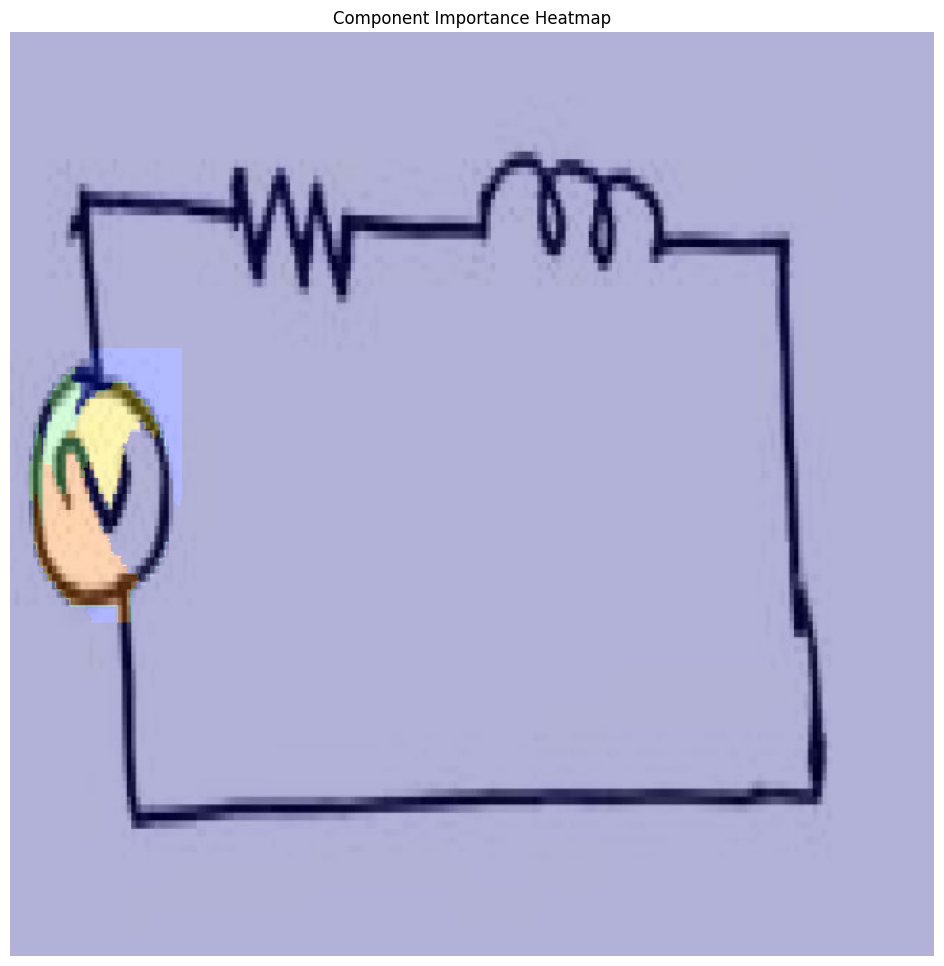

In [36]:
import lime
import lime.lime_image
import numpy as np
import cv2
import torch
import matplotlib.pyplot as plt
from torchvision.transforms import ToTensor, Resize
from PIL import Image
from ultralytics import YOLO

# Load YOLO Model
model_path = r"F:\yolov12ckt\runs\detect\train29\weights\best.pt"
device = "cpu"
model = YOLO(model_path).eval().to(device)

# Load and preprocess image
image_path = r"F:\yolov12ckt\dataset\test\images\Screenshot-2025-03-01-183148_png.rf.8f17211f500be336bbe43c4bf33c2aaa.jpg"
image = Image.open(image_path).convert("RGB")
new_size = (640, 640)
image = image.resize(new_size)
image_np = np.array(image)

# Initialize importance map
importance_map = np.zeros(image_np.shape[:2], dtype=np.float32)

MAX_CLASSES = 23

def predict_fn(images):
    batch_scores = []
    for img in images:
        img_resized = Resize((640, 640))(ToTensor()(Image.fromarray(img))).unsqueeze(0).to(device)
        results = model(img_resized)
        
        scores = results[0].boxes.conf.cpu().numpy() if results[0].boxes.shape[0] > 0 else np.zeros(MAX_CLASSES)
        scores_padded = np.pad(scores, (0, max(0, MAX_CLASSES - len(scores))), mode='constant')[:MAX_CLASSES]
        batch_scores.append(scores_padded)
        
    return np.array(batch_scores)

explainer = lime.lime_image.LimeImageExplainer()

# Get detection references
results = model(torch.tensor(image_np).permute(2, 0, 1).unsqueeze(0).float().to(device))
boxes = results[0].boxes.xyxy.cpu().numpy() if results[0].boxes.shape[0] > 0 else []

# Process each detected component for importance
for box in boxes:
    x_min, y_min, x_max, y_max = map(int, box[:4])
    component = image_np[y_min:y_max, x_min:x_max]
    
    # Enhanced processing for high-resolution importance
    component_resized = cv2.resize(component, (128, 128))
    
    explanation = explainer.explain_instance(
        component_resized,
        predict_fn,
        top_labels=1,
        hide_color=None,
        num_samples=1000,
        batch_size=1
    )

    # Extract detailed importance weights
    label = explanation.top_labels[0]
    exp = explanation.local_exp[label]
    detailed_mask = np.zeros(component_resized.shape[:2], dtype=np.float32)
    
    for idx, weight in exp:
        detailed_mask[explanation.segments == idx] = weight
    
    # Upsample to original component size with cubic interpolation
    importance_mask = cv2.resize(detailed_mask, 
                               (x_max - x_min, y_max - y_min),
                               interpolation=cv2.INTER_CUBIC)
    
    # Aggregate using maximum to capture peak importance
    importance_map[y_min:y_max, x_min:x_max] = np.maximum(
        importance_map[y_min:y_max, x_min:x_max],
        importance_mask
    )

# Enhanced normalization with gamma correction
max_val = importance_map.max()
if max_val > 0:
    importance_map = (importance_map / max_val) ** 0.5  # Gamma correction

# Create smooth heatmap overlay
heatmap = plt.cm.jet(importance_map)[..., :3]
heatmap = (heatmap * 255).astype(np.uint8)

# Sophisticated blending
blended = cv2.addWeighted(image_np, 0.7, heatmap, 0.3, 0)

# Final visualization
plt.figure(figsize=(12, 12))
plt.imshow(blended)
plt.axis('off')
plt.title("Component Importance Heatmap")
plt.show()

In [29]:
# run this
import torch
import shap
import numpy as np
import torchvision.transforms as transforms
from PIL import Image
from ultralytics import YOLO
import gc
from skimage.segmentation import slic

# ✅ 1. Load YOLO Model Efficiently
model_path = r"F:\yolov12ckt\runs\detect\train29\weights\best.pt"
device = "cuda" if torch.cuda.is_available() else "cpu"
model = YOLO(model_path).eval().to(device)

# Define preprocessing function (modify based on your model input)
transform = transforms.Compose([
    transforms.Resize((640, 640)),  # Resize to YOLO input size
    transforms.ToTensor(),
])

# Load a sample image
image_path = r"F:\yolov12ckt\dataset\test\images\Screenshot-2025-03-01-183148_png.rf.8f17211f500be336bbe43c4bf33c2aaa.jpg"
image = Image.open(image_path).convert("RGB")
input_tensor = transform(image).unsqueeze(0)  # Add batch dimension


  4%|▍         | 8/200 [00:00<00:16, 11.58it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 1 Capacitor, 86.7ms
Speed: 0.0ms preprocess, 86.7ms inference, 3.1ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 3 Diodes, 1 Resistor, 69.8ms
Speed: 0.0ms preprocess, 69.8ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 5 Diodes, 2 Resistors, 69.1ms
Speed: 0.0ms preprocess, 69.1ms inference, 3.3ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 1 DepcurrentSrc, 5 Diodes, 1 NPN, 3 Resistors, 65.6ms
Speed: 0.0ms preprocess, 65.6ms inference, 3.6ms postprocess per image a

 10%|▉         | 19/200 [00:03<00:23,  7.87it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 3 Diodes, 4 Resistors, 65.1ms
Speed: 0.0ms preprocess, 65.1ms inference, 3.9ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 2 Diodes, 2 Resistors, 65.6ms
Speed: 0.0ms preprocess, 65.6ms inference, 6.9ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 10 Diodes, 1 Inductor, 4 Resistors, 64.0ms
Speed: 0.0ms preprocess, 64.0ms inference, 4.1ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 2 Diodes, 2 Inductors, 3 Resistors, 64.8ms
Speed: 0.0ms preprocess, 64.8ms inference, 4.0ms postproces

 14%|█▍        | 28/200 [00:04<00:18,  9.19it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 3 Diodes, 1 PMOS, 1 Resistor, 67.9ms
Speed: 0.0ms preprocess, 67.9ms inference, 3.6ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 5 Diodes, 3 Resistors, 67.9ms
Speed: 0.0ms preprocess, 67.9ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 2 Resistors, 68.2ms
Speed: 0.0ms preprocess, 68.2ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 1 Capacitor, 2 Diodes, 2 Resistors, 65.3ms
Speed: 0.0ms preprocess, 65.3ms inference, 5.3ms postprocess per image at s

 19%|█▉        | 38/200 [00:06<00:15, 10.14it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 5 Diodes, 2 Resistors, 69.8ms
Speed: 0.0ms preprocess, 69.8ms inference, 2.7ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 7 Diodes, 1 Inductor, 1 NPN, 1 Resistor, 69.4ms
Speed: 0.0ms preprocess, 69.4ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 1 Capacitor, 8 Diodes, 1 Gnd, 3 Resistors, 70.0ms
Speed: 0.0ms preprocess, 70.0ms inference, 2.7ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 2 Diodes, 1 Resistor, 70.4ms
Speed: 0.0ms preprocess, 70.4ms inference, 2.7ms

 24%|██▍       | 48/200 [00:07<00:15,  9.85it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 13 Diodes, 2 Resistors, 69.7ms
Speed: 0.0ms preprocess, 69.7ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 4 Diodes, 69.1ms
Speed: 0.0ms preprocess, 69.1ms inference, 4.5ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Diode, 1 Resistor, 66.6ms
Speed: 0.0ms preprocess, 66.6ms inference, 6.9ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 7 Diodes, 70.1ms
Speed: 0.0ms preprocess, 70.1ms inference, 4.9ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 

 29%|██▉       | 58/200 [00:08<00:13, 10.34it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 1 Capacitor, 3 Diodes, 1 Resistor, 72.4ms
Speed: 0.0ms preprocess, 72.4ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 2 Diodes, 1 Resistor, 73.0ms
Speed: 0.0ms preprocess, 73.0ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 6 Diodes, 4 Resistors, 74.0ms
Speed: 0.0ms preprocess, 74.0ms inference, 2.4ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 1 DepcurrentSrc, 5 Diodes, 2 Resistors, 63.3ms
Speed: 0.0ms preprocess, 63.3ms inference, 1.

 34%|███▍      | 69/200 [00:10<00:11, 11.29it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 5 Diodes, 1 Resistor, 70.5ms
Speed: 0.0ms preprocess, 70.5ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 2 Diodes, 2 Resistors, 67.2ms
Speed: 0.0ms preprocess, 67.2ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 2 Diodes, 1 Resistor, 66.3ms
Speed: 0.0ms preprocess, 66.3ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 1 Capacitor, 5 Diodes, 66.6ms
Speed: 0.0ms preprocess, 66.6ms inference, 2.0ms postprocess per image at shape (1, 3, 

 40%|███▉      | 79/200 [00:11<00:12,  9.99it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 7 Diodes, 1 Inductor, 1 NPN, 1 Resistor, 72.7ms
Speed: 0.0ms preprocess, 72.7ms inference, 4.1ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Capacitor, 1 Gnd, 69.0ms
Speed: 0.0ms preprocess, 69.0ms inference, 4.2ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 3 Diodes, 4 Resistors, 69.0ms
Speed: 0.0ms preprocess, 69.0ms inference, 7.4ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 5 Diodes, 1 Resistor, 64.8ms
Speed: 0.0ms preprocess, 64.8ms inference, 4.0ms postprocess per image 

 44%|████▍     | 89/200 [00:13<00:10, 10.38it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 2 Diodes, 1 Inductor, 4 Resistors, 68.0ms
Speed: 0.0ms preprocess, 68.0ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 2 Diodes, 1 Resistor, 67.5ms
Speed: 0.0ms preprocess, 67.5ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 7 Diodes, 1 Resistor, 67.2ms
Speed: 0.0ms preprocess, 67.2ms inference, 4.7ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 8 Diodes, 1 Resistor, 68.2ms
Speed: 0.0ms preprocess, 68.2ms inference, 1.0ms postprocess per image at sh

 50%|████▉     | 99/200 [00:14<00:10,  9.39it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 6 Diodes, 1 Gnd, 2 Resistors, 69.0ms
Speed: 0.0ms preprocess, 69.0ms inference, 8.9ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 1 DepcurrentSrc, 3 Diodes, 1 Inductor, 1 Resistor, 83.2ms
Speed: 0.0ms preprocess, 83.2ms inference, 5.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 2 Diodes, 1 Resistor, 68.8ms
Speed: 0.0ms preprocess, 68.8ms inference, 3.1ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 1 DepcurrentSrc, 3 Diodes, 1 Inductor, 2 Resistors, 69.4ms
Speed: 0.0ms preproces

 55%|█████▍    | 109/200 [00:16<00:10,  8.87it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Diode, 72.1ms
Speed: 0.0ms preprocess, 72.1ms inference, 14.4ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 4 Diodes, 66.7ms
Speed: 0.0ms preprocess, 66.7ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 3 Resistors, 66.4ms
Speed: 0.0ms preprocess, 66.4ms inference, 2.8ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 1 Capacitor, 6 Diodes, 66.8ms
Speed: 0.0ms preprocess, 66.8ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should

 59%|█████▉    | 118/200 [00:17<00:08,  9.50it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 5 Diodes, 1 Inductor, 1 Resistor, 71.6ms
Speed: 0.0ms preprocess, 71.6ms inference, 2.8ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 1 Diode, 2 Resistors, 72.1ms
Speed: 0.0ms preprocess, 72.1ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 1 Diode, 1 Resistor, 70.2ms
Speed: 0.0ms preprocess, 70.2ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 5 Diodes, 1 Inductor, 1 Resistor, 68.8ms
Speed: 0.0ms preprocess, 68.8ms inference, 2.6ms postprocess per i

 64%|██████▎   | 127/200 [00:19<00:07,  9.68it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 2 Diodes, 3 Resistors, 70.6ms
Speed: 0.0ms preprocess, 70.6ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 5 Diodes, 1 Resistor, 74.3ms
Speed: 0.0ms preprocess, 74.3ms inference, 2.8ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 2 Diodes, 1 Inductor, 1 Resistor, 70.5ms
Speed: 0.0ms preprocess, 70.5ms inference, 2.9ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 5 Diodes, 71.6ms
Speed: 0.0ms preprocess, 71.6ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)

WA

 69%|██████▉   | 138/200 [00:21<00:07,  7.90it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 2 Diodes, 3 Resistors, 71.1ms
Speed: 0.0ms preprocess, 71.1ms inference, 7.2ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 9 Diodes, 64.3ms
Speed: 0.0ms preprocess, 64.3ms inference, 5.3ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 3 Diodes, 1 Inductor, 2 Resistors, 67.1ms
Speed: 0.0ms preprocess, 67.1ms inference, 7.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 4 Diodes, 71.5ms
Speed: 0.0ms preprocess, 71.5ms inference, 3.3ms postprocess per image at shape (1, 3, 640, 640)

W

 74%|███████▍  | 149/200 [00:22<00:04, 10.24it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 3 Diodes, 1 Resistor, 71.1ms
Speed: 0.0ms preprocess, 71.1ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 3 Diodes, 70.6ms
Speed: 0.0ms preprocess, 70.6ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Gnd, 2 Resistors, 71.5ms
Speed: 0.0ms preprocess, 71.5ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 9 Diodes, 1 NPN, 1 Resistor, 71.4ms
Speed: 0.0ms preprocess, 71.4ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs shoul

 80%|███████▉  | 159/200 [00:24<00:04, 10.07it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 3 Diodes, 1 Resistor, 67.1ms
Speed: 0.0ms preprocess, 67.1ms inference, 6.4ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 2 Diodes, 2 Resistors, 60.8ms
Speed: 0.0ms preprocess, 60.8ms inference, 10.8ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 (no detections), 67.8ms
Speed: 0.0ms preprocess, 67.8ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 1 Capacitor, 2 Diodes, 68.7ms
Speed: 0.0ms preprocess, 68.7ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)

WARNI

 84%|████████▍ | 169/200 [00:26<00:04,  7.46it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 3 Resistors, 69.9ms
Speed: 0.0ms preprocess, 69.9ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 3 Diodes, 87.6ms
Speed: 0.0ms preprocess, 87.6ms inference, 6.6ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 1 Resistor, 90.0ms
Speed: 0.0ms preprocess, 90.0ms inference, 6.3ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 13 Diodes, 1 Gnd, 1 Inductor, 75.8ms
Speed: 0.0ms preprocess, 75.8ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)

WA

 90%|████████▉ | 179/200 [00:27<00:02,  8.15it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 3 Diodes, 2 Gnds, 76.6ms
Speed: 0.0ms preprocess, 76.6ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 2 Diodes, 1 Resistor, 73.2ms
Speed: 0.0ms preprocess, 73.2ms inference, 3.3ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 5 Diodes, 1 Resistor, 71.1ms
Speed: 0.0ms preprocess, 71.1ms inference, 2.2ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 3 Diodes, 71.9ms
Speed: 0.0ms preprocess, 71.9ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING

 94%|█████████▎| 187/200 [00:29<00:01,  8.64it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 3 Diodes, 1 Gnd, 72.6ms
Speed: 0.0ms preprocess, 72.6ms inference, 2.6ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 3 Diodes, 1 Gnd, 67.7ms
Speed: 0.0ms preprocess, 67.7ms inference, 3.4ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 68.6ms
Speed: 0.0ms preprocess, 68.6ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 1 Capacitor, 1 DepcurrentSrc, 5 Diodes, 1 Resistor, 69.4ms
Speed: 0.0ms preprocess, 69.4ms inference, 2.2ms postprocess per image at shape

 99%|█████████▉| 198/200 [00:30<00:00, 10.23it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 4 Diodes, 1 Inductor, 70.4ms
Speed: 0.0ms preprocess, 70.4ms inference, 2.3ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 2 Diodes, 3 Resistors, 71.0ms
Speed: 0.0ms preprocess, 71.0ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 3 Diodes, 71.8ms
Speed: 0.0ms preprocess, 71.8ms inference, 3.8ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 2 Diodes, 1 Resistor, 85.0ms
Speed: 0.0ms preprocess, 85.0ms inference, 4.3ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch

  4%|▍         | 8/200 [00:00<00:11, 16.27it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Diode, 1 Gnd, 1 Resistor, 76.8ms
Speed: 1.0ms preprocess, 76.8ms inference, 2.9ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Capacitor, 1 Diode, 1 Gnd, 1 NPN, 72.5ms
Speed: 0.0ms preprocess, 72.5ms inference, 4.8ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 6 Diodes, 1 NPN, 73.9ms
Speed: 0.0ms preprocess, 73.9ms inference, 4.1ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 (no detections), 77.4ms
Speed: 0.0ms preprocess, 77.4ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Te

 10%|▉         | 19/200 [00:02<00:24,  7.36it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Diode, 1 Resistor, 72.3ms
Speed: 0.0ms preprocess, 72.3ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Diode, 69.8ms
Speed: 0.0ms preprocess, 69.8ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Diode, 1 Resistor, 78.3ms
Speed: 0.0ms preprocess, 78.3ms inference, 4.5ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 3 Diodes, 84.8ms
Speed: 0.0ms preprocess, 84.8ms inference, 6.5ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-

 14%|█▍        | 29/200 [00:04<00:17, 10.04it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Diode, 1 Resistor, 68.0ms
Speed: 0.0ms preprocess, 68.0ms inference, 2.8ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 9 Diodes, 1 NPN, 1 Resistor, 71.5ms
Speed: 0.0ms preprocess, 71.5ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Diode, 1 Resistor, 70.9ms
Speed: 0.0ms preprocess, 70.9ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 (no detections), 73.6ms
Speed: 0.0ms preprocess, 73.6ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor input

 20%|█▉        | 39/200 [00:05<00:15, 10.29it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 2 Diodes, 71.0ms
Speed: 0.0ms preprocess, 71.0ms inference, 2.9ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 2 Diodes, 2 Resistors, 64.7ms
Speed: 0.0ms preprocess, 64.7ms inference, 3.2ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 2 Diodes, 1 Resistor, 68.8ms
Speed: 0.0ms preprocess, 68.8ms inference, 2.8ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Resistor, 64.9ms
Speed: 0.0ms preprocess, 64.9ms inference, 3.1ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalize

 24%|██▍       | 48/200 [00:07<00:16,  9.46it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Diode, 2 Inductors, 1 Resistor, 66.2ms
Speed: 0.0ms preprocess, 66.2ms inference, 3.2ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Diode, 1 Gnd, 79.0ms
Speed: 0.0ms preprocess, 79.0ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Diode, 1 Gnd, 77.0ms
Speed: 0.0ms preprocess, 77.0ms inference, 3.1ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Diode, 65.4ms
Speed: 1.5ms preprocess, 65.4ms inference, 2.4ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be n

 30%|██▉       | 59/200 [00:08<00:13, 10.74it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 (no detections), 75.0ms
Speed: 0.0ms preprocess, 75.0ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Diode, 2 Resistors, 81.8ms
Speed: 0.0ms preprocess, 81.8ms inference, 3.4ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 12 Diodes, 1 NPN, 1 Resistor, 74.5ms
Speed: 0.0ms preprocess, 74.5ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Diode, 1 Resistor, 70.6ms
Speed: 0.0ms preprocess, 70.6ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inp

 34%|███▍      | 69/200 [00:10<00:14,  8.87it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 11 Diodes, 66.5ms
Speed: 0.0ms preprocess, 66.5ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 2 Diodes, 67.1ms
Speed: 0.0ms preprocess, 67.1ms inference, 5.4ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 10 Diodes, 1 NPN, 66.3ms
Speed: 0.0ms preprocess, 66.3ms inference, 3.3ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 (no detections), 68.1ms
Speed: 0.0ms preprocess, 68.1ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 b

 39%|███▉      | 78/200 [00:11<00:12,  9.93it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 11 Diodes, 1 NPN, 2 Resistors, 91.5ms
Speed: 0.0ms preprocess, 91.5ms inference, 4.9ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Diode, 1 Resistor, 85.8ms
Speed: 0.0ms preprocess, 85.8ms inference, 3.6ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 3 Diodes, 1 Resistor, 84.3ms
Speed: 0.0ms preprocess, 84.3ms inference, 5.5ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 2 Diodes, 1 Resistor, 65.3ms
Speed: 0.0ms preprocess, 65.3ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tens

 44%|████▍     | 88/200 [00:13<00:10, 10.63it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 15 Diodes, 1 NPN, 65.6ms
Speed: 0.0ms preprocess, 65.6ms inference, 3.3ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 NPN, 1 Resistor, 68.9ms
Speed: 0.0ms preprocess, 68.9ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 (no detections), 64.4ms
Speed: 0.0ms preprocess, 64.4ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 5 Diodes, 2 Resistors, 67.5ms
Speed: 0.0ms preprocess, 67.5ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be

 48%|████▊     | 97/200 [00:14<00:10, 10.06it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 (no detections), 63.2ms
Speed: 0.0ms preprocess, 63.2ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 (no detections), 68.0ms
Speed: 0.0ms preprocess, 68.0ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Diode, 66.6ms
Speed: 0.0ms preprocess, 66.6ms inference, 3.8ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 2 Diodes, 1 Resistor, 69.5ms
Speed: 0.0ms preprocess, 69.5ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 

 54%|█████▍    | 108/200 [00:15<00:08, 11.13it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Diode, 1 Inductor, 1 NPN, 69.1ms
Speed: 0.0ms preprocess, 69.1ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 9 Diodes, 67.3ms
Speed: 0.0ms preprocess, 67.3ms inference, 2.3ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 12 Diodes, 1 NPN, 68.4ms
Speed: 0.0ms preprocess, 68.4ms inference, 3.1ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 2 Diodes, 1 Resistor, 66.2ms
Speed: 0.0ms preprocess, 66.2ms inference, 2.6ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should b

 59%|█████▉    | 118/200 [00:17<00:07, 11.06it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 3 Diodes, 2 Resistors, 69.5ms
Speed: 0.0ms preprocess, 69.5ms inference, 6.7ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 10 Diodes, 65.1ms
Speed: 0.0ms preprocess, 65.1ms inference, 4.7ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 7 Diodes, 1 Resistor, 65.1ms
Speed: 0.0ms preprocess, 65.1ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 (no detections), 64.7ms
Speed: 0.0ms preprocess, 64.7ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be nor

 64%|██████▎   | 127/200 [00:18<00:06, 10.63it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Diode, 1 NPN, 67.4ms
Speed: 0.0ms preprocess, 67.4ms inference, 4.3ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 4 Diodes, 2 Inductors, 1 Resistor, 66.7ms
Speed: 0.0ms preprocess, 66.7ms inference, 3.2ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Diode, 1 Inductor, 65.2ms
Speed: 0.0ms preprocess, 65.2ms inference, 4.2ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 2 Diodes, 67.3ms
Speed: 0.0ms preprocess, 67.3ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs shou

 69%|██████▉   | 138/200 [00:19<00:05, 11.51it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Diode, 2 Inductors, 2 Resistors, 67.9ms
Speed: 0.0ms preprocess, 67.9ms inference, 3.7ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Diode, 1 Resistor, 66.7ms
Speed: 0.0ms preprocess, 66.7ms inference, 2.9ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Gnd, 67.4ms
Speed: 0.0ms preprocess, 67.4ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 12 Diodes, 1 Resistor, 65.4ms
Speed: 0.0ms preprocess, 65.4ms inference, 4.5ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs 

 74%|███████▍  | 148/200 [00:21<00:04, 11.42it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Diode, 3 Resistors, 67.1ms
Speed: 0.0ms preprocess, 67.1ms inference, 3.3ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 9 Diodes, 1 Resistor, 65.2ms
Speed: 0.0ms preprocess, 65.2ms inference, 3.9ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Capacitor, 1 Diode, 1 NPN, 63.9ms
Speed: 0.0ms preprocess, 63.9ms inference, 4.4ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Diode, 67.5ms
Speed: 0.0ms preprocess, 67.5ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs shou

 78%|███████▊  | 157/200 [00:22<00:04, 10.57it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Resistor, 66.6ms
Speed: 0.0ms preprocess, 66.6ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Resistor, 67.9ms
Speed: 0.0ms preprocess, 67.9ms inference, 3.1ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Resistor, 68.6ms
Speed: 0.0ms preprocess, 68.6ms inference, 2.2ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 2 Diodes, 1 Resistor, 67.0ms
Speed: 0.0ms preprocess, 67.0ms inference, 2.7ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0

 84%|████████▍ | 168/200 [00:23<00:02, 11.69it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 2 Diodes, 1 Resistor, 71.9ms
Speed: 0.0ms preprocess, 71.9ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 (no detections), 68.1ms
Speed: 0.0ms preprocess, 68.1ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 3 Diodes, 1 Gnd, 3 Resistors, 66.5ms
Speed: 0.0ms preprocess, 66.5ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 2 Diodes, 2 Resistors, 68.7ms
Speed: 0.0ms preprocess, 68.7ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor i

 88%|████████▊ | 177/200 [00:25<00:02, 10.36it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 4 Diodes, 1 Resistor, 67.2ms
Speed: 0.0ms preprocess, 67.2ms inference, 3.7ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 5 Diodes, 1 Inductor, 2 Resistors, 69.6ms
Speed: 0.0ms preprocess, 69.6ms inference, 3.8ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 8 Diodes, 65.0ms
Speed: 0.0ms preprocess, 65.0ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Diode, 64.9ms
Speed: 0.0ms preprocess, 64.9ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be 

 94%|█████████▎| 187/200 [00:26<00:01, 10.58it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 2 Diodes, 2 Resistors, 71.7ms
Speed: 0.0ms preprocess, 71.7ms inference, 3.3ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 6 Diodes, 69.0ms
Speed: 0.6ms preprocess, 69.0ms inference, 3.1ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 (no detections), 66.3ms
Speed: 0.0ms preprocess, 66.3ms inference, 4.1ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Resistor, 65.1ms
Speed: 0.0ms preprocess, 65.1ms inference, 2.8ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0

 99%|█████████▉| 198/200 [00:27<00:00, 11.44it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 (no detections), 72.6ms
Speed: 0.0ms preprocess, 72.6ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 2 Gnds, 2 Resistors, 68.7ms
Speed: 0.0ms preprocess, 68.7ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Diode, 1 Resistor, 66.6ms
Speed: 0.0ms preprocess, 66.6ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Gnd, 1 Inductor, 3 Resistors, 65.7ms
Speed: 0.0ms preprocess, 65.7ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor in

  4%|▍         | 8/200 [00:00<00:07, 26.67it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Diode, 1 Gnd, 1 Resistor, 69.6ms
Speed: 0.0ms preprocess, 69.6ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 5 Diodes, 70.5ms
Speed: 0.0ms preprocess, 70.5ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 10 Diodes, 66.7ms
Speed: 0.0ms preprocess, 66.7ms inference, 3.4ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 2 Gnds, 2 Inductors, 68.3ms
Speed: 0.0ms preprocess, 68.3ms inference, 3.9ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normal

  9%|▉         | 18/200 [00:01<00:15, 11.93it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 2 Gnds, 1 Inductor, 64.1ms
Speed: 0.0ms preprocess, 64.1ms inference, 2.7ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Gnd, 2 Resistors, 67.9ms
Speed: 0.0ms preprocess, 67.9ms inference, 4.8ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Capacitor, 2 Diodes, 2 Gnds, 1 Inductor, 66.6ms
Speed: 0.0ms preprocess, 66.6ms inference, 3.2ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Capacitor, 1 Gnd, 1 Resistor, 71.7ms
Speed: 0.0ms preprocess, 71.7ms inference, 3.2ms postprocess per image at shape (1, 3, 640, 640)



 14%|█▍        | 28/200 [00:02<00:14, 11.83it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 2 Inductors, 6 Resistors, 64.5ms
Speed: 0.0ms preprocess, 64.5ms inference, 3.2ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 6 Diodes, 73.6ms
Speed: 0.0ms preprocess, 73.6ms inference, 2.3ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 2 Resistors, 67.3ms
Speed: 0.0ms preprocess, 67.3ms inference, 3.4ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 7 Diodes, 68.7ms
Speed: 0.0ms preprocess, 68.7ms inference, 3.8ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.

 19%|█▉        | 38/200 [00:04<00:13, 11.93it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 2 Diodes, 1 Resistor, 65.7ms
Speed: 0.0ms preprocess, 65.7ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 2 Diodes, 69.4ms
Speed: 0.0ms preprocess, 69.4ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 (no detections), 68.1ms
Speed: 0.0ms preprocess, 68.1ms inference, 2.4ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 11 Diodes, 61.7ms
Speed: 0.0ms preprocess, 61.7ms inference, 8.9ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1

 24%|██▎       | 47/200 [00:05<00:14, 10.62it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 3 Diodes, 70.8ms
Speed: 0.0ms preprocess, 70.8ms inference, 3.1ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 2 Inductors, 67.9ms
Speed: 0.0ms preprocess, 67.9ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Diode, 2 Gnds, 2 Inductors, 2 Resistors, 61.6ms
Speed: 0.0ms preprocess, 61.6ms inference, 8.6ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Diode, 1 Gnd, 3 Resistors, 68.5ms
Speed: 0.0ms preprocess, 68.5ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tenso

 29%|██▉       | 58/200 [00:06<00:12, 11.64it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Diode, 2 Inductors, 2 Resistors, 64.2ms
Speed: 0.0ms preprocess, 64.2ms inference, 3.4ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 5 Diodes, 65.1ms
Speed: 0.0ms preprocess, 65.1ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 2 Gnds, 1 Resistor, 65.4ms
Speed: 0.0ms preprocess, 65.4ms inference, 2.6ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 4 Diodes, 71.4ms
Speed: 0.0ms preprocess, 71.4ms inference, 2.6ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be n

 34%|███▎      | 67/200 [00:07<00:13, 10.15it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 6 Diodes, 1 Resistor, 71.7ms
Speed: 0.0ms preprocess, 71.7ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 3 Diodes, 69.0ms
Speed: 0.0ms preprocess, 69.0ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Gnd, 2 Resistors, 67.7ms
Speed: 0.0ms preprocess, 67.7ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 8 Diodes, 65.5ms
Speed: 0.0ms preprocess, 65.5ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0

 40%|███▉      | 79/200 [00:09<00:09, 12.71it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 2 Diodes, 1 Inductor, 3 Resistors, 67.3ms
Speed: 0.0ms preprocess, 67.3ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Gnd, 1 Resistor, 68.9ms
Speed: 0.0ms preprocess, 68.9ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Gnd, 3 Inductors, 1 Resistor, 68.0ms
Speed: 0.0ms preprocess, 68.0ms inference, 3.4ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Inductor, 2 Resistors, 69.3ms
Speed: 0.0ms preprocess, 69.3ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)

WARN

 44%|████▍     | 88/200 [00:10<00:10, 10.62it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 3 Diodes, 1 Resistor, 66.8ms
Speed: 0.0ms preprocess, 66.8ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Gnd, 1 Inductor, 2 Resistors, 72.0ms
Speed: 0.0ms preprocess, 72.0ms inference, 3.9ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Diode, 66.3ms
Speed: 0.0ms preprocess, 66.3ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 2 Gnds, 1 Inductor, 65.6ms
Speed: 0.0ms preprocess, 65.6ms inference, 4.3ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs sho

 48%|████▊     | 97/200 [00:11<00:10,  9.95it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 3 Diodes, 69.6ms
Speed: 0.0ms preprocess, 69.6ms inference, 2.6ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Gnd, 3 Resistors, 69.2ms
Speed: 0.0ms preprocess, 69.2ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Inductor, 3 Resistors, 62.3ms
Speed: 0.0ms preprocess, 62.3ms inference, 6.7ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 5 Diodes, 1 Resistor, 65.1ms
Speed: 0.0ms preprocess, 65.1ms inference, 2.6ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be

 54%|█████▍    | 108/200 [00:12<00:08, 11.30it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 5 Diodes, 1 Resistor, 70.0ms
Speed: 0.0ms preprocess, 70.0ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Gnd, 3 Resistors, 66.5ms
Speed: 0.0ms preprocess, 66.5ms inference, 5.1ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Resistor, 65.9ms
Speed: 0.0ms preprocess, 65.9ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 2 Diodes, 1 Gnd, 1 Resistor, 66.3ms
Speed: 0.0ms preprocess, 66.3ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs sho

 58%|█████▊    | 117/200 [00:14<00:08, 10.13it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Diode, 3 Inductors, 1 Resistor, 62.1ms
Speed: 0.0ms preprocess, 62.1ms inference, 3.6ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 2 Gnds, 2 Inductors, 1 Resistor, 73.0ms
Speed: 0.0ms preprocess, 73.0ms inference, 2.7ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Gnd, 1 Resistor, 71.5ms
Speed: 0.0ms preprocess, 71.5ms inference, 4.2ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 3 Diodes, 73.1ms
Speed: 0.0ms preprocess, 73.1ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tens

 64%|██████▍   | 129/200 [00:15<00:05, 12.65it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Diode, 1 Gnd, 1 Inductor, 1 Resistor, 69.1ms
Speed: 0.0ms preprocess, 69.1ms inference, 5.2ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 12 Diodes, 1 Resistor, 72.3ms
Speed: 0.0ms preprocess, 72.3ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 9 Diodes, 1 NPN, 1 Resistor, 63.5ms
Speed: 0.0ms preprocess, 63.5ms inference, 6.8ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Gnd, 2 Inductors, 1 Resistor, 74.4ms
Speed: 0.0ms preprocess, 74.4ms inference, 2.7ms postprocess per image at shape (1, 3, 64

 69%|██████▉   | 138/200 [00:16<00:06, 10.31it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 5 Diodes, 71.5ms
Speed: 0.0ms preprocess, 71.5ms inference, 4.1ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 3 Diodes, 69.2ms
Speed: 0.0ms preprocess, 69.2ms inference, 2.6ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 2 Gnds, 1 Inductor, 1 Resistor, 65.6ms
Speed: 0.0ms preprocess, 65.6ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Diode, 1 Gnd, 1 Resistor, 65.3ms
Speed: 0.0ms preprocess, 65.3ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should

 74%|███████▎  | 147/200 [00:17<00:05,  9.73it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 9 Diodes, 71.5ms
Speed: 0.0ms preprocess, 71.5ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Diode, 1 Gnd, 1 Inductor, 66.4ms
Speed: 0.0ms preprocess, 66.4ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Gnd, 1 Inductor, 2 Resistors, 66.1ms
Speed: 0.0ms preprocess, 66.1ms inference, 3.1ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Inductor, 67.8ms
Speed: 0.0ms preprocess, 67.8ms inference, 3.4ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs shou

 79%|███████▉  | 158/200 [00:19<00:03, 11.38it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 6 Diodes, 66.8ms
Speed: 0.0ms preprocess, 66.8ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 5 Diodes, 1 Gnd, 69.4ms
Speed: 0.0ms preprocess, 69.4ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 7 Diodes, 2 Resistors, 67.9ms
Speed: 0.0ms preprocess, 67.9ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 5 Diodes, 67.9ms
Speed: 0.0ms preprocess, 67.9ms inference, 2.9ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1

 84%|████████▎ | 167/200 [00:20<00:03, 10.10it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 5 Diodes, 71.8ms
Speed: 0.0ms preprocess, 71.8ms inference, 2.6ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Diode, 1 Gnd, 1 Inductor, 3 Resistors, 68.5ms
Speed: 0.0ms preprocess, 68.5ms inference, 4.1ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Diode, 2 Inductors, 1 Resistor, 66.1ms
Speed: 0.0ms preprocess, 66.1ms inference, 3.2ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Inductor, 4 Resistors, 72.8ms
Speed: 0.0ms preprocess, 72.8ms inference, 3.6ms postprocess per image at shape (1, 3, 640, 640)

WARNI

 89%|████████▉ | 178/200 [00:21<00:02, 10.68it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Diode, 2 Gnds, 1 Inductor, 66.8ms
Speed: 0.0ms preprocess, 66.8ms inference, 3.2ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 4 Diodes, 1 Resistor, 71.9ms
Speed: 0.0ms preprocess, 71.9ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Diode, 1 Resistor, 73.9ms
Speed: 0.0ms preprocess, 73.9ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 (no detections), 77.1ms
Speed: 0.0ms preprocess, 77.1ms inference, 3.2ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inpu

 94%|█████████▍| 189/200 [00:23<00:00, 12.27it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Gnd, 1 Inductor, 64.5ms
Speed: 0.0ms preprocess, 64.5ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 5 Diodes, 65.4ms
Speed: 0.0ms preprocess, 65.4ms inference, 8.4ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 (no detections), 73.0ms
Speed: 0.0ms preprocess, 73.0ms inference, 2.6ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 2 Diodes, 1 Gnd, 1 Inductor, 1 Resistor, 76.8ms
Speed: 0.0ms preprocess, 76.8ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs

 99%|█████████▉| 198/200 [00:24<00:00, 10.49it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Gnd, 2 Resistors, 66.2ms
Speed: 0.0ms preprocess, 66.2ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Diode, 1 Inductor, 1 Resistor, 68.7ms
Speed: 0.0ms preprocess, 68.7ms inference, 3.2ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 3 Diodes, 64.1ms
Speed: 0.0ms preprocess, 64.1ms inference, 3.9ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Gnd, 1 Inductor, 2 Resistors, 68.1ms
Speed: 0.0ms preprocess, 68.1ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tenso

  4%|▍         | 9/200 [00:00<00:08, 23.32it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 2 NANDs, 232.5ms
Speed: 0.0ms preprocess, 232.5ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 (no detections), 75.8ms
Speed: 0.0ms preprocess, 75.8ms inference, 2.3ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 7 Diodes, 1 Gnd, 75.7ms
Speed: 0.0ms preprocess, 75.7ms inference, 2.8ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Capacitor, 2 Diodes, 1 Gnd, 2 NANDs, 65.7ms
Speed: 0.0ms preprocess, 65.7ms inference, 3.2ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs sh

 10%|▉         | 19/200 [00:01<00:16, 10.93it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 2 Diodes, 2 Resistors, 68.5ms
Speed: 0.0ms preprocess, 68.5ms inference, 2.4ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Diode, 1 Gnd, 67.6ms
Speed: 0.0ms preprocess, 67.6ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 AND, 1 NAND, 68.2ms
Speed: 0.0ms preprocess, 68.2ms inference, 2.6ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 3 Diodes, 1 NAND, 68.1ms
Speed: 0.0ms preprocess, 68.1ms inference, 3.7ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be norm

 14%|█▍        | 28/200 [00:03<00:17,  9.72it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Resistor, 67.9ms
Speed: 0.0ms preprocess, 67.9ms inference, 4.5ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 (no detections), 66.9ms
Speed: 0.0ms preprocess, 66.9ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Capacitor, 2 Diodes, 64.6ms
Speed: 0.0ms preprocess, 64.6ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 NAND, 75.8ms
Speed: 0.0ms preprocess, 75.8ms inference, 3.1ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1

 20%|█▉        | 39/200 [00:04<00:13, 11.60it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Diode, 1 NAND, 68.4ms
Speed: 0.0ms preprocess, 68.4ms inference, 3.6ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Capacitor, 5 Diodes, 68.6ms
Speed: 0.0ms preprocess, 68.6ms inference, 3.7ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Diode, 66.2ms
Speed: 0.0ms preprocess, 66.2ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 NAND, 66.4ms
Speed: 0.0ms preprocess, 66.4ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 

 24%|██▍       | 48/200 [00:05<00:14, 10.53it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 2 NANDs, 67.3ms
Speed: 0.0ms preprocess, 67.3ms inference, 3.4ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 3 Diodes, 1 NAND, 68.8ms
Speed: 0.0ms preprocess, 68.8ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 11 Diodes, 71.7ms
Speed: 0.0ms preprocess, 71.7ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 2 Diodes, 76.3ms
Speed: 0.0ms preprocess, 76.3ms inference, 3.2ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max v

 28%|██▊       | 57/200 [00:06<00:14,  9.77it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 2 Diodes, 1 NAND, 69.0ms
Speed: 0.0ms preprocess, 69.0ms inference, 2.3ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Diode, 1 NAND, 69.3ms
Speed: 0.0ms preprocess, 69.3ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 3 Diodes, 1 Resistor, 67.6ms
Speed: 0.0ms preprocess, 67.6ms inference, 2.6ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 NAND, 68.0ms
Speed: 0.0ms preprocess, 68.0ms inference, 2.7ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 

 34%|███▍      | 69/200 [00:08<00:10, 12.31it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 7 Diodes, 71.1ms
Speed: 0.0ms preprocess, 71.1ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Gnd, 70.3ms
Speed: 0.0ms preprocess, 70.3ms inference, 2.4ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 5 Diodes, 67.6ms
Speed: 0.0ms preprocess, 67.6ms inference, 3.2ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 5 Diodes, 69.7ms
Speed: 0.0ms preprocess, 69.7ms inference, 3.4ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255

 39%|███▉      | 78/200 [00:09<00:11, 10.17it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 3 Diodes, 2 NANDs, 70.9ms
Speed: 0.0ms preprocess, 70.9ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 5 Diodes, 69.1ms
Speed: 0.0ms preprocess, 69.1ms inference, 2.6ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 2 Diodes, 69.5ms
Speed: 0.0ms preprocess, 69.5ms inference, 2.7ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 2 Diodes, 1 Resistor, 65.5ms
Speed: 0.0ms preprocess, 65.5ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-

 44%|████▍     | 88/200 [00:10<00:10, 11.04it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 4 Diodes, 66.2ms
Speed: 0.0ms preprocess, 66.2ms inference, 3.6ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 3 Diodes, 1 Resistor, 70.5ms
Speed: 0.0ms preprocess, 70.5ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 2 Diodes, 73.6ms
Speed: 0.0ms preprocess, 73.6ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 (no detections), 75.9ms
Speed: 0.0ms preprocess, 75.9ms inference, 2.4ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.

 49%|████▉     | 98/200 [00:12<00:09, 11.24it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 6 Diodes, 2 Gnds, 79.4ms
Speed: 0.0ms preprocess, 79.4ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 3 Diodes, 1 Gnd, 73.2ms
Speed: 0.0ms preprocess, 73.2ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 (no detections), 77.0ms
Speed: 0.0ms preprocess, 77.0ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Diode, 72.1ms
Speed: 1.0ms preprocess, 72.1ms inference, 3.2ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-

 54%|█████▍    | 108/200 [00:13<00:08, 11.18it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 3 Diodes, 1 Resistor, 67.9ms
Speed: 0.0ms preprocess, 67.9ms inference, 2.2ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Resistor, 70.5ms
Speed: 0.0ms preprocess, 70.5ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 4 Diodes, 1 Resistor, 72.6ms
Speed: 0.0ms preprocess, 72.6ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 3 Diodes, 1 Gnd, 1 NAND, 77.1ms
Speed: 0.0ms preprocess, 77.1ms inference, 4.2ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs shoul

 58%|█████▊    | 116/200 [00:14<00:08,  9.60it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 3 Diodes, 1 NAND, 1 Resistor, 62.8ms
Speed: 0.0ms preprocess, 62.8ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Cell, 68.2ms
Speed: 1.2ms preprocess, 68.2ms inference, 3.9ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 3 Diodes, 64.7ms
Speed: 0.0ms preprocess, 64.7ms inference, 6.7ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 3 Diodes, 67.0ms
Speed: 0.0ms preprocess, 67.0ms inference, 2.2ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0

 64%|██████▍   | 128/200 [00:15<00:06, 11.75it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 4 Diodes, 68.5ms
Speed: 0.0ms preprocess, 68.5ms inference, 3.3ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 4 Diodes, 77.9ms
Speed: 0.0ms preprocess, 77.9ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 2 Diodes, 74.6ms
Speed: 0.0ms preprocess, 74.6ms inference, 3.3ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 3 Diodes, 76.3ms
Speed: 0.0ms preprocess, 76.3ms inference, 3.3ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 

 68%|██████▊   | 136/200 [00:17<00:06,  9.30it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 AND, 2 Diodes, 2 Resistors, 70.7ms
Speed: 0.0ms preprocess, 70.7ms inference, 2.9ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 5 Diodes, 68.4ms
Speed: 0.0ms preprocess, 68.4ms inference, 2.2ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 3 Diodes, 71.1ms
Speed: 0.0ms preprocess, 71.1ms inference, 2.6ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 2 Diodes, 1 Resistor, 75.7ms
Speed: 0.0ms preprocess, 75.7ms inference, 3.8ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be norm

 74%|███████▎  | 147/200 [00:18<00:04, 10.95it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 2 Diodes, 1 NAND, 70.5ms
Speed: 0.0ms preprocess, 70.5ms inference, 2.8ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 2 Diodes, 1 NAND, 1 Resistor, 74.5ms
Speed: 0.0ms preprocess, 74.5ms inference, 4.3ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 4 Diodes, 1 NAND, 1 Resistor, 74.7ms
Speed: 0.0ms preprocess, 74.7ms inference, 3.1ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Diode, 2 Resistors, 74.6ms
Speed: 0.0ms preprocess, 74.6ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.

 79%|███████▉  | 158/200 [00:19<00:03, 11.89it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 4 Diodes, 1 NAND, 1 Resistor, 70.1ms
Speed: 0.0ms preprocess, 70.1ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 3 Diodes, 2 NANDs, 73.4ms
Speed: 0.0ms preprocess, 73.4ms inference, 2.8ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 2 Diodes, 68.2ms
Speed: 0.0ms preprocess, 68.2ms inference, 3.1ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 5 Diodes, 67.6ms
Speed: 0.0ms preprocess, 67.6ms inference, 2.7ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normali

 84%|████████▍ | 169/200 [00:21<00:02, 12.03it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 (no detections), 66.7ms
Speed: 1.0ms preprocess, 66.7ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 4 Diodes, 66.6ms
Speed: 0.0ms preprocess, 66.6ms inference, 3.2ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Diode, 1 NAND, 66.8ms
Speed: 0.0ms preprocess, 66.8ms inference, 3.1ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 AND, 2 Diodes, 1 NAND, 75.4ms
Speed: 0.0ms preprocess, 75.4ms inference, 3.4ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normali

 89%|████████▉ | 178/200 [00:22<00:02, 10.21it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Cell, 69.9ms
Speed: 0.0ms preprocess, 69.9ms inference, 4.4ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Diode, 69.0ms
Speed: 0.0ms preprocess, 69.0ms inference, 4.2ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Capacitor, 2 Diodes, 68.7ms
Speed: 0.0ms preprocess, 68.7ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 4 Diodes, 73.7ms
Speed: 0.0ms preprocess, 73.7ms inference, 3.8ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max

 94%|█████████▎| 187/200 [00:23<00:01,  9.56it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 2 Diodes, 1 Resistor, 74.9ms
Speed: 0.0ms preprocess, 74.9ms inference, 3.1ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 (no detections), 69.7ms
Speed: 1.2ms preprocess, 69.7ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 AND, 1 Diode, 73.0ms
Speed: 0.0ms preprocess, 73.0ms inference, 3.2ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Resistor, 75.4ms
Speed: 0.0ms preprocess, 75.4ms inference, 4.3ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalize

 98%|█████████▊| 197/200 [00:24<00:00, 10.17it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Diode, 2 Resistors, 67.0ms
Speed: 0.0ms preprocess, 67.0ms inference, 4.4ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 4 Diodes, 67.6ms
Speed: 0.0ms preprocess, 67.6ms inference, 3.2ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Diode, 67.9ms
Speed: 0.0ms preprocess, 67.9ms inference, 2.4ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 (no detections), 72.3ms
Speed: 0.0ms preprocess, 72.3ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0

  4%|▍         | 8/200 [00:00<00:18, 10.55it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 1 Capacitor, 1 Inductor, 1 Resistor, 195.9ms
Speed: 0.0ms preprocess, 195.9ms inference, 4.9ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 2 Resistors, 118.0ms
Speed: 0.0ms preprocess, 118.0ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 2 Diodes, 1 Resistor, 77.1ms
Speed: 0.0ms preprocess, 77.1ms inference, 4.4ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 1 Capacitor, 1 NPN, 2 Resistors, 74.8ms
Speed: 0.0ms preprocess, 74.8ms inference, 3.1ms postprocess per image at shape 

  9%|▉         | 18/200 [00:02<00:21,  8.64it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Diode, 1 Gnd, 1 Inductor, 3 Resistors, 66.5ms
Speed: 0.0ms preprocess, 66.5ms inference, 2.3ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 3 Resistors, 68.9ms
Speed: 0.0ms preprocess, 68.9ms inference, 3.3ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 1 Diode, 1 Inductor, 4 Resistors, 75.3ms
Speed: 0.0ms preprocess, 75.3ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 2 Resistors, 76.3ms
Speed: 0.0ms preprocess, 76.3ms inference, 3.0ms postprocess per image at shape (1, 3, 6

 14%|█▍        | 28/200 [00:04<00:17,  9.81it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 4 Diodes, 1 Inductor, 65.6ms
Speed: 0.0ms preprocess, 65.6ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 PMOS, 1 Resistor, 72.7ms
Speed: 0.0ms preprocess, 72.7ms inference, 2.7ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 71.0ms
Speed: 0.0ms preprocess, 71.0ms inference, 2.9ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 2 Diodes, 1 Inductor, 1 Resistor, 74.6ms
Speed: 0.0ms preprocess, 74.6ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor input

 19%|█▉        | 38/200 [00:05<00:15, 10.20it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Capacitor, 1 Cell, 1 Inductor, 1 Resistor, 71.0ms
Speed: 0.0ms preprocess, 71.0ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Resistor, 73.3ms
Speed: 0.0ms preprocess, 73.3ms inference, 6.9ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 1 Diode, 74.7ms
Speed: 0.0ms preprocess, 74.7ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 1 Capacitor, 1 Cell, 2 Inductors, 3 Resistors, 77.6ms
Speed: 0.0ms preprocess, 77.6ms inference, 3.1ms postprocess per image at sh

 24%|██▍       | 48/200 [00:07<00:16,  9.14it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 1 Gnd, 1 Resistor, 73.2ms
Speed: 0.0ms preprocess, 73.2ms inference, 4.3ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 2 Diodes, 1 Resistor, 74.8ms
Speed: 0.0ms preprocess, 74.8ms inference, 3.6ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 1 Capacitor, 2 Inductors, 4 Resistors, 80.9ms
Speed: 0.0ms preprocess, 80.9ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 4 Diodes, 1 Resistor, 73.7ms
Speed: 0.0ms preprocess, 73.7ms inference, 2.7ms postprocess per image at shape (1, 3, 

 30%|██▉       | 59/200 [00:08<00:13, 10.74it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Diode, 2 Resistors, 72.7ms
Speed: 0.0ms preprocess, 72.7ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 2 Diodes, 2 Inductors, 3 Resistors, 68.3ms
Speed: 0.0ms preprocess, 68.3ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 3 Diodes, 1 Resistor, 71.8ms
Speed: 0.0ms preprocess, 71.8ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 (no detections), 76.9ms
Speed: 0.0ms preprocess, 76.9ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)

WARNIN

 34%|███▍      | 69/200 [00:10<00:13,  9.79it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 6 Diodes, 2 Resistors, 72.2ms
Speed: 0.0ms preprocess, 72.2ms inference, 2.7ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 2 Resistors, 70.6ms
Speed: 0.0ms preprocess, 70.6ms inference, 3.4ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Capacitor, 1 NPN, 2 Resistors, 65.3ms
Speed: 0.0ms preprocess, 65.3ms inference, 4.3ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 1 Diode, 1 Inductor, 5 Resistors, 64.5ms
Speed: 0.0ms preprocess, 64.5ms inference, 6.5ms postprocess per image at shape (1, 3, 640, 640)



 40%|███▉      | 79/200 [00:11<00:11, 10.48it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 1 Cell, 2 Diodes, 1 Resistor, 74.1ms
Speed: 0.0ms preprocess, 74.1ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 2 Diodes, 75.6ms
Speed: 0.0ms preprocess, 75.6ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Inductor, 3 Resistors, 76.1ms
Speed: 0.0ms preprocess, 76.1ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 1 Capacitor, 1 Inductor, 1 Resistor, 72.4ms
Speed: 0.0ms preprocess, 72.4ms inference, 6.6ms postprocess per image at shape (1, 3, 

 44%|████▍     | 89/200 [00:13<00:10, 10.37it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Diode, 3 Resistors, 68.1ms
Speed: 0.0ms preprocess, 68.1ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 2 Diodes, 1 Resistor, 65.5ms
Speed: 0.0ms preprocess, 65.5ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 (no detections), 68.4ms
Speed: 0.0ms preprocess, 68.4ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 1 Capacitor, 1 Resistor, 76.1ms
Speed: 0.0ms preprocess, 76.1ms inference, 2.7ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Te

 50%|████▉     | 99/200 [00:14<00:09, 10.19it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 7 Diodes, 1 Inductor, 1 Resistor, 67.3ms
Speed: 0.0ms preprocess, 67.3ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Diode, 66.5ms
Speed: 0.0ms preprocess, 66.5ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Diode, 1 Resistor, 73.5ms
Speed: 0.0ms preprocess, 73.5ms inference, 5.3ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 1 Diode, 1 Resistor, 73.7ms
Speed: 0.0ms preprocess, 73.7ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Ten

 55%|█████▍    | 109/200 [00:16<00:09, 10.10it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 2 Resistors, 72.7ms
Speed: 0.0ms preprocess, 72.7ms inference, 2.7ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 1 NPN, 3 Resistors, 79.3ms
Speed: 0.0ms preprocess, 79.3ms inference, 2.7ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 3 Diodes, 1 Inductor, 2 Resistors, 75.0ms
Speed: 0.0ms preprocess, 75.0ms inference, 3.6ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 (no detections), 75.6ms
Speed: 0.0ms preprocess, 75.6ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Ten

 60%|█████▉    | 119/200 [00:17<00:08, 10.11it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 5 Resistors, 68.1ms
Speed: 0.0ms preprocess, 68.1ms inference, 3.3ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 4 Diodes, 1 Inductor, 3 Resistors, 63.4ms
Speed: 0.0ms preprocess, 63.4ms inference, 6.3ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 1 Resistor, 67.1ms
Speed: 0.0ms preprocess, 67.1ms inference, 5.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 2 Diodes, 1 Gnd, 1 Inductor, 2 Resistors, 76.3ms
Speed: 0.0ms preprocess, 76.3ms inference, 3.1ms postprocess per image at s

 64%|██████▎   | 127/200 [00:19<00:08,  8.65it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 2 Resistors, 70.4ms
Speed: 0.0ms preprocess, 70.4ms inference, 2.9ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 1 Capacitor, 69.6ms
Speed: 1.0ms preprocess, 69.6ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 1 Capacitor, 77.2ms
Speed: 0.0ms preprocess, 77.2ms inference, 3.8ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Capacitor, 1 Diode, 1 Inductor, 3 Resistors, 78.9ms
Speed: 0.0ms preprocess, 78.9ms inference, 2.7ms postprocess per image at shape (1, 3, 640, 640)

WARNI

 69%|██████▉   | 138/200 [00:20<00:06,  9.89it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 1 Resistor, 69.3ms
Speed: 0.0ms preprocess, 69.3ms inference, 5.1ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 3 Diodes, 1 Inductor, 68.5ms
Speed: 0.0ms preprocess, 68.5ms inference, 4.2ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Diode, 3 Resistors, 67.2ms
Speed: 0.0ms preprocess, 67.2ms inference, 4.2ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Gnd, 70.9ms
Speed: 0.0ms preprocess, 70.9ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be n

 74%|███████▍  | 148/200 [00:22<00:05, 10.39it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Diode, 2 Resistors, 69.6ms
Speed: 1.1ms preprocess, 69.6ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Gnd, 1 Inductor, 68.5ms
Speed: 0.0ms preprocess, 68.5ms inference, 2.3ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Inductor, 2 Resistors, 67.4ms
Speed: 0.0ms preprocess, 67.4ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 1 Capacitor, 1 Inductor, 69.3ms
Speed: 0.0ms preprocess, 69.3ms inference, 2.8ms postprocess per image at shape (1, 3, 640, 640)

WARNING  tor

 79%|███████▉  | 158/200 [00:23<00:04, 10.31it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 1 Diode, 1 NPN, 1 Resistor, 71.0ms
Speed: 0.0ms preprocess, 71.0ms inference, 3.2ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 3 Diodes, 2 Resistors, 69.0ms
Speed: 0.0ms preprocess, 69.0ms inference, 4.2ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 1 Diode, 1 Inductor, 1 Resistor, 66.4ms
Speed: 0.0ms preprocess, 66.4ms inference, 3.1ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 77.7ms
Speed: 0.0ms preprocess, 77.7ms inference, 3.1ms postprocess per image at shape (

 84%|████████▍ | 168/200 [00:25<00:03,  9.69it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 3 Diodes, 1 Inductor, 1 Resistor, 66.9ms
Speed: 1.1ms preprocess, 66.9ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 2 Diodes, 1 Inductor, 1 Resistor, 69.1ms
Speed: 0.0ms preprocess, 69.1ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 3 Diodes, 2 Resistors, 76.3ms
Speed: 0.0ms preprocess, 76.3ms inference, 2.2ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 1 Resistor, 76.7ms
Speed: 0.0ms preprocess, 76.7ms inference, 4.5ms postprocess per image at 

 90%|████████▉ | 179/200 [00:26<00:01, 10.95it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Diode, 1 Gnd, 3 Resistors, 70.5ms
Speed: 0.0ms preprocess, 70.5ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Diode, 67.8ms
Speed: 0.0ms preprocess, 67.8ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 2 Diodes, 1 Resistor, 65.6ms
Speed: 0.0ms preprocess, 65.6ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 1 Capacitor, 1 Diode, 1 Gnd, 3 Inductors, 74.2ms
Speed: 0.0ms preprocess, 74.2ms inference, 2.6ms postprocess per image at shape (1, 3, 640, 640)

W

 94%|█████████▍| 189/200 [00:28<00:01, 10.30it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 1 Capacitor, 1 Diode, 1 Resistor, 66.4ms
Speed: 0.0ms preprocess, 66.4ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Inductor, 1 NPN, 2 Resistors, 69.7ms
Speed: 0.0ms preprocess, 69.7ms inference, 2.2ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 2 Diodes, 2 Resistors, 67.7ms
Speed: 0.0ms preprocess, 67.7ms inference, 2.7ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Capacitor, 1 Diode, 2 Resistors, 73.2ms
Speed: 0.0ms preprocess, 73.2ms inference, 6.7ms postprocess per image at sha

 99%|█████████▉| 198/200 [00:29<00:00,  9.42it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 1 Diode, 2 Resistors, 64.0ms
Speed: 0.0ms preprocess, 64.0ms inference, 5.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 5 Diodes, 1 Resistor, 68.4ms
Speed: 0.0ms preprocess, 68.4ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Diode, 2 Resistors, 76.5ms
Speed: 0.0ms preprocess, 76.5ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 2 Diodes, 76.3ms
Speed: 0.0ms preprocess, 76.3ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.

  4%|▎         | 7/200 [00:00<00:07, 25.56it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 1 Diode, 1 Resistor, 68.2ms
Speed: 0.0ms preprocess, 68.2ms inference, 3.1ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Resistor, 67.1ms
Speed: 0.0ms preprocess, 67.1ms inference, 3.1ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 1 Diode, 5 Resistors, 68.8ms
Speed: 0.0ms preprocess, 68.8ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 2 Diodes, 68.6ms
Speed: 0.0ms preprocess, 68.6ms inference, 3.1ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch

 10%|▉         | 19/200 [00:01<00:13, 13.28it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 1 Diode, 74.0ms
Speed: 0.0ms preprocess, 74.0ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 2 Diodes, 1 Resistor, 74.7ms
Speed: 0.0ms preprocess, 74.7ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 2 Diodes, 1 Gnd, 76.5ms
Speed: 0.0ms preprocess, 76.5ms inference, 5.1ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 3 Diodes, 73.4ms
Speed: 0.0ms preprocess, 73.4ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs shou

 14%|█▍        | 29/200 [00:03<00:17, 10.01it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 1 Diode, 2 Gnds, 1 Resistor, 77.7ms
Speed: 0.0ms preprocess, 77.7ms inference, 3.3ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 4 Diodes, 2 Resistors, 74.1ms
Speed: 0.0ms preprocess, 74.1ms inference, 4.3ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 6 Diodes, 2 Resistors, 88.5ms
Speed: 0.0ms preprocess, 88.5ms inference, 2.9ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 1 Diode, 1 Resistor, 86.7ms
Speed: 0.0ms preprocess, 86.7ms inference, 5.9ms postprocess per imag

 20%|█▉        | 39/200 [00:05<00:17,  9.07it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 2 Diodes, 74.3ms
Speed: 0.0ms preprocess, 74.3ms inference, 4.4ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 1 Diode, 1 Resistor, 86.6ms
Speed: 0.0ms preprocess, 86.6ms inference, 3.6ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 4 Diodes, 4 Resistors, 85.9ms
Speed: 0.0ms preprocess, 85.9ms inference, 4.2ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 3 Diodes, 1 Resistor, 88.5ms
Speed: 0.0ms preprocess, 88.5ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.

 24%|██▍       | 49/200 [00:06<00:17,  8.82it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 2 Diodes, 74.8ms
Speed: 0.0ms preprocess, 74.8ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 3 Diodes, 76.3ms
Speed: 0.0ms preprocess, 76.3ms inference, 3.6ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 4 Diodes, 1 Resistor, 86.9ms
Speed: 0.0ms preprocess, 86.9ms inference, 2.4ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 6 Diodes, 3 Resistors, 86.8ms
Speed: 0.0ms preprocess, 86.8ms inference, 4.6ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch

 30%|██▉       | 59/200 [00:08<00:15,  9.13it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 1 Diode, 2 Resistors, 76.2ms
Speed: 0.0ms preprocess, 76.2ms inference, 6.7ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 4 Diodes, 1 Resistor, 76.9ms
Speed: 0.0ms preprocess, 76.9ms inference, 4.7ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 2 Diodes, 1 Gnd, 2 Resistors, 91.3ms
Speed: 0.0ms preprocess, 91.3ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Diode, 2 Resistors, 85.9ms
Speed: 0.0ms preprocess, 85.9ms inference, 3.6ms postprocess per image at shape (

 34%|███▍      | 69/200 [00:10<00:14,  8.98it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 3 Diodes, 2 Resistors, 74.7ms
Speed: 0.0ms preprocess, 74.7ms inference, 3.8ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 1 Diode, 4 Resistors, 83.4ms
Speed: 0.0ms preprocess, 83.4ms inference, 3.4ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Gnd, 87.8ms
Speed: 0.0ms preprocess, 87.8ms inference, 4.3ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 2 Diodes, 1 Resistor, 84.9ms
Speed: 0.0ms preprocess, 84.9ms inference, 5.7ms postprocess per image at shape (1, 3, 640, 640)

WARNI

 40%|███▉      | 79/200 [00:11<00:13,  9.21it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 1 Diode, 2 Resistors, 78.4ms
Speed: 0.0ms preprocess, 78.4ms inference, 3.3ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 1 Cell, 1 Resistor, 86.7ms
Speed: 0.0ms preprocess, 86.7ms inference, 3.6ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 2 Diodes, 1 Resistor, 88.3ms
Speed: 0.0ms preprocess, 88.3ms inference, 5.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 2 Diodes, 1 NPN, 5 Resistors, 86.7ms
Speed: 0.0ms preprocess, 86.7ms inference, 3.2ms postprocess per image 

 44%|████▍     | 89/200 [00:13<00:13,  8.40it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Diode, 73.4ms
Speed: 0.0ms preprocess, 73.4ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 2 Diodes, 3 Resistors, 73.5ms
Speed: 0.0ms preprocess, 73.5ms inference, 6.5ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 2 Diodes, 2 Resistors, 78.1ms
Speed: 0.0ms preprocess, 78.1ms inference, 4.4ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 6 Diodes, 86.4ms
Speed: 0.0ms preprocess, 86.4ms inference, 4.3ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be

 50%|████▉     | 99/200 [00:15<00:12,  8.32it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 1 Diode, 1 Resistor, 75.0ms
Speed: 0.0ms preprocess, 75.0ms inference, 3.9ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 1 Diode, 1 NPN, 1 Resistor, 80.6ms
Speed: 0.0ms preprocess, 80.6ms inference, 3.9ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 3 Diodes, 1 Resistor, 87.9ms
Speed: 0.0ms preprocess, 87.9ms inference, 6.8ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 3 Diodes, 87.6ms
Speed: 0.0ms preprocess, 87.6ms inference, 2.8ms postprocess per image at shape (1, 3, 640, 640)

WARNING  t

 55%|█████▍    | 109/200 [00:17<00:10,  9.03it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 4 Resistors, 80.4ms
Speed: 0.0ms preprocess, 80.4ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 1 Diode, 2 Resistors, 86.2ms
Speed: 0.0ms preprocess, 86.2ms inference, 6.1ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 4 Diodes, 1 Resistor, 90.3ms
Speed: 0.0ms preprocess, 90.3ms inference, 2.2ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Diode, 85.2ms
Speed: 0.0ms preprocess, 85.2ms inference, 6.1ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torc

 60%|█████▉    | 119/200 [00:18<00:09,  8.96it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Diode, 3 Resistors, 78.4ms
Speed: 0.0ms preprocess, 78.4ms inference, 3.2ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Resistor, 77.6ms
Speed: 0.0ms preprocess, 77.6ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Gnd, 1 Resistor, 76.4ms
Speed: 0.6ms preprocess, 76.4ms inference, 5.6ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 90.0ms
Speed: 0.0ms preprocess, 90.0ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 

 64%|██████▍   | 129/200 [00:20<00:08,  8.83it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 3 Diodes, 1 Resistor, 79.1ms
Speed: 0.0ms preprocess, 79.1ms inference, 5.5ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 2 Diodes, 2 Resistors, 78.1ms
Speed: 0.0ms preprocess, 78.1ms inference, 5.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 3 Diodes, 2 Resistors, 89.2ms
Speed: 0.0ms preprocess, 89.2ms inference, 5.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 2 Diodes, 2 Resistors, 86.0ms
Speed: 0.0ms preprocess, 86.0ms inference, 4.0ms postprocess per image at shape (1, 3,

 70%|██████▉   | 139/200 [00:22<00:06,  9.00it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 2 Diodes, 1 Resistor, 80.9ms
Speed: 0.0ms preprocess, 80.9ms inference, 4.2ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Resistor, 84.4ms
Speed: 0.0ms preprocess, 84.4ms inference, 6.3ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 2 Resistors, 89.5ms
Speed: 0.0ms preprocess, 89.5ms inference, 4.5ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Diode, 1 Resistor, 87.4ms
Speed: 0.0ms preprocess, 87.4ms inference, 6.4ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should

 74%|███████▍  | 149/200 [00:23<00:05,  8.99it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 1 Diode, 1 Resistor, 73.0ms
Speed: 0.0ms preprocess, 73.0ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 2 Diodes, 4 Resistors, 74.6ms
Speed: 0.0ms preprocess, 74.6ms inference, 4.8ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 1 Diode, 4 Resistors, 85.0ms
Speed: 0.0ms preprocess, 85.0ms inference, 3.2ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 3 Diodes, 1 Gnd, 87.6ms
Speed: 0.0ms preprocess, 87.6ms inference, 4.4ms postprocess per image at shape (1, 3, 640, 64

 80%|███████▉  | 159/200 [00:25<00:04,  9.09it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 2 Diodes, 4 Resistors, 75.1ms
Speed: 0.0ms preprocess, 75.1ms inference, 6.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 2 Diodes, 1 Resistor, 78.5ms
Speed: 0.0ms preprocess, 78.5ms inference, 4.5ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 4 Resistors, 87.7ms
Speed: 0.0ms preprocess, 87.7ms inference, 5.1ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 5 Diodes, 2 Resistors, 87.9ms
Speed: 0.0ms preprocess, 87.9ms inference, 2.4ms postprocess per image at shape (1, 3, 640, 640)

 84%|████████▍ | 169/200 [00:27<00:03,  8.43it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 4 Diodes, 3 Resistors, 78.4ms
Speed: 0.0ms preprocess, 78.4ms inference, 4.6ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 3 Diodes, 1 Resistor, 77.9ms
Speed: 0.0ms preprocess, 77.9ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 2 Diodes, 2 Resistors, 87.8ms
Speed: 0.0ms preprocess, 87.8ms inference, 6.8ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 2 Diodes, 2 Resistors, 85.6ms
Speed: 0.0ms preprocess, 85.6ms inference, 3.1ms postprocess per image at shape (1, 3, 640, 640)

WARNING  tor

 90%|████████▉ | 179/200 [00:29<00:02,  8.53it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Diode, 2 Resistors, 76.5ms
Speed: 0.0ms preprocess, 76.5ms inference, 2.2ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 2 Diodes, 2 Resistors, 74.4ms
Speed: 0.0ms preprocess, 74.4ms inference, 3.4ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 2 Diodes, 2 Resistors, 83.9ms
Speed: 0.0ms preprocess, 83.9ms inference, 3.8ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 3 Diodes, 1 Resistor, 89.1ms
Speed: 0.0ms preprocess, 89.1ms inference, 3.0ms postprocess per image at shape (1, 3, 

 94%|█████████▍| 189/200 [00:30<00:01,  9.02it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 1 Diode, 1 Gnd, 75.2ms
Speed: 0.0ms preprocess, 75.2ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 1 Diode, 1 Gnd, 1 Resistor, 76.7ms
Speed: 0.0ms preprocess, 76.7ms inference, 4.7ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 3 Diodes, 1 Gnd, 87.0ms
Speed: 0.0ms preprocess, 87.0ms inference, 4.1ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 (no detections), 86.1ms
Speed: 0.0ms preprocess, 86.1ms inference, 2.2ms postprocess per image at shape (1, 3, 640, 640)

W

100%|█████████▉| 199/200 [00:32<00:00,  8.86it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 2 Diodes, 2 Resistors, 72.9ms
Speed: 0.0ms preprocess, 72.9ms inference, 5.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 1 Gnd, 1 Resistor, 84.2ms
Speed: 0.0ms preprocess, 84.2ms inference, 4.8ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 1 Diode, 1 Gnd, 87.5ms
Speed: 0.0ms preprocess, 87.5ms inference, 4.7ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Diode, 88.5ms
Speed: 0.0ms preprocess, 88.5ms inference, 3.7ms postprocess per image at shape (1, 3, 640, 640)

WARNING  tor

  4%|▍         | 8/200 [00:01<00:23,  8.27it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 1 Capacitor, 1 Resistor, 141.1ms
Speed: 0.0ms preprocess, 141.1ms inference, 3.2ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 5 Diodes, 2 Resistors, 96.5ms
Speed: 0.0ms preprocess, 96.5ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 3 Diodes, 2 Resistors, 84.8ms
Speed: 0.0ms preprocess, 84.8ms inference, 5.2ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 3 Diodes, 1 Resistor, 73.6ms
Speed: 1.0ms preprocess, 73.6ms inference, 4.9ms postprocess per image at shape (1, 3, 640, 640)

WARNING 

 10%|▉         | 19/200 [00:03<00:21,  8.59it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 5 Diodes, 76.9ms
Speed: 0.0ms preprocess, 76.9ms inference, 3.6ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 1 Capacitor, 2 Diodes, 1 Inductor, 2 Resistors, 75.8ms
Speed: 0.0ms preprocess, 75.8ms inference, 3.3ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 3 Diodes, 2 Inductors, 1 Resistor, 80.9ms
Speed: 0.0ms preprocess, 80.9ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 4 Diodes, 1 Inductor, 1 Resistor, 85.5ms
Speed: 0.0ms preprocess, 85.5ms inference, 3.1ms p

 14%|█▍        | 29/200 [00:04<00:20,  8.51it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 2 Diodes, 3 Resistors, 77.2ms
Speed: 0.0ms preprocess, 77.2ms inference, 3.1ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 1 Diode, 1 Inductor, 1 Resistor, 76.3ms
Speed: 0.0ms preprocess, 76.3ms inference, 3.4ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 5 Diodes, 2 Resistors, 79.3ms
Speed: 0.0ms preprocess, 79.3ms inference, 4.3ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 1 Inductor, 2 Resistors, 89.2ms
Speed: 0.0ms preprocess, 89.2ms inference, 3.2ms postprocess 

 20%|█▉        | 39/200 [00:06<00:19,  8.10it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 6 Diodes, 2 Inductors, 3 Resistors, 79.4ms
Speed: 0.0ms preprocess, 79.4ms inference, 4.7ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 1 Diode, 1 Gnd, 1 Inductor, 2 Resistors, 90.2ms
Speed: 0.0ms preprocess, 90.2ms inference, 5.1ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 1 Diode, 89.4ms
Speed: 0.0ms preprocess, 89.4ms inference, 4.2ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 2 Diodes, 1 Inductor, 2 Resistors, 86.0ms
Speed: 0.0ms preprocess, 86.0ms inference, 6

 24%|██▍       | 49/200 [00:08<00:19,  7.91it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 1 Resistor, 79.1ms
Speed: 0.0ms preprocess, 79.1ms inference, 3.4ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 3 Resistors, 74.3ms
Speed: 1.3ms preprocess, 74.3ms inference, 5.2ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 3 Diodes, 85.4ms
Speed: 0.0ms preprocess, 85.4ms inference, 4.6ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 2 Diodes, 87.9ms
Speed: 0.0ms preprocess, 87.9ms inference, 5.9ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs shoul

 30%|██▉       | 59/200 [00:10<00:17,  7.84it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 1 Cell, 3 Diodes, 1 Inductor, 4 Resistors, 76.6ms
Speed: 0.0ms preprocess, 76.6ms inference, 6.2ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 (no detections), 78.1ms
Speed: 0.0ms preprocess, 78.1ms inference, 2.4ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 2 Diodes, 1 Resistor, 87.9ms
Speed: 0.0ms preprocess, 87.9ms inference, 4.4ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 2 Diodes, 1 Inductor, 3 NPNs, 89.0ms
Speed: 0.0ms preprocess, 89.0ms inference, 4.5ms postprocess per 

 34%|███▍      | 68/200 [00:12<00:17,  7.43it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 2 Capacitors, 2 Diodes, 2 Resistors, 78.3ms
Speed: 0.0ms preprocess, 78.3ms inference, 6.8ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 1 Gnd, 3 Resistors, 88.1ms
Speed: 0.0ms preprocess, 88.1ms inference, 3.9ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 3 Diodes, 1 Inductor, 1 Resistor, 85.4ms
Speed: 0.0ms preprocess, 85.4ms inference, 5.8ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 4 Diodes, 1 Resistor, 88.4ms
Speed: 0.0ms preprocess, 88.4ms inference, 4.5ms pos

 40%|███▉      | 79/200 [00:14<00:14,  8.30it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 5 Diodes, 1 Inductor, 78.8ms
Speed: 0.0ms preprocess, 78.8ms inference, 3.9ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 4 Diodes, 85.1ms
Speed: 0.0ms preprocess, 85.1ms inference, 4.1ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 2 Diodes, 3 Resistors, 89.2ms
Speed: 0.0ms preprocess, 89.2ms inference, 3.6ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 1 Diode, 1 Inductor, 1 Resistor, 87.1ms
Speed: 0.0ms preprocess, 87.1ms inference, 3.3ms postprocess per image at sha

 44%|████▍     | 89/200 [00:16<00:14,  7.55it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 2 Diodes, 1 Inductor, 3 Resistors, 77.6ms
Speed: 0.0ms preprocess, 77.6ms inference, 3.8ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 1 Inductor, 73.9ms
Speed: 0.0ms preprocess, 73.9ms inference, 5.9ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 3 Diodes, 1 Resistor, 88.1ms
Speed: 0.0ms preprocess, 88.1ms inference, 4.2ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Gnd, 1 NPN, 90.0ms
Speed: 0.0ms preprocess, 90.0ms inference, 4.4ms postprocess per image at shape (1, 3, 640, 64

 50%|████▉     | 99/200 [00:18<00:12,  8.11it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 3 Diodes, 1 Inductor, 1 Resistor, 76.5ms
Speed: 0.0ms preprocess, 76.5ms inference, 5.7ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 4 Diodes, 2 Resistors, 87.8ms
Speed: 0.0ms preprocess, 87.8ms inference, 2.4ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 1 Capacitor, 1 Diode, 1 Inductor, 2 Resistors, 86.7ms
Speed: 0.0ms preprocess, 86.7ms inference, 2.2ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 2 Diodes, 2 Inductors, 87.9ms
Speed: 0.0ms preprocess, 87.9ms infere

 54%|█████▍    | 108/200 [00:20<00:12,  7.58it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 2 Diodes, 2 Resistors, 74.4ms
Speed: 0.0ms preprocess, 74.4ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 3 Diodes, 3 Resistors, 75.2ms
Speed: 0.0ms preprocess, 75.2ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 6 Diodes, 3 Resistors, 88.0ms
Speed: 0.0ms preprocess, 88.0ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 2 Diodes, 85.5ms
Speed: 0.0ms preprocess, 85.5ms inference, 6.1ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should 

 60%|█████▉    | 119/200 [00:22<00:08,  9.13it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 1 Diode, 1 Resistor, 79.4ms
Speed: 0.0ms preprocess, 79.4ms inference, 4.3ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 2 Resistors, 89.1ms
Speed: 0.0ms preprocess, 89.1ms inference, 4.3ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 1 Diode, 1 Resistor, 86.7ms
Speed: 1.0ms preprocess, 86.7ms inference, 3.3ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Capacitor, 2 Diodes, 1 PMOS, 2 Resistors, 88.0ms
Speed: 0.0ms preprocess, 88.0ms inference, 4.7ms postprocess per image at shap

 64%|██████▍   | 129/200 [00:23<00:08,  8.02it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 3 Diodes, 1 Gnd, 77.2ms
Speed: 1.0ms preprocess, 77.2ms inference, 4.1ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 2 Diodes, 91.6ms
Speed: 0.0ms preprocess, 91.6ms inference, 4.2ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 86.6ms
Speed: 0.0ms preprocess, 86.6ms inference, 3.4ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 4 Diodes, 1 Resistor, 86.9ms
Speed: 1.0ms preprocess, 86.9ms inference, 6.5ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be nor

 70%|██████▉   | 139/200 [00:25<00:07,  8.25it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 1 Diode, 2 Resistors, 80.2ms
Speed: 0.0ms preprocess, 80.2ms inference, 5.5ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 2 Diodes, 86.8ms
Speed: 0.0ms preprocess, 86.8ms inference, 3.7ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 4 Diodes, 86.7ms
Speed: 0.0ms preprocess, 86.7ms inference, 3.6ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 3 Diodes, 1 Inductor, 1 Resistor, 85.9ms
Speed: 0.0ms preprocess, 85.9ms inference, 3.6ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.

 74%|███████▍  | 149/200 [00:27<00:06,  7.92it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 2 Diodes, 1 Gnd, 1 Inductor, 76.5ms
Speed: 0.0ms preprocess, 76.5ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 2 Diodes, 1 Resistor, 84.0ms
Speed: 0.0ms preprocess, 84.0ms inference, 2.9ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 2 Diodes, 2 Resistors, 90.3ms
Speed: 0.0ms preprocess, 90.3ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 3 Diodes, 2 Resistors, 85.6ms
Speed: 0.0ms preprocess, 85.6ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)

WARNIN

 80%|███████▉  | 159/200 [00:29<00:05,  8.12it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Gnd, 3 Resistors, 80.6ms
Speed: 0.0ms preprocess, 80.6ms inference, 6.2ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 5 Diodes, 87.0ms
Speed: 0.0ms preprocess, 87.0ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 1 Inductor, 5 Resistors, 86.2ms
Speed: 0.0ms preprocess, 86.2ms inference, 3.9ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Inductor, 1 Resistor, 87.0ms
Speed: 0.0ms preprocess, 87.0ms inference, 5.2ms postprocess per image at shape (1, 3, 640, 640)

WARNING  tor

 84%|████████▍ | 169/200 [00:31<00:03,  8.29it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 3 Diodes, 2 Inductors, 1 Resistor, 74.6ms
Speed: 0.0ms preprocess, 74.6ms inference, 2.6ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 3 Diodes, 2 Inductors, 1 Resistor, 82.8ms
Speed: 0.0ms preprocess, 82.8ms inference, 4.3ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 1 Diode, 2 Resistors, 90.6ms
Speed: 0.0ms preprocess, 90.6ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 3 Diodes, 2 Resistors, 86.9ms
Speed: 0.0ms preprocess, 86.9ms inference, 3.8ms postprocess p

 89%|████████▉ | 178/200 [00:33<00:02,  7.42it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Diode, 2 Inductors, 77.2ms
Speed: 0.0ms preprocess, 77.2ms inference, 5.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Resistor, 86.2ms
Speed: 0.0ms preprocess, 86.2ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Diode, 3 Resistors, 88.5ms
Speed: 0.5ms preprocess, 88.5ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 4 Diodes, 1 Resistor, 89.0ms
Speed: 0.0ms preprocess, 89.0ms inference, 3.9ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inp

 94%|█████████▍| 188/200 [00:35<00:01,  7.95it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 4 Diodes, 73.3ms
Speed: 0.0ms preprocess, 73.3ms inference, 3.8ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 3 Diodes, 4 Resistors, 83.9ms
Speed: 0.0ms preprocess, 83.9ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 1 Diode, 1 Gnd, 3 Inductors, 86.6ms
Speed: 0.0ms preprocess, 86.6ms inference, 4.3ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 7 Diodes, 86.3ms
Speed: 0.0ms preprocess, 86.3ms inference, 6.3ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tens

100%|█████████▉| 199/200 [00:37<00:00,  8.85it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 3 Diodes, 1 Inductor, 78.1ms
Speed: 0.0ms preprocess, 78.1ms inference, 4.2ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 1 Capacitor, 1 Diode, 1 NPN, 2 Resistors, 80.5ms
Speed: 0.0ms preprocess, 80.5ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Diode, 89.8ms
Speed: 0.0ms preprocess, 89.8ms inference, 3.4ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 2 Diodes, 1 Resistor, 86.3ms
Speed: 0.0ms preprocess, 86.3ms inference, 3.7ms postprocess per image at shape (1

  4%|▍         | 9/200 [00:01<00:33,  5.73it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 1 Diode, 1 Resistor, 122.7ms
Speed: 0.0ms preprocess, 122.7ms inference, 6.5ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 4 Diodes, 1 Resistor, 105.0ms
Speed: 0.0ms preprocess, 105.0ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 1 Diode, 4 Resistors, 71.3ms
Speed: 0.0ms preprocess, 71.3ms inference, 3.4ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 11 Diodes, 73.7ms
Speed: 0.0ms preprocess, 73.7ms inference, 4.3ms postprocess per image at shape (1, 3, 640, 640)

WARNING  to

  9%|▉         | 18/200 [00:02<00:21,  8.65it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 2 Diodes, 82.3ms
Speed: 0.0ms preprocess, 82.3ms inference, 3.7ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 1 Resistor, 82.3ms
Speed: 0.0ms preprocess, 82.3ms inference, 4.5ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 4 Diodes, 1 Resistor, 81.9ms
Speed: 0.0ms preprocess, 81.9ms inference, 5.4ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 14 Diodes, 1 Resistor, 79.0ms
Speed: 0.0ms preprocess, 79.0ms inference, 4.5ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should 

 14%|█▍        | 28/200 [00:04<00:17,  9.68it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 2 Diodes, 1 Resistor, 75.6ms
Speed: 0.0ms preprocess, 75.6ms inference, 3.7ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 8 Diodes, 84.8ms
Speed: 0.0ms preprocess, 84.8ms inference, 3.3ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 3 Diodes, 1 Inductor, 3 Resistors, 79.7ms
Speed: 0.0ms preprocess, 79.7ms inference, 3.4ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 5 Diodes, 2 Resistors, 83.1ms
Speed: 0.0ms preprocess, 83.1ms inference, 3.4ms postprocess per image at shape (1, 3, 640, 640)

W

 20%|█▉        | 39/200 [00:06<00:15, 10.60it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 4 Diodes, 1 Resistor, 72.4ms
Speed: 0.0ms preprocess, 72.4ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 9 Diodes, 81.6ms
Speed: 0.0ms preprocess, 81.6ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 12 Diodes, 4 Resistors, 83.1ms
Speed: 0.0ms preprocess, 83.1ms inference, 4.2ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 5 Diodes, 2 Resistors, 81.9ms
Speed: 0.0ms preprocess, 81.9ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor in

 24%|██▍       | 49/200 [00:07<00:15,  9.50it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 2 Diodes, 2 Resistors, 69.8ms
Speed: 0.0ms preprocess, 69.8ms inference, 2.7ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 1 Diode, 1 Resistor, 81.6ms
Speed: 0.0ms preprocess, 81.6ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 5 Diodes, 81.2ms
Speed: 0.0ms preprocess, 81.2ms inference, 3.7ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 5 Diodes, 1 Resistor, 83.8ms
Speed: 1.2ms preprocess, 83.8ms inference, 7.1ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor input

 30%|██▉       | 59/200 [00:09<00:15,  8.82it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 4 Diodes, 1 Resistor, 74.4ms
Speed: 0.0ms preprocess, 74.4ms inference, 4.4ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 3 Diodes, 1 Gnd, 82.4ms
Speed: 0.0ms preprocess, 82.4ms inference, 4.9ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Diode, 2 Resistors, 81.8ms
Speed: 0.0ms preprocess, 81.8ms inference, 3.3ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 2 Diodes, 83.6ms
Speed: 0.0ms preprocess, 83.6ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be norma

 34%|███▍      | 68/200 [00:10<00:15,  8.67it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 11 Diodes, 75.3ms
Speed: 0.0ms preprocess, 75.3ms inference, 3.8ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 6 Diodes, 2 Inductors, 2 Resistors, 84.1ms
Speed: 0.0ms preprocess, 84.1ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 4 Diodes, 83.4ms
Speed: 0.0ms preprocess, 83.4ms inference, 3.2ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 2 Diodes, 2 Resistors, 82.4ms
Speed: 0.0ms preprocess, 82.4ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  to

 39%|███▉      | 78/200 [00:12<00:12,  9.63it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 1 Diode, 76.7ms
Speed: 0.0ms preprocess, 76.7ms inference, 2.6ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 3 Diodes, 1 Resistor, 79.9ms
Speed: 0.0ms preprocess, 79.9ms inference, 3.9ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 9 Diodes, 85.3ms
Speed: 0.0ms preprocess, 85.3ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Inductor, 1 Resistor, 86.2ms
Speed: 0.0ms preprocess, 86.2ms inference, 4.1ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be

 44%|████▍     | 89/200 [00:14<00:10, 10.30it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 2 Diodes, 1 Inductor, 2 Resistors, 78.4ms
Speed: 0.0ms preprocess, 78.4ms inference, 7.3ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Diode, 3 Gnds, 86.2ms
Speed: 0.0ms preprocess, 86.2ms inference, 4.3ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 12 Diodes, 1 Resistor, 81.6ms
Speed: 0.0ms preprocess, 81.6ms inference, 5.7ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Diode, 1 Gnd, 1 Inductor, 1 Resistor, 84.1ms
Speed: 0.0ms preprocess, 84.1ms inference, 4.1ms postprocess per image at shape (1, 3,

 50%|████▉     | 99/200 [00:15<00:10,  9.78it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Diode, 78.8ms
Speed: 0.0ms preprocess, 78.8ms inference, 3.8ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 8 Diodes, 81.4ms
Speed: 0.0ms preprocess, 81.4ms inference, 4.7ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 2 Diodes, 1 Inductor, 1 Resistor, 82.5ms
Speed: 0.0ms preprocess, 82.5ms inference, 2.8ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 10 Diodes, 81.2ms
Speed: 0.0ms preprocess, 81.2ms inference, 4.5ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be 

 55%|█████▍    | 109/200 [00:17<00:09,  9.82it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 10 Diodes, 1 Resistor, 81.6ms
Speed: 0.0ms preprocess, 81.6ms inference, 3.9ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 4 Diodes, 1 Inductor, 1 Resistor, 83.2ms
Speed: 0.0ms preprocess, 83.2ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 2 Diodes, 79.9ms
Speed: 0.0ms preprocess, 79.9ms inference, 2.7ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 7 Diodes, 1 Resistor, 84.3ms
Speed: 0.0ms preprocess, 84.3ms inference, 5.6ms postprocess per image at shape (1, 3, 640, 640)

WA

 60%|█████▉    | 119/200 [00:18<00:08,  9.86it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Resistor, 77.6ms
Speed: 0.0ms preprocess, 77.6ms inference, 4.6ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 5 Diodes, 2 Resistors, 77.9ms
Speed: 0.0ms preprocess, 77.9ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 7 Diodes, 1 Resistor, 79.0ms
Speed: 0.0ms preprocess, 79.0ms inference, 4.3ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Resistor, 73.6ms
Speed: 0.0ms preprocess, 73.6ms inference, 5.1ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normali

 64%|██████▍   | 129/200 [00:20<00:07,  9.96it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 5 Diodes, 2 Resistors, 71.3ms
Speed: 0.0ms preprocess, 71.3ms inference, 3.3ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 5 Diodes, 1 PMOS, 2 Resistors, 77.9ms
Speed: 0.0ms preprocess, 77.9ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 5 Diodes, 2 Inductors, 2 Resistors, 79.8ms
Speed: 0.0ms preprocess, 79.8ms inference, 3.4ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 5 Diodes, 2 Resistors, 82.2ms
Speed: 0.0ms preprocess, 82.2ms inference, 1.9ms postprocess per image at sh

 69%|██████▉   | 138/200 [00:21<00:06,  9.29it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 6 Diodes, 1 Resistor, 75.6ms
Speed: 0.0ms preprocess, 75.6ms inference, 4.8ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 2 Diodes, 1 Resistor, 88.6ms
Speed: 0.0ms preprocess, 88.6ms inference, 7.6ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 3 Diodes, 1 Inductor, 1 Resistor, 82.1ms
Speed: 0.0ms preprocess, 82.1ms inference, 5.5ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 12 Diodes, 81.6ms
Speed: 0.0ms preprocess, 81.6ms inference, 5.5ms postprocess per image at shape (1, 3, 640, 640)

WA

 74%|███████▍  | 148/200 [00:23<00:05,  9.27it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 7 Diodes, 73.4ms
Speed: 0.0ms preprocess, 73.4ms inference, 4.1ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 2 Diodes, 2 Resistors, 83.1ms
Speed: 0.0ms preprocess, 83.1ms inference, 3.8ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 6 Diodes, 3 Resistors, 83.5ms
Speed: 0.0ms preprocess, 83.5ms inference, 3.2ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 12 Diodes, 83.0ms
Speed: 0.0ms preprocess, 83.0ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor in

 79%|███████▉  | 158/200 [00:25<00:04,  8.78it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 6 Diodes, 1 Inductor, 1 Resistor, 74.8ms
Speed: 0.0ms preprocess, 74.8ms inference, 4.8ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 9 Diodes, 77.8ms
Speed: 0.0ms preprocess, 77.8ms inference, 4.1ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 3 Diodes, 3 Resistors, 83.9ms
Speed: 0.0ms preprocess, 83.9ms inference, 5.2ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 6 Diodes, 1 Resistor, 80.0ms
Speed: 0.0ms preprocess, 80.0ms inference, 7.7ms postprocess per image at shape (1, 3, 640, 640)

WA

 84%|████████▍ | 168/200 [00:27<00:03,  8.94it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 6 Diodes, 2 Resistors, 73.4ms
Speed: 0.0ms preprocess, 73.4ms inference, 3.8ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 2 ACSources, 3 Resistors, 77.1ms
Speed: 0.0ms preprocess, 77.1ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 6 Diodes, 84.9ms
Speed: 0.0ms preprocess, 84.9ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 2 Diodes, 1 Inductor, 1 Resistor, 81.2ms
Speed: 0.0ms preprocess, 81.2ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  t

 89%|████████▉ | 178/200 [00:28<00:02,  9.54it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 3 Diodes, 72.6ms
Speed: 0.0ms preprocess, 72.6ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Diode, 85.1ms
Speed: 0.0ms preprocess, 85.1ms inference, 3.1ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 2 Diodes, 1 Gnd, 1 Inductor, 3 Resistors, 81.9ms
Speed: 0.0ms preprocess, 81.9ms inference, 5.3ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 2 Diodes, 85.0ms
Speed: 0.0ms preprocess, 85.0ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tenso

 94%|█████████▍| 188/200 [00:30<00:01,  9.61it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 6 Diodes, 79.9ms
Speed: 0.0ms preprocess, 79.9ms inference, 2.2ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 2 Diodes, 2 Resistors, 79.2ms
Speed: 0.0ms preprocess, 79.2ms inference, 3.8ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 3 Diodes, 4 Resistors, 81.9ms
Speed: 0.0ms preprocess, 81.9ms inference, 2.9ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 6 Diodes, 78.7ms
Speed: 0.0ms preprocess, 78.7ms inference, 8.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized

 99%|█████████▉| 198/200 [00:31<00:00,  9.43it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 2 Diodes, 1 Resistor, 78.4ms
Speed: 0.0ms preprocess, 78.4ms inference, 3.6ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 3 Diodes, 1 Inductor, 3 Resistors, 82.3ms
Speed: 0.0ms preprocess, 82.3ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 2 Diodes, 2 Gnds, 2 Resistors, 82.7ms
Speed: 0.0ms preprocess, 82.7ms inference, 3.7ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 3 Diodes, 2 Resistors, 83.2ms
Speed: 0.0ms preprocess, 83.2ms inference, 4.3ms postprocess per i

  4%|▍         | 9/200 [00:01<00:33,  5.75it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 1 Diode, 1 Gnd, 1 Resistor, 148.2ms
Speed: 0.0ms preprocess, 148.2ms inference, 6.7ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 9 Diodes, 83.7ms
Speed: 0.0ms preprocess, 83.7ms inference, 5.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Resistor, 74.6ms
Speed: 0.0ms preprocess, 74.6ms inference, 4.5ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 1 Diode, 2 Resistors, 74.7ms
Speed: 0.9ms preprocess, 74.7ms inference, 4.9ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Te

 10%|▉         | 19/200 [00:03<00:20,  8.75it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 8 Diodes, 73.2ms
Speed: 0.0ms preprocess, 73.2ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 1 Resistor, 85.5ms
Speed: 0.0ms preprocess, 85.5ms inference, 4.7ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 6 Diodes, 78.4ms
Speed: 0.0ms preprocess, 78.4ms inference, 7.3ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 2 Diodes, 1 Gnd, 2 Resistors, 82.3ms
Speed: 0.0ms preprocess, 82.3ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be no

 14%|█▍        | 29/200 [00:04<00:19,  8.61it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 3 Diodes, 1 NPN, 4 Resistors, 73.9ms
Speed: 0.0ms preprocess, 73.9ms inference, 4.1ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 2 Diodes, 1 Gnd, 78.4ms
Speed: 0.0ms preprocess, 78.4ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 1 Diode, 81.7ms
Speed: 0.0ms preprocess, 81.7ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 (no detections), 83.7ms
Speed: 0.0ms preprocess, 83.7ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Ten

 20%|█▉        | 39/200 [00:06<00:20,  7.74it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 NPN, 69.7ms
Speed: 0.0ms preprocess, 69.7ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 (no detections), 79.5ms
Speed: 0.0ms preprocess, 79.5ms inference, 2.2ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 2 Diodes, 83.2ms
Speed: 0.0ms preprocess, 83.2ms inference, 5.5ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 2 Gnds, 1 Resistor, 84.8ms
Speed: 0.0ms preprocess, 84.8ms inference, 3.9ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should b

 24%|██▍       | 49/200 [00:08<00:19,  7.86it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 1 Diode, 2 Resistors, 72.4ms
Speed: 0.0ms preprocess, 72.4ms inference, 5.9ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 (no detections), 83.3ms
Speed: 0.0ms preprocess, 83.3ms inference, 2.8ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 1 Resistor, 83.1ms
Speed: 0.0ms preprocess, 83.1ms inference, 2.9ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Resistor, 82.6ms
Speed: 0.0ms preprocess, 82.6ms inference, 4.9ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs

 30%|██▉       | 59/200 [00:10<00:16,  8.37it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 2 Diodes, 78.0ms
Speed: 0.0ms preprocess, 78.0ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 83.0ms
Speed: 0.0ms preprocess, 83.0ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 1 Diode, 1 Resistor, 83.2ms
Speed: 0.0ms preprocess, 83.2ms inference, 3.6ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 7 Diodes, 80.8ms
Speed: 0.0ms preprocess, 80.8ms inference, 7.1ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inpu

 34%|███▍      | 69/200 [00:11<00:15,  8.44it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Gnd, 79.5ms
Speed: 0.0ms preprocess, 79.5ms inference, 3.8ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 2 Resistors, 78.3ms
Speed: 0.0ms preprocess, 78.3ms inference, 2.9ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 1 Resistor, 84.3ms
Speed: 0.0ms preprocess, 84.3ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 1 Diode, 1 Gnd, 3 Resistors, 82.2ms
Speed: 0.0ms preprocess, 82.2ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs s

 40%|███▉      | 79/200 [00:13<00:14,  8.42it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 5 Diodes, 1 NPN, 76.4ms
Speed: 0.0ms preprocess, 76.4ms inference, 6.1ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 3 Diodes, 1 Resistor, 84.6ms
Speed: 0.0ms preprocess, 84.6ms inference, 3.4ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 5 Diodes, 1 Gnd, 2 Resistors, 81.6ms
Speed: 0.0ms preprocess, 81.6ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 1 Diode, 82.5ms
Speed: 0.0ms preprocess, 82.5ms inference, 4.8ms postprocess per image at shape (1, 3, 640, 640)

W

 44%|████▍     | 89/200 [00:15<00:14,  7.76it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 2 Resistors, 76.9ms
Speed: 0.0ms preprocess, 76.9ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 5 Diodes, 1 Resistor, 81.0ms
Speed: 0.0ms preprocess, 81.0ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Capacitor, 2 NPNs, 2 Resistors, 82.2ms
Speed: 0.0ms preprocess, 82.2ms inference, 4.4ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 1 Resistor, 79.8ms
Speed: 0.0ms preprocess, 79.8ms inference, 5.6ms postprocess per image at shape (1, 3, 640, 640)

WARNING  t

 50%|████▉     | 99/200 [00:17<00:12,  8.17it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 5 Diodes, 1 Resistor, 73.6ms
Speed: 0.0ms preprocess, 73.6ms inference, 3.8ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 3 Diodes, 2 Resistors, 80.0ms
Speed: 0.0ms preprocess, 80.0ms inference, 4.8ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 1 Diode, 81.9ms
Speed: 0.0ms preprocess, 81.9ms inference, 4.7ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Resistor, 82.4ms
Speed: 0.0ms preprocess, 82.4ms inference, 3.4ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should b

 55%|█████▍    | 109/200 [00:19<00:10,  8.72it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 73.7ms
Speed: 0.0ms preprocess, 73.7ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 6 Diodes, 1 Resistor, 82.6ms
Speed: 0.0ms preprocess, 82.6ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Diode, 1 Resistor, 78.9ms
Speed: 0.0ms preprocess, 78.9ms inference, 8.3ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 83.6ms
Speed: 0.0ms preprocess, 83.6ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalize

 60%|█████▉    | 119/200 [00:20<00:09,  8.20it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 4 Diodes, 2 Resistors, 77.2ms
Speed: 0.0ms preprocess, 77.2ms inference, 4.8ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Diode, 76.6ms
Speed: 0.0ms preprocess, 76.6ms inference, 2.4ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 2 Diodes, 2 Gnds, 2 Resistors, 82.7ms
Speed: 0.0ms preprocess, 82.7ms inference, 3.4ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 1 Gnd, 1 NPN, 2 Resistors, 83.5ms
Speed: 0.0ms preprocess, 83.5ms inference, 4.6ms postprocess per image at shape (1, 3, 640, 640)

W

 64%|██████▍   | 129/200 [00:22<00:08,  8.73it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 2 Diodes, 1 Gnd, 74.1ms
Speed: 0.0ms preprocess, 74.1ms inference, 5.6ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 (no detections), 83.6ms
Speed: 0.0ms preprocess, 83.6ms inference, 2.4ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Capacitor, 1 Diode, 1 Gnd, 1 Resistor, 81.5ms
Speed: 1.1ms preprocess, 81.5ms inference, 5.5ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 1 Resistor, 79.7ms
Speed: 0.0ms preprocess, 79.7ms inference, 4.5ms postprocess per image at shape (1, 3, 640, 640)

WARN

 70%|██████▉   | 139/200 [00:24<00:07,  8.37it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Diode, 2 Resistors, 77.6ms
Speed: 0.0ms preprocess, 77.6ms inference, 4.9ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 2 Resistors, 74.9ms
Speed: 0.0ms preprocess, 74.9ms inference, 3.3ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 6 Diodes, 1 Resistor, 80.0ms
Speed: 0.0ms preprocess, 80.0ms inference, 7.4ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Diode, 2 Gnds, 2 Resistors, 83.3ms
Speed: 0.0ms preprocess, 83.3ms inference, 3.4ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs

 74%|███████▍  | 149/200 [00:26<00:06,  8.45it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Diode, 1 Resistor, 78.1ms
Speed: 0.0ms preprocess, 78.1ms inference, 4.9ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Gnd, 1 NPN, 1 Resistor, 82.6ms
Speed: 0.0ms preprocess, 82.6ms inference, 4.4ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Gnd, 81.5ms
Speed: 0.0ms preprocess, 81.5ms inference, 4.3ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 79.8ms
Speed: 0.0ms preprocess, 79.8ms inference, 6.9ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized

 80%|███████▉  | 159/200 [00:27<00:05,  8.19it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 2 Resistors, 74.2ms
Speed: 0.0ms preprocess, 74.2ms inference, 4.6ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 5 Diodes, 82.6ms
Speed: 0.0ms preprocess, 82.6ms inference, 3.6ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Diode, 2 NPNs, 1 Resistor, 82.3ms
Speed: 0.0ms preprocess, 82.3ms inference, 2.8ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Resistor, 83.2ms
Speed: 0.0ms preprocess, 83.2ms inference, 4.4ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be 

 84%|████████▍ | 168/200 [00:29<00:04,  7.79it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 3 Diodes, 69.7ms
Speed: 0.0ms preprocess, 69.7ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 3 Diodes, 76.3ms
Speed: 0.0ms preprocess, 76.3ms inference, 4.2ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Resistor, 87.0ms
Speed: 0.0ms preprocess, 87.0ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 2 Gnds, 1 NPN, 2 Resistors, 81.7ms
Speed: 0.0ms preprocess, 81.7ms inference, 7.5ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be norm

 90%|████████▉ | 179/200 [00:31<00:02,  9.25it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 6 Diodes, 1 NPN, 70.5ms
Speed: 0.0ms preprocess, 70.5ms inference, 3.9ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 1 Diode, 1 Gnd, 3 NPNs, 76.0ms
Speed: 0.0ms preprocess, 76.0ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Gnd, 76.1ms
Speed: 0.0ms preprocess, 76.1ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Gnd, 82.8ms
Speed: 0.0ms preprocess, 82.8ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalize

 94%|█████████▍| 189/200 [00:33<00:01,  8.45it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 5 Diodes, 1 Inductor, 1 Resistor, 72.5ms
Speed: 0.0ms preprocess, 72.5ms inference, 4.8ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 3 Diodes, 2 Resistors, 85.6ms
Speed: 0.0ms preprocess, 85.6ms inference, 4.9ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 1 Gnd, 83.1ms
Speed: 0.0ms preprocess, 83.1ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 6 Diodes, 1 Inductor, 1 NPN, 83.4ms
Speed: 0.0ms preprocess, 83.4ms inference, 5.2ms postprocess per image at shape (1, 3, 640, 640)

 99%|█████████▉| 198/200 [00:35<00:00,  8.14it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 2 Resistors, 73.0ms
Speed: 0.0ms preprocess, 73.0ms inference, 2.8ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 3 Diodes, 81.9ms
Speed: 0.0ms preprocess, 81.9ms inference, 4.8ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Diode, 1 Resistor, 83.2ms
Speed: 0.0ms preprocess, 83.2ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 3 Diodes, 84.1ms
Speed: 0.4ms preprocess, 84.1ms inference, 3.2ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized

100%|██████████| 200/200 [00:36<00:00,  5.53it/s]


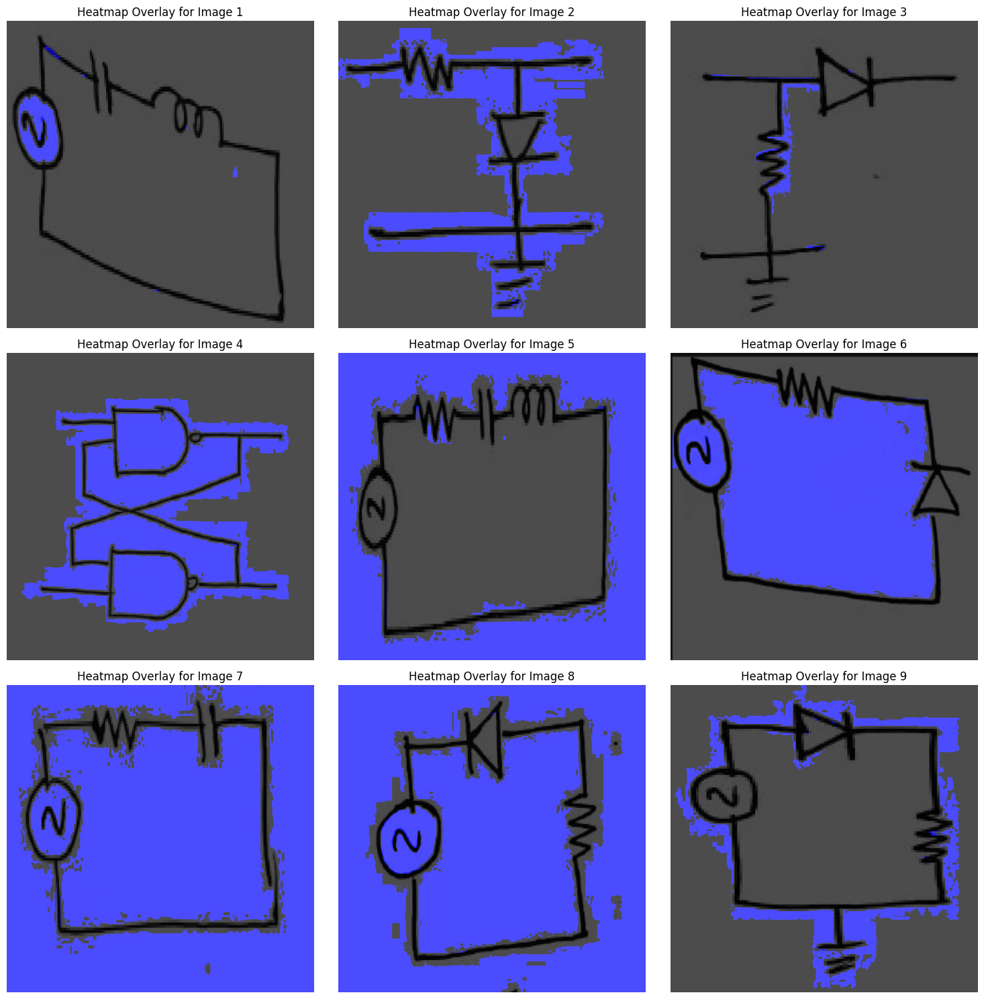

In [30]:
import os
import random
import torch
import numpy as np
from PIL import Image
from ultralytics import YOLO
import matplotlib.pyplot as plt
from lime import lime_image
from skimage.segmentation import felzenszwalb
from skimage.color import label2rgb

# Load YOLOv12 model
model_path = r"F:\yolov12ckt\runs\detect\train29\weights\best.pt"
device = "cuda" if torch.cuda.is_available() else "cpu"
model = YOLO(model_path).to(device).eval()

# Define a wrapper for YOLO predictions to return classification scores
def yolo_predict_for_lime(image_array):
    all_class_probabilities = []
    for img in image_array:
        img_tensor = torch.tensor(img, dtype=torch.float32).permute(2, 0, 1).unsqueeze(0).to(device)
        with torch.no_grad():
            outputs = model(img_tensor)
        class_probabilities = process_yolo_outputs(outputs)
        all_class_probabilities.append(class_probabilities)
    return np.concatenate(all_class_probabilities, axis=0)

# Define how to process YOLOv12 outputs
def process_yolo_outputs(outputs):
    if len(outputs) > 0 and outputs[0].boxes is not None and len(outputs[0].boxes.cls) > 0:
        class_scores = torch.zeros((outputs[0].boxes.cls.shape[0], len(model.names))).to(device)
        for i, cls_idx in enumerate(outputs[0].boxes.cls):
            class_scores[i, int(cls_idx)] = outputs[0].boxes.conf[i]
        class_scores = torch.sum(class_scores, dim=0, keepdim=True)
    else:
        class_scores = torch.zeros((1, len(model.names))).to(device)
    return class_scores.cpu().numpy()

# Load a random set of 9 images from the dataset
dataset_dir = r"F:\yolov12ckt\dataset\test\images"
image_files = [os.path.join(dataset_dir, f) for f in os.listdir(dataset_dir) if f.endswith(('.jpg', '.png'))]

if len(image_files) < 9:
    raise ValueError("Not enough images in the dataset directory.")

random_images = random.sample(image_files, 9)

# Define the segmentation function using Felzenszwalb segmentation
def segmenter(image):
    return felzenszwalb(image, scale=300, sigma=1)

# Create LIME explainer
explainer = lime_image.LimeImageExplainer()

# Function to visualize detections with LIME heatmaps
def visualize_heatmap(image_path, ax):
    # Load the image
    try:
        image = Image.open(image_path).convert("RGB")
        image_np = np.array(image)
    except Exception as e:
        print(f"Error loading image {image_path}: {e}")
        return
    
    # Generate LIME explanations and heatmaps
    try:
        explanation = explainer.explain_instance(
            image_np,
            yolo_predict_for_lime,
            top_labels=5,
            hide_color=0,
            num_samples=200,
            segmentation_fn=segmenter
        )
        
        # Get heatmap
        _, mask = explanation.get_image_and_mask(
            explanation.top_labels[0],
            positive_only=True,
            num_features=8,
            hide_rest=False
        )
        
        # Convert the image to have a blue background
        blue_background = np.full_like(image_np, [0, 0, 255])
        
        # Apply heatmap overlay using a colormap
        heatmap = label2rgb(mask, image=image_np, bg_label=0, colors=['blue', 'red'], alpha=0.7)
        
        # Display the result
        ax.imshow(heatmap)
        ax.axis("off")
    except Exception as e:
        print(f"Error processing image {image_path}: {e}")

# Process and visualize each image
fig, axes = plt.subplots(3, 3, figsize=(15, 15))
axes = axes.flatten()

for i, image_path in enumerate(random_images):
    visualize_heatmap(image_path, axes[i])
    axes[i].set_title(f"Heatmap Overlay for Image {i+1}")

plt.tight_layout()
plt.show()


XGBoost Explanation:
XGBoost LIME Explanation:


XGBoost SHAP Explanation:


Error in SHAP for XGBoost: index 12 is out of bounds for axis 1 with size 10

KNN Explanation:
KNN LIME Explanation:


KNN SHAP Explanation:


100%|██████████| 1/1 [00:02<00:00,  2.50s/it]


Error in SHAP for KNN: index 15 is out of bounds for axis 1 with size 10

Gradient Boosting Explanation:
Gradient Boosting LIME Explanation:


Gradient Boosting SHAP Explanation:
Error in SHAP for Gradient Boosting: GradientBoostingClassifier is only supported for binary classification right now!

Random Forest Explanation:
Random Forest LIME Explanation:


Random Forest SHAP Explanation:


Error in SHAP for Random Forest: index 13 is out of bounds for axis 1 with size 10


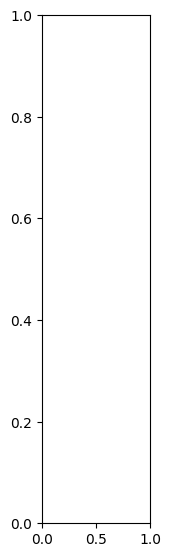

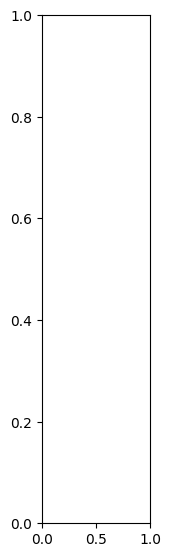

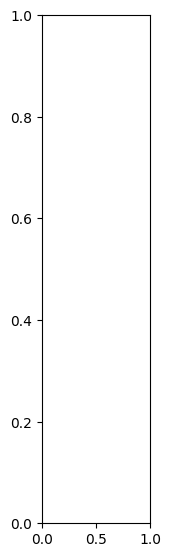

In [31]:
import numpy as np
import lime
from lime import lime_tabular
import shap
import matplotlib.pyplot as plt
import cv2
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
from sklearn.neighbors import KNeighborsClassifier
from xgboost import XGBClassifier
from sklearn.preprocessing import StandardScaler
from sklearn.feature_selection import SelectKBest, f_classif

# Load YOLO Model
model_path = r"F:\yolov12ckt\runs\detect\train29\weights\best.pt"
device = "cuda" if torch.cuda.is_available() else "cpu"
model = YOLO(model_path).eval().to(device)

# Feature Extraction from the Circuit Image
def extract_features(image_path):
    image = cv2.imread(image_path)
    if image is None:
        raise ValueError("Image not found at the specified path.")
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # Convert to RGB
    image = cv2.resize(image, (64, 64))  # Resize for feature extraction
    image_features = image.flatten().reshape(1, -1)  # Shape: (1, height * width * channels)
    return image_features

image_path = r"F:\yolov12ckt\dataset\test\images\Screenshot-2025-03-01-183358_png.rf.17d52f9b467c92f7942ab9025f89c782.jpg"
image_features = extract_features(image_path)

# Simulate a Dataset for Training Models
def simulate_dataset(num_samples, num_features):
    np.random.seed(42)
    X_simulated = np.random.rand(num_samples, num_features)  # Random features
    y_simulated = np.random.randint(0, 23, size=num_samples)  # 23 classes labels
    return X_simulated, y_simulated

num_features = image_features.shape[1]
X_simulated, y_simulated = simulate_dataset(num_samples=1000, num_features=num_features)

# Split into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X_simulated, y_simulated, test_size=0.2, random_state=42)

# Preprocessing (Scaling and Feature Selection)
def preprocess_data(X_train, X_test, instance, k=10):
    scaler = StandardScaler()
    X_train_scaled = scaler.fit_transform(X_train)
    X_test_scaled = scaler.transform(X_test)
    instance_scaled = scaler.transform(instance)  # Scale the instance

    k = min(k, X_train_scaled.shape[1])

    selector = SelectKBest(score_func=f_classif, k=k)
    X_train_selected = selector.fit_transform(X_train_scaled, y_train)
    X_test_selected = selector.transform(X_test_scaled)
    instance_selected = selector.transform(instance_scaled)

    selected_feature_indices = selector.get_support(indices=True)
    feature_names = [f"Feature_{i}" for i in selected_feature_indices]

    return X_train_selected, X_test_selected, instance_selected, feature_names

X_train_selected, X_test_selected, instance_selected, feature_names = preprocess_data(
    X_train, X_test, image_features, k=10
)

instance_selected = instance_selected.reshape(1, -1)  # Shape: (1, n_features)

# Train Models
def train_models(X_train_selected, y_train):
    models = {
        "XGBoost": XGBClassifier(),
        "KNN": KNeighborsClassifier(n_neighbors=5),
        "Gradient Boosting": GradientBoostingClassifier(),
        "Random Forest": RandomForestClassifier()
    }

    for name, model in models.items():
        model.fit(X_train_selected, y_train)

    return models

models = train_models(X_train_selected, y_train)

# Generate Explanations (LIME + SHAP)
def generate_explanations(models, X_train_selected, instance_selected, feature_names):
    lime_explainer = lime_tabular.LimeTabularExplainer(
        X_train_selected,
        feature_names=feature_names,
        class_names=[f"Class_{i}" for i in range(23)],
        mode="classification"
    )

    for name, model in models.items():
        print(f"\n{name} Explanation:")

        try:
            print(f"{name} LIME Explanation:")
            lime_exp = lime_explainer.explain_instance(
                instance_selected.flatten(),
                predict_fn=lambda x: model.predict_proba(x),
                num_features=10
            )
            lime_exp.show_in_notebook(show_table=True)
        except Exception as e:
            print(f"Error in LIME for {name}: {e}")

        try:
            print(f"{name} SHAP Explanation:")
            if name == "KNN":
                shap_explainer = shap.KernelExplainer(model.predict_proba, X_train_selected[:100])
            else:
                shap_explainer = shap.TreeExplainer(model)

            shap_values = shap_explainer.shap_values(instance_selected)

            if isinstance(shap_values, list):  # Extract SHAP values for class 1 if it's a list
                shap_values = shap_values[1]

            shap.initjs()

            shap.summary_plot(shap_values, X_train_selected, feature_names=feature_names, plot_type="bar")
        except Exception as e:
            print(f"Error in SHAP for {name}: {e}")

generate_explanations(models, X_train_selected, instance_selected, feature_names)

  1%|          | 9/1000 [00:01<02:24,  6.86it/s]


0: 640x640 1 ACSource, 1 Inductor, 1 Resistor, 882.7ms
1: 640x640 61 Diodes, 1 NPN, 1 Resistor, 882.7ms
2: 640x640 47 Diodes, 2 Gnds, 1 Inductor, 1 PNP, 2 Resistors, 882.7ms
3: 640x640 1 ACSource, 49 Diodes, 2 Inductors, 3 NPNs, 882.7ms
4: 640x640 56 Diodes, 1 NPN, 2 Resistors, 882.7ms
5: 640x640 45 Diodes, 3 Resistors, 882.7ms
6: 640x640 1 ACSource, 57 Diodes, 3 NPNs, 3 Resistors, 882.7ms
7: 640x640 53 Diodes, 3 NPNs, 3 Resistors, 882.7ms
8: 640x640 1 Capacitor, 58 Diodes, 2 NPNs, 1 Resistor, 882.7ms
9: 640x640 46 Diodes, 1 Gnd, 1 PNP, 2 Resistors, 882.7ms
Speed: 0.0ms preprocess, 882.7ms inference, 2.4ms postprocess per image at shape (1, 3, 640, 640)


  2%|▏         | 19/1000 [00:12<04:13,  3.87it/s]


0: 640x640 1 ACSource, 41 Diodes, 1 NPN, 1 Resistor, 914.8ms
1: 640x640 46 Diodes, 2 Resistors, 914.8ms
2: 640x640 36 Diodes, 3 Resistors, 914.8ms
3: 640x640 53 Diodes, 1 NPN, 1 Resistor, 914.8ms
4: 640x640 48 Diodes, 1 Inductor, 2 NPNs, 2 Resistors, 914.8ms
5: 640x640 50 Diodes, 2 NPNs, 1 PNP, 914.8ms
6: 640x640 48 Diodes, 2 NPNs, 1 Resistor, 914.8ms
7: 640x640 60 Diodes, 914.8ms
8: 640x640 47 Diodes, 2 NPNs, 6 Resistors, 914.8ms
9: 640x640 49 Diodes, 2 NPNs, 914.8ms
Speed: 0.0ms preprocess, 914.8ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)


  3%|▎         | 29/1000 [00:22<04:13,  3.83it/s]


0: 640x640 49 Diodes, 1 Inductor, 900.6ms
1: 640x640 56 Diodes, 3 NPNs, 1 Resistor, 900.6ms
2: 640x640 1 ACSource, 55 Diodes, 1 NPN, 900.6ms
3: 640x640 1 ACSource, 45 Diodes, 2 Resistors, 900.6ms
4: 640x640 52 Diodes, 1 Inductor, 1 NPN, 2 Resistors, 900.6ms
5: 640x640 1 Capacitor, 52 Diodes, 1 NPN, 4 Resistors, 900.6ms
6: 640x640 61 Diodes, 1 NPN, 4 Resistors, 900.6ms
7: 640x640 1 ACSource, 54 Diodes, 1 NPN, 5 Resistors, 900.6ms
8: 640x640 55 Diodes, 2 NPNs, 1 PNP, 2 Resistors, 900.6ms
9: 640x640 59 Diodes, 1 Inductor, 1 NPN, 1 PNP, 3 Resistors, 900.6ms
Speed: 0.0ms preprocess, 900.6ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)


  4%|▍         | 39/1000 [00:33<04:04,  3.92it/s]


0: 640x640 62 Diodes, 2 Inductors, 2 NPNs, 1 Resistor, 906.1ms
1: 640x640 1 ACSource, 59 Diodes, 4 NPNs, 2 Resistors, 906.1ms
2: 640x640 1 ACSource, 57 Diodes, 4 Resistors, 906.1ms
3: 640x640 45 Diodes, 2 Resistors, 906.1ms
4: 640x640 1 ACSource, 55 Diodes, 3 NPNs, 4 Resistors, 906.1ms
5: 640x640 54 Diodes, 1 PNP, 4 Resistors, 906.1ms
6: 640x640 50 Diodes, 2 Resistors, 906.1ms
7: 640x640 55 Diodes, 1 NPN, 906.1ms
8: 640x640 64 Diodes, 1 NPN, 1 Resistor, 906.1ms
9: 640x640 48 Diodes, 1 NPN, 1 Resistor, 906.1ms
Speed: 0.0ms preprocess, 906.1ms inference, 2.4ms postprocess per image at shape (1, 3, 640, 640)


  5%|▍         | 49/1000 [00:44<04:07,  3.84it/s]


0: 640x640 56 Diodes, 1 NPN, 2 Resistors, 902.0ms
1: 640x640 1 Capacitor, 51 Diodes, 2 NPNs, 2 Resistors, 902.0ms
2: 640x640 57 Diodes, 1 Resistor, 902.0ms
3: 640x640 1 ACSource, 84 Diodes, 1 NPN, 1 Resistor, 902.0ms
4: 640x640 51 Diodes, 1 Inductor, 4 NPNs, 3 Resistors, 902.0ms
5: 640x640 1 ACSource, 43 Diodes, 1 NPN, 5 Resistors, 902.0ms
6: 640x640 46 Diodes, 1 NPN, 2 Resistors, 902.0ms
7: 640x640 56 Diodes, 1 NPN, 1 Resistor, 902.0ms
8: 640x640 45 Diodes, 6 Resistors, 902.0ms
9: 640x640 53 Diodes, 1 NPN, 1 PNP, 1 Resistor, 902.0ms
Speed: 0.0ms preprocess, 902.0ms inference, 2.6ms postprocess per image at shape (1, 3, 640, 640)


  6%|▌         | 59/1000 [00:54<04:10,  3.75it/s]


0: 640x640 1 ACSource, 55 Diodes, 2 NPNs, 2 Resistors, 910.9ms
1: 640x640 48 Diodes, 2 NPNs, 1 Resistor, 910.9ms
2: 640x640 62 Diodes, 1 Inductor, 2 NPNs, 2 Resistors, 910.9ms
3: 640x640 48 Diodes, 910.9ms
4: 640x640 53 Diodes, 1 NPN, 910.9ms
5: 640x640 57 Diodes, 2 Resistors, 910.9ms
6: 640x640 62 Diodes, 910.9ms
7: 640x640 60 Diodes, 2 NPNs, 3 Resistors, 910.9ms
8: 640x640 58 Diodes, 3 NPNs, 3 Resistors, 910.9ms
9: 640x640 1 ACSource, 50 Diodes, 2 NPNs, 2 Resistors, 910.9ms
Speed: 0.0ms preprocess, 910.9ms inference, 2.4ms postprocess per image at shape (1, 3, 640, 640)


  7%|▋         | 69/1000 [01:05<03:59,  3.89it/s]


0: 640x640 52 Diodes, 2 NPNs, 1 Resistor, 919.7ms
1: 640x640 53 Diodes, 1 Resistor, 919.7ms
2: 640x640 1 ACSource, 1 Capacitor, 66 Diodes, 1 Resistor, 919.7ms
3: 640x640 70 Diodes, 1 Inductor, 1 NPN, 2 Resistors, 919.7ms
4: 640x640 56 Diodes, 2 Resistors, 919.7ms
5: 640x640 1 ACSource, 1 Capacitor, 42 Diodes, 1 NPN, 919.7ms
6: 640x640 47 Diodes, 919.7ms
7: 640x640 1 Capacitor, 54 Diodes, 1 NPN, 1 Resistor, 919.7ms
8: 640x640 47 Diodes, 1 Inductor, 1 NPN, 1 Resistor, 919.7ms
9: 640x640 1 Capacitor, 52 Diodes, 2 NPNs, 3 Resistors, 919.7ms
Speed: 0.1ms preprocess, 919.7ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)


  8%|▊         | 79/1000 [01:16<04:03,  3.78it/s]


0: 640x640 48 Diodes, 3 Resistors, 917.8ms
1: 640x640 1 ACSource, 59 Diodes, 1 Inductor, 2 NPNs, 5 Resistors, 917.8ms
2: 640x640 2 Capacitors, 50 Diodes, 1 Resistor, 917.8ms
3: 640x640 47 Diodes, 1 Inductor, 2 Resistors, 917.8ms
4: 640x640 57 Diodes, 1 Inductor, 2 NPNs, 1 Resistor, 917.8ms
5: 640x640 49 Diodes, 1 NPN, 4 Resistors, 917.8ms
6: 640x640 55 Diodes, 2 NPNs, 3 Resistors, 917.8ms
7: 640x640 52 Diodes, 5 Resistors, 917.8ms
8: 640x640 61 Diodes, 1 NPN, 917.8ms
9: 640x640 39 Diodes, 2 Inductors, 1 Resistor, 917.8ms
Speed: 0.0ms preprocess, 917.8ms inference, 2.4ms postprocess per image at shape (1, 3, 640, 640)


  9%|▉         | 89/1000 [01:27<03:56,  3.85it/s]


0: 640x640 66 Diodes, 1 PNP, 1090.9ms
1: 640x640 48 Diodes, 2 NPNs, 1090.9ms
2: 640x640 52 Diodes, 1 Inductor, 1090.9ms
3: 640x640 1 ACSource, 64 Diodes, 1 NPN, 2 Resistors, 1090.9ms
4: 640x640 52 Diodes, 2 NPNs, 1090.9ms
5: 640x640 1 ACSource, 38 Diodes, 2 NPNs, 3 Resistors, 1090.9ms
6: 640x640 1 ACSource, 52 Diodes, 5 NPNs, 1090.9ms
7: 640x640 46 Diodes, 1 Inductor, 1090.9ms
8: 640x640 52 Diodes, 3 NPNs, 1 Resistor, 1090.9ms
9: 640x640 62 Diodes, 1 Inductor, 1 NPN, 2 Resistors, 1090.9ms
Speed: 0.0ms preprocess, 1090.9ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)


 10%|▉         | 99/1000 [01:39<04:26,  3.39it/s]


0: 640x640 51 Diodes, 2 NPNs, 1 Resistor, 1141.3ms
1: 640x640 1 ACSource, 63 Diodes, 1 NPN, 4 Resistors, 1141.3ms
2: 640x640 36 Diodes, 1 PNP, 4 Resistors, 1141.3ms
3: 640x640 49 Diodes, 1 Inductor, 2 NPNs, 4 Resistors, 1141.3ms
4: 640x640 53 Diodes, 1 Inductor, 1 Resistor, 1141.3ms
5: 640x640 53 Diodes, 2 Resistors, 1141.3ms
6: 640x640 1 ACSource, 52 Diodes, 3 NPNs, 2 Resistors, 1141.3ms
7: 640x640 1 ACSource, 61 Diodes, 1 NPN, 1 Resistor, 1141.3ms
8: 640x640 63 Diodes, 2 Inductors, 1 Resistor, 1141.3ms
9: 640x640 49 Diodes, 1 NPN, 2 Resistors, 1141.3ms
Speed: 0.0ms preprocess, 1141.3ms inference, 2.8ms postprocess per image at shape (1, 3, 640, 640)


 11%|█         | 109/1000 [01:53<04:50,  3.06it/s]


0: 640x640 46 Diodes, 2 NPNs, 1 Resistor, 918.8ms
1: 640x640 40 Diodes, 1 Inductor, 4 NPNs, 918.8ms
2: 640x640 53 Diodes, 3 Resistors, 918.8ms
3: 640x640 43 Diodes, 1 Inductor, 2 Resistors, 918.8ms
4: 640x640 1 ACSource, 50 Diodes, 1 NPN, 2 Resistors, 918.8ms
5: 640x640 1 ACSource, 44 Diodes, 6 Resistors, 918.8ms
6: 640x640 1 ACSource, 50 Diodes, 2 Resistors, 918.8ms
7: 640x640 52 Diodes, 1 NPN, 2 Resistors, 918.8ms
8: 640x640 1 ACSource, 58 Diodes, 2 NPNs, 1 Resistor, 918.8ms
9: 640x640 62 Diodes, 1 NPN, 2 Resistors, 918.8ms
Speed: 0.0ms preprocess, 918.8ms inference, 2.9ms postprocess per image at shape (1, 3, 640, 640)


 12%|█▏        | 119/1000 [02:04<04:19,  3.40it/s]


0: 640x640 44 Diodes, 2 NPNs, 929.2ms
1: 640x640 40 Diodes, 2 NPNs, 6 Resistors, 929.2ms
2: 640x640 2 ACSources, 42 Diodes, 1 NPN, 1 Resistor, 929.2ms
3: 640x640 51 Diodes, 3 NPNs, 1 PNP, 4 Resistors, 929.2ms
4: 640x640 59 Diodes, 1 NPN, 1 Resistor, 929.2ms
5: 640x640 58 Diodes, 1 Resistor, 929.2ms
6: 640x640 57 Diodes, 3 Resistors, 929.2ms
7: 640x640 51 Diodes, 1 Inductor, 4 Resistors, 929.2ms
8: 640x640 1 ACSource, 50 Diodes, 2 NPNs, 2 Resistors, 929.2ms
9: 640x640 52 Diodes, 1 NPN, 1 Resistor, 929.2ms
Speed: 0.0ms preprocess, 929.2ms inference, 2.8ms postprocess per image at shape (1, 3, 640, 640)


 13%|█▎        | 129/1000 [02:15<04:16,  3.40it/s]


0: 640x640 40 Diodes, 1 NPN, 8 Resistors, 924.3ms
1: 640x640 47 Diodes, 1 NPN, 3 Resistors, 924.3ms
2: 640x640 58 Diodes, 1 NPN, 2 Resistors, 924.3ms
3: 640x640 49 Diodes, 4 NPNs, 4 Resistors, 924.3ms
4: 640x640 58 Diodes, 1 NPN, 3 Resistors, 924.3ms
5: 640x640 49 Diodes, 2 NPNs, 1 Resistor, 924.3ms
6: 640x640 52 Diodes, 3 NPNs, 2 Resistors, 924.3ms
7: 640x640 42 Diodes, 1 NPN, 4 Resistors, 924.3ms
8: 640x640 54 Diodes, 2 Inductors, 1 NPN, 2 Resistors, 924.3ms
9: 640x640 52 Diodes, 1 NPN, 924.3ms
Speed: 0.0ms preprocess, 924.3ms inference, 2.8ms postprocess per image at shape (1, 3, 640, 640)


 14%|█▍        | 139/1000 [02:26<04:07,  3.47it/s]


0: 640x640 65 Diodes, 2 NPNs, 3 Resistors, 901.9ms
1: 640x640 48 Diodes, 1 Resistor, 901.9ms
2: 640x640 1 ACSource, 49 Diodes, 1 PNP, 901.9ms
3: 640x640 58 Diodes, 1 NPN, 3 Resistors, 901.9ms
4: 640x640 55 Diodes, 3 NPNs, 1 PNP, 901.9ms
5: 640x640 57 Diodes, 1 Resistor, 901.9ms
6: 640x640 1 Capacitor, 46 Diodes, 1 Inductor, 2 Resistors, 901.9ms
7: 640x640 1 ACSource, 59 Diodes, 1 Inductor, 1 NPN, 3 Resistors, 901.9ms
8: 640x640 1 ACSource, 44 Diodes, 1 Inductor, 1 NPN, 1 Resistor, 901.9ms
9: 640x640 45 Diodes, 2 NPNs, 2 Resistors, 901.9ms
Speed: 0.0ms preprocess, 901.9ms inference, 2.3ms postprocess per image at shape (1, 3, 640, 640)


 15%|█▍        | 149/1000 [02:37<04:10,  3.39it/s]


0: 640x640 49 Diodes, 3 NPNs, 3 Resistors, 936.0ms
1: 640x640 55 Diodes, 1 NPN, 2 Resistors, 936.0ms
2: 640x640 49 Diodes, 3 NPNs, 1 Resistor, 936.0ms
3: 640x640 1 ACSource, 55 Diodes, 1 NPN, 1 Resistor, 936.0ms
4: 640x640 53 Diodes, 936.0ms
5: 640x640 53 Diodes, 1 Inductor, 3 NPNs, 2 Resistors, 936.0ms
6: 640x640 56 Diodes, 1 NPN, 3 Resistors, 936.0ms
7: 640x640 62 Diodes, 1 Inductor, 4 Resistors, 936.0ms
8: 640x640 52 Diodes, 7 Resistors, 936.0ms
9: 640x640 1 ACSource, 43 Diodes, 1 NPN, 2 Resistors, 936.0ms
Speed: 0.0ms preprocess, 936.0ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 640)


 16%|█▌        | 159/1000 [02:48<03:59,  3.51it/s]


0: 640x640 1 ACSource, 52 Diodes, 1 NPN, 2 Resistors, 921.6ms
1: 640x640 1 ACSource, 50 Diodes, 2 NPNs, 3 Resistors, 921.6ms
2: 640x640 44 Diodes, 1 NPN, 4 Resistors, 921.6ms
3: 640x640 1 Capacitor, 45 Diodes, 2 NPNs, 2 Resistors, 921.6ms
4: 640x640 54 Diodes, 1 NPN, 1 Resistor, 921.6ms
5: 640x640 54 Diodes, 2 NPNs, 6 Resistors, 921.6ms
6: 640x640 61 Diodes, 2 Gnds, 2 Resistors, 921.6ms
7: 640x640 57 Diodes, 1 NPN, 921.6ms
8: 640x640 59 Diodes, 1 NPN, 2 Resistors, 921.6ms
9: 640x640 62 Diodes, 5 Resistors, 921.6ms
Speed: 0.0ms preprocess, 921.6ms inference, 2.9ms postprocess per image at shape (1, 3, 640, 640)


 17%|█▋        | 169/1000 [02:59<03:58,  3.49it/s]


0: 640x640 71 Diodes, 1 NPN, 2 Resistors, 936.4ms
1: 640x640 45 Diodes, 1 NPN, 2 Resistors, 936.4ms
2: 640x640 1 ACSource, 44 Diodes, 2 Inductors, 2 Resistors, 936.4ms
3: 640x640 44 Diodes, 1 Inductor, 3 NPNs, 2 Resistors, 936.4ms
4: 640x640 70 Diodes, 1 NPN, 936.4ms
5: 640x640 66 Diodes, 1 Resistor, 936.4ms
6: 640x640 39 Diodes, 936.4ms
7: 640x640 68 Diodes, 2 Inductors, 1 NPN, 1 Resistor, 936.4ms
8: 640x640 49 Diodes, 1 Resistor, 936.4ms
9: 640x640 56 Diodes, 1 Inductor, 1 Resistor, 936.4ms
Speed: 0.0ms preprocess, 936.4ms inference, 4.1ms postprocess per image at shape (1, 3, 640, 640)


 18%|█▊        | 179/1000 [03:11<03:56,  3.47it/s]


0: 640x640 49 Diodes, 1 NPN, 5 Resistors, 913.9ms
1: 640x640 57 Diodes, 1 Resistor, 913.9ms
2: 640x640 49 Diodes, 1 NPN, 3 Resistors, 913.9ms
3: 640x640 54 Diodes, 1 Resistor, 913.9ms
4: 640x640 53 Diodes, 1 NPN, 913.9ms
5: 640x640 52 Diodes, 1 NPN, 913.9ms
6: 640x640 1 ACSource, 52 Diodes, 2 Resistors, 913.9ms
7: 640x640 52 Diodes, 1 Inductor, 1 NPN, 2 Resistors, 913.9ms
8: 640x640 54 Diodes, 1 Inductor, 3 NPNs, 3 Resistors, 913.9ms
9: 640x640 56 Diodes, 1 Inductor, 3 Resistors, 913.9ms
Speed: 0.0ms preprocess, 913.9ms inference, 2.7ms postprocess per image at shape (1, 3, 640, 640)


 19%|█▉        | 189/1000 [03:22<03:53,  3.47it/s]


0: 640x640 52 Diodes, 1 NPN, 913.4ms
1: 640x640 47 Diodes, 1 NPN, 4 Resistors, 913.4ms
2: 640x640 46 Diodes, 1 NPN, 3 Resistors, 913.4ms
3: 640x640 43 Diodes, 1 NPN, 1 Resistor, 913.4ms
4: 640x640 56 Diodes, 1 Inductor, 2 NPNs, 2 Resistors, 913.4ms
5: 640x640 1 ACSource, 57 Diodes, 2 NPNs, 5 Resistors, 913.4ms
6: 640x640 71 Diodes, 1 Resistor, 913.4ms
7: 640x640 1 DepcurrentSrc, 61 Diodes, 2 NPNs, 2 Resistors, 913.4ms
8: 640x640 56 Diodes, 2 NPNs, 3 Resistors, 913.4ms
9: 640x640 46 Diodes, 2 NPNs, 3 Resistors, 913.4ms
Speed: 0.0ms preprocess, 913.4ms inference, 2.8ms postprocess per image at shape (1, 3, 640, 640)


 20%|█▉        | 199/1000 [03:33<03:43,  3.58it/s]


0: 640x640 52 Diodes, 2 Inductors, 2 NPNs, 907.5ms
1: 640x640 62 Diodes, 1 Inductor, 1 NPN, 2 Resistors, 907.5ms
2: 640x640 37 Diodes, 1 NPN, 1 PNP, 907.5ms
3: 640x640 52 Diodes, 2 NPNs, 2 Resistors, 907.5ms
4: 640x640 41 Diodes, 5 Resistors, 907.5ms
5: 640x640 62 Diodes, 1 Inductor, 1 NPN, 2 Resistors, 907.5ms
6: 640x640 45 Diodes, 1 NPN, 1 Resistor, 907.5ms
7: 640x640 54 Diodes, 1 PNP, 1 Resistor, 907.5ms
8: 640x640 58 Diodes, 6 Resistors, 907.5ms
9: 640x640 56 Diodes, 1 Inductor, 3 NPNs, 2 Resistors, 907.5ms
Speed: 0.0ms preprocess, 907.5ms inference, 2.4ms postprocess per image at shape (1, 3, 640, 640)


 21%|██        | 209/1000 [03:43<03:38,  3.63it/s]


0: 640x640 44 Diodes, 3 NPNs, 1 Resistor, 927.4ms
1: 640x640 45 Diodes, 1 Resistor, 927.4ms
2: 640x640 65 Diodes, 2 Resistors, 927.4ms
3: 640x640 62 Diodes, 1 Inductor, 1 NPN, 3 Resistors, 927.4ms
4: 640x640 60 Diodes, 1 Inductor, 1 NPN, 927.4ms
5: 640x640 46 Diodes, 1 NPN, 1 Resistor, 927.4ms
6: 640x640 52 Diodes, 1 Inductor, 4 Resistors, 927.4ms
7: 640x640 61 Diodes, 1 Inductor, 2 NPNs, 2 Resistors, 927.4ms
8: 640x640 1 ACSource, 55 Diodes, 5 Resistors, 927.4ms
9: 640x640 40 Diodes, 1 NPN, 2 Resistors, 927.4ms
Speed: 0.0ms preprocess, 927.4ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)


 22%|██▏       | 219/1000 [03:55<03:40,  3.55it/s]


0: 640x640 49 Diodes, 3 Resistors, 916.0ms
1: 640x640 1 ACSource, 45 Diodes, 1 Inductor, 1 NPN, 1 Resistor, 916.0ms
2: 640x640 49 Diodes, 1 NPN, 2 Resistors, 916.0ms
3: 640x640 1 ACSource, 46 Diodes, 1 NPN, 4 Resistors, 916.0ms
4: 640x640 45 Diodes, 3 NPNs, 4 Resistors, 916.0ms
5: 640x640 47 Diodes, 3 Inductors, 2 NPNs, 916.0ms
6: 640x640 1 ACSource, 55 Diodes, 1 Inductor, 1 NPN, 1 Resistor, 916.0ms
7: 640x640 54 Diodes, 1 NPN, 916.0ms
8: 640x640 1 ACSource, 59 Diodes, 1 NPN, 1 Resistor, 916.0ms
9: 640x640 56 Diodes, 1 Resistor, 916.0ms
Speed: 0.0ms preprocess, 916.0ms inference, 2.9ms postprocess per image at shape (1, 3, 640, 640)


 23%|██▎       | 229/1000 [04:06<03:32,  3.62it/s]


0: 640x640 48 Diodes, 3 NPNs, 5 Resistors, 911.2ms
1: 640x640 65 Diodes, 1 NPN, 2 Resistors, 911.2ms
2: 640x640 65 Diodes, 2 Resistors, 911.2ms
3: 640x640 2 ACSources, 52 Diodes, 3 NPNs, 2 Resistors, 911.2ms
4: 640x640 58 Diodes, 3 NPNs, 3 Resistors, 911.2ms
5: 640x640 66 Diodes, 1 NPN, 911.2ms
6: 640x640 50 Diodes, 1 Inductor, 6 Resistors, 911.2ms
7: 640x640 60 Diodes, 3 NPNs, 2 Resistors, 911.2ms
8: 640x640 44 Diodes, 2 Resistors, 911.2ms
9: 640x640 1 Capacitor, 53 Diodes, 1 NPN, 3 Resistors, 911.2ms
Speed: 0.0ms preprocess, 911.2ms inference, 2.9ms postprocess per image at shape (1, 3, 640, 640)


 24%|██▍       | 239/1000 [04:16<03:33,  3.57it/s]


0: 640x640 44 Diodes, 930.6ms
1: 640x640 45 Diodes, 1 NPN, 1 Resistor, 930.6ms
2: 640x640 50 Diodes, 2 NPNs, 2 Resistors, 930.6ms
3: 640x640 48 Diodes, 3 Resistors, 930.6ms
4: 640x640 1 ACSource, 67 Diodes, 1 NPN, 3 Resistors, 930.6ms
5: 640x640 56 Diodes, 2 NPNs, 1 PNP, 930.6ms
6: 640x640 65 Diodes, 1 NPN, 2 Resistors, 930.6ms
7: 640x640 47 Diodes, 2 Resistors, 930.6ms
8: 640x640 46 Diodes, 4 NPNs, 1 Resistor, 930.6ms
9: 640x640 1 ACSource, 46 Diodes, 1 Resistor, 930.6ms
Speed: 0.0ms preprocess, 930.6ms inference, 2.7ms postprocess per image at shape (1, 3, 640, 640)


 25%|██▍       | 249/1000 [04:28<03:31,  3.55it/s]


0: 640x640 50 Diodes, 1 NPN, 5 Resistors, 931.2ms
1: 640x640 1 ACSource, 45 Diodes, 1 NPN, 1 Resistor, 931.2ms
2: 640x640 61 Diodes, 1 NPN, 3 Resistors, 931.2ms
3: 640x640 44 Diodes, 2 Inductors, 2 Resistors, 931.2ms
4: 640x640 1 ACSource, 61 Diodes, 2 NPNs, 1 Resistor, 931.2ms
5: 640x640 58 Diodes, 1 NPN, 4 Resistors, 931.2ms
6: 640x640 44 Diodes, 3 NPNs, 2 Resistors, 931.2ms
7: 640x640 55 Diodes, 1 Inductor, 1 NPN, 4 Resistors, 931.2ms
8: 640x640 49 Diodes, 3 Resistors, 931.2ms
9: 640x640 1 ACSource, 58 Diodes, 1 Inductor, 931.2ms
Speed: 0.0ms preprocess, 931.2ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)


 26%|██▌       | 259/1000 [04:39<03:29,  3.54it/s]


0: 640x640 46 Diodes, 2 NPNs, 2 Resistors, 920.5ms
1: 640x640 65 Diodes, 1 NPN, 1 Resistor, 920.5ms
2: 640x640 55 Diodes, 3 Resistors, 920.5ms
3: 640x640 54 Diodes, 1 NPN, 1 Resistor, 920.5ms
4: 640x640 58 Diodes, 1 Inductor, 2 NPNs, 1 Resistor, 920.5ms
5: 640x640 60 Diodes, 3 NPNs, 2 Resistors, 920.5ms
6: 640x640 54 Diodes, 3 NPNs, 1 Resistor, 920.5ms
7: 640x640 1 ACSource, 58 Diodes, 1 NPN, 920.5ms
8: 640x640 1 ACSource, 48 Diodes, 7 Resistors, 920.5ms
9: 640x640 54 Diodes, 2 Resistors, 920.5ms
Speed: 0.0ms preprocess, 920.5ms inference, 2.2ms postprocess per image at shape (1, 3, 640, 640)


 27%|██▋       | 269/1000 [04:50<03:28,  3.50it/s]


0: 640x640 46 Diodes, 1 Inductor, 1 NPN, 940.1ms
1: 640x640 1 Capacitor, 49 Diodes, 1 Inductor, 1 NPN, 2 Resistors, 940.1ms
2: 640x640 35 Diodes, 1 NPN, 2 Resistors, 940.1ms
3: 640x640 1 ACSource, 56 Diodes, 1 NPN, 940.1ms
4: 640x640 41 Diodes, 1 Inductor, 1 NPN, 4 Resistors, 940.1ms
5: 640x640 58 Diodes, 1 NPN, 2 Resistors, 940.1ms
6: 640x640 41 Diodes, 3 NPNs, 2 Resistors, 940.1ms
7: 640x640 63 Diodes, 1 NPN, 940.1ms
8: 640x640 58 Diodes, 1 NPN, 940.1ms
9: 640x640 48 Diodes, 1 NPN, 4 Resistors, 940.1ms
Speed: 0.0ms preprocess, 940.1ms inference, 2.8ms postprocess per image at shape (1, 3, 640, 640)


 28%|██▊       | 279/1000 [05:01<03:30,  3.42it/s]


0: 640x640 1 ACSource, 49 Diodes, 2 NPNs, 3 Resistors, 899.7ms
1: 640x640 60 Diodes, 1 NPN, 2 Resistors, 899.7ms
2: 640x640 1 ACSource, 48 Diodes, 1 Inductor, 2 NPNs, 2 Resistors, 899.7ms
3: 640x640 55 Diodes, 1 NPN, 2 Resistors, 899.7ms
4: 640x640 55 Diodes, 1 Inductor, 4 Resistors, 899.7ms
5: 640x640 65 Diodes, 1 NPN, 3 Resistors, 899.7ms
6: 640x640 62 Diodes, 3 Resistors, 899.7ms
7: 640x640 58 Diodes, 1 Resistor, 899.7ms
8: 640x640 47 Diodes, 4 Resistors, 899.7ms
9: 640x640 1 ACSource, 55 Diodes, 899.7ms
Speed: 0.0ms preprocess, 899.7ms inference, 2.9ms postprocess per image at shape (1, 3, 640, 640)


 29%|██▉       | 289/1000 [05:12<03:21,  3.52it/s]


0: 640x640 53 Diodes, 4 NPNs, 6 Resistors, 907.3ms
1: 640x640 1 ACSource, 39 Diodes, 5 NPNs, 4 Resistors, 907.3ms
2: 640x640 1 ACSource, 60 Diodes, 2 NPNs, 1 Resistor, 907.3ms
3: 640x640 1 ACSource, 56 Diodes, 1 Inductor, 2 NPNs, 1 PNP, 5 Resistors, 907.3ms
4: 640x640 55 Diodes, 2 Inductors, 3 NPNs, 3 Resistors, 907.3ms
5: 640x640 58 Diodes, 4 Resistors, 907.3ms
6: 640x640 60 Diodes, 2 Resistors, 907.3ms
7: 640x640 55 Diodes, 3 NPNs, 2 Resistors, 907.3ms
8: 640x640 1 Cell, 65 Diodes, 1 NPN, 3 Resistors, 907.3ms
9: 640x640 52 Diodes, 2 NPNs, 907.3ms
Speed: 0.0ms preprocess, 907.3ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 30%|██▉       | 299/1000 [05:23<03:20,  3.50it/s]


0: 640x640 53 Diodes, 1 PNP, 1 Resistor, 892.1ms
1: 640x640 49 Diodes, 1 NPN, 1 Resistor, 892.1ms
2: 640x640 1 ACSource, 59 Diodes, 892.1ms
3: 640x640 56 Diodes, 2 NPNs, 1 Resistor, 892.1ms
4: 640x640 1 ACSource, 56 Diodes, 3 NPNs, 4 Resistors, 892.1ms
5: 640x640 63 Diodes, 1 Inductor, 1 NPN, 2 Resistors, 892.1ms
6: 640x640 50 Diodes, 1 Inductor, 4 Resistors, 892.1ms
7: 640x640 56 Diodes, 4 Resistors, 892.1ms
8: 640x640 45 Diodes, 1 NPN, 1 Resistor, 892.1ms
9: 640x640 45 Diodes, 892.1ms
Speed: 0.0ms preprocess, 892.1ms inference, 2.8ms postprocess per image at shape (1, 3, 640, 640)


 31%|███       | 309/1000 [05:34<03:12,  3.59it/s]


0: 640x640 35 Diodes, 1 Inductor, 4 Resistors, 940.2ms
1: 640x640 1 Capacitor, 52 Diodes, 1 NPN, 1 Resistor, 940.2ms
2: 640x640 64 Diodes, 1 Inductor, 3 NPNs, 940.2ms
3: 640x640 1 ACSource, 57 Diodes, 1 Inductor, 2 Resistors, 940.2ms
4: 640x640 44 Diodes, 1 NPN, 1 Resistor, 940.2ms
5: 640x640 58 Diodes, 2 NPNs, 2 Resistors, 940.2ms
6: 640x640 55 Diodes, 3 NPNs, 1 Resistor, 940.2ms
7: 640x640 54 Diodes, 1 Inductor, 3 Resistors, 940.2ms
8: 640x640 55 Diodes, 1 NPN, 1 Resistor, 940.2ms
9: 640x640 55 Diodes, 3 Resistors, 940.2ms
Speed: 0.0ms preprocess, 940.2ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)


 32%|███▏      | 319/1000 [05:45<03:14,  3.51it/s]


0: 640x640 37 Diodes, 1 Inductor, 1 NPN, 3 Resistors, 914.4ms
1: 640x640 51 Diodes, 3 NPNs, 2 Resistors, 914.4ms
2: 640x640 62 Diodes, 2 NPNs, 3 Resistors, 914.4ms
3: 640x640 39 Diodes, 1 Resistor, 914.4ms
4: 640x640 52 Diodes, 1 Inductor, 3 NPNs, 2 Resistors, 914.4ms
5: 640x640 58 Diodes, 2 NPNs, 1 Resistor, 914.4ms
6: 640x640 1 ACSource, 49 Diodes, 1 NPN, 2 Resistors, 914.4ms
7: 640x640 57 Diodes, 3 NPNs, 2 Resistors, 914.4ms
8: 640x640 1 ACSource, 68 Diodes, 2 NPNs, 1 Resistor, 914.4ms
9: 640x640 50 Diodes, 1 Resistor, 914.4ms
Speed: 0.0ms preprocess, 914.4ms inference, 2.7ms postprocess per image at shape (1, 3, 640, 640)


 33%|███▎      | 329/1000 [05:56<03:08,  3.55it/s]


0: 640x640 1 ACSource, 49 Diodes, 3 NPNs, 915.6ms
1: 640x640 1 ACSource, 43 Diodes, 1 NPN, 2 Resistors, 915.6ms
2: 640x640 53 Diodes, 1 NPN, 4 Resistors, 915.6ms
3: 640x640 50 Diodes, 2 NPNs, 3 Resistors, 915.6ms
4: 640x640 1 ACSource, 51 Diodes, 2 Resistors, 915.6ms
5: 640x640 1 ACSource, 1 Capacitor, 42 Diodes, 4 NPNs, 2 Resistors, 915.6ms
6: 640x640 52 Diodes, 4 NPNs, 915.6ms
7: 640x640 43 Diodes, 1 Inductor, 1 Resistor, 915.6ms
8: 640x640 49 Diodes, 2 Resistors, 915.6ms
9: 640x640 1 Capacitor, 59 Diodes, 1 Resistor, 915.6ms
Speed: 0.0ms preprocess, 915.6ms inference, 2.2ms postprocess per image at shape (1, 3, 640, 640)


 34%|███▍      | 339/1000 [06:07<03:04,  3.58it/s]


0: 640x640 53 Diodes, 2 NPNs, 1 Resistor, 887.6ms
1: 640x640 43 Diodes, 2 Resistors, 887.6ms
2: 640x640 1 Capacitor, 54 Diodes, 3 NPNs, 2 Resistors, 887.6ms
3: 640x640 56 Diodes, 1 Resistor, 887.6ms
4: 640x640 47 Diodes, 3 NPNs, 3 Resistors, 887.6ms
5: 640x640 1 ACSource, 57 Diodes, 3 NPNs, 1 Resistor, 887.6ms
6: 640x640 51 Diodes, 1 Inductor, 2 NPNs, 1 Resistor, 887.6ms
7: 640x640 1 ACSource, 51 Diodes, 1 Resistor, 887.6ms
8: 640x640 1 ACSource, 56 Diodes, 2 Resistors, 887.6ms
9: 640x640 45 Diodes, 1 Resistor, 887.6ms
Speed: 0.0ms preprocess, 887.6ms inference, 2.6ms postprocess per image at shape (1, 3, 640, 640)


 35%|███▍      | 349/1000 [06:18<03:02,  3.58it/s]


0: 640x640 71 Diodes, 1 Inductor, 1 NPN, 3 Resistors, 870.2ms
1: 640x640 67 Diodes, 2 NPNs, 3 Resistors, 870.2ms
2: 640x640 1 ACSource, 44 Diodes, 2 NPNs, 3 Resistors, 870.2ms
3: 640x640 51 Diodes, 2 Resistors, 870.2ms
4: 640x640 1 ACSource, 63 Diodes, 3 Resistors, 870.2ms
5: 640x640 43 Diodes, 1 NPN, 3 Resistors, 870.2ms
6: 640x640 45 Diodes, 5 NPNs, 2 Resistors, 870.2ms
7: 640x640 45 Diodes, 5 Resistors, 870.2ms
8: 640x640 48 Diodes, 2 NPNs, 870.2ms
9: 640x640 53 Diodes, 1 NPN, 1 Resistor, 870.2ms
Speed: 0.0ms preprocess, 870.2ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)


 36%|███▌      | 359/1000 [06:28<02:53,  3.69it/s]


0: 640x640 57 Diodes, 1 Inductor, 1 NPN, 5 Resistors, 1032.0ms
1: 640x640 1 ACSource, 56 Diodes, 1 NPN, 1 PNP, 3 Resistors, 1032.0ms
2: 640x640 54 Diodes, 1 NPN, 2 Resistors, 1032.0ms
3: 640x640 50 Diodes, 2 NPNs, 3 Resistors, 1032.0ms
4: 640x640 1 ACSource, 59 Diodes, 1032.0ms
5: 640x640 44 Diodes, 1 NPN, 1032.0ms
6: 640x640 1 ACSource, 60 Diodes, 1 Inductor, 3 Resistors, 1032.0ms
7: 640x640 56 Diodes, 1 Inductor, 1 NPN, 1 PNP, 1 Resistor, 1032.0ms
8: 640x640 1 ACSource, 54 Diodes, 1 Inductor, 1 NPN, 6 Resistors, 1032.0ms
9: 640x640 1 ACSource, 48 Diodes, 2 NPNs, 2 Resistors, 1032.0ms
Speed: 0.0ms preprocess, 1032.0ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)


 37%|███▋      | 369/1000 [06:40<03:07,  3.36it/s]


0: 640x640 58 Diodes, 2 Inductors, 1 Resistor, 1091.0ms
1: 640x640 62 Diodes, 2 Resistors, 1091.0ms
2: 640x640 1 ACSource, 53 Diodes, 1 Inductor, 1 NPN, 3 Resistors, 1091.0ms
3: 640x640 48 Diodes, 1 Inductor, 2 Resistors, 1091.0ms
4: 640x640 62 Diodes, 1 NPN, 1 Resistor, 1091.0ms
5: 640x640 2 ACSources, 49 Diodes, 1 Inductor, 3 NPNs, 4 Resistors, 1091.0ms
6: 640x640 67 Diodes, 3 NPNs, 1091.0ms
7: 640x640 41 Diodes, 1 NPN, 2 Resistors, 1091.0ms
8: 640x640 40 Diodes, 3 NPNs, 2 Resistors, 1091.0ms
9: 640x640 50 Diodes, 1 Inductor, 1091.0ms
Speed: 0.0ms preprocess, 1091.0ms inference, 2.7ms postprocess per image at shape (1, 3, 640, 640)


 38%|███▊      | 379/1000 [06:53<03:32,  2.92it/s]


0: 640x640 57 Diodes, 6 Resistors, 1026.3ms
1: 640x640 1 ACSource, 62 Diodes, 1 NPN, 2 Resistors, 1026.3ms
2: 640x640 35 Diodes, 1 NPN, 2 Resistors, 1026.3ms
3: 640x640 38 Diodes, 2 Resistors, 1026.3ms
4: 640x640 56 Diodes, 1 NPN, 1 Resistor, 1026.3ms
5: 640x640 52 Diodes, 1026.3ms
6: 640x640 47 Diodes, 1 NPN, 1 Resistor, 1026.3ms
7: 640x640 57 Diodes, 1 Inductor, 2 NPNs, 3 Resistors, 1026.3ms
8: 640x640 52 Diodes, 1 Inductor, 1 Resistor, 1026.3ms
9: 640x640 47 Diodes, 1 NPN, 2 Resistors, 1026.3ms
Speed: 0.0ms preprocess, 1026.3ms inference, 2.6ms postprocess per image at shape (1, 3, 640, 640)


 39%|███▉      | 389/1000 [07:05<03:01,  3.37it/s]


0: 640x640 51 Diodes, 1 Inductor, 1 NPN, 1 Resistor, 904.5ms
1: 640x640 48 Diodes, 1 Inductor, 1 NPN, 1 Resistor, 904.5ms
2: 640x640 59 Diodes, 1 Inductor, 1 NPN, 1 Resistor, 904.5ms
3: 640x640 63 Diodes, 1 PNP, 3 Resistors, 904.5ms
4: 640x640 56 Diodes, 3 NPNs, 904.5ms
5: 640x640 45 Diodes, 1 Resistor, 904.5ms
6: 640x640 46 Diodes, 1 Inductor, 4 NPNs, 2 Resistors, 904.5ms
7: 640x640 51 Diodes, 2 NPNs, 1 Resistor, 904.5ms
8: 640x640 56 Diodes, 3 Resistors, 904.5ms
9: 640x640 56 Diodes, 1 Inductor, 904.5ms
Speed: 0.0ms preprocess, 904.5ms inference, 2.4ms postprocess per image at shape (1, 3, 640, 640)


 40%|███▉      | 399/1000 [07:16<02:45,  3.63it/s]


0: 640x640 52 Diodes, 1 Inductor, 2 Resistors, 902.5ms
1: 640x640 50 Diodes, 1 Inductor, 902.5ms
2: 640x640 56 Diodes, 1 NPN, 3 Resistors, 902.5ms
3: 640x640 66 Diodes, 1 Inductor, 2 Resistors, 902.5ms
4: 640x640 55 Diodes, 1 Inductor, 2 NPNs, 3 Resistors, 902.5ms
5: 640x640 1 ACSource, 47 Diodes, 2 NPNs, 3 Resistors, 902.5ms
6: 640x640 57 Diodes, 2 NPNs, 3 Resistors, 902.5ms
7: 640x640 49 Diodes, 2 NPNs, 3 Resistors, 902.5ms
8: 640x640 47 Diodes, 1 Gnd, 3 NPNs, 1 PNP, 7 Resistors, 902.5ms
9: 640x640 51 Diodes, 902.5ms
Speed: 0.0ms preprocess, 902.5ms inference, 2.4ms postprocess per image at shape (1, 3, 640, 640)


 41%|████      | 409/1000 [07:27<02:39,  3.71it/s]


0: 640x640 47 Diodes, 4 NPNs, 1 Resistor, 807.1ms
1: 640x640 57 Diodes, 1 Inductor, 2 NPNs, 1 PNP, 2 Resistors, 807.1ms
2: 640x640 52 Diodes, 3 Resistors, 807.1ms
3: 640x640 1 ACSource, 50 Diodes, 1 Inductor, 1 NPN, 1 Resistor, 807.1ms
4: 640x640 50 Diodes, 1 Inductor, 1 NPN, 2 Resistors, 807.1ms
5: 640x640 44 Diodes, 1 NPN, 807.1ms
6: 640x640 60 Diodes, 2 NPNs, 1 Resistor, 807.1ms
7: 640x640 50 Diodes, 1 NPN, 807.1ms
8: 640x640 67 Diodes, 3 NPNs, 9 Resistors, 807.1ms
9: 640x640 51 Diodes, 1 NPN, 1 Resistor, 807.1ms
Speed: 0.0ms preprocess, 807.1ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)


 42%|████▏     | 419/1000 [07:37<02:27,  3.94it/s]


0: 640x640 60 Diodes, 2 Resistors, 895.9ms
1: 640x640 55 Diodes, 2 NPNs, 1 Resistor, 895.9ms
2: 640x640 59 Diodes, 3 NPNs, 1 XOR, 895.9ms
3: 640x640 48 Diodes, 1 Inductor, 2 NPNs, 6 Resistors, 895.9ms
4: 640x640 1 Capacitor, 56 Diodes, 1 NPN, 1 Resistor, 895.9ms
5: 640x640 45 Diodes, 1 Gnd, 3 NPNs, 2 Resistors, 895.9ms
6: 640x640 54 Diodes, 2 NPNs, 1 Resistor, 895.9ms
7: 640x640 45 Diodes, 3 NPNs, 895.9ms
8: 640x640 1 ACSource, 46 Diodes, 4 NPNs, 5 Resistors, 895.9ms
9: 640x640 50 Diodes, 2 NPNs, 2 Resistors, 895.9ms
Speed: 0.0ms preprocess, 895.9ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 640)


 43%|████▎     | 429/1000 [07:47<02:33,  3.72it/s]


0: 640x640 46 Diodes, 1 NPN, 4 Resistors, 902.3ms
1: 640x640 57 Diodes, 1 NPN, 2 Resistors, 902.3ms
2: 640x640 52 Diodes, 3 Resistors, 902.3ms
3: 640x640 1 ACSource, 60 Diodes, 1 Resistor, 902.3ms
4: 640x640 1 ACSource, 50 Diodes, 1 NPN, 1 Resistor, 902.3ms
5: 640x640 61 Diodes, 1 NPN, 3 Resistors, 902.3ms
6: 640x640 60 Diodes, 1 Inductor, 1 Resistor, 902.3ms
7: 640x640 63 Diodes, 1 NPN, 902.3ms
8: 640x640 1 ACSource, 57 Diodes, 3 Resistors, 902.3ms
9: 640x640 64 Diodes, 4 NPNs, 4 Resistors, 902.3ms
Speed: 0.0ms preprocess, 902.3ms inference, 2.6ms postprocess per image at shape (1, 3, 640, 640)


 44%|████▍     | 439/1000 [07:58<02:29,  3.75it/s]


0: 640x640 1 ACSource, 54 Diodes, 1 Inductor, 2 NPNs, 2 Resistors, 899.4ms
1: 640x640 65 Diodes, 2 NPNs, 3 Resistors, 899.4ms
2: 640x640 1 Capacitor, 59 Diodes, 2 Inductors, 899.4ms
3: 640x640 54 Diodes, 4 NPNs, 899.4ms
4: 640x640 53 Diodes, 2 Inductors, 2 NPNs, 899.4ms
5: 640x640 52 Diodes, 2 NPNs, 1 Resistor, 899.4ms
6: 640x640 44 Diodes, 6 Resistors, 899.4ms
7: 640x640 3 ACSources, 51 Diodes, 1 Inductor, 2 NPNs, 1 Resistor, 899.4ms
8: 640x640 38 Diodes, 1 Inductor, 1 NPN, 3 Resistors, 899.4ms
9: 640x640 1 ACSource, 67 Diodes, 1 NPN, 1 PNP, 1 Resistor, 899.4ms
Speed: 0.0ms preprocess, 899.4ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


 45%|████▍     | 449/1000 [08:09<02:37,  3.49it/s]


0: 640x640 54 Diodes, 1 Inductor, 1 NPN, 3 Resistors, 935.9ms
1: 640x640 51 Diodes, 1 Resistor, 935.9ms
2: 640x640 49 Diodes, 2 NPNs, 4 Resistors, 935.9ms
3: 640x640 1 ACSource, 49 Diodes, 1 NPN, 2 Resistors, 935.9ms
4: 640x640 47 Diodes, 3 NPNs, 1 PNP, 3 Resistors, 935.9ms
5: 640x640 52 Diodes, 4 Resistors, 935.9ms
6: 640x640 53 Diodes, 935.9ms
7: 640x640 38 Diodes, 3 Resistors, 935.9ms
8: 640x640 48 Diodes, 1 Inductor, 2 NPNs, 2 Resistors, 935.9ms
9: 640x640 59 Diodes, 1 PNP, 5 Resistors, 935.9ms
Speed: 0.0ms preprocess, 935.9ms inference, 2.2ms postprocess per image at shape (1, 3, 640, 640)


 46%|████▌     | 459/1000 [08:20<02:31,  3.57it/s]


0: 640x640 50 Diodes, 860.2ms
1: 640x640 56 Diodes, 2 Resistors, 860.2ms
2: 640x640 53 Diodes, 1 Inductor, 1 NPN, 4 Resistors, 860.2ms
3: 640x640 46 Diodes, 1 Inductor, 3 NPNs, 1 Resistor, 860.2ms
4: 640x640 46 Diodes, 1 Inductor, 1 NPN, 1 Resistor, 860.2ms
5: 640x640 57 Diodes, 5 Resistors, 860.2ms
6: 640x640 55 Diodes, 1 NPN, 1 PNP, 4 Resistors, 860.2ms
7: 640x640 52 Diodes, 1 NPN, 5 Resistors, 860.2ms
8: 640x640 55 Diodes, 1 Inductor, 860.2ms
9: 640x640 58 Diodes, 860.2ms
Speed: 0.2ms preprocess, 860.2ms inference, 2.7ms postprocess per image at shape (1, 3, 640, 640)


 47%|████▋     | 469/1000 [08:30<02:15,  3.91it/s]


0: 640x640 53 Diodes, 4 NPNs, 3 Resistors, 887.3ms
1: 640x640 1 ACSource, 52 Diodes, 3 NPNs, 887.3ms
2: 640x640 56 Diodes, 1 Inductor, 1 NPN, 3 Resistors, 887.3ms
3: 640x640 55 Diodes, 3 NPNs, 1 Resistor, 887.3ms
4: 640x640 51 Diodes, 1 NPN, 2 Resistors, 887.3ms
5: 640x640 49 Diodes, 1 Gnd, 1 NPN, 2 PNPs, 887.3ms
6: 640x640 68 Diodes, 2 NPNs, 2 Resistors, 887.3ms
7: 640x640 1 ACSource, 42 Diodes, 1 NPN, 1 Resistor, 887.3ms
8: 640x640 58 Diodes, 1 NPN, 5 Resistors, 887.3ms
9: 640x640 1 ACSource, 59 Diodes, 1 NPN, 2 Resistors, 887.3ms
Speed: 0.0ms preprocess, 887.3ms inference, 2.8ms postprocess per image at shape (1, 3, 640, 640)


 48%|████▊     | 479/1000 [08:41<02:25,  3.57it/s]


0: 640x640 49 Diodes, 2 Resistors, 891.9ms
1: 640x640 49 Diodes, 1 Resistor, 891.9ms
2: 640x640 53 Diodes, 2 NPNs, 2 Resistors, 891.9ms
3: 640x640 55 Diodes, 1 NPN, 1 Resistor, 891.9ms
4: 640x640 58 Diodes, 1 Resistor, 891.9ms
5: 640x640 1 ACSource, 55 Diodes, 1 NPN, 1 Resistor, 891.9ms
6: 640x640 42 Diodes, 2 Resistors, 891.9ms
7: 640x640 55 Diodes, 1 Inductor, 2 NPNs, 2 Resistors, 891.9ms
8: 640x640 54 Diodes, 2 NPNs, 6 Resistors, 891.9ms
9: 640x640 51 Diodes, 1 Inductor, 2 NPNs, 1 Resistor, 891.9ms
Speed: 0.0ms preprocess, 891.9ms inference, 2.4ms postprocess per image at shape (1, 3, 640, 640)


 49%|████▉     | 489/1000 [08:52<02:16,  3.75it/s]


0: 640x640 55 Diodes, 2 NPNs, 4 Resistors, 908.5ms
1: 640x640 47 Diodes, 908.5ms
2: 640x640 38 Diodes, 1 Gnd, 1 NPN, 1 Resistor, 908.5ms
3: 640x640 59 Diodes, 1 Inductor, 1 NPN, 3 Resistors, 908.5ms
4: 640x640 47 Diodes, 1 Inductor, 1 NPN, 2 Resistors, 908.5ms
5: 640x640 51 Diodes, 1 Inductor, 2 NPNs, 2 PNPs, 2 Resistors, 908.5ms
6: 640x640 46 Diodes, 1 Inductor, 2 NPNs, 2 Resistors, 908.5ms
7: 640x640 51 Diodes, 1 Inductor, 1 NPN, 1 Resistor, 908.5ms
8: 640x640 1 ACSource, 43 Diodes, 1 NPN, 3 Resistors, 908.5ms
9: 640x640 58 Diodes, 1 NPN, 3 Resistors, 908.5ms
Speed: 0.0ms preprocess, 908.5ms inference, 3.4ms postprocess per image at shape (1, 3, 640, 640)


 50%|████▉     | 499/1000 [09:02<02:20,  3.57it/s]


0: 640x640 49 Diodes, 4 NPNs, 3 Resistors, 860.2ms
1: 640x640 58 Diodes, 1 NPN, 1 PNP, 4 Resistors, 860.2ms
2: 640x640 1 Capacitor, 52 Diodes, 1 Resistor, 860.2ms
3: 640x640 1 ACSource, 50 Diodes, 1 Inductor, 2 Resistors, 860.2ms
4: 640x640 1 ACSource, 51 Diodes, 1 Resistor, 860.2ms
5: 640x640 57 Diodes, 2 NPNs, 1 Resistor, 860.2ms
6: 640x640 58 Diodes, 860.2ms
7: 640x640 2 ACSources, 58 Diodes, 1 NPN, 2 Resistors, 860.2ms
8: 640x640 50 Diodes, 3 Resistors, 860.2ms
9: 640x640 55 Diodes, 1 Inductor, 1 NPN, 3 Resistors, 860.2ms
Speed: 0.0ms preprocess, 860.2ms inference, 2.6ms postprocess per image at shape (1, 3, 640, 640)


 51%|█████     | 509/1000 [09:13<02:06,  3.89it/s]


0: 640x640 1 ACSource, 45 Diodes, 1 NPN, 843.4ms
1: 640x640 1 ACSource, 52 Diodes, 1 Resistor, 843.4ms
2: 640x640 55 Diodes, 1 NPN, 2 Resistors, 843.4ms
3: 640x640 56 Diodes, 2 NPNs, 843.4ms
4: 640x640 1 ACSource, 50 Diodes, 1 NPN, 3 Resistors, 843.4ms
5: 640x640 54 Diodes, 1 Inductor, 1 NPN, 4 Resistors, 843.4ms
6: 640x640 47 Diodes, 1 Inductor, 1 PNP, 1 Resistor, 843.4ms
7: 640x640 1 ACSource, 58 Diodes, 3 NPNs, 2 Resistors, 843.4ms
8: 640x640 56 Diodes, 2 NPNs, 1 Resistor, 843.4ms
9: 640x640 1 ACSource, 51 Diodes, 1 Inductor, 3 NPNs, 1 PNP, 1 Resistor, 843.4ms
Speed: 0.0ms preprocess, 843.4ms inference, 2.4ms postprocess per image at shape (1, 3, 640, 640)


 52%|█████▏    | 519/1000 [09:22<01:57,  4.09it/s]


0: 640x640 54 Diodes, 1 Inductor, 3 NPNs, 2 Resistors, 960.0ms
1: 640x640 1 ACSource, 56 Diodes, 1 Inductor, 1 Resistor, 960.0ms
2: 640x640 50 Diodes, 1 Gnd, 1 NPN, 3 Resistors, 960.0ms
3: 640x640 1 ACSource, 40 Diodes, 1 Inductor, 1 NPN, 3 Resistors, 960.0ms
4: 640x640 1 ACSource, 63 Diodes, 1 Inductor, 1 Resistor, 960.0ms
5: 640x640 1 ACSource, 56 Diodes, 2 Resistors, 960.0ms
6: 640x640 1 Capacitor, 41 Diodes, 2 NPNs, 2 Resistors, 960.0ms
7: 640x640 43 Diodes, 1 Inductor, 1 NPN, 3 Resistors, 960.0ms
8: 640x640 1 ACSource, 54 Diodes, 2 NPNs, 2 Resistors, 960.0ms
9: 640x640 50 Diodes, 1 NPN, 3 Resistors, 960.0ms
Speed: 0.0ms preprocess, 960.0ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 640)


 53%|█████▎    | 529/1000 [09:34<02:10,  3.62it/s]


0: 640x640 48 Diodes, 1 NPN, 900.5ms
1: 640x640 1 ACSource, 47 Diodes, 1 NPN, 1 Resistor, 900.5ms
2: 640x640 57 Diodes, 2 NPNs, 1 Resistor, 900.5ms
3: 640x640 1 ACSource, 51 Diodes, 1 Inductor, 1 NPN, 900.5ms
4: 640x640 47 Diodes, 8 Resistors, 900.5ms
5: 640x640 1 ACSource, 53 Diodes, 1 NPN, 900.5ms
6: 640x640 53 Diodes, 1 NPN, 900.5ms
7: 640x640 1 Capacitor, 65 Diodes, 4 Resistors, 900.5ms
8: 640x640 1 ACSource, 46 Diodes, 4 Resistors, 900.5ms
9: 640x640 1 ACSource, 44 Diodes, 1 NPN, 2 Resistors, 900.5ms
Speed: 0.0ms preprocess, 900.5ms inference, 2.9ms postprocess per image at shape (1, 3, 640, 640)


 54%|█████▍    | 539/1000 [09:44<01:59,  3.86it/s]


0: 640x640 66 Diodes, 1 NPN, 1 Resistor, 919.3ms
1: 640x640 47 Diodes, 2 Resistors, 919.3ms
2: 640x640 42 Diodes, 1 NPN, 2 Resistors, 919.3ms
3: 640x640 1 ACSource, 71 Diodes, 2 Resistors, 919.3ms
4: 640x640 43 Diodes, 1 Inductor, 2 NPNs, 1 Resistor, 919.3ms
5: 640x640 1 Capacitor, 64 Diodes, 2 NPNs, 919.3ms
6: 640x640 48 Diodes, 1 Gnd, 1 NPN, 4 Resistors, 919.3ms
7: 640x640 45 Diodes, 1 Inductor, 3 Resistors, 919.3ms
8: 640x640 52 Diodes, 4 NPNs, 919.3ms
9: 640x640 62 Diodes, 1 Inductor, 1 NPN, 2 Resistors, 919.3ms
Speed: 0.0ms preprocess, 919.3ms inference, 3.1ms postprocess per image at shape (1, 3, 640, 640)


 55%|█████▍    | 549/1000 [09:55<01:58,  3.82it/s]


0: 640x640 59 Diodes, 1 NPN, 3 Resistors, 908.5ms
1: 640x640 1 ACSource, 57 Diodes, 3 NPNs, 1 Resistor, 908.5ms
2: 640x640 52 Diodes, 1 NPN, 908.5ms
3: 640x640 45 Diodes, 1 NPN, 1 Resistor, 908.5ms
4: 640x640 46 Diodes, 1 NPN, 2 Resistors, 908.5ms
5: 640x640 48 Diodes, 1 Resistor, 908.5ms
6: 640x640 46 Diodes, 1 NPN, 1 Resistor, 908.5ms
7: 640x640 42 Diodes, 1 NPN, 2 Resistors, 908.5ms
8: 640x640 1 ACSource, 56 Diodes, 1 Inductor, 1 NPN, 2 Resistors, 908.5ms
9: 640x640 48 Diodes, 3 NPNs, 2 Resistors, 908.5ms
Speed: 0.0ms preprocess, 908.5ms inference, 2.8ms postprocess per image at shape (1, 3, 640, 640)


 56%|█████▌    | 559/1000 [10:06<01:54,  3.86it/s]


0: 640x640 54 Diodes, 2 Resistors, 885.8ms
1: 640x640 40 Diodes, 3 NPNs, 885.8ms
2: 640x640 53 Diodes, 1 Resistor, 885.8ms
3: 640x640 1 ACSource, 57 Diodes, 2 NPNs, 885.8ms
4: 640x640 1 ACSource, 66 Diodes, 1 NPN, 2 Resistors, 885.8ms
5: 640x640 51 Diodes, 1 NPN, 885.8ms
6: 640x640 63 Diodes, 1 Resistor, 885.8ms
7: 640x640 48 Diodes, 1 NPN, 5 Resistors, 885.8ms
8: 640x640 64 Diodes, 1 Inductor, 885.8ms
9: 640x640 49 Diodes, 1 Inductor, 2 NPNs, 1 Resistor, 885.8ms
Speed: 0.0ms preprocess, 885.8ms inference, 2.7ms postprocess per image at shape (1, 3, 640, 640)


 57%|█████▋    | 569/1000 [10:16<01:49,  3.92it/s]


0: 640x640 1 ACSource, 54 Diodes, 1 NPN, 880.6ms
1: 640x640 61 Diodes, 1 NPN, 1 Resistor, 880.6ms
2: 640x640 58 Diodes, 1 NPN, 2 Resistors, 880.6ms
3: 640x640 52 Diodes, 1 NPN, 880.6ms
4: 640x640 57 Diodes, 6 Resistors, 880.6ms
5: 640x640 43 Diodes, 2 NPNs, 2 Resistors, 880.6ms
6: 640x640 59 Diodes, 1 NPN, 3 Resistors, 880.6ms
7: 640x640 1 ACSource, 56 Diodes, 1 NPN, 2 Resistors, 880.6ms
8: 640x640 39 Diodes, 1 Inductor, 1 NPN, 3 Resistors, 880.6ms
9: 640x640 48 Diodes, 1 Inductor, 3 NPNs, 880.6ms
Speed: 0.0ms preprocess, 880.6ms inference, 2.8ms postprocess per image at shape (1, 3, 640, 640)


 58%|█████▊    | 579/1000 [10:27<01:48,  3.89it/s]


0: 640x640 58 Diodes, 3 NPNs, 3 Resistors, 890.3ms
1: 640x640 1 Capacitor, 58 Diodes, 1 NPN, 1 PNP, 2 Resistors, 890.3ms
2: 640x640 54 Diodes, 1 NPN, 1 Resistor, 890.3ms
3: 640x640 54 Diodes, 1 Inductor, 2 NPNs, 5 Resistors, 890.3ms
4: 640x640 55 Diodes, 1 Inductor, 2 NPNs, 1 Resistor, 890.3ms
5: 640x640 58 Diodes, 1 Inductor, 1 NPN, 5 Resistors, 890.3ms
6: 640x640 53 Diodes, 3 NPNs, 1 Resistor, 890.3ms
7: 640x640 2 ACSources, 60 Diodes, 1 Resistor, 890.3ms
8: 640x640 1 ACSource, 47 Diodes, 1 NPN, 5 Resistors, 890.3ms
9: 640x640 38 Diodes, 1 NPN, 1 PNP, 890.3ms
Speed: 0.0ms preprocess, 890.3ms inference, 2.8ms postprocess per image at shape (1, 3, 640, 640)


 59%|█████▉    | 589/1000 [10:37<01:46,  3.86it/s]


0: 640x640 1 ACSource, 47 Diodes, 1 NPN, 4 Resistors, 895.0ms
1: 640x640 67 Diodes, 1 Inductor, 4 Resistors, 895.0ms
2: 640x640 51 Diodes, 3 Resistors, 895.0ms
3: 640x640 57 Diodes, 5 NPNs, 5 Resistors, 895.0ms
4: 640x640 1 ACSource, 55 Diodes, 4 NPNs, 895.0ms
5: 640x640 63 Diodes, 3 NPNs, 3 Resistors, 895.0ms
6: 640x640 1 ACSource, 49 Diodes, 2 Resistors, 895.0ms
7: 640x640 1 ACSource, 1 Capacitor, 63 Diodes, 2 Inductors, 2 NPNs, 895.0ms
8: 640x640 57 Diodes, 2 Resistors, 895.0ms
9: 640x640 47 Diodes, 2 NPNs, 2 Resistors, 895.0ms
Speed: 0.0ms preprocess, 895.0ms inference, 3.3ms postprocess per image at shape (1, 3, 640, 640)


 60%|█████▉    | 599/1000 [10:48<01:41,  3.95it/s]


0: 640x640 59 Diodes, 3 NPNs, 1 Resistor, 886.2ms
1: 640x640 53 Diodes, 2 Resistors, 886.2ms
2: 640x640 54 Diodes, 2 NPNs, 1 PNP, 1 Resistor, 886.2ms
3: 640x640 61 Diodes, 5 NPNs, 886.2ms
4: 640x640 47 Diodes, 2 NPNs, 886.2ms
5: 640x640 50 Diodes, 1 NPN, 1 Resistor, 886.2ms
6: 640x640 53 Diodes, 2 Resistors, 886.2ms
7: 640x640 48 Diodes, 1 Inductor, 1 Resistor, 886.2ms
8: 640x640 64 Diodes, 1 NPN, 2 Resistors, 886.2ms
9: 640x640 54 Diodes, 2 Resistors, 886.2ms
Speed: 0.0ms preprocess, 886.2ms inference, 2.8ms postprocess per image at shape (1, 3, 640, 640)


 61%|██████    | 609/1000 [10:58<01:39,  3.92it/s]


0: 640x640 76 Diodes, 3 Resistors, 851.3ms
1: 640x640 48 Diodes, 1 NPN, 2 Resistors, 851.3ms
2: 640x640 55 Diodes, 1 Resistor, 851.3ms
3: 640x640 41 Diodes, 1 NPN, 2 Resistors, 851.3ms
4: 640x640 55 Diodes, 3 Resistors, 851.3ms
5: 640x640 65 Diodes, 1 NPN, 2 Resistors, 851.3ms
6: 640x640 1 Capacitor, 50 Diodes, 1 NPN, 1 Resistor, 851.3ms
7: 640x640 56 Diodes, 2 Resistors, 851.3ms
8: 640x640 61 Diodes, 2 NPNs, 2 Resistors, 851.3ms
9: 640x640 50 Diodes, 2 NPNs, 1 Resistor, 851.3ms
Speed: 0.0ms preprocess, 851.3ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 640)


 62%|██████▏   | 619/1000 [11:09<01:36,  3.96it/s]


0: 640x640 59 Diodes, 4 NPNs, 2 Resistors, 879.1ms
1: 640x640 45 Diodes, 2 NPNs, 1 Resistor, 879.1ms
2: 640x640 45 Diodes, 1 Inductor, 1 NPN, 879.1ms
3: 640x640 41 Diodes, 2 Resistors, 879.1ms
4: 640x640 51 Diodes, 2 NPNs, 879.1ms
5: 640x640 43 Diodes, 1 NPN, 2 Resistors, 879.1ms
6: 640x640 55 Diodes, 2 NPNs, 1 Resistor, 879.1ms
7: 640x640 50 Diodes, 1 Gnd, 1 Inductor, 1 NPN, 2 Resistors, 879.1ms
8: 640x640 54 Diodes, 2 NPNs, 2 Resistors, 879.1ms
9: 640x640 46 Diodes, 2 NPNs, 3 Resistors, 879.1ms
Speed: 0.0ms preprocess, 879.1ms inference, 2.7ms postprocess per image at shape (1, 3, 640, 640)


 63%|██████▎   | 629/1000 [11:19<01:33,  3.97it/s]


0: 640x640 38 Diodes, 3 NPNs, 2 Resistors, 1040.0ms
1: 640x640 52 Diodes, 2 Resistors, 1040.0ms
2: 640x640 64 Diodes, 1 NPN, 2 Resistors, 1040.0ms
3: 640x640 1 ACSource, 57 Diodes, 2 Resistors, 1040.0ms
4: 640x640 47 Diodes, 3 NPNs, 4 Resistors, 1040.0ms
5: 640x640 1 ACSource, 41 Diodes, 2 NPNs, 1 Resistor, 1040.0ms
6: 640x640 1 ACSource, 40 Diodes, 1 NPN, 1 Resistor, 1040.0ms
7: 640x640 40 Diodes, 1 Inductor, 2 NPNs, 1 Resistor, 1040.0ms
8: 640x640 1 Capacitor, 45 Diodes, 1 NPN, 4 Resistors, 1040.0ms
9: 640x640 50 Diodes, 1 Resistor, 1040.0ms
Speed: 0.0ms preprocess, 1040.0ms inference, 3.2ms postprocess per image at shape (1, 3, 640, 640)


 64%|██████▍   | 639/1000 [11:32<02:25,  2.48it/s]


0: 640x640 58 Diodes, 1 Inductor, 2 NPNs, 1 Resistor, 970.0ms
1: 640x640 52 Diodes, 2 NPNs, 1 Resistor, 970.0ms
2: 640x640 1 ACSource, 58 Diodes, 1 NPN, 6 Resistors, 970.0ms
3: 640x640 55 Diodes, 1 Resistor, 970.0ms
4: 640x640 66 Diodes, 2 NPNs, 1 Resistor, 970.0ms
5: 640x640 54 Diodes, 2 NPNs, 1 Resistor, 970.0ms
6: 640x640 62 Diodes, 1 NPN, 970.0ms
7: 640x640 42 Diodes, 1 NPN, 4 Resistors, 970.0ms
8: 640x640 1 ACSource, 57 Diodes, 1 NPN, 5 Resistors, 970.0ms
9: 640x640 1 ACSource, 1 Capacitor, 45 Diodes, 1 NPN, 1 PNP, 4 Resistors, 970.0ms
Speed: 0.0ms preprocess, 970.0ms inference, 3.8ms postprocess per image at shape (1, 3, 640, 640)


 65%|██████▍   | 649/1000 [11:45<02:03,  2.85it/s]


0: 640x640 55 Diodes, 2 NPNs, 3 Resistors, 839.1ms
1: 640x640 54 Diodes, 1 Inductor, 1 NPN, 839.1ms
2: 640x640 1 ACSource, 46 Diodes, 1 NPN, 839.1ms
3: 640x640 49 Diodes, 4 Resistors, 839.1ms
4: 640x640 48 Diodes, 1 Inductor, 1 NPN, 6 Resistors, 839.1ms
5: 640x640 1 ACSource, 59 Diodes, 1 Resistor, 839.1ms
6: 640x640 53 Diodes, 1 NPN, 1 Resistor, 839.1ms
7: 640x640 56 Diodes, 3 Resistors, 839.1ms
8: 640x640 63 Diodes, 1 Resistor, 839.1ms
9: 640x640 49 Diodes, 1 Inductor, 1 NPN, 2 Resistors, 839.1ms
Speed: 0.0ms preprocess, 839.1ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)


 66%|██████▌   | 659/1000 [11:55<01:32,  3.70it/s]


0: 640x640 1 ACSource, 1 Capacitor, 43 Diodes, 1 Inductor, 5 Resistors, 788.6ms
1: 640x640 1 ACSource, 53 Diodes, 4 NPNs, 2 Resistors, 788.6ms
2: 640x640 46 Diodes, 1 Inductor, 4 NPNs, 1 Resistor, 788.6ms
3: 640x640 51 Diodes, 1 NPN, 1 Resistor, 788.6ms
4: 640x640 1 ACSource, 66 Diodes, 3 Inductors, 1 NPN, 2 Resistors, 788.6ms
5: 640x640 54 Diodes, 2 Resistors, 788.6ms
6: 640x640 70 Diodes, 2 Inductors, 1 NPN, 2 Resistors, 788.6ms
7: 640x640 45 Diodes, 1 NPN, 3 Resistors, 788.6ms
8: 640x640 53 Diodes, 1 PNP, 1 Resistor, 788.6ms
9: 640x640 45 Diodes, 1 NPN, 788.6ms
Speed: 0.0ms preprocess, 788.6ms inference, 2.3ms postprocess per image at shape (1, 3, 640, 640)


 67%|██████▋   | 669/1000 [12:04<01:29,  3.71it/s]


0: 640x640 1 Capacitor, 53 Diodes, 2 NPNs, 5 Resistors, 927.2ms
1: 640x640 64 Diodes, 1 Inductor, 1 NPN, 1 Resistor, 927.2ms
2: 640x640 60 Diodes, 1 NPN, 927.2ms
3: 640x640 50 Diodes, 1 Inductor, 1 NPN, 927.2ms
4: 640x640 60 Diodes, 1 NPN, 927.2ms
5: 640x640 59 Diodes, 1 Inductor, 3 NPNs, 1 Resistor, 927.2ms
6: 640x640 56 Diodes, 1 NPN, 1 Resistor, 927.2ms
7: 640x640 46 Diodes, 1 Resistor, 927.2ms
8: 640x640 1 ACSource, 59 Diodes, 1 Inductor, 1 NPN, 2 Resistors, 927.2ms
9: 640x640 45 Diodes, 4 Resistors, 927.2ms
Speed: 0.0ms preprocess, 927.2ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)


 68%|██████▊   | 679/1000 [12:16<01:43,  3.09it/s]


0: 640x640 46 Diodes, 3 Resistors, 962.5ms
1: 640x640 1 ACSource, 40 Diodes, 1 NPN, 962.5ms
2: 640x640 1 ACSource, 55 Diodes, 1 NPN, 2 Resistors, 962.5ms
3: 640x640 47 Diodes, 2 NPNs, 1 Resistor, 962.5ms
4: 640x640 1 ACSource, 46 Diodes, 1 NPN, 2 Resistors, 962.5ms
5: 640x640 59 Diodes, 962.5ms
6: 640x640 50 Diodes, 1 NPN, 1 Resistor, 962.5ms
7: 640x640 1 ACSource, 39 Diodes, 2 Inductors, 1 NPN, 2 Resistors, 962.5ms
8: 640x640 45 Diodes, 3 Resistors, 962.5ms
9: 640x640 57 Diodes, 5 Resistors, 962.5ms
Speed: 0.0ms preprocess, 962.5ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)


 69%|██████▉   | 689/1000 [12:28<01:36,  3.24it/s]


0: 640x640 44 Diodes, 1 Resistor, 825.0ms
1: 640x640 1 ACSource, 53 Diodes, 1 Inductor, 2 Resistors, 825.0ms
2: 640x640 1 ACSource, 54 Diodes, 4 Resistors, 825.0ms
3: 640x640 1 ACSource, 51 Diodes, 2 NPNs, 2 PNPs, 1 Resistor, 825.0ms
4: 640x640 55 Diodes, 4 Resistors, 825.0ms
5: 640x640 1 ACSource, 47 Diodes, 1 NPN, 1 Resistor, 825.0ms
6: 640x640 1 ACSource, 57 Diodes, 1 NPN, 3 Resistors, 825.0ms
7: 640x640 44 Diodes, 2 Resistors, 825.0ms
8: 640x640 48 Diodes, 1 NPN, 2 Resistors, 825.0ms
9: 640x640 53 Diodes, 825.0ms
Speed: 0.0ms preprocess, 825.0ms inference, 2.4ms postprocess per image at shape (1, 3, 640, 640)


 70%|██████▉   | 699/1000 [12:38<01:24,  3.57it/s]


0: 640x640 50 Diodes, 834.9ms
1: 640x640 55 Diodes, 3 NPNs, 1 PNP, 3 Resistors, 834.9ms
2: 640x640 2 ACSources, 64 Diodes, 3 NPNs, 2 Resistors, 834.9ms
3: 640x640 56 Diodes, 4 Resistors, 834.9ms
4: 640x640 59 Diodes, 2 NPNs, 3 Resistors, 834.9ms
5: 640x640 1 ACSource, 61 Diodes, 2 NPNs, 1 Resistor, 834.9ms
6: 640x640 57 Diodes, 1 NPN, 6 Resistors, 834.9ms
7: 640x640 64 Diodes, 2 NPNs, 2 PNPs, 2 Resistors, 834.9ms
8: 640x640 45 Diodes, 3 Resistors, 834.9ms
9: 640x640 36 Diodes, 3 NPNs, 3 Resistors, 834.9ms
Speed: 0.0ms preprocess, 834.9ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)


 71%|███████   | 709/1000 [12:48<01:21,  3.59it/s]


0: 640x640 60 Diodes, 1 NPN, 1 Resistor, 806.9ms
1: 640x640 47 Diodes, 1 NPN, 4 Resistors, 806.9ms
2: 640x640 56 Diodes, 1 Inductor, 1 NPN, 1 Resistor, 806.9ms
3: 640x640 55 Diodes, 1 Resistor, 806.9ms
4: 640x640 50 Diodes, 1 Inductor, 2 Resistors, 806.9ms
5: 640x640 47 Diodes, 1 NPN, 5 Resistors, 806.9ms
6: 640x640 53 Diodes, 806.9ms
7: 640x640 1 ACSource, 60 Diodes, 2 NPNs, 2 Resistors, 806.9ms
8: 640x640 62 Diodes, 1 Resistor, 806.9ms
9: 640x640 1 ACSource, 54 Diodes, 1 NPN, 1 PNP, 1 Resistor, 806.9ms
Speed: 0.0ms preprocess, 806.9ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)


 72%|███████▏  | 719/1000 [12:58<01:17,  3.61it/s]


0: 640x640 64 Diodes, 2 NPNs, 3 Resistors, 827.9ms
1: 640x640 38 Diodes, 2 Resistors, 827.9ms
2: 640x640 46 Diodes, 2 NPNs, 1 Resistor, 827.9ms
3: 640x640 62 Diodes, 1 Resistor, 827.9ms
4: 640x640 54 Diodes, 2 Resistors, 827.9ms
5: 640x640 1 ACSource, 48 Diodes, 1 Inductor, 1 NPN, 1 PNP, 1 Resistor, 827.9ms
6: 640x640 50 Diodes, 1 NPN, 1 Resistor, 827.9ms
7: 640x640 61 Diodes, 1 Inductor, 1 NPN, 2 Resistors, 827.9ms
8: 640x640 61 Diodes, 1 NPN, 2 Resistors, 827.9ms
9: 640x640 64 Diodes, 1 NPN, 827.9ms
Speed: 0.0ms preprocess, 827.9ms inference, 2.8ms postprocess per image at shape (1, 3, 640, 640)


 73%|███████▎  | 729/1000 [13:08<01:15,  3.57it/s]


0: 640x640 51 Diodes, 1 Inductor, 1 PNP, 2 Resistors, 836.7ms
1: 640x640 1 ACSource, 59 Diodes, 1 NPN, 1 Resistor, 836.7ms
2: 640x640 42 Diodes, 1 NPN, 2 Resistors, 836.7ms
3: 640x640 1 ACSource, 56 Diodes, 2 NPNs, 1 Resistor, 836.7ms
4: 640x640 52 Diodes, 1 NPN, 836.7ms
5: 640x640 64 Diodes, 1 Inductor, 2 NPNs, 836.7ms
6: 640x640 56 Diodes, 2 Inductors, 1 NPN, 2 Resistors, 836.7ms
7: 640x640 56 Diodes, 1 NPN, 836.7ms
8: 640x640 56 Diodes, 1 NPN, 5 Resistors, 836.7ms
9: 640x640 61 Diodes, 3 NPNs, 1 Resistor, 836.7ms
Speed: 0.0ms preprocess, 836.7ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 74%|███████▍  | 739/1000 [13:19<01:12,  3.61it/s]


0: 640x640 42 Diodes, 1 Resistor, 823.0ms
1: 640x640 53 Diodes, 4 Resistors, 823.0ms
2: 640x640 53 Diodes, 1 NPN, 2 Resistors, 823.0ms
3: 640x640 50 Diodes, 1 Inductor, 2 NPNs, 2 Resistors, 823.0ms
4: 640x640 71 Diodes, 1 NPN, 2 Resistors, 823.0ms
5: 640x640 1 ACSource, 56 Diodes, 2 NPNs, 4 Resistors, 823.0ms
6: 640x640 42 Diodes, 4 Resistors, 823.0ms
7: 640x640 1 ACSource, 49 Diodes, 1 Inductor, 1 Resistor, 823.0ms
8: 640x640 59 Diodes, 1 Inductor, 1 NPN, 4 Resistors, 823.0ms
9: 640x640 54 Diodes, 1 NPN, 2 Resistors, 823.0ms
Speed: 0.0ms preprocess, 823.0ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)


 75%|███████▍  | 749/1000 [13:29<01:07,  3.72it/s]


0: 640x640 60 Diodes, 2 NPNs, 1 PNP, 824.6ms
1: 640x640 65 Diodes, 1 Inductor, 1 NPN, 824.6ms
2: 640x640 52 Diodes, 1 NPN, 2 Resistors, 824.6ms
3: 640x640 51 Diodes, 1 Gnd, 1 Resistor, 824.6ms
4: 640x640 1 ACSource, 45 Diodes, 2 NPNs, 2 Resistors, 824.6ms
5: 640x640 48 Diodes, 1 Inductor, 2 NPNs, 3 Resistors, 824.6ms
6: 640x640 58 Diodes, 1 NPN, 3 Resistors, 824.6ms
7: 640x640 52 Diodes, 1 Inductor, 2 Resistors, 824.6ms
8: 640x640 52 Diodes, 2 NPNs, 1 Resistor, 824.6ms
9: 640x640 1 ACSource, 45 Diodes, 1 Inductor, 2 NPNs, 1 Resistor, 824.6ms
Speed: 0.0ms preprocess, 824.6ms inference, 2.4ms postprocess per image at shape (1, 3, 640, 640)


 76%|███████▌  | 759/1000 [13:39<01:05,  3.67it/s]


0: 640x640 1 ACSource, 54 Diodes, 1 NPN, 2 Resistors, 817.7ms
1: 640x640 55 Diodes, 1 Inductor, 4 NPNs, 1 Resistor, 817.7ms
2: 640x640 52 Diodes, 2 NPNs, 1 Resistor, 817.7ms
3: 640x640 57 Diodes, 2 NPNs, 817.7ms
4: 640x640 61 Diodes, 1 NPN, 5 Resistors, 817.7ms
5: 640x640 1 ACSource, 51 Diodes, 3 Resistors, 817.7ms
6: 640x640 55 Diodes, 1 NPN, 2 Resistors, 817.7ms
7: 640x640 59 Diodes, 2 Resistors, 817.7ms
8: 640x640 37 Diodes, 1 NPN, 10 Resistors, 817.7ms
9: 640x640 54 Diodes, 1 NPN, 4 Resistors, 817.7ms
Speed: 0.0ms preprocess, 817.7ms inference, 2.4ms postprocess per image at shape (1, 3, 640, 640)


 77%|███████▋  | 769/1000 [13:49<01:03,  3.66it/s]


0: 640x640 45 Diodes, 1 NPN, 806.9ms
1: 640x640 50 Diodes, 3 Resistors, 806.9ms
2: 640x640 56 Diodes, 2 NPNs, 806.9ms
3: 640x640 47 Diodes, 2 Resistors, 806.9ms
4: 640x640 1 ACSource, 45 Diodes, 3 Resistors, 806.9ms
5: 640x640 55 Diodes, 4 Resistors, 806.9ms
6: 640x640 58 Diodes, 3 NPNs, 2 Resistors, 806.9ms
7: 640x640 1 ACSource, 54 Diodes, 3 NPNs, 1 Resistor, 806.9ms
8: 640x640 56 Diodes, 1 NPN, 1 Resistor, 806.9ms
9: 640x640 1 ACSource, 50 Diodes, 3 NPNs, 1 Resistor, 806.9ms
Speed: 0.0ms preprocess, 806.9ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)


 78%|███████▊  | 779/1000 [13:59<00:59,  3.69it/s]


0: 640x640 63 Diodes, 828.8ms
1: 640x640 56 Diodes, 3 Inductors, 1 NPN, 2 Resistors, 828.8ms
2: 640x640 59 Diodes, 828.8ms
3: 640x640 1 Capacitor, 50 Diodes, 1 NPN, 3 Resistors, 828.8ms
4: 640x640 46 Diodes, 2 NPNs, 1 PNP, 1 Resistor, 828.8ms
5: 640x640 61 Diodes, 1 NPN, 1 Resistor, 828.8ms
6: 640x640 1 Capacitor, 52 Diodes, 3 Resistors, 828.8ms
7: 640x640 45 Diodes, 1 NPN, 3 Resistors, 828.8ms
8: 640x640 48 Diodes, 1 Inductor, 2 NPNs, 1 Resistor, 828.8ms
9: 640x640 1 ACSource, 49 Diodes, 1 NPN, 5 Resistors, 828.8ms
Speed: 0.0ms preprocess, 828.8ms inference, 2.4ms postprocess per image at shape (1, 3, 640, 640)


 79%|███████▉  | 789/1000 [14:09<00:56,  3.75it/s]


0: 640x640 50 Diodes, 1 Inductor, 2 Resistors, 834.8ms
1: 640x640 51 Diodes, 1 Resistor, 834.8ms
2: 640x640 56 Diodes, 1 NPN, 3 Resistors, 834.8ms
3: 640x640 41 Diodes, 1 Resistor, 834.8ms
4: 640x640 46 Diodes, 1 Inductor, 2 NPNs, 2 Resistors, 834.8ms
5: 640x640 54 Diodes, 5 NPNs, 2 Resistors, 834.8ms
6: 640x640 59 Diodes, 3 NPNs, 1 PNP, 2 Resistors, 834.8ms
7: 640x640 1 ACSource, 42 Diodes, 2 NPNs, 1 Resistor, 834.8ms
8: 640x640 1 Capacitor, 58 Diodes, 834.8ms
9: 640x640 1 ACSource, 51 Diodes, 3 Resistors, 834.8ms
Speed: 0.0ms preprocess, 834.8ms inference, 2.8ms postprocess per image at shape (1, 3, 640, 640)


 80%|███████▉  | 799/1000 [14:19<00:55,  3.64it/s]


0: 640x640 2 ACSources, 63 Diodes, 3 NPNs, 1 Resistor, 809.1ms
1: 640x640 58 Diodes, 1 NPN, 2 Resistors, 809.1ms
2: 640x640 57 Diodes, 1 Inductor, 1 Resistor, 809.1ms
3: 640x640 1 DepcurrentSrc, 48 Diodes, 3 NPNs, 1 Resistor, 809.1ms
4: 640x640 1 ACSource, 53 Diodes, 1 NPN, 1 Resistor, 809.1ms
5: 640x640 58 Diodes, 1 NPN, 1 Resistor, 809.1ms
6: 640x640 47 Diodes, 1 Inductor, 1 NPN, 4 Resistors, 809.1ms
7: 640x640 47 Diodes, 3 NPNs, 2 Resistors, 809.1ms
8: 640x640 46 Diodes, 1 Inductor, 3 NPNs, 809.1ms
9: 640x640 57 Diodes, 1 PNP, 1 Resistor, 809.1ms
Speed: 0.0ms preprocess, 809.1ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)


 81%|████████  | 809/1000 [14:29<00:52,  3.66it/s]


0: 640x640 1 ACSource, 49 Diodes, 1 NPN, 3 Resistors, 825.8ms
1: 640x640 49 Diodes, 4 Resistors, 825.8ms
2: 640x640 1 ACSource, 42 Diodes, 1 NPN, 2 Resistors, 825.8ms
3: 640x640 56 Diodes, 2 Inductors, 3 NPNs, 4 Resistors, 825.8ms
4: 640x640 66 Diodes, 1 Inductor, 2 NPNs, 4 Resistors, 825.8ms
5: 640x640 48 Diodes, 1 Inductor, 1 NPN, 1 Resistor, 825.8ms
6: 640x640 45 Diodes, 4 Resistors, 825.8ms
7: 640x640 58 Diodes, 2 NPNs, 1 Resistor, 825.8ms
8: 640x640 72 Diodes, 1 Inductor, 3 Resistors, 825.8ms
9: 640x640 38 Diodes, 5 Resistors, 825.8ms
Speed: 0.0ms preprocess, 825.8ms inference, 2.8ms postprocess per image at shape (1, 3, 640, 640)


 82%|████████▏ | 819/1000 [14:39<00:50,  3.61it/s]


0: 640x640 57 Diodes, 1 NPN, 1 Resistor, 865.4ms
1: 640x640 58 Diodes, 2 NPNs, 1 PNP, 3 Resistors, 865.4ms
2: 640x640 43 Diodes, 2 Inductors, 2 Resistors, 865.4ms
3: 640x640 54 Diodes, 1 NPN, 1 Resistor, 865.4ms
4: 640x640 1 ACSource, 57 Diodes, 2 NPNs, 1 Resistor, 865.4ms
5: 640x640 53 Diodes, 1 NPN, 865.4ms
6: 640x640 62 Diodes, 1 NPN, 1 PNP, 5 Resistors, 865.4ms
7: 640x640 48 Diodes, 1 Resistor, 865.4ms
8: 640x640 1 ACSource, 52 Diodes, 1 Gnd, 2 NPNs, 4 Resistors, 865.4ms
9: 640x640 53 Diodes, 1 Inductor, 3 Resistors, 865.4ms
Speed: 0.0ms preprocess, 865.4ms inference, 2.7ms postprocess per image at shape (1, 3, 640, 640)


 83%|████████▎ | 829/1000 [14:50<00:48,  3.51it/s]


0: 640x640 46 Diodes, 1 Resistor, 836.8ms
1: 640x640 44 Diodes, 2 Inductors, 1 Resistor, 836.8ms
2: 640x640 57 Diodes, 836.8ms
3: 640x640 1 ACSource, 54 Diodes, 1 NPN, 1 Resistor, 836.8ms
4: 640x640 1 ACSource, 66 Diodes, 1 NPN, 1 Resistor, 836.8ms
5: 640x640 58 Diodes, 1 Inductor, 1 NPN, 1 PNP, 3 Resistors, 836.8ms
6: 640x640 44 Diodes, 2 Resistors, 836.8ms
7: 640x640 40 Diodes, 4 NPNs, 1 Resistor, 836.8ms
8: 640x640 60 Diodes, 2 NPNs, 5 Resistors, 836.8ms
9: 640x640 60 Diodes, 1 Inductor, 2 NPNs, 1 Resistor, 836.8ms
Speed: 0.0ms preprocess, 836.8ms inference, 2.8ms postprocess per image at shape (1, 3, 640, 640)


 84%|████████▍ | 839/1000 [15:00<00:45,  3.56it/s]


0: 640x640 53 Diodes, 1 NPN, 811.4ms
1: 640x640 53 Diodes, 1 Inductor, 2 NPNs, 2 Resistors, 811.4ms
2: 640x640 49 Diodes, 3 NPNs, 1 Resistor, 811.4ms
3: 640x640 54 Diodes, 2 NPNs, 811.4ms
4: 640x640 64 Diodes, 2 NPNs, 4 Resistors, 811.4ms
5: 640x640 1 ACSource, 56 Diodes, 4 Resistors, 811.4ms
6: 640x640 53 Diodes, 3 NPNs, 2 Resistors, 811.4ms
7: 640x640 56 Diodes, 1 Inductor, 1 NPN, 1 Resistor, 811.4ms
8: 640x640 61 Diodes, 4 NPNs, 1 Resistor, 811.4ms
9: 640x640 48 Diodes, 1 NPN, 3 Resistors, 811.4ms
Speed: 0.0ms preprocess, 811.4ms inference, 2.4ms postprocess per image at shape (1, 3, 640, 640)


 85%|████████▍ | 849/1000 [15:10<00:41,  3.62it/s]


0: 640x640 58 Diodes, 1 NPN, 835.0ms
1: 640x640 45 Diodes, 1 NPN, 1 Resistor, 835.0ms
2: 640x640 56 Diodes, 1 Inductor, 1 NPN, 1 Resistor, 835.0ms
3: 640x640 53 Diodes, 1 Resistor, 835.0ms
4: 640x640 57 Diodes, 2 NPNs, 2 Resistors, 835.0ms
5: 640x640 1 ACSource, 56 Diodes, 2 NPNs, 1 Resistor, 835.0ms
6: 640x640 42 Diodes, 1 Inductor, 1 NPN, 835.0ms
7: 640x640 59 Diodes, 2 NPNs, 1 PNP, 1 Resistor, 835.0ms
8: 640x640 54 Diodes, 1 Gnd, 1 Inductor, 2 Resistors, 835.0ms
9: 640x640 59 Diodes, 2 Inductors, 2 PNPs, 1 Resistor, 835.0ms
Speed: 0.0ms preprocess, 835.0ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)


 86%|████████▌ | 859/1000 [15:20<00:38,  3.66it/s]


0: 640x640 50 Diodes, 3 NPNs, 1 Resistor, 819.3ms
1: 640x640 1 ACSource, 57 Diodes, 1 NPN, 2 Resistors, 819.3ms
2: 640x640 1 ACSource, 55 Diodes, 2 Resistors, 819.3ms
3: 640x640 54 Diodes, 2 Resistors, 819.3ms
4: 640x640 54 Diodes, 1 NPN, 2 Resistors, 819.3ms
5: 640x640 51 Diodes, 819.3ms
6: 640x640 46 Diodes, 2 NPNs, 2 Resistors, 819.3ms
7: 640x640 57 Diodes, 3 NPNs, 1 Resistor, 819.3ms
8: 640x640 55 Diodes, 2 NPNs, 819.3ms
9: 640x640 1 ACSource, 48 Diodes, 1 NPN, 3 Resistors, 819.3ms
Speed: 0.0ms preprocess, 819.3ms inference, 2.8ms postprocess per image at shape (1, 3, 640, 640)


 87%|████████▋ | 869/1000 [15:30<00:35,  3.64it/s]


0: 640x640 35 Diodes, 1 Inductor, 2 NPNs, 1 Resistor, 841.3ms
1: 640x640 55 Diodes, 1 Inductor, 1 Resistor, 841.3ms
2: 640x640 68 Diodes, 1 Resistor, 841.3ms
3: 640x640 1 ACSource, 56 Diodes, 2 Resistors, 841.3ms
4: 640x640 48 Diodes, 841.3ms
5: 640x640 57 Diodes, 2 Resistors, 841.3ms
6: 640x640 49 Diodes, 1 Inductor, 3 NPNs, 6 Resistors, 841.3ms
7: 640x640 60 Diodes, 1 Inductor, 1 NPN, 2 Resistors, 841.3ms
8: 640x640 51 Diodes, 1 Inductor, 2 Resistors, 841.3ms
9: 640x640 63 Diodes, 2 NPNs, 2 Resistors, 841.3ms
Speed: 0.0ms preprocess, 841.3ms inference, 2.9ms postprocess per image at shape (1, 3, 640, 640)


 88%|████████▊ | 879/1000 [15:41<00:33,  3.60it/s]


0: 640x640 55 Diodes, 2 Resistors, 816.6ms
1: 640x640 59 Diodes, 1 NPN, 3 Resistors, 816.6ms
2: 640x640 40 Diodes, 1 Inductor, 1 NPN, 2 Resistors, 816.6ms
3: 640x640 54 Diodes, 816.6ms
4: 640x640 51 Diodes, 3 NPNs, 816.6ms
5: 640x640 58 Diodes, 3 Resistors, 816.6ms
6: 640x640 61 Diodes, 1 NPN, 5 Resistors, 816.6ms
7: 640x640 43 Diodes, 1 NPN, 3 Resistors, 816.6ms
8: 640x640 1 Capacitor, 51 Diodes, 1 NPN, 4 Resistors, 816.6ms
9: 640x640 1 ACSource, 56 Diodes, 1 Inductor, 1 NPN, 1 Resistor, 816.6ms
Speed: 0.0ms preprocess, 816.6ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 89%|████████▉ | 889/1000 [15:51<00:30,  3.68it/s]


0: 640x640 46 Diodes, 1 NPN, 1 Resistor, 822.2ms
1: 640x640 1 ACSource, 49 Diodes, 1 Inductor, 1 NPN, 822.2ms
2: 640x640 54 Diodes, 2 NPNs, 822.2ms
3: 640x640 62 Diodes, 3 Resistors, 822.2ms
4: 640x640 61 Diodes, 1 Resistor, 822.2ms
5: 640x640 1 ACSource, 54 Diodes, 1 NPN, 1 Resistor, 822.2ms
6: 640x640 43 Diodes, 2 Resistors, 822.2ms
7: 640x640 47 Diodes, 1 NPN, 2 Resistors, 822.2ms
8: 640x640 52 Diodes, 2 NPNs, 3 Resistors, 822.2ms
9: 640x640 45 Diodes, 1 Inductor, 1 NPN, 2 Resistors, 822.2ms
Speed: 0.0ms preprocess, 822.2ms inference, 2.7ms postprocess per image at shape (1, 3, 640, 640)


 90%|████████▉ | 899/1000 [16:01<00:27,  3.72it/s]


0: 640x640 42 Diodes, 821.0ms
1: 640x640 51 Diodes, 2 Resistors, 821.0ms
2: 640x640 53 Diodes, 2 NPNs, 1 Resistor, 821.0ms
3: 640x640 60 Diodes, 2 NPNs, 1 Resistor, 821.0ms
4: 640x640 54 Diodes, 3 Resistors, 821.0ms
5: 640x640 35 Diodes, 2 NPNs, 3 Resistors, 821.0ms
6: 640x640 51 Diodes, 1 PNP, 2 Resistors, 821.0ms
7: 640x640 1 ACSource, 48 Diodes, 1 NPN, 1 Resistor, 821.0ms
8: 640x640 59 Diodes, 2 NPNs, 1 Resistor, 821.0ms
9: 640x640 1 ACSource, 60 Diodes, 1 NPN, 821.0ms
Speed: 0.0ms preprocess, 821.0ms inference, 2.4ms postprocess per image at shape (1, 3, 640, 640)


 91%|█████████ | 909/1000 [16:11<00:24,  3.70it/s]


0: 640x640 51 Diodes, 1 Resistor, 840.1ms
1: 640x640 46 Diodes, 2 Resistors, 840.1ms
2: 640x640 62 Diodes, 1 NPN, 2 Resistors, 840.1ms
3: 640x640 46 Diodes, 1 Inductor, 3 NPNs, 3 Resistors, 840.1ms
4: 640x640 59 Diodes, 1 Inductor, 3 NPNs, 4 Resistors, 840.1ms
5: 640x640 1 ACSource, 58 Diodes, 2 NPNs, 1 Resistor, 840.1ms
6: 640x640 47 Diodes, 2 NPNs, 1 Resistor, 840.1ms
7: 640x640 52 Diodes, 2 NPNs, 2 Resistors, 840.1ms
8: 640x640 56 Diodes, 2 NPNs, 2 Resistors, 840.1ms
9: 640x640 49 Diodes, 2 NPNs, 2 Resistors, 840.1ms
Speed: 0.0ms preprocess, 840.1ms inference, 2.6ms postprocess per image at shape (1, 3, 640, 640)


 92%|█████████▏| 919/1000 [16:21<00:21,  3.70it/s]


0: 640x640 50 Diodes, 1 Inductor, 6 Resistors, 826.8ms
1: 640x640 1 ACSource, 52 Diodes, 1 Inductor, 1 NPN, 3 Resistors, 826.8ms
2: 640x640 50 Diodes, 2 Resistors, 826.8ms
3: 640x640 47 Diodes, 1 Inductor, 1 NPN, 2 Resistors, 826.8ms
4: 640x640 40 Diodes, 1 Resistor, 826.8ms
5: 640x640 50 Diodes, 1 Gnd, 1 NPN, 8 Resistors, 826.8ms
6: 640x640 50 Diodes, 826.8ms
7: 640x640 1 ACSource, 48 Diodes, 2 NPNs, 5 Resistors, 826.8ms
8: 640x640 50 Diodes, 3 NPNs, 1 Resistor, 826.8ms
9: 640x640 56 Diodes, 1 NPN, 826.8ms
Speed: 0.0ms preprocess, 826.8ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)


 93%|█████████▎| 929/1000 [16:31<00:19,  3.62it/s]


0: 640x640 51 Diodes, 1 NPN, 2 Resistors, 836.2ms
1: 640x640 62 Diodes, 1 Inductor, 5 NPNs, 3 Resistors, 836.2ms
2: 640x640 57 Diodes, 1 NPN, 1 Resistor, 836.2ms
3: 640x640 39 Diodes, 1 NPN, 1 Resistor, 836.2ms
4: 640x640 1 ACSource, 56 Diodes, 1 NPN, 1 Resistor, 836.2ms
5: 640x640 1 ACSource, 58 Diodes, 1 Resistor, 836.2ms
6: 640x640 60 Diodes, 1 NPN, 4 Resistors, 836.2ms
7: 640x640 50 Diodes, 2 Resistors, 836.2ms
8: 640x640 1 ACSource, 55 Diodes, 3 NPNs, 836.2ms
9: 640x640 51 Diodes, 836.2ms
Speed: 0.0ms preprocess, 836.2ms inference, 2.7ms postprocess per image at shape (1, 3, 640, 640)


 94%|█████████▍| 939/1000 [16:41<00:17,  3.59it/s]


0: 640x640 61 Diodes, 1 NPN, 821.8ms
1: 640x640 2 ACSources, 61 Diodes, 2 NPNs, 1 Resistor, 821.8ms
2: 640x640 51 Diodes, 3 NPNs, 3 Resistors, 821.8ms
3: 640x640 1 ACSource, 58 Diodes, 2 NPNs, 5 Resistors, 821.8ms
4: 640x640 51 Diodes, 2 NPNs, 3 Resistors, 821.8ms
5: 640x640 57 Diodes, 1 Resistor, 821.8ms
6: 640x640 1 ACSource, 52 Diodes, 1 Inductor, 1 NPN, 3 Resistors, 821.8ms
7: 640x640 45 Diodes, 4 NPNs, 821.8ms
8: 640x640 40 Diodes, 1 Gnd, 3 NPNs, 3 Resistors, 821.8ms
9: 640x640 52 Diodes, 1 Resistor, 821.8ms
Speed: 0.0ms preprocess, 821.8ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


 95%|█████████▍| 949/1000 [16:52<00:14,  3.63it/s]


0: 640x640 48 Diodes, 2 NPNs, 3 Resistors, 813.5ms
1: 640x640 51 Diodes, 1 NPN, 1 Resistor, 813.5ms
2: 640x640 1 Capacitor, 64 Diodes, 2 Resistors, 813.5ms
3: 640x640 63 Diodes, 1 Inductor, 2 NPNs, 2 Resistors, 813.5ms
4: 640x640 1 ACSource, 55 Diodes, 1 Inductor, 3 NPNs, 3 Resistors, 813.5ms
5: 640x640 1 ACSource, 55 Diodes, 2 NPNs, 813.5ms
6: 640x640 43 Diodes, 1 Inductor, 2 Resistors, 813.5ms
7: 640x640 53 Diodes, 3 NPNs, 2 Resistors, 813.5ms
8: 640x640 55 Diodes, 1 NPN, 2 Resistors, 813.5ms
9: 640x640 54 Diodes, 2 Resistors, 813.5ms
Speed: 0.0ms preprocess, 813.5ms inference, 2.4ms postprocess per image at shape (1, 3, 640, 640)


 96%|█████████▌| 959/1000 [17:02<00:11,  3.61it/s]


0: 640x640 1 ACSource, 36 Diodes, 2 NPNs, 1 Resistor, 835.9ms
1: 640x640 48 Diodes, 2 NPNs, 2 Resistors, 835.9ms
2: 640x640 1 ACSource, 53 Diodes, 1 Resistor, 835.9ms
3: 640x640 56 Diodes, 3 NPNs, 2 Resistors, 835.9ms
4: 640x640 59 Diodes, 1 NPN, 3 Resistors, 835.9ms
5: 640x640 46 Diodes, 3 NPNs, 2 Resistors, 835.9ms
6: 640x640 49 Diodes, 2 NPNs, 835.9ms
7: 640x640 58 Diodes, 2 NPNs, 1 Resistor, 835.9ms
8: 640x640 49 Diodes, 2 Inductors, 2 NPNs, 835.9ms
9: 640x640 43 Diodes, 2 Inductors, 2 NPNs, 2 Resistors, 835.9ms
Speed: 0.0ms preprocess, 835.9ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 97%|█████████▋| 969/1000 [17:12<00:09,  3.21it/s]


0: 640x640 53 Diodes, 1 NPN, 825.6ms
1: 640x640 54 Diodes, 2 NPNs, 4 Resistors, 825.6ms
2: 640x640 57 Diodes, 1 Inductor, 2 NPNs, 2 Resistors, 825.6ms
3: 640x640 45 Diodes, 1 Resistor, 825.6ms
4: 640x640 49 Diodes, 1 Resistor, 825.6ms
5: 640x640 60 Diodes, 1 NPN, 2 Resistors, 825.6ms
6: 640x640 68 Diodes, 1 NPN, 4 Resistors, 825.6ms
7: 640x640 48 Diodes, 3 Resistors, 825.6ms
8: 640x640 50 Diodes, 2 Resistors, 825.6ms
9: 640x640 63 Diodes, 1 NPN, 2 Resistors, 825.6ms
Speed: 0.0ms preprocess, 825.6ms inference, 2.7ms postprocess per image at shape (1, 3, 640, 640)


 98%|█████████▊| 979/1000 [17:22<00:05,  3.62it/s]


0: 640x640 57 Diodes, 1 NPN, 2 Resistors, 837.7ms
1: 640x640 35 Diodes, 2 Resistors, 837.7ms
2: 640x640 47 Diodes, 1 Inductor, 1 NPN, 1 Resistor, 837.7ms
3: 640x640 1 ACSource, 61 Diodes, 2 NPNs, 1 Resistor, 837.7ms
4: 640x640 52 Diodes, 3 Resistors, 837.7ms
5: 640x640 47 Diodes, 1 NPN, 2 Resistors, 837.7ms
6: 640x640 51 Diodes, 1 Resistor, 837.7ms
7: 640x640 1 ACSource, 47 Diodes, 1 Inductor, 1 NPN, 2 Resistors, 837.7ms
8: 640x640 64 Diodes, 2 Resistors, 837.7ms
9: 640x640 71 Diodes, 3 Resistors, 837.7ms
Speed: 0.0ms preprocess, 837.7ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


 99%|█████████▉| 989/1000 [17:32<00:02,  3.73it/s]


0: 640x640 56 Diodes, 2 Resistors, 944.7ms
1: 640x640 53 Diodes, 3 NPNs, 1 Resistor, 944.7ms
2: 640x640 51 Diodes, 3 Resistors, 944.7ms
3: 640x640 46 Diodes, 1 Inductor, 1 NPN, 944.7ms
4: 640x640 41 Diodes, 1 NPN, 2 Resistors, 944.7ms
5: 640x640 43 Diodes, 1 NPN, 3 Resistors, 944.7ms
6: 640x640 56 Diodes, 6 Resistors, 944.7ms
7: 640x640 40 Diodes, 1 Inductor, 2 NPNs, 1 Resistor, 944.7ms
8: 640x640 45 Diodes, 1 NPN, 944.7ms
9: 640x640 59 Diodes, 1 NPN, 2 Resistors, 944.7ms
Speed: 0.0ms preprocess, 944.7ms inference, 2.6ms postprocess per image at shape (1, 3, 640, 640)


100%|█████████▉| 999/1000 [17:44<00:00,  3.19it/s]


0: 640x640 1 ACSource, 59 Diodes, 2 Resistors, 1005.5ms
1: 640x640 62 Diodes, 2 NPNs, 1005.5ms
2: 640x640 1 ACSource, 44 Diodes, 1 Inductor, 1 NPN, 2 Resistors, 1005.5ms
3: 640x640 1 ACSource, 58 Diodes, 1 Inductor, 2 Resistors, 1005.5ms
4: 640x640 40 Diodes, 1 NPN, 6 Resistors, 1005.5ms
5: 640x640 51 Diodes, 1 NPN, 1 Resistor, 1005.5ms
6: 640x640 1 ACSource, 64 Diodes, 2 NPNs, 1 PNP, 1 Resistor, 1005.5ms
7: 640x640 48 Diodes, 1 PNP, 1 Resistor, 1005.5ms
8: 640x640 1 ACSource, 54 Diodes, 2 Resistors, 1005.5ms
9: 640x640 65 Diodes, 1 NPN, 2 Resistors, 1005.5ms
Speed: 0.0ms preprocess, 1005.5ms inference, 2.2ms postprocess per image at shape (1, 3, 640, 640)


100%|██████████| 1000/1000 [17:54<00:00,  1.07s/it]


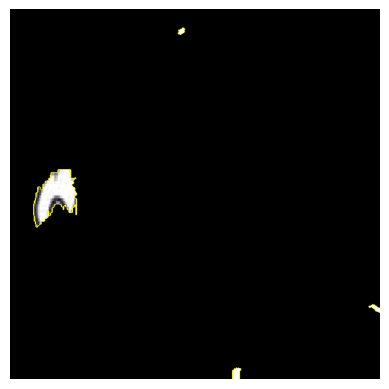

In [5]:
import numpy as np
import torch
import cv2
from lime import lime_image
from skimage.segmentation import quickshift
import matplotlib.pyplot as plt
from skimage.segmentation import mark_boundaries
from ultralytics import YOLO  # Ensure you are using ultralytics YOLO

# Load your YOLO model
model_path = r"F:\yolov12ckt\runs\detect\train29\weights\best.pt"
model = YOLO(model_path)  # Using ultralytics YOLO
model.to('cpu')
model.eval()

# Function to preprocess the image
def preprocess_image(image_path):
    image = cv2.imread(image_path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    image = cv2.resize(image, (640, 640))  # Resize to model input size
    image = image / 255.0  # Normalize to [0,1]
    image = np.transpose(image, (2, 0, 1))  # Change to (C, H, W) format
    image = np.expand_dims(image, axis=0)  # Add batch dimension
    return torch.tensor(image, dtype=torch.float32)

# Prediction function for LIME (converts YOLO detections to class probabilities)
def predict_fn(images):
    images = np.array(images)
    images = np.transpose(images, (0, 3, 1, 2))  # Convert to (batch, C, H, W)
    images = torch.tensor(images, dtype=torch.float32)

    with torch.no_grad():
        results = model(images)  # Run inference

    # Extract class-wise probability distribution
    num_classes = model.model.yaml['nc']  # Get number of classes from model config
    probabilities = np.zeros((len(images), num_classes))  # Placeholder for LIME

    for i, result in enumerate(results):
        if result.boxes is not None and len(result.boxes.cls) > 0:
            detected_classes = result.boxes.cls.cpu().numpy().astype(int)  # Detected class indices
            confidences = result.boxes.conf.cpu().numpy()  # Confidence scores
            
            # Aggregate confidence scores for each class
            for cls, conf in zip(detected_classes, confidences):
                probabilities[i, cls] += conf  # Sum confidences per class
        
        # Normalize to sum to 1 for LIME compatibility
        if probabilities[i].sum() > 0:
            probabilities[i] /= probabilities[i].sum()

    return probabilities

# Load image and preprocess
image_path = r"F:\yolov12ckt\dataset\test\images\Screenshot-2025-03-01-183325_png.rf.71bedf942b86f1d7595588df4f766bb5.jpg"
image = preprocess_image(image_path).numpy().squeeze().transpose(1, 2, 0)  # Convert back to HWC format

# Initialize LIME Explainer
explainer = lime_image.LimeImageExplainer()

# Explain the prediction
explanation = explainer.explain_instance(
    image, predict_fn, top_labels=1, hide_color=0, num_samples=1000
)

# Get the mask for the most important features
temp_image, mask = explanation.get_image_and_mask(
    explanation.top_labels[0], positive_only=True, num_features=5, hide_rest=True
)

# Show explanation
plt.imshow(mark_boundaries(temp_image, mask))
plt.axis("off")
plt.show()


  4%|▍         | 9/200 [00:01<00:27,  7.07it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 1 Inductor, 1 Resistor, 84.6ms
Speed: 0.0ms preprocess, 84.6ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 3 Diodes, 3 Resistors, 70.3ms
Speed: 0.0ms preprocess, 70.3ms inference, 5.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 2 Diodes, 1 PMOS, 5 Resistors, 70.1ms
Speed: 0.0ms preprocess, 70.1ms inference, 8.2ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 2 Diodes, 3 Resistors, 70.7ms
Speed: 0.0ms preprocess, 70.7ms inference, 2.7ms postprocess per image at sh

  9%|▉         | 18/200 [00:03<00:25,  7.01it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 3 Diodes, 2 Resistors, 74.7ms
Speed: 0.0ms preprocess, 74.7ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 5 Diodes, 2 Resistors, 68.0ms
Speed: 0.0ms preprocess, 68.0ms inference, 9.5ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 1 Diode, 2 Resistors, 69.9ms
Speed: 0.0ms preprocess, 69.9ms inference, 2.2ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Diode, 2 Resistors, 76.9ms
Speed: 0.0ms preprocess, 76.9ms inference, 0.3ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torc

 14%|█▍        | 29/200 [00:05<00:17,  9.55it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 1 Diode, 1 Resistor, 77.3ms
Speed: 0.0ms preprocess, 77.3ms inference, 5.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 3 Diodes, 1 Resistor, 68.8ms
Speed: 0.3ms preprocess, 68.8ms inference, 3.9ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 2 Diodes, 1 Resistor, 73.1ms
Speed: 0.0ms preprocess, 73.1ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 1 Diode, 82.8ms
Speed: 0.0ms preprocess, 82.8ms inference, 4.2ms postprocess per image at shape (1, 3, 640,

 20%|█▉        | 39/200 [00:06<00:18,  8.79it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 6 Diodes, 1 Inductor, 5 Resistors, 68.5ms
Speed: 0.0ms preprocess, 68.5ms inference, 9.8ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 2 Diodes, 1 Resistor, 72.4ms
Speed: 0.0ms preprocess, 72.4ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 3 Diodes, 79.7ms
Speed: 0.0ms preprocess, 79.7ms inference, 3.4ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 4 Diodes, 1 Resistor, 71.6ms
Speed: 0.0ms preprocess, 71.6ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)

WA

 24%|██▍       | 49/200 [00:08<00:16,  8.92it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 1 Diode, 1 Resistor, 75.7ms
Speed: 0.0ms preprocess, 75.7ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 3 Diodes, 2 Resistors, 66.2ms
Speed: 0.0ms preprocess, 66.2ms inference, 7.7ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 1 DepcurrentSrc, 2 Resistors, 76.1ms
Speed: 0.0ms preprocess, 76.1ms inference, 4.1ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 2 Diodes, 1 Inductor, 4 Resistors, 71.7ms
Speed: 0.5ms preprocess, 71.7ms inference, 5.1ms postprocess per ima

 30%|██▉       | 59/200 [00:10<00:15,  8.88it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 1 Diode, 2 Resistors, 74.6ms
Speed: 1.0ms preprocess, 74.6ms inference, 5.9ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Diode, 2 Resistors, 71.2ms
Speed: 0.0ms preprocess, 71.2ms inference, 4.9ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 1 Diode, 70.6ms
Speed: 0.0ms preprocess, 70.6ms inference, 5.6ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 4 Diodes, 1 NPN, 2 Resistors, 83.3ms
Speed: 0.0ms preprocess, 83.3ms inference, 3.4ms postprocess per image at shape (1, 3, 640, 64

 34%|███▍      | 69/200 [00:11<00:14,  9.02it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 1 Cell, 1 Diode, 2 Inductors, 71.7ms
Speed: 0.0ms preprocess, 71.7ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 72.4ms
Speed: 0.0ms preprocess, 72.4ms inference, 3.4ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 1 Capacitor, 1 Cell, 67.2ms
Speed: 0.0ms preprocess, 67.2ms inference, 9.1ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 2 Diodes, 3 Resistors, 87.1ms
Speed: 0.0ms preprocess, 87.1ms inference, 3.0ms postprocess per image at shape (1, 3, 640,

 40%|███▉      | 79/200 [00:13<00:13,  9.23it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 3 Diodes, 1 Resistor, 76.4ms
Speed: 0.0ms preprocess, 76.4ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 2 Diodes, 4 Resistors, 73.3ms
Speed: 0.0ms preprocess, 73.3ms inference, 3.6ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 2 Diodes, 5 Resistors, 75.5ms
Speed: 0.0ms preprocess, 75.5ms inference, 3.9ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 3 Diodes, 2 Resistors, 82.7ms
Speed: 0.0ms preprocess, 82.7ms inference, 2.4ms postprocess per image at shape (1, 3,

 44%|████▍     | 89/200 [00:15<00:13,  8.26it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 7 Diodes, 3 Resistors, 72.9ms
Speed: 0.0ms preprocess, 72.9ms inference, 3.6ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 6 Diodes, 1 Resistor, 70.3ms
Speed: 0.0ms preprocess, 70.3ms inference, 3.2ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 2 Diodes, 1 NPN, 2 Resistors, 69.5ms
Speed: 0.0ms preprocess, 69.5ms inference, 2.3ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 5 Diodes, 3 Resistors, 74.7ms
Speed: 0.0ms preprocess, 74.7ms inference, 4.2ms postprocess per im

 50%|████▉     | 99/200 [00:16<00:11,  8.94it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 4 Diodes, 1 Inductor, 4 Resistors, 73.6ms
Speed: 0.0ms preprocess, 73.6ms inference, 5.2ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 1 Diode, 4 Resistors, 84.0ms
Speed: 0.0ms preprocess, 84.0ms inference, 6.4ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 4 Diodes, 5 Resistors, 87.5ms
Speed: 0.0ms preprocess, 87.5ms inference, 3.2ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 2 Diodes, 76.8ms
Speed: 0.4ms preprocess, 76.8ms inference, 8.5ms postprocess per image at shape (1, 3, 

 54%|█████▍    | 108/200 [00:18<00:10,  8.89it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 4 Diodes, 6 Resistors, 72.9ms
Speed: 0.0ms preprocess, 72.9ms inference, 4.2ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 3 Diodes, 3 Resistors, 73.3ms
Speed: 0.0ms preprocess, 73.3ms inference, 4.1ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Diode, 1 Resistor, 71.3ms
Speed: 0.0ms preprocess, 71.3ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 2 Diodes, 1 Resistor, 81.6ms
Speed: 0.0ms preprocess, 81.6ms inference, 5.2ms postprocess per image at shape (1, 3, 6

 59%|█████▉    | 118/200 [00:20<00:08,  9.48it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 3 Resistors, 72.9ms
Speed: 0.0ms preprocess, 72.9ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 2 Inductors, 1 Resistor, 73.7ms
Speed: 0.0ms preprocess, 73.7ms inference, 4.6ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 1 Diode, 1 Inductor, 2 Resistors, 73.6ms
Speed: 0.0ms preprocess, 73.6ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 1 Diode, 1 Inductor, 83.2ms
Speed: 0.0ms preprocess, 83.2ms inference, 8.8ms postprocess per image at shape (1, 

 64%|██████▍   | 128/200 [00:21<00:08,  8.93it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 2 Diodes, 75.0ms
Speed: 0.0ms preprocess, 75.0ms inference, 3.9ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 6 Diodes, 1 Resistor, 74.4ms
Speed: 0.0ms preprocess, 74.4ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 4 Diodes, 1 Resistor, 81.9ms
Speed: 0.0ms preprocess, 81.9ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 3 Diodes, 6 Resistors, 81.1ms
Speed: 0.0ms preprocess, 81.1ms inference, 4.5ms postprocess per image at shape (1, 3, 640, 640)

WA

 69%|██████▉   | 138/200 [00:23<00:06,  8.94it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 2 Diodes, 70.7ms
Speed: 0.0ms preprocess, 70.7ms inference, 4.1ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Diode, 1 Resistor, 75.4ms
Speed: 0.0ms preprocess, 75.4ms inference, 3.9ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 4 Diodes, 5 Resistors, 81.0ms
Speed: 0.0ms preprocess, 81.0ms inference, 3.4ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 4 Diodes, 1 Inductor, 3 Resistors, 83.1ms
Speed: 0.0ms preprocess, 83.1ms inference, 5.5ms postprocess per image at shape (1, 3, 6

 74%|███████▍  | 149/200 [00:25<00:05, 10.09it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Diode, 1 Resistor, 71.4ms
Speed: 0.0ms preprocess, 71.4ms inference, 3.8ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 4 Diodes, 1 Resistor, 80.0ms
Speed: 1.0ms preprocess, 80.0ms inference, 5.7ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 1 Diode, 81.0ms
Speed: 0.0ms preprocess, 81.0ms inference, 3.3ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 Diode, 1 PMOS, 1 Resistor, 81.4ms
Speed: 0.0ms preprocess, 81.4ms inference, 5.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor 

 80%|███████▉  | 159/200 [00:27<00:04,  8.64it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 1 Inductor, 79.8ms
Speed: 0.0ms preprocess, 79.8ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 3 Diodes, 71.1ms
Speed: 0.0ms preprocess, 71.1ms inference, 4.8ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 5 Diodes, 3 Resistors, 83.4ms
Speed: 0.0ms preprocess, 83.4ms inference, 4.2ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 1 Capacitor, 1 Diode, 3 Resistors, 83.6ms
Speed: 0.0ms preprocess, 83.6ms inference, 0.5ms postprocess per image at shape (1, 3

 84%|████████▍ | 169/200 [00:28<00:03,  8.74it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 2 Diodes, 3 Resistors, 70.7ms
Speed: 0.0ms preprocess, 70.7ms inference, 3.3ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 PMOS, 1 Resistor, 76.4ms
Speed: 0.0ms preprocess, 76.4ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 2 Diodes, 2 Resistors, 82.0ms
Speed: 0.0ms preprocess, 82.0ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 1 Inductor, 1 Resistor, 83.0ms
Speed: 0.0ms preprocess, 83.0ms inference, 3.0ms postprocess per image at shape (1, 3, 

 90%|████████▉ | 179/200 [00:30<00:02,  9.15it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 2 Diodes, 2 Inductors, 1 Resistor, 75.0ms
Speed: 0.0ms preprocess, 75.0ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 4 Diodes, 2 Resistors, 73.9ms
Speed: 1.0ms preprocess, 73.9ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 3 Diodes, 1 Resistor, 81.2ms
Speed: 1.0ms preprocess, 81.2ms inference, 5.7ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 7 Diodes, 1 Resistor, 81.3ms
Speed: 0.0ms preprocess, 81.3ms inference, 3.1ms postprocess per image at shape (1, 3, 

 94%|█████████▍| 189/200 [00:32<00:01,  8.81it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 3 Diodes, 3 Resistors, 78.3ms
Speed: 0.0ms preprocess, 78.3ms inference, 4.2ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 1 Diode, 82.9ms
Speed: 0.0ms preprocess, 82.9ms inference, 6.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 3 Diodes, 3 Inductors, 1 Resistor, 82.7ms
Speed: 0.0ms preprocess, 82.7ms inference, 6.3ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 1 Inductor, 77.8ms
Speed: 0.0ms preprocess, 77.8ms inference, 0.0ms postprocess per image at shape (1, 3,

100%|█████████▉| 199/200 [00:33<00:00,  8.99it/s]


WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 7 Diodes, 2 Resistors, 70.7ms
Speed: 0.0ms preprocess, 70.7ms inference, 4.6ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 1 Resistor, 72.2ms
Speed: 0.0ms preprocess, 72.2ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 1 Diode, 1 Inductor, 1 Resistor, 73.1ms
Speed: 0.0ms preprocess, 73.1ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)

WARNING  torch.Tensor inputs should be normalized 0.0-1.0 but max value is 255.0. Dividing input by 255.
0: 640x640 1 ACSource, 1 Diode, 1 Resistor, 80.3ms
Speed: 0.0ms preprocess, 80.3ms inference, 3.7ms postprocess per image at sh

100%|██████████| 200/200 [00:34<00:00,  5.74it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


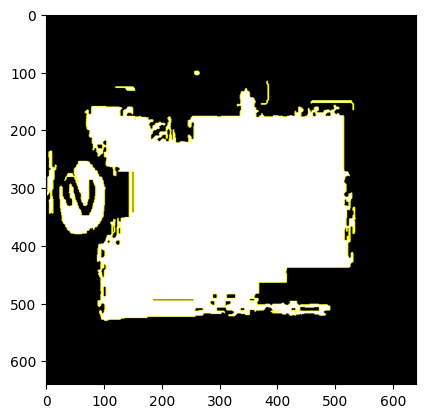

In [32]:
from lime import lime_image
from skimage.segmentation import mark_boundaries, felzenszwalb
import matplotlib.pyplot as plt
import torch
import numpy as np
from PIL import Image
from ultralytics import YOLO

# Load YOLOv12 model
model_path = r"F:\yolov12ckt\runs\detect\train29\weights\best.pt"
device = "cuda" if torch.cuda.is_available() else "cpu"
model = YOLO(model_path).to(device).eval()

# Define a wrapper for YOLO predictions to return classification scores
def yolo_predict_for_lime(image_array):
    all_class_probabilities = []
    for img in image_array:
        img_tensor = torch.tensor(img, dtype=torch.float32).permute(2, 0, 1).unsqueeze(0).to(device)
        with torch.no_grad():
            outputs = model(img_tensor)
        class_probabilities = process_yolo_outputs(outputs)
        all_class_probabilities.append(class_probabilities)
    return np.concatenate(all_class_probabilities, axis=0)

# Define how to process YOLOv12 outputs
def process_yolo_outputs(outputs):
    if len(outputs) > 0 and outputs[0].boxes is not None and len(outputs[0].boxes.cls) > 0:
        class_scores = torch.zeros((outputs[0].boxes.cls.shape[0], len(model.names))).to(device)
        for i, cls_idx in enumerate(outputs[0].boxes.cls):
            class_scores[i, int(cls_idx)] = outputs[0].boxes.conf[i]
        class_scores = torch.sum(class_scores, dim=0, keepdim=True)
    else:
        class_scores = torch.zeros((1, len(model.names))).to(device)
    return class_scores.cpu().numpy()

# Load the image
image_path = r"F:\yolov12ckt\dataset\test\images\Screenshot-2025-03-01-183148_png.rf.8f17211f500be336bbe43c4bf33c2aaa.jpg"
image = Image.open(image_path).convert("RGB")
image_np = np.array(image)

# Define the segmentation function using Felzenszwalb segmentation
def segmenter(image):
    return felzenszwalb(image, scale=300, sigma=1)

# Create LIME explainer
explainer = lime_image.LimeImageExplainer()

# Generate explanation
explanation = explainer.explain_instance(
    image_np,
    yolo_predict_for_lime,
    top_labels=5,
    hide_color=0,
    num_samples=200,
    segmentation_fn=segmenter  # Pass the function instead of an object
)

# Visualize explanation
temp, mask = explanation.get_image_and_mask(
    explanation.top_labels[0],
    positive_only=True,
    num_features=8,
    hide_rest=True
)

plt.imshow(mark_boundaries(temp, mask))
plt.show()


In [33]:
# import torch
# import shap
# import numpy as np
# import torchvision.transforms as transforms
# import matplotlib.pyplot as plt
# from PIL import Image
# from ultralytics import YOLO
# import gc
# from skimage.segmentation import slic

# # ✅ 1. Load YOLO Model Efficiently
# model_path = "/content/drive/MyDrive/google_collab/yolov12/runs/detect/train29/weights/best.pt"
# device = "cuda" if torch.cuda.is_available() else "cpu"
# model = YOLO(model_path).eval().to(device)

# # ✅ 2. Image Preprocessing
# transform = transforms.Compose([
#     transforms.Resize((320, 320)),
#     transforms.ToTensor(),
# ])

# # ✅ 3. Load and Process Image
# image_path = "/content/drive/MyDrive/google_collab/dataset/test/images/Screenshot-2025-03-01-150745_png.rf.5c5663aa67e7e46d9caa5f2b64c01093.jpg"

# with Image.open(image_path) as img:
#     img = img.convert("RGB")  # Ensure RGB format
#     img_array = np.array(img)  # Convert to NumPy array
#     image_tensor = transform(img).unsqueeze(0).to(device)  # Normalize & add batch dimension

# # ✅ 4. Superpixel Segmentation (Reduce Segments for Memory Efficiency)
# segments = slic(img_array, n_segments=75, compactness=5, sigma=1)

# # ✅ 5. SHAP Masker Configuration (Using Efficient Image Masking)
# masker = shap.maskers.Image(mask_value=0, shape=img_array.shape)

# # ✅ 6. Capture YOLO Backbone Features
# feature_maps = {}

# def hook_fn(module, input, output):
#     """Capture spatial features from backbone."""
#     feature_maps["features"] = output.mean(dim=1).detach().cpu().numpy()

# # Attach hook to an early layer to reduce memory usage (adjust index if needed)
# hook = model.model.model[8].register_forward_hook(hook_fn)

# # ✅ 7. Model Wrapper for SHAP
# def model_function(x):
#     """Runs YOLO on SHAP-modified images and returns extracted features."""
#     x_tensor = torch.tensor(x, dtype=torch.float32, device=device).permute(0, 3, 1, 2)  # Convert to (N, C, H, W)

#     with torch.no_grad():
#         model(x_tensor)  # Forward pass
#         features = feature_maps.pop("features", None)  # Extracted feature maps

#     if features is None:
#         return np.zeros((x_tensor.shape[0], 1))  # Return zero features if extraction fails

#     return features.reshape(features.shape[0], -1)  # Flatten feature maps

# # ✅ 8. Compute SHAP Values (Lower `max_evals` and `batch_size` for RAM control)
# explainer = shap.Explainer(model_function, masker, algorithm="auto", max_evals=2, batch_size=8)

# shap_values = explainer(img_array[np.newaxis, ...] / 255.0)  # Normalize and compute SHAP

# # ✅ 9. Visualization
# plt.figure(figsize=(14, 7))

# # Original Image
# plt.subplot(1, 2, 1)
# plt.imshow(img_array)
# plt.title("Original Image")
# plt.axis('off')

# # SHAP Importance Map
# plt.subplot(1, 2, 2)
# shap.image_plot(
#     [np.abs(shap_values.values[0]).sum(axis=-1)],
#     img_array,
#     show=False
# )
# plt.title("SHAP Importance Map")
# plt.axis('off')

# plt.tight_layout()
# plt.show()

# # ✅ 10. Cleanup (Free Up Memory)
# hook.remove()
# del image_tensor, img_array, shap_values  # Delete large tensors
# gc.collect()
# torch.cuda.empty_cache()
